In [1]:
import numpy as np
np.__version__

'1.19.5'

In [2]:
import pandas as pd
pd.__version__

'1.1.5'

In [3]:
import matplotlib
matplotlib.__version__

'3.3.4'

In [4]:
import matplotlib.pyplot as plt

In [5]:
# Adjust plot size
#options(repr.plot.width=16, repr.plot.height=6)

# For some reason, if this is in the same cell as the import command, it doesn't work.
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [6]:
import scipy
scipy.__version__

'1.5.4'

In [7]:
from scipy import stats

In [8]:
import seaborn as sns

In [9]:
from datetime import datetime

In [10]:
#from pandarallel import pandarallel

In [11]:
#pandarallel.initialize(progress_bar=True)

In [12]:
default_max_columns=pd.get_option('display.max_columns')

In [13]:
default_max_rows=pd.get_option('display.max_rows')

In [14]:
default_precision=pd.get_option('display.precision')

In [15]:
pd.set_option('display.precision', 2)

In [16]:
default_threshold=np.get_printoptions()['threshold']

In [17]:
np.set_printoptions(threshold=10000000)

# Read meta data

In [18]:
meta = pd.read_csv('20210428-EV/metadata.csv')

In [19]:
meta.head()

,Rand 2 Batch_order,D-plex Sequencing ID,Lexogen Sequencing ID,Diagnosis
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"


In [20]:
meta.rename(columns={"Rand 2 Batch_order": "subject"},inplace=True)
meta.rename(columns={"D-plex Sequencing ID": "dplex"},inplace=True)
meta.rename(columns={"Lexogen Sequencing ID": "lexogen"},inplace=True)
meta.rename(columns={"Diagnosis": "diag"},inplace=True)
#meta.set_index('subject',inplace=True)

In [21]:
meta

,subject,dplex,lexogen,diag
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,"
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,"
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,"
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,"


In [22]:
meta[['disease','idh','x1p19q']] = meta['diag'].str.split(",", 2, expand=True)
#meta.drop('diag',axis='columns',inplace=True)

In [23]:
meta

,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,",GBM,IDH-mutant,
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,


# Read raw matrix CORE

In [24]:
#df = pd.read_csv('20210428-EV/dplexonlyreport.csv',index_col=0,header=None)
df = pd.read_csv('20210428-EV/20210513b-report.csv.gz',index_col=0,header=None,low_memory=False)

In [25]:
df.shape

(39, 528)

In [26]:
df.head(12)

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
---,---,---,---,---,---,---,---,---,---,---,...,---,---,---,---,---,---,---,---,---,---
Subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
Trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242


In [27]:
df.drop("---",inplace=True)

In [28]:
df.shape

(38, 528)

In [29]:
df.rename({'  ':'sample'},axis='rows',inplace=True)
df.rename({'Subject':'subject'},axis='rows',inplace=True)
df.rename({'Trimmer':'trimmer'},axis='rows',inplace=True)

In [30]:
df

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
sample,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242
STAR Aligned to Transcriptome,111104,112499,112492,112689,112696,112689,92673,93752,93727,92285,...,337860,337076,336880,336843,362402,363298,363259,362012,361905,361853


In [31]:
df=df.T
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,Bowtie2 Aligned to Salmonella,Bowtie2 Aligned to Salmonella %,Bowtie2 Aligned to masked Salmonella,Bowtie2 Aligned to masked Salmonella %,Bowtie2 Aligned to Burkholderia,Bowtie2 Aligned to Burkholderia %,Bowtie2 Aligned to masked Burkholderia,Bowtie2 Aligned to masked Burkholderia %,Bowtie2 Aligned to mRNA_Prot,Bowtie2 Aligned to mRNA_Prot %
1,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,45946,3.61,14700,1.15,375543,29.55,277406,21.82,58736,4.62
2,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,60133,4.37,17811,1.29,413414,30.11,298416,21.73,71735,5.22
3,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,60133,4.37,17811,1.29,413414,30.11,298416,21.73,71735,5.22
4,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,61284,4.39,18218,1.30,420290,30.10,304330,21.80,75518,5.41
5,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,61285,4.39,18218,1.30,420299,30.10,304339,21.80,75522,5.41


In [32]:
#df=df.merge(meta,left_on='Subject',right_on='subject')
df=df.merge(meta,on='subject')
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,Bowtie2 Aligned to masked Burkholderia,Bowtie2 Aligned to masked Burkholderia %,Bowtie2 Aligned to mRNA_Prot,Bowtie2 Aligned to mRNA_Prot %,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,277406,21.82,58736,4.62,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,298416,21.73,71735,5.22,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,298416,21.73,71735,5.22,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,304330,21.80,75518,5.41,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,304339,21.80,75522,5.41,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [33]:
#element_counts = pd.read_csv('20210428-EV/rmsk_class_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/rmsk_family_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/rmsk_name_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/mirna_counts.csv.gz',index_col=0,low_memory=False)
element_counts = pd.read_csv('20210428-EV/gene_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/mrna_counts.csv.gz',index_col=0,low_memory=False)
# diamond_family_counts

element_counts.head()

,SFHH005aa.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005a.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,...,SFHH006y.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts
sequence,,,,,,,,,,,,,,,,,,,,,
A1BG,0,0,0,0,0,0,0,0,0,0,...,21,21,21,21,0,0,0,0,0,0
A1BG-AS1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A1CF,0,0,0,0,0,0,24,24,24,0,...,0,0,0,0,0,0,0,0,0,0
A2M,0,0,0,0,0,0,50,125,125,0,...,0,0,0,0,0,0,0,0,0,0
A2M-AS1,0,0,0,0,0,0,177,177,177,6,...,0,0,0,0,0,0,0,0,0,0


# Keep less than 5000 columns

In [34]:
len(element_counts)

34074

In [35]:
element_counts=element_counts[0:5000]
#element_counts=element_counts[5000:10000]
#element_counts=element_counts[10000:15000]
#element_counts=element_counts[15000:20000]
#element_counts=element_counts[20000:25000]
#element_counts=element_counts[25000:30000]
#element_counts=element_counts[30000:35000]

In [36]:
len(element_counts)

5000

In [37]:
element_counts=element_counts.T
element_counts=element_counts.reset_index()
element_counts[['sample','trimmer','other']]=element_counts['index'].str.split(".",2,expand=True)
element_counts.drop(["index","other"],inplace=True,axis='columns')
element_counts.head()

sequence,A1BG,A1BG-AS1,A1CF,A2M,A2M-AS1,A2ML1,A2MP1,A3GALT2,A4GALT,A4GNT,...,DLX3,DLX4,DLX5,DLX6,DLX6-AS1,DM1-AS,DMAC1,DMAC2,sample,trimmer
0,0,0,0,0,0,0,0,26,0,0,...,1,0,1,1,0,0,0,0,SFHH005aa,bbduk1
1,0,0,0,0,0,0,0,26,0,0,...,1,0,1,1,0,0,0,0,SFHH005aa,bbduk2
2,0,0,0,0,0,0,0,26,0,0,...,1,0,1,1,0,0,0,0,SFHH005aa,bbduk3
3,0,0,0,0,0,0,0,26,0,0,...,1,0,0,2,0,0,0,0,SFHH005aa,cutadapt1
4,0,0,0,0,0,0,0,26,0,0,...,1,0,0,2,0,0,0,0,SFHH005aa,cutadapt2


In [38]:
df=df.merge(element_counts,on=['sample','trimmer'])
df.shape

(528, 5044)

In [39]:
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,DLX2,DLX2-DT,DLX3,DLX4,DLX5,DLX6,DLX6-AS1,DM1-AS,DMAC1,DMAC2
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0,0,1,0,1,1,0,0,0,0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0,0,1,0,1,1,0,0,0,0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0,0,1,0,1,1,0,0,0,0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0,0,1,0,0,2,0,0,0,0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0,0,1,0,0,2,0,0,0,0


In [40]:
df.columns  #.tolist()

Index(['sample', 'subject', 'Lab kit', 'trimmer', 'Raw Read Count',
       'Raw Read Length', 'Trimmed Read Count', 'Trimmed Ave Read Length',
       'STAR Aligned to Transcriptome', 'STAR Aligned to Transcriptome %',
       ...
       'DLX2', 'DLX2-DT', 'DLX3', 'DLX4', 'DLX5', 'DLX6', 'DLX6-AS1', 'DM1-AS',
       'DMAC1', 'DMAC2'],
      dtype='object', length=5044)

In [41]:
#genes=df.columns[92:142]
#genes=df.columns[100:554]
#a=df.columns.tolist().index('STAR Gene Counts')+1
#b=df.columns.tolist().index('STAR miRNA Counts')
#genes=df.columns[a:b]
elements=element_counts.columns[:-2]
elements

Index(['A1BG', 'A1BG-AS1', 'A1CF', 'A2M', 'A2M-AS1', 'A2ML1', 'A2MP1',
       'A3GALT2', 'A4GALT', 'A4GNT',
       ...
       'DLX2', 'DLX2-DT', 'DLX3', 'DLX4', 'DLX5', 'DLX6', 'DLX6-AS1', 'DM1-AS',
       'DMAC1', 'DMAC2'],
      dtype='object', name='sequence', length=5000)

In [42]:
df['Raw Read Count'] = pd.to_numeric(df['Raw Read Count'], errors='coerce')

In [43]:
df['Trimmed Read Count'] = pd.to_numeric(df['Trimmed Read Count'], errors='coerce')

In [44]:
pd.set_option('display.max_rows',None)

In [45]:
#df[['subject','sample','Raw Read Count']].drop_duplicates().sort_values(by='Raw Read Count')

In [46]:
#df[['subject','sample','trimmer','Trimmed Read Count']].drop_duplicates().sort_values(by='Trimmed Read Count')

In [47]:
pd.set_option('display.max_rows',default_max_rows)

# Prepping to ttest all items against all other items

In [48]:
df['diag'].unique()

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'V01 control (S1),,', 'GBM, IDH1R132H WT,', 'blank 2 (C1),,',
       'blank1 (C1),,'], dtype=object)

In [49]:
u=df['diag'].unique()
diags=u[0:3]
diags=np.append(diags,u[4])

In [50]:
diags

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'GBM, IDH1R132H WT,'], dtype=object)

In [51]:
type(diags)

numpy.ndarray

In [52]:
diags=diags.tolist()

In [53]:
diags

['GBM, IDH-mutant,',
 'Diffuse Astrocytoma, IDH-mutant,',
 'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
 'GBM, IDH1R132H WT,']

In [54]:
# Why was this here?

#import warnings
#warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning) 

pca plots

In [55]:
def ttests_boxplots_and_heatmaps(localdf,columns,box_p=0.05,heat_p=0.15):
    select_p_values=[]
    for col in columns:

        if ( col not in localdf.columns ):
            continue

        for labkit in localdf['Lab kit'].unique():
            #"D-plex","Lexogen":
            for trimmer in 'bbduk2','cutadapt2':
                #localdf['Trimmer'].unique():
                #"bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
                for diag in diags:
                    others=diags.copy()
                    others.remove(diag)
                    for other in others:
                        t, p = stats.ttest_ind(
                            localdf[((localdf["Lab kit"]==labkit) &
                                     (localdf["trimmer"]==trimmer) & 
                                (localdf["diag"]==diag))][col],
                            localdf[((localdf["Lab kit"]==labkit) &
                                     (localdf["trimmer"]==trimmer) & 
                                (localdf["diag"]==other))][col])
                        if p < heat_p:
                            select_p_values.append([abs(t),p,col,labkit,trimmer])

    pdf = pd.DataFrame(select_p_values, columns=['t','p','col','labkit','trimmer'])                        
    pdf=pdf.drop_duplicates().sort_values('p')

    for index, row in pdf.iterrows():
        if row['p'] < box_p:
            print(" p : "+str(row['p'])+"  ( t : "+str(row['t'])+" ) :  "+
                  row['labkit']+"  :  "+row['trimmer']+"  :  "+row['col'])
            print("Control and blanks")
            print(localdf[
                (localdf['diag']=='V01 control (S1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
            print(localdf[
                (localdf['diag']=='blank 2 (C1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
            print(localdf[
                (localdf['diag']=='blank1 (C1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
                        
            localdf[((localdf["Lab kit"]==row['labkit']) &
                     (localdf["trimmer"]==row['trimmer']))].boxplot(
                column=row['col'],by=['diag'])
            plt.title(row['col'] + " Normalized by Trimmed Read Count")
            plt.xticks(rotation=75,ha='right')
            plt.show()

    selected=['subject','sample','Lab kit','trimmer','diag','idh']
    selected=np.append(selected,pdf['col'])
    selected=np.unique(selected)

    #['Lab kit' 'NR_029609.1' 'trimmer' 'diag' 'idh' 'sample' 'subject']
    if len(selected) > 7:
        for trimmer in 'bbduk2','cutadapt2':
            for labkit in dfn['Lab kit'].unique():
                tmp=localdf[selected].copy()
                tmp=tmp[(tmp['trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
                tmp=tmp.drop('trimmer',axis='columns')
                tmp=tmp.drop('Lab kit',axis='columns')
                tmp.set_index(['subject','sample','diag','idh'],inplace=True)
                
                #tmp-=tmp.min() # This may almost always be 0 now.
                tmp/=tmp.max() # given that there should be no NAs now, coule let clustermap do this
                # ...
                #standard_scale int or None, optional
                #Either 0 (rows) or 1 (columns).
                #Whether or not to standardize that dimension, meaning for each row or column,
                #subtract the minimum and divide each by its maximum.
                # how would that deal with 0s or empty cells

                tmp=tmp.fillna(0) # Somehow, some scaled values become NaN so keep this
                
                tmp.reset_index(inplace=True)

                #tmp1=tmp.sort_values(['diag']).T
                tmp=tmp.sort_values(['idh','diag'])
                #print(tmp.head())
                tmp.drop(['subject'],inplace=True,axis='columns')
                tmp.set_index(['sample','idh'],inplace=True)
                
                diagnoses=tmp.pop('diag')
                #lut = dict(zip(diagnoses.unique(), "rgbcmykb"))
                #col_colors = diagnoses.map(lut)
                #print(col_colors)
                #print(tmp.columns)
                
                tmp=tmp.T

                #print('pal')
                network_pal = sns.cubehelix_palette(len(diagnoses.unique()),
                                    light=.9, dark=.1, reverse=True,
                                    start=1, rot=-2)
                #print(network_pal)
                network_pal
                #print('lut')
                network_lut = dict(zip(diagnoses.unique(), network_pal))
                #print(network_lut)
                #print('labels')
                # Convert the palette to vectors that will be drawn on the side of the matrix
                network_labels = diagnoses
                #print(network_labels)
                network_colors = pd.Series(network_labels, index=tmp.columns).map(network_lut)                
                #print('colors')
                #print(network_colors)
                
                # from http://dawnmy.github.io/2016/10/24/Plot-heatmaap-with-side-color-indicating-the-class-of-variables/
                # Create a custom palette to identify the networks
                #network_pal = sns.cubehelix_palette(len(used_networks),
                #                    light=.9, dark=.1, reverse=True,
                #                    start=1, rot=-2)
                #network_lut = dict(zip(map(str, used_networks), network_pal))

                # Convert the palette to vectors that will be drawn on the side of the matrix
                #network_labels = df.columns.get_level_values("network")
                #network_colors = pd.Series(network_labels, index=df.columns).map(network_lut)                
   
                # Create a custom colormap for the heatmap values
                #cmap = sns.diverging_palette(h_neg=210, h_pos=350, s=90, l=30, as_cmap=True)

                # Draw the full plot
                #g = sns.clustermap(df.corr(),

                #                 # Turn off the clustering
                #                 row_cluster=False, col_cluster=False,

                #                  # Add colored class labels
                #                  row_colors=network_colors, col_colors=network_colors,

                #                  # Make the plot look better when many rows/cols
                #                  linewidths=0, xticklabels=False, yticklabels=False)

                # Draw the legend bar for the classes                 
                #for label in network_labels.unique():
                #    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                #                            label=label, linewidth=0)
                #g.ax_col_dendrogram.legend(loc="center", ncol=5)

                
                g=sns.clustermap(tmp,col_cluster=False,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
                g.fig.suptitle("Clustermap 1 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

                # Draw the legend bar for the classes                 
                for label in network_labels.unique():
                    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                            label=label, linewidth=0)
                g.ax_col_dendrogram.legend(loc="center", ncol=4)
                
                # Adjust the postion of the main colorbar for the heatmap
                #g.cax.set_position([.97, .2, .03, .45])
                g.cax.set_position([0, .15, .005, .65])
                plt.show()

                g=sns.clustermap(tmp,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
                g.fig.suptitle("Clustermap 2 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

                # Draw the legend bar for the classes                 
                for label in network_labels.unique():
                    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                            label=label, linewidth=0)
                g.ax_col_dendrogram.legend(loc="center", ncol=4)
                                
                # Adjust the postion of the main colorbar for the heatmap
                # [dist from left,dist from bottom?,width?,height?]
                g.cax.set_position([0, .15, .005, .65])
                plt.show()  
    else:
        print("Not enough data to produce cluster maps")

# Normalize by Trimmed Read Count

In [56]:
dfn=df.copy()

In [57]:
dfn.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,DLX2,DLX2-DT,DLX3,DLX4,DLX5,DLX6,DLX6-AS1,DM1-AS,DMAC1,DMAC2
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0,0,1,0,1,1,0,0,0,0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0,0,1,0,1,1,0,0,0,0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0,0,1,0,1,1,0,0,0,0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0,0,1,0,0,2,0,0,0,0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0,0,1,0,0,2,0,0,0,0


In [58]:
datetime.now().strftime("%H:%M:%S")

'10:48:40'

In [59]:
dfn[elements]=(1e9*dfn[elements].values)/dfn[['Trimmed Read Count']].values

In [60]:
datetime.now().strftime("%H:%M:%S")

'10:49:22'

In [61]:
dfn.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,DLX2,DLX2-DT,DLX3,DLX4,DLX5,DLX6,DLX6-AS1,DM1-AS,DMAC1,DMAC2
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0.0,0.0,786.92,0.0,786.92,786.92,0.0,0.0,0.0,0.0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0.0,0.0,728.35,0.0,728.35,728.35,0.0,0.0,0.0,0.0
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0.0,0.0,728.33,0.0,728.33,728.33,0.0,0.0,0.0,0.0
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0.0,0.0,716.39,0.0,0.00,1432.78,0.0,0.0,0.0,0.0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0.0,0.0,716.39,0.0,0.00,1432.77,0.0,0.0,0.0,0.0


In [62]:
datetime.now().strftime("%H:%M:%S")

'10:49:22'

In [63]:
for c in ['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1',
    'EGFR','EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','NOTCH1',
    'RB1','RB1CC1','RB1-DT','TERT','TP53']:
        if( c not in dfn.columns ):
            print("Missing "+c) 

Missing EGFR
Missing EGFR-AS1
Missing IDH1
Missing IDH1-AS1
Missing IDH2
Missing IDH2-DT
Missing NF1
Missing NOTCH1
Missing RB1
Missing RB1CC1
Missing RB1-DT
Missing TERT
Missing TP53


In [64]:
datetime.now().strftime("%H:%M:%S")

'10:49:22'

# Select Genes (if using Genes)

 p : 0.04520587862677298  ( t : 2.15213364120796 ) :  D-plex  :  cutadapt2  :  CDKN2AIPNL
Control and blanks
76     0.0
340    0.0
Name: CDKN2AIPNL, dtype: float64
208    0.0
Name: CDKN2AIPNL, dtype: float64
472    2311.82
Name: CDKN2AIPNL, dtype: float64


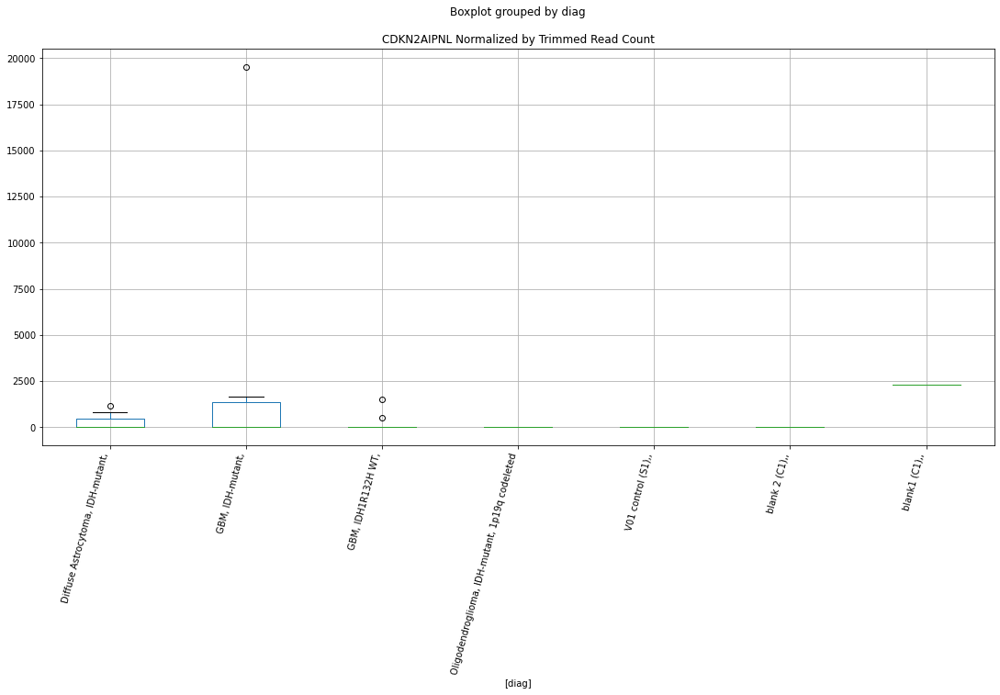

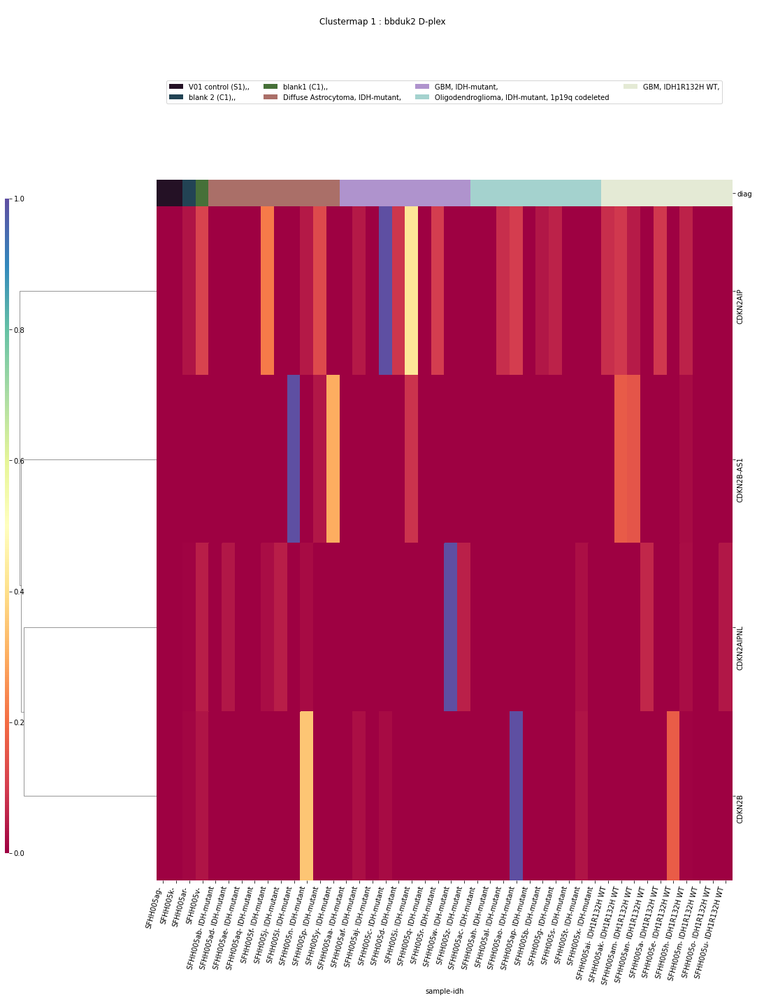

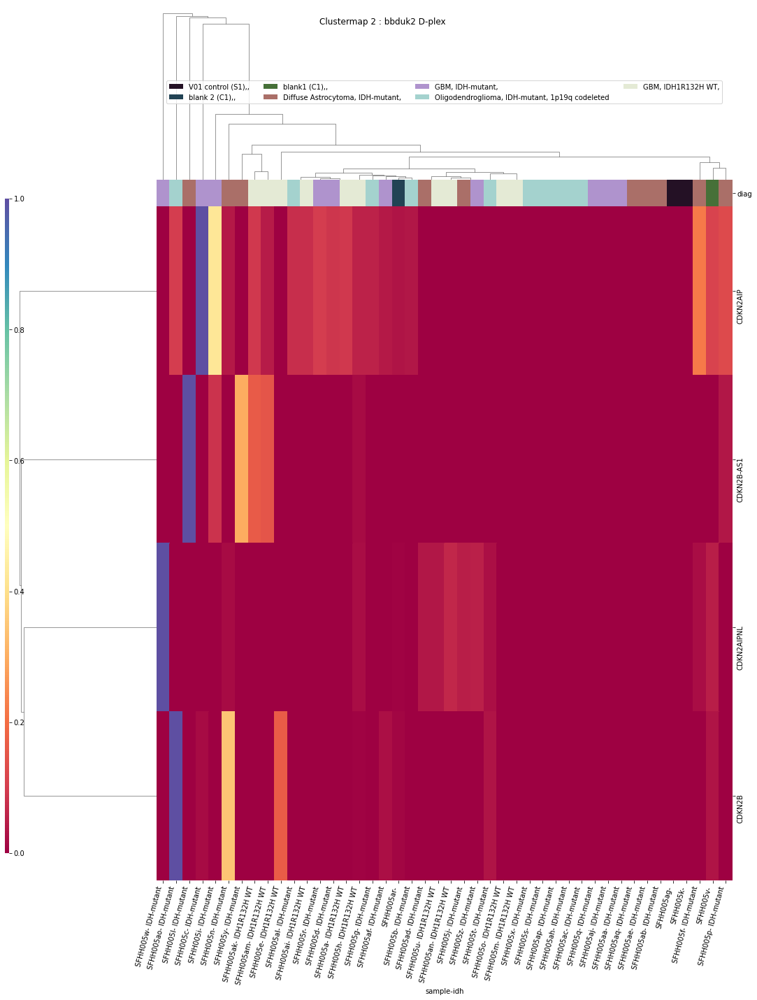

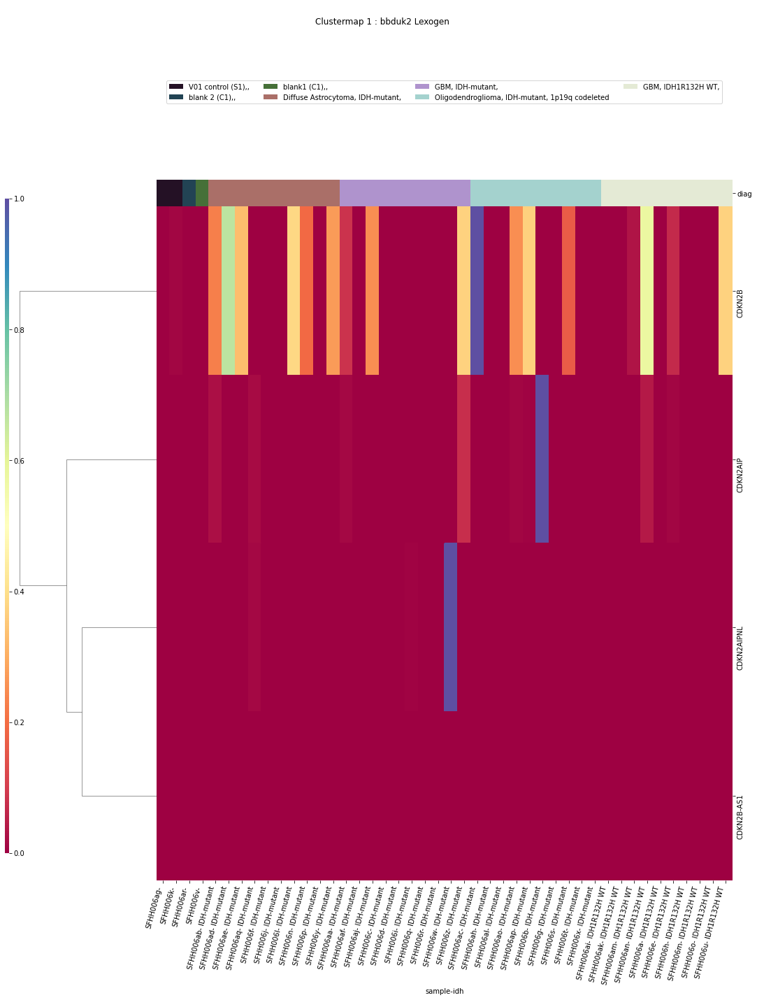

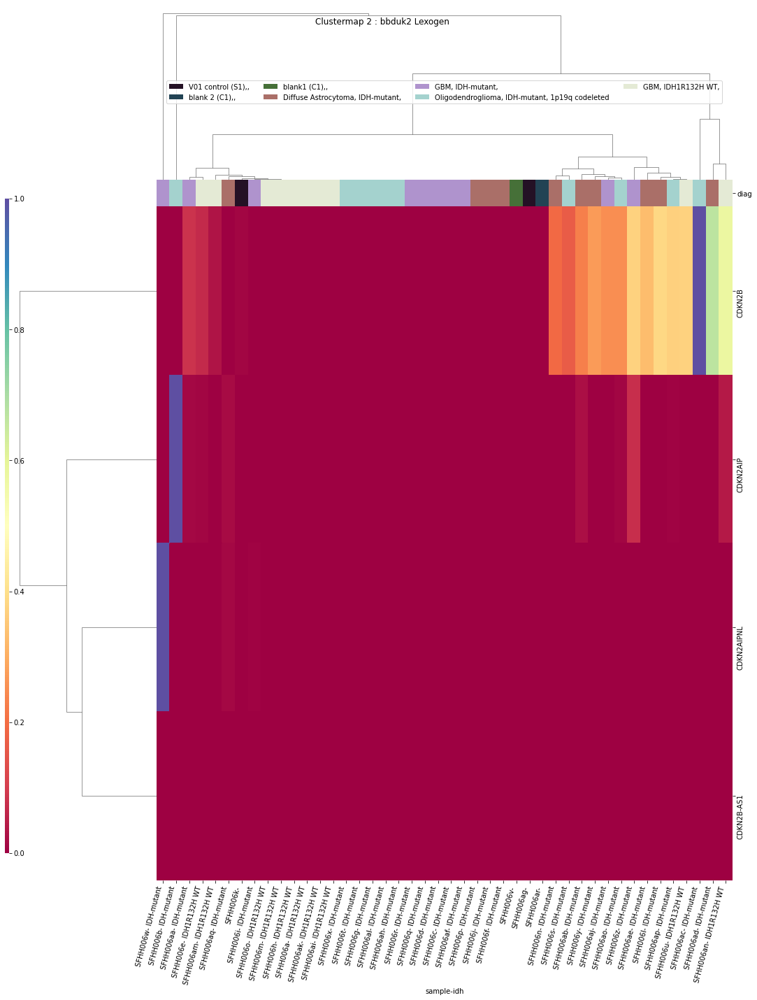

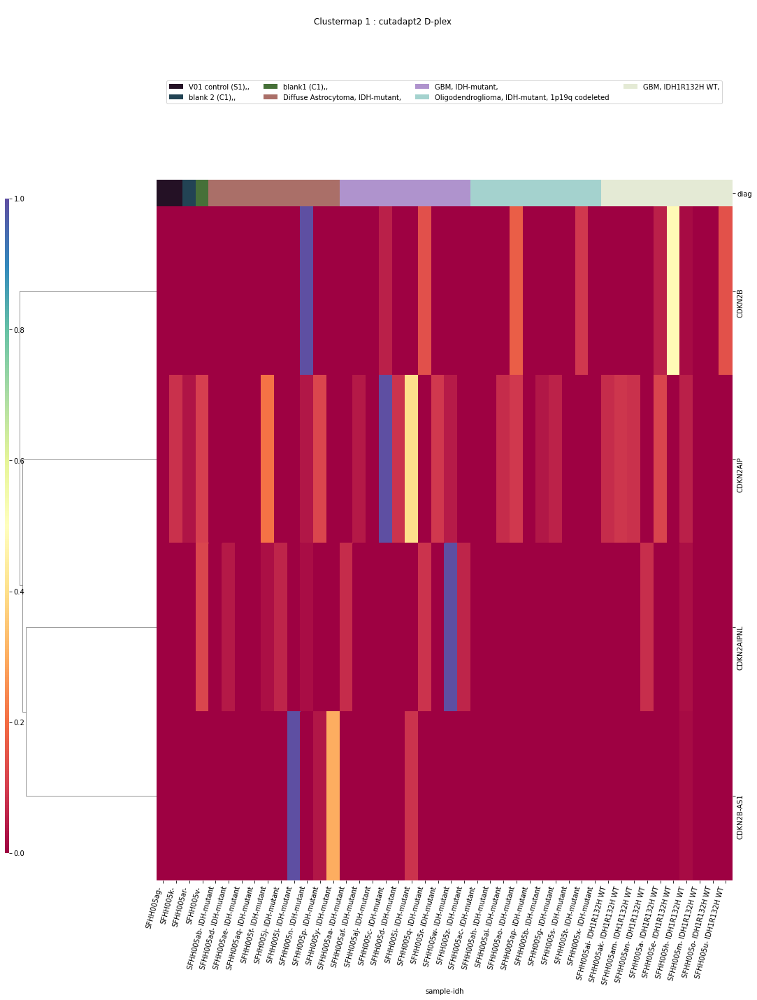

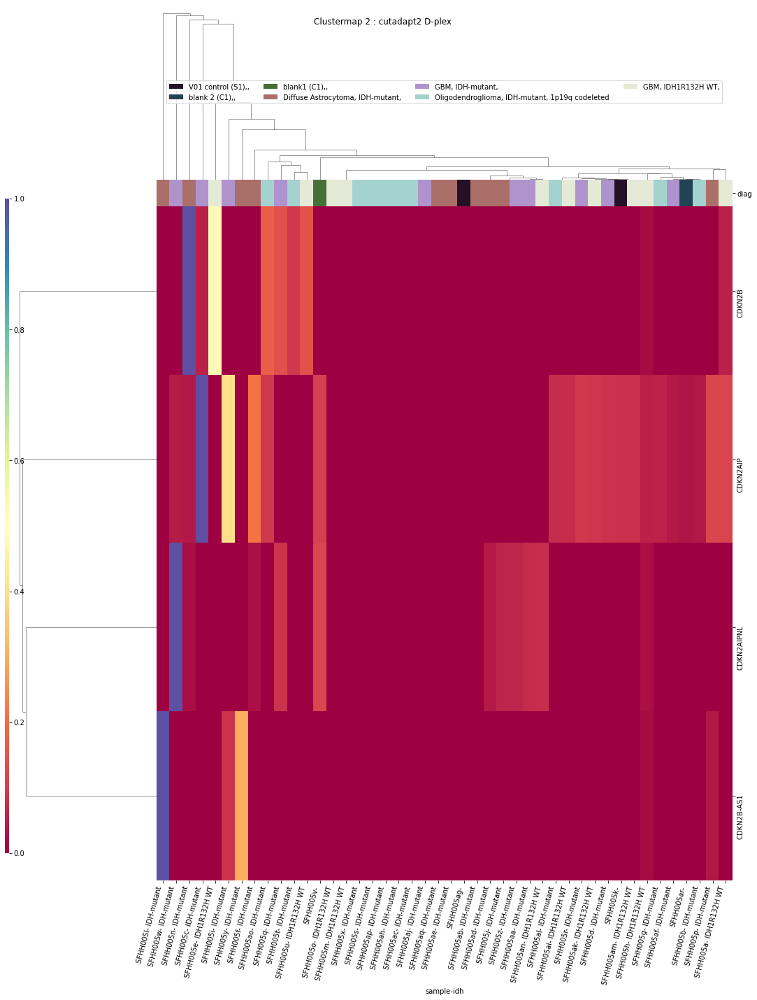

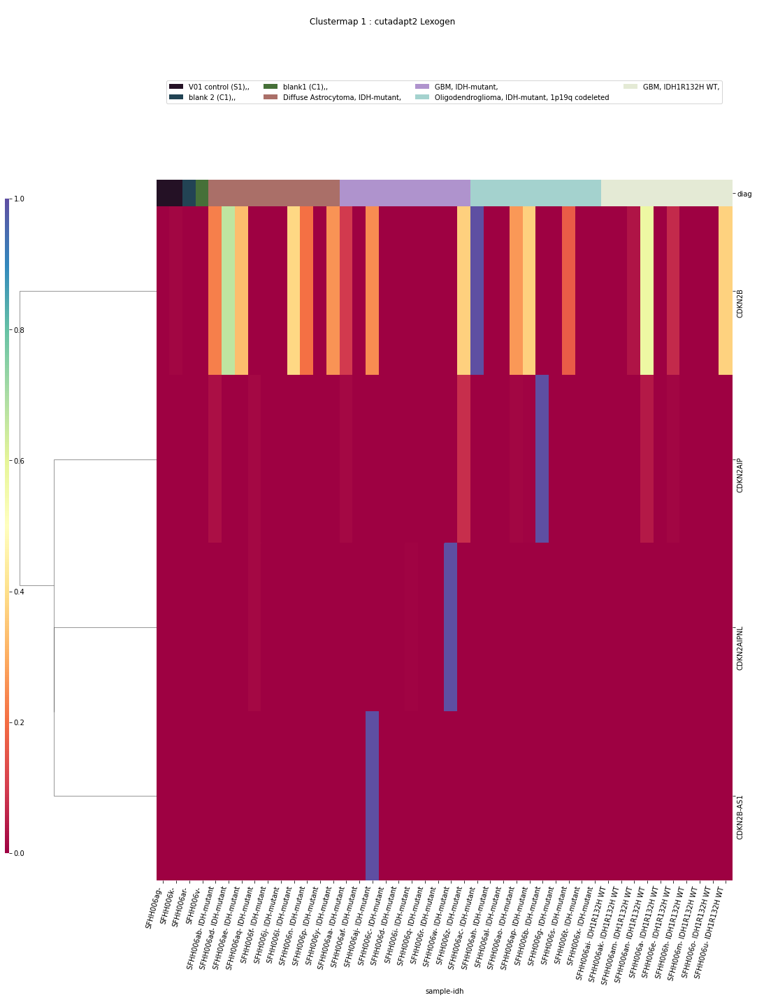

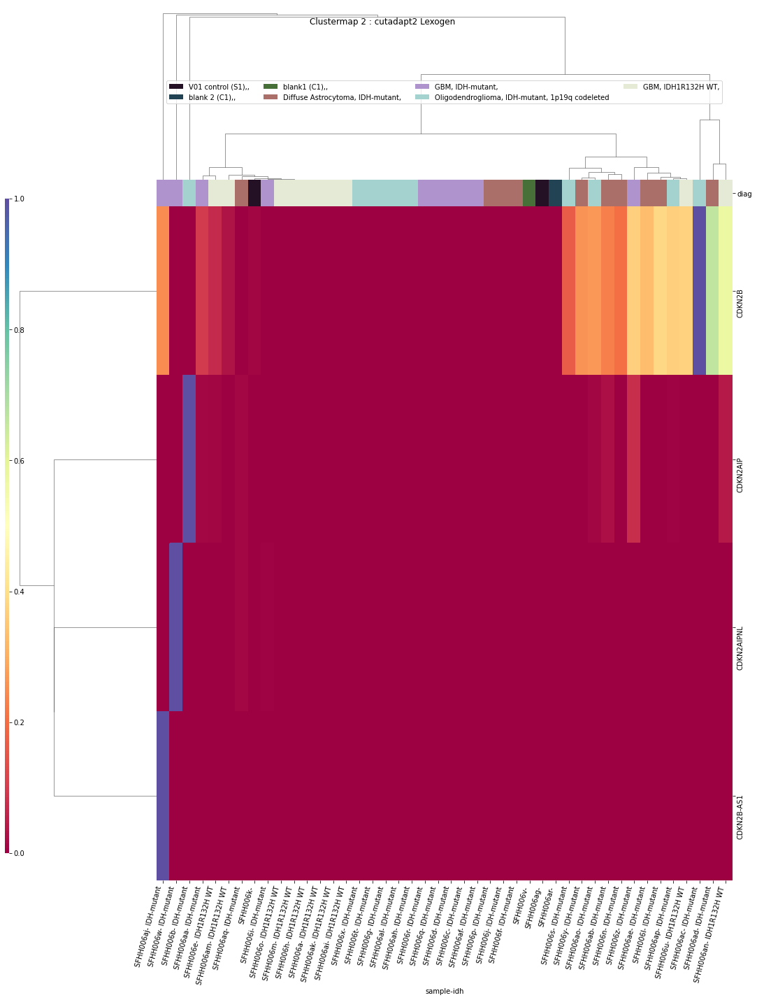

In [65]:
ttests_boxplots_and_heatmaps(dfn,['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1','EGFR',
                                  'EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','NOTCH1','RB1','RB1CC1',
                                  'RB1-DT','TERT','TP53'],box_p=0.1,heat_p=0.2)

In [66]:
datetime.now().strftime("%H:%M:%S")

'10:49:57'

# Elements

 p : 0.0013064702978653278  ( t : 3.80168671554784 ) :  D-plex  :  cutadapt2  :  COL9A2
Control and blanks
76     21213.2
340        0.0
Name: COL9A2, dtype: float64
208    5290.81
Name: COL9A2, dtype: float64
472    25430.06
Name: COL9A2, dtype: float64


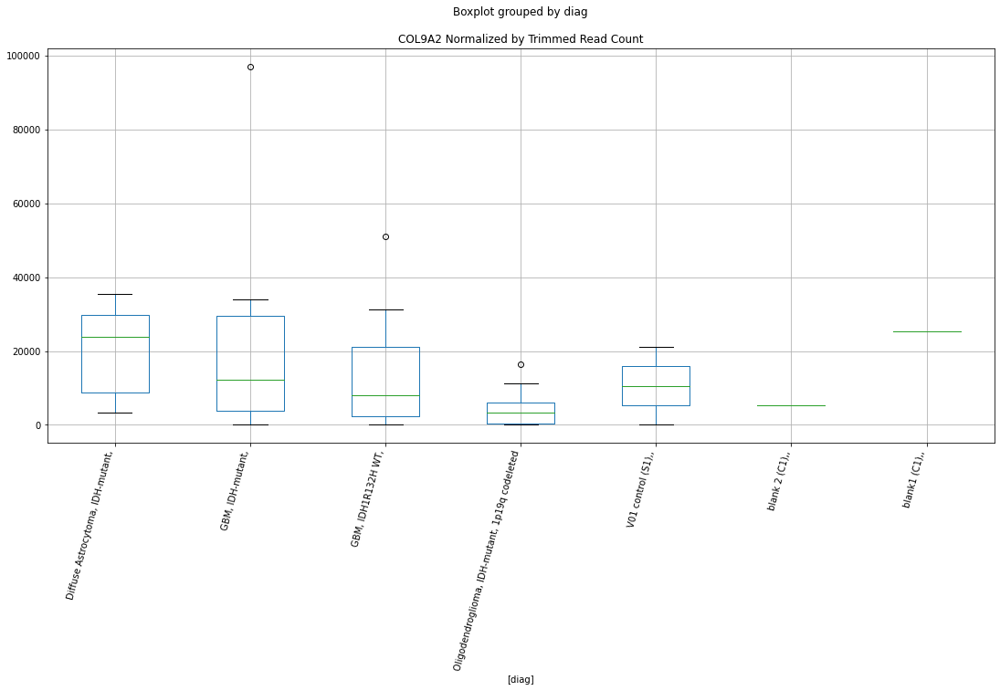

 p : 0.0014313517330719848  ( t : 3.7607179343481807 ) :  Lexogen  :  cutadapt2  :  CAMTA1
Control and blanks
82          0.00
346    235476.23
Name: CAMTA1, dtype: float64
214    0.0
Name: CAMTA1, dtype: float64
478    0.0
Name: CAMTA1, dtype: float64


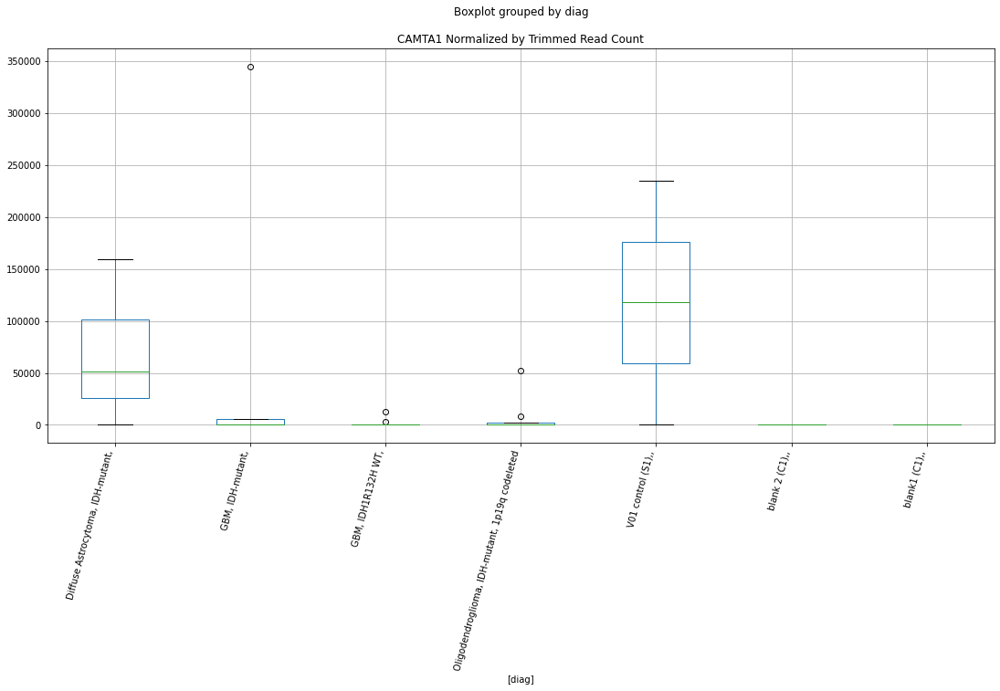

 p : 0.0015045464552558712  ( t : 3.7383331553947996 ) :  Lexogen  :  bbduk2  :  CAMTA1
Control and blanks
79          0.00
343    237579.72
Name: CAMTA1, dtype: float64
211    0.0
Name: CAMTA1, dtype: float64
475    0.0
Name: CAMTA1, dtype: float64


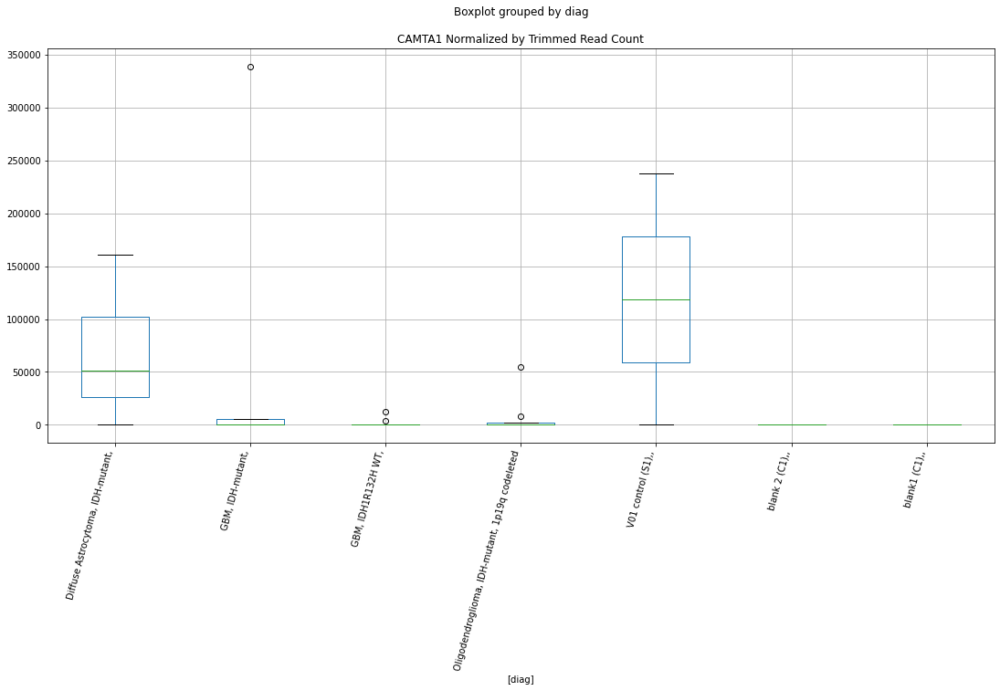

 p : 0.0015746854577744441  ( t : 3.7178792651816637 ) :  D-plex  :  bbduk2  :  CMC1
Control and blanks
73         0.00
337    48068.49
Name: CMC1, dtype: float64
205    3044.55
Name: CMC1, dtype: float64
469    5915.27
Name: CMC1, dtype: float64


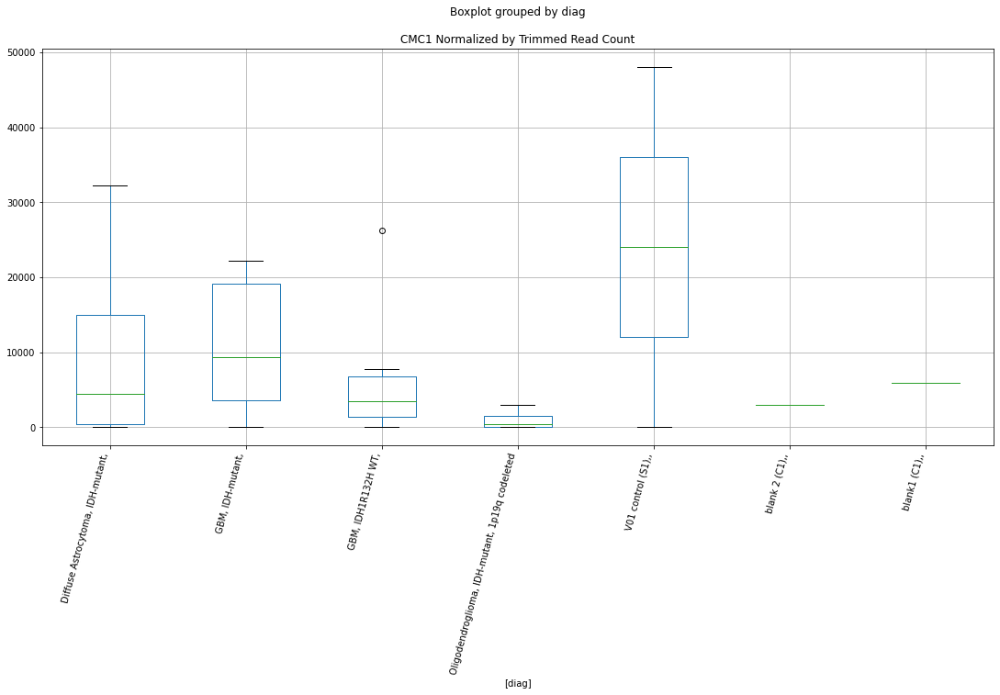

 p : 0.00244784940335801  ( t : 3.5195954326151906 ) :  D-plex  :  cutadapt2  :  CYFIP2
Control and blanks
76     0.0
340    0.0
Name: CYFIP2, dtype: float64
208    7583.49
Name: CYFIP2, dtype: float64
472    6935.47
Name: CYFIP2, dtype: float64


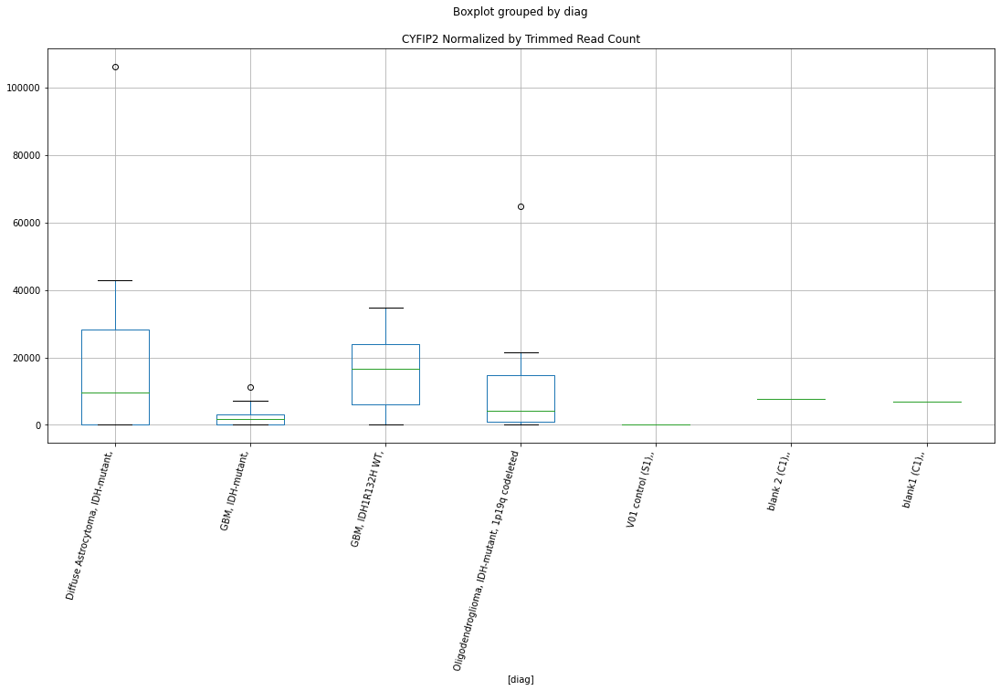

 p : 0.0024954677194864564  ( t : 3.510921178021227 ) :  D-plex  :  bbduk2  :  CYFIP2
Control and blanks
73     0.0
337    0.0
Name: CYFIP2, dtype: float64
205    6268.18
Name: CYFIP2, dtype: float64
469    7098.33
Name: CYFIP2, dtype: float64


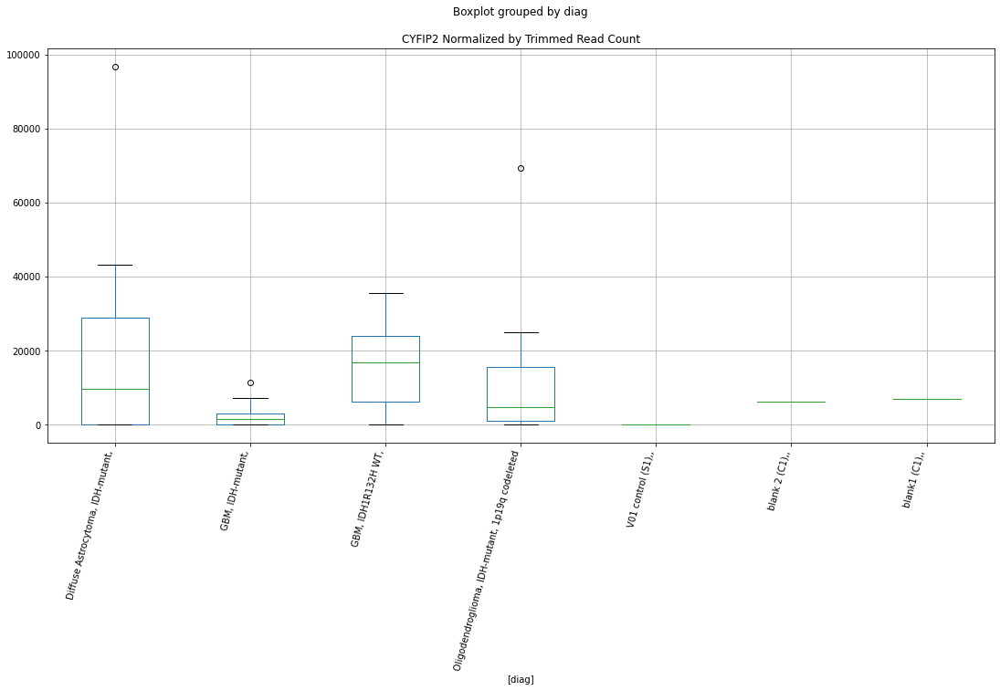

 p : 0.002496618359986424  ( t : 3.5107136095555056 ) :  D-plex  :  cutadapt2  :  CMC1
Control and blanks
76         0.0
340    49321.0
Name: CMC1, dtype: float64
208    2645.4
Name: CMC1, dtype: float64
472    5779.56
Name: CMC1, dtype: float64


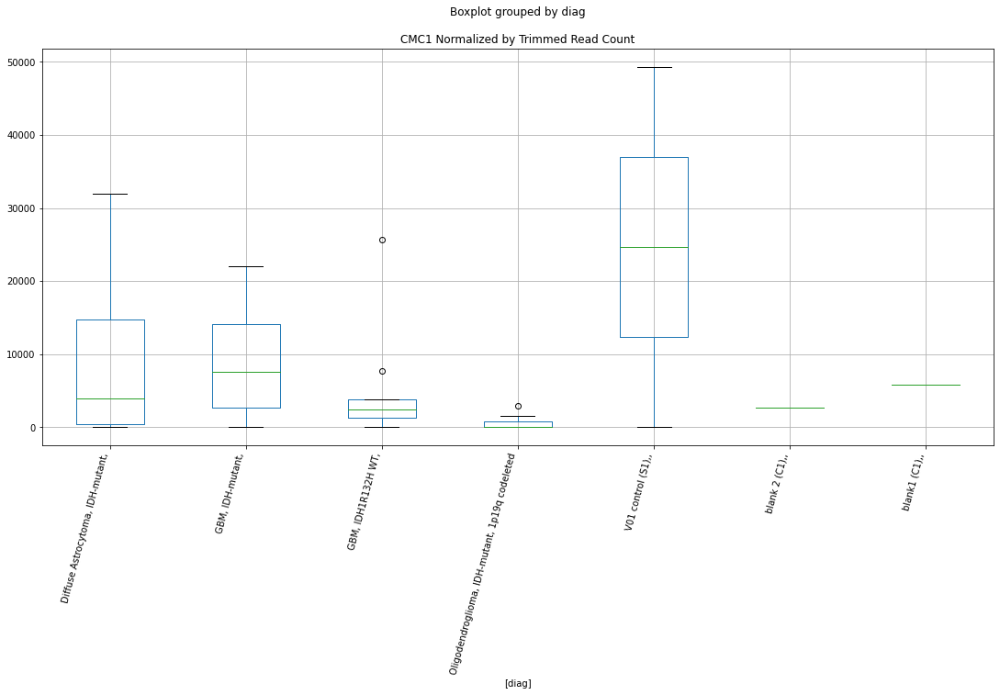

 p : 0.003440584674140582  ( t : 3.3660511659655312 ) :  D-plex  :  bbduk2  :  ACTA1
Control and blanks
73     0.0
337    0.0
Name: ACTA1, dtype: float64
205    1074.55
Name: ACTA1, dtype: float64
469    1183.05
Name: ACTA1, dtype: float64


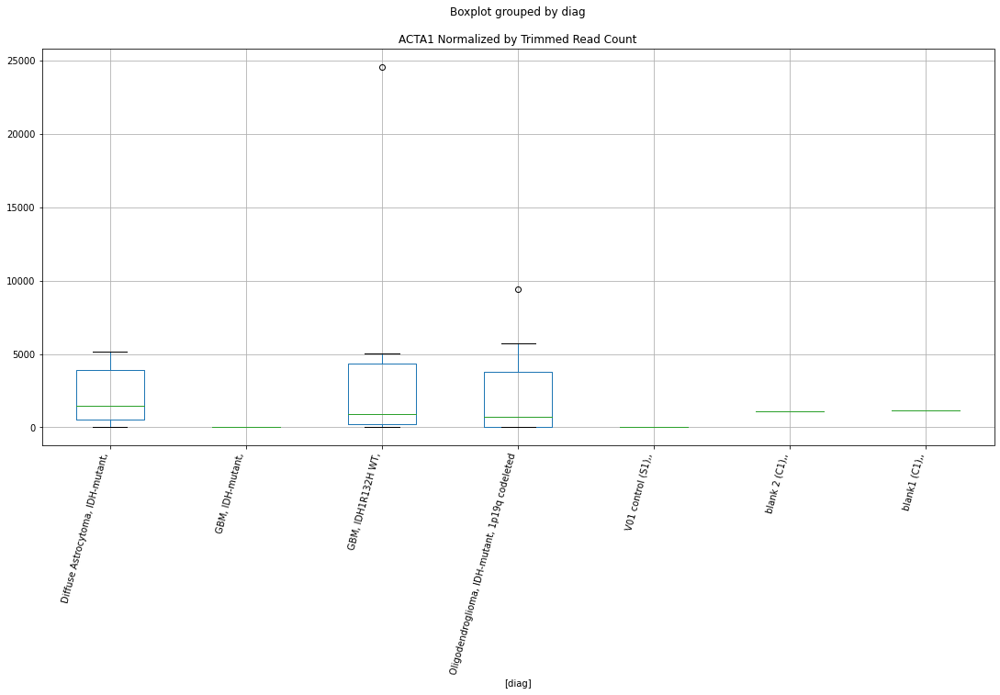

 p : 0.003702151174257556  ( t : 3.332913928761056 ) :  D-plex  :  cutadapt2  :  CYP27B1
Control and blanks
76     0.0
340    0.0
Name: CYP27B1, dtype: float64
208    176.36
Name: CYP27B1, dtype: float64
472    1155.91
Name: CYP27B1, dtype: float64


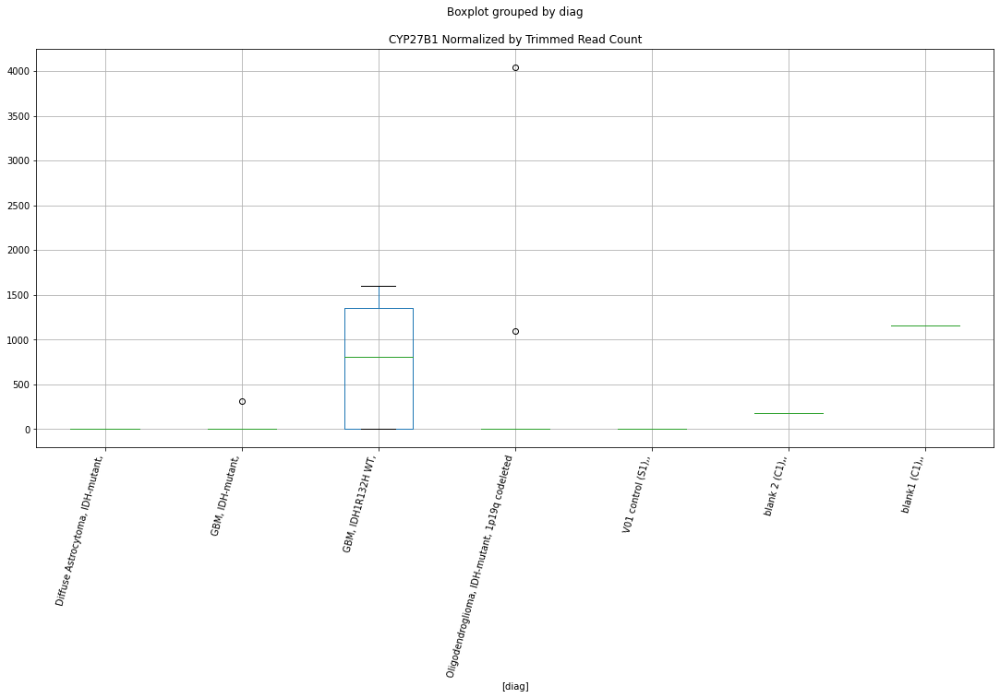

 p : 0.003786447600456847  ( t : 3.32272449666146 ) :  Lexogen  :  cutadapt2  :  CAMTA1
Control and blanks
82          0.00
346    235476.23
Name: CAMTA1, dtype: float64
214    0.0
Name: CAMTA1, dtype: float64
478    0.0
Name: CAMTA1, dtype: float64


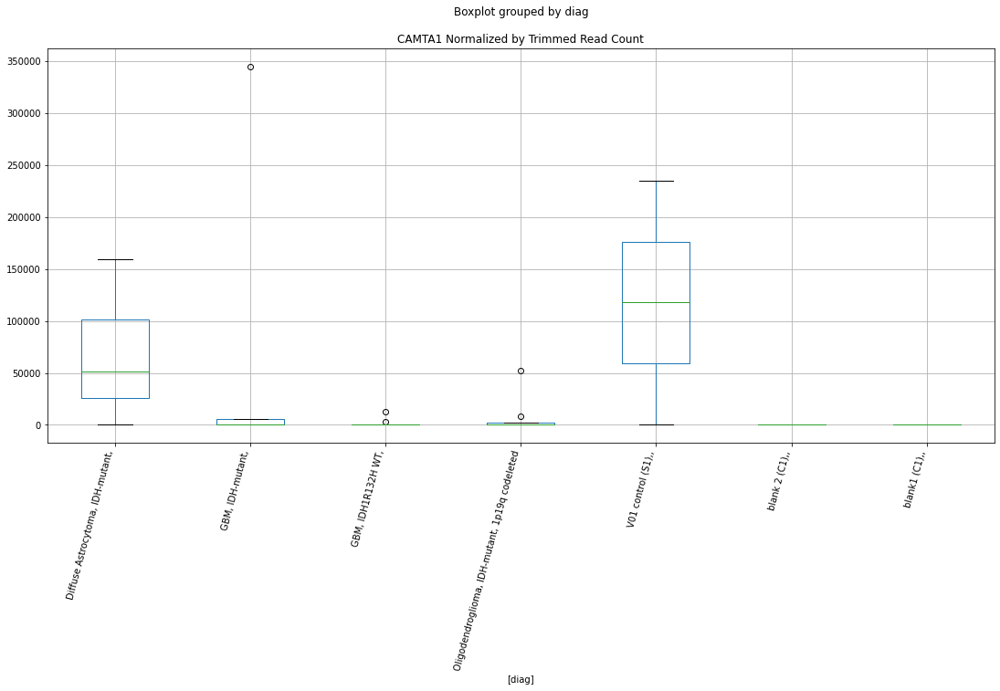

 p : 0.0037876987231471072  ( t : 3.3225749530725937 ) :  D-plex  :  bbduk2  :  CYP27B1
Control and blanks
73     0.0
337    0.0
Name: CYP27B1, dtype: float64
205    179.09
Name: CYP27B1, dtype: float64
469    1183.05
Name: CYP27B1, dtype: float64


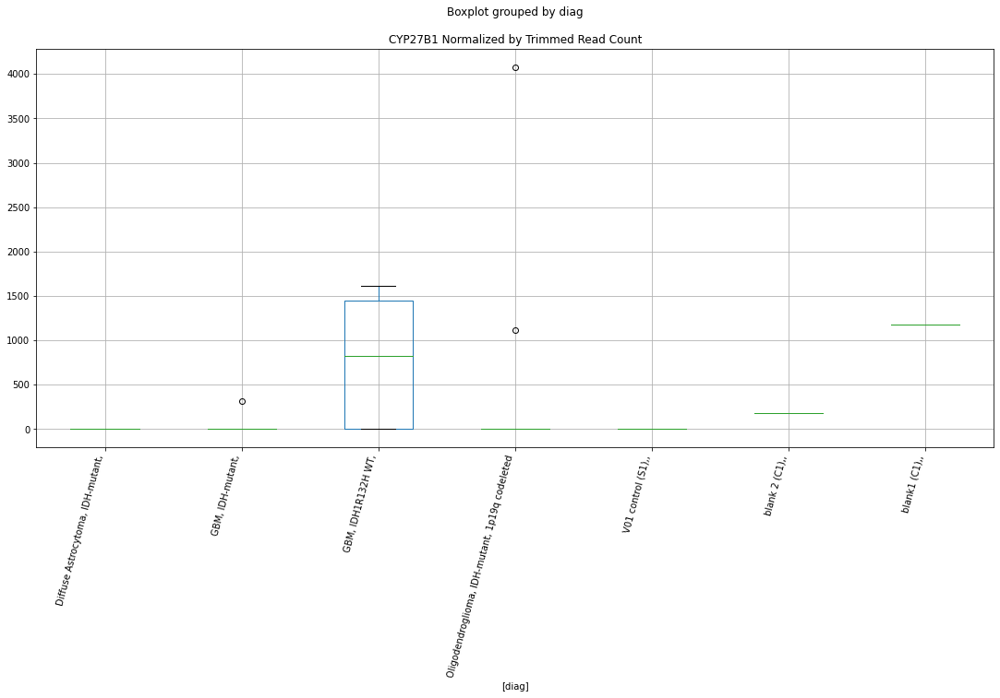

 p : 0.004111667429680416  ( t : 3.2854000557523952 ) :  D-plex  :  bbduk2  :  ARL4D
Control and blanks
73     773.01
337      0.00
Name: ARL4D, dtype: float64
205    34027.28
Name: ARL4D, dtype: float64
469    2366.11
Name: ARL4D, dtype: float64


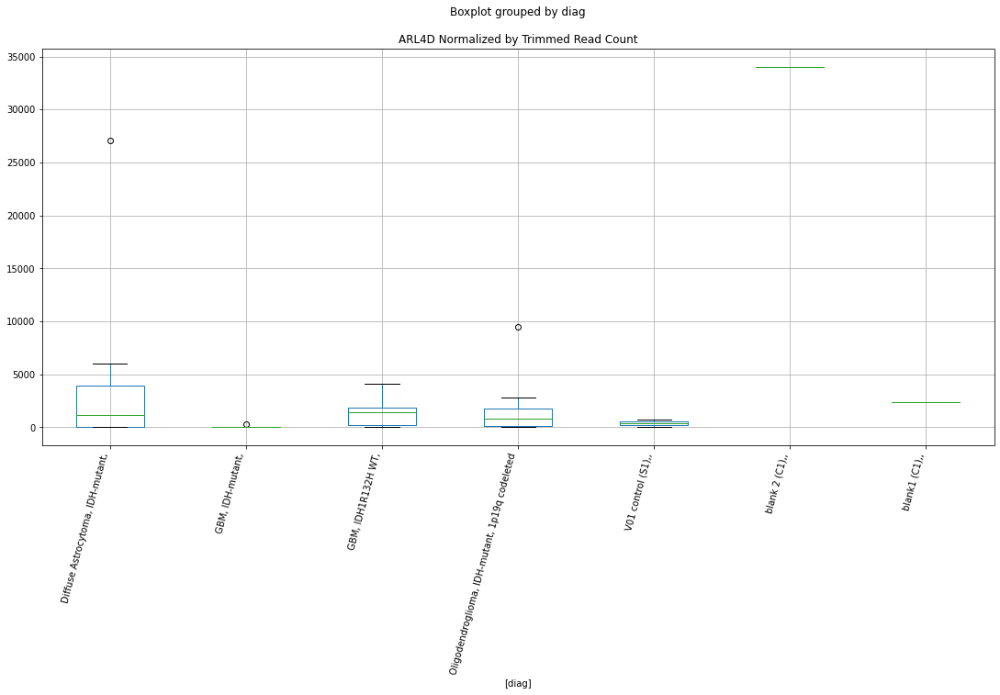

 p : 0.004162828874813565  ( t : 3.2797941034171254 ) :  D-plex  :  bbduk2  :  CHST4
Control and blanks
73      72662.79
337    197614.91
Name: CHST4, dtype: float64
205    360689.18
Name: CHST4, dtype: float64
469    22478.04
Name: CHST4, dtype: float64


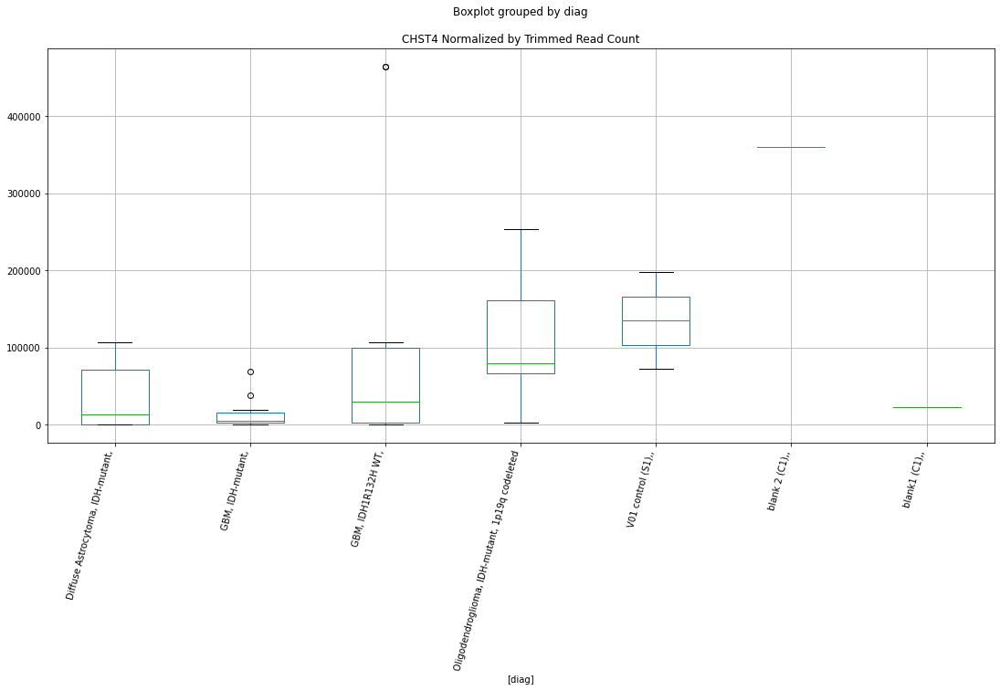

 p : 0.004188335153660307  ( t : 3.277024521036483 ) :  Lexogen  :  bbduk2  :  CAMTA1
Control and blanks
79          0.00
343    237579.72
Name: CAMTA1, dtype: float64
211    0.0
Name: CAMTA1, dtype: float64
475    0.0
Name: CAMTA1, dtype: float64


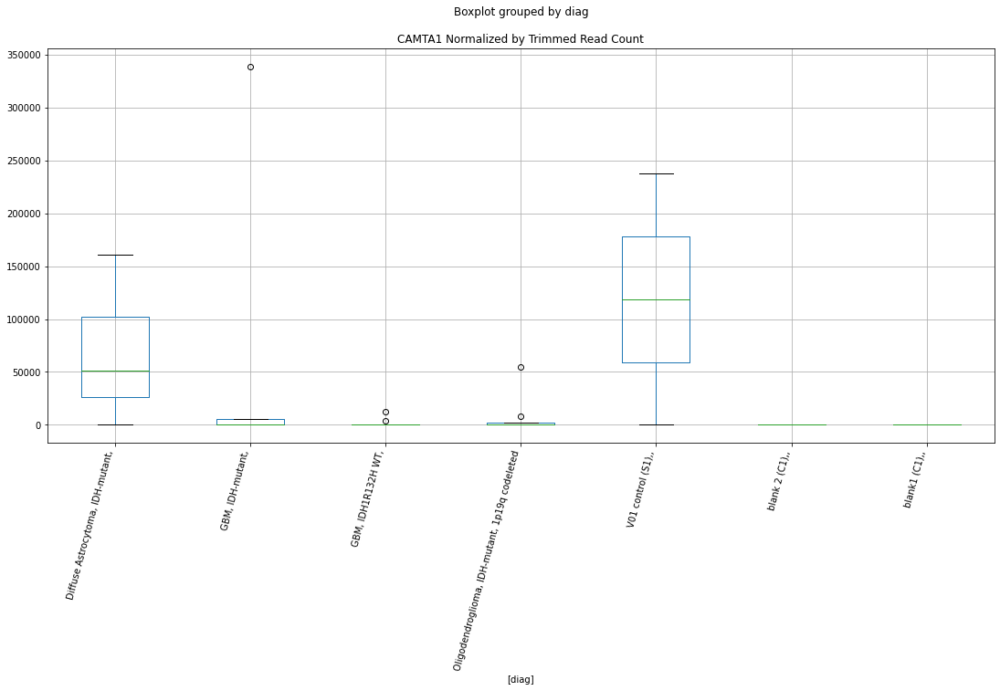

 p : 0.004211648249018493  ( t : 3.2745075388952394 ) :  D-plex  :  cutadapt2  :  ARL4D
Control and blanks
76     757.61
340      0.00
Name: ARL4D, dtype: float64
208    33861.16
Name: ARL4D, dtype: float64
472    2311.82
Name: ARL4D, dtype: float64


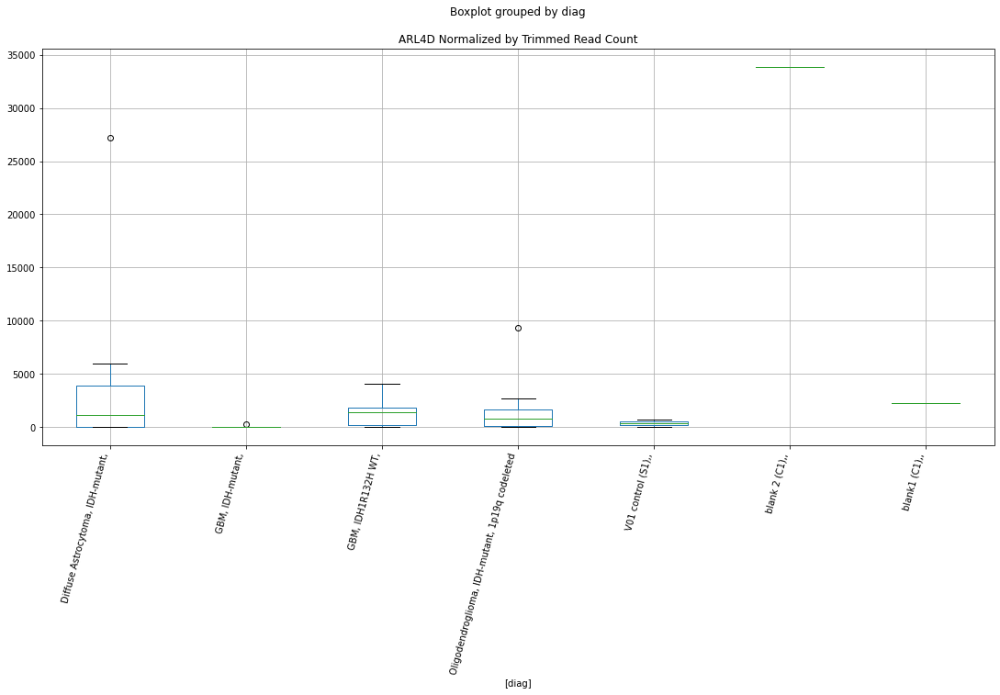

 p : 0.004281902095791052  ( t : 3.2670045612337546 ) :  D-plex  :  cutadapt2  :  CHST4
Control and blanks
76      71215.74
340    197284.00
Name: CHST4, dtype: float64
208    359774.84
Name: CHST4, dtype: float64
472    21962.32
Name: CHST4, dtype: float64


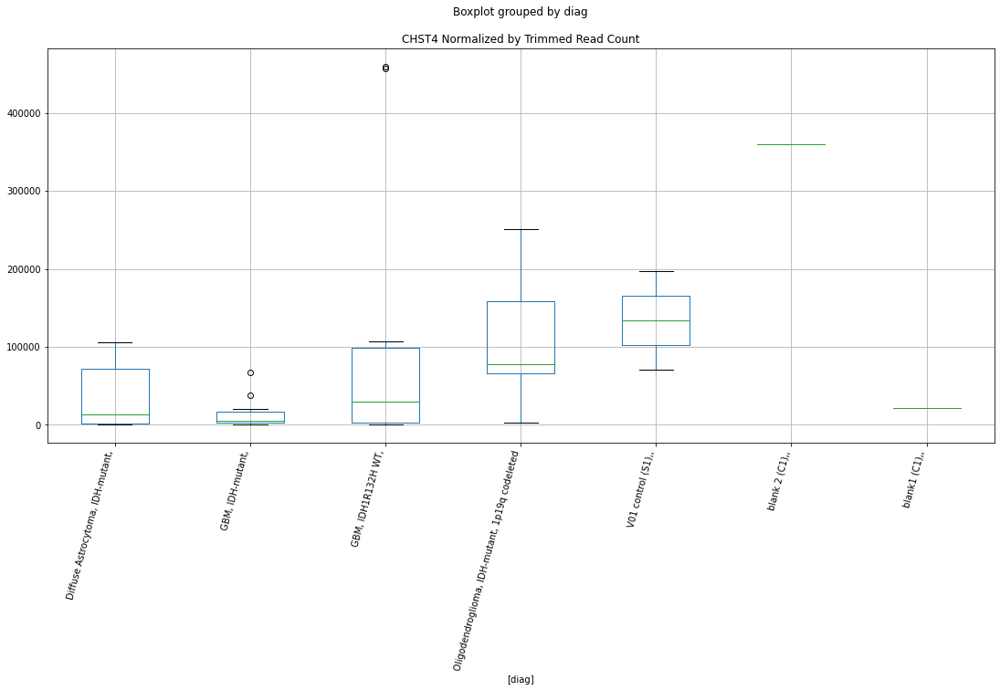

 p : 0.004444332823890503  ( t : 3.250110028750164 ) :  Lexogen  :  cutadapt2  :  CYREN
Control and blanks
82     0.0
346    0.0
Name: CYREN, dtype: float64
214    0.0
Name: CYREN, dtype: float64
478    0.0
Name: CYREN, dtype: float64


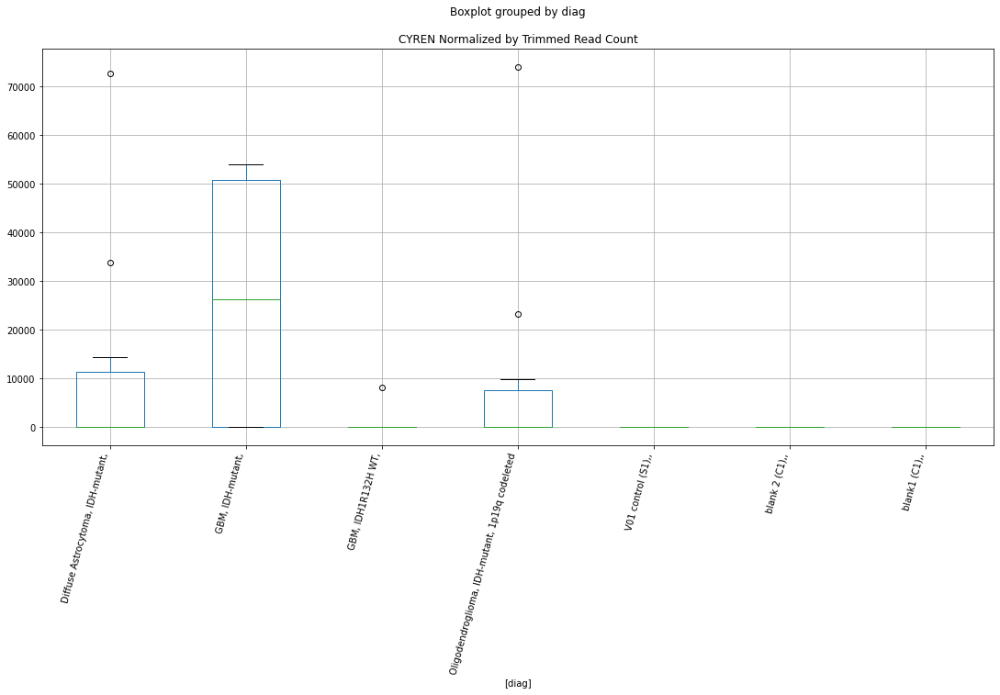

 p : 0.004492509235625432  ( t : 3.245215597038631 ) :  D-plex  :  bbduk2  :  DGKB
Control and blanks
73     0.0
337    0.0
Name: DGKB, dtype: float64
205    16118.19
Name: DGKB, dtype: float64
469    21886.51
Name: DGKB, dtype: float64


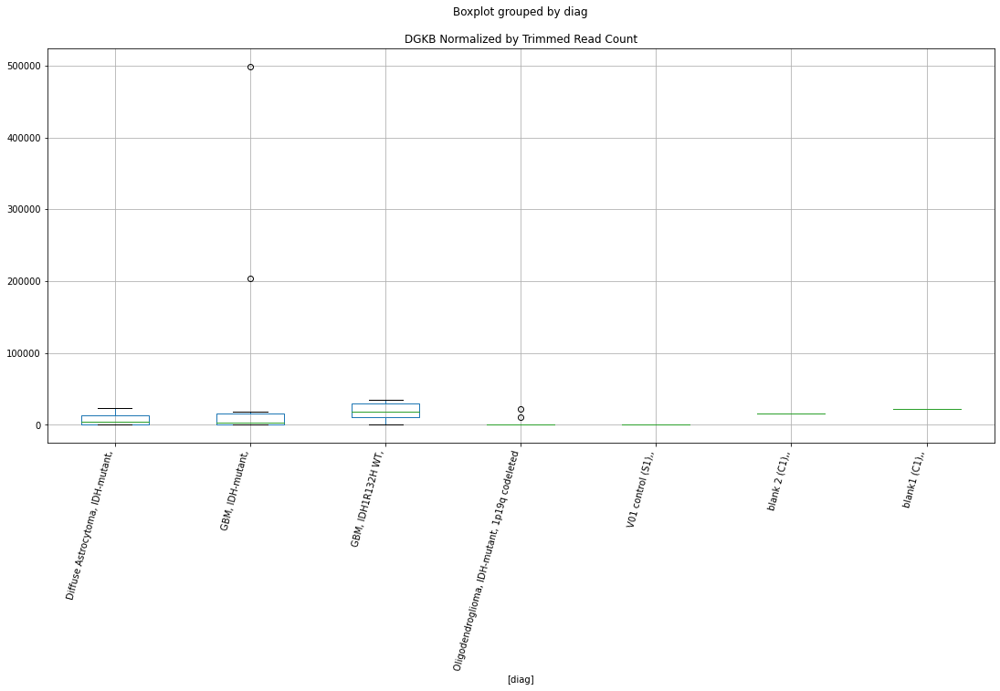

 p : 0.004494357805307385  ( t : 3.2450288211188987 ) :  D-plex  :  bbduk2  :  ANKRD45
Control and blanks
73     0.0
337    0.0
Name: ANKRD45, dtype: float64
205    1253.64
Name: ANKRD45, dtype: float64
469    2957.64
Name: ANKRD45, dtype: float64


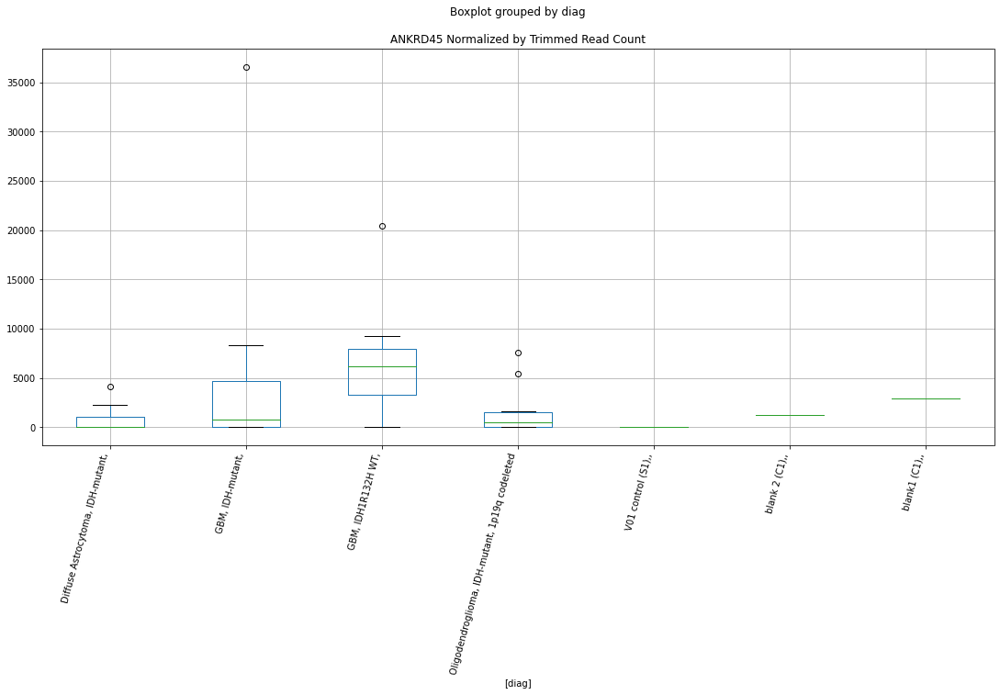

 p : 0.0046356831725478205  ( t : 3.23096817960373 ) :  Lexogen  :  bbduk2  :  CYREN
Control and blanks
79        0.00
343    1273.89
Name: CYREN, dtype: float64
211    0.0
Name: CYREN, dtype: float64
475    0.0
Name: CYREN, dtype: float64


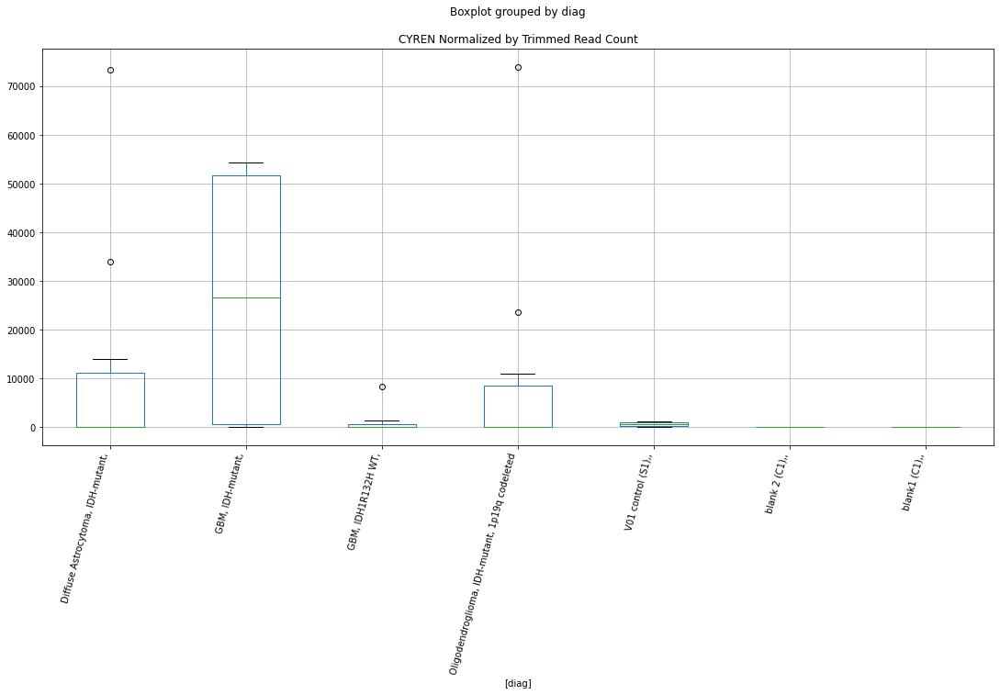

 p : 0.00508522864579147  ( t : 3.188882944429498 ) :  Lexogen  :  cutadapt2  :  CHRD
Control and blanks
82     0.0
346    0.0
Name: CHRD, dtype: float64
214    5153.3
Name: CHRD, dtype: float64
478    0.0
Name: CHRD, dtype: float64


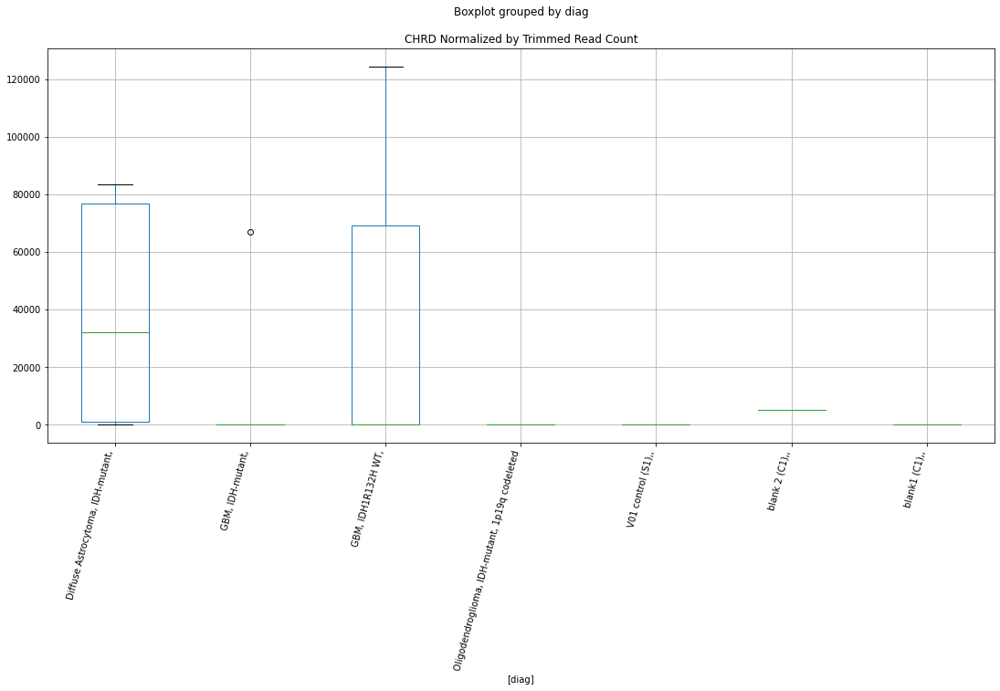

 p : 0.00527853251139948  ( t : 3.1718961585759344 ) :  D-plex  :  bbduk2  :  CORO1B
Control and blanks
73     25509.28
337    98807.46
Name: CORO1B, dtype: float64
205    31161.83
Name: CORO1B, dtype: float64
469    335987.52
Name: CORO1B, dtype: float64


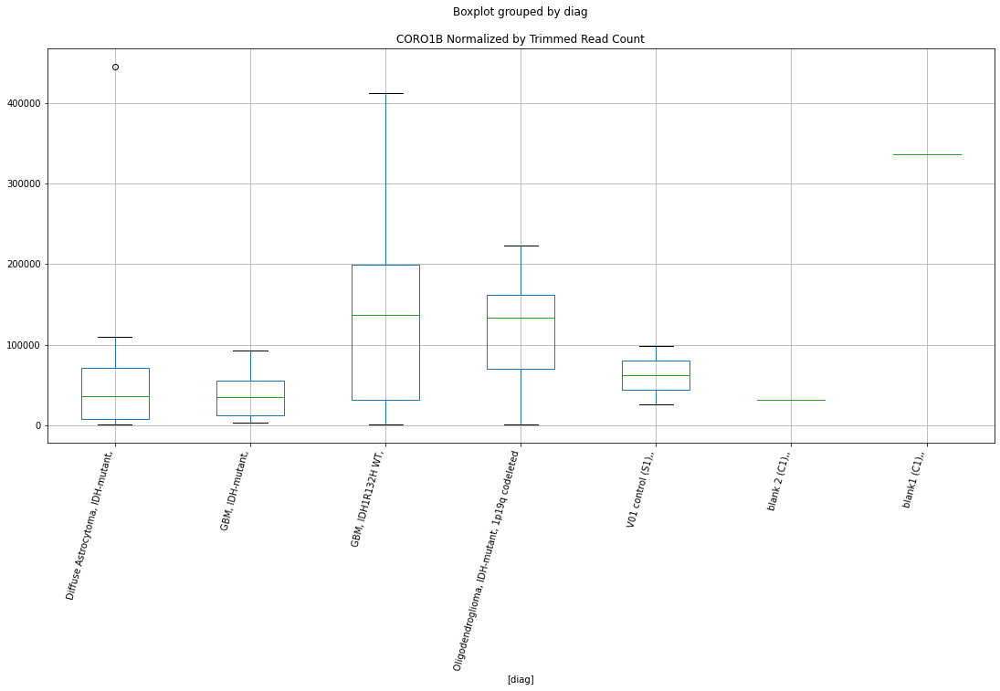

 p : 0.0053050434874177725  ( t : 3.1696140838157216 ) :  D-plex  :  cutadapt2  :  CORO1B
Control and blanks
76     20455.58
340    97761.27
Name: CORO1B, dtype: float64
208    30510.32
Name: CORO1B, dtype: float64
472    328856.87
Name: CORO1B, dtype: float64


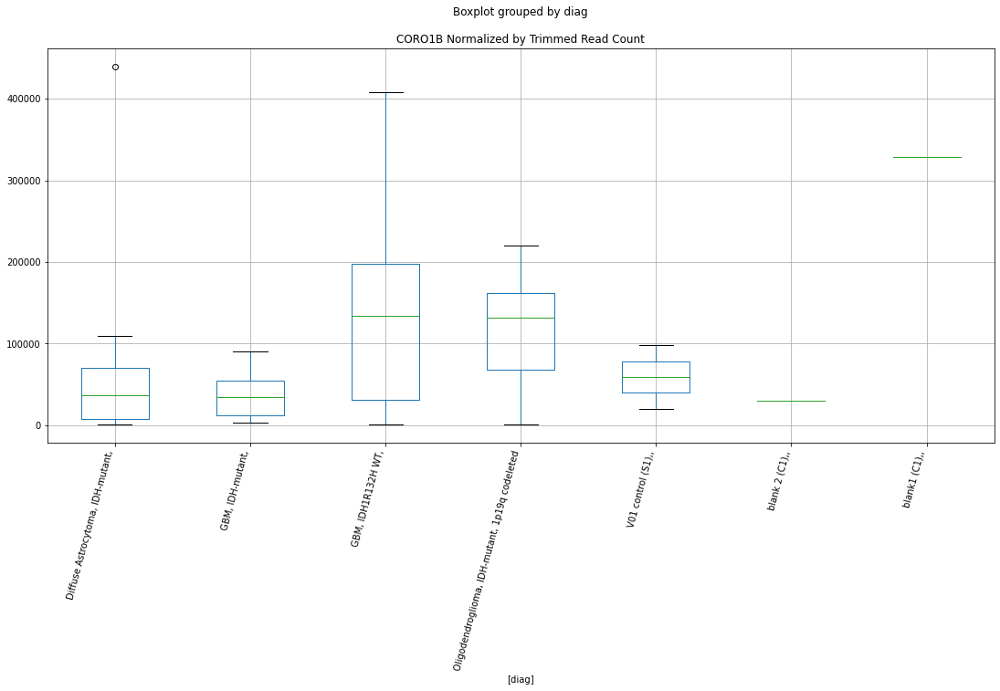

 p : 0.005482068842985575  ( t : 3.1546556623436626 ) :  D-plex  :  cutadapt2  :  CYP27B1
Control and blanks
76     0.0
340    0.0
Name: CYP27B1, dtype: float64
208    176.36
Name: CYP27B1, dtype: float64
472    1155.91
Name: CYP27B1, dtype: float64


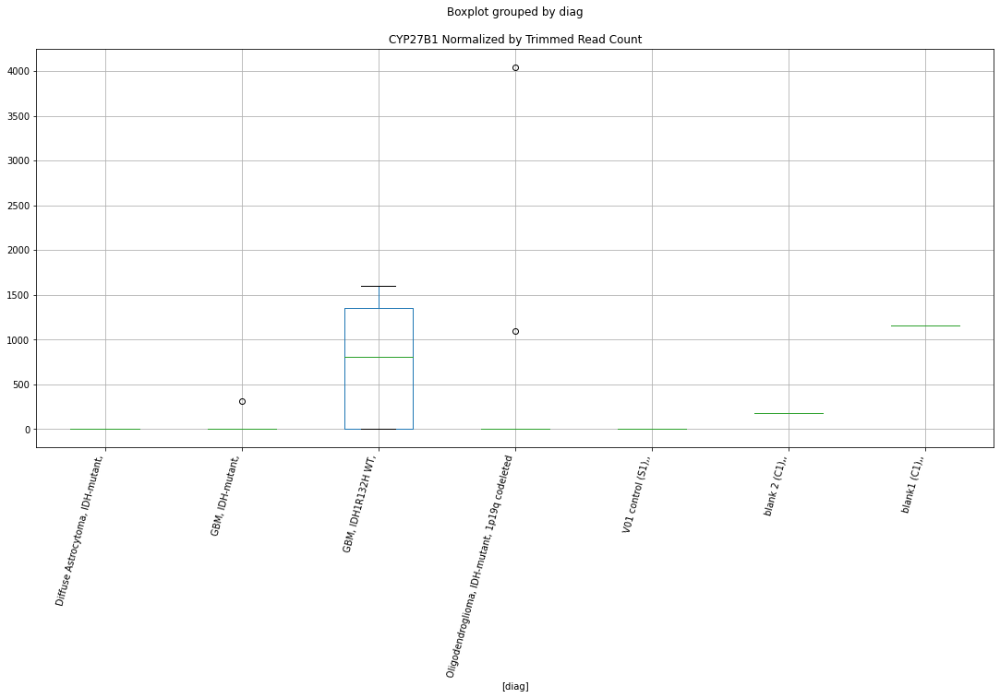

 p : 0.005552105138588785  ( t : 3.148867691867706 ) :  D-plex  :  bbduk2  :  CYP27B1
Control and blanks
73     0.0
337    0.0
Name: CYP27B1, dtype: float64
205    179.09
Name: CYP27B1, dtype: float64
469    1183.05
Name: CYP27B1, dtype: float64


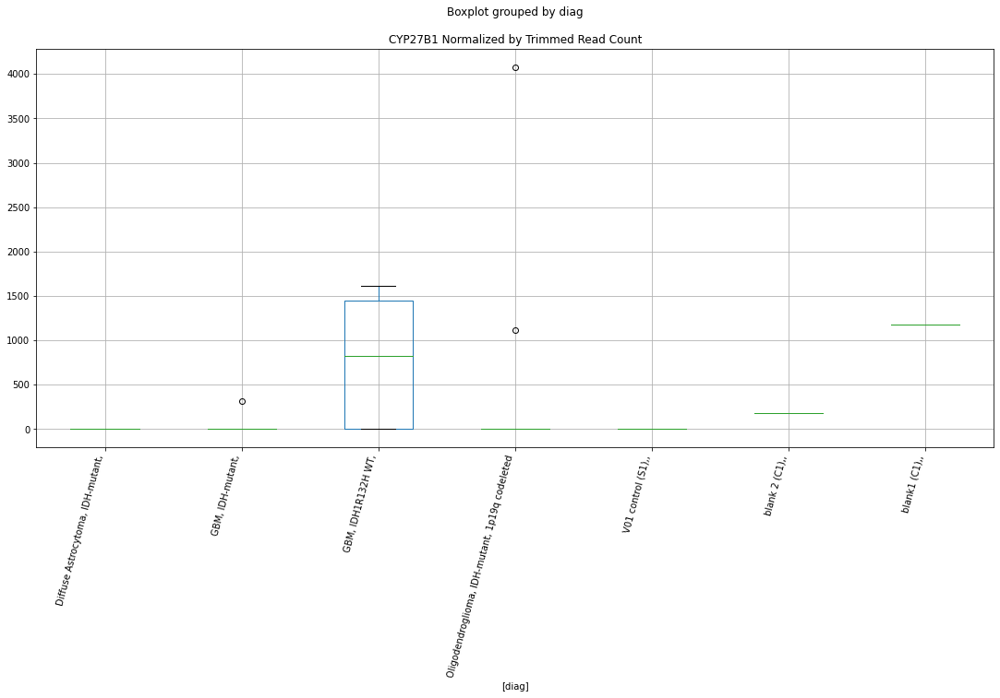

 p : 0.005558571700234226  ( t : 3.1483368830339264 ) :  D-plex  :  cutadapt2  :  CD3D
Control and blanks
76     0.0
340    0.0
Name: CD3D, dtype: float64
208    5819.89
Name: CD3D, dtype: float64
472    146800.78
Name: CD3D, dtype: float64


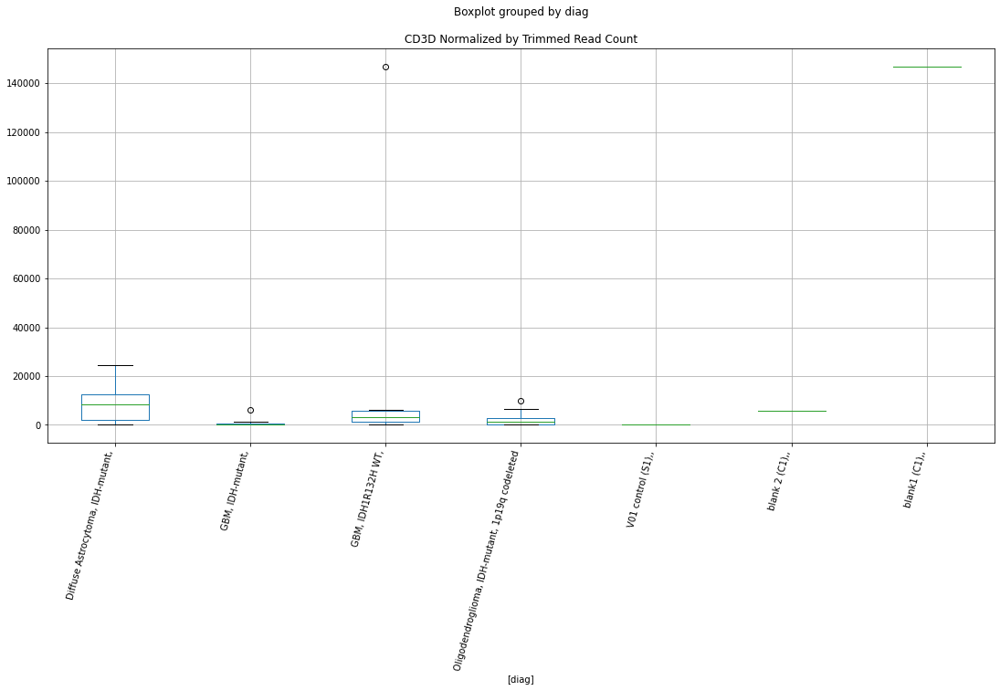

 p : 0.005668753979126676  ( t : 3.1393841092152184 ) :  D-plex  :  bbduk2  :  B3GALNT2
Control and blanks
73     6184.07
337    8901.57
Name: B3GALNT2, dtype: float64
205    0.0
Name: B3GALNT2, dtype: float64
469    4732.22
Name: B3GALNT2, dtype: float64


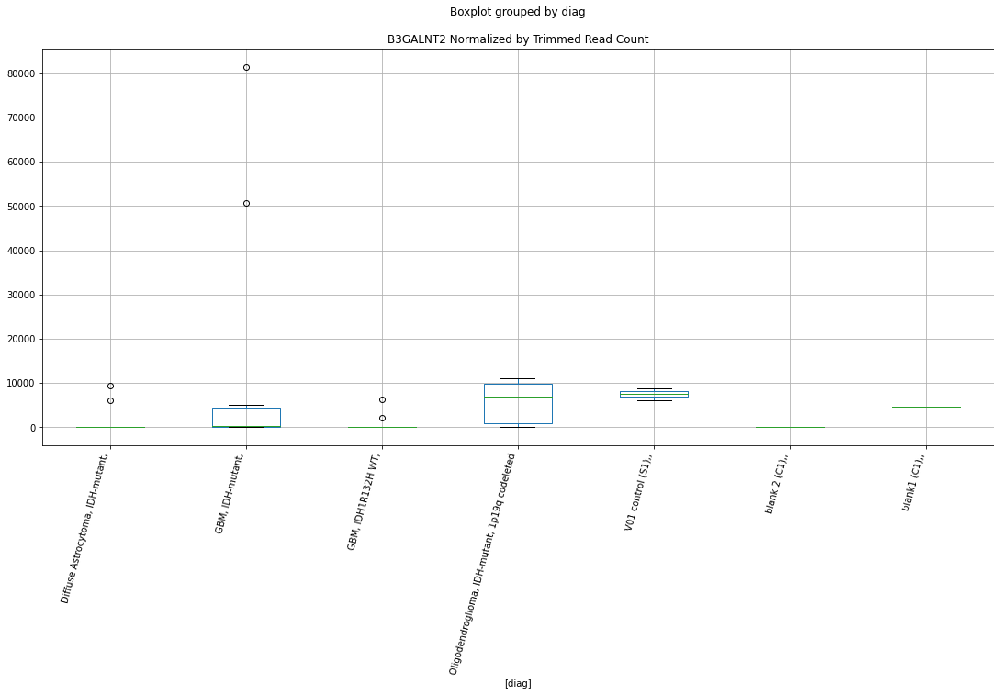

 p : 0.0059379909841582226  ( t : 3.118203237617442 ) :  Lexogen  :  cutadapt2  :  CCR2
Control and blanks
82     17040.61
346        0.00
Name: CCR2, dtype: float64
214    0.0
Name: CCR2, dtype: float64
478    0.0
Name: CCR2, dtype: float64


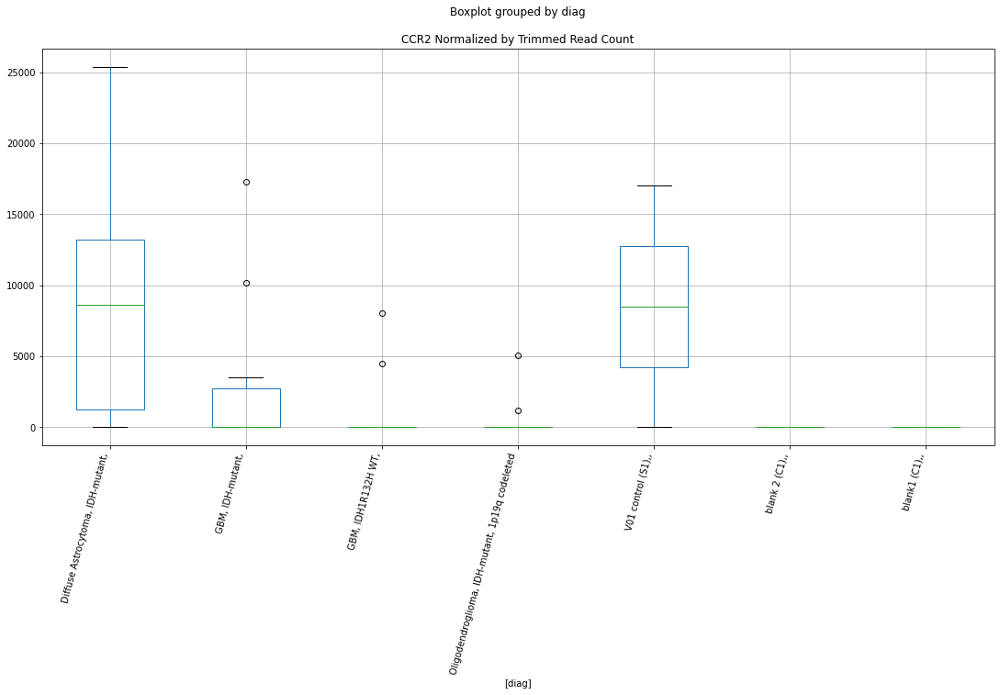

 p : 0.005956386963144691  ( t : 3.1167904473311054 ) :  Lexogen  :  bbduk2  :  CHRD
Control and blanks
79     0.0
343    0.0
Name: CHRD, dtype: float64
211    5192.82
Name: CHRD, dtype: float64
475    0.0
Name: CHRD, dtype: float64


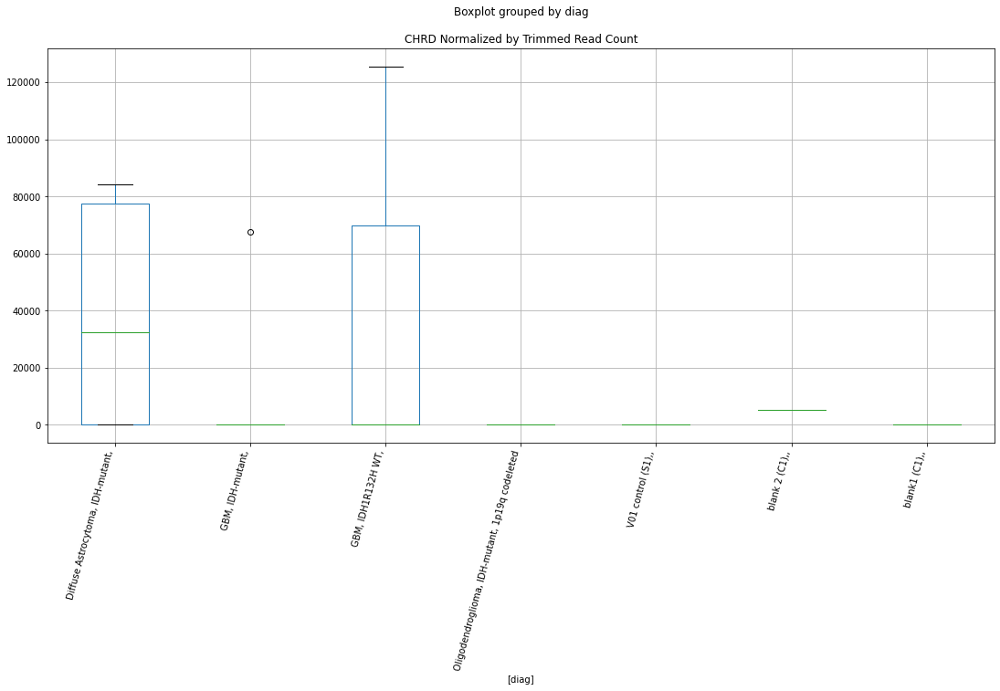

 p : 0.006067425435878584  ( t : 3.1083521896027557 ) :  Lexogen  :  bbduk2  :  CCR2
Control and blanks
79     17167.19
343        0.00
Name: CCR2, dtype: float64
211    0.0
Name: CCR2, dtype: float64
475    0.0
Name: CCR2, dtype: float64


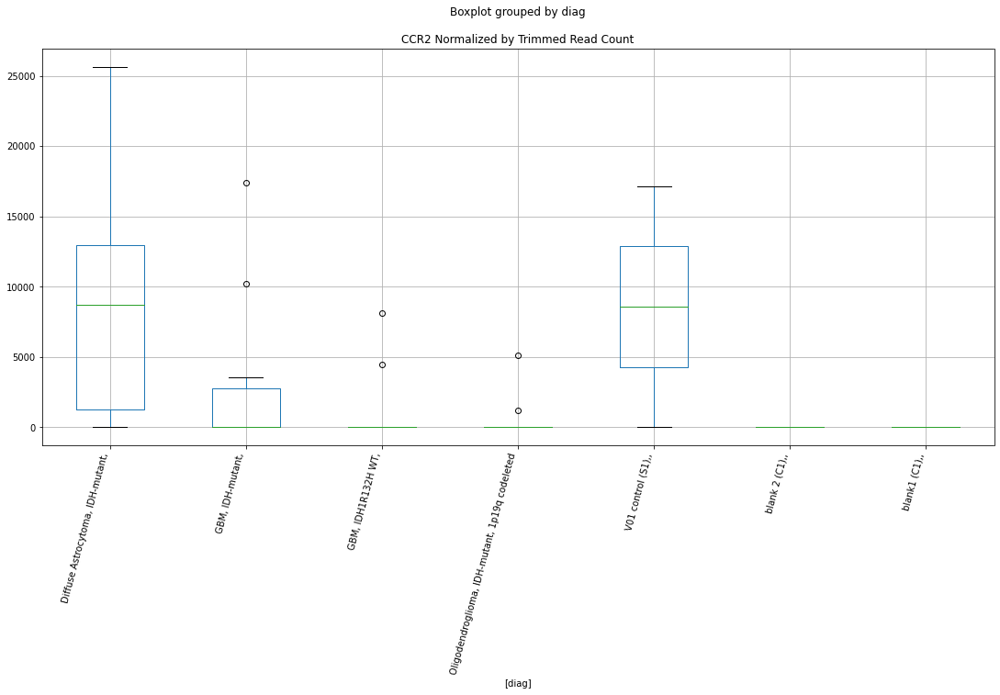

 p : 0.00614535070588001  ( t : 3.102519832857557 ) :  Lexogen  :  cutadapt2  :  CH507-42P11.6
Control and blanks
82     0.0
346    0.0
Name: CH507-42P11.6, dtype: float64
214    813.68
Name: CH507-42P11.6, dtype: float64
478    0.0
Name: CH507-42P11.6, dtype: float64


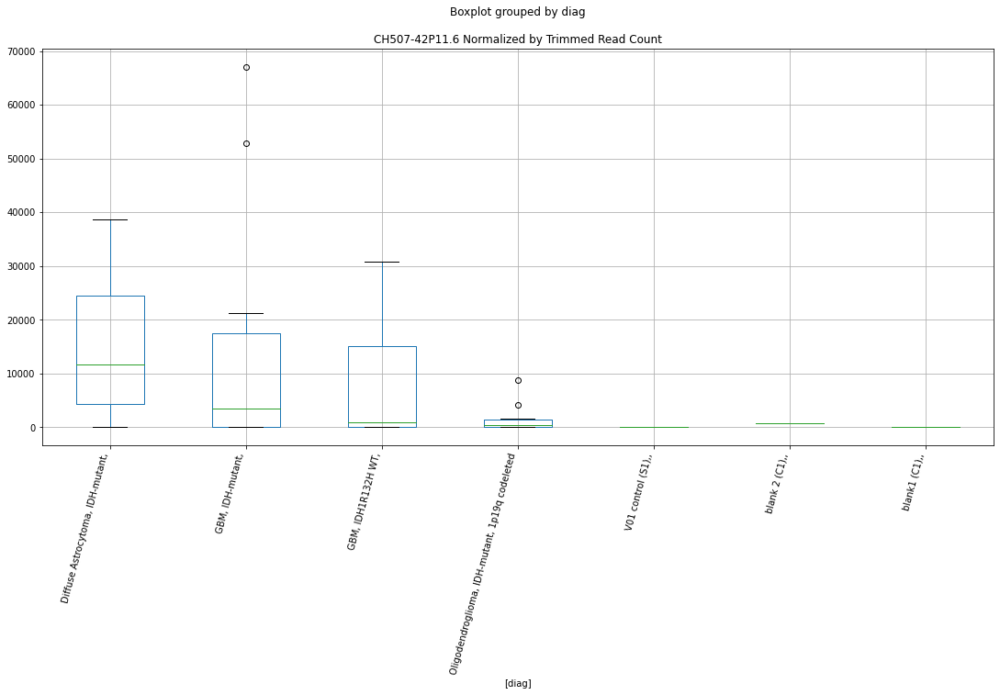

 p : 0.006169002214275082  ( t : 3.100763888927082 ) :  Lexogen  :  bbduk2  :  CH507-42P11.6
Control and blanks
79     0.0
343    0.0
Name: CH507-42P11.6, dtype: float64
211    819.92
Name: CH507-42P11.6, dtype: float64
475    0.0
Name: CH507-42P11.6, dtype: float64


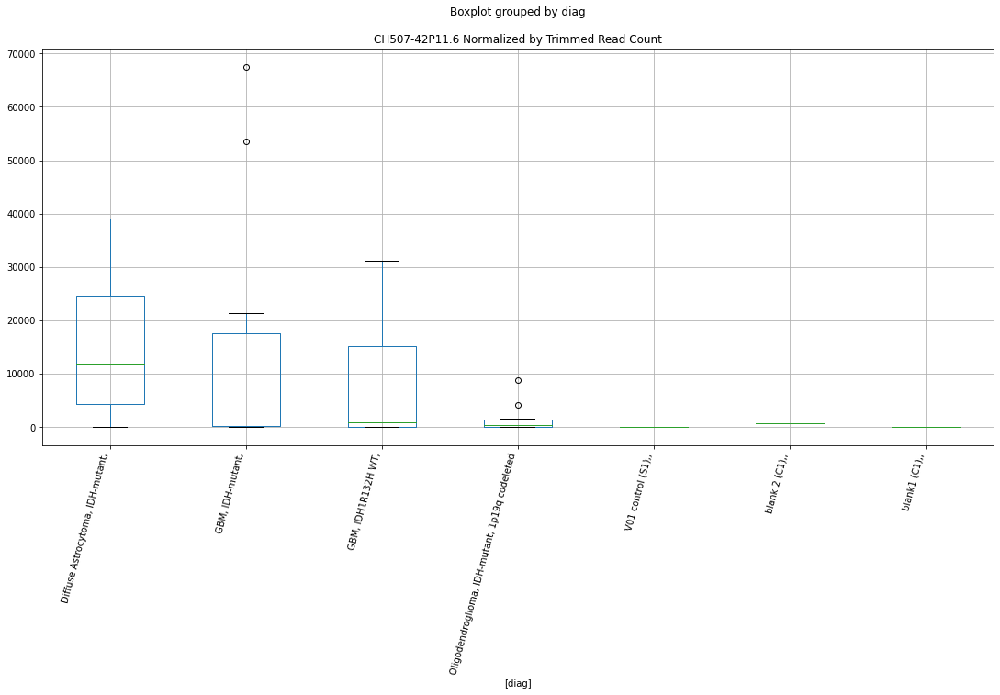

 p : 0.0061813037129822305  ( t : 3.099853190475982 ) :  D-plex  :  cutadapt2  :  COIL
Control and blanks
76     0.0
340    0.0
Name: COIL, dtype: float64
208    352.72
Name: COIL, dtype: float64
472    0.0
Name: COIL, dtype: float64


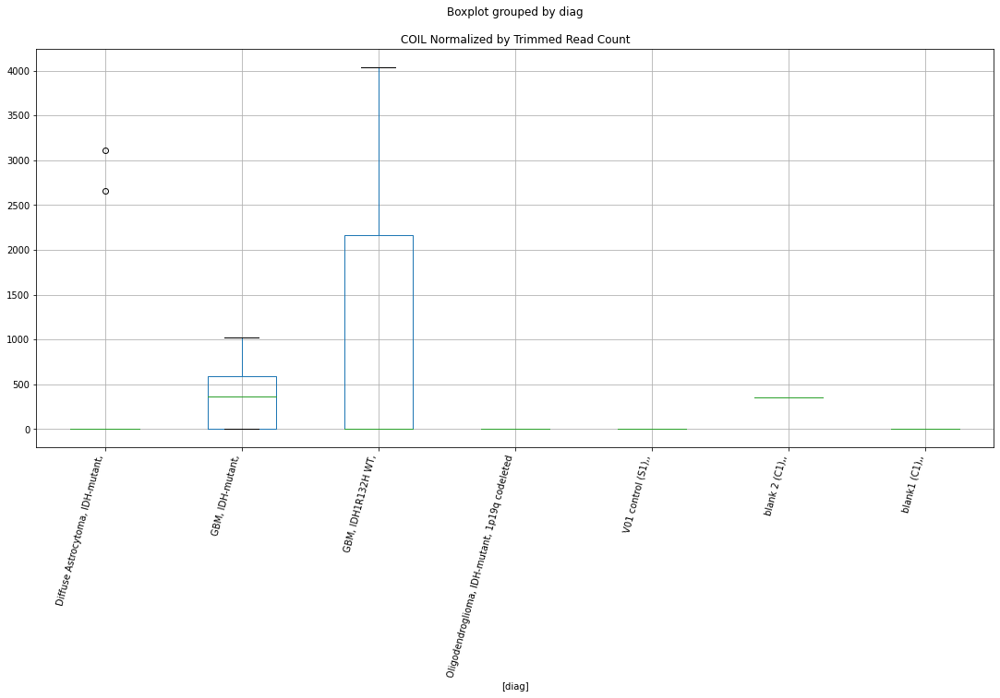

 p : 0.00669858789158025  ( t : 3.063074465814266 ) :  D-plex  :  cutadapt2  :  CHD8
Control and blanks
76     0.0
340    0.0
Name: CHD8, dtype: float64
208    1410.88
Name: CHD8, dtype: float64
472    577.96
Name: CHD8, dtype: float64


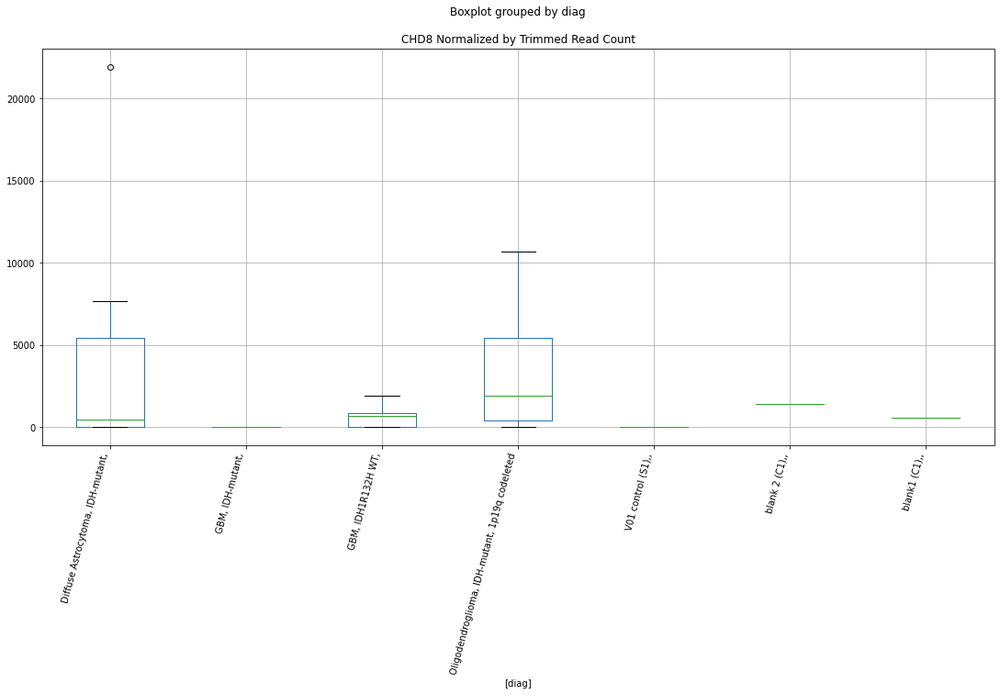

 p : 0.007475489949250835  ( t : 3.012730326469399 ) :  Lexogen  :  bbduk2  :  ADARB2
Control and blanks
79         0.0
343    14862.0
Name: ADARB2, dtype: float64
211    2459.76
Name: ADARB2, dtype: float64
475    0.0
Name: ADARB2, dtype: float64


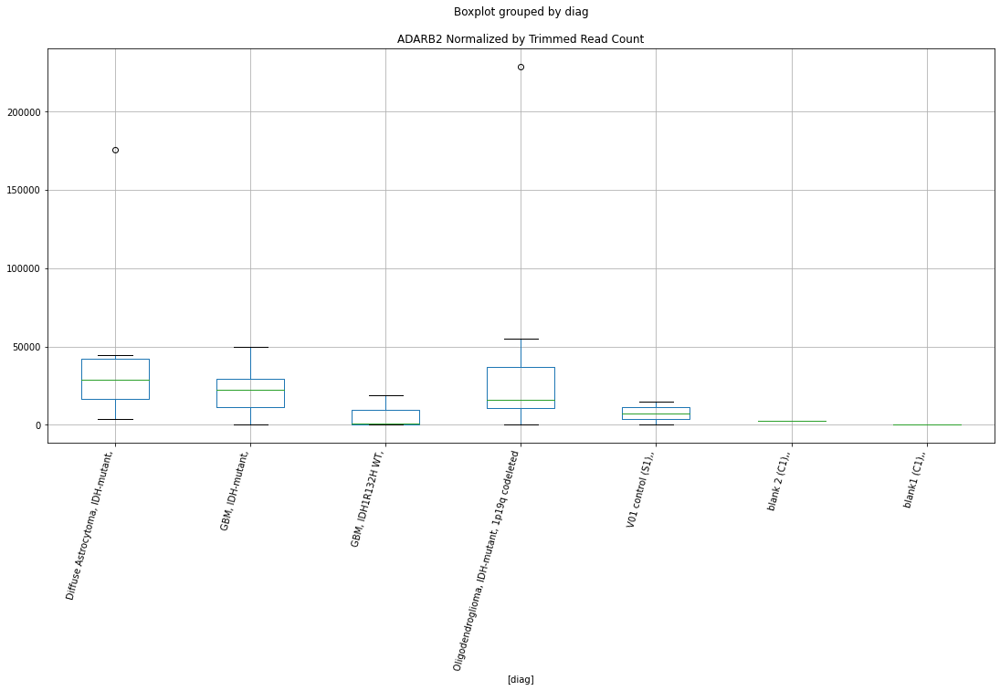

 p : 0.00749041656354098  ( t : 3.0118137344012794 ) :  Lexogen  :  cutadapt2  :  ADARB2
Control and blanks
82         0.00
346    14940.85
Name: ADARB2, dtype: float64
214    2441.04
Name: ADARB2, dtype: float64
478    0.0
Name: ADARB2, dtype: float64


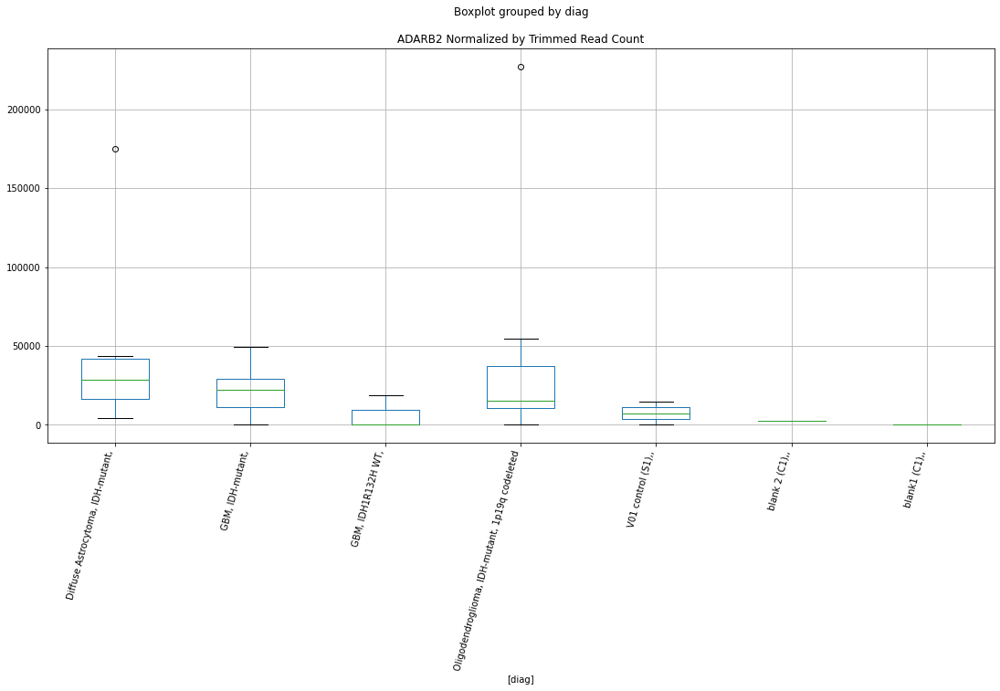

 p : 0.00835163981652714  ( t : 2.9617229209130693 ) :  D-plex  :  cutadapt2  :  ACTA1
Control and blanks
76     0.0
340    0.0
Name: ACTA1, dtype: float64
208    1058.16
Name: ACTA1, dtype: float64
472    1155.91
Name: ACTA1, dtype: float64


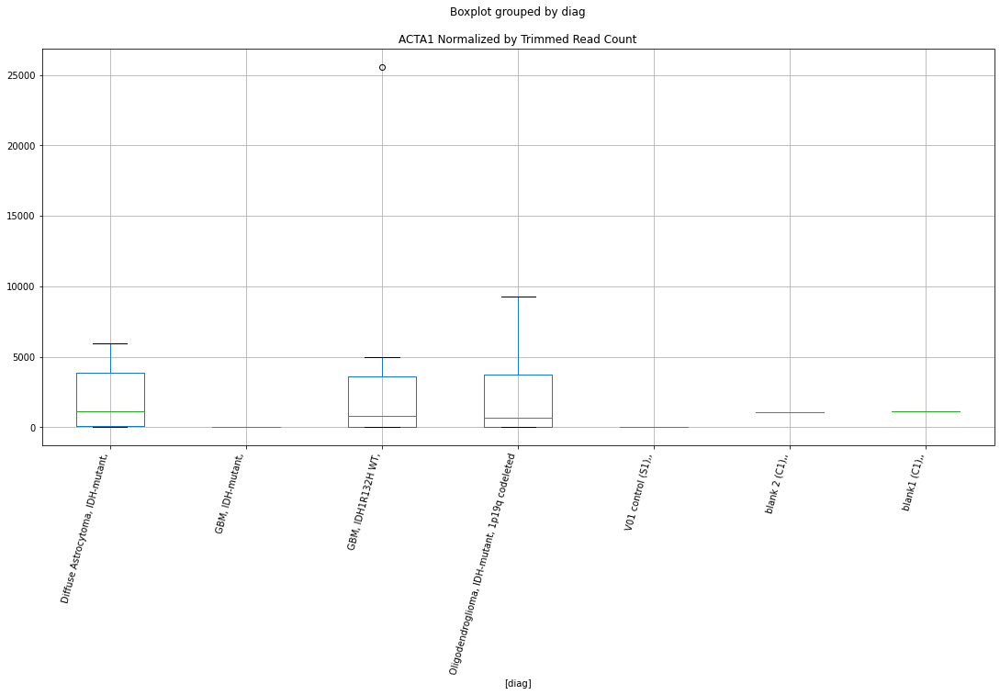

 p : 0.008390302731763376  ( t : 2.959593509162457 ) :  D-plex  :  cutadapt2  :  CHD8
Control and blanks
76     0.0
340    0.0
Name: CHD8, dtype: float64
208    1410.88
Name: CHD8, dtype: float64
472    577.96
Name: CHD8, dtype: float64


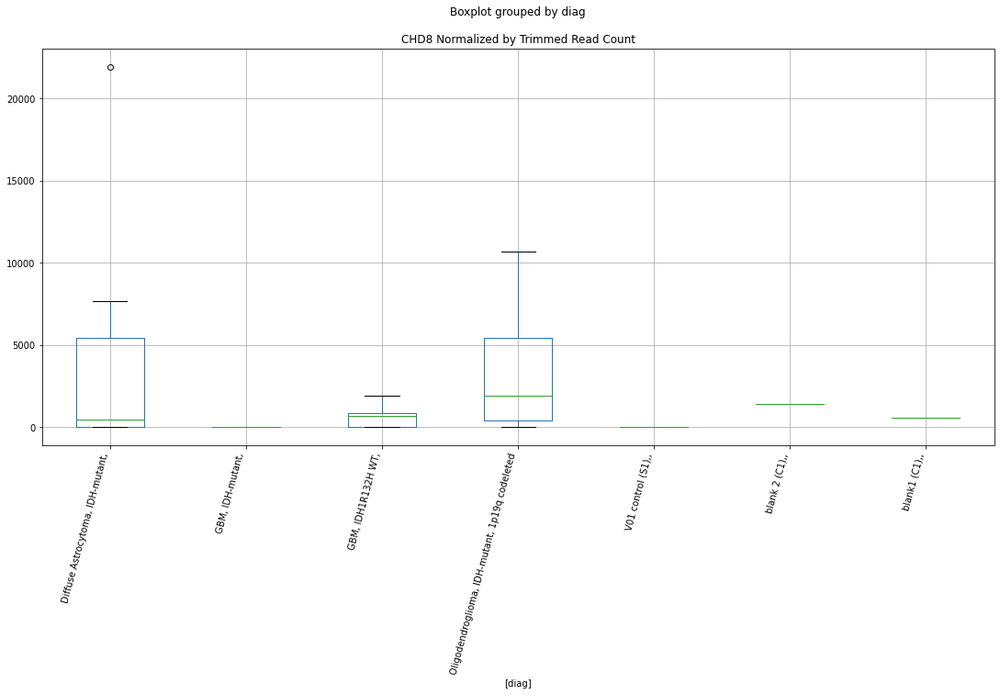

 p : 0.008440313587121289  ( t : 2.9568531531507833 ) :  D-plex  :  cutadapt2  :  DIRAS1
Control and blanks
76      1515.23
340    15853.18
Name: DIRAS1, dtype: float64
208    4409.01
Name: DIRAS1, dtype: float64
472    2311.82
Name: DIRAS1, dtype: float64


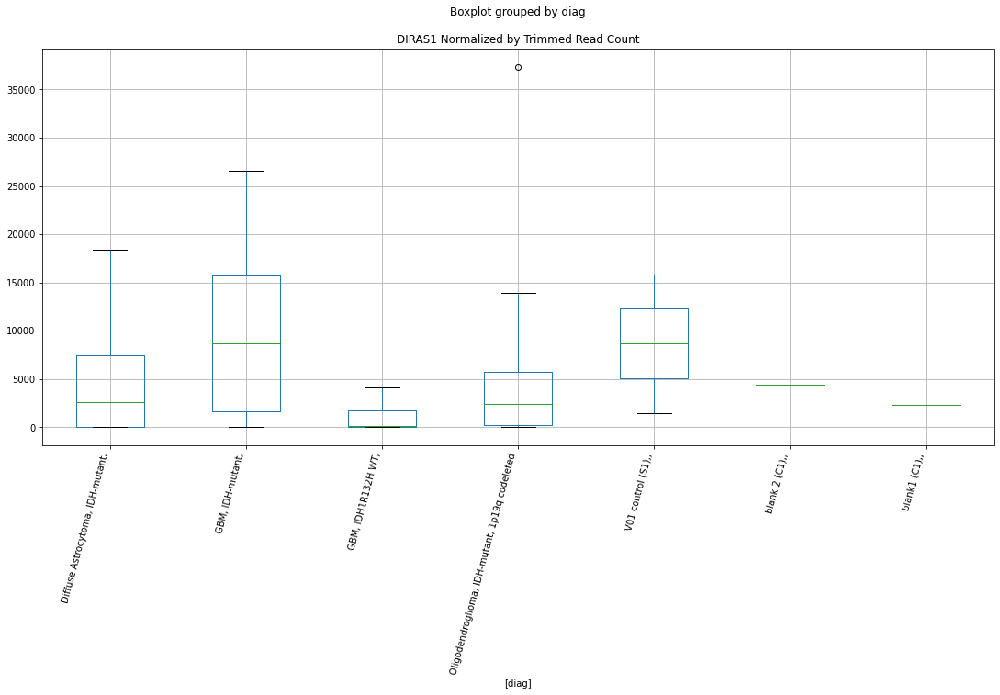

 p : 0.008781925535931882  ( t : 2.9385446174239354 ) :  D-plex  :  cutadapt2  :  AKAP8L
Control and blanks
76         0.00
340    10568.79
Name: AKAP8L, dtype: float64
208    6348.97
Name: AKAP8L, dtype: float64
472    12137.07
Name: AKAP8L, dtype: float64


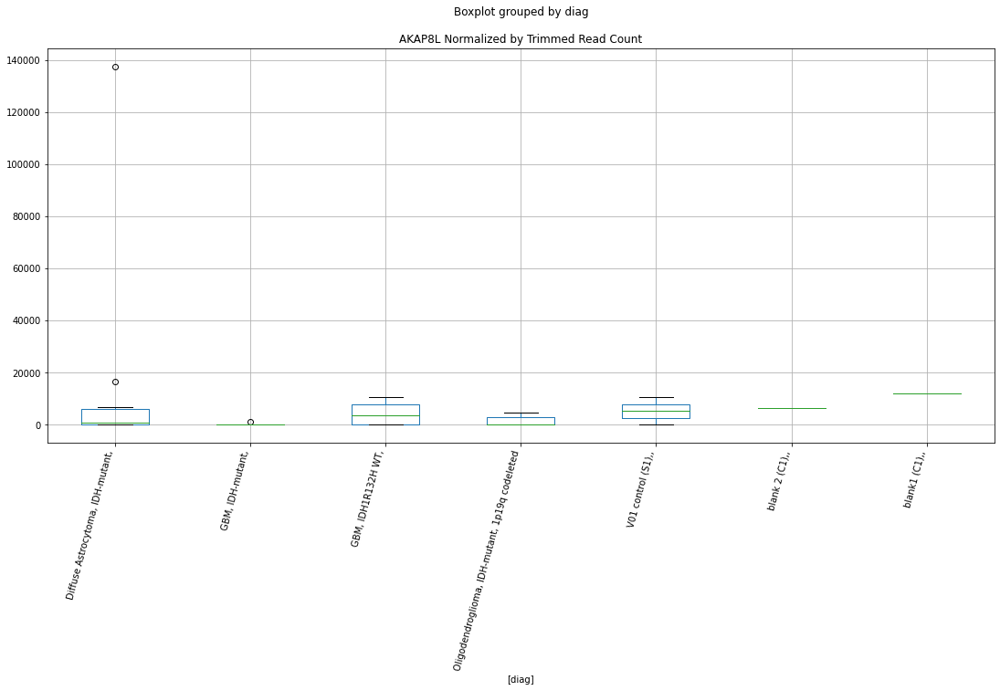

 p : 0.009153102738868673  ( t : 2.919417045135805 ) :  D-plex  :  bbduk2  :  CTXND1
Control and blanks
73     29374.32
337    18693.30
Name: CTXND1, dtype: float64
205    20774.55
Name: CTXND1, dtype: float64
469    29576.37
Name: CTXND1, dtype: float64


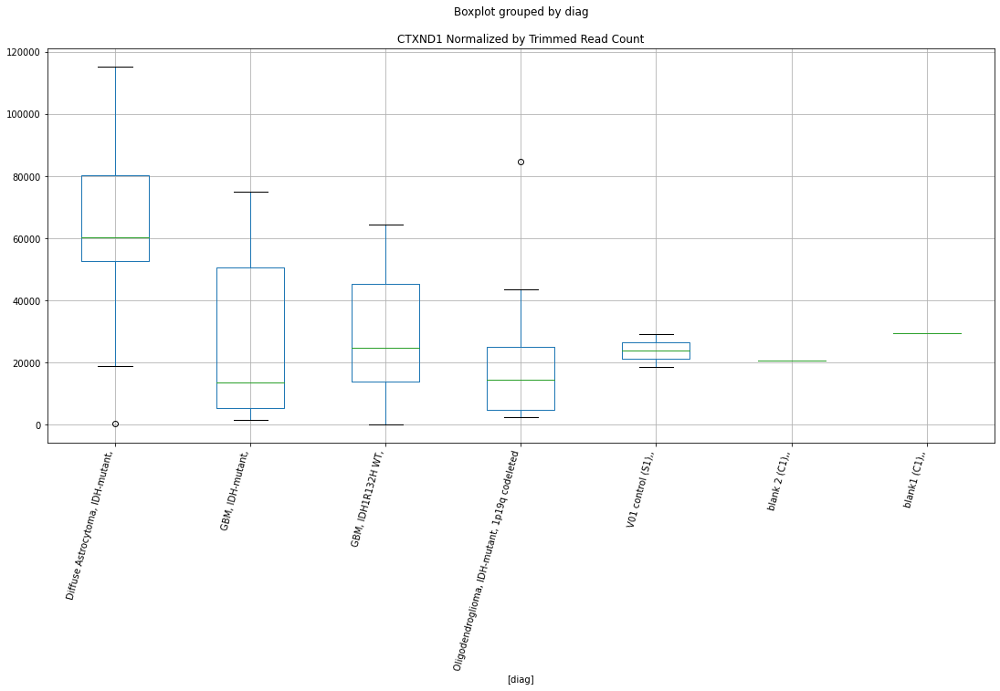

 p : 0.0094967120147954  ( t : 2.9023672605843682 ) :  D-plex  :  cutadapt2  :  ACTN3
Control and blanks
76     1515.23
340       0.00
Name: ACTN3, dtype: float64
208    4056.29
Name: ACTN3, dtype: float64
472    6935.47
Name: ACTN3, dtype: float64


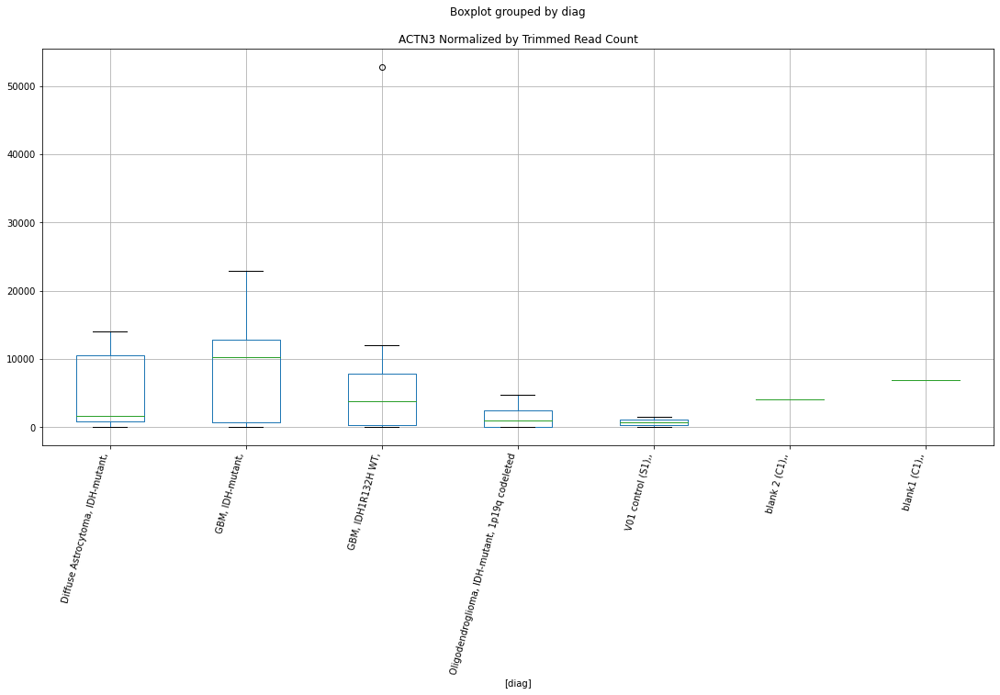

 p : 0.009630559410402124  ( t : 2.895886655753919 ) :  D-plex  :  cutadapt2  :  CDC25B
Control and blanks
76        0.00
340    3522.93
Name: CDC25B, dtype: float64
208    41444.65
Name: CDC25B, dtype: float64
472    4045.69
Name: CDC25B, dtype: float64


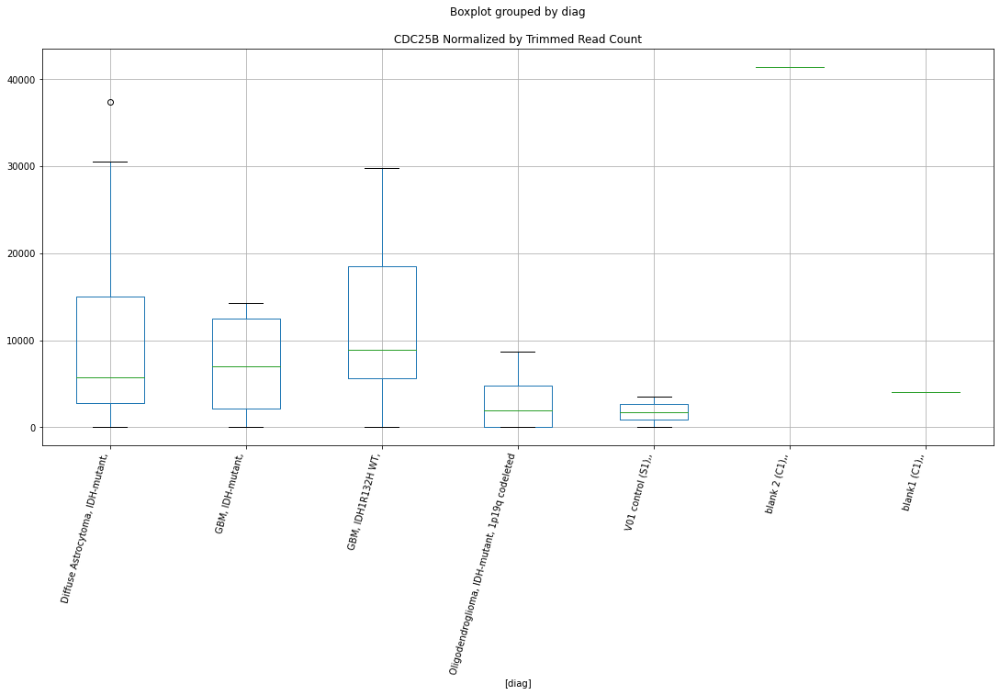

 p : 0.00968993026404235  ( t : 2.893039852727409 ) :  Lexogen  :  bbduk2  :  DDA1
Control and blanks
79         0.00
343    25477.72
Name: DDA1, dtype: float64
211    2733.06
Name: DDA1, dtype: float64
475    0.0
Name: DDA1, dtype: float64


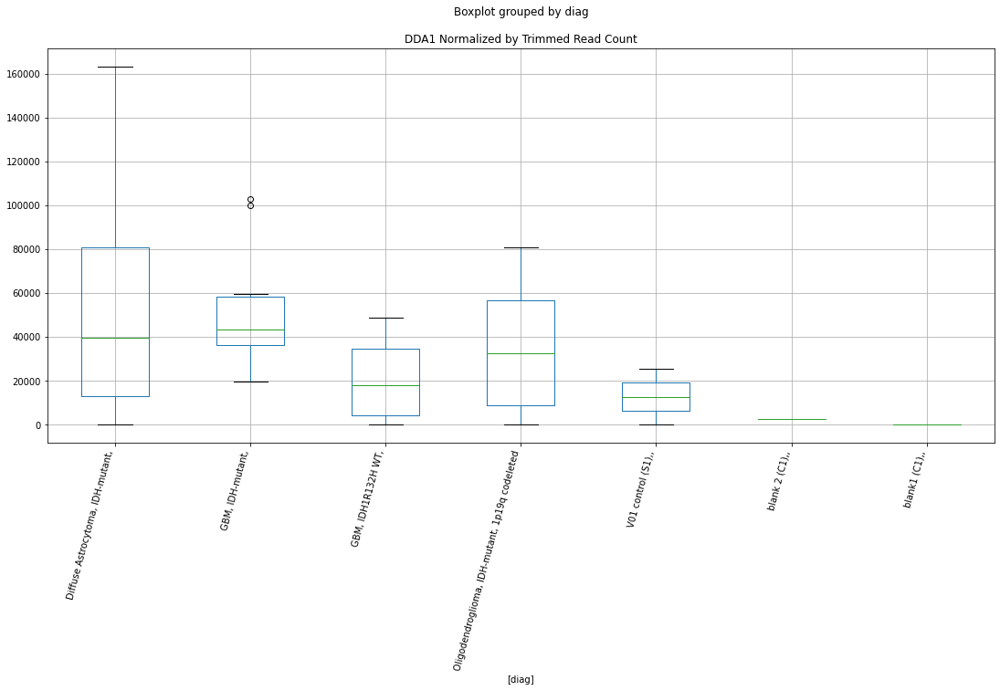

 p : 0.009782559905699172  ( t : 2.8886317718796586 ) :  D-plex  :  bbduk2  :  AP4E1
Control and blanks
73     6184.07
337       0.00
Name: AP4E1, dtype: float64
205    1074.55
Name: AP4E1, dtype: float64
469    4732.22
Name: AP4E1, dtype: float64


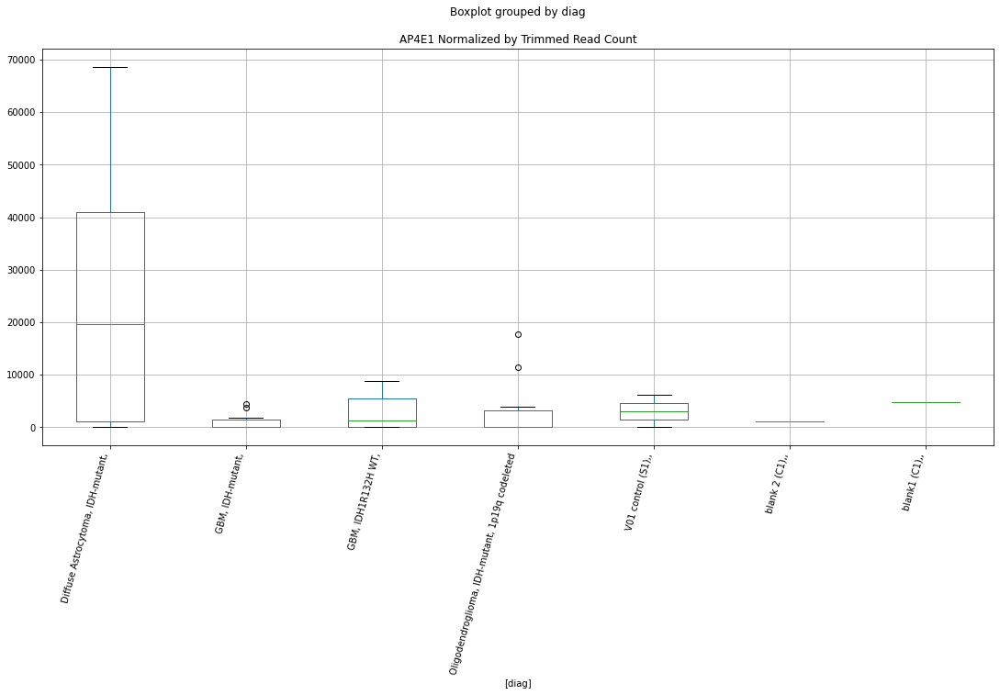

 p : 0.009791791309882775  ( t : 2.8881946761562176 ) :  D-plex  :  bbduk2  :  ASIC1
Control and blanks
73     0.0
337    0.0
Name: ASIC1, dtype: float64
205    8059.09
Name: ASIC1, dtype: float64
469    591.53
Name: ASIC1, dtype: float64


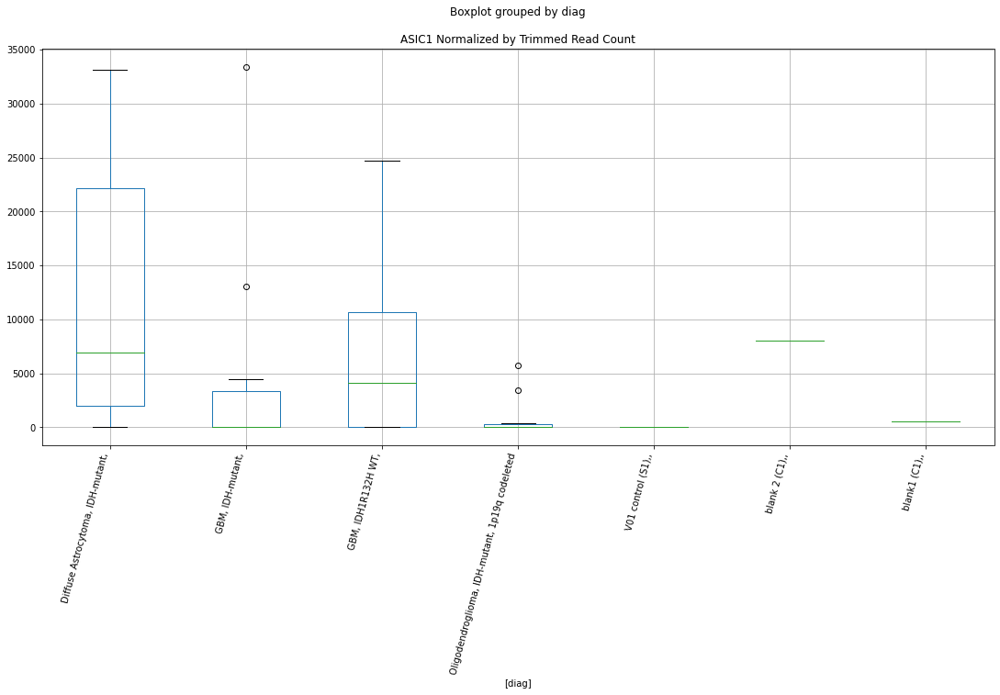

 p : 0.009848533200708168  ( t : 2.8855167226387186 ) :  D-plex  :  bbduk2  :  COL9A2
Control and blanks
73     32466.35
337        0.00
Name: COL9A2, dtype: float64
205    9133.64
Name: COL9A2, dtype: float64
469    20703.46
Name: COL9A2, dtype: float64


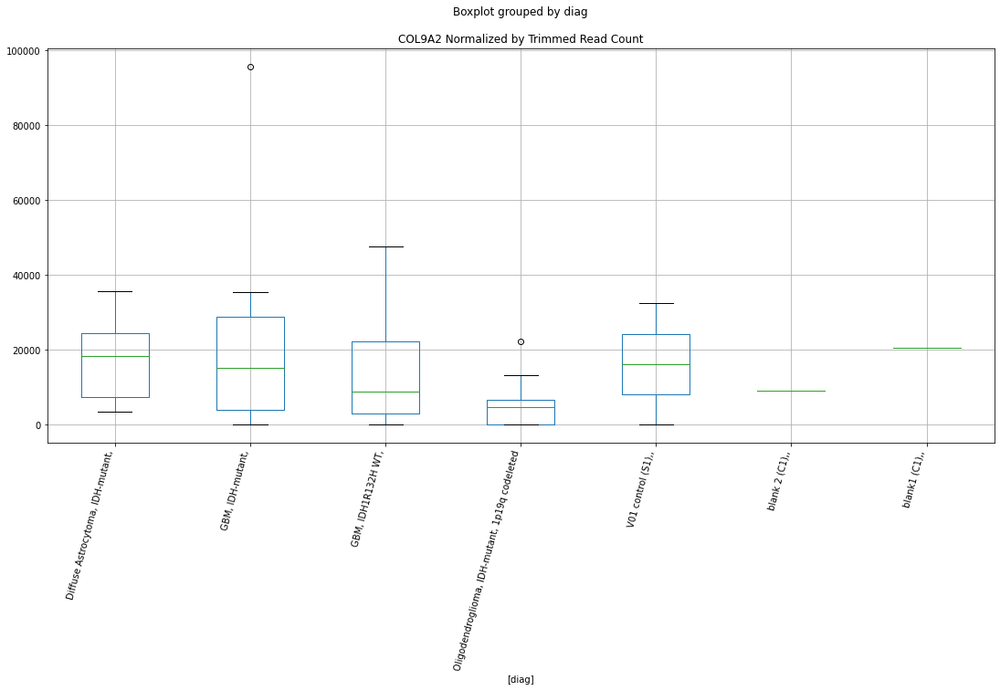

 p : 0.009993422743646823  ( t : 2.8787455952238177 ) :  Lexogen  :  cutadapt2  :  B3GALT6
Control and blanks
82         0.00
346    32406.92
Name: B3GALT6, dtype: float64
214    271.23
Name: B3GALT6, dtype: float64
478    237.46
Name: B3GALT6, dtype: float64


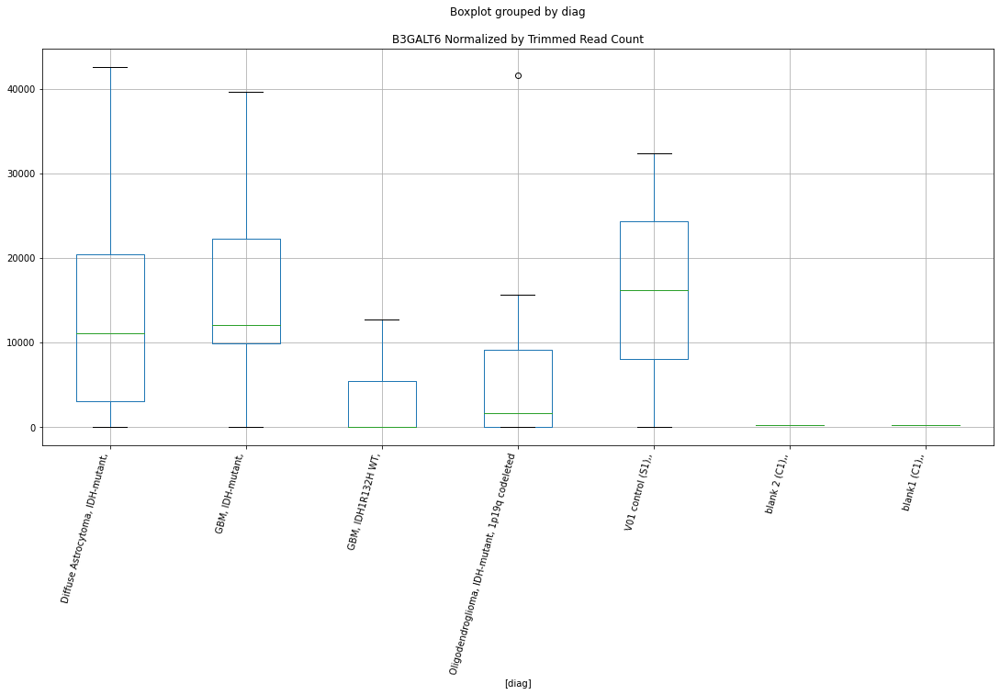

 p : 0.01001929042907139  ( t : 2.877546694818413 ) :  Lexogen  :  cutadapt2  :  DDA1
Control and blanks
82         0.00
346    25252.14
Name: DDA1, dtype: float64
214    2712.26
Name: DDA1, dtype: float64
478    0.0
Name: DDA1, dtype: float64


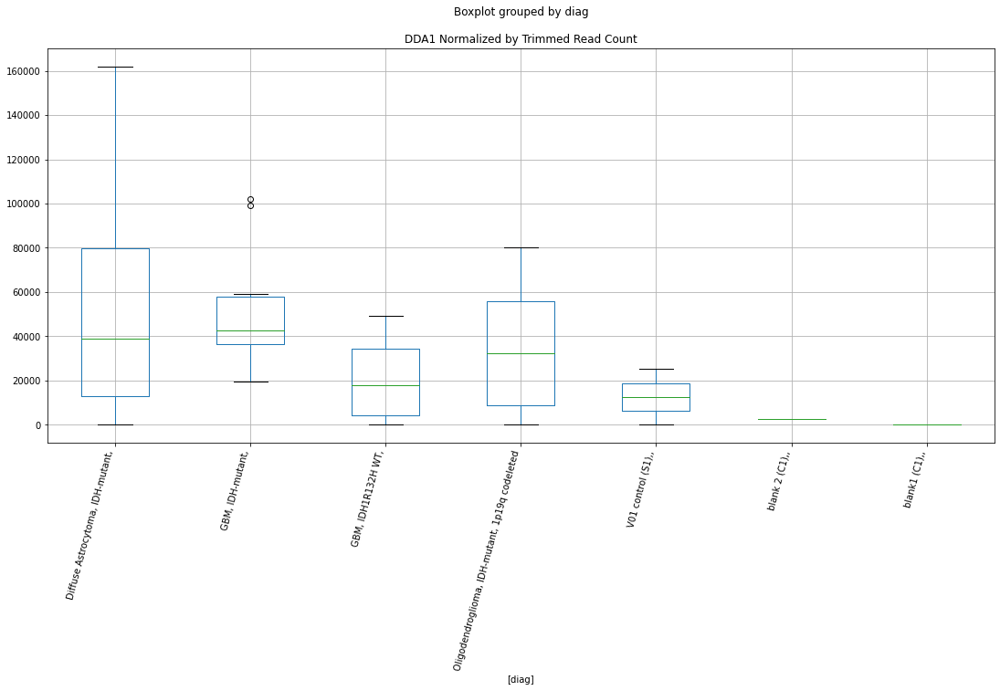

 p : 0.010022601482839934  ( t : 2.877393451686628 ) :  Lexogen  :  bbduk2  :  B3GALT6
Control and blanks
79         0.0
343    32696.4
Name: B3GALT6, dtype: float64
211    273.31
Name: B3GALT6, dtype: float64
475    239.52
Name: B3GALT6, dtype: float64


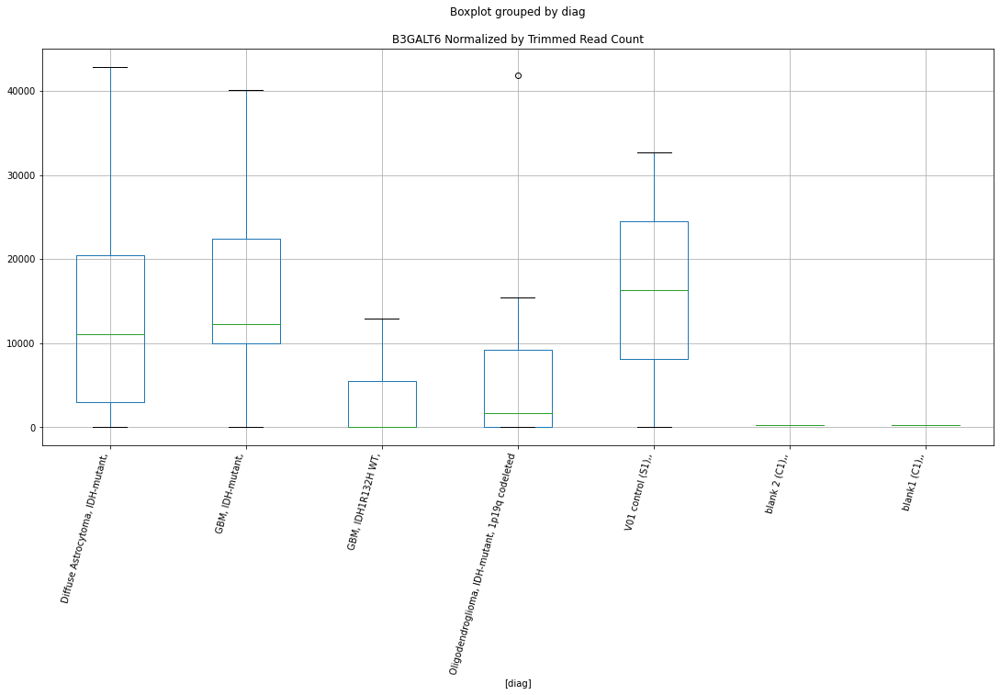

 p : 0.010126290407074919  ( t : 2.8726190409490773 ) :  Lexogen  :  cutadapt2  :  ACADS
Control and blanks
82         0.00
346    67759.92
Name: ACADS, dtype: float64
214    2712.26
Name: ACADS, dtype: float64
478    0.0
Name: ACADS, dtype: float64


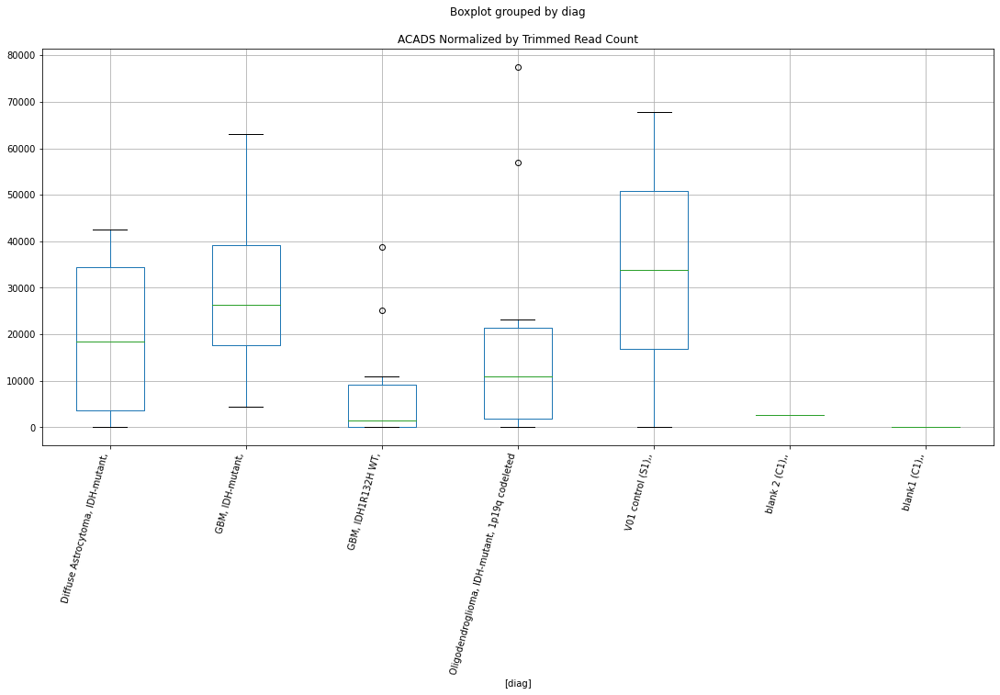

 p : 0.0101584044337545  ( t : 2.871149896028658 ) :  Lexogen  :  bbduk2  :  APOA5
Control and blanks
79     0.0
343    0.0
Name: APOA5, dtype: float64
211    0.0
Name: APOA5, dtype: float64
475    0.0
Name: APOA5, dtype: float64


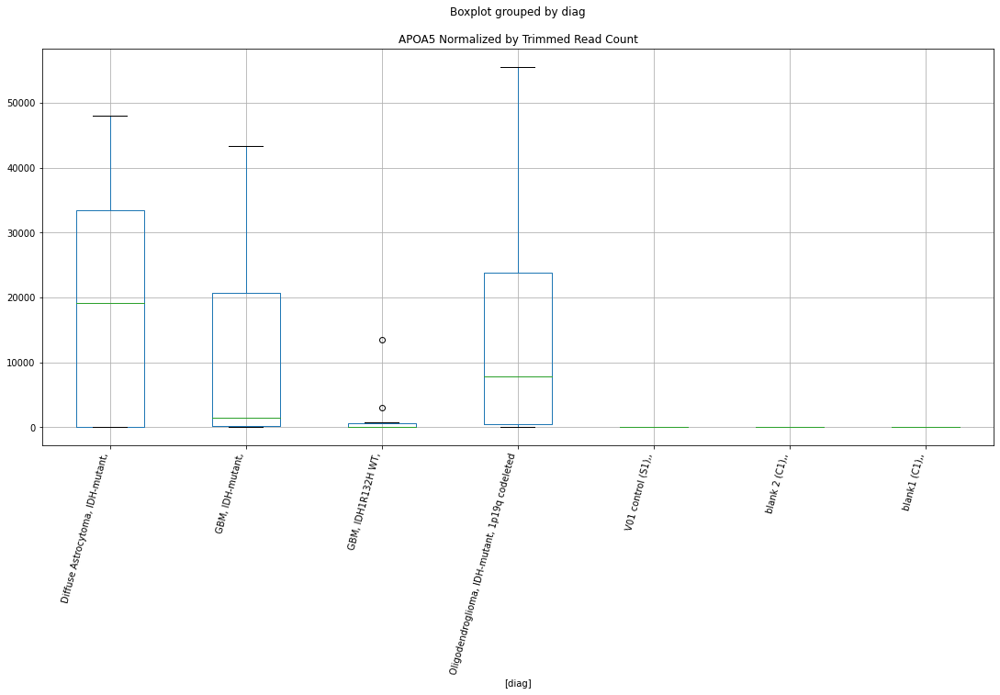

 p : 0.010172720353758952  ( t : 2.870496417790116 ) :  Lexogen  :  cutadapt2  :  APOA5
Control and blanks
82     0.0
346    0.0
Name: APOA5, dtype: float64
214    0.0
Name: APOA5, dtype: float64
478    0.0
Name: APOA5, dtype: float64


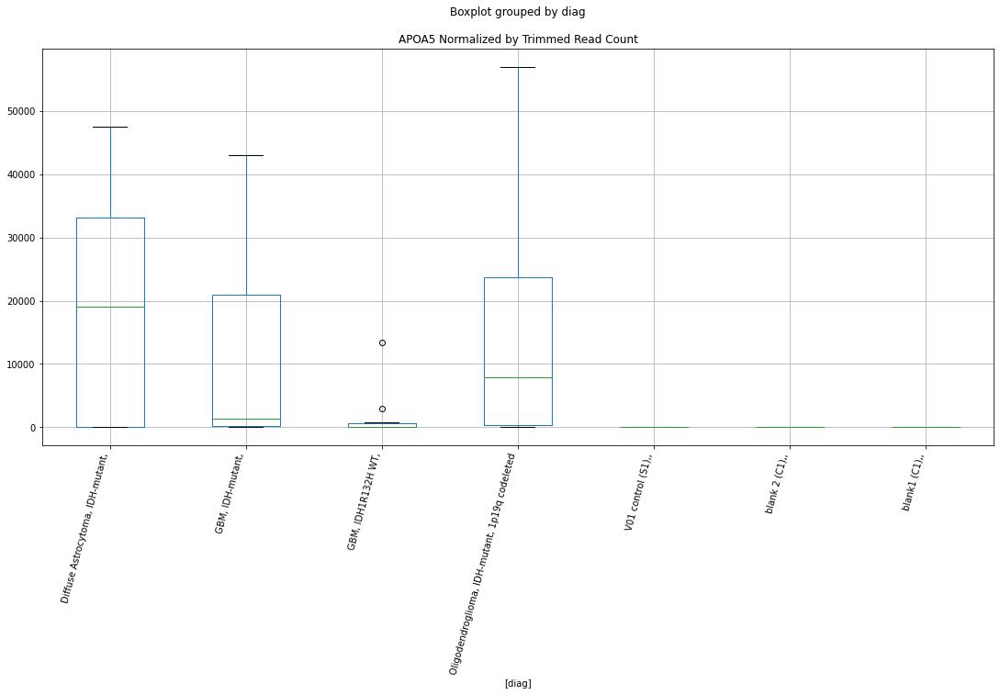

 p : 0.010353086999125221  ( t : 2.862338351925421 ) :  D-plex  :  cutadapt2  :  CASP10
Control and blanks
76     0.0
340    0.0
Name: CASP10, dtype: float64
208    0.0
Name: CASP10, dtype: float64
472    0.0
Name: CASP10, dtype: float64


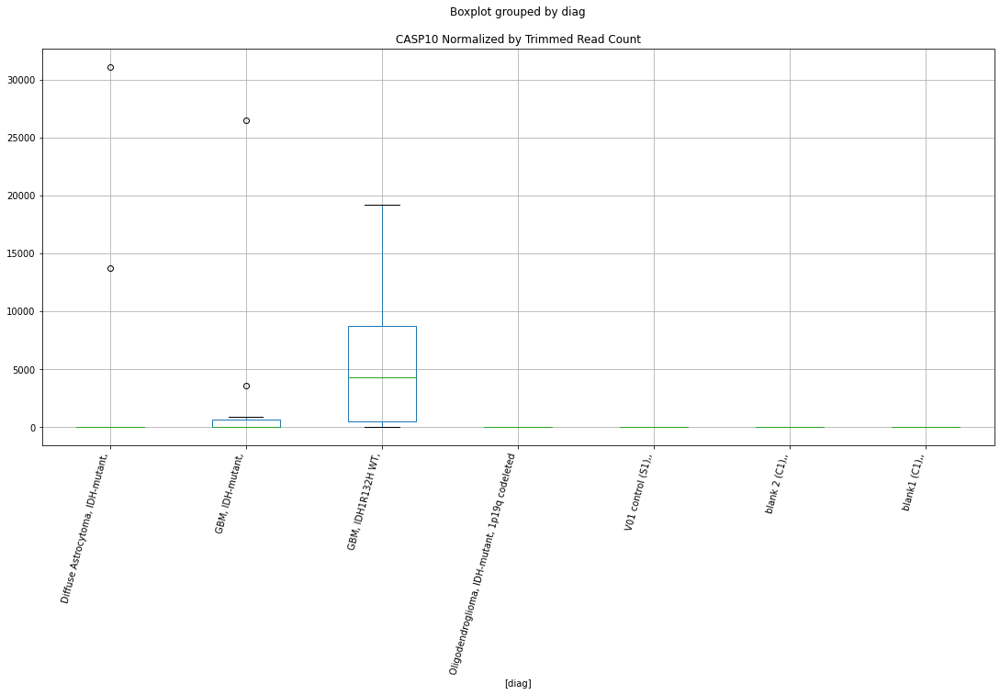

 p : 0.01039692321166294  ( t : 2.8603763252758445 ) :  D-plex  :  cutadapt2  :  CTXND1
Control and blanks
76     29546.95
340    18495.37
Name: CTXND1, dtype: float64
208    20281.43
Name: CTXND1, dtype: float64
472    28897.79
Name: CTXND1, dtype: float64


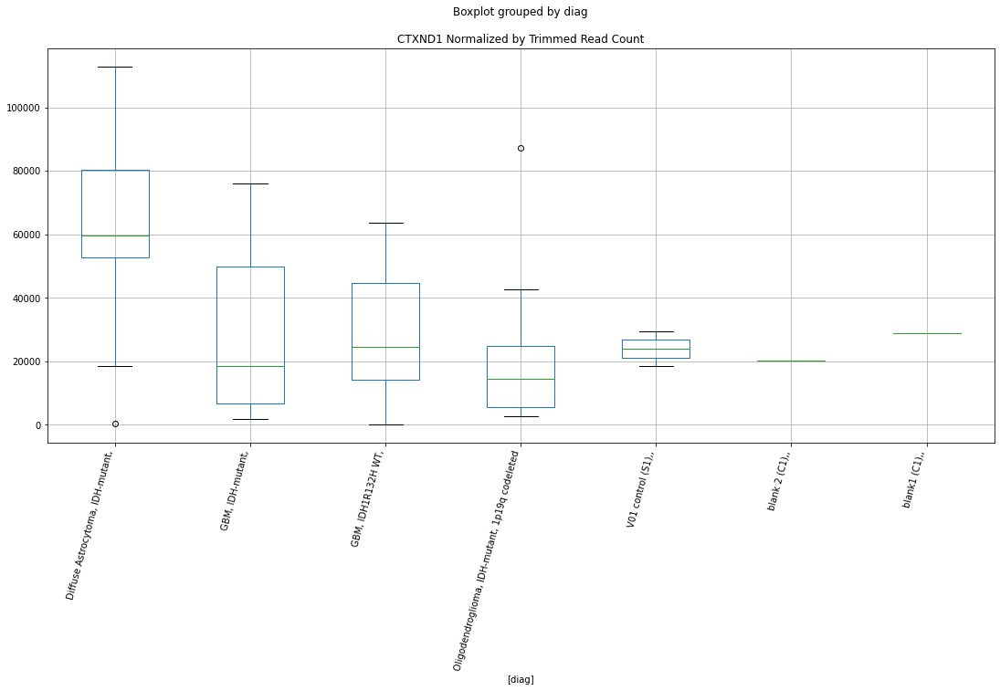

 p : 0.010449844566010663  ( t : 2.8580182619539807 ) :  Lexogen  :  bbduk2  :  ACADS
Control and blanks
79         0.00
343    68789.84
Name: ACADS, dtype: float64
211    2733.06
Name: ACADS, dtype: float64
475    0.0
Name: ACADS, dtype: float64


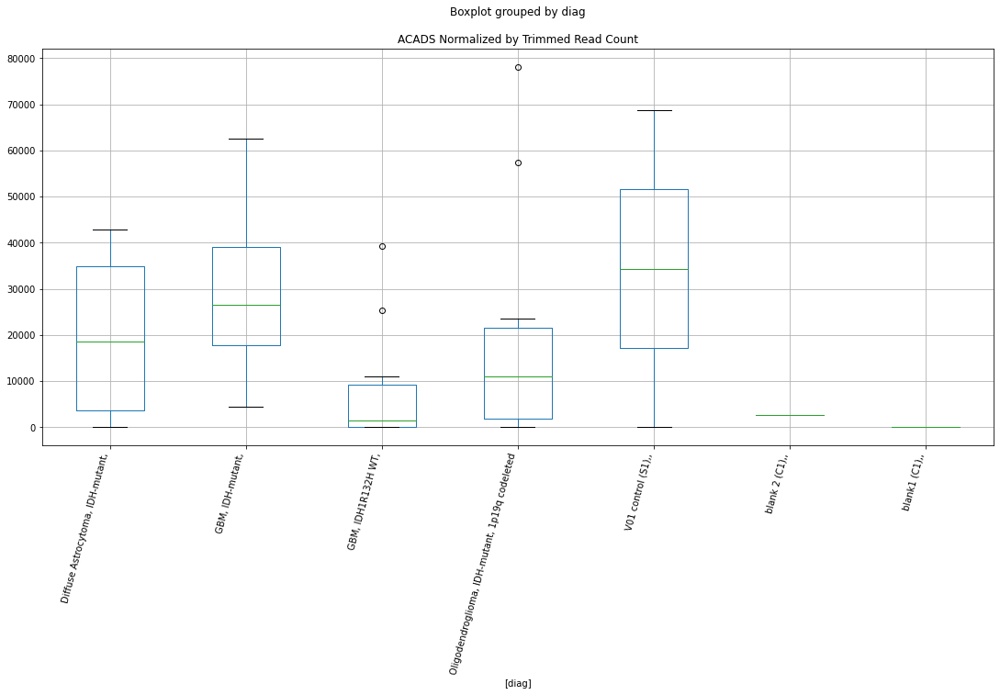

 p : 0.010506890155465177  ( t : 2.855489287724888 ) :  D-plex  :  bbduk2  :  ASDURF
Control and blanks
73     0.0
337    0.0
Name: ASDURF, dtype: float64
205    716.36
Name: ASDURF, dtype: float64
469    2366.11
Name: ASDURF, dtype: float64


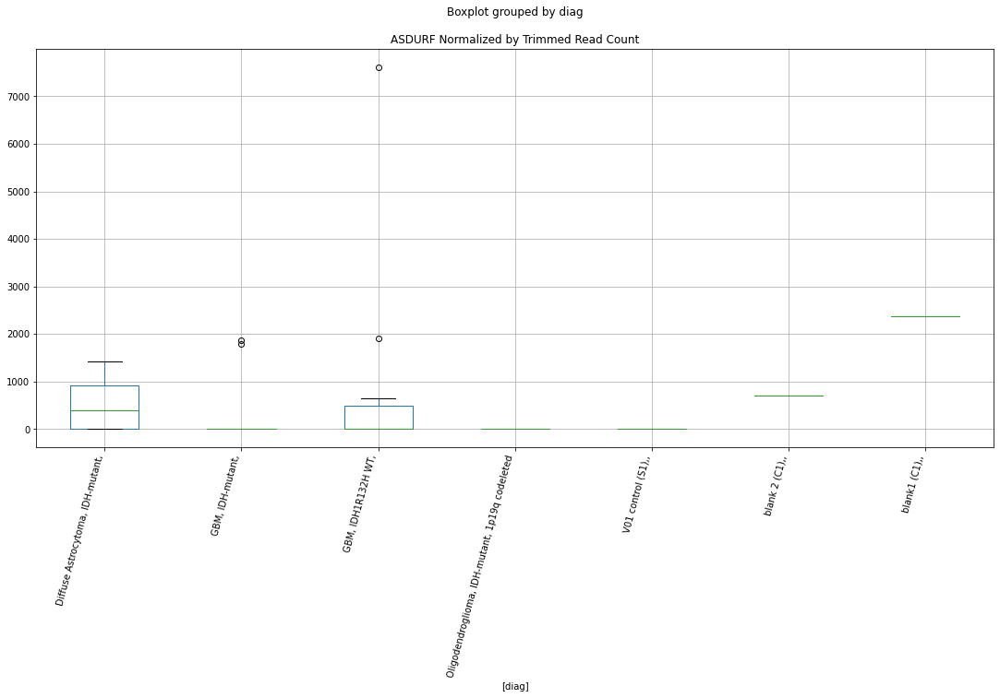

 p : 0.010632603979016723  ( t : 2.849962469518825 ) :  Lexogen  :  cutadapt2  :  CAMSAP3
Control and blanks
82         0.00
346    93432.93
Name: CAMSAP3, dtype: float64
214    11391.51
Name: CAMSAP3, dtype: float64
478    0.0
Name: CAMSAP3, dtype: float64


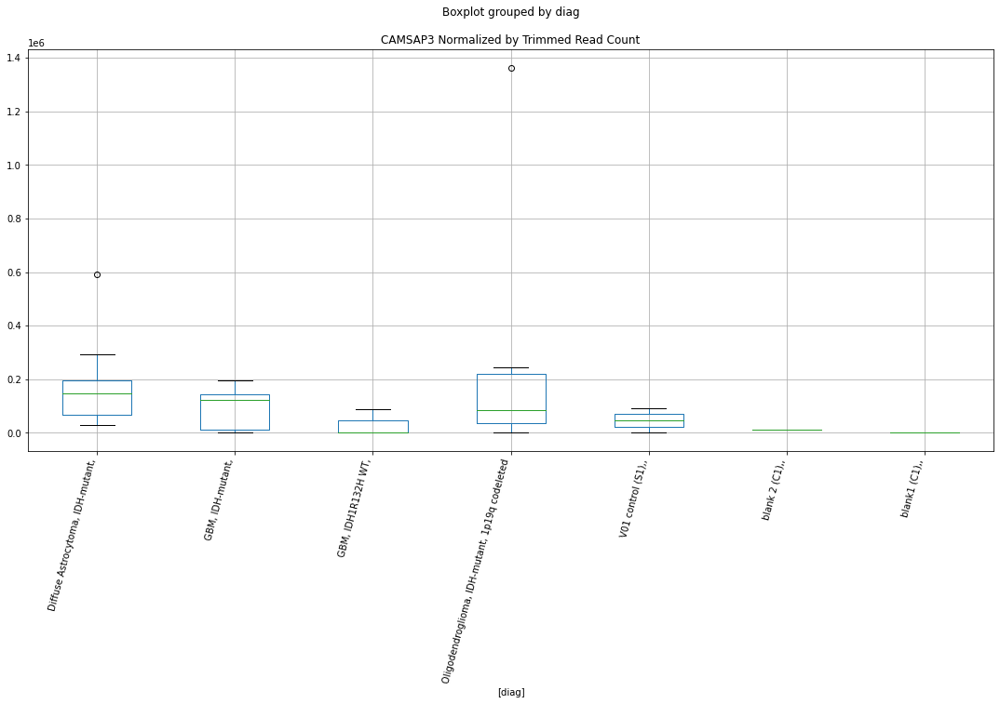

 p : 0.010645217439836397  ( t : 2.849411417826962 ) :  D-plex  :  bbduk2  :  ATP5MGL
Control and blanks
73     0.0
337    0.0
Name: ATP5MGL, dtype: float64
205    0.0
Name: ATP5MGL, dtype: float64
469    0.0
Name: ATP5MGL, dtype: float64


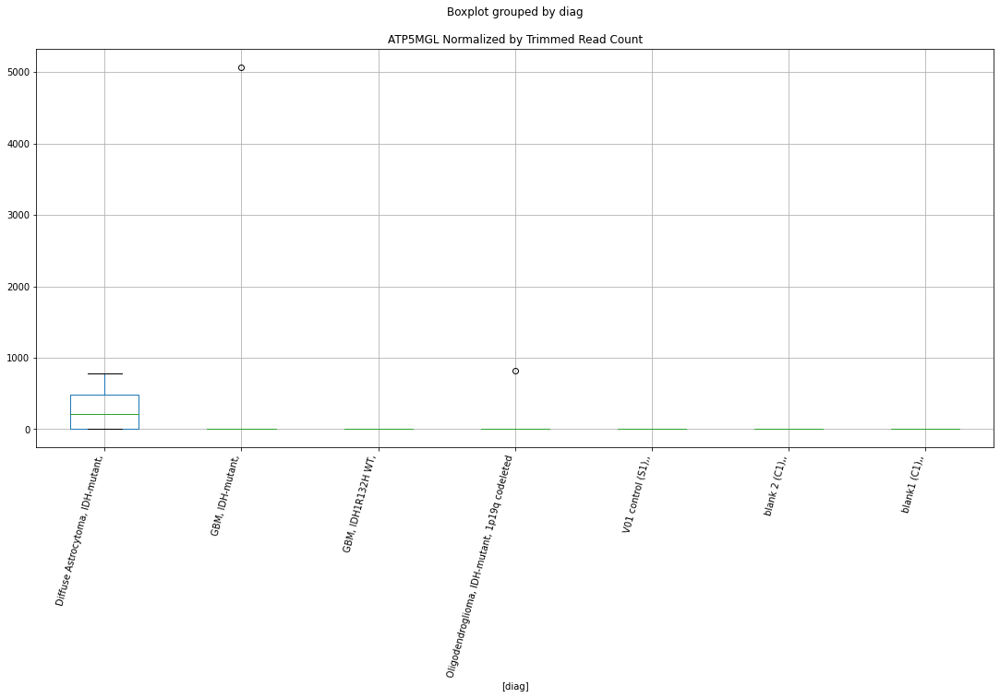

 p : 0.010700855965509865  ( t : 2.8469881876981478 ) :  Lexogen  :  bbduk2  :  CAMSAP3
Control and blanks
79         0.00
343    92993.67
Name: CAMSAP3, dtype: float64
211    11478.87
Name: CAMSAP3, dtype: float64
475    0.0
Name: CAMSAP3, dtype: float64


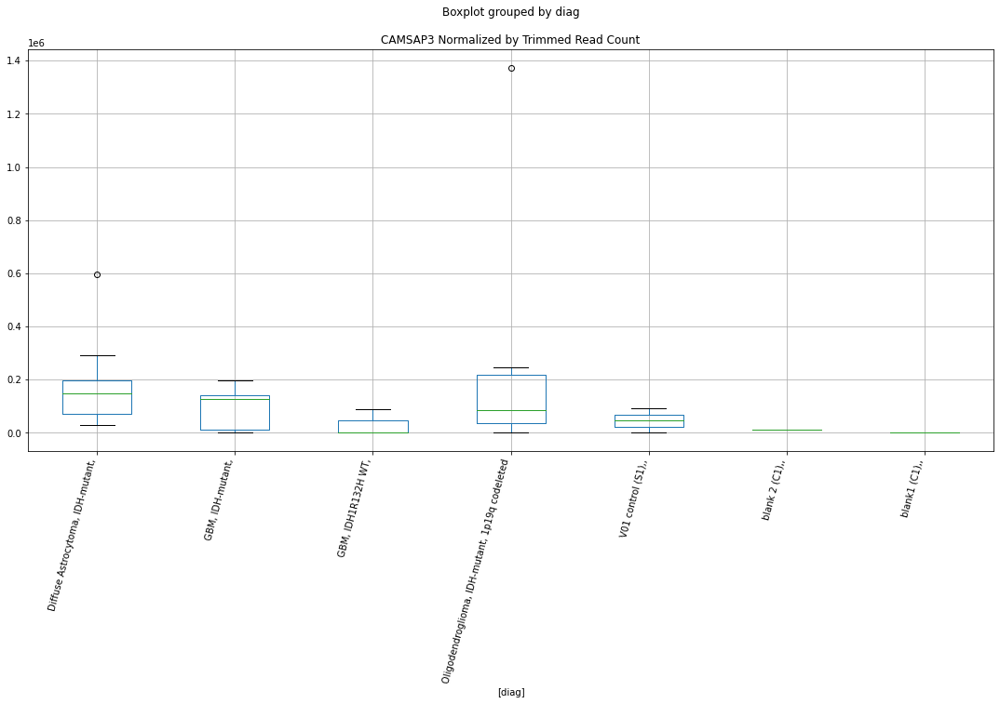

 p : 0.010780842924371785  ( t : 2.8435256891799376 ) :  D-plex  :  bbduk2  :  CEL
Control and blanks
73     0.0
337    0.0
Name: CEL, dtype: float64
205    52652.74
Name: CEL, dtype: float64
469    0.0
Name: CEL, dtype: float64


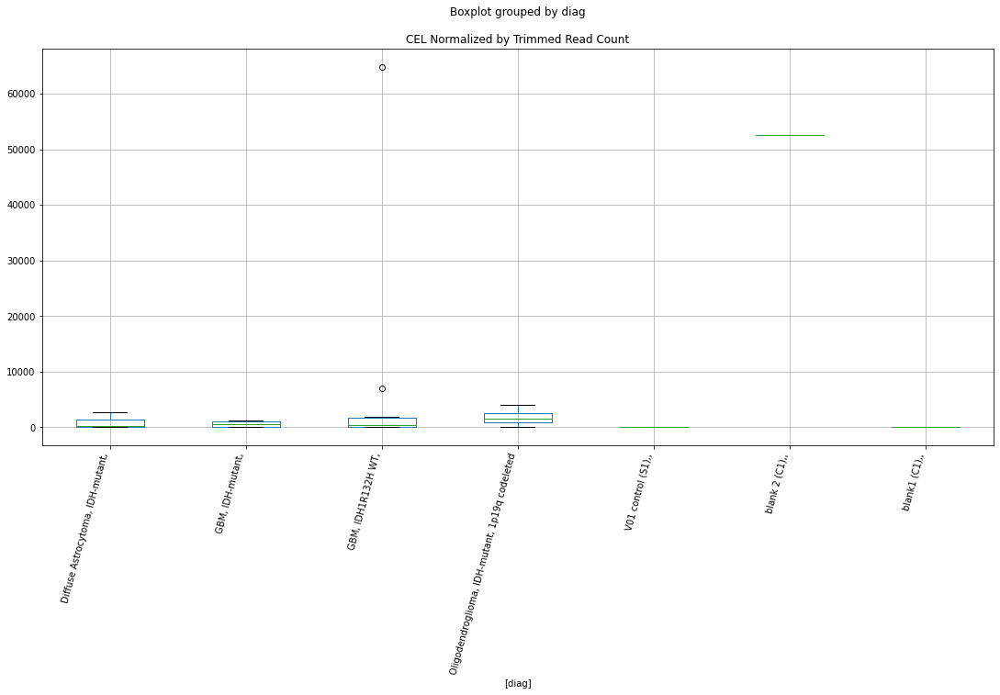

 p : 0.011150707799431524  ( t : 2.8278298779963955 ) :  D-plex  :  bbduk2  :  ACTN3
Control and blanks
73     1546.02
337       0.00
Name: ACTN3, dtype: float64
205    4298.18
Name: ACTN3, dtype: float64
469    5915.27
Name: ACTN3, dtype: float64


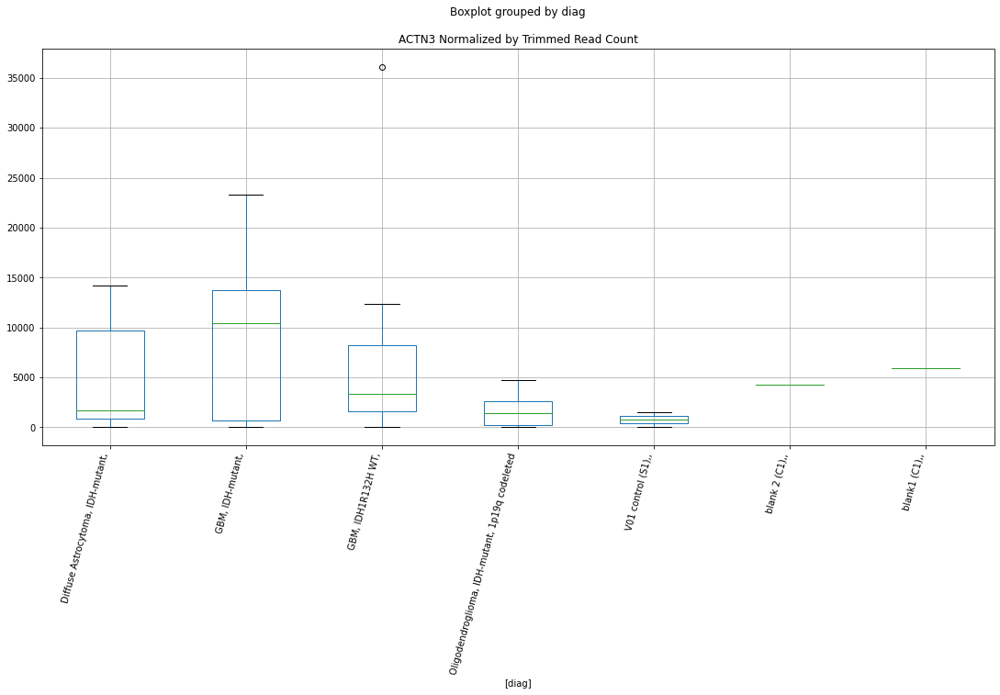

 p : 0.011153897895102221  ( t : 2.827696693228926 ) :  D-plex  :  cutadapt2  :  ACKR4
Control and blanks
76     0.0
340    0.0
Name: ACKR4, dtype: float64
208    705.44
Name: ACKR4, dtype: float64
472    0.0
Name: ACKR4, dtype: float64


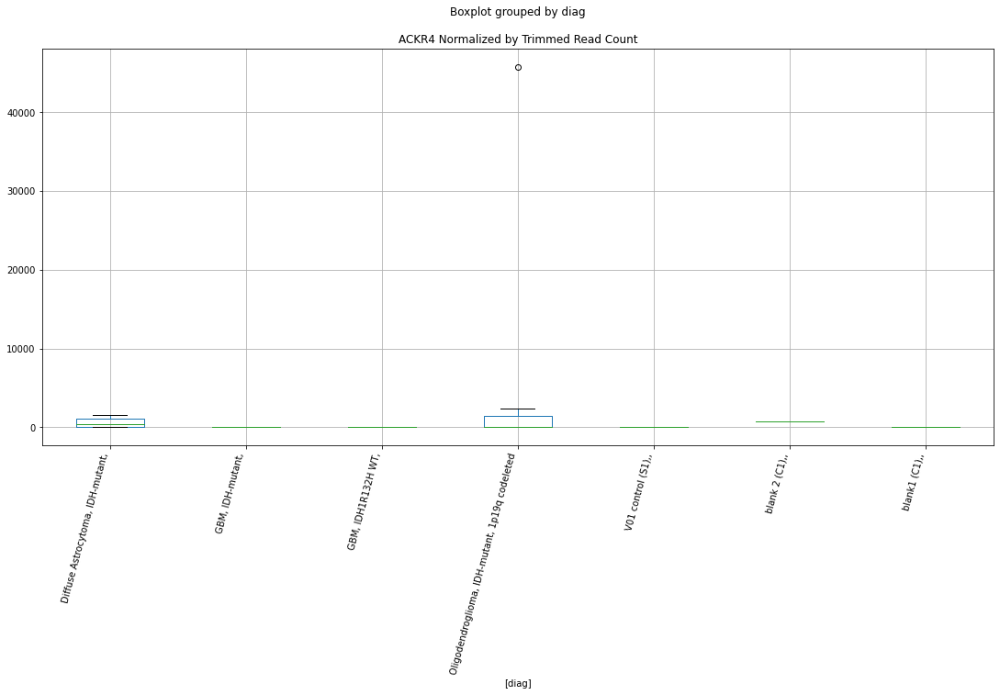

 p : 0.011318601824066717  ( t : 2.8208697143754 ) :  D-plex  :  bbduk2  :  DCUN1D5
Control and blanks
73     3092.03
337       0.00
Name: DCUN1D5, dtype: float64
205    3223.64
Name: DCUN1D5, dtype: float64
469    9464.44
Name: DCUN1D5, dtype: float64


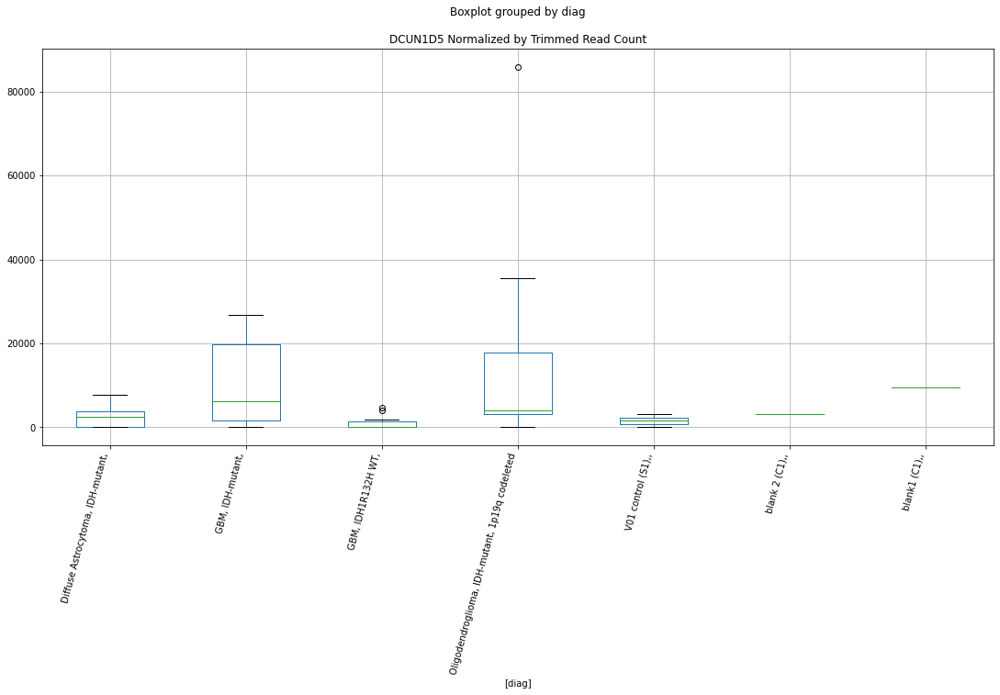

 p : 0.011363549028514778  ( t : 2.8190232502633226 ) :  D-plex  :  bbduk2  :  DEGS2
Control and blanks
73     34012.37
337        0.00
Name: DEGS2, dtype: float64
205    179.09
Name: DEGS2, dtype: float64
469    0.0
Name: DEGS2, dtype: float64


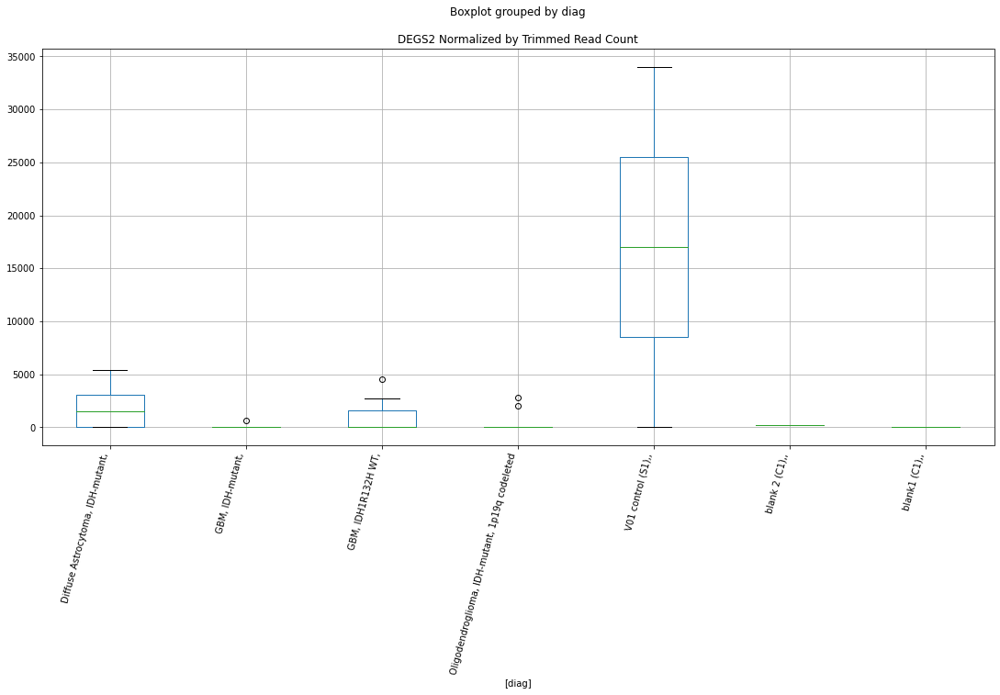

 p : 0.011368274921695672  ( t : 2.8188295154107825 ) :  D-plex  :  bbduk2  :  CD3D
Control and blanks
73       0.00
337    890.16
Name: CD3D, dtype: float64
205    6984.55
Name: CD3D, dtype: float64
469    150247.94
Name: CD3D, dtype: float64


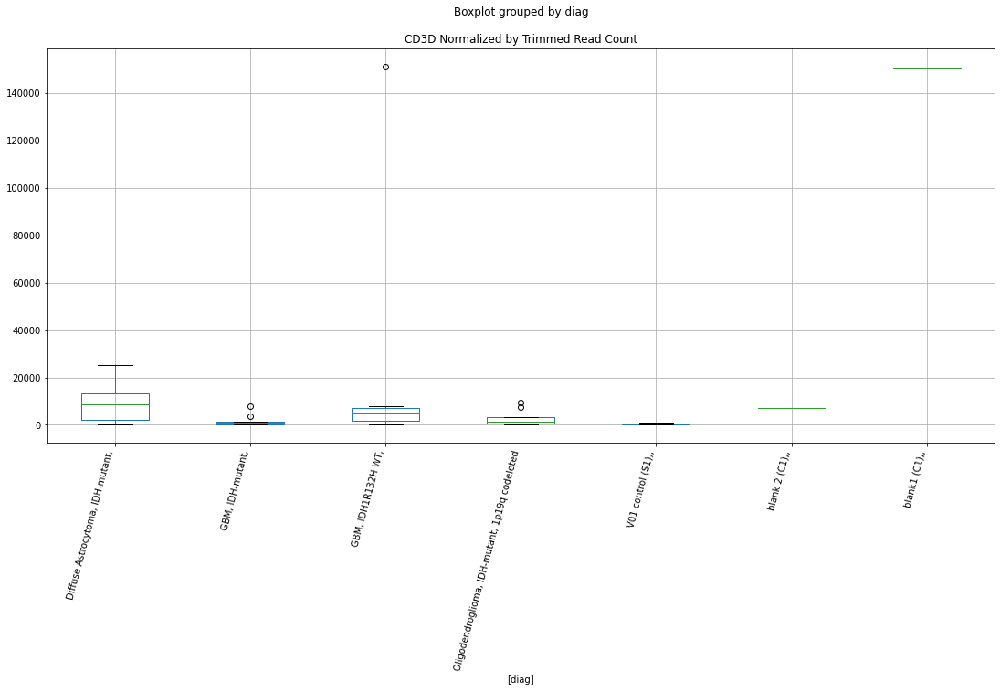

 p : 0.011482553052314494  ( t : 2.8141681888493815 ) :  Lexogen  :  bbduk2  :  DEF8
Control and blanks
79     0.0
343    0.0
Name: DEF8, dtype: float64
211    0.0
Name: DEF8, dtype: float64
475    0.0
Name: DEF8, dtype: float64


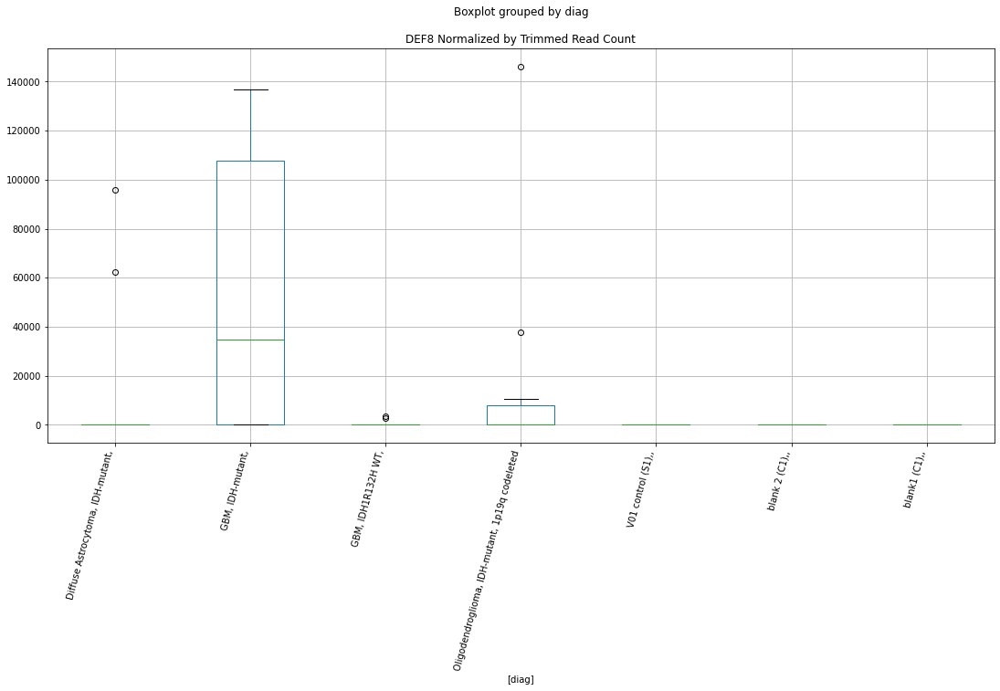

 p : 0.011535291887016259  ( t : 2.812032032870419 ) :  Lexogen  :  cutadapt2  :  DEF8
Control and blanks
82     0.0
346    0.0
Name: DEF8, dtype: float64
214    0.0
Name: DEF8, dtype: float64
478    0.0
Name: DEF8, dtype: float64


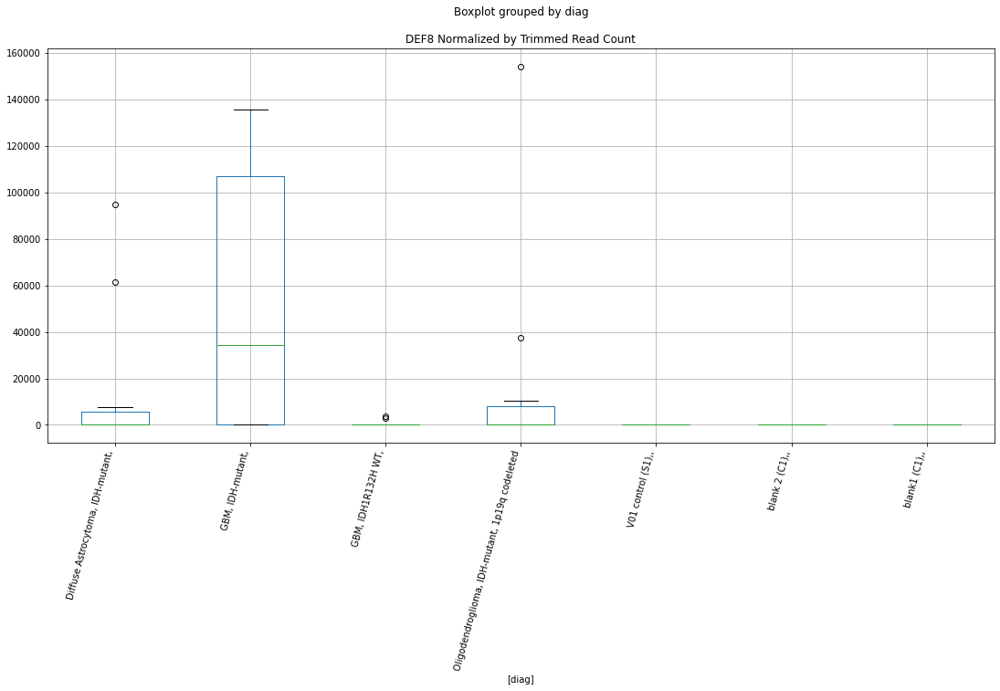

 p : 0.011540430396808377  ( t : 2.8118244027847292 ) :  Lexogen  :  bbduk2  :  CCDC183-AS1
Control and blanks
79       0.00
343    212.31
Name: CCDC183-AS1, dtype: float64
211    0.0
Name: CCDC183-AS1, dtype: float64
475    0.0
Name: CCDC183-AS1, dtype: float64


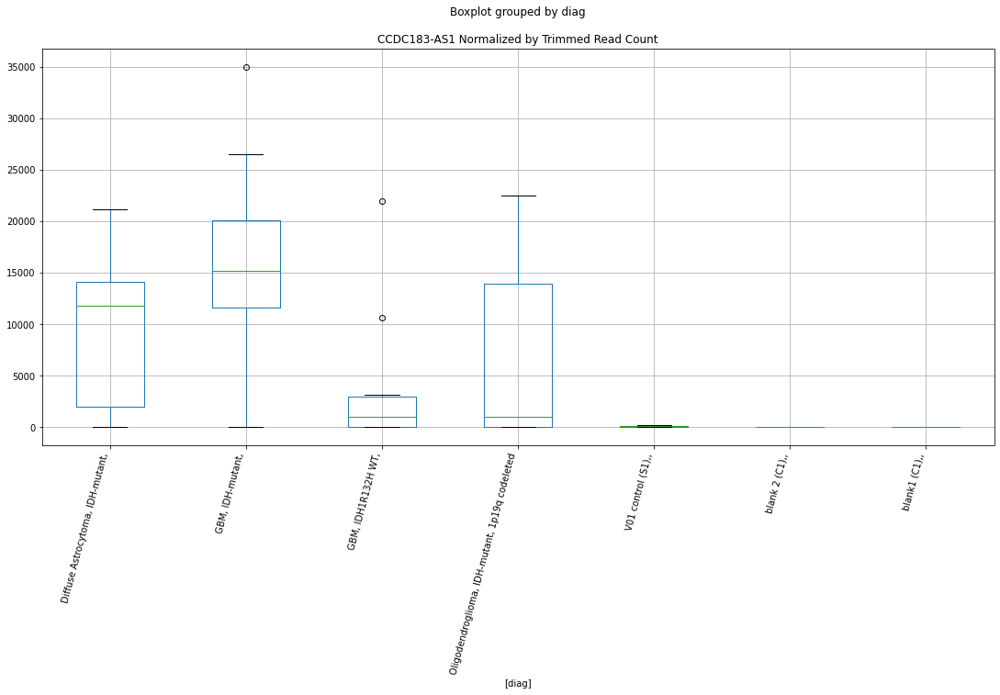

 p : 0.011646242080753098  ( t : 2.8075685467351983 ) :  D-plex  :  bbduk2  :  DGCR10
Control and blanks
73     0.0
337    0.0
Name: DGCR10, dtype: float64
205    0.0
Name: DGCR10, dtype: float64
469    0.0
Name: DGCR10, dtype: float64


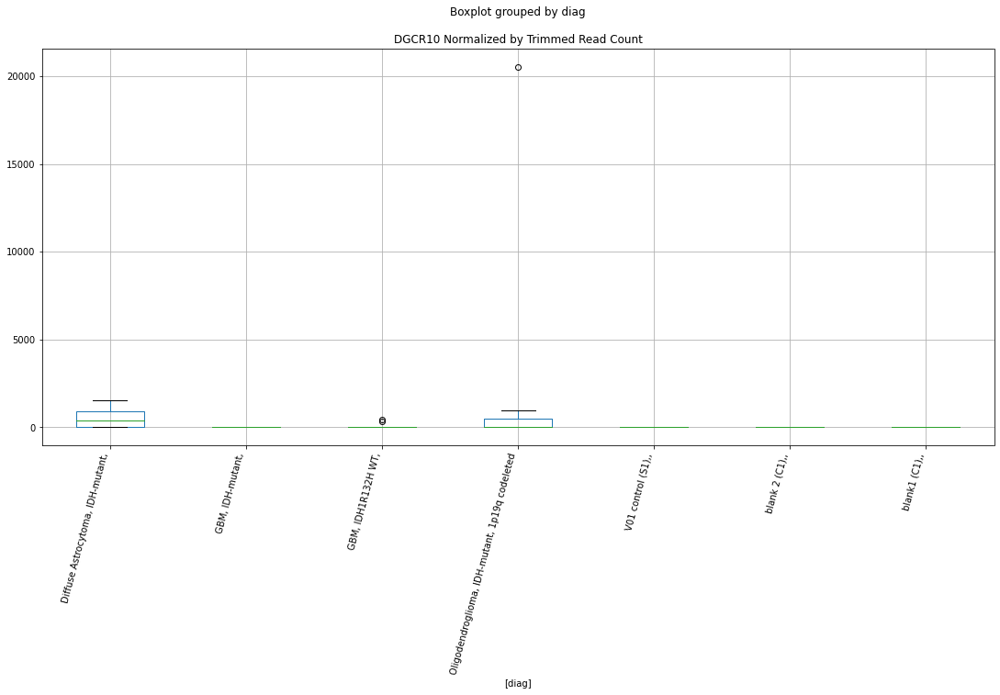

 p : 0.011806278623890831  ( t : 2.8012018060259254 ) :  D-plex  :  cutadapt2  :  C8orf74
Control and blanks
76        0.0
340    2642.2
Name: C8orf74, dtype: float64
208    529.08
Name: C8orf74, dtype: float64
472    1733.87
Name: C8orf74, dtype: float64


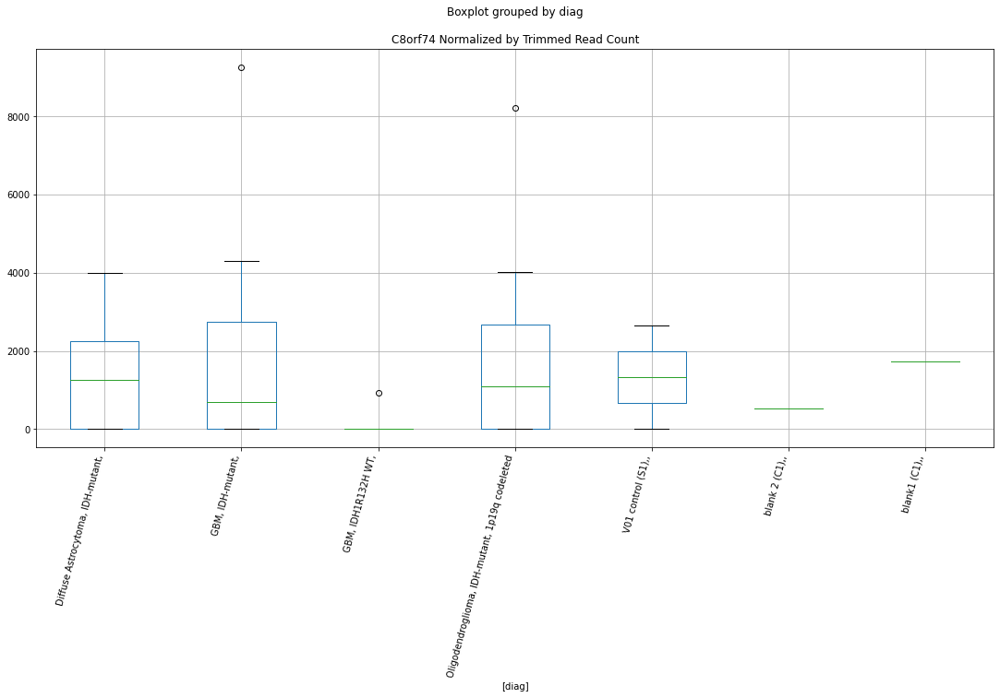

 p : 0.011886822096619452  ( t : 2.798028847134956 ) :  Lexogen  :  cutadapt2  :  CCDC183-AS1
Control and blanks
82       0.00
346    210.43
Name: CCDC183-AS1, dtype: float64
214    0.0
Name: CCDC183-AS1, dtype: float64
478    0.0
Name: CCDC183-AS1, dtype: float64


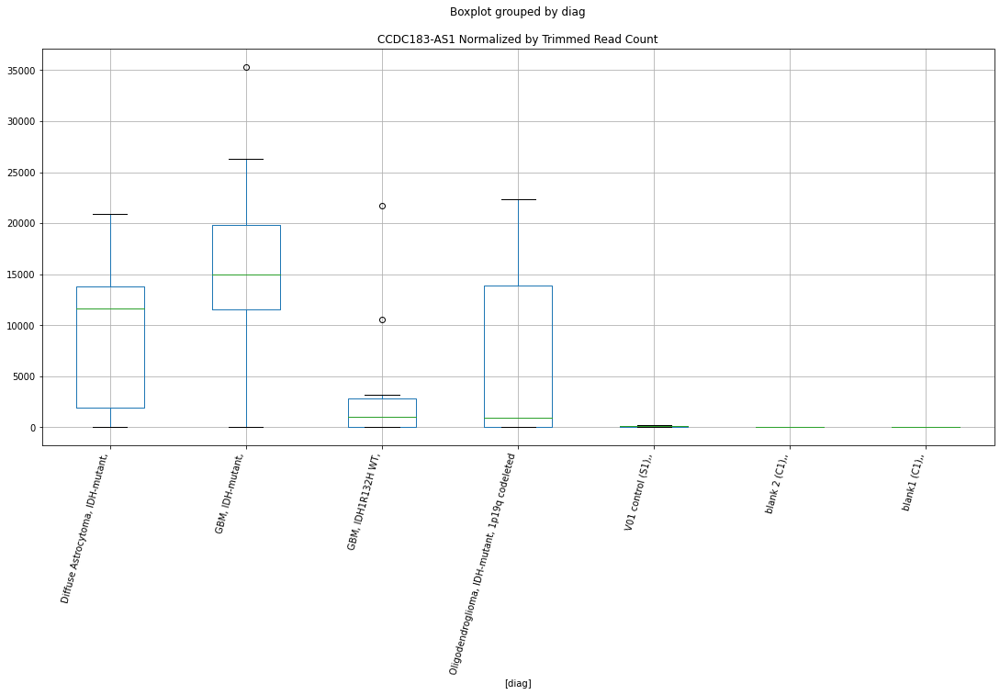

 p : 0.011997854083148064  ( t : 2.793688507701875 ) :  Lexogen  :  bbduk2  :  C1R
Control and blanks
79       0.00
343    849.26
Name: C1R, dtype: float64
211    2733.06
Name: C1R, dtype: float64
475    479.03
Name: C1R, dtype: float64


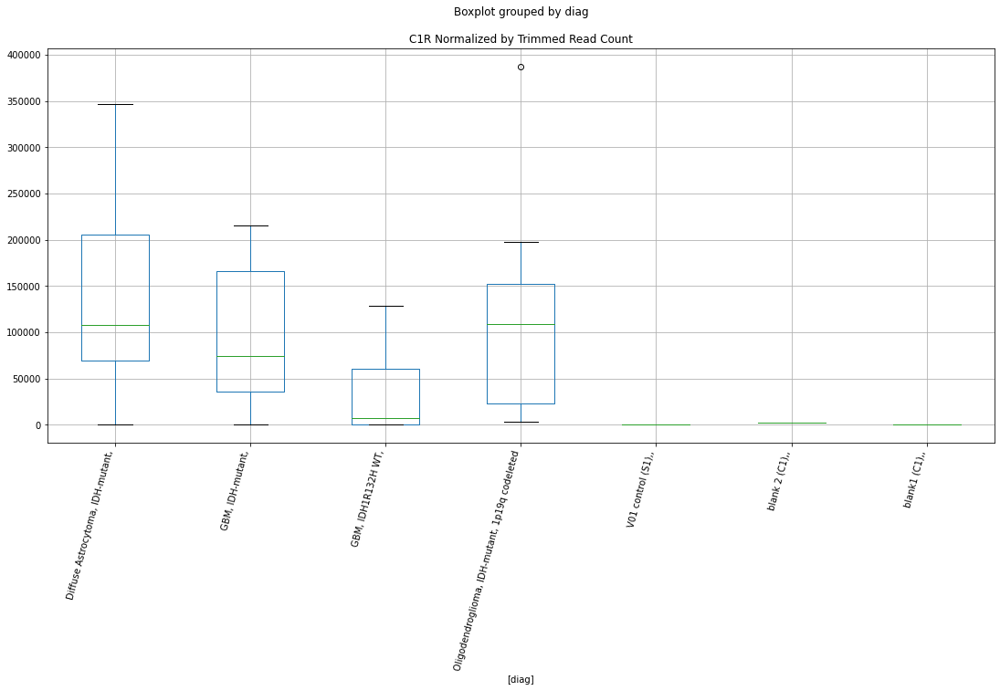

 p : 0.012066811204449778  ( t : 2.7910122910448547 ) :  D-plex  :  cutadapt2  :  DEGS2
Control and blanks
76     33335.03
340        0.00
Name: DEGS2, dtype: float64
208    176.36
Name: DEGS2, dtype: float64
472    0.0
Name: DEGS2, dtype: float64


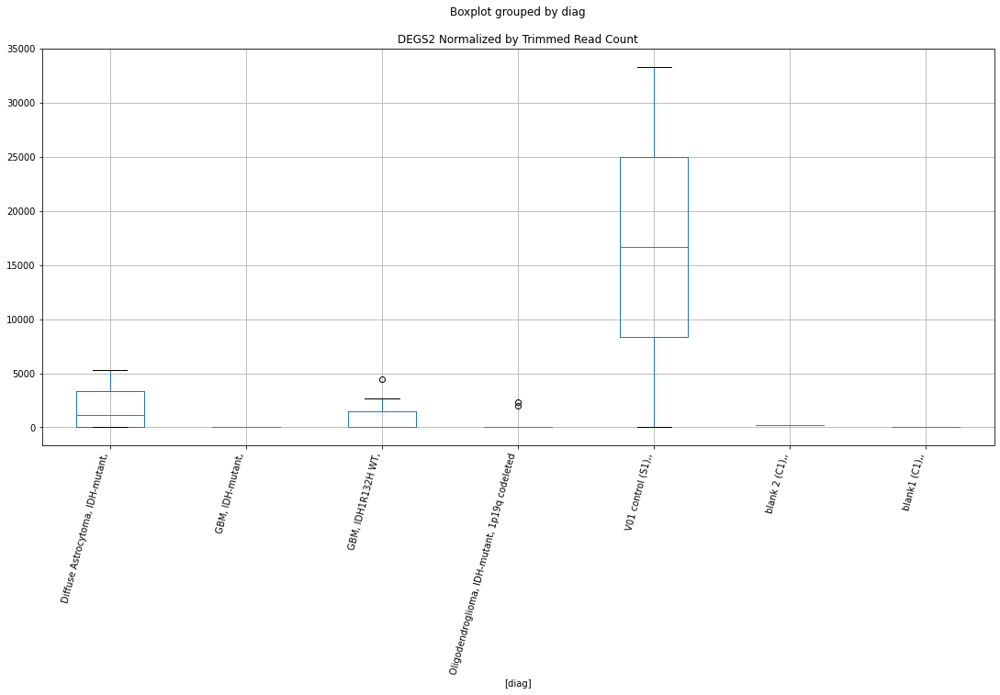

 p : 0.012080724536826334  ( t : 2.7904740975428823 ) :  Lexogen  :  cutadapt2  :  C1R
Control and blanks
82       0.00
346    841.74
Name: C1R, dtype: float64
214    2712.26
Name: C1R, dtype: float64
478    474.92
Name: C1R, dtype: float64


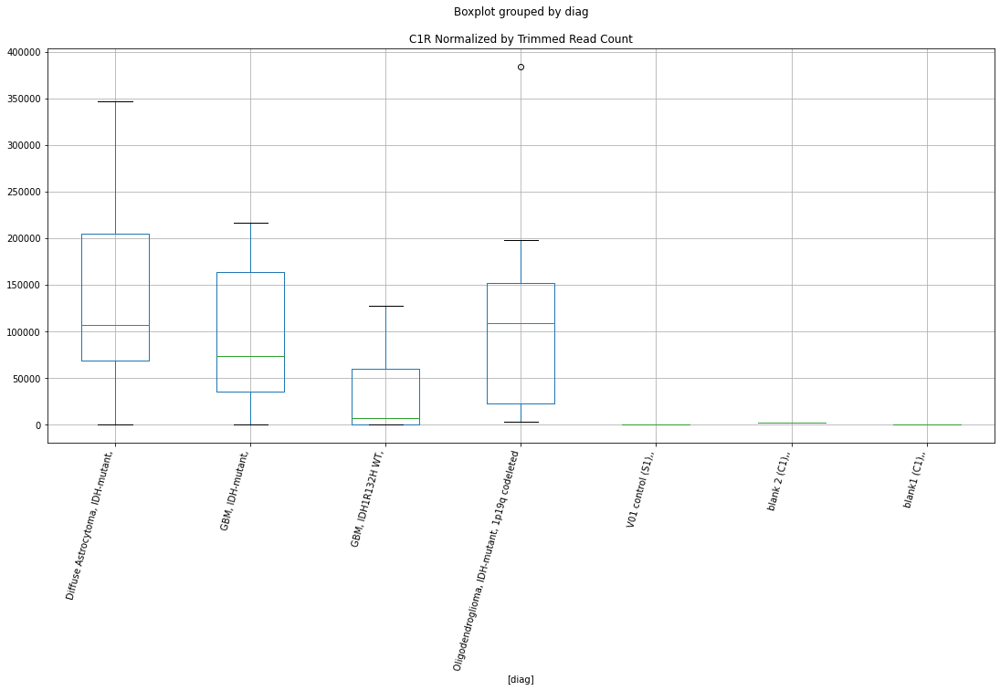

 p : 0.012247804836050485  ( t : 2.784057200726227 ) :  D-plex  :  cutadapt2  :  B3GNT6
Control and blanks
76     757.61
340      0.00
Name: B3GNT6, dtype: float64
208    1763.6
Name: B3GNT6, dtype: float64
472    1155.91
Name: B3GNT6, dtype: float64


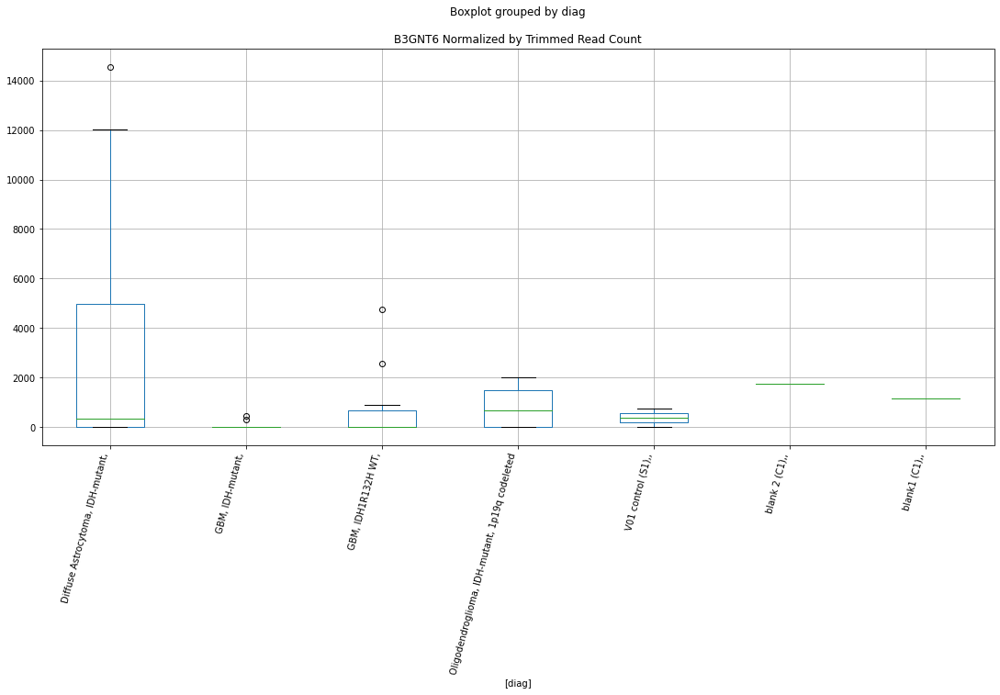

 p : 0.012278555666581653  ( t : 2.7828853458617395 ) :  Lexogen  :  cutadapt2  :  CCR2
Control and blanks
82     17040.61
346        0.00
Name: CCR2, dtype: float64
214    0.0
Name: CCR2, dtype: float64
478    0.0
Name: CCR2, dtype: float64


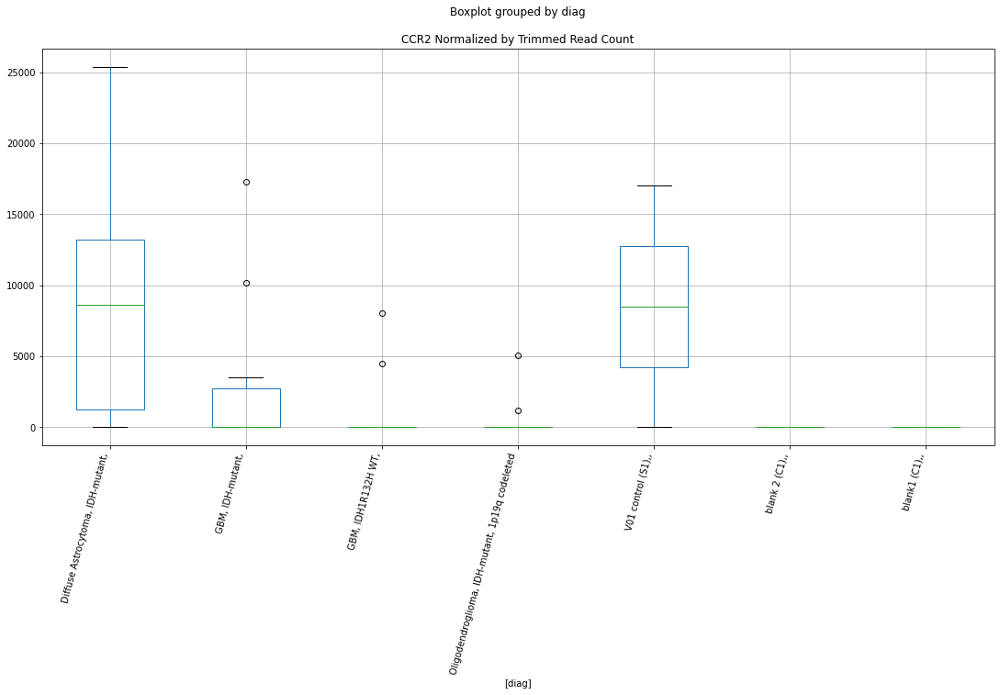

 p : 0.012543638636287907  ( t : 2.772898762822283 ) :  Lexogen  :  bbduk2  :  CCR2
Control and blanks
79     17167.19
343        0.00
Name: CCR2, dtype: float64
211    0.0
Name: CCR2, dtype: float64
475    0.0
Name: CCR2, dtype: float64


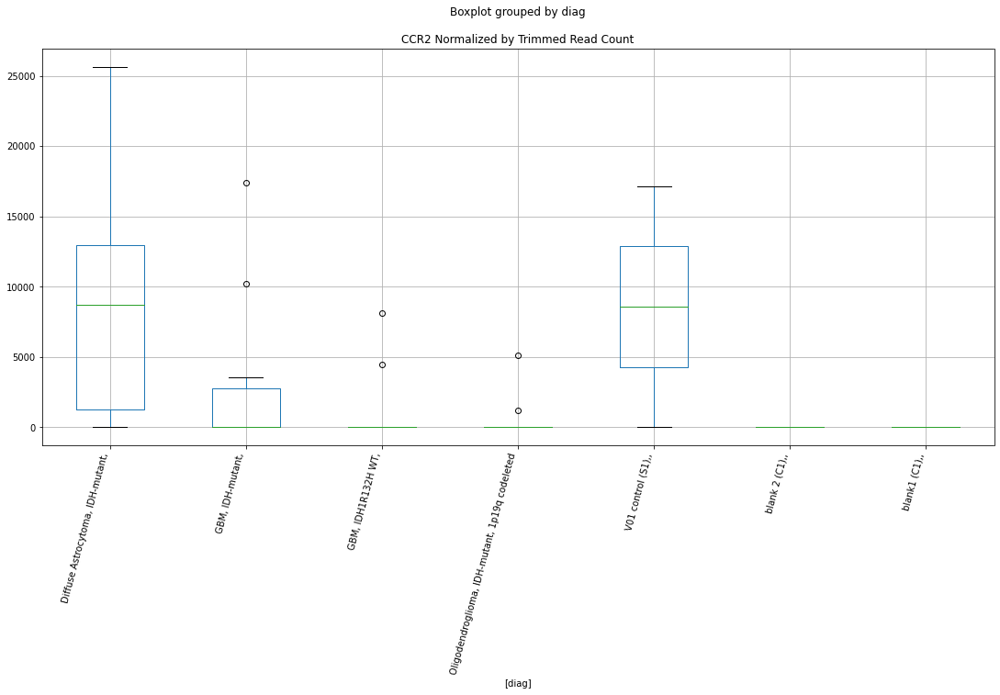

 p : 0.012569104877992489  ( t : 2.7719500486324424 ) :  D-plex  :  bbduk2  :  DIRAS1
Control and blanks
73      1546.02
337    16022.83
Name: DIRAS1, dtype: float64
205    4477.27
Name: DIRAS1, dtype: float64
469    2366.11
Name: DIRAS1, dtype: float64


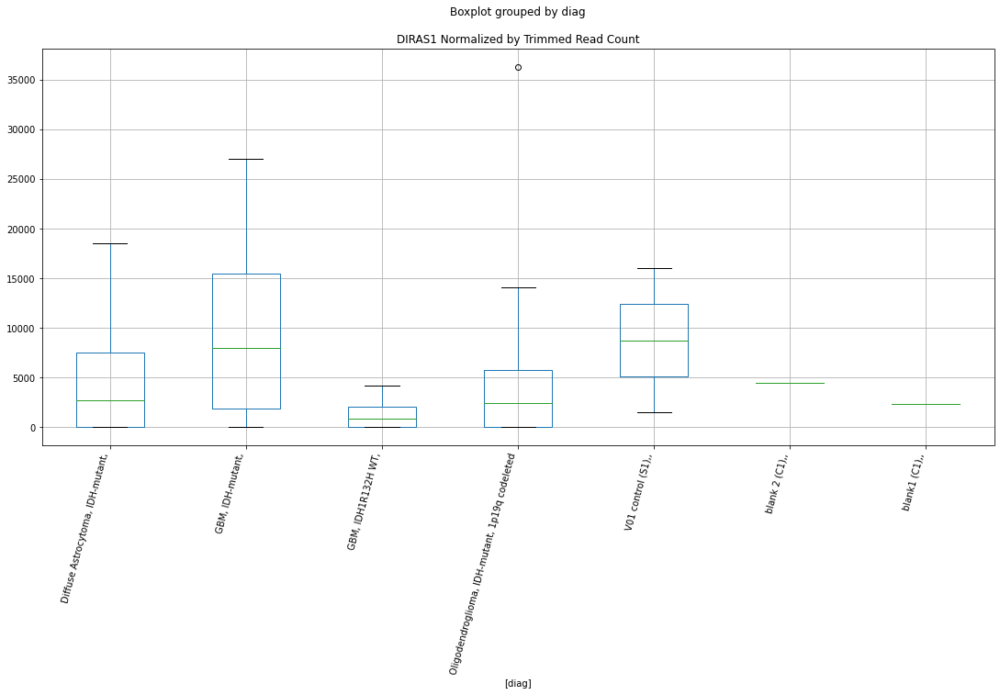

 p : 0.01291137563460313  ( t : 2.759374993805351 ) :  D-plex  :  cutadapt2  :  CMTM3
Control and blanks
76     0.0
340    0.0
Name: CMTM3, dtype: float64
208    881.8
Name: CMTM3, dtype: float64
472    3467.74
Name: CMTM3, dtype: float64


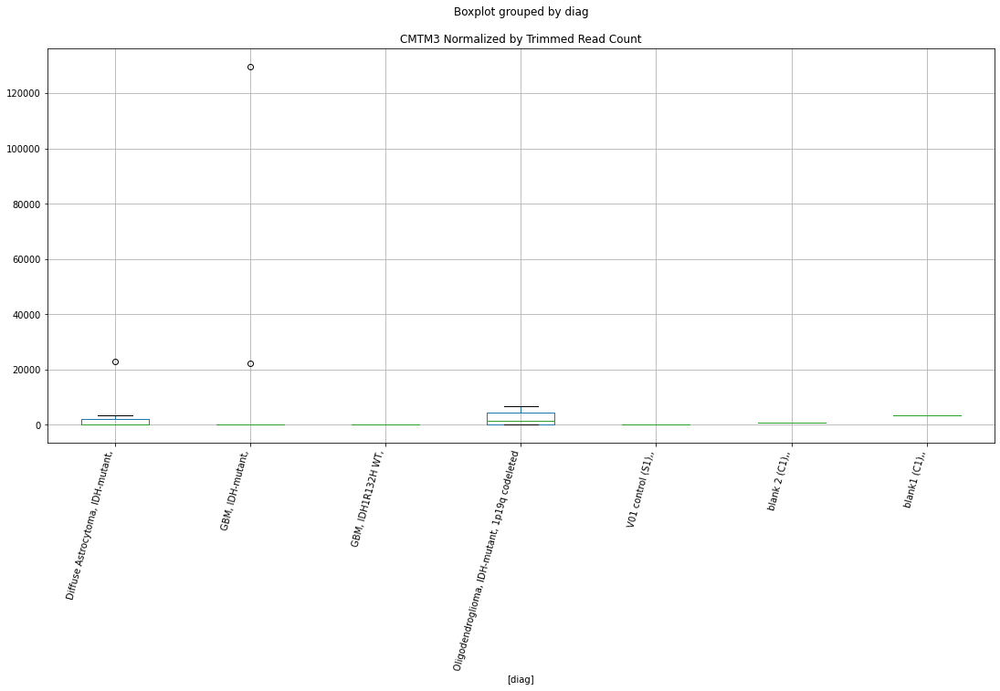

 p : 0.01293143999332552  ( t : 2.758647780999206 ) :  D-plex  :  bbduk2  :  CHD8
Control and blanks
73     0.0
337    0.0
Name: CHD8, dtype: float64
205    1432.73
Name: CHD8, dtype: float64
469    0.0
Name: CHD8, dtype: float64


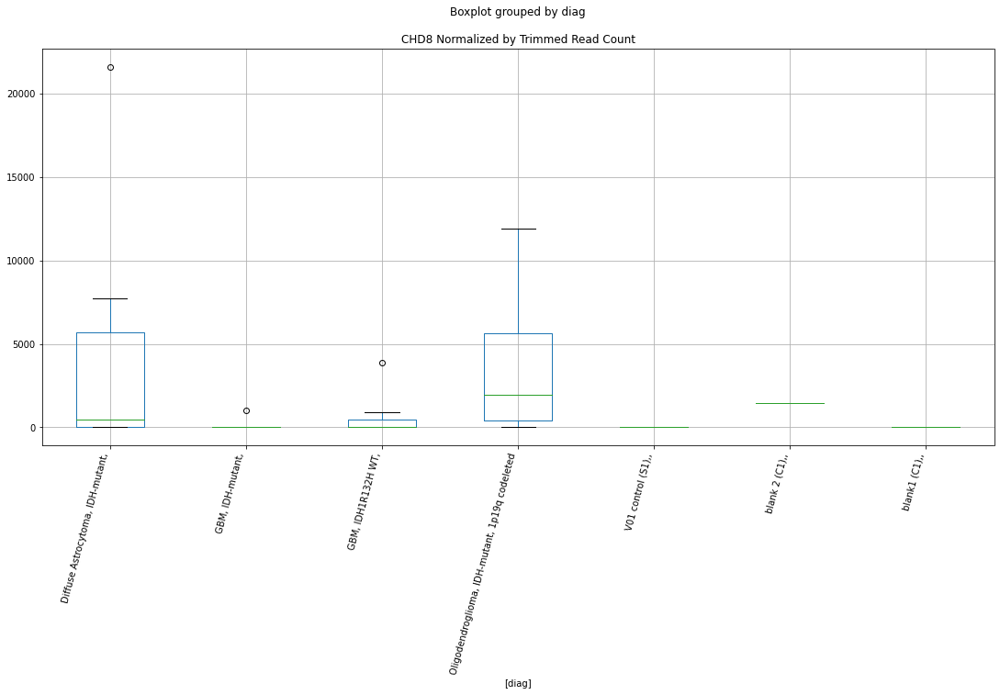

 p : 0.012967468680251745  ( t : 2.7573446673588036 ) :  D-plex  :  bbduk2  :  AKAP8L
Control and blanks
73        0.00
337    8011.42
Name: AKAP8L, dtype: float64
205    6447.27
Name: AKAP8L, dtype: float64
469    12422.07
Name: AKAP8L, dtype: float64


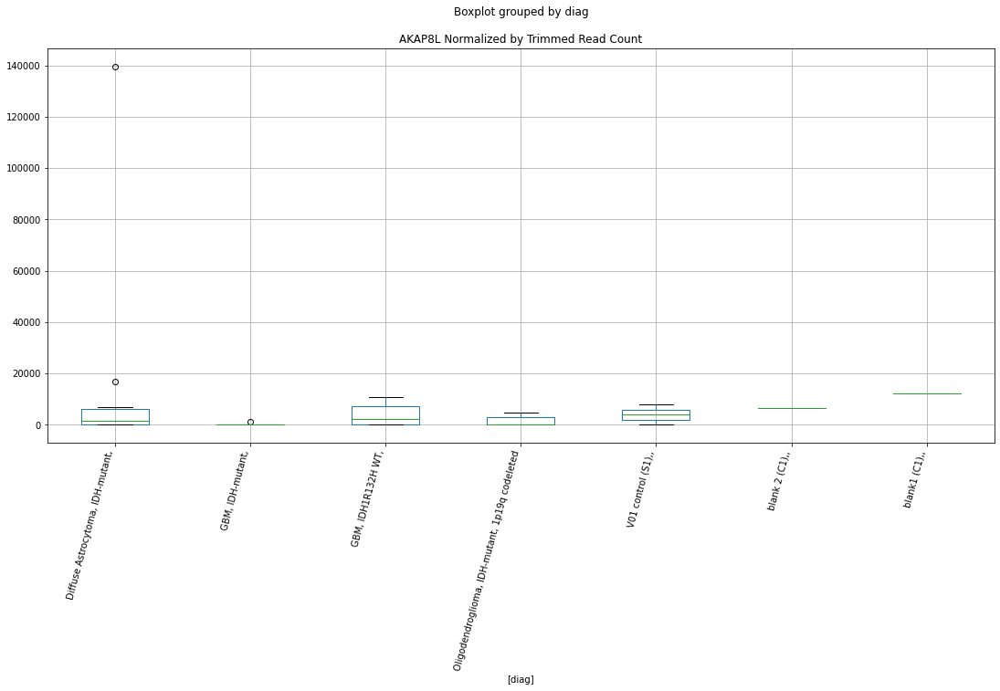

 p : 0.013061433729691325  ( t : 2.753962323379316 ) :  D-plex  :  cutadapt2  :  CIDECP1
Control and blanks
76     0.0
340    0.0
Name: CIDECP1, dtype: float64
208    0.0
Name: CIDECP1, dtype: float64
472    0.0
Name: CIDECP1, dtype: float64


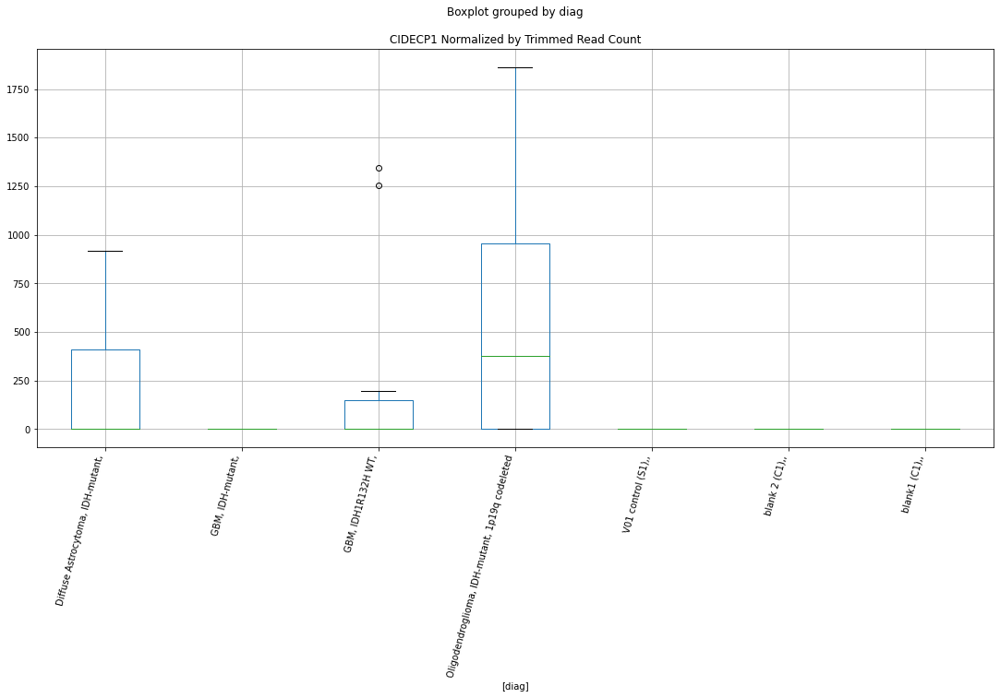

 p : 0.013136547027457349  ( t : 2.751275290366127 ) :  D-plex  :  cutadapt2  :  ACTR3C
Control and blanks
76     1515.23
340       0.00
Name: ACTR3C, dtype: float64
208    17106.94
Name: ACTR3C, dtype: float64
472    23118.23
Name: ACTR3C, dtype: float64


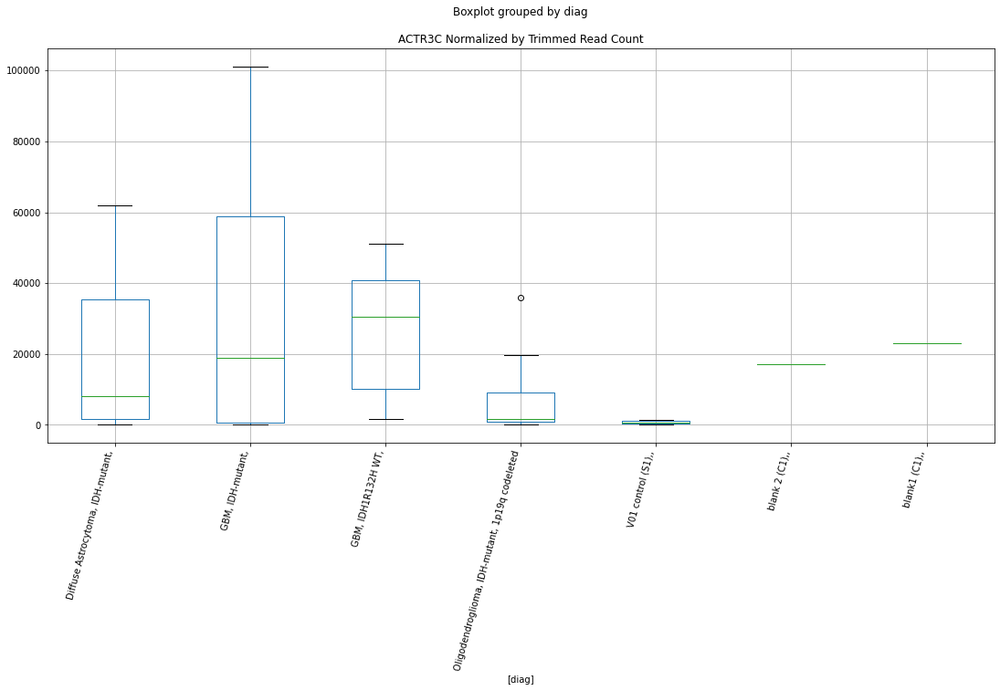

 p : 0.013398027936202405  ( t : 2.742034759737861 ) :  D-plex  :  cutadapt2  :  ACOT2
Control and blanks
76     0.0
340    0.0
Name: ACOT2, dtype: float64
208    881.8
Name: ACOT2, dtype: float64
472    0.0
Name: ACOT2, dtype: float64


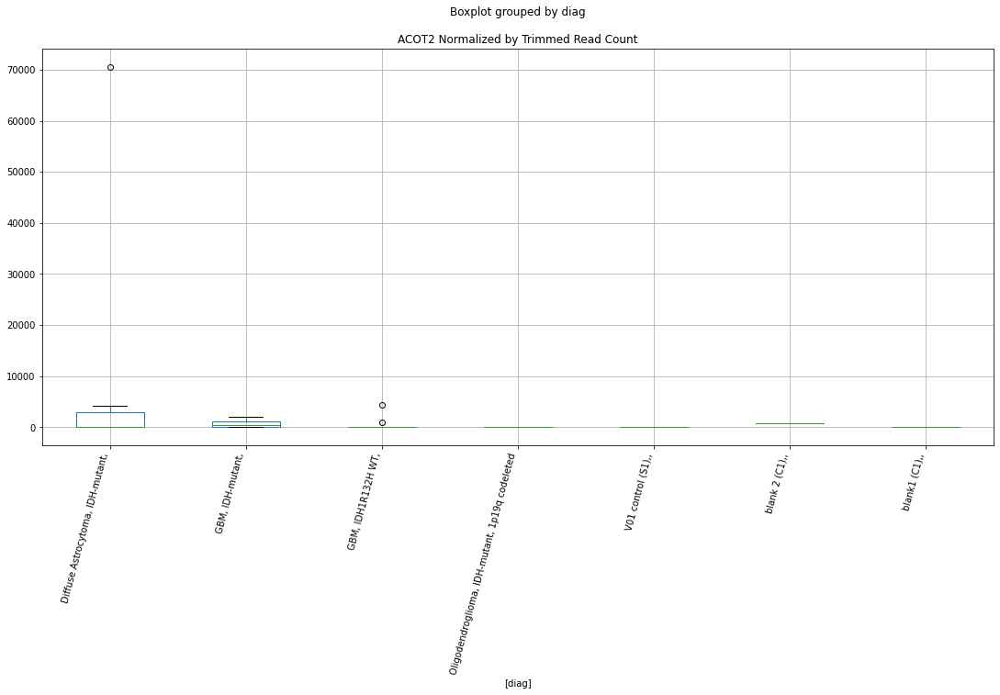

 p : 0.013400380975856994  ( t : 2.7419523918995905 ) :  Lexogen  :  bbduk2  :  ASB16
Control and blanks
79     0.0
343    0.0
Name: ASB16, dtype: float64
211    0.0
Name: ASB16, dtype: float64
475    0.0
Name: ASB16, dtype: float64


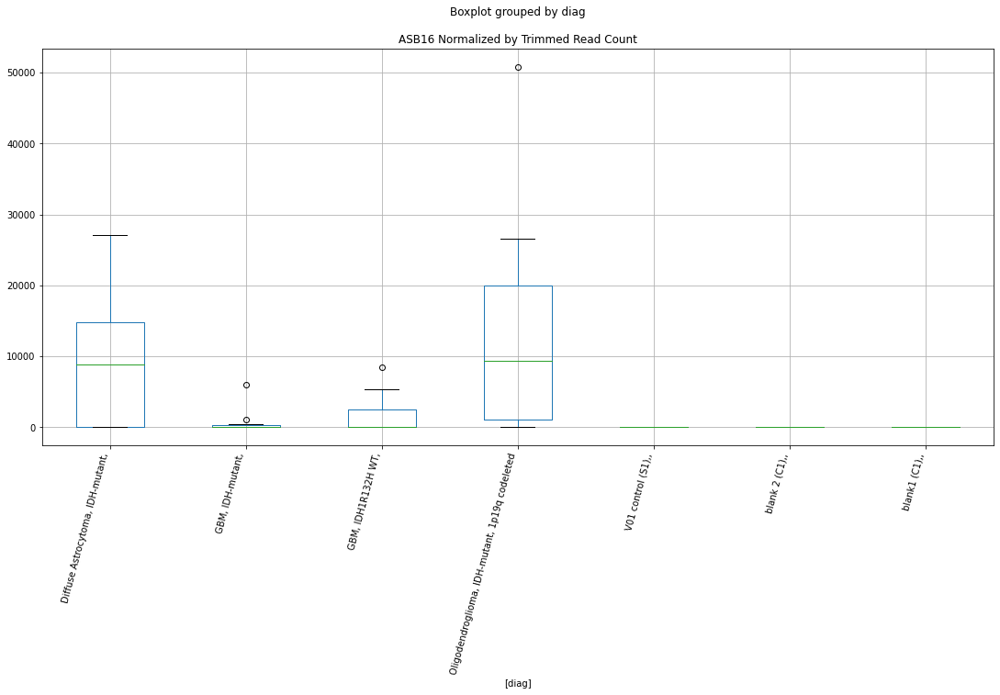

 p : 0.013558289549639689  ( t : 2.736456230719271 ) :  D-plex  :  bbduk2  :  ACOT2
Control and blanks
73     0.0
337    0.0
Name: ACOT2, dtype: float64
205    895.45
Name: ACOT2, dtype: float64
469    0.0
Name: ACOT2, dtype: float64


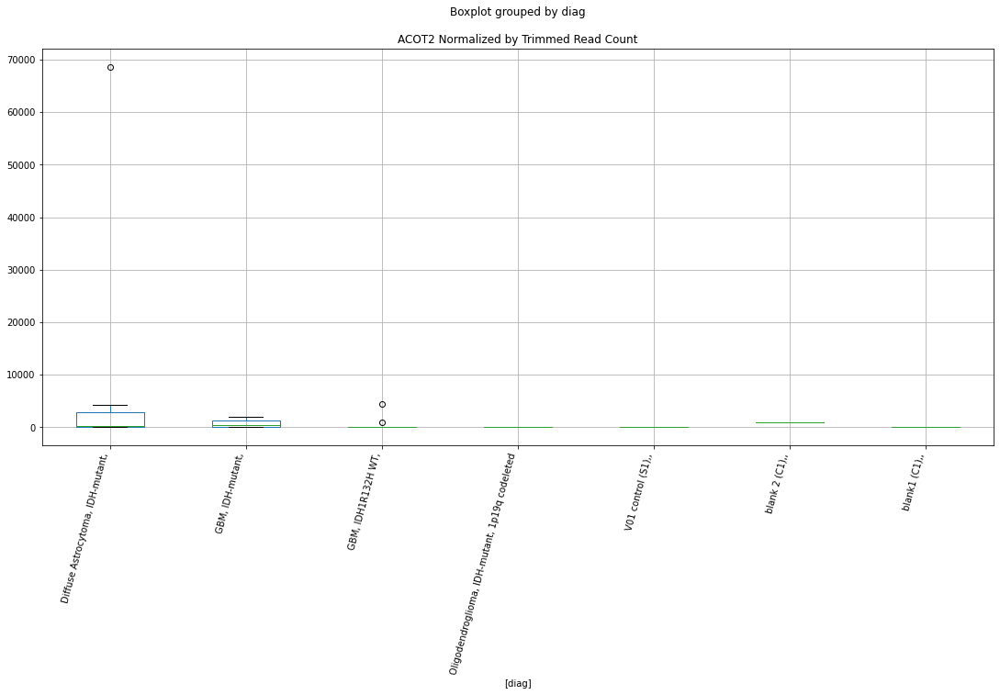

 p : 0.013559069890430816  ( t : 2.736429222673491 ) :  Lexogen  :  bbduk2  :  CCDC183
Control and blanks
79       0.00
343    212.31
Name: CCDC183, dtype: float64
211    0.0
Name: CCDC183, dtype: float64
475    0.0
Name: CCDC183, dtype: float64


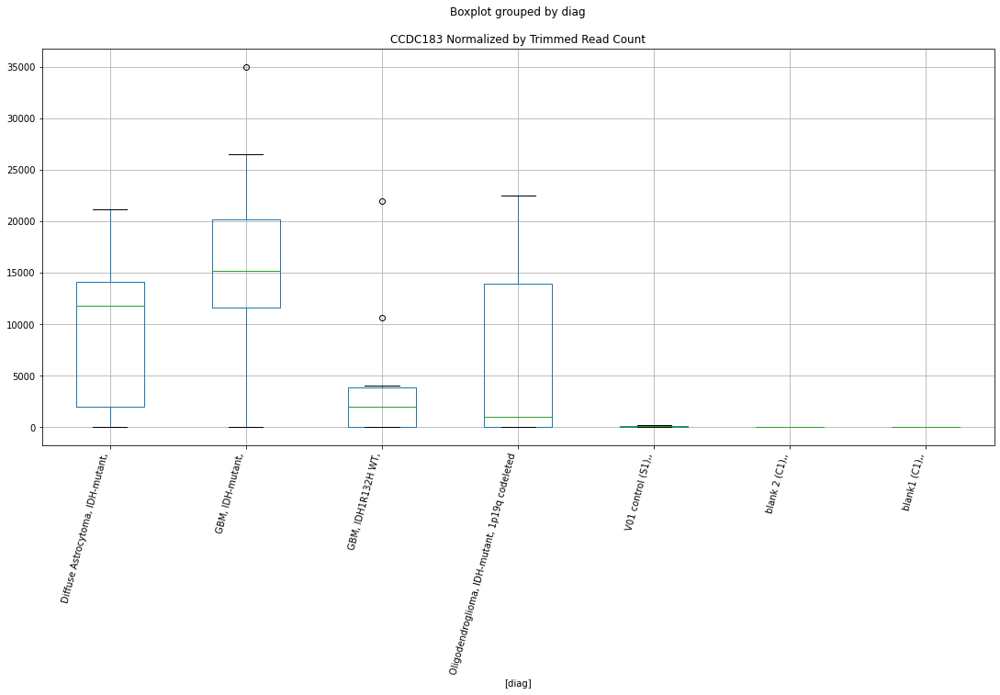

 p : 0.013565658385807037  ( t : 2.73620125033693 ) :  Lexogen  :  cutadapt2  :  ASB16
Control and blanks
82     0.0
346    0.0
Name: ASB16, dtype: float64
214    0.0
Name: ASB16, dtype: float64
478    0.0
Name: ASB16, dtype: float64


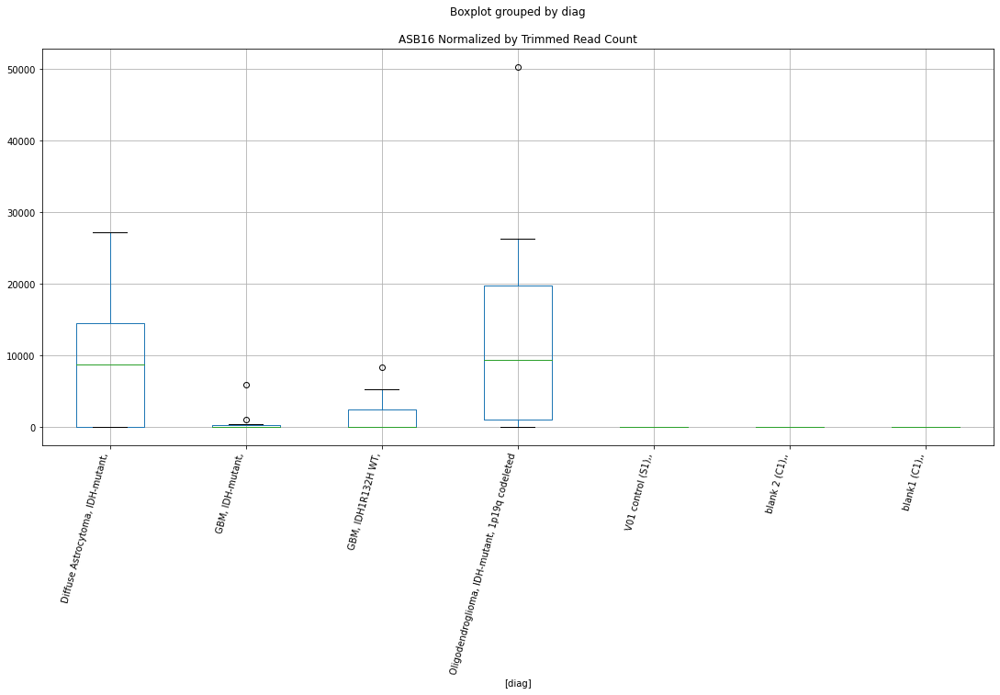

 p : 0.013575232891647745  ( t : 2.7358701461783514 ) :  Lexogen  :  bbduk2  :  CMC1
Control and blanks
79       0.00
343    849.26
Name: CMC1, dtype: float64
211    0.0
Name: CMC1, dtype: float64
475    958.06
Name: CMC1, dtype: float64


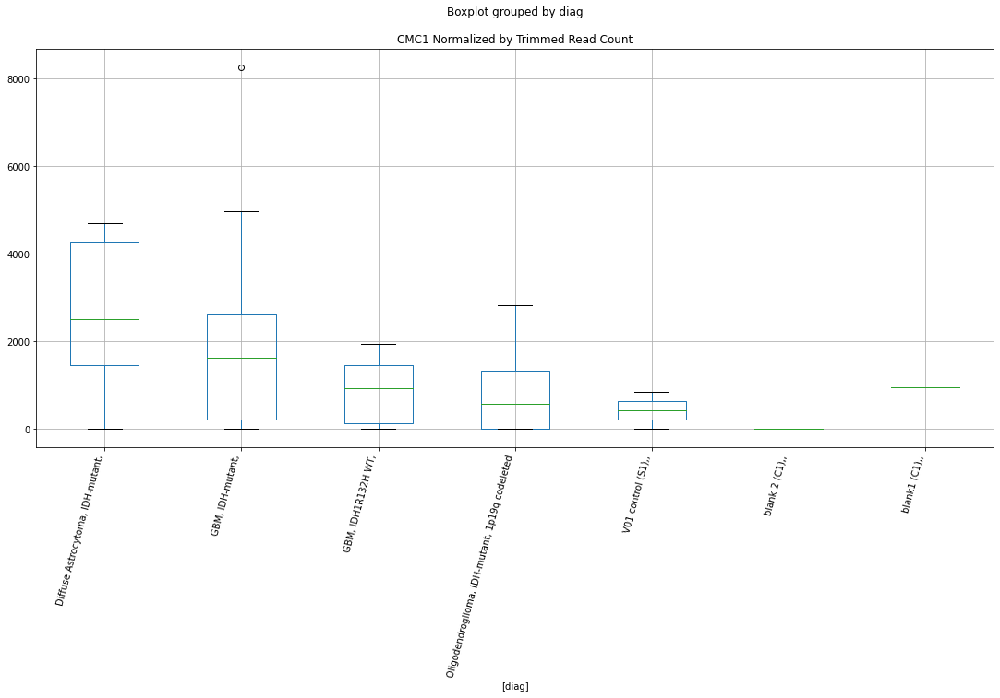

 p : 0.013652196558837927  ( t : 2.733216691031408 ) :  D-plex  :  cutadapt2  :  BOK
Control and blanks
76     0.0
340    0.0
Name: BOK, dtype: float64
208    0.0
Name: BOK, dtype: float64
472    0.0
Name: BOK, dtype: float64


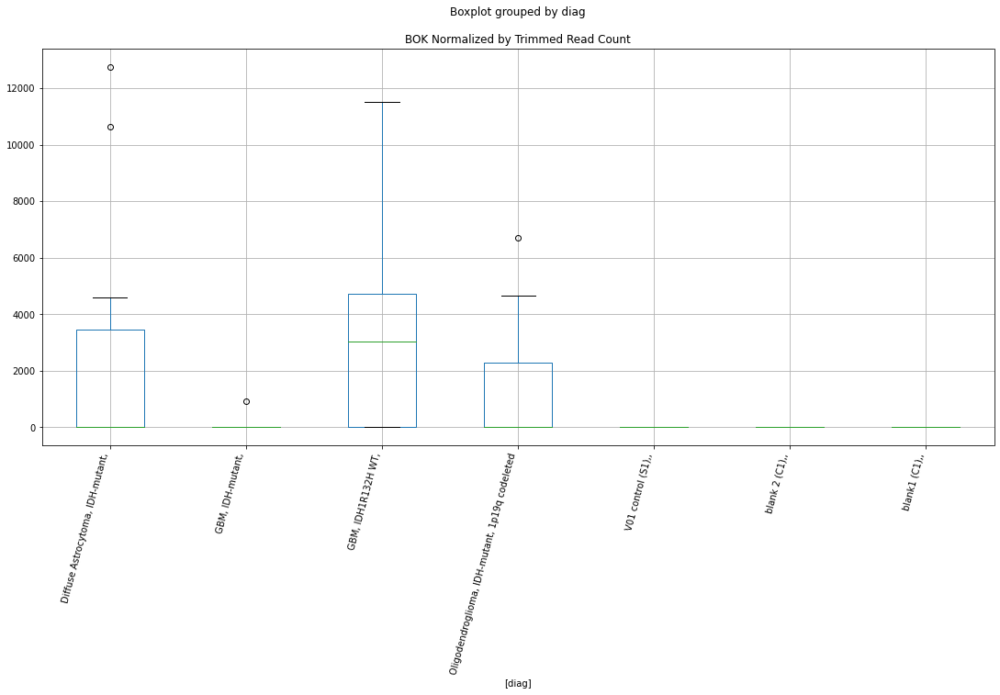

 p : 0.013695545629858438  ( t : 2.7317284530933645 ) :  D-plex  :  bbduk2  :  CD248
Control and blanks
73     13141.14
337        0.00
Name: CD248, dtype: float64
205    5014.55
Name: CD248, dtype: float64
469    10055.96
Name: CD248, dtype: float64


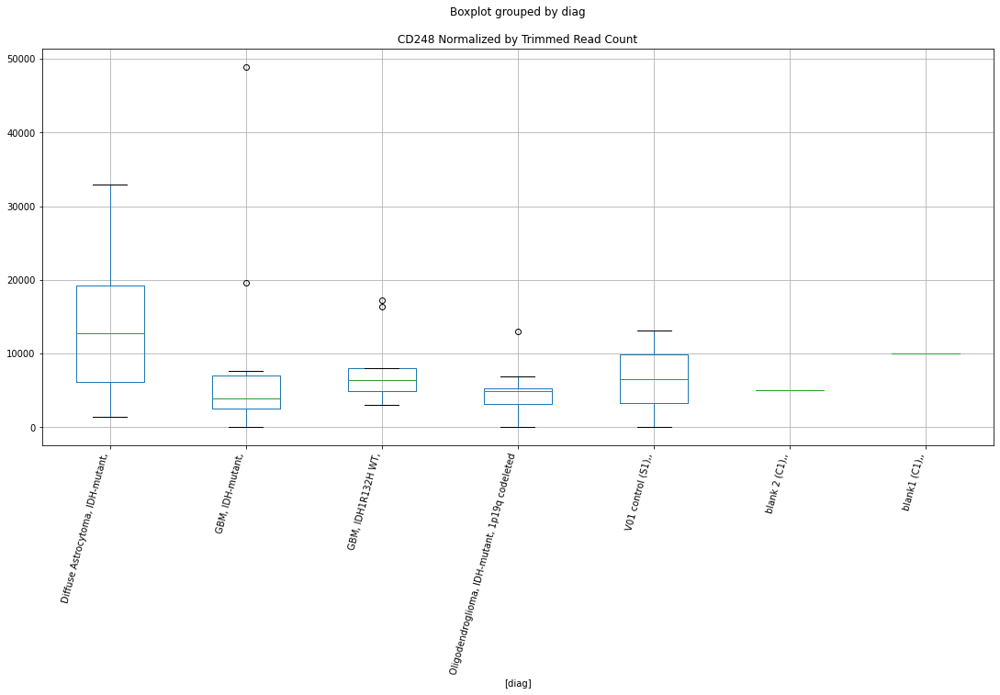

 p : 0.014036035171630865  ( t : 2.7201932612513233 ) :  Lexogen  :  bbduk2  :  C3orf22
Control and blanks
79     0.0
343    0.0
Name: C3orf22, dtype: float64
211    0.0
Name: C3orf22, dtype: float64
475    0.0
Name: C3orf22, dtype: float64


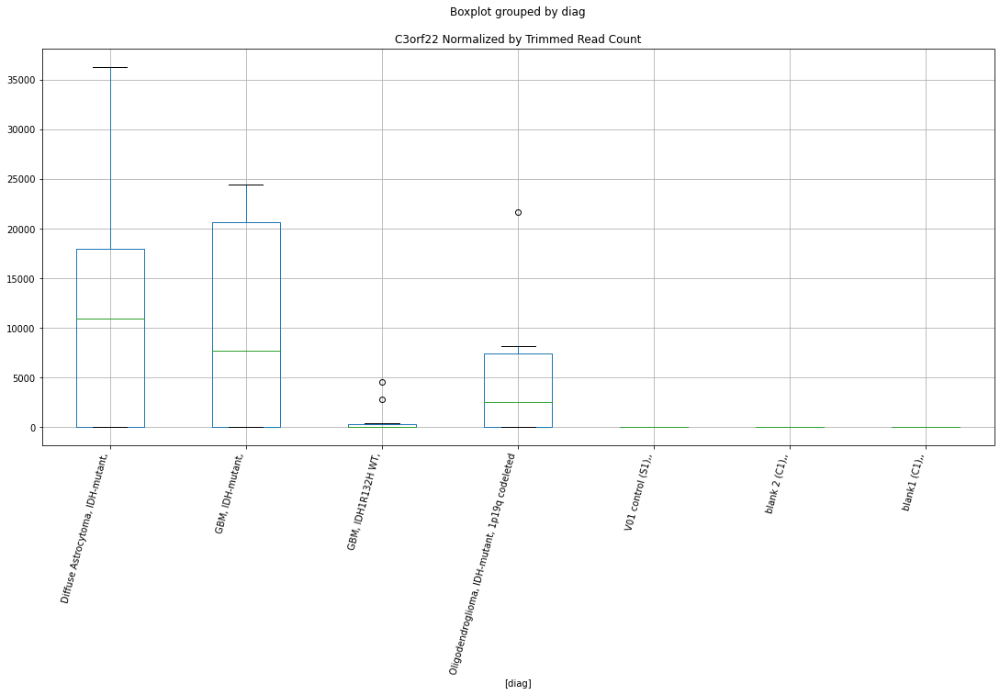

 p : 0.014185760346259598  ( t : 2.7152053275068306 ) :  Lexogen  :  cutadapt2  :  CCDC183
Control and blanks
82       0.00
346    210.43
Name: CCDC183, dtype: float64
214    0.0
Name: CCDC183, dtype: float64
478    0.0
Name: CCDC183, dtype: float64


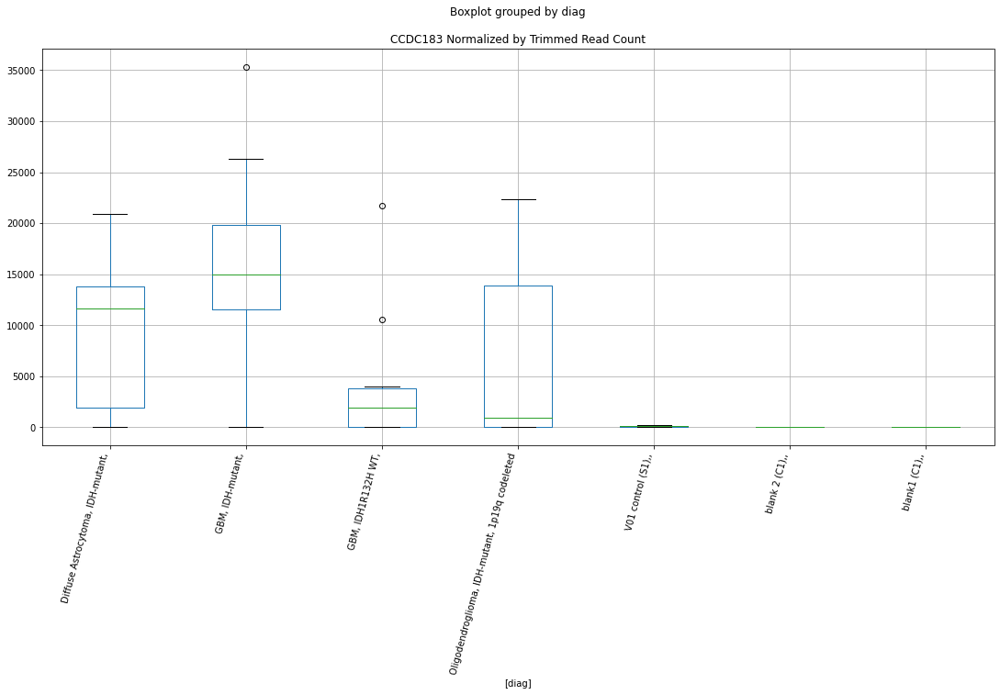

 p : 0.014212136512043156  ( t : 2.7143318517762567 ) :  D-plex  :  cutadapt2  :  ARHGAP21
Control and blanks
76     128794.42
340         0.00
Name: ARHGAP21, dtype: float64
208    21339.59
Name: ARHGAP21, dtype: float64
472    5779.56
Name: ARHGAP21, dtype: float64


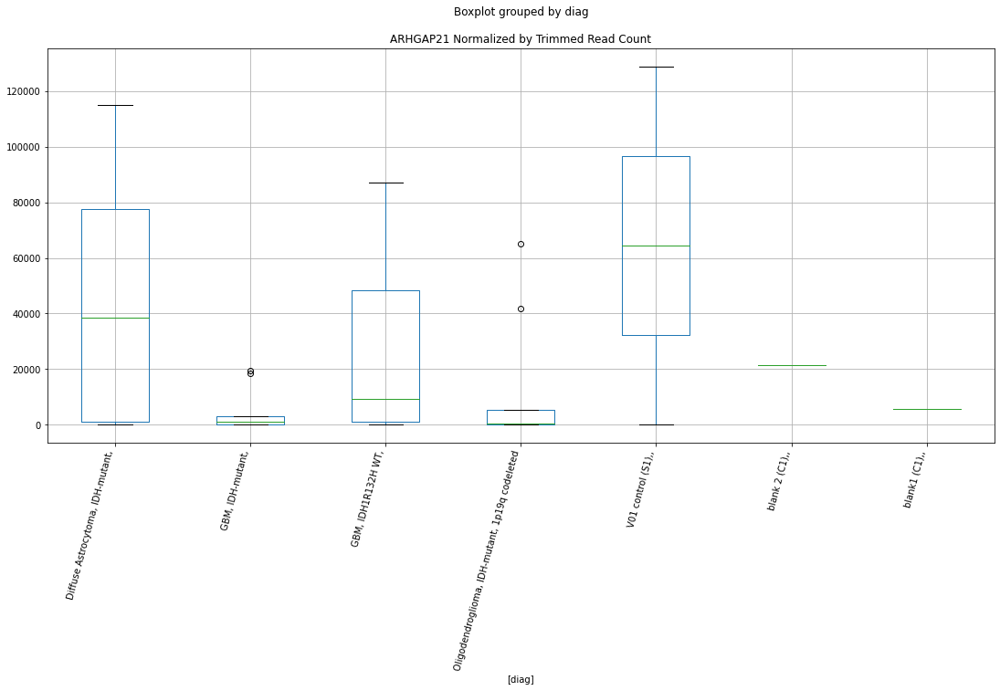

 p : 0.014299909483139655  ( t : 2.711436270941546 ) :  Lexogen  :  cutadapt2  :  C3orf22
Control and blanks
82     0.0
346    0.0
Name: C3orf22, dtype: float64
214    0.0
Name: C3orf22, dtype: float64
478    0.0
Name: C3orf22, dtype: float64


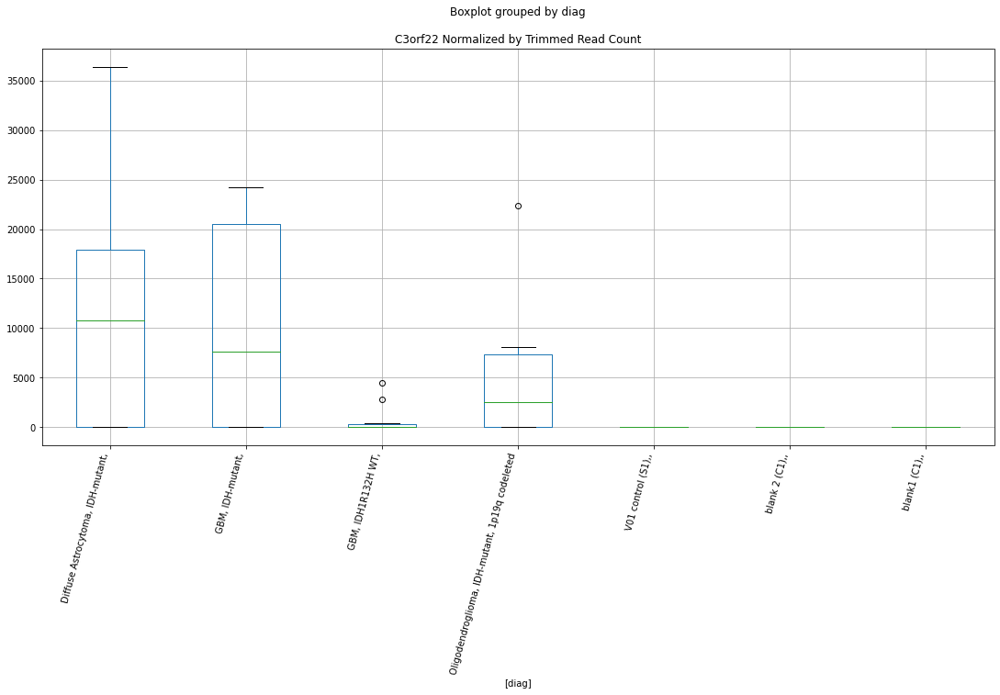

 p : 0.014508162680401929  ( t : 2.704633511785049 ) :  Lexogen  :  bbduk2  :  CACNA1H
Control and blanks
79          0.00
343    205095.63
Name: CACNA1H, dtype: float64
211    0.0
Name: CACNA1H, dtype: float64
475    0.0
Name: CACNA1H, dtype: float64


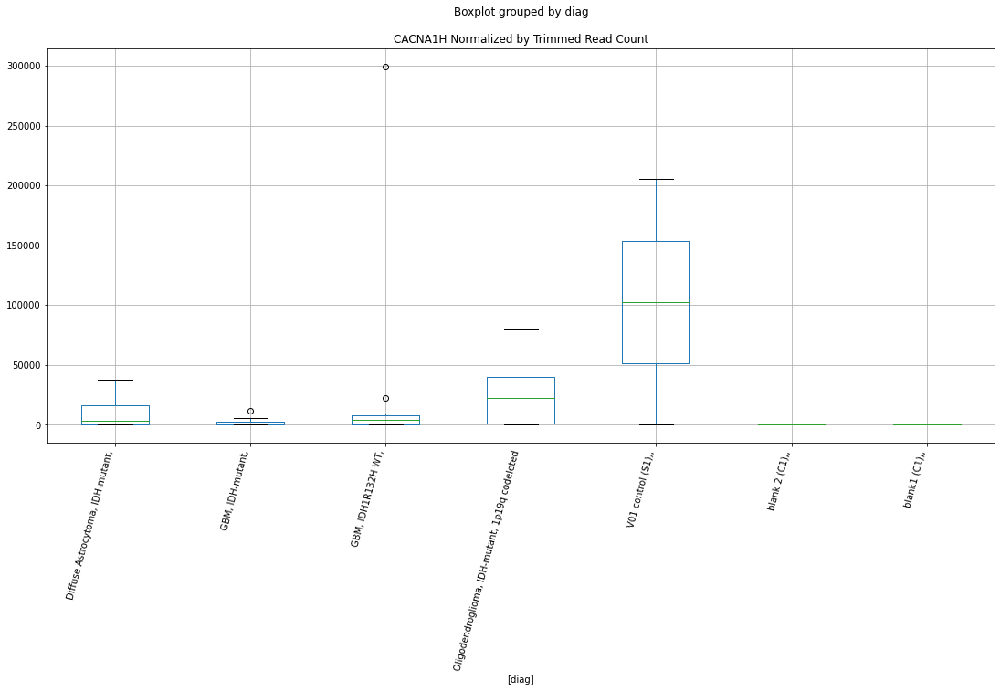

 p : 0.014537322631580574  ( t : 2.7036884344597203 ) :  D-plex  :  bbduk2  :  CDR2L
Control and blanks
73     0.0
337    0.0
Name: CDR2L, dtype: float64
205    716.36
Name: CDR2L, dtype: float64
469    4732.22
Name: CDR2L, dtype: float64


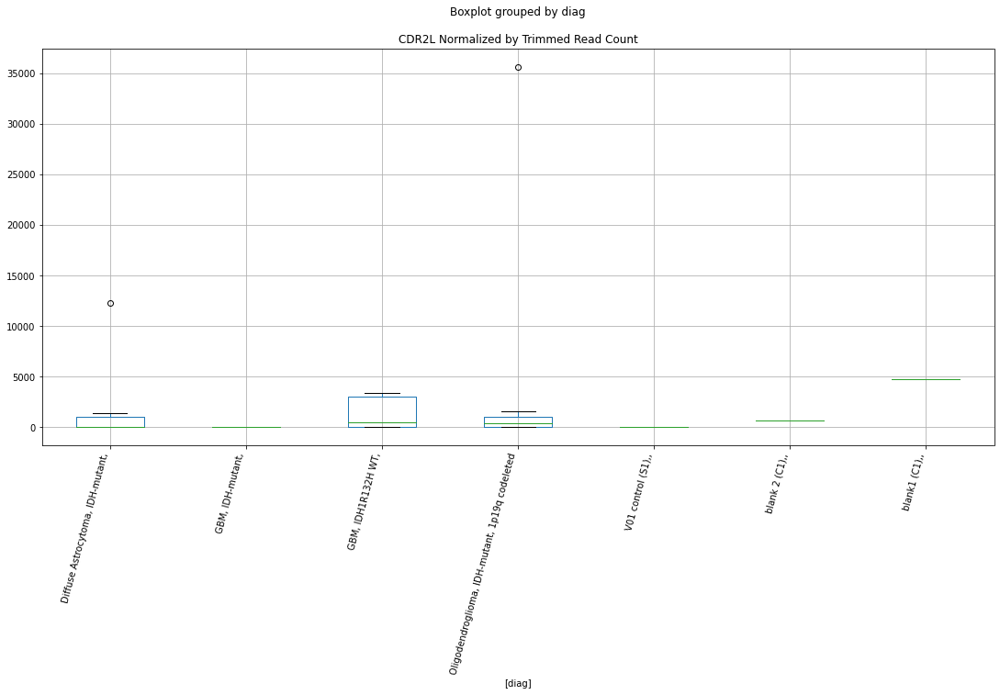

 p : 0.014540813574728466  ( t : 2.7035754140086974 ) :  D-plex  :  bbduk2  :  DIS3L2
Control and blanks
73          0.00
337    115720.44
Name: DIS3L2, dtype: float64
205    1970.0
Name: DIS3L2, dtype: float64
469    2957.64
Name: DIS3L2, dtype: float64


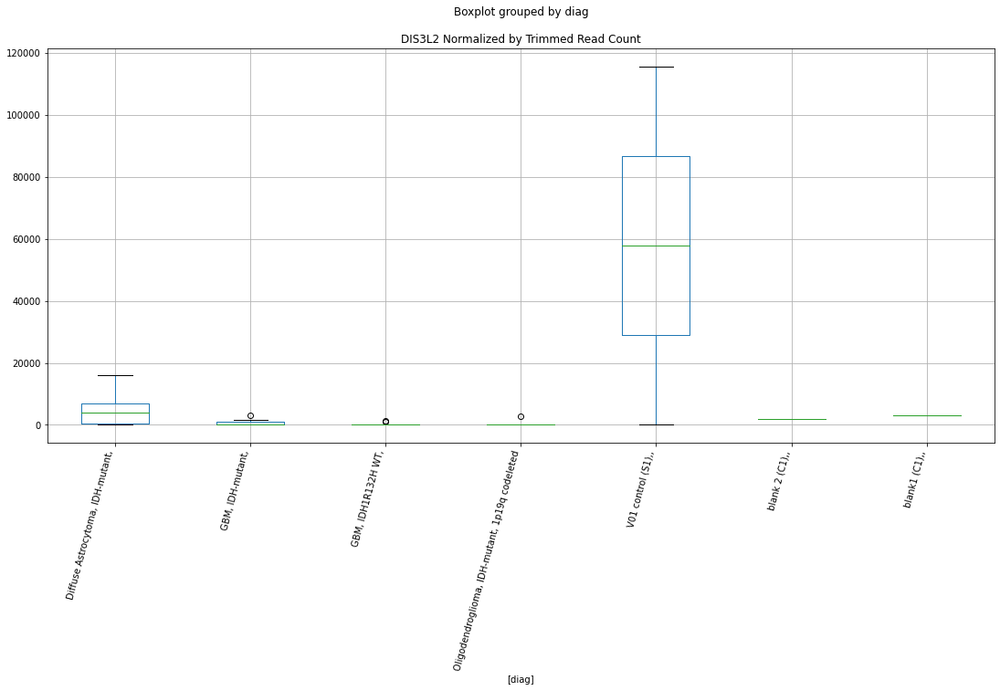

 p : 0.01457221141968344  ( t : 2.7025600617297294 ) :  D-plex  :  cutadapt2  :  CDR2L
Control and blanks
76     0.0
340    0.0
Name: CDR2L, dtype: float64
208    352.72
Name: CDR2L, dtype: float64
472    4623.65
Name: CDR2L, dtype: float64


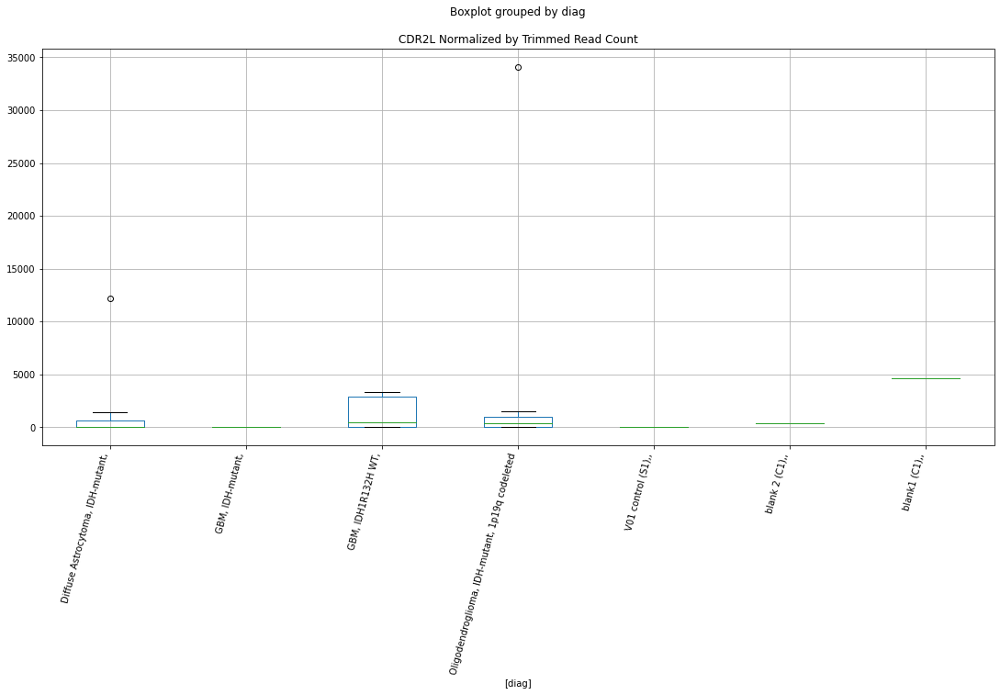

 p : 0.01466056166599746  ( t : 2.6997141408271794 ) :  D-plex  :  bbduk2  :  COIL
Control and blanks
73     0.0
337    0.0
Name: COIL, dtype: float64
205    358.18
Name: COIL, dtype: float64
469    0.0
Name: COIL, dtype: float64


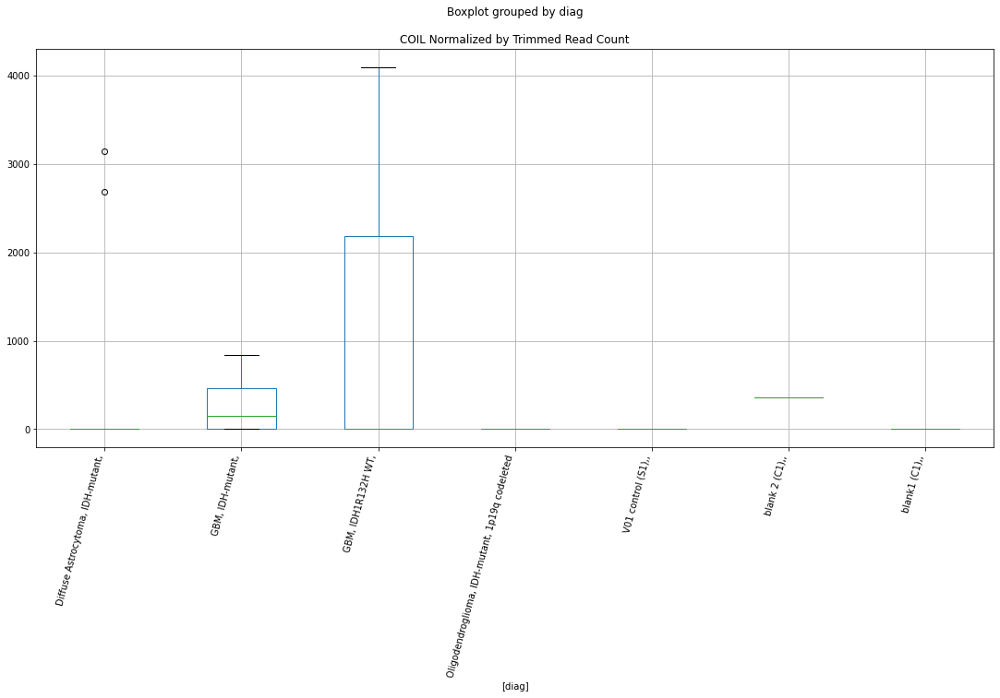

 p : 0.014893797873571679  ( t : 2.6922791520645464 ) :  D-plex  :  cutadapt2  :  CD248
Control and blanks
76     12121.83
340        0.00
Name: CD248, dtype: float64
208    4761.73
Name: CD248, dtype: float64
472    9825.25
Name: CD248, dtype: float64


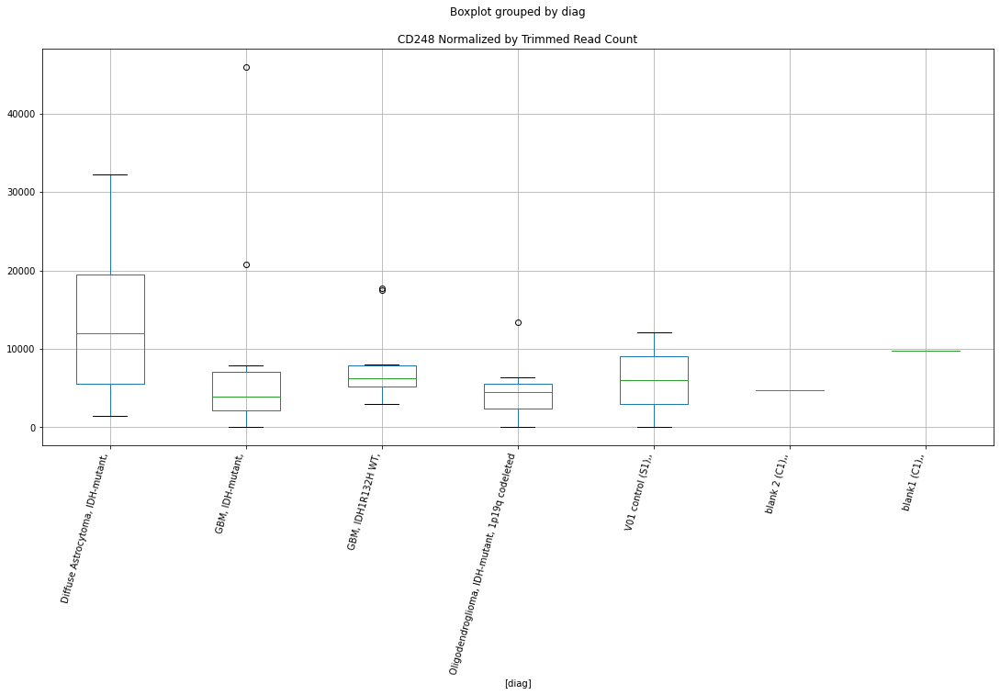

 p : 0.014991195795396057  ( t : 2.689207203431024 ) :  D-plex  :  cutadapt2  :  ARRDC3
Control and blanks
76     0.0
340    0.0
Name: ARRDC3, dtype: float64
208    529.08
Name: ARRDC3, dtype: float64
472    0.0
Name: ARRDC3, dtype: float64


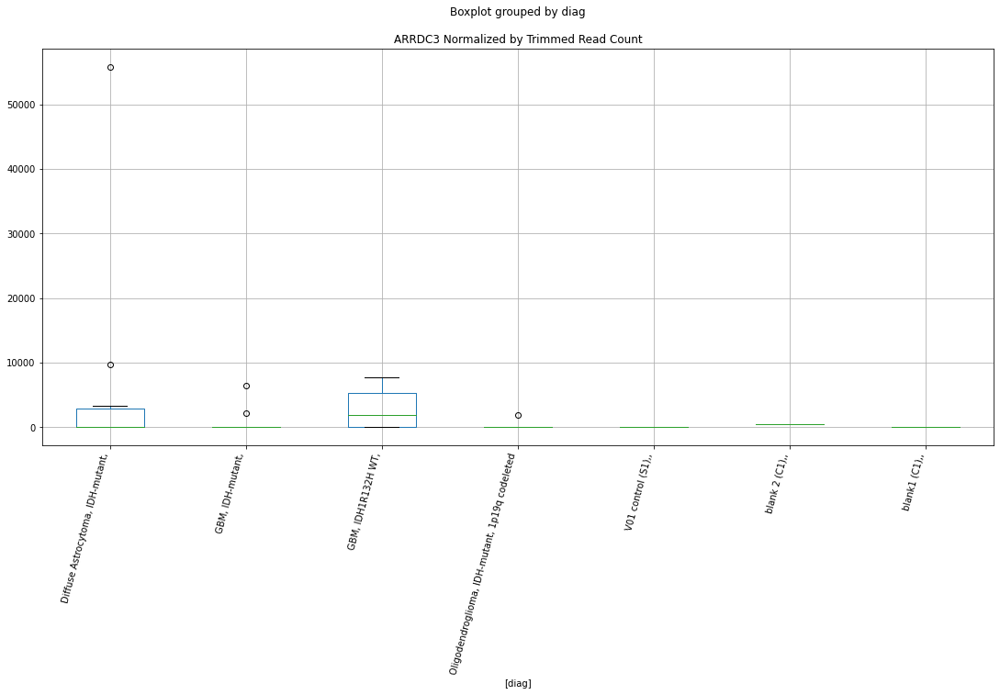

 p : 0.01513340029044402  ( t : 2.6847560869380427 ) :  Lexogen  :  bbduk2  :  CD82
Control and blanks
79     0.0
343    0.0
Name: CD82, dtype: float64
211    0.0
Name: CD82, dtype: float64
475    0.0
Name: CD82, dtype: float64


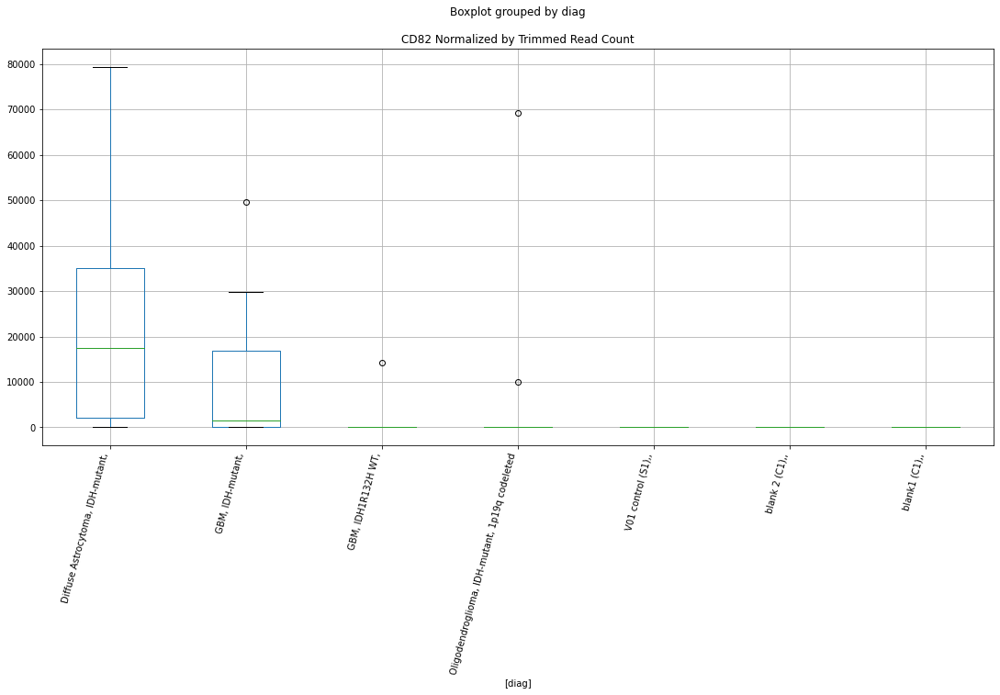

 p : 0.015160055104513986  ( t : 2.68392621378644 ) :  Lexogen  :  bbduk2  :  C10orf71
Control and blanks
79        0.00
343    1698.51
Name: C10orf71, dtype: float64
211    0.0
Name: C10orf71, dtype: float64
475    0.0
Name: C10orf71, dtype: float64


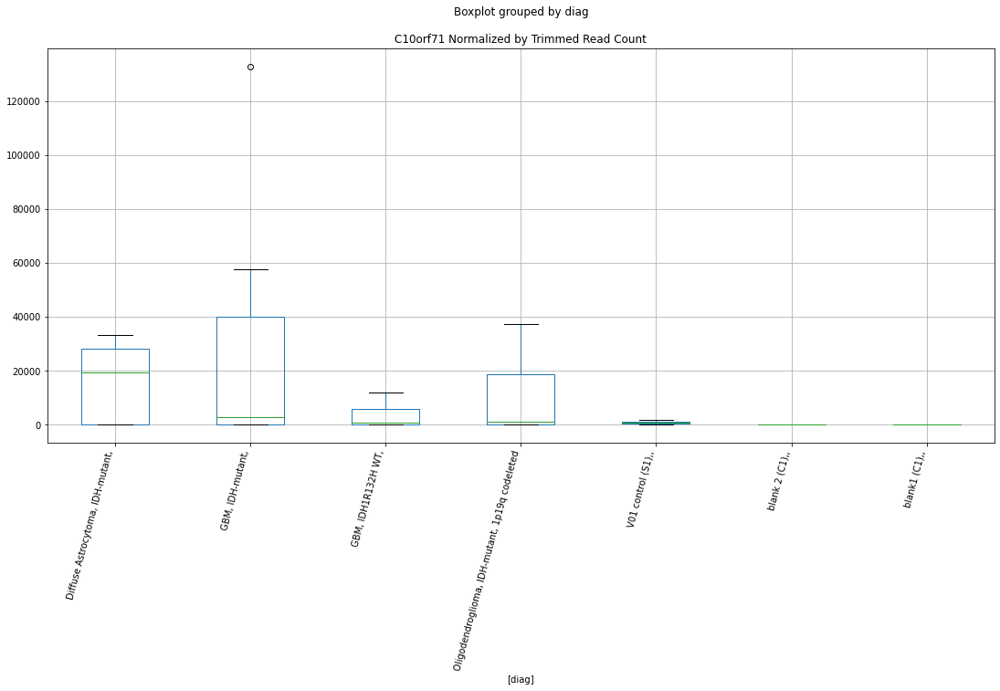

 p : 0.015186208833658073  ( t : 2.6831132936038857 ) :  Lexogen  :  bbduk2  :  C3orf22
Control and blanks
79     0.0
343    0.0
Name: C3orf22, dtype: float64
211    0.0
Name: C3orf22, dtype: float64
475    0.0
Name: C3orf22, dtype: float64


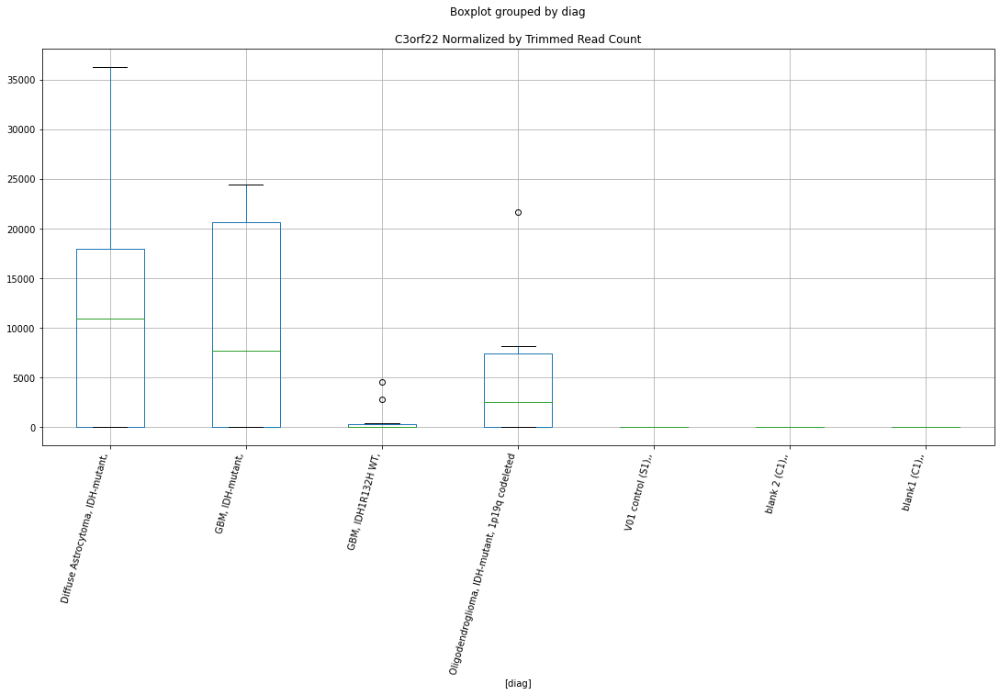

 p : 0.015186682195693746  ( t : 2.683098592695635 ) :  Lexogen  :  cutadapt2  :  C10orf71
Control and blanks
82        0.00
346    1683.48
Name: C10orf71, dtype: float64
214    0.0
Name: C10orf71, dtype: float64
478    0.0
Name: C10orf71, dtype: float64


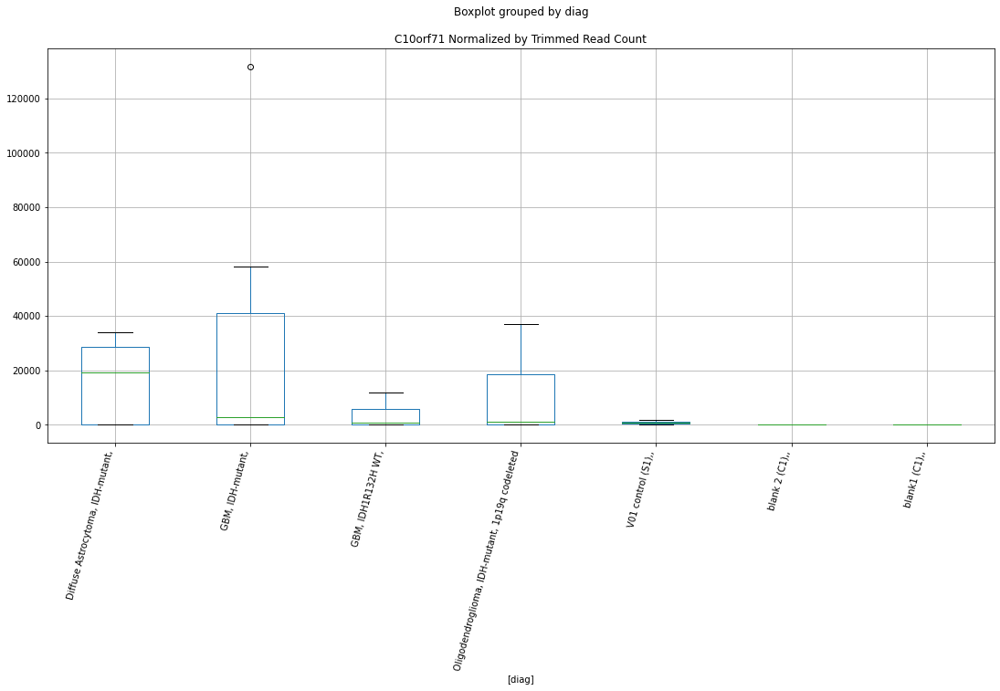

 p : 0.015193572953929453  ( t : 2.682884640224783 ) :  D-plex  :  bbduk2  :  AHCY
Control and blanks
73     1546.02
337       0.00
Name: AHCY, dtype: float64
205    11999.09
Name: AHCY, dtype: float64
469    8281.38
Name: AHCY, dtype: float64


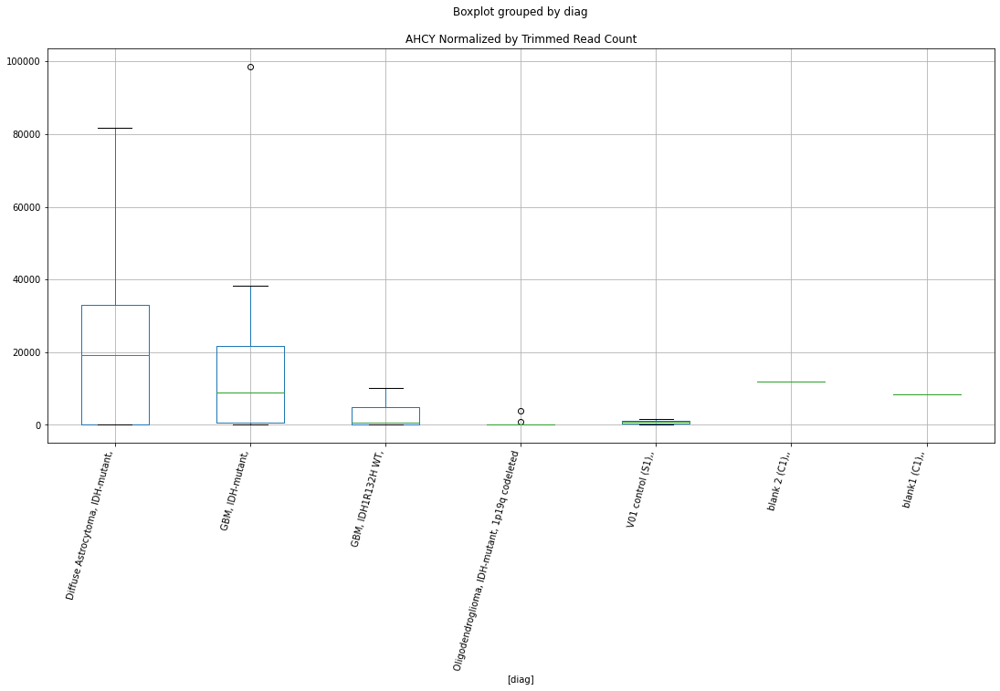

 p : 0.01523720705354686  ( t : 2.6815319821359522 ) :  Lexogen  :  bbduk2  :  ARHGAP45
Control and blanks
79     0.0
343    0.0
Name: ARHGAP45, dtype: float64
211    0.0
Name: ARHGAP45, dtype: float64
475    0.0
Name: ARHGAP45, dtype: float64


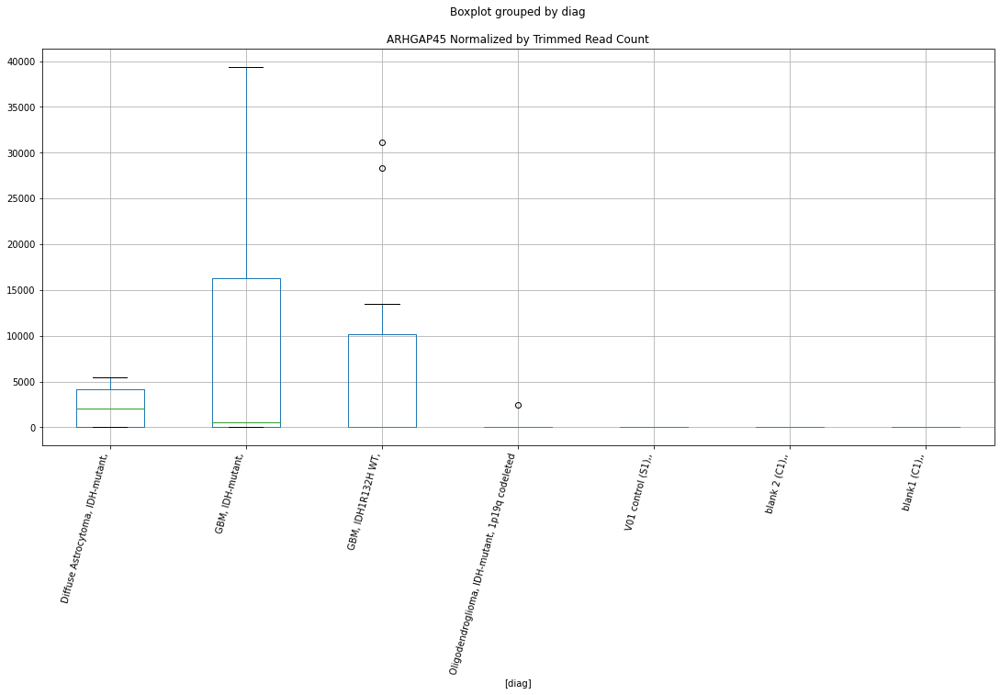

 p : 0.015248458589641514  ( t : 2.681183783616121 ) :  Lexogen  :  cutadapt2  :  C19orf57
Control and blanks
82     0.0
346    0.0
Name: C19orf57, dtype: float64
214    0.0
Name: C19orf57, dtype: float64
478    0.0
Name: C19orf57, dtype: float64


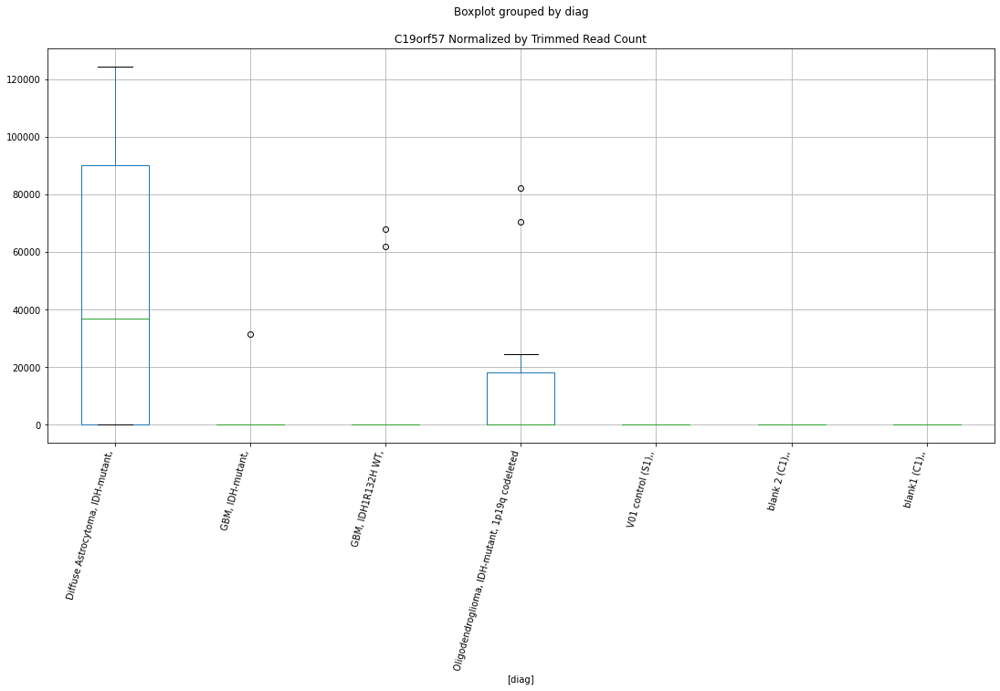

 p : 0.015250589819520802  ( t : 2.681117856582447 ) :  Lexogen  :  cutadapt2  :  C3orf22
Control and blanks
82     0.0
346    0.0
Name: C3orf22, dtype: float64
214    0.0
Name: C3orf22, dtype: float64
478    0.0
Name: C3orf22, dtype: float64


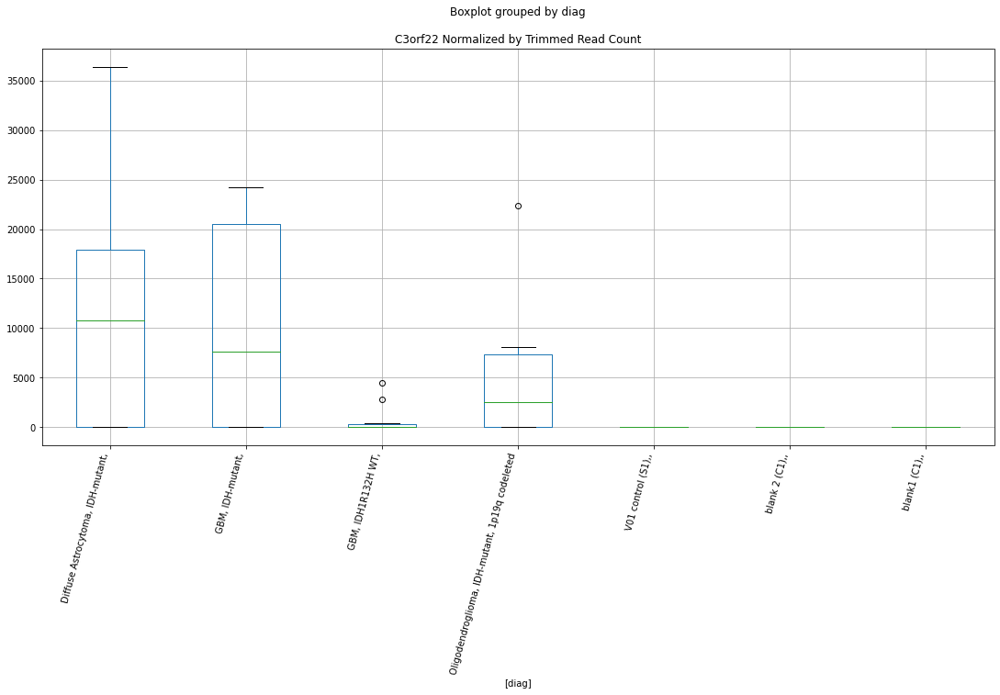

 p : 0.015321863437199594  ( t : 2.678918139555615 ) :  D-plex  :  cutadapt2  :  AHCY
Control and blanks
76     1515.23
340     880.73
Name: AHCY, dtype: float64
208    9523.45
Name: AHCY, dtype: float64
472    8091.38
Name: AHCY, dtype: float64


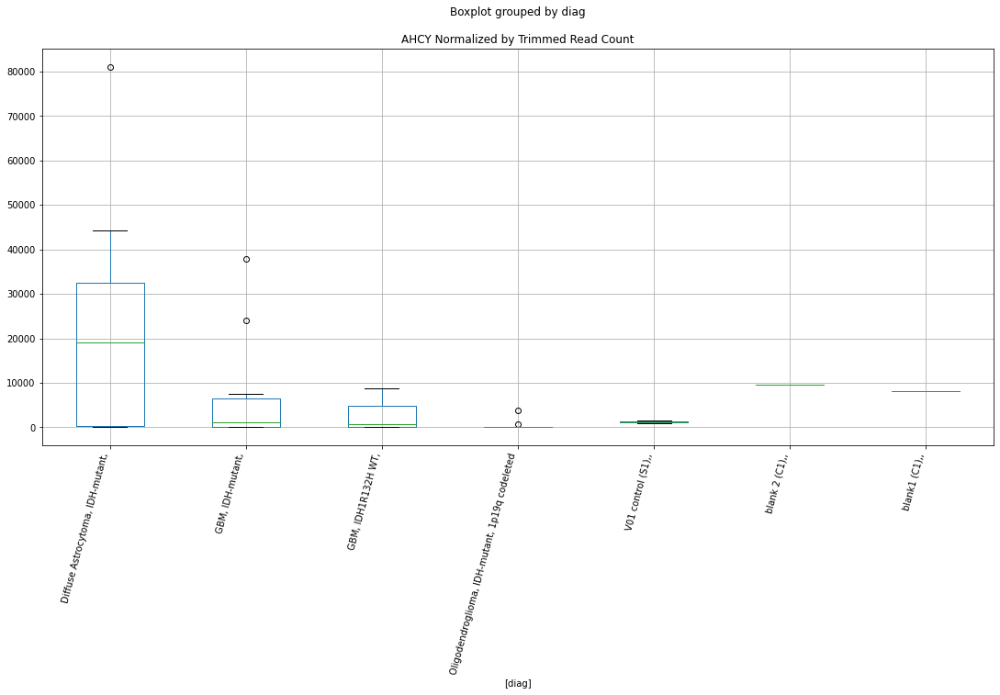

 p : 0.015397087759082372  ( t : 2.676607054115667 ) :  Lexogen  :  cutadapt2  :  CACNA1H
Control and blanks
82          0.00
346    203490.18
Name: CACNA1H, dtype: float64
214    0.0
Name: CACNA1H, dtype: float64
478    0.0
Name: CACNA1H, dtype: float64


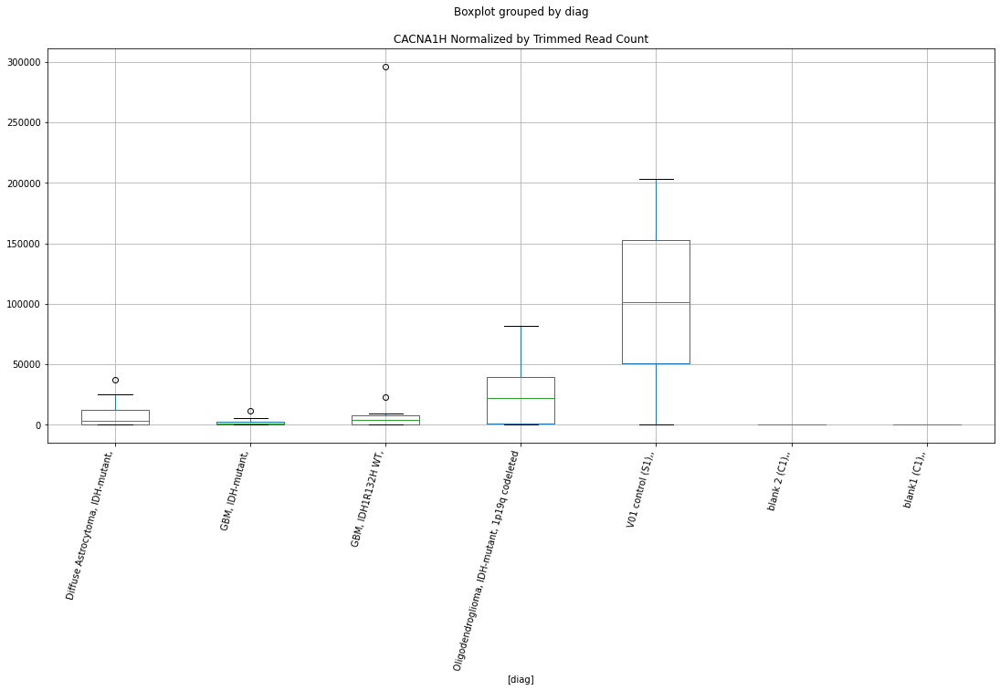

 p : 0.015560757879149898  ( t : 2.671615664182423 ) :  Lexogen  :  cutadapt2  :  CRHBP
Control and blanks
82     0.0
346    0.0
Name: CRHBP, dtype: float64
214    0.0
Name: CRHBP, dtype: float64
478    0.0
Name: CRHBP, dtype: float64


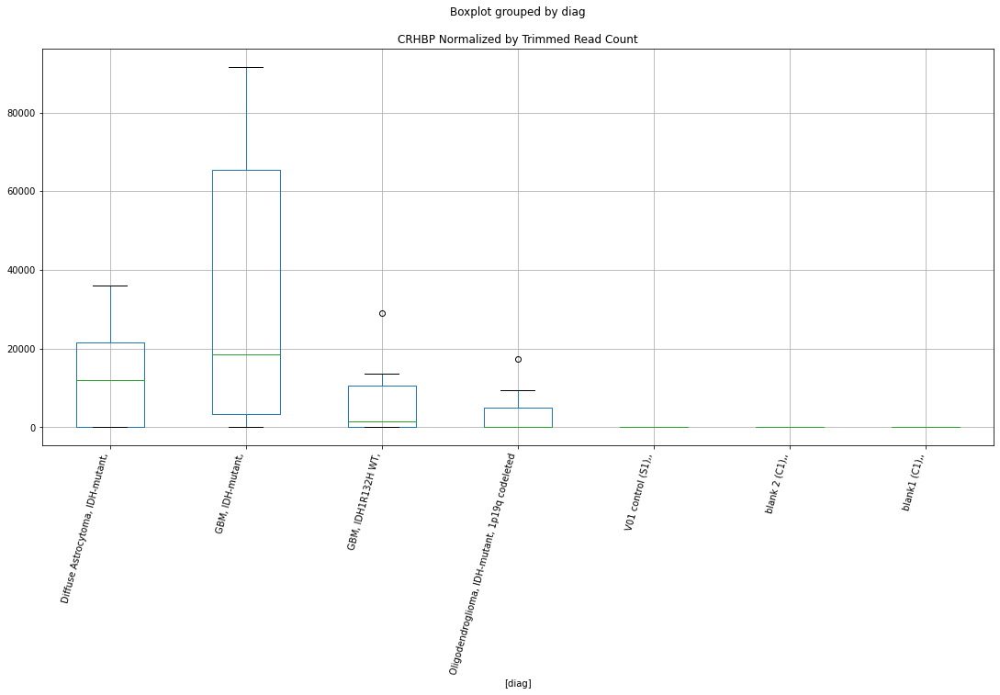

 p : 0.01561599556540151  ( t : 2.6699423931085704 ) :  D-plex  :  cutadapt2  :  DCUN1D5
Control and blanks
76     3030.46
340       0.00
Name: DCUN1D5, dtype: float64
208    3174.48
Name: DCUN1D5, dtype: float64
472    4623.65
Name: DCUN1D5, dtype: float64


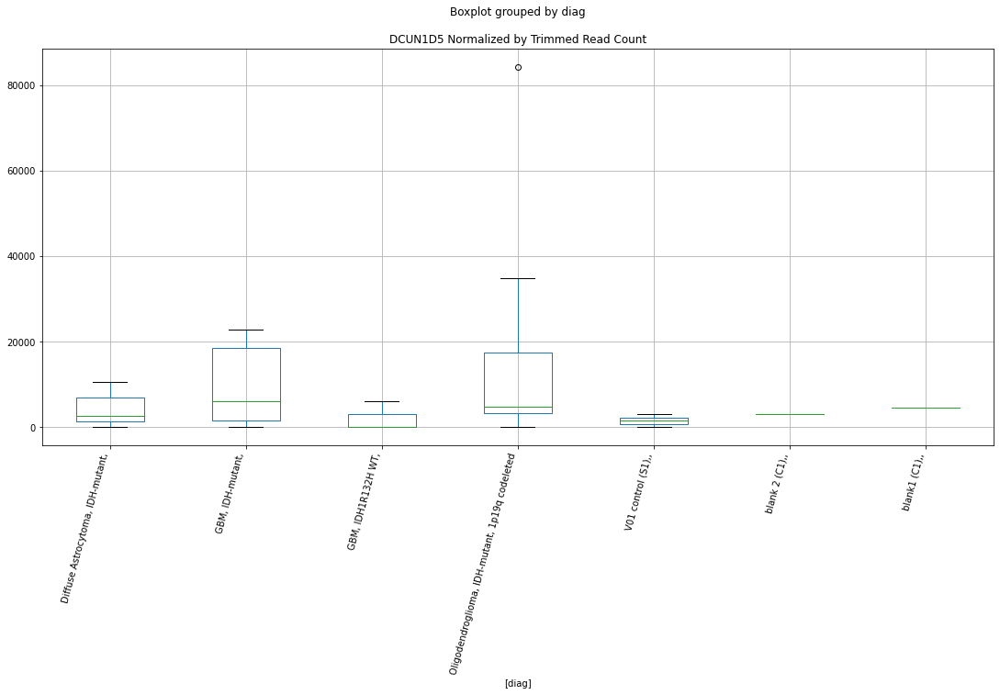

 p : 0.015639013235572565  ( t : 2.6692468022544 ) :  D-plex  :  bbduk2  :  AACSP1
Control and blanks
73     3092.03
337       0.00
Name: AACSP1, dtype: float64
205    358.18
Name: AACSP1, dtype: float64
469    591.53
Name: AACSP1, dtype: float64


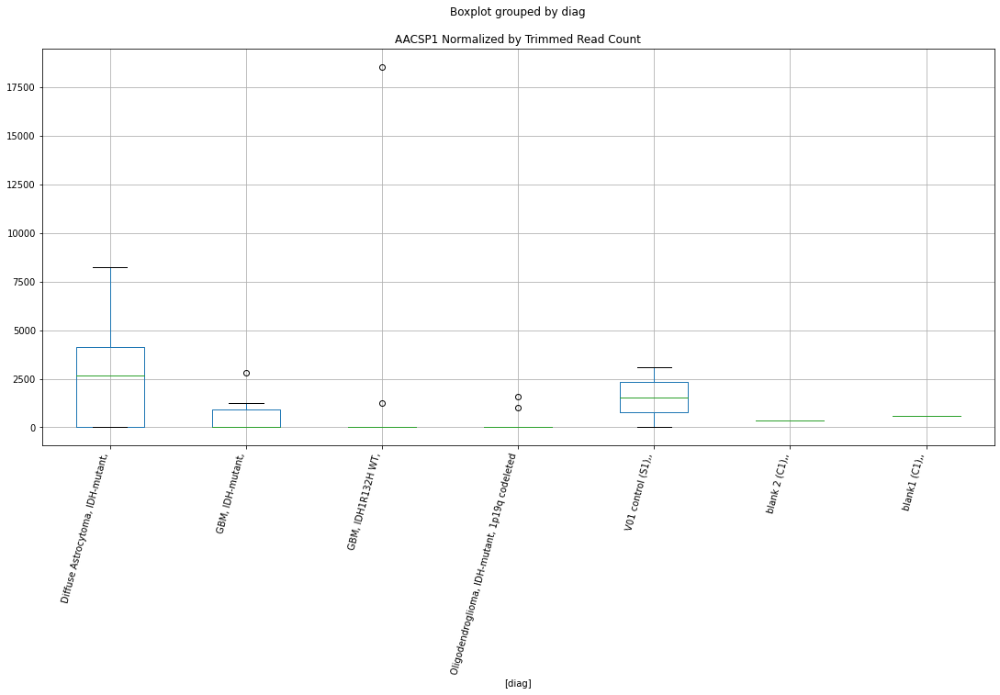

 p : 0.015672172111422824  ( t : 2.6682464593192092 ) :  Lexogen  :  cutadapt2  :  CD82
Control and blanks
82     0.0
346    0.0
Name: CD82, dtype: float64
214    0.0
Name: CD82, dtype: float64
478    0.0
Name: CD82, dtype: float64


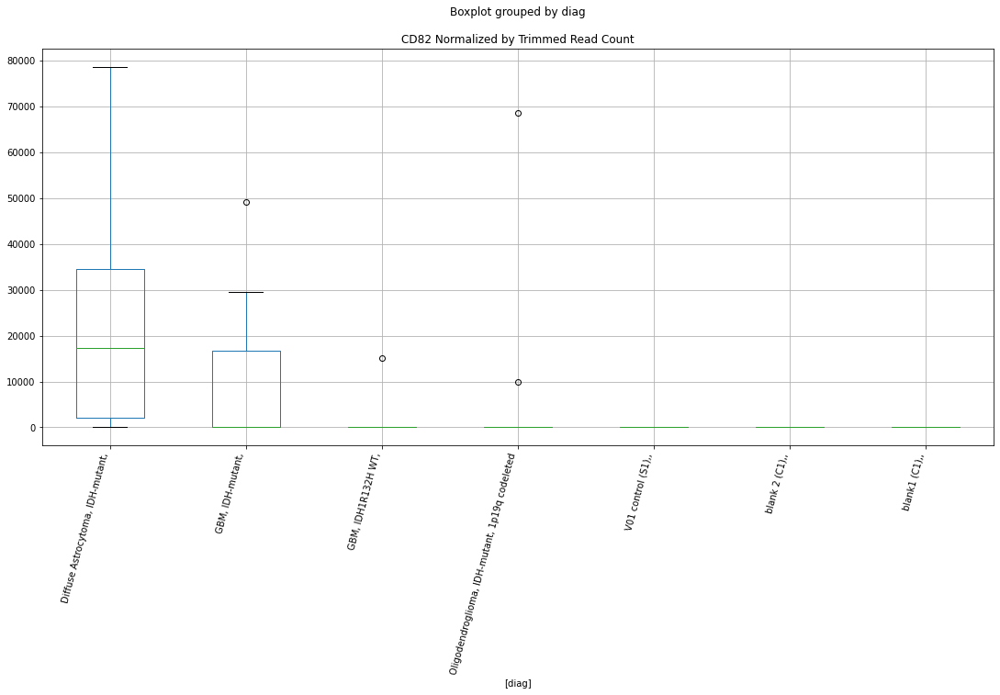

 p : 0.015679728489336617  ( t : 2.668018779442944 ) :  Lexogen  :  bbduk2  :  CMC1
Control and blanks
79       0.00
343    849.26
Name: CMC1, dtype: float64
211    0.0
Name: CMC1, dtype: float64
475    958.06
Name: CMC1, dtype: float64


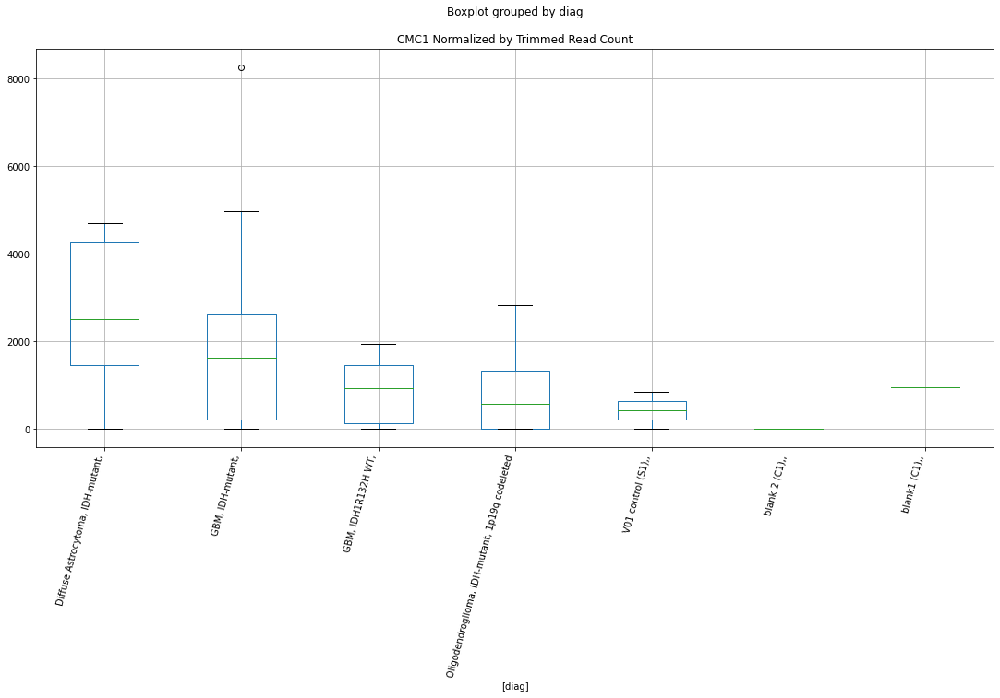

 p : 0.015778422557611714  ( t : 2.66505461143556 ) :  D-plex  :  bbduk2  :  DIS3L2
Control and blanks
73          0.00
337    115720.44
Name: DIS3L2, dtype: float64
205    1970.0
Name: DIS3L2, dtype: float64
469    2957.64
Name: DIS3L2, dtype: float64


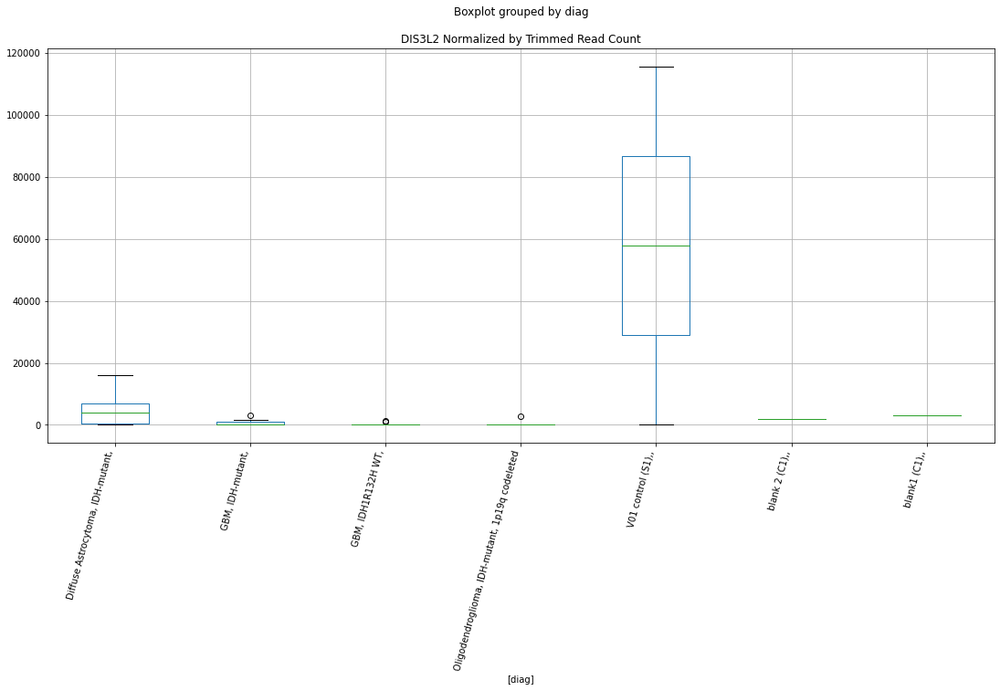

 p : 0.01588837224331566  ( t : 2.6617731302274144 ) :  D-plex  :  bbduk2  :  ARL17B
Control and blanks
73     0.0
337    0.0
Name: ARL17B, dtype: float64
205    358.18
Name: ARL17B, dtype: float64
469    591.53
Name: ARL17B, dtype: float64


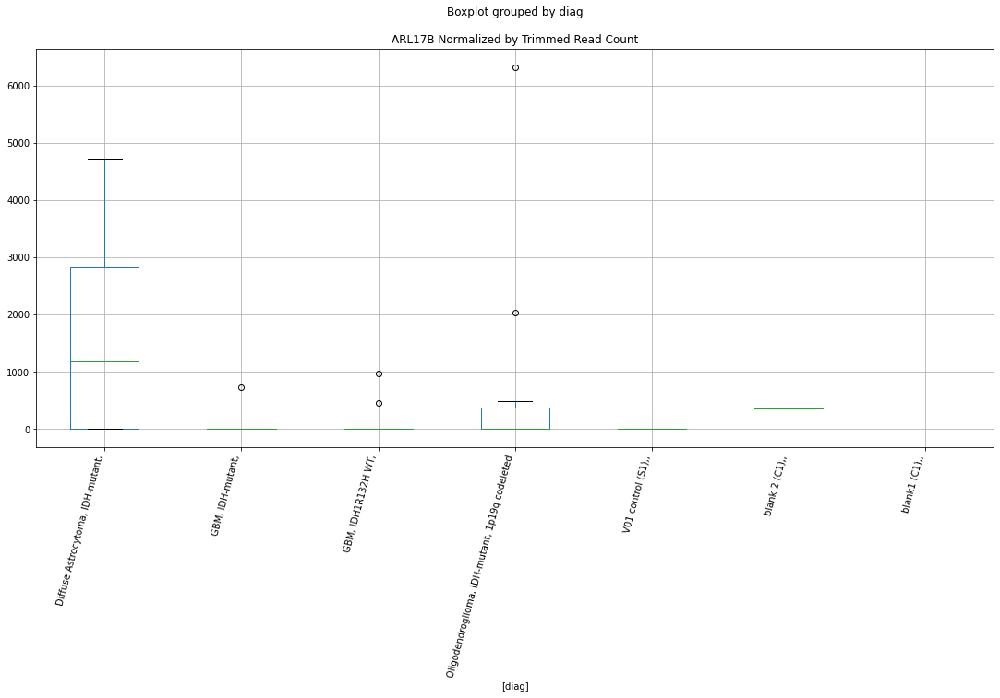

 p : 0.015965516671794782  ( t : 2.6594836238524455 ) :  D-plex  :  cutadapt2  :  C1orf198
Control and blanks
76     3030.46
340    3522.93
Name: C1orf198, dtype: float64
208    14814.26
Name: C1orf198, dtype: float64
472    18494.59
Name: C1orf198, dtype: float64


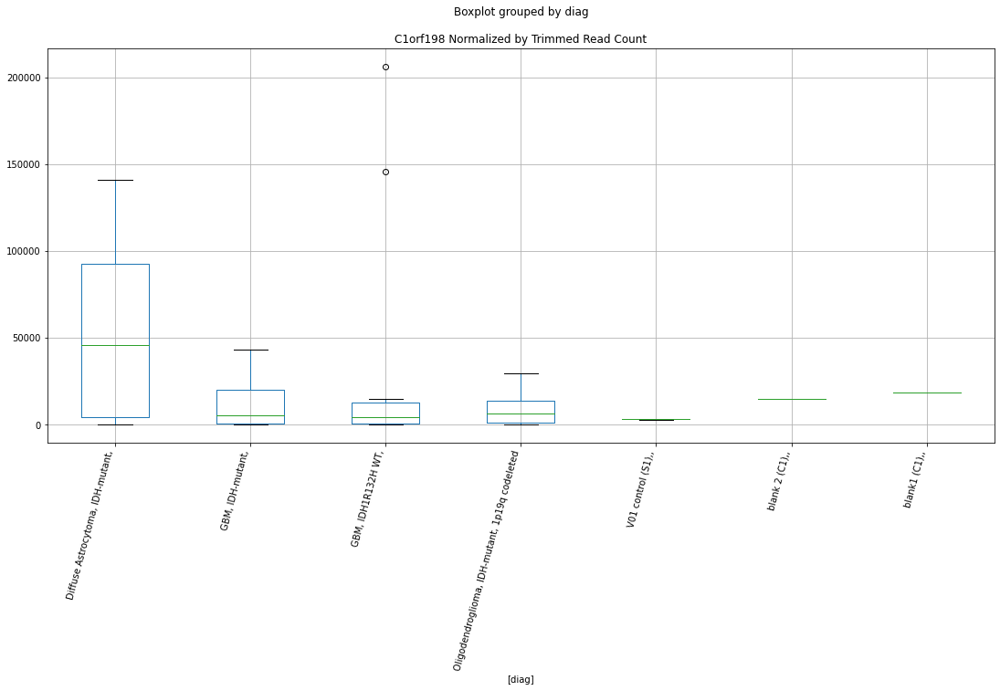

 p : 0.015996554584702862  ( t : 2.6585654471698636 ) :  Lexogen  :  bbduk2  :  CRHBP
Control and blanks
79     2861.2
343       0.0
Name: CRHBP, dtype: float64
211    546.61
Name: CRHBP, dtype: float64
475    2395.16
Name: CRHBP, dtype: float64


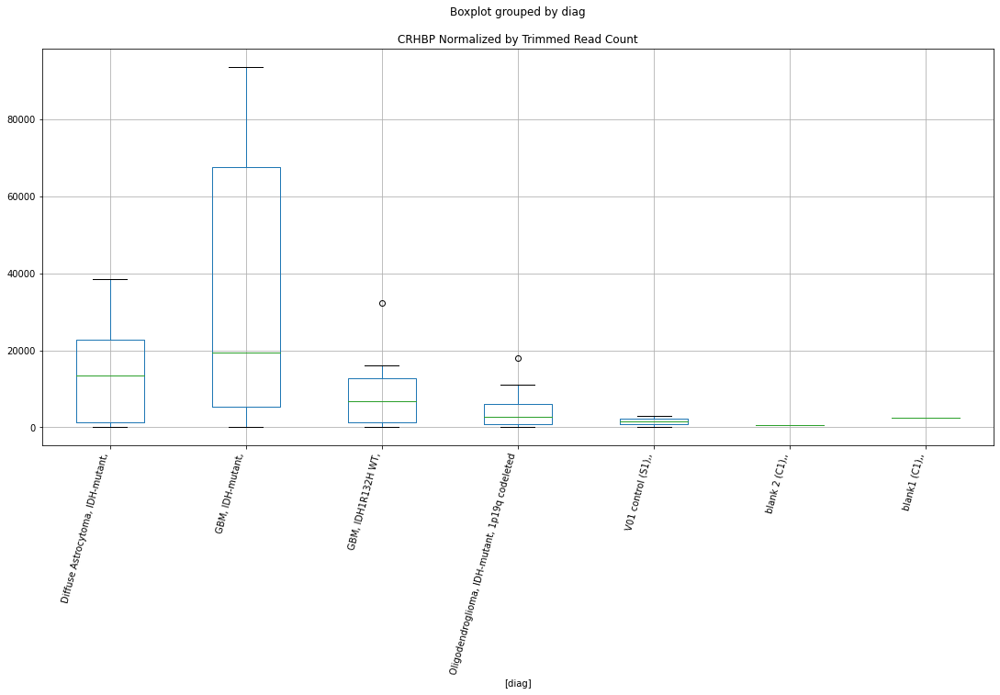

 p : 0.016061189965933014  ( t : 2.6566588106606313 ) :  Lexogen  :  cutadapt2  :  C4orf50
Control and blanks
82        0.00
346    6523.47
Name: C4orf50, dtype: float64
214    40141.52
Name: C4orf50, dtype: float64
478    41080.66
Name: C4orf50, dtype: float64


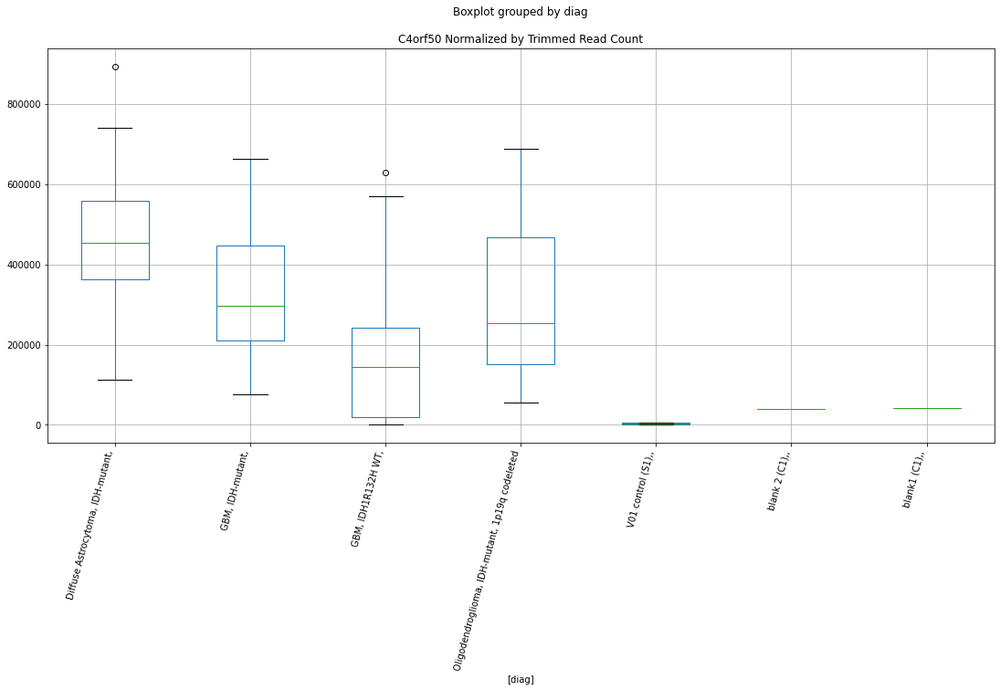

 p : 0.016084934017971154  ( t : 2.655960235714648 ) :  D-plex  :  bbduk2  :  C16orf54
Control and blanks
73        0.00
337    8011.42
Name: C16orf54, dtype: float64
205    537.27
Name: C16orf54, dtype: float64
469    2366.11
Name: C16orf54, dtype: float64


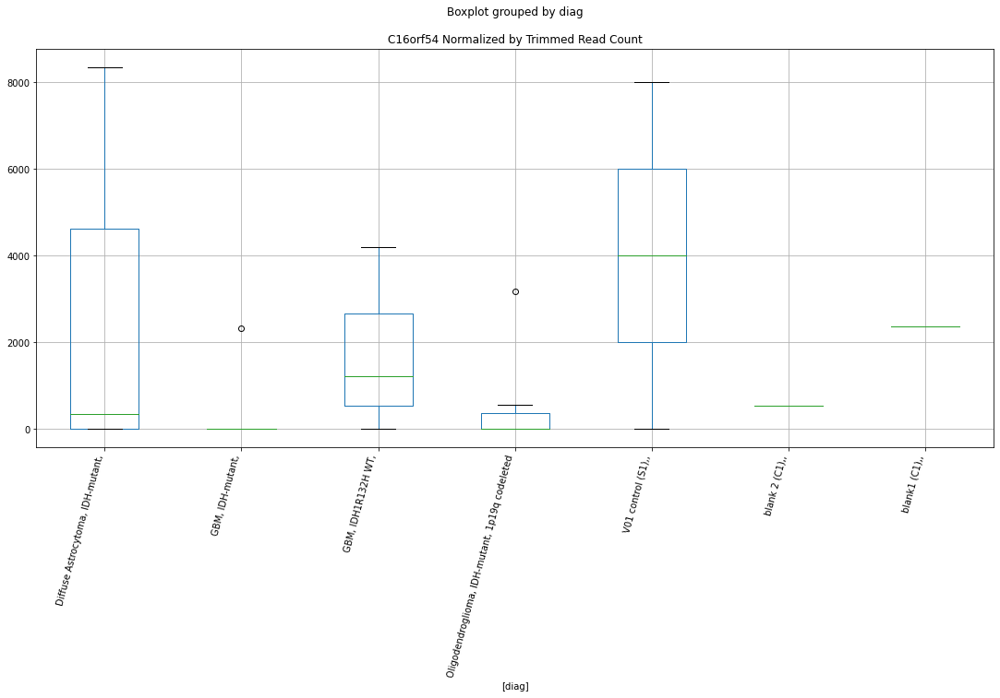

 p : 0.01608807937645787  ( t : 2.655867769651785 ) :  Lexogen  :  bbduk2  :  C19orf57
Control and blanks
79     0.0
343    0.0
Name: C19orf57, dtype: float64
211    0.0
Name: C19orf57, dtype: float64
475    0.0
Name: C19orf57, dtype: float64


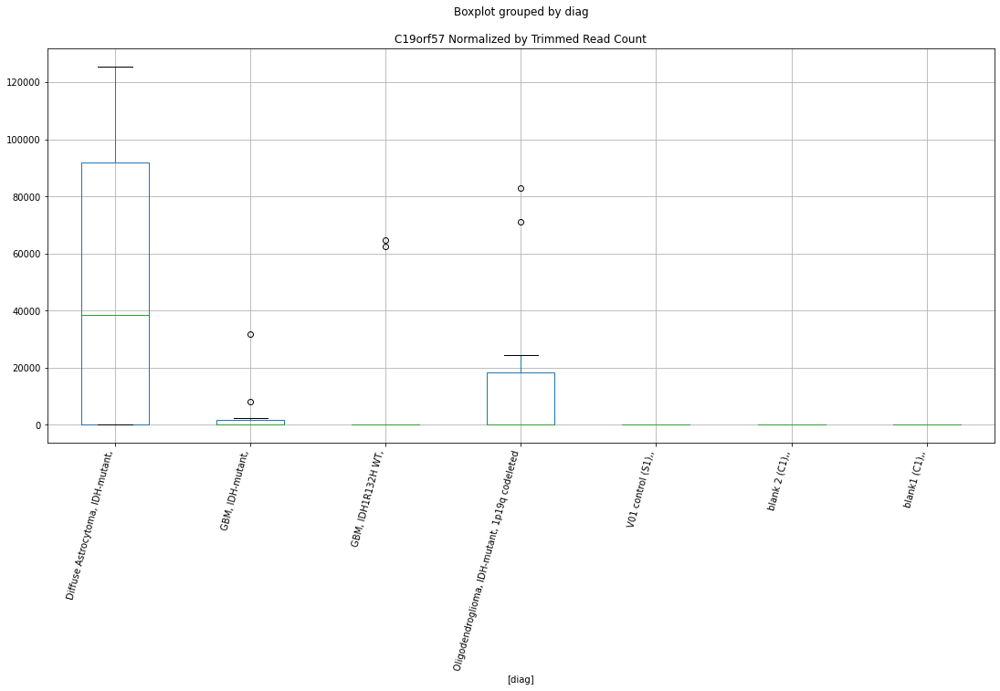

 p : 0.016158615462308446  ( t : 2.65379868635068 ) :  D-plex  :  cutadapt2  :  ANO6
Control and blanks
76     0.0
340    0.0
Name: ANO6, dtype: float64
208    94352.72
Name: ANO6, dtype: float64
472    0.0
Name: ANO6, dtype: float64


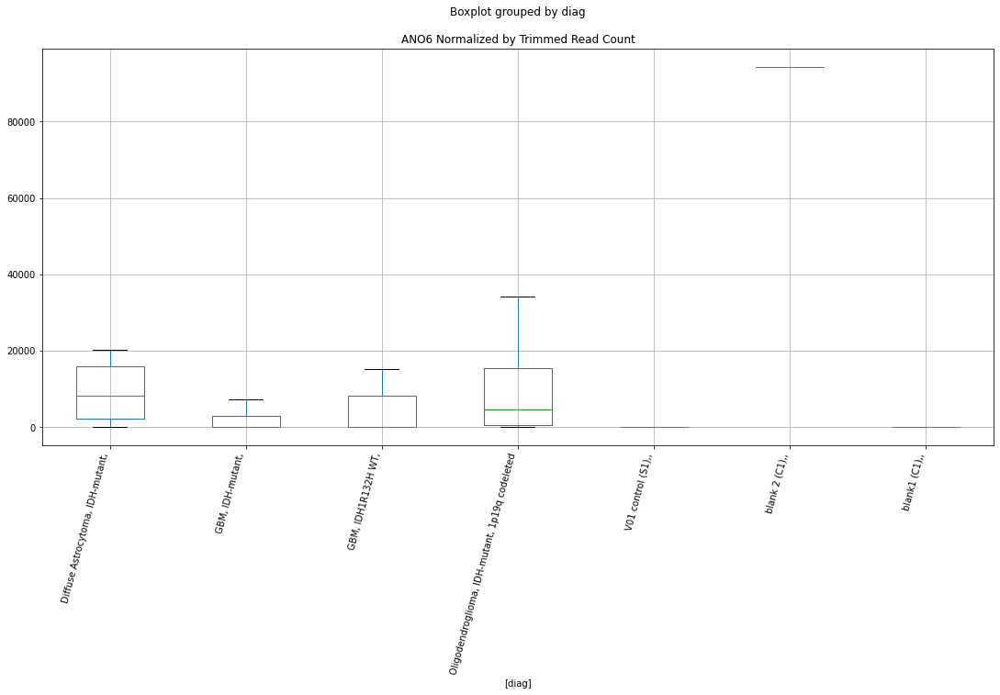

 p : 0.016286369256757464  ( t : 2.650072999141366 ) :  D-plex  :  bbduk2  :  C1orf198
Control and blanks
73     3092.03
337    3560.63
Name: C1orf198, dtype: float64
205    15043.64
Name: C1orf198, dtype: float64
469    18928.87
Name: C1orf198, dtype: float64


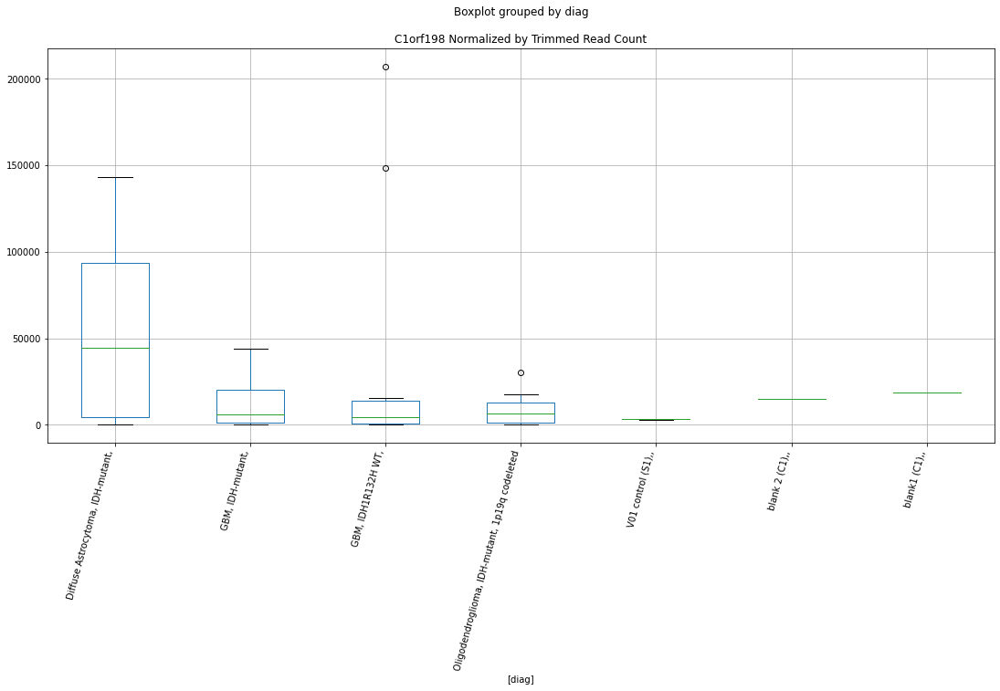

 p : 0.01653347814777319  ( t : 2.6429448529036628 ) :  D-plex  :  bbduk2  :  CDC25B
Control and blanks
73        0.00
337    3560.63
Name: CDC25B, dtype: float64
205    31878.19
Name: CDC25B, dtype: float64
469    2366.11
Name: CDC25B, dtype: float64


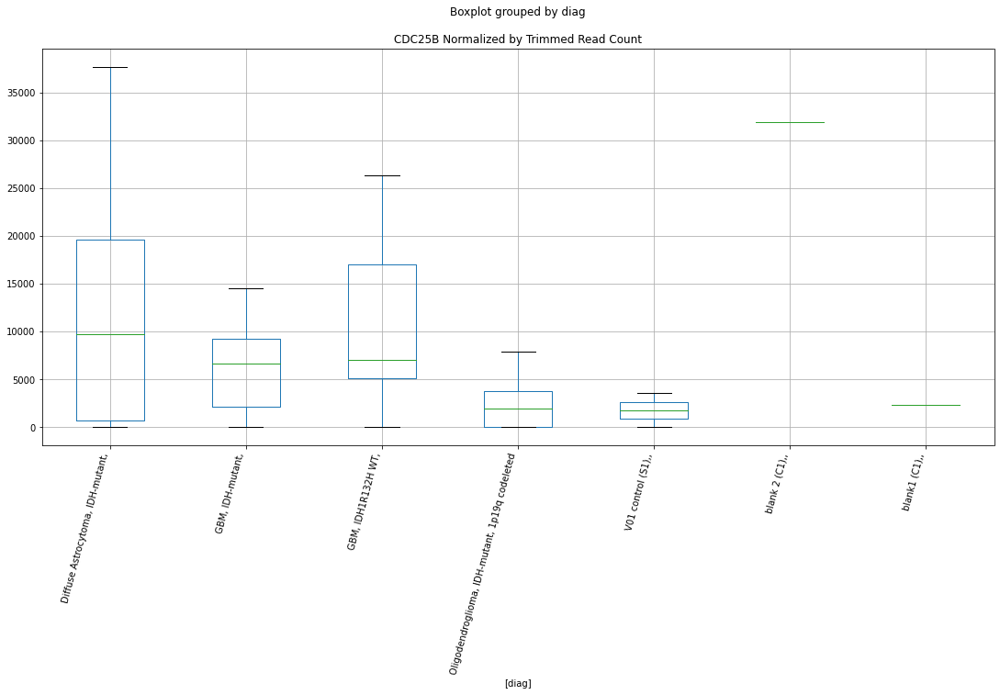

 p : 0.01674236923669544  ( t : 2.6369977904037336 ) :  Lexogen  :  bbduk2  :  C4orf50
Control and blanks
79        0.00
343    4883.23
Name: C4orf50, dtype: float64
211    41542.56
Name: C4orf50, dtype: float64
475    40238.64
Name: C4orf50, dtype: float64


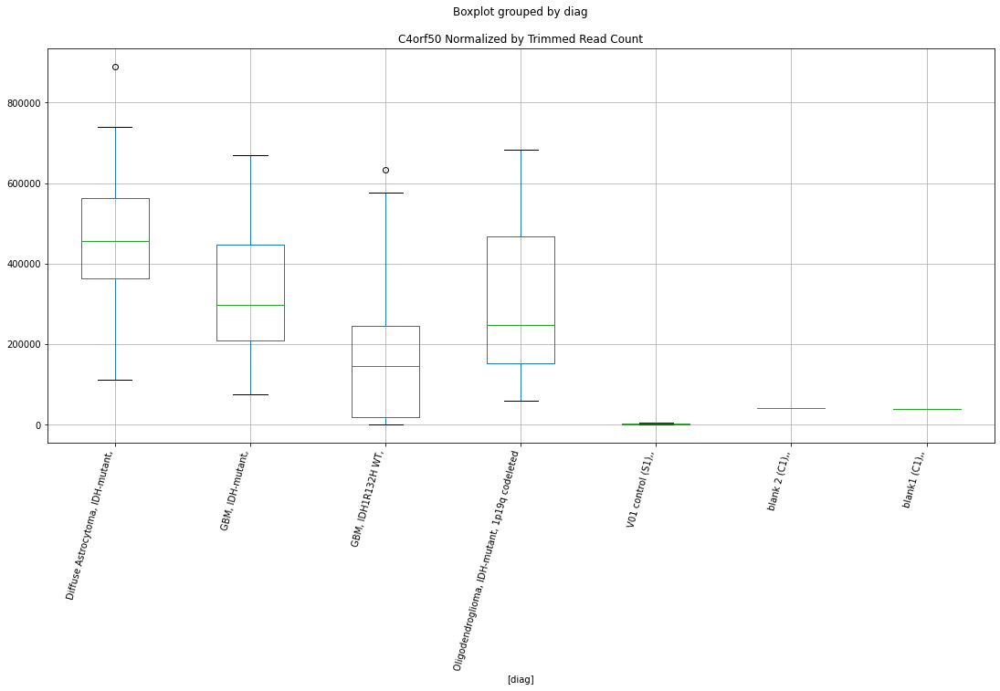

 p : 0.016779317023149276  ( t : 2.635953252083754 ) :  Lexogen  :  cutadapt2  :  AAMP
Control and blanks
82       0.0
346    631.3
Name: AAMP, dtype: float64
214    0.0
Name: AAMP, dtype: float64
478    0.0
Name: AAMP, dtype: float64


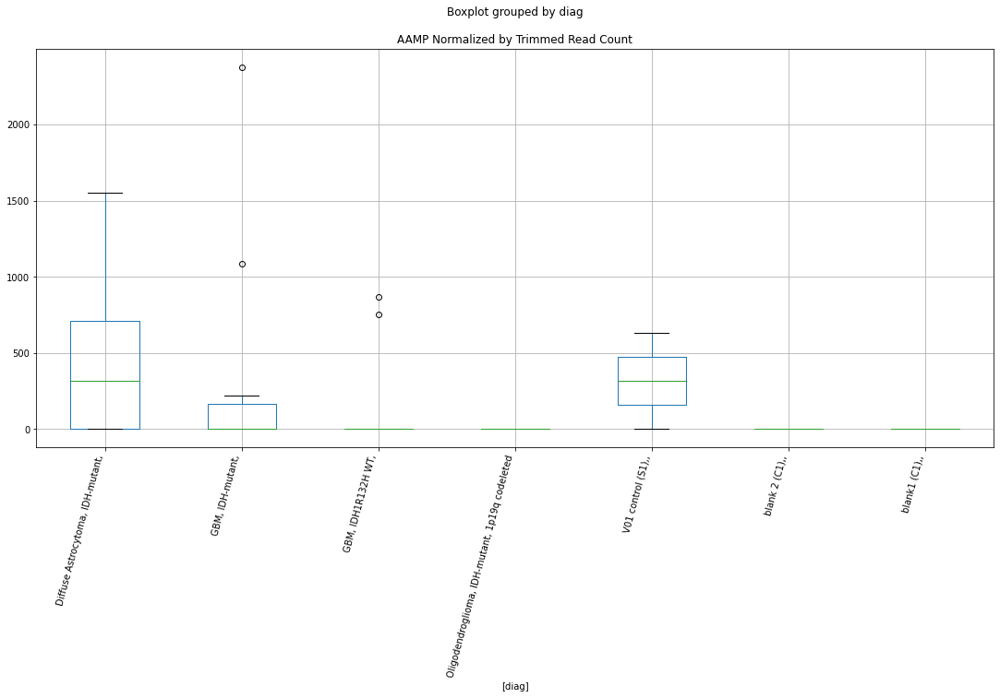

 p : 0.016808211923799558  ( t : 2.6351378976888693 ) :  Lexogen  :  cutadapt2  :  ARHGAP45
Control and blanks
82     0.0
346    0.0
Name: ARHGAP45, dtype: float64
214    0.0
Name: ARHGAP45, dtype: float64
478    0.0
Name: ARHGAP45, dtype: float64


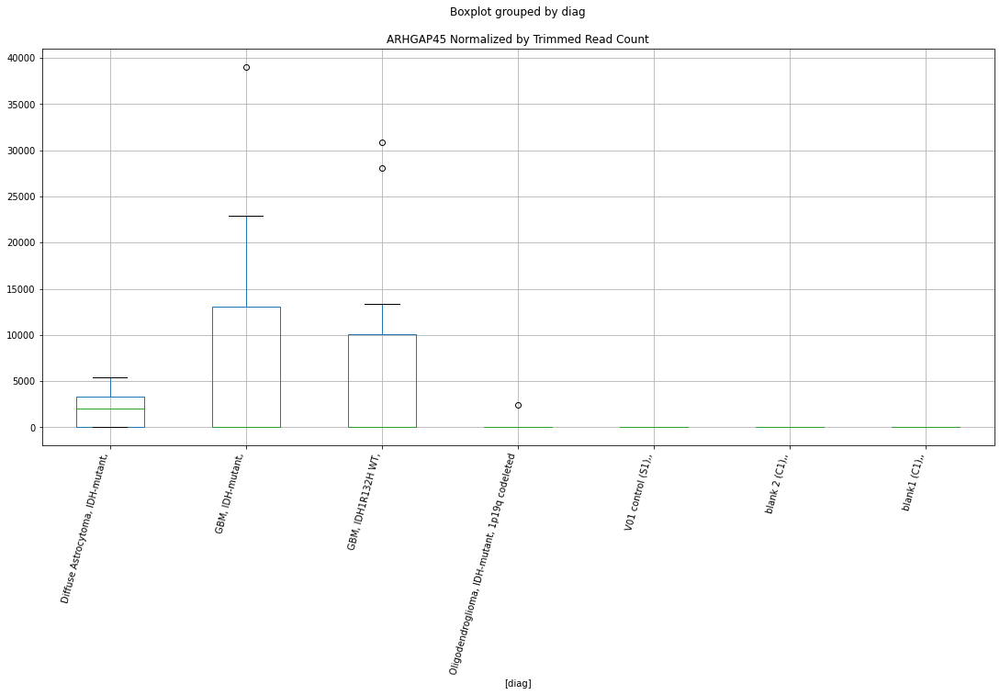

 p : 0.016901730773906578  ( t : 2.632508099235686 ) :  D-plex  :  bbduk2  :  AP4E1
Control and blanks
73     6184.07
337       0.00
Name: AP4E1, dtype: float64
205    1074.55
Name: AP4E1, dtype: float64
469    4732.22
Name: AP4E1, dtype: float64


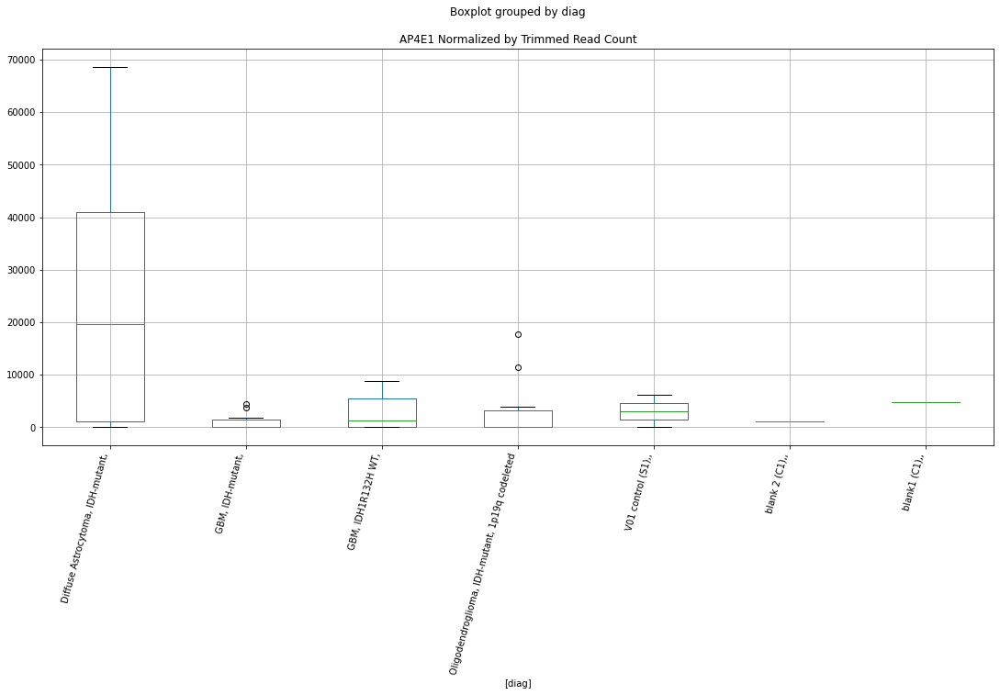

 p : 0.01730424486927109  ( t : 2.6213448766138607 ) :  D-plex  :  bbduk2  :  ATP6V0A2
Control and blanks
73     0.0
337    0.0
Name: ATP6V0A2, dtype: float64
205    1432.73
Name: ATP6V0A2, dtype: float64
469    1183.05
Name: ATP6V0A2, dtype: float64


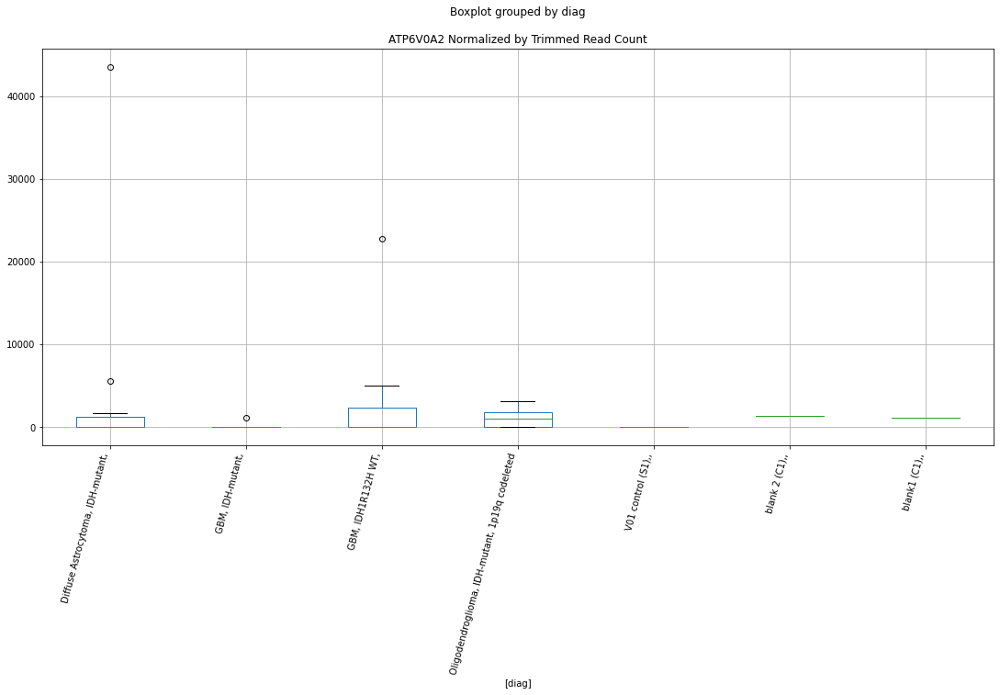

 p : 0.01770578806283633  ( t : 2.6104518113719255 ) :  Lexogen  :  bbduk2  :  ACSS3
Control and blanks
79         0.00
343    76220.84
Name: ACSS3, dtype: float64
211    1639.84
Name: ACSS3, dtype: float64
475    1916.13
Name: ACSS3, dtype: float64


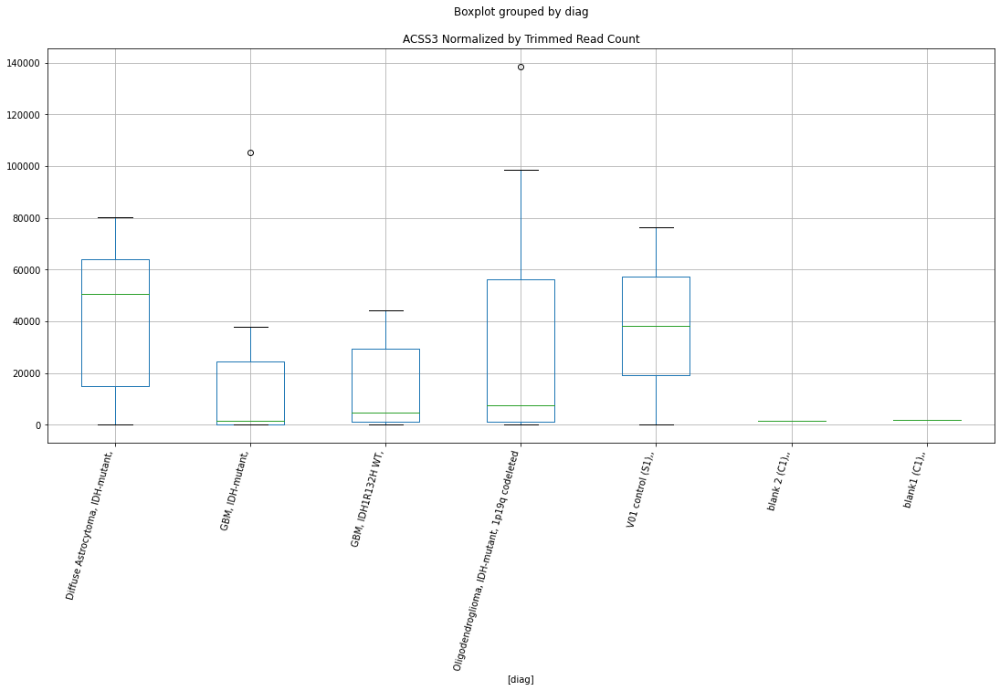

 p : 0.01773882986191359  ( t : 2.6095659317372393 ) :  Lexogen  :  bbduk2  :  CAMSAP3
Control and blanks
79         0.00
343    92993.67
Name: CAMSAP3, dtype: float64
211    11478.87
Name: CAMSAP3, dtype: float64
475    0.0
Name: CAMSAP3, dtype: float64


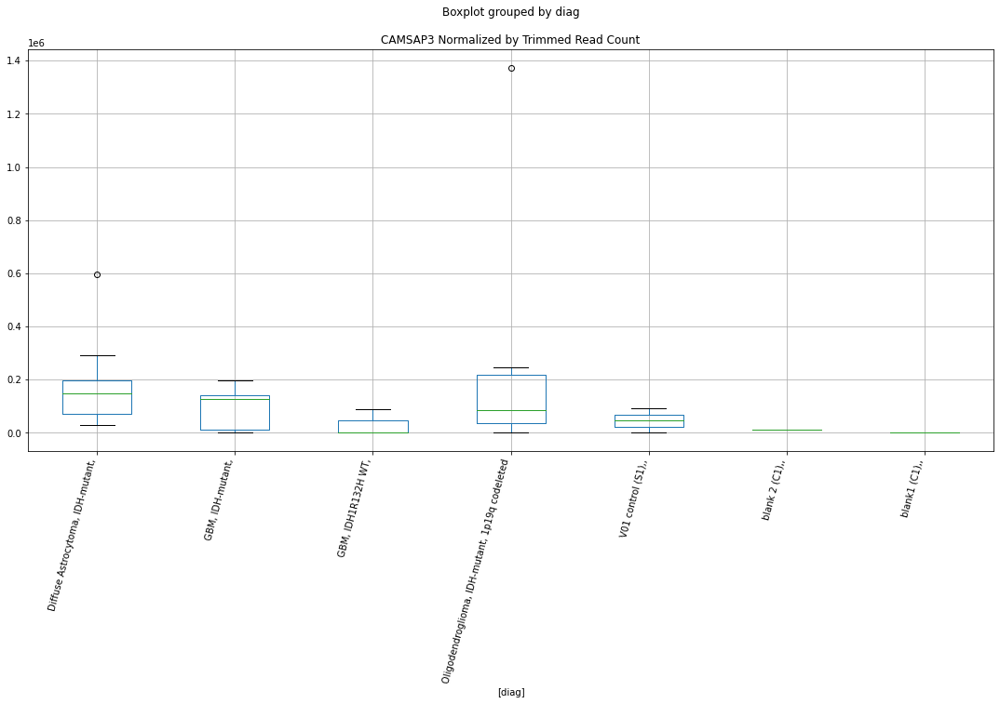

 p : 0.017861157761473977  ( t : 2.6062997957375833 ) :  D-plex  :  cutadapt2  :  DIS3L2
Control and blanks
76          0.00
340    114495.18
Name: DIS3L2, dtype: float64
208    1939.96
Name: DIS3L2, dtype: float64
472    4623.65
Name: DIS3L2, dtype: float64


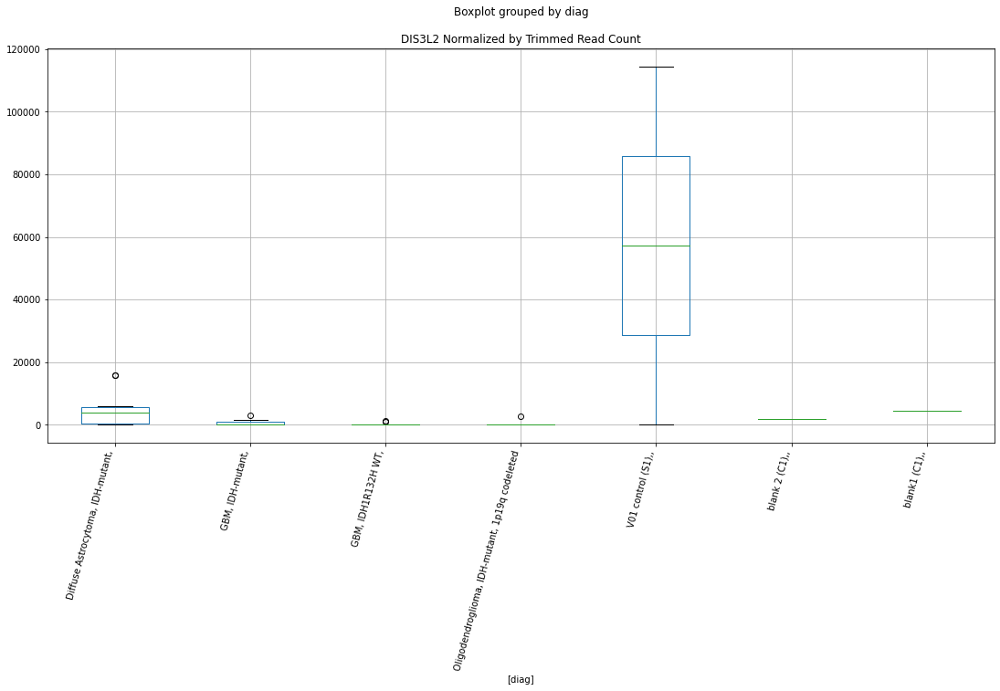

 p : 0.018049673061979805  ( t : 2.601307813936388 ) :  D-plex  :  cutadapt2  :  ARHGAP26
Control and blanks
76     0.0
340    0.0
Name: ARHGAP26, dtype: float64
208    22750.47
Name: ARHGAP26, dtype: float64
472    0.0
Name: ARHGAP26, dtype: float64


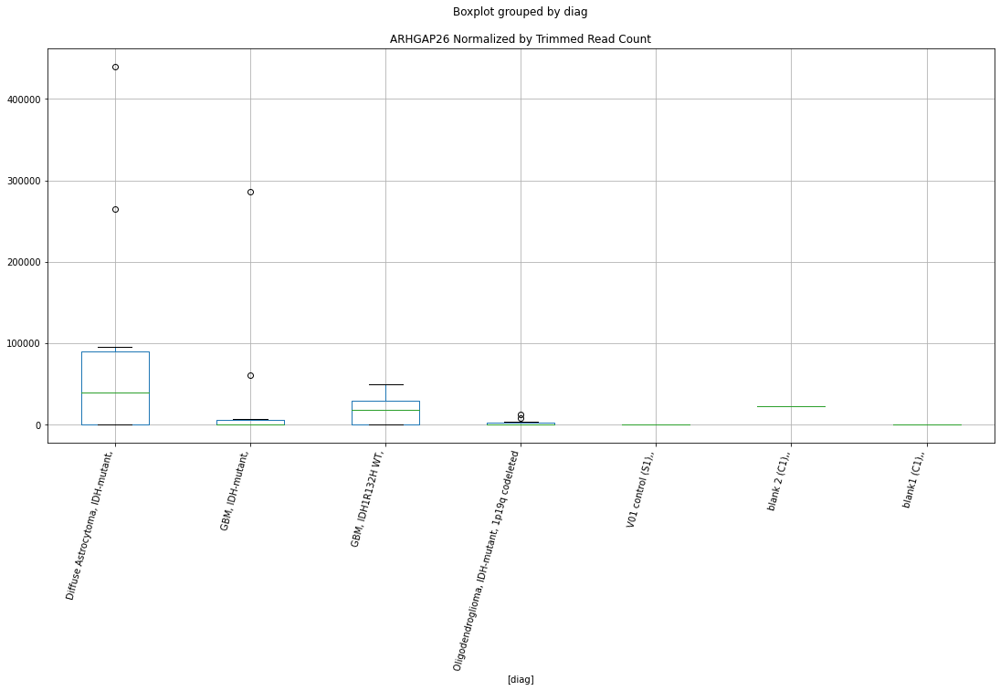

 p : 0.0180951642677887  ( t : 2.600110596847356 ) :  D-plex  :  cutadapt2  :  ANKRD45
Control and blanks
76     0.0
340    0.0
Name: ANKRD45, dtype: float64
208    1234.52
Name: ANKRD45, dtype: float64
472    2889.78
Name: ANKRD45, dtype: float64


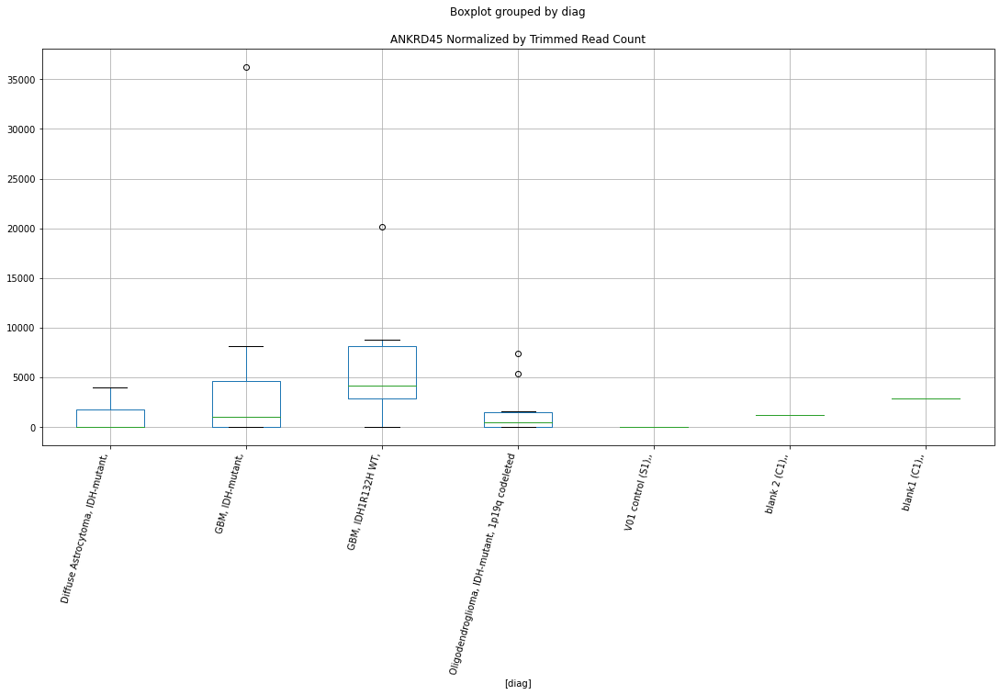

 p : 0.018222768818792225  ( t : 2.5967675374707304 ) :  D-plex  :  cutadapt2  :  BAHCC1
Control and blanks
76     0.0
340    0.0
Name: BAHCC1, dtype: float64
208    3174.48
Name: BAHCC1, dtype: float64
472    0.0
Name: BAHCC1, dtype: float64


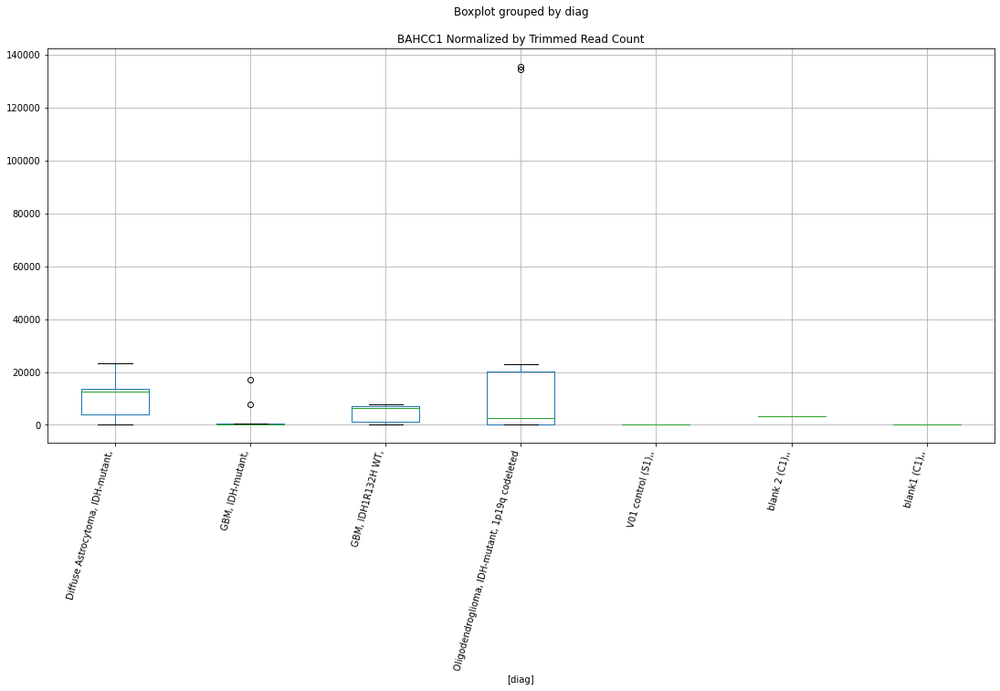

 p : 0.01832252261558145  ( t : 2.594169561576974 ) :  Lexogen  :  cutadapt2  :  CAMSAP3
Control and blanks
82         0.00
346    93432.93
Name: CAMSAP3, dtype: float64
214    11391.51
Name: CAMSAP3, dtype: float64
478    0.0
Name: CAMSAP3, dtype: float64


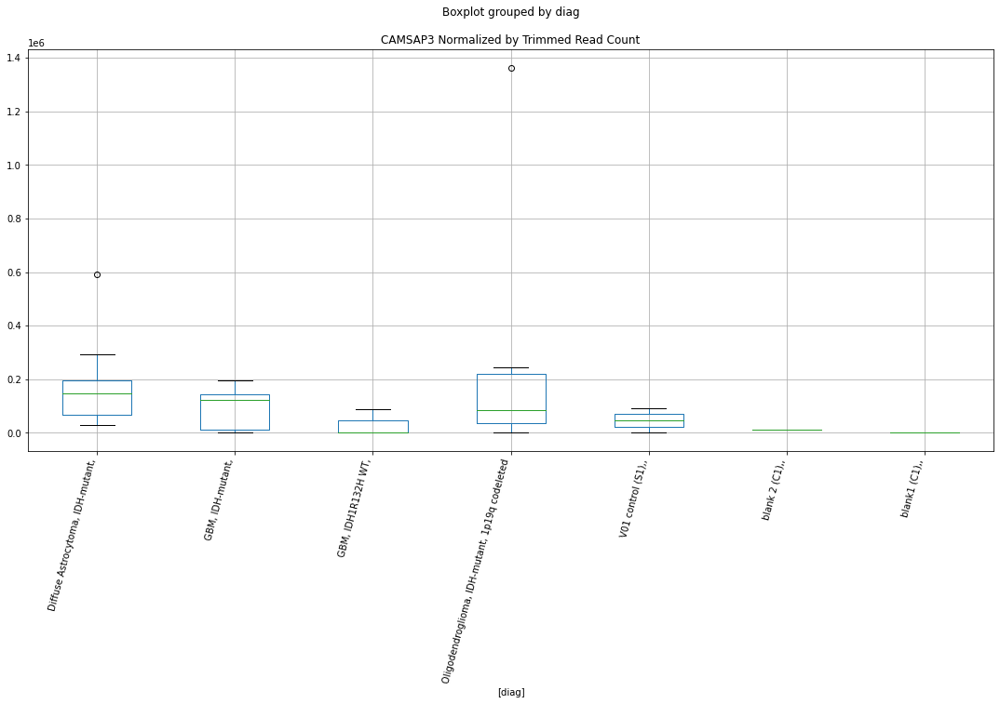

 p : 0.018362585724574765  ( t : 2.593129937707343 ) :  D-plex  :  bbduk2  :  ADAM8
Control and blanks
73     0.0
337    0.0
Name: ADAM8, dtype: float64
205    1611.82
Name: ADAM8, dtype: float64
469    13013.6
Name: ADAM8, dtype: float64


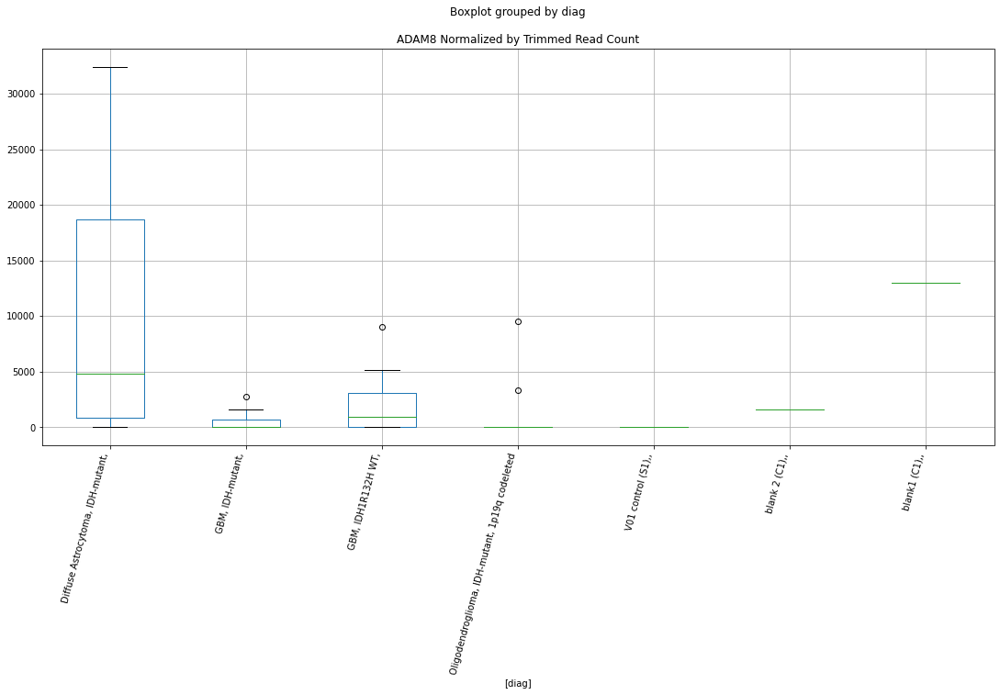

 p : 0.018446014164350273  ( t : 2.5909718859881625 ) :  Lexogen  :  bbduk2  :  CRY2
Control and blanks
79     0.0
343    0.0
Name: CRY2, dtype: float64
211    0.0
Name: CRY2, dtype: float64
475    0.0
Name: CRY2, dtype: float64


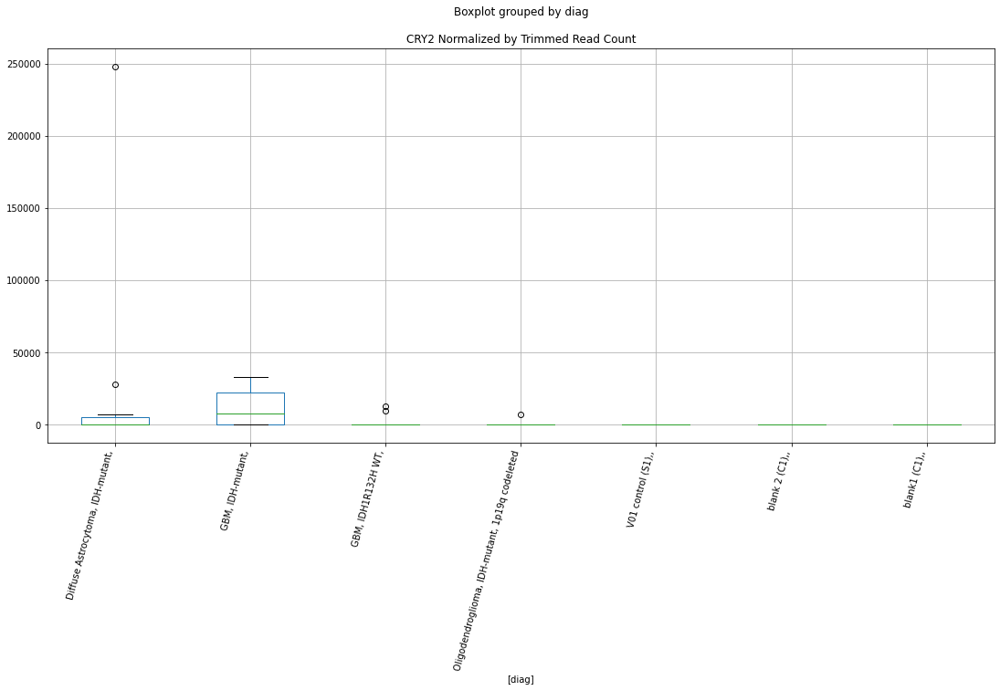

 p : 0.01846390570394633  ( t : 2.590510289494239 ) :  Lexogen  :  cutadapt2  :  CRY2
Control and blanks
82     0.0
346    0.0
Name: CRY2, dtype: float64
214    0.0
Name: CRY2, dtype: float64
478    0.0
Name: CRY2, dtype: float64


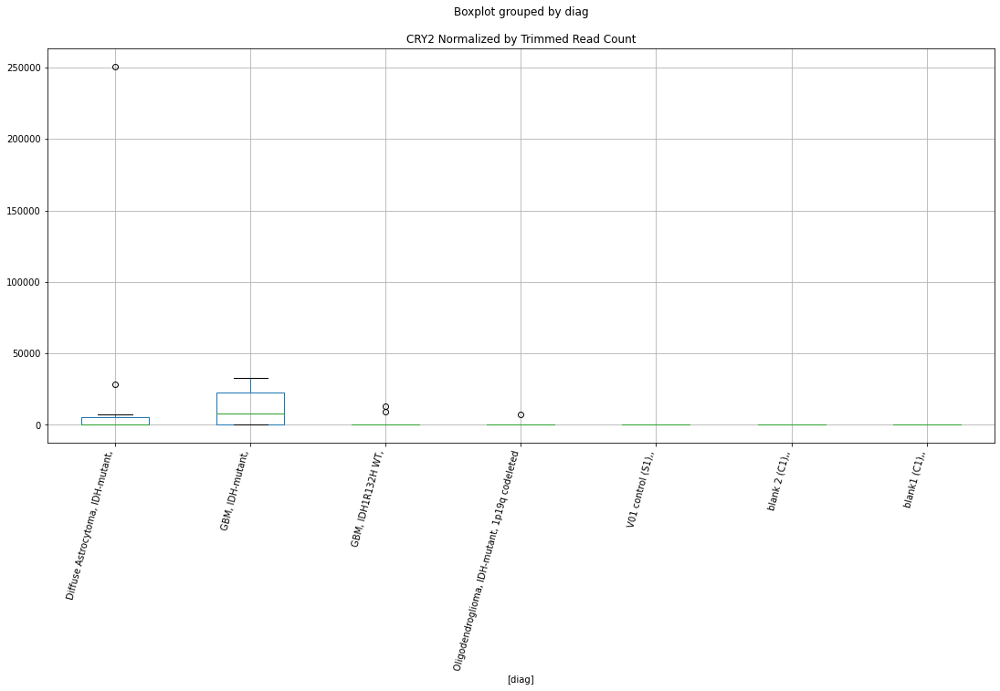

 p : 0.018567016156376768  ( t : 2.5878583080830317 ) :  D-plex  :  cutadapt2  :  COPS3
Control and blanks
76     0.0
340    0.0
Name: COPS3, dtype: float64
208    289936.2
Name: COPS3, dtype: float64
472    0.0
Name: COPS3, dtype: float64


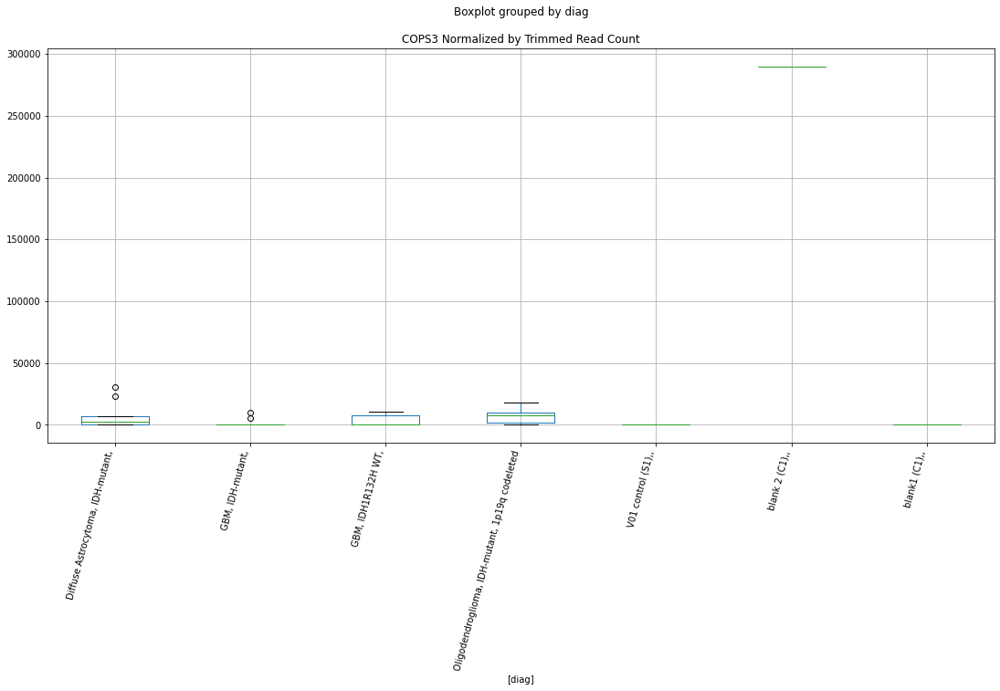

 p : 0.018579009375496554  ( t : 2.5875507519375844 ) :  D-plex  :  cutadapt2  :  ADAM8
Control and blanks
76     0.0
340    0.0
Name: ADAM8, dtype: float64
208    1587.24
Name: ADAM8, dtype: float64
472    12715.03
Name: ADAM8, dtype: float64


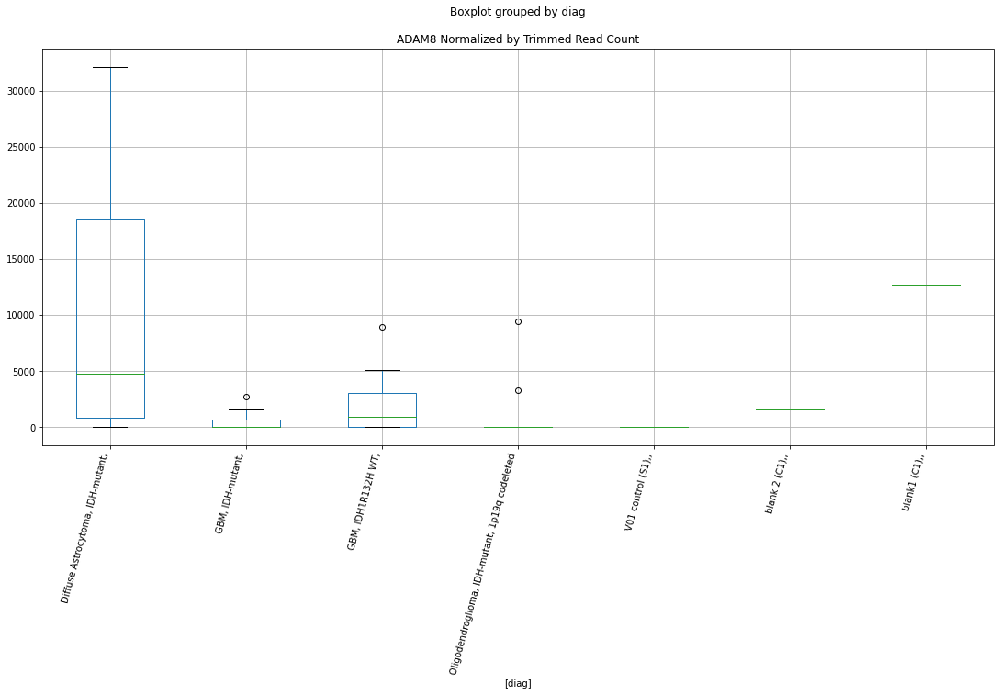

 p : 0.018611713855920357  ( t : 2.5867130283040343 ) :  D-plex  :  cutadapt2  :  COPS2
Control and blanks
76     0.0
340    0.0
Name: COPS2, dtype: float64
208    0.0
Name: COPS2, dtype: float64
472    1155.91
Name: COPS2, dtype: float64


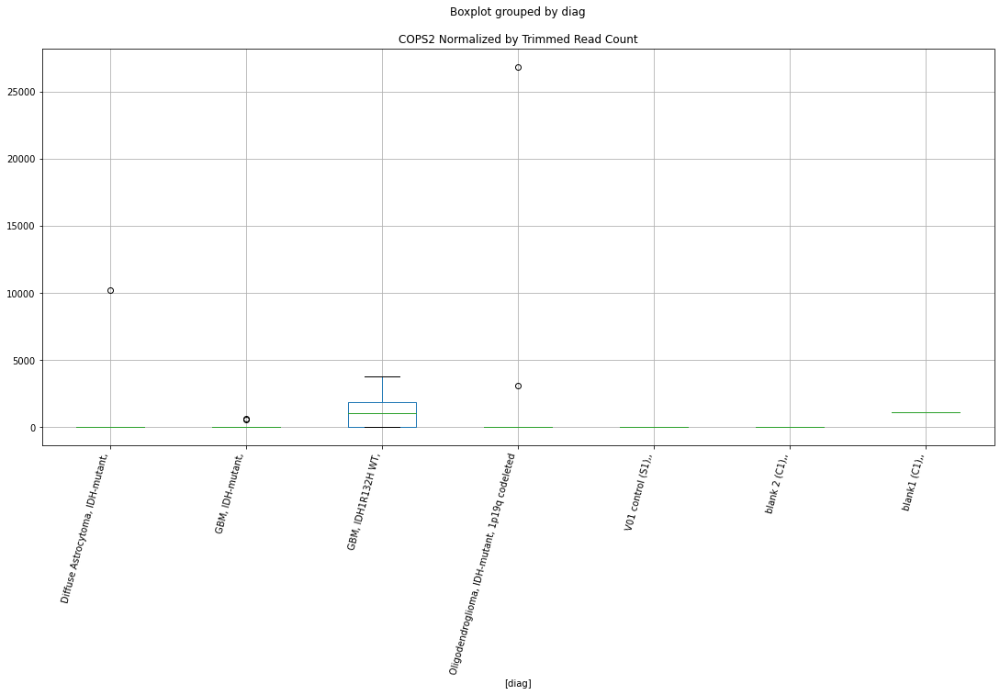

 p : 0.018635678779146347  ( t : 2.5861000536261813 ) :  D-plex  :  bbduk2  :  ANKRD45
Control and blanks
73     0.0
337    0.0
Name: ANKRD45, dtype: float64
205    1253.64
Name: ANKRD45, dtype: float64
469    2957.64
Name: ANKRD45, dtype: float64


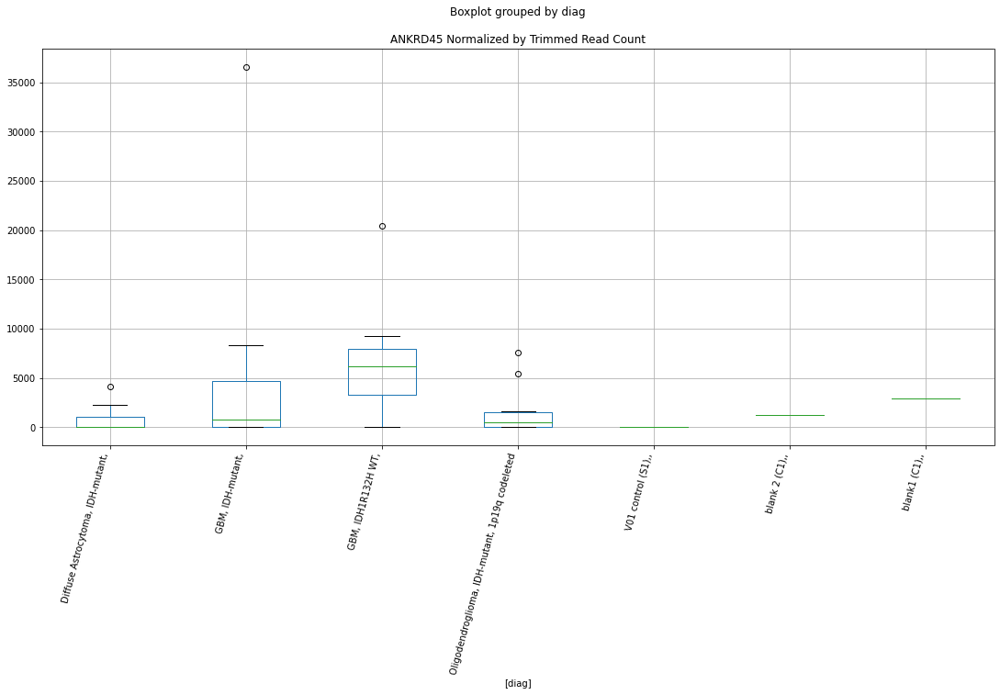

 p : 0.01890325559884154  ( t : 2.57930626879256 ) :  D-plex  :  bbduk2  :  BRIP1
Control and blanks
73     989450.75
337    142425.16
Name: BRIP1, dtype: float64
205    275620.98
Name: BRIP1, dtype: float64
469    350184.17
Name: BRIP1, dtype: float64


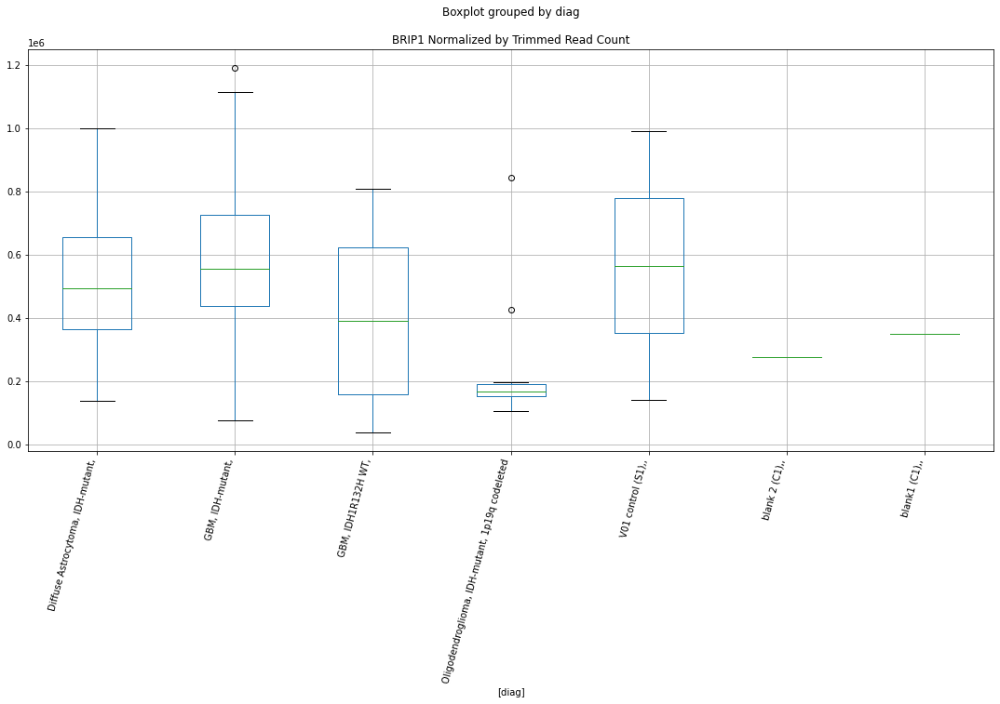

 p : 0.01900612192515994  ( t : 2.576718718642398 ) :  Lexogen  :  bbduk2  :  AP2A1
Control and blanks
79        0.00
343    3397.03
Name: AP2A1, dtype: float64
211    19678.06
Name: AP2A1, dtype: float64
475    0.0
Name: AP2A1, dtype: float64


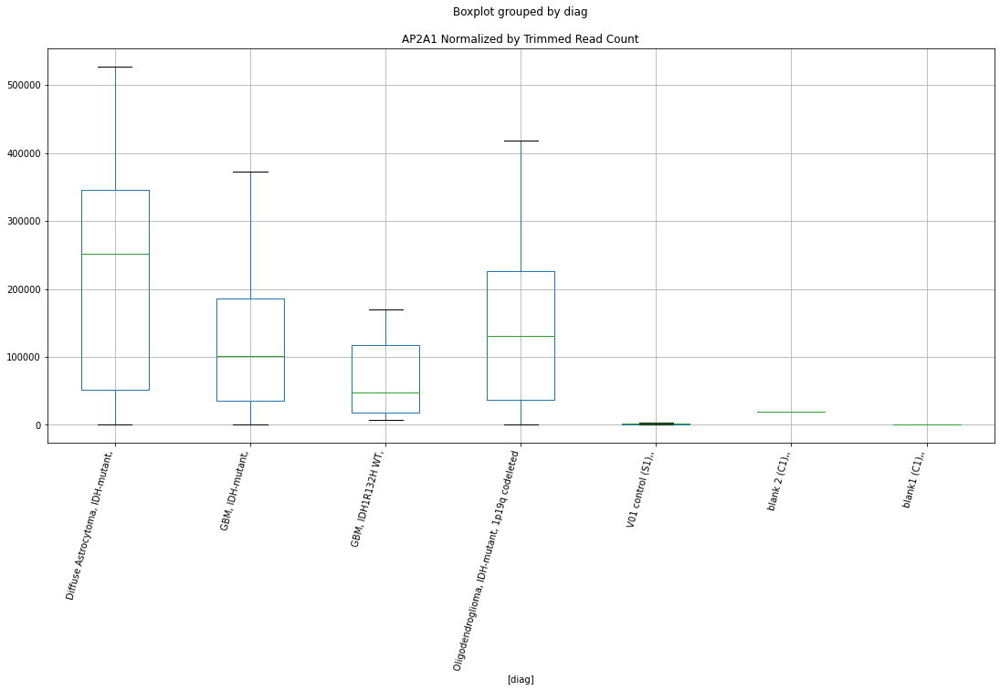

 p : 0.01906778873835538  ( t : 2.5751738759080802 ) :  Lexogen  :  cutadapt2  :  AP2A1
Control and blanks
82        0.00
346    3366.95
Name: AP2A1, dtype: float64
214    19528.3
Name: AP2A1, dtype: float64
478    0.0
Name: AP2A1, dtype: float64


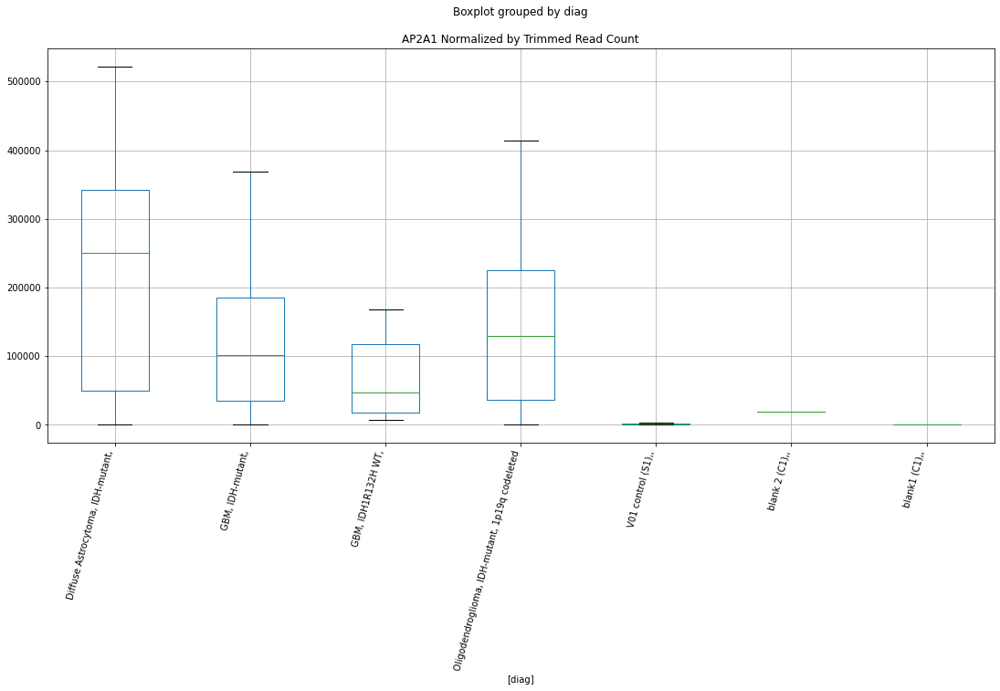

 p : 0.019073052881097844  ( t : 2.575042220898842 ) :  D-plex  :  cutadapt2  :  C1orf174
Control and blanks
76     3030.46
340       0.00
Name: C1orf174, dtype: float64
208    1587.24
Name: C1orf174, dtype: float64
472    0.0
Name: C1orf174, dtype: float64


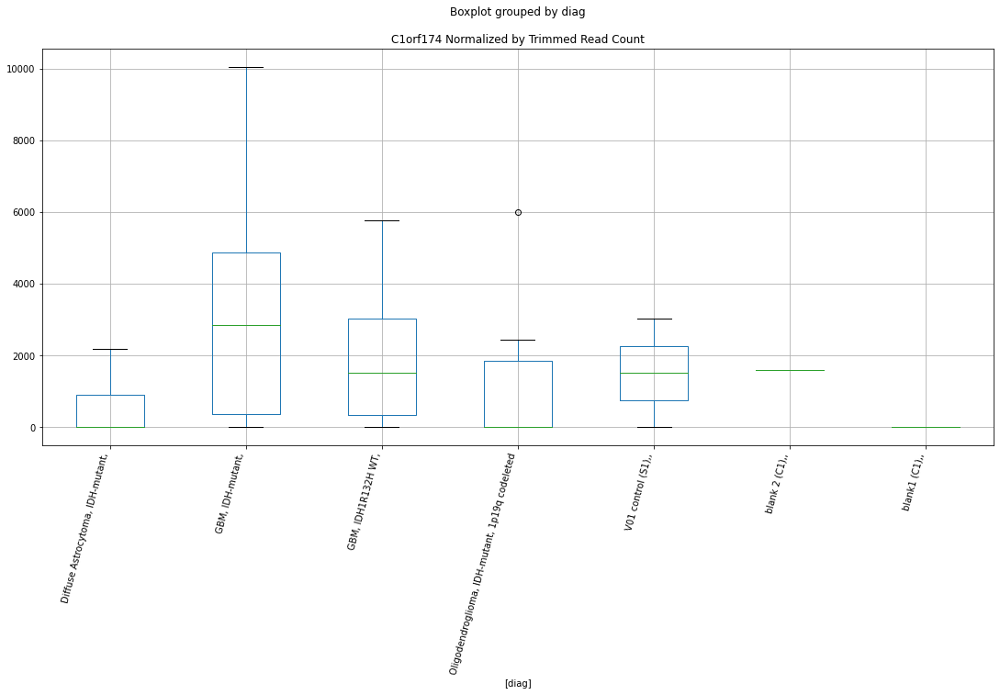

 p : 0.01913737707988176  ( t : 2.573436261695868 ) :  Lexogen  :  cutadapt2  :  ADRA1B
Control and blanks
82     0.0
346    0.0
Name: ADRA1B, dtype: float64
214    4610.85
Name: ADRA1B, dtype: float64
478    474.92
Name: ADRA1B, dtype: float64


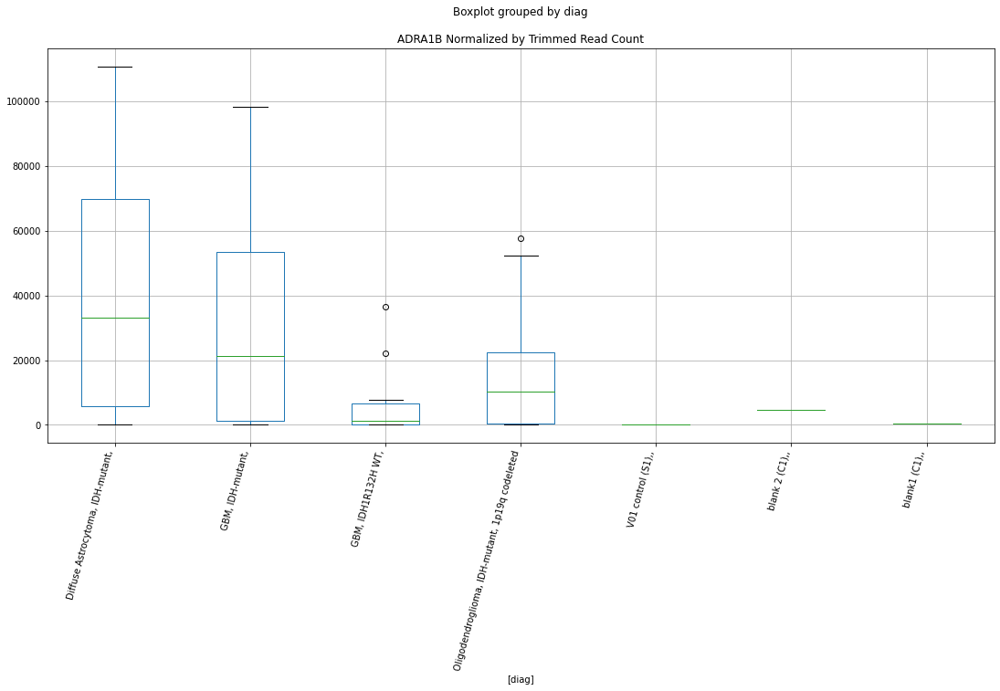

 p : 0.019155593597615952  ( t : 2.5729823855352048 ) :  D-plex  :  cutadapt2  :  ANKRD28
Control and blanks
76     0.0
340    0.0
Name: ANKRD28, dtype: float64
208    42326.45
Name: ANKRD28, dtype: float64
472    16182.76
Name: ANKRD28, dtype: float64


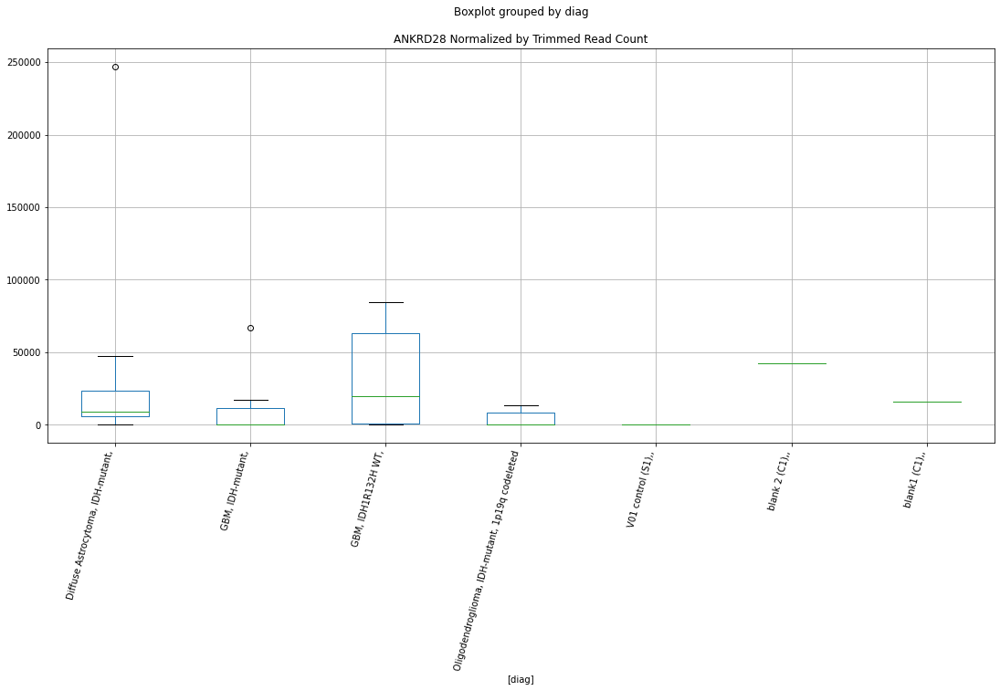

 p : 0.019166539539712726  ( t : 2.5727098570155014 ) :  D-plex  :  bbduk2  :  CORO1B
Control and blanks
73     25509.28
337    98807.46
Name: CORO1B, dtype: float64
205    31161.83
Name: CORO1B, dtype: float64
469    335987.52
Name: CORO1B, dtype: float64


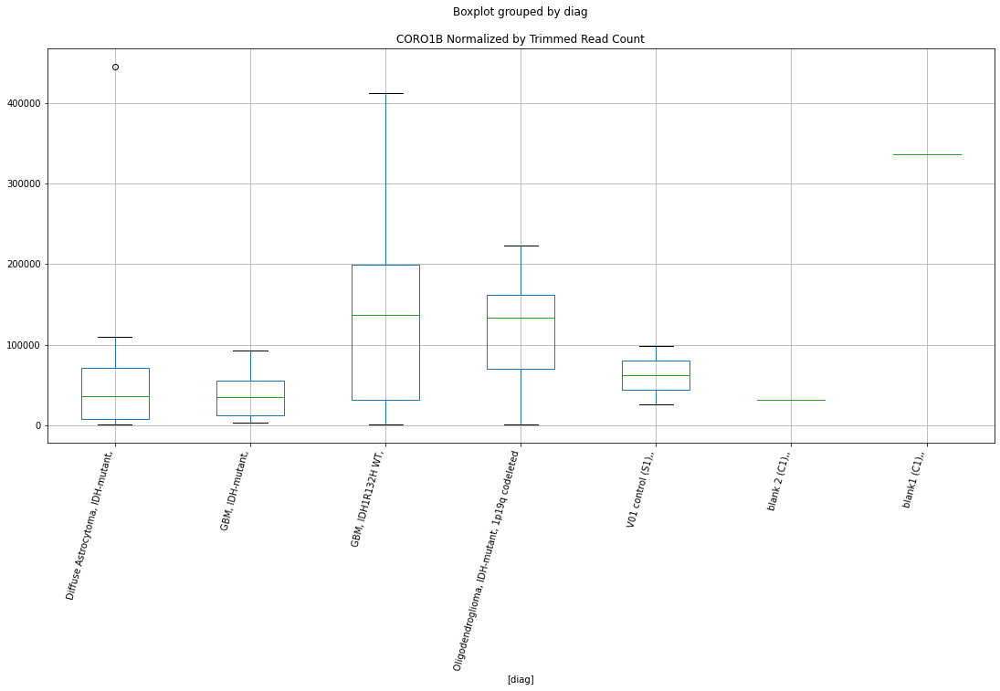

 p : 0.019179710500863773  ( t : 2.5723821260521813 ) :  D-plex  :  cutadapt2  :  CLEC4C
Control and blanks
76     403050.76
340         0.00
Name: CLEC4C, dtype: float64
208    49380.86
Name: CLEC4C, dtype: float64
472    56639.67
Name: CLEC4C, dtype: float64


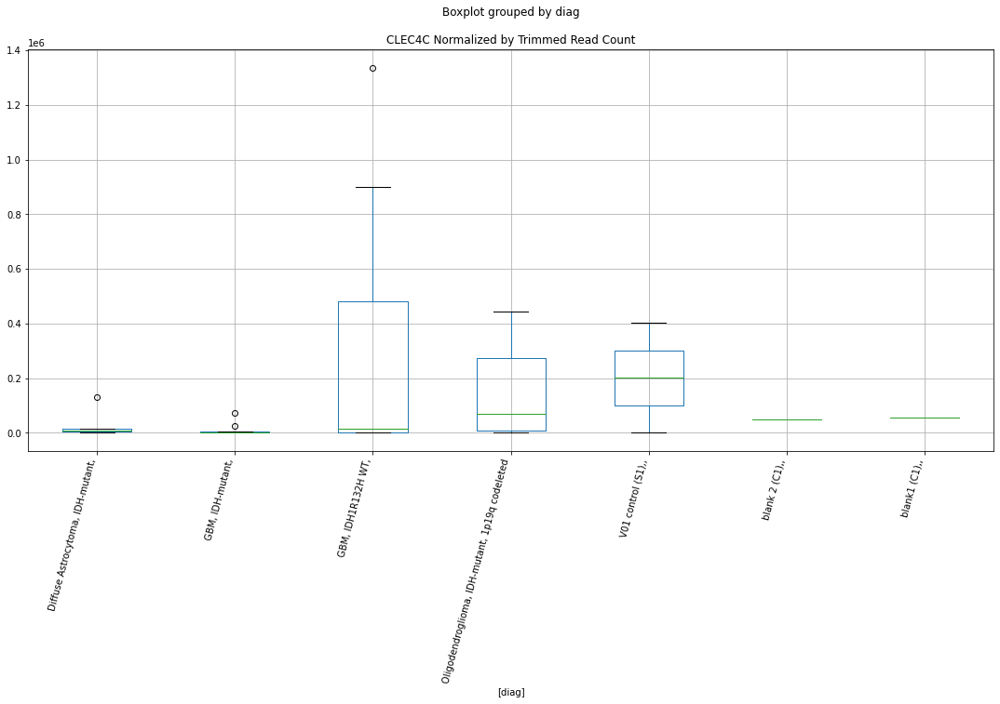

 p : 0.01924235413540284  ( t : 2.570826286567476 ) :  D-plex  :  cutadapt2  :  CORO1B
Control and blanks
76     20455.58
340    97761.27
Name: CORO1B, dtype: float64
208    30510.32
Name: CORO1B, dtype: float64
472    328856.87
Name: CORO1B, dtype: float64


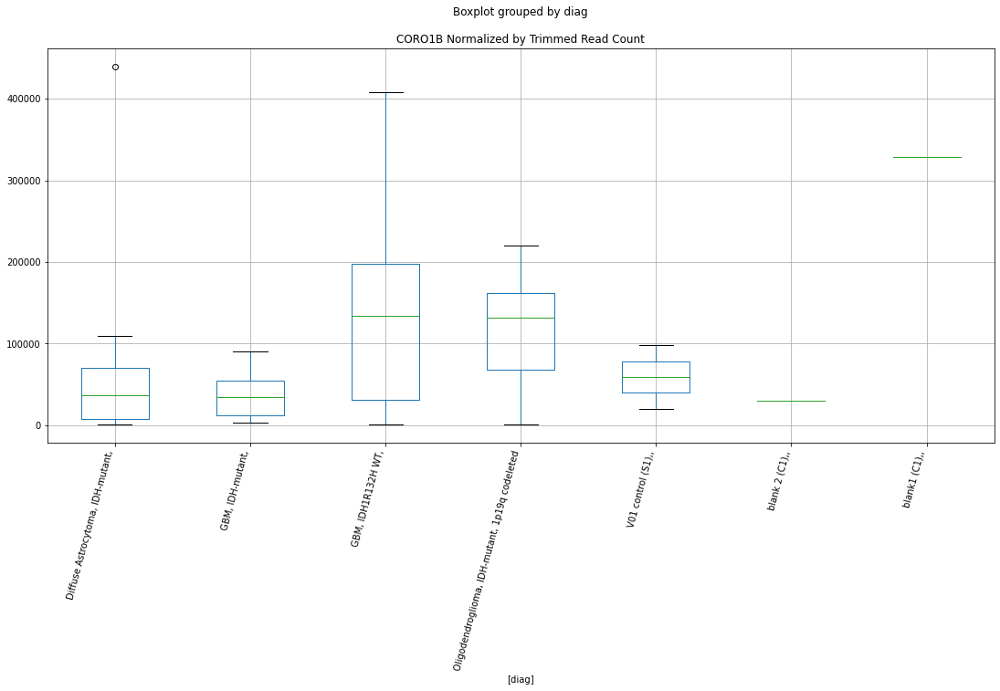

 p : 0.019317271296422096  ( t : 2.5689719042452483 ) :  D-plex  :  cutadapt2  :  DIS3L2
Control and blanks
76          0.00
340    114495.18
Name: DIS3L2, dtype: float64
208    1939.96
Name: DIS3L2, dtype: float64
472    4623.65
Name: DIS3L2, dtype: float64


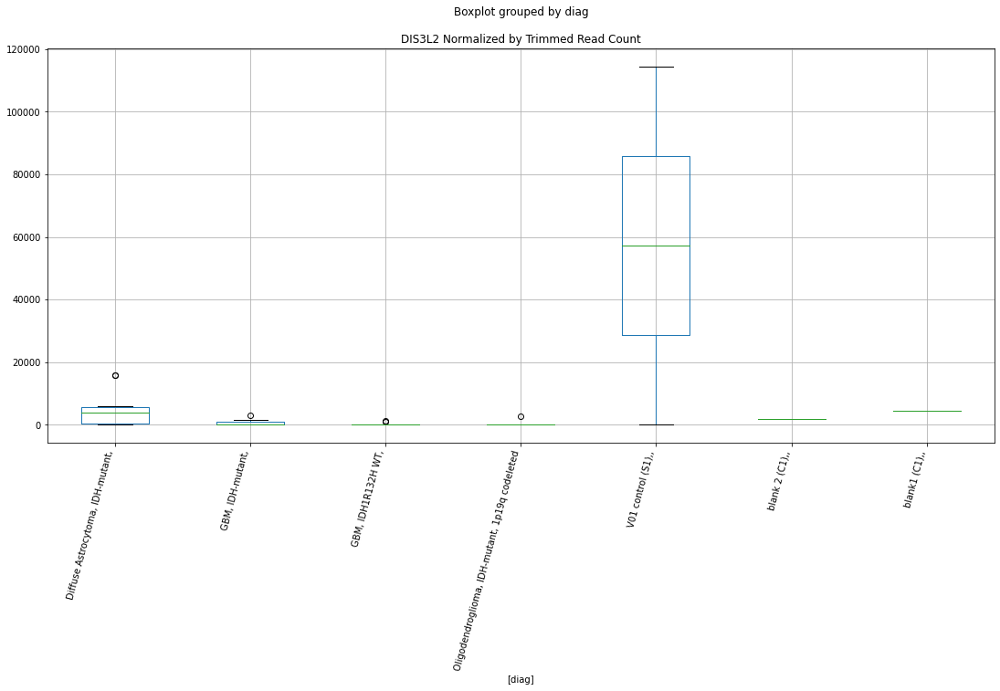

 p : 0.019327918886964997  ( t : 2.5687089033903017 ) :  D-plex  :  bbduk2  :  ASB16
Control and blanks
73     27828.3
337        0.0
Name: ASB16, dtype: float64
205    57309.1
Name: ASB16, dtype: float64
469    6506.8
Name: ASB16, dtype: float64


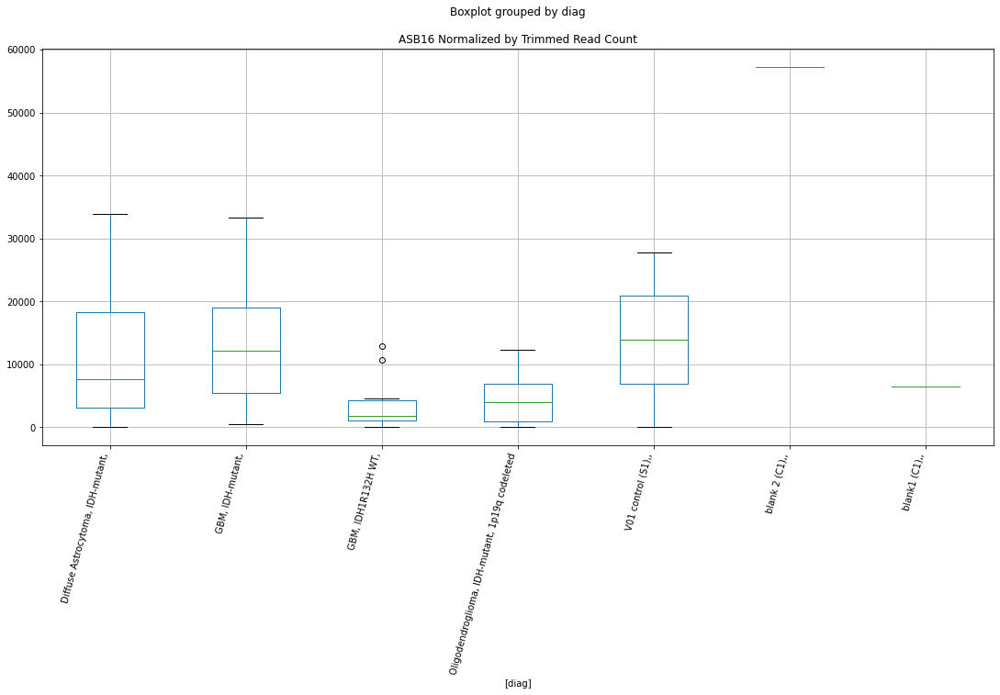

 p : 0.019362402652387603  ( t : 2.5678580777145523 ) :  D-plex  :  bbduk2  :  ACSBG1
Control and blanks
73      1546.02
337    17803.15
Name: ACSBG1, dtype: float64
205    3581.82
Name: ACSBG1, dtype: float64
469    9464.44
Name: ACSBG1, dtype: float64


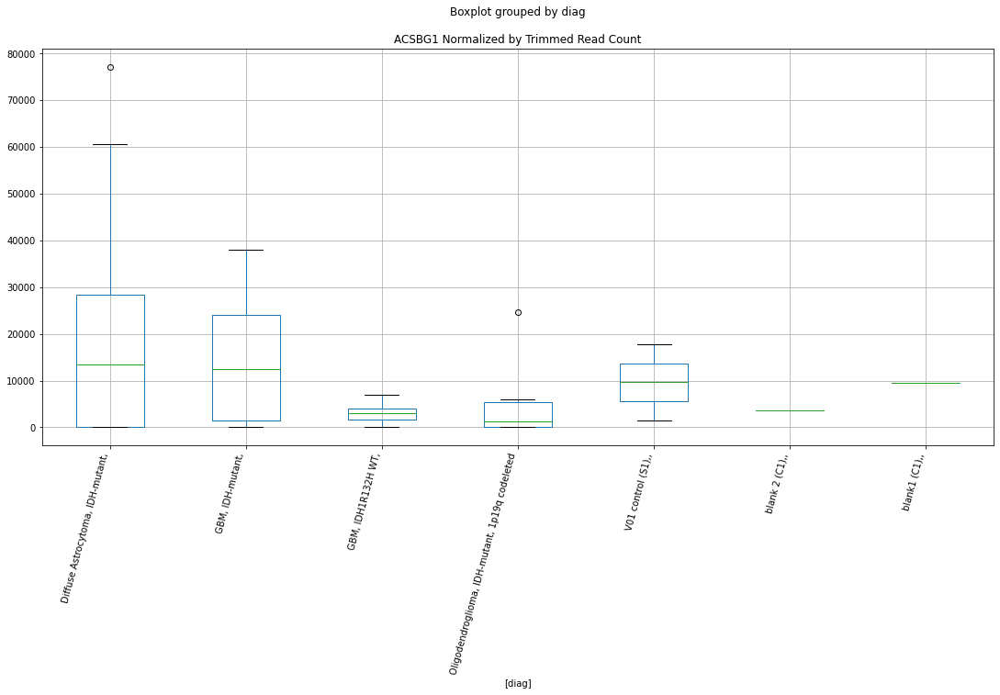

 p : 0.01939829957923585  ( t : 2.566973907708889 ) :  D-plex  :  cutadapt2  :  ATP13A1
Control and blanks
76     0.0
340    0.0
Name: ATP13A1, dtype: float64
208    2292.68
Name: ATP13A1, dtype: float64
472    577.96
Name: ATP13A1, dtype: float64


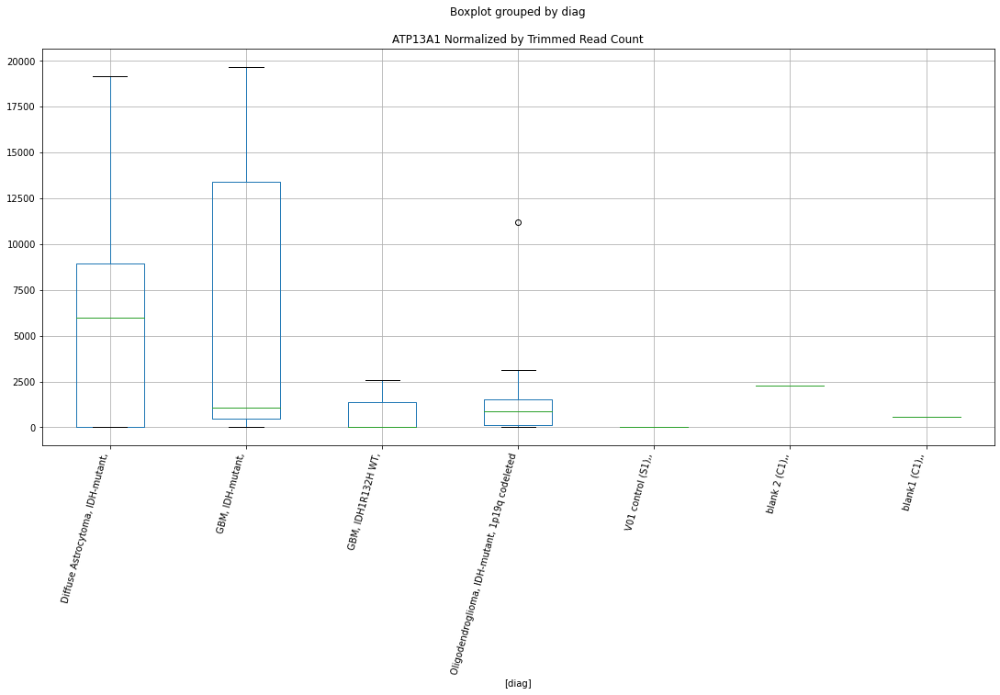

 p : 0.019401050167797834  ( t : 2.5669062224327988 ) :  Lexogen  :  cutadapt2  :  CELF2
Control and blanks
82     0.00e+00
346    1.18e+06
Name: CELF2, dtype: float64
214    18443.4
Name: CELF2, dtype: float64
478    0.0
Name: CELF2, dtype: float64


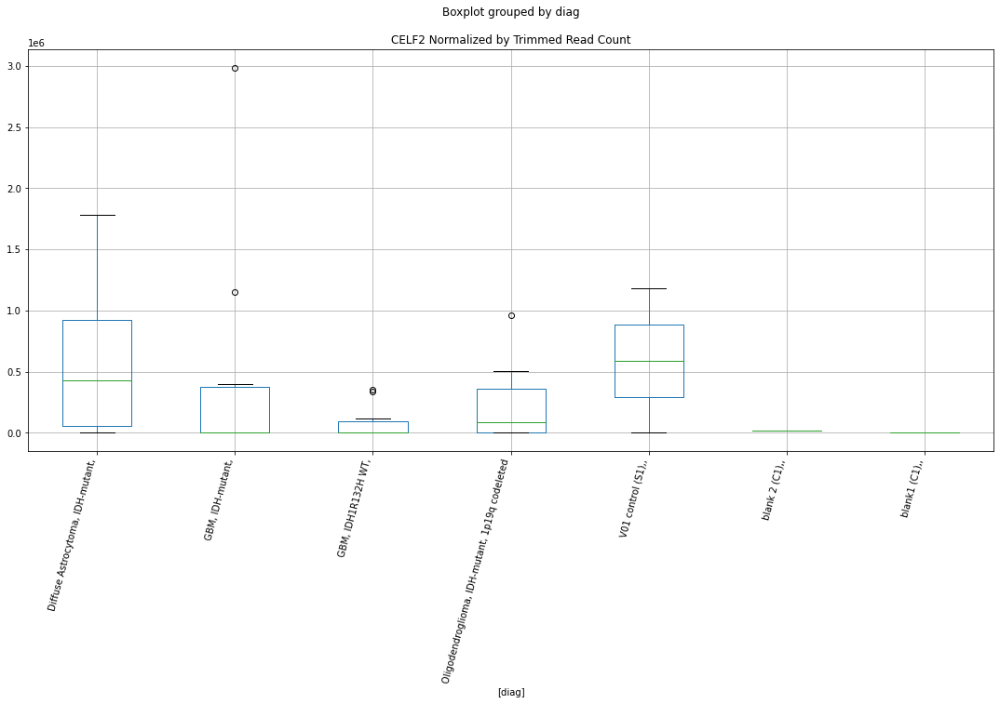

 p : 0.019488692013088924  ( t : 2.564754313480686 ) :  D-plex  :  bbduk2  :  ANKRD13B
Control and blanks
73         0.00
337    21363.77
Name: ANKRD13B, dtype: float64
205    17192.73
Name: ANKRD13B, dtype: float64
469    0.0
Name: ANKRD13B, dtype: float64


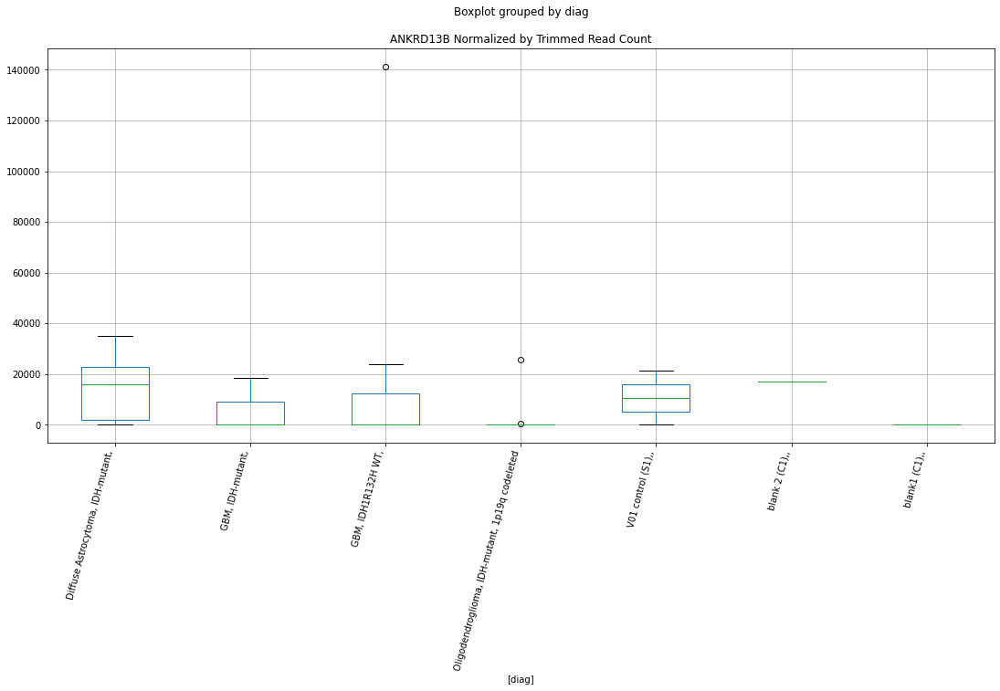

 p : 0.01961471894176071  ( t : 2.5616759231203816 ) :  D-plex  :  bbduk2  :  DLX4
Control and blanks
73         0.00
337    32045.66
Name: DLX4, dtype: float64
205    2149.09
Name: DLX4, dtype: float64
469    591.53
Name: DLX4, dtype: float64


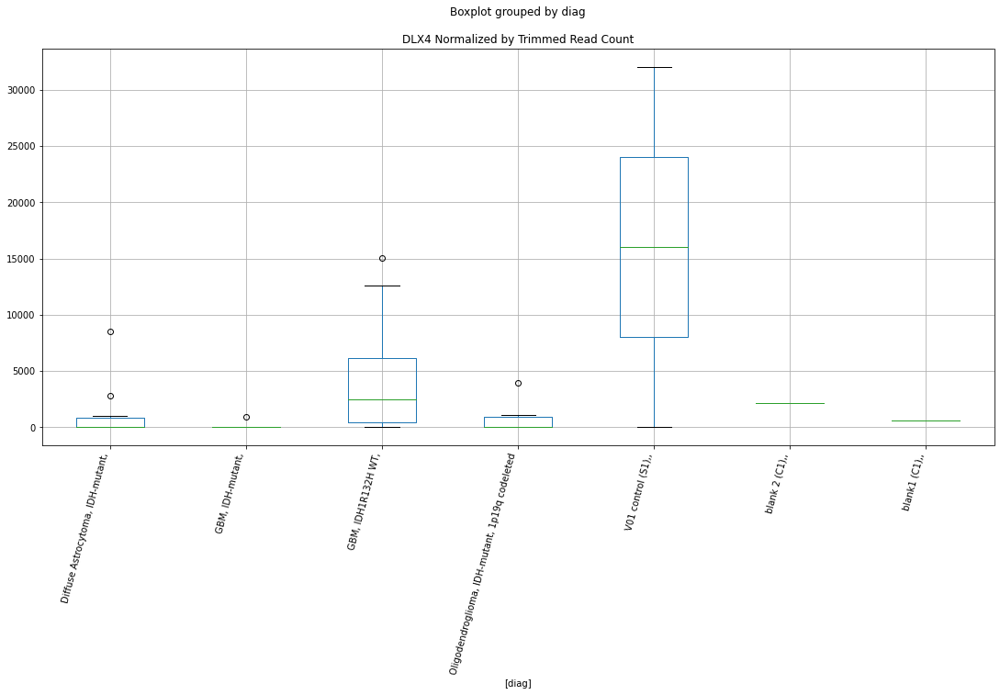

 p : 0.019776288934193604  ( t : 2.557756612252113 ) :  D-plex  :  bbduk2  :  ARL10
Control and blanks
73     773.01
337      0.00
Name: ARL10, dtype: float64
205    716.36
Name: ARL10, dtype: float64
469    1774.58
Name: ARL10, dtype: float64


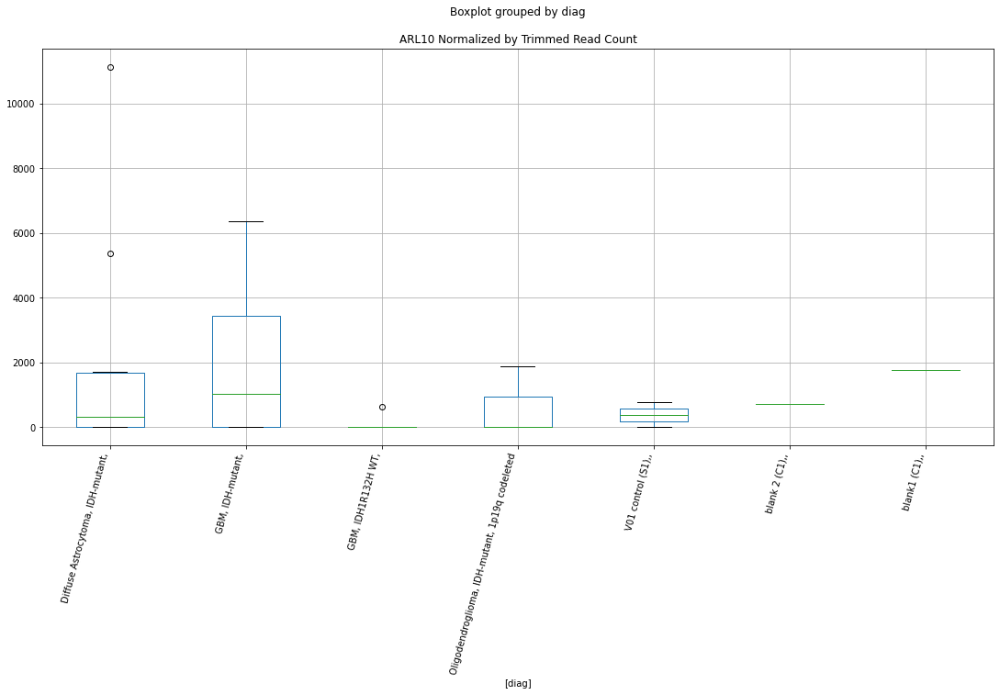

 p : 0.019843398620163266  ( t : 2.556137587923445 ) :  D-plex  :  bbduk2  :  CLEC4C
Control and blanks
73     416651.53
337         0.00
Name: CLEC4C, dtype: float64
205    51220.01
Name: CLEC4C, dtype: float64
469    57969.68
Name: CLEC4C, dtype: float64


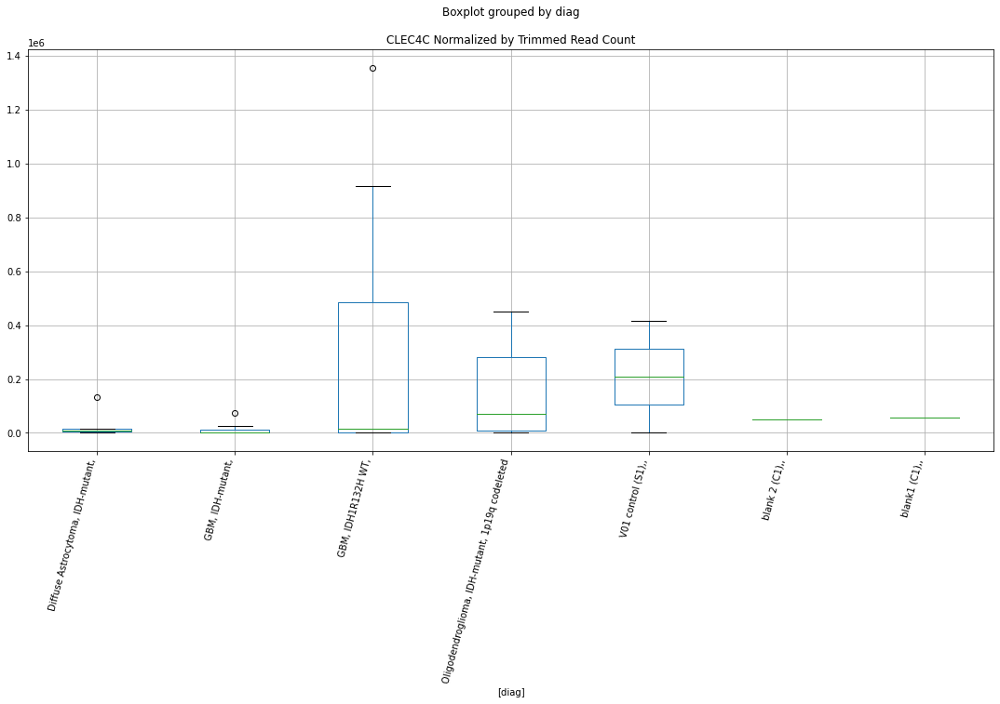

 p : 0.019993932397458888  ( t : 2.5525247150445693 ) :  D-plex  :  cutadapt2  :  ASIC1
Control and blanks
76     0.0
340    0.0
Name: ASIC1, dtype: float64
208    6701.69
Name: ASIC1, dtype: float64
472    577.96
Name: ASIC1, dtype: float64


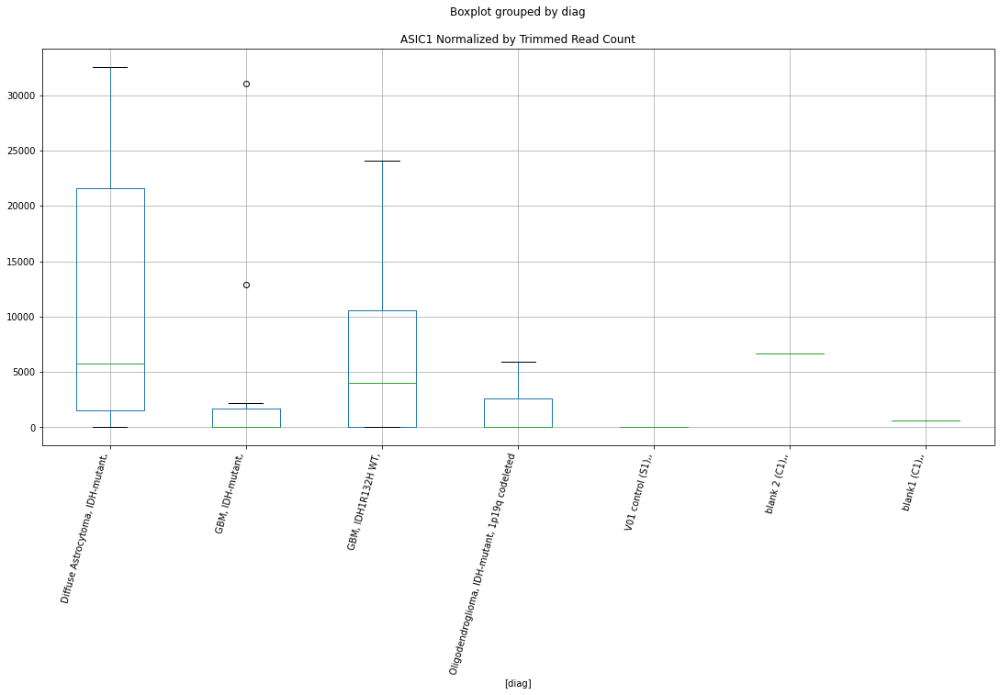

 p : 0.020021517473973  ( t : 2.5518654526948925 ) :  Lexogen  :  bbduk2  :  ADRA1B
Control and blanks
79     0.0
343    0.0
Name: ADRA1B, dtype: float64
211    4646.21
Name: ADRA1B, dtype: float64
475    479.03
Name: ADRA1B, dtype: float64


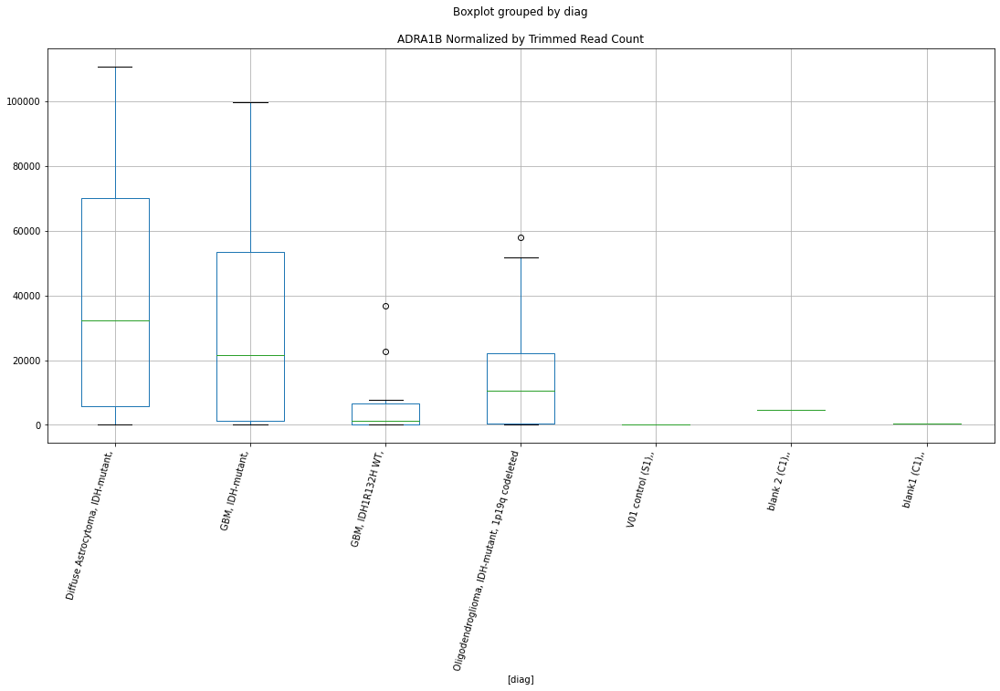

 p : 0.02019057503853648  ( t : 2.54784377356824 ) :  D-plex  :  bbduk2  :  B3GNT6
Control and blanks
73     773.01
337      0.00
Name: B3GNT6, dtype: float64
205    1611.82
Name: B3GNT6, dtype: float64
469    1183.05
Name: B3GNT6, dtype: float64


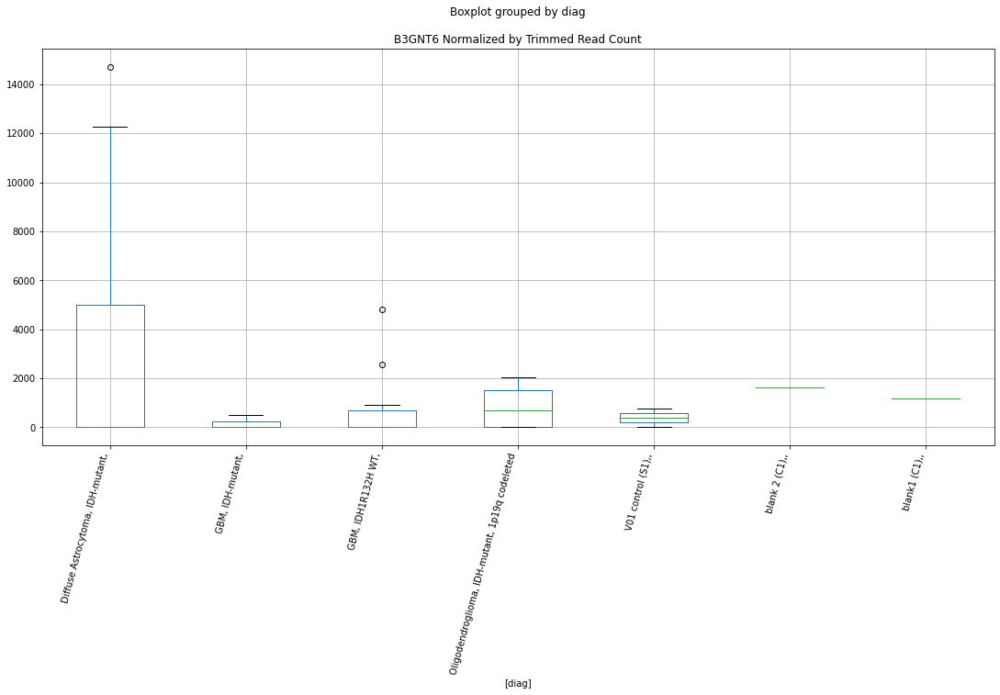

 p : 0.02022810186323721  ( t : 2.546955374941993 ) :  D-plex  :  cutadapt2  :  ASB16
Control and blanks
76     27274.11
340        0.00
Name: ASB16, dtype: float64
208    56258.91
Name: ASB16, dtype: float64
472    6357.51
Name: ASB16, dtype: float64


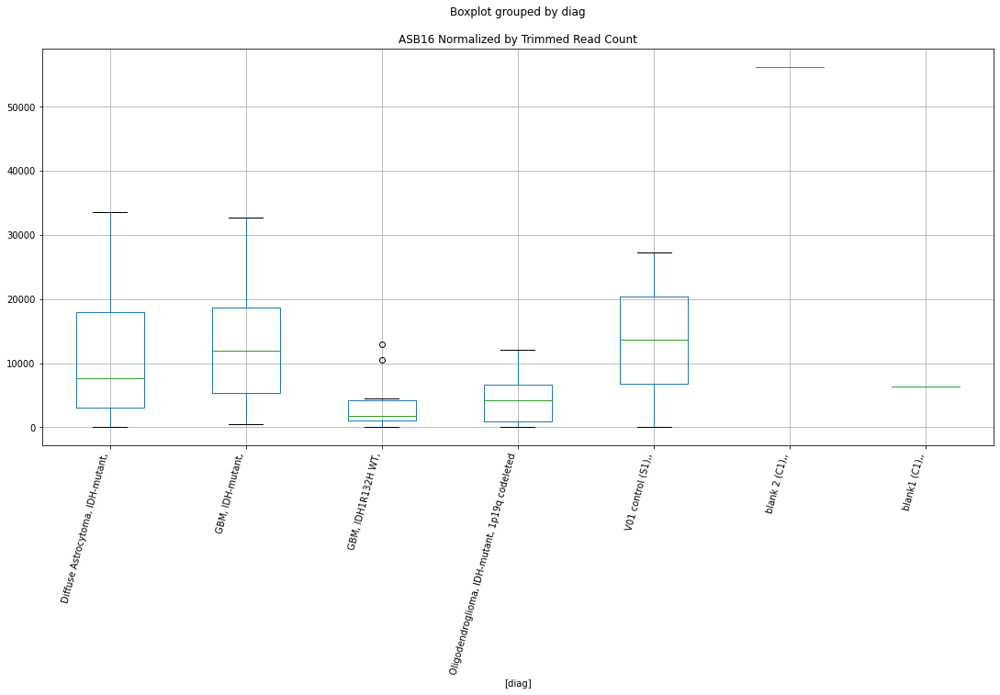

 p : 0.020242583991699505  ( t : 2.546612946134133 ) :  Lexogen  :  bbduk2  :  CELF2
Control and blanks
79     0.00e+00
343    1.17e+06
Name: CELF2, dtype: float64
211    18584.83
Name: CELF2, dtype: float64
475    0.0
Name: CELF2, dtype: float64


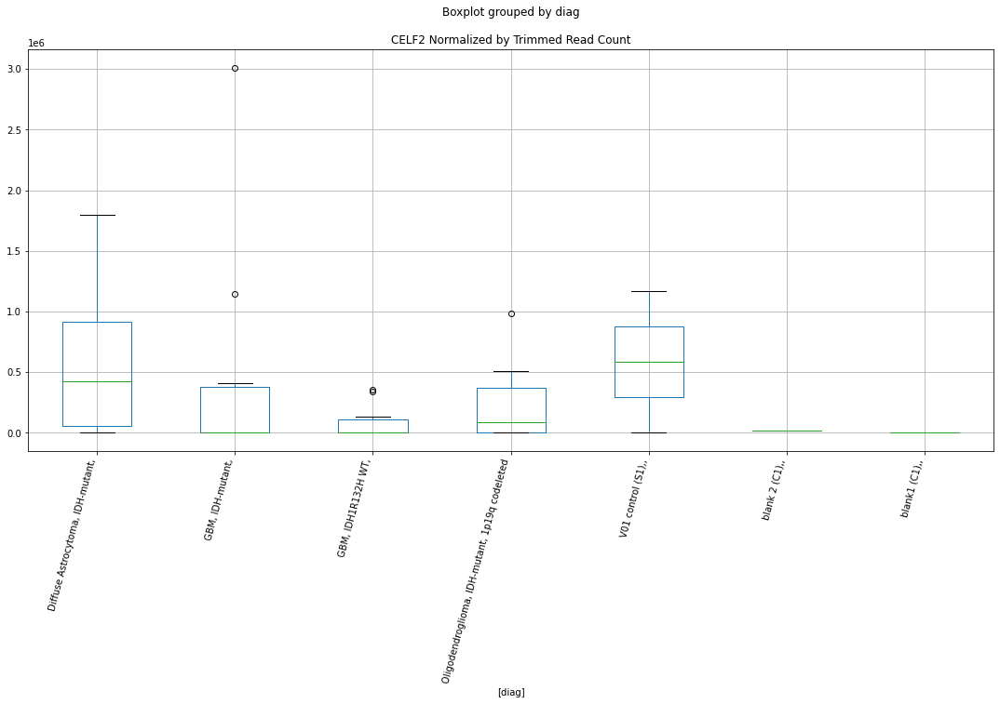

 p : 0.0203840718469112  ( t : 2.543279608732033 ) :  Lexogen  :  bbduk2  :  COL26A1
Control and blanks
79       0.00
343    636.94
Name: COL26A1, dtype: float64
211    8199.19
Name: COL26A1, dtype: float64
475    0.0
Name: COL26A1, dtype: float64


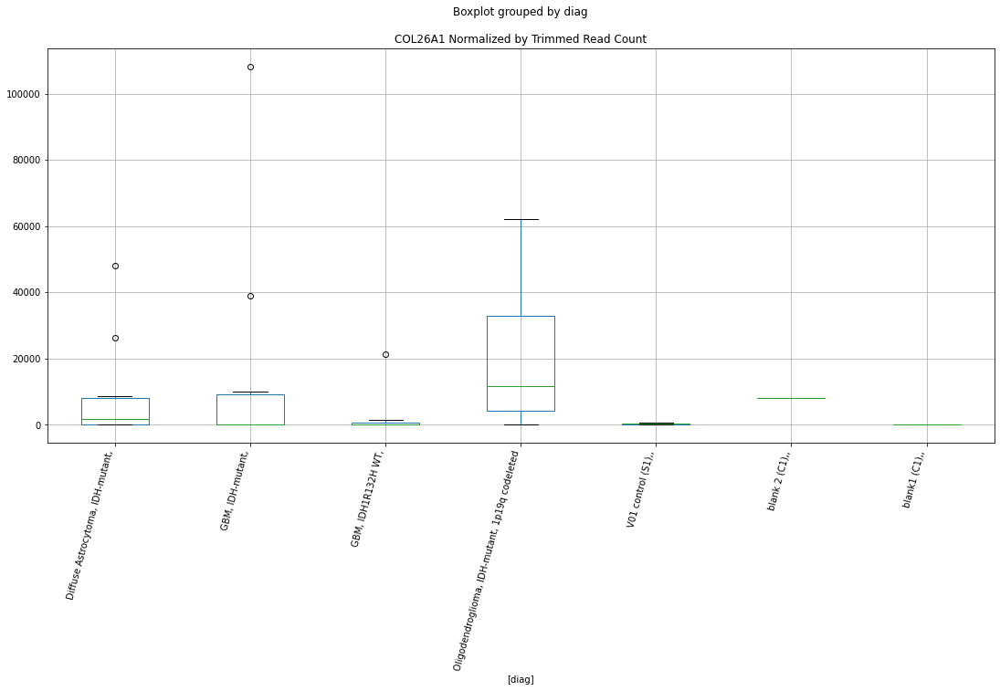

 p : 0.02039610010542631  ( t : 2.542997242484726 ) :  Lexogen  :  cutadapt2  :  COL26A1
Control and blanks
82       0.0
346    631.3
Name: COL26A1, dtype: float64
214    8136.79
Name: COL26A1, dtype: float64
478    0.0
Name: COL26A1, dtype: float64


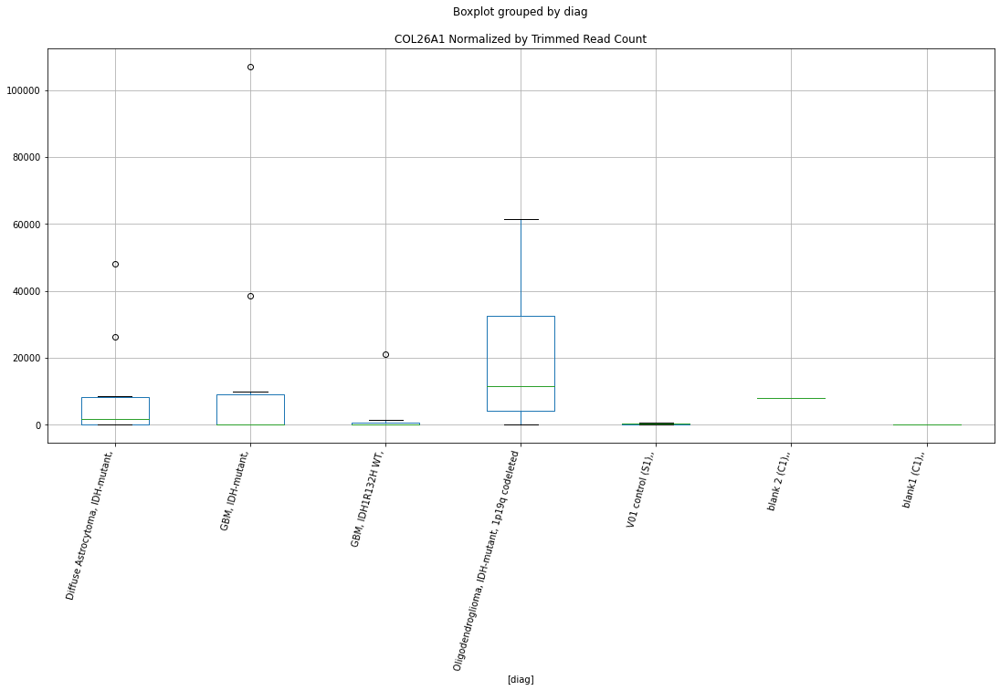

 p : 0.02045080975066799  ( t : 2.5417149033989843 ) :  D-plex  :  cutadapt2  :  CTXND1
Control and blanks
76     29546.95
340    18495.37
Name: CTXND1, dtype: float64
208    20281.43
Name: CTXND1, dtype: float64
472    28897.79
Name: CTXND1, dtype: float64


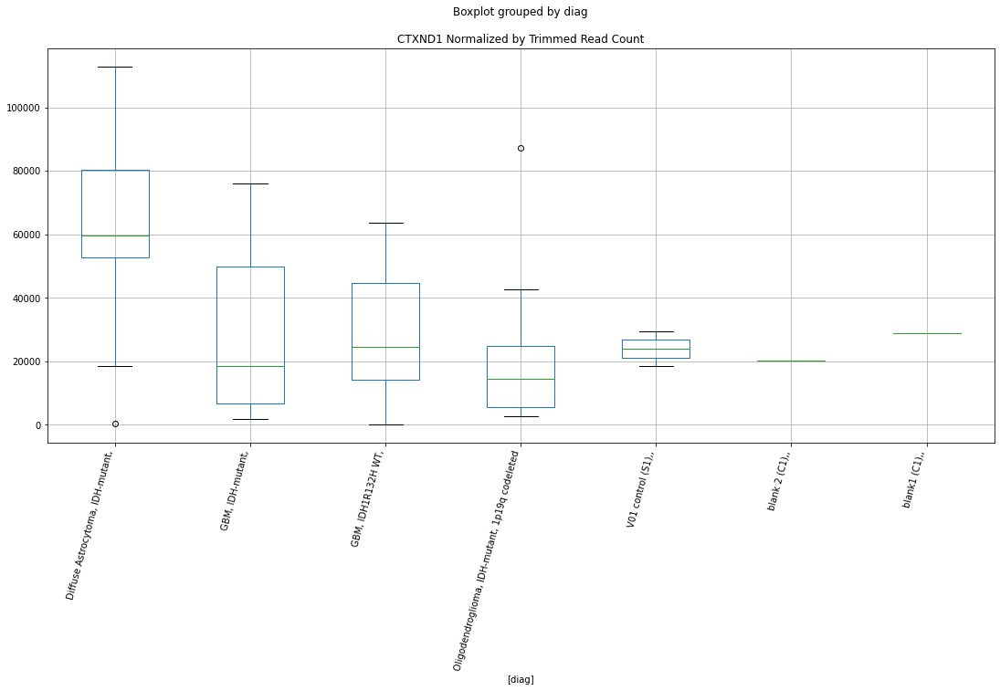

 p : 0.02059429701909542  ( t : 2.5383670465780783 ) :  D-plex  :  bbduk2  :  CTXND1
Control and blanks
73     29374.32
337    18693.30
Name: CTXND1, dtype: float64
205    20774.55
Name: CTXND1, dtype: float64
469    29576.37
Name: CTXND1, dtype: float64


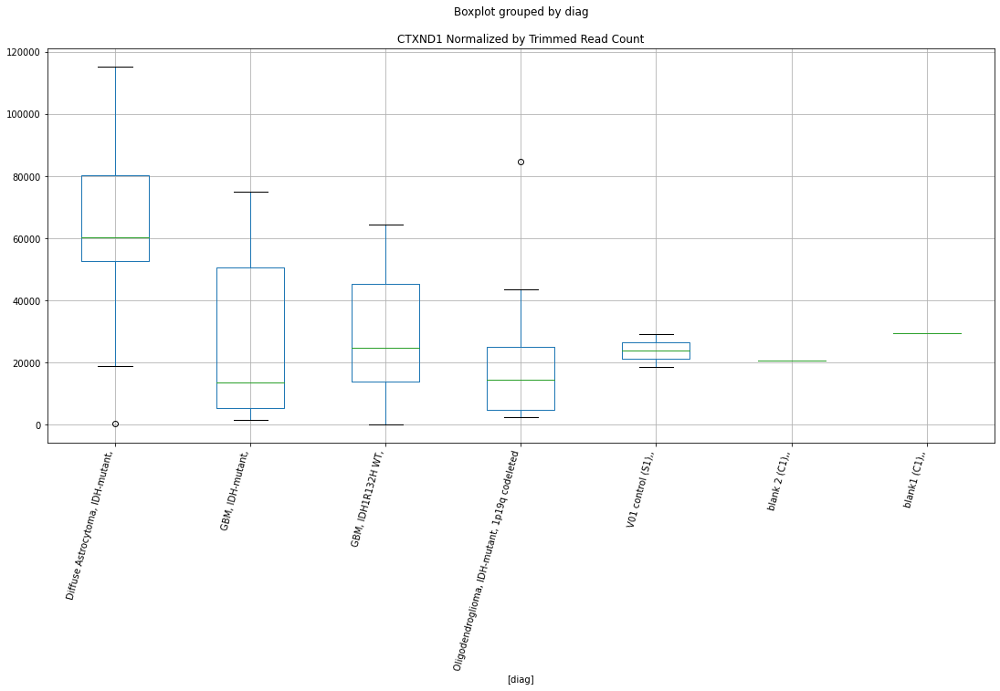

 p : 0.02068813332156283  ( t : 2.536189550760326 ) :  D-plex  :  bbduk2  :  CELSR2
Control and blanks
73     69570.76
337        0.00
Name: CELSR2, dtype: float64
205    5372.73
Name: CELSR2, dtype: float64
469    7098.33
Name: CELSR2, dtype: float64


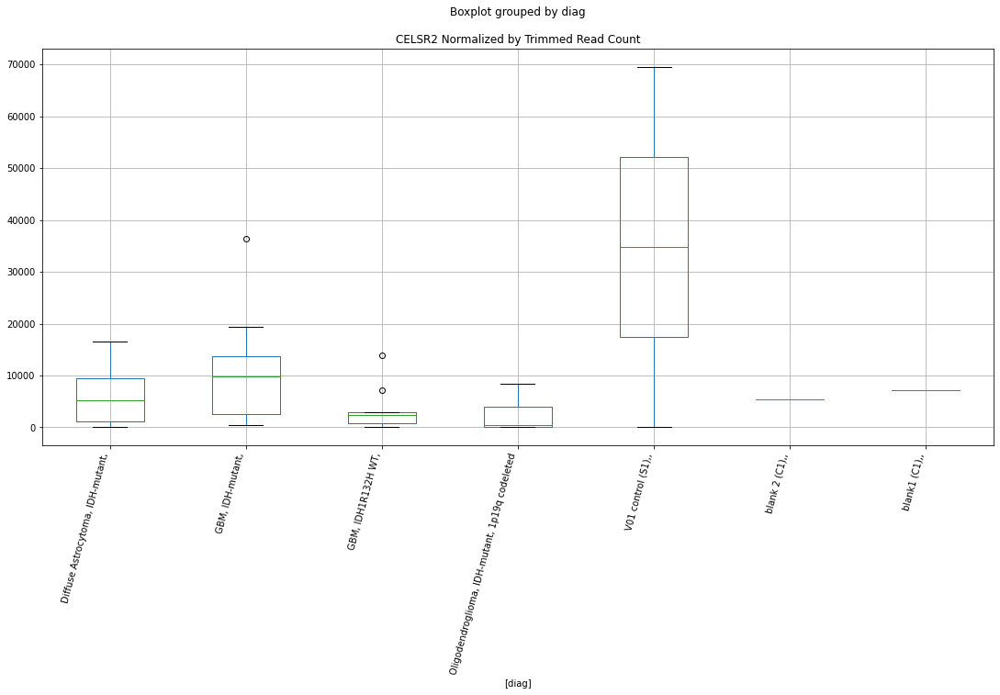

 p : 0.02098878999923248  ( t : 2.5292750391431875 ) :  D-plex  :  bbduk2  :  C11orf54
Control and blanks
73     0.0
337    0.0
Name: C11orf54, dtype: float64
205    3044.55
Name: C11orf54, dtype: float64
469    8281.38
Name: C11orf54, dtype: float64


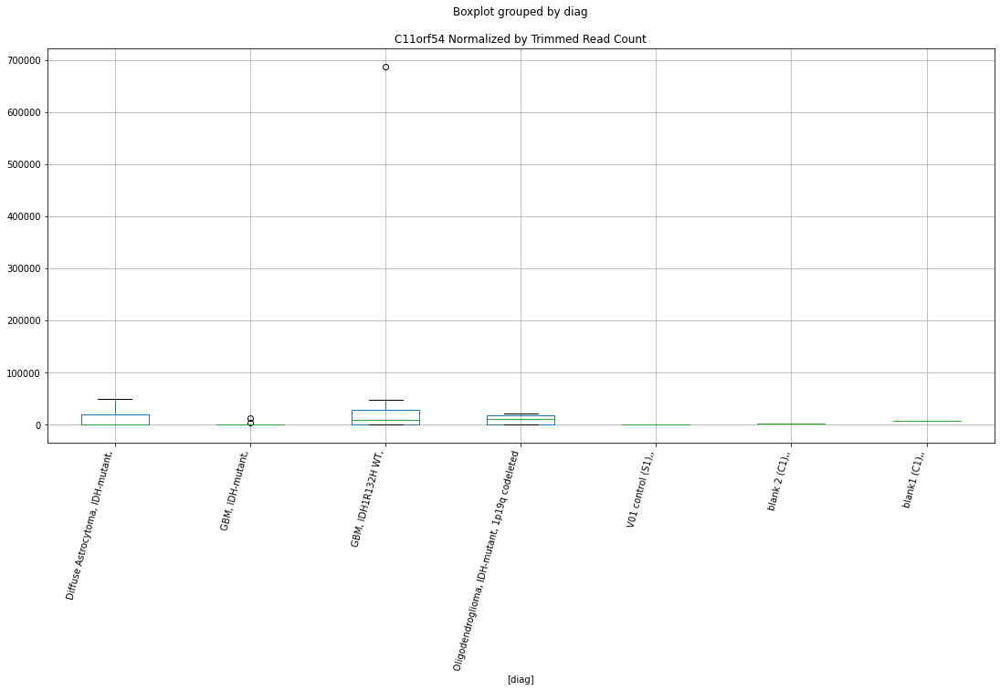

 p : 0.021135051549768115  ( t : 2.525945066844196 ) :  D-plex  :  bbduk2  :  ARL17B
Control and blanks
73     0.0
337    0.0
Name: ARL17B, dtype: float64
205    358.18
Name: ARL17B, dtype: float64
469    591.53
Name: ARL17B, dtype: float64


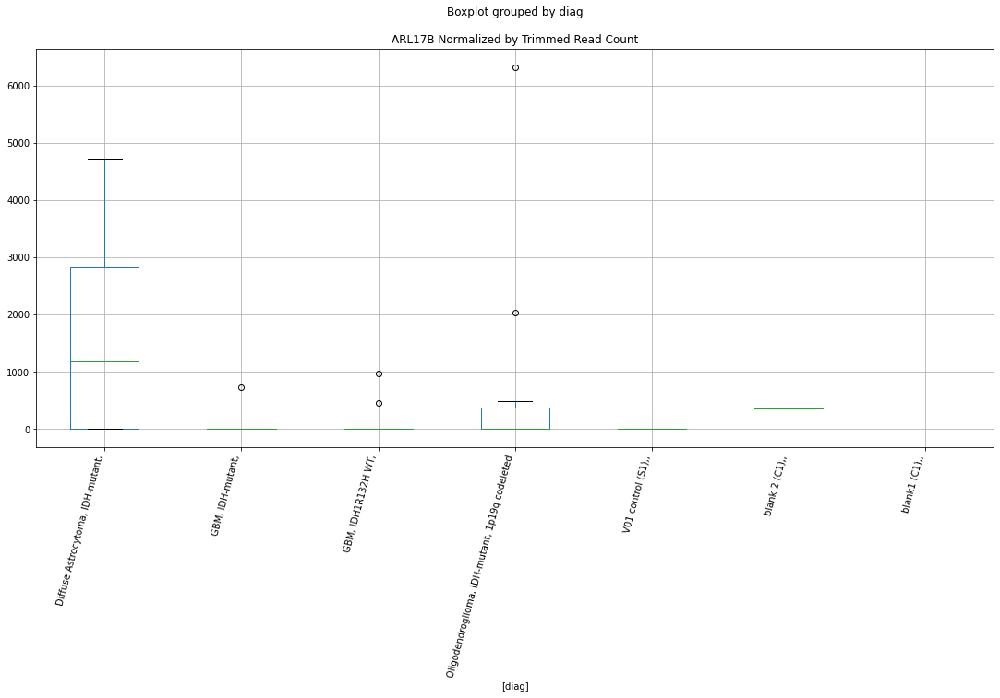

 p : 0.02124375156440028  ( t : 2.5234843309847252 ) :  D-plex  :  cutadapt2  :  ANXA5
Control and blanks
76     1515.23
340       0.00
Name: ANXA5, dtype: float64
208    176.36
Name: ANXA5, dtype: float64
472    1155.91
Name: ANXA5, dtype: float64


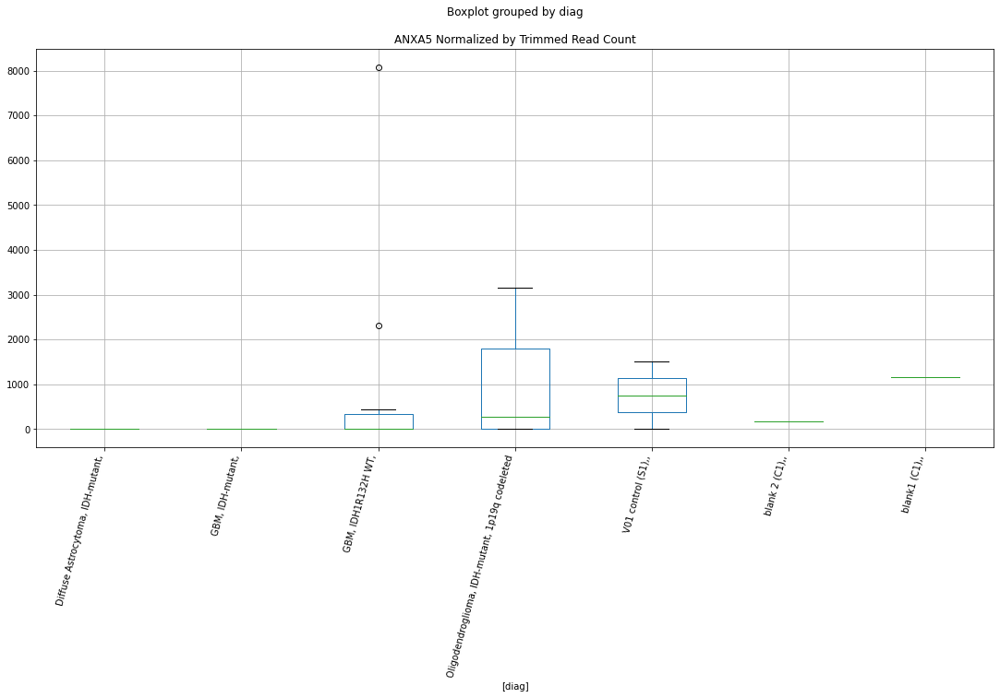

 p : 0.021263482969986616  ( t : 2.523038929146946 ) :  Lexogen  :  cutadapt2  :  ACSS3
Control and blanks
82         0.00
346    74704.26
Name: ACSS3, dtype: float64
214    0.0
Name: ACSS3, dtype: float64
478    1187.3
Name: ACSS3, dtype: float64


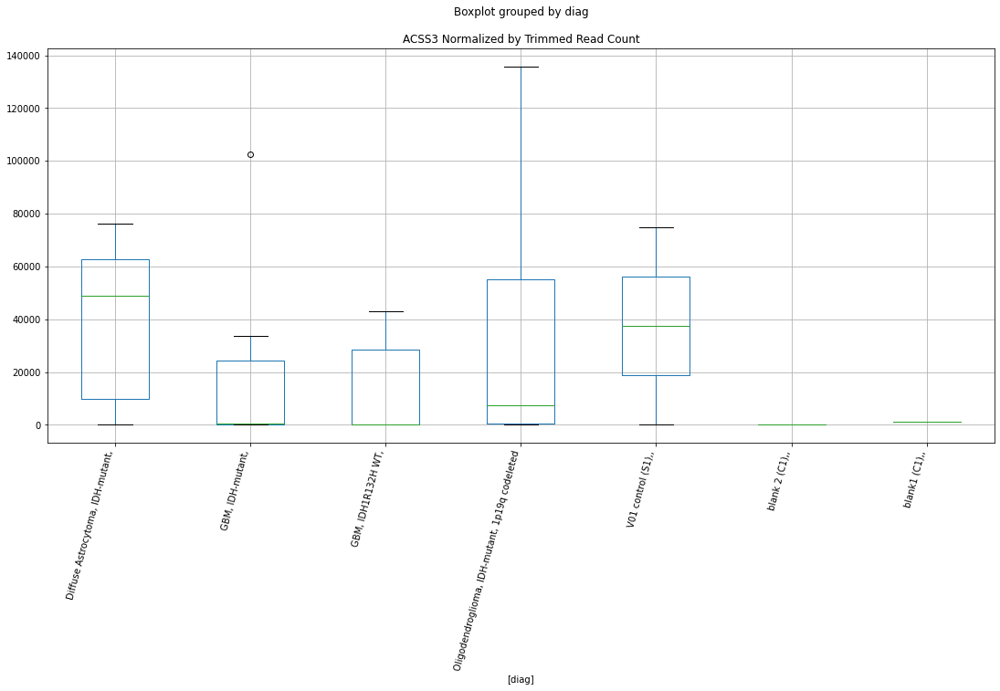

 p : 0.021283448216247336  ( t : 2.5225886456848827 ) :  D-plex  :  cutadapt2  :  DGKB
Control and blanks
76     0.0
340    0.0
Name: DGKB, dtype: float64
208    14637.9
Name: DGKB, dtype: float64
472    21384.37
Name: DGKB, dtype: float64


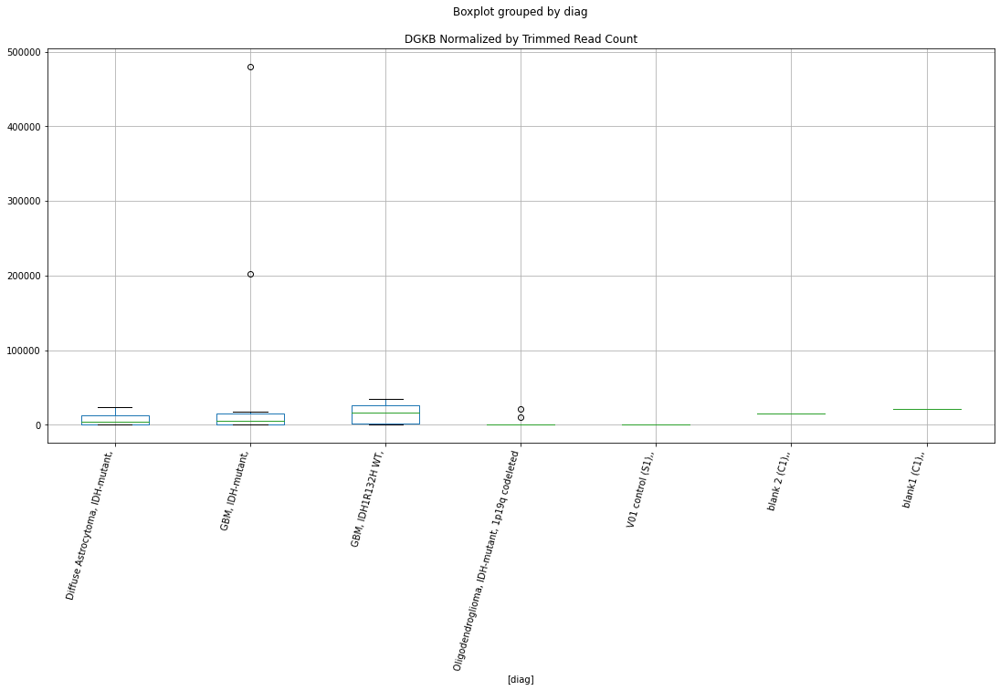

 p : 0.021375344900874314  ( t : 2.5205211935869576 ) :  Lexogen  :  cutadapt2  :  CPD
Control and blanks
82     0.0
346    0.0
Name: CPD, dtype: float64
214    542.45
Name: CPD, dtype: float64
478    0.0
Name: CPD, dtype: float64


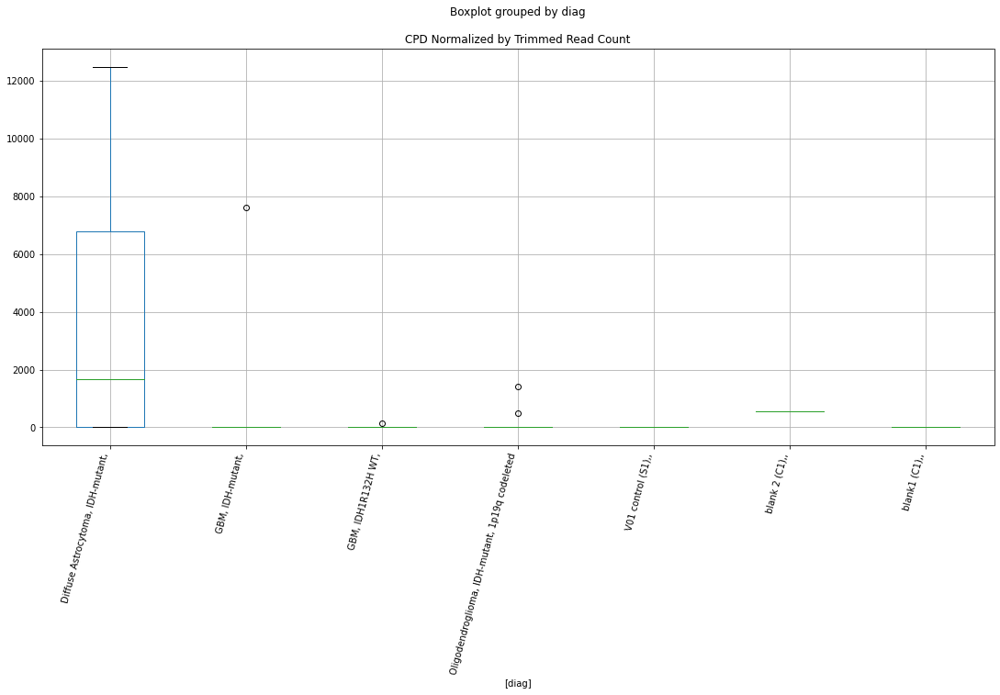

 p : 0.021410089333537958  ( t : 2.51974171299634 ) :  Lexogen  :  cutadapt2  :  CARMN
Control and blanks
82         0.00
346    87119.89
Name: CARMN, dtype: float64
214    0.0
Name: CARMN, dtype: float64
478    27070.5
Name: CARMN, dtype: float64


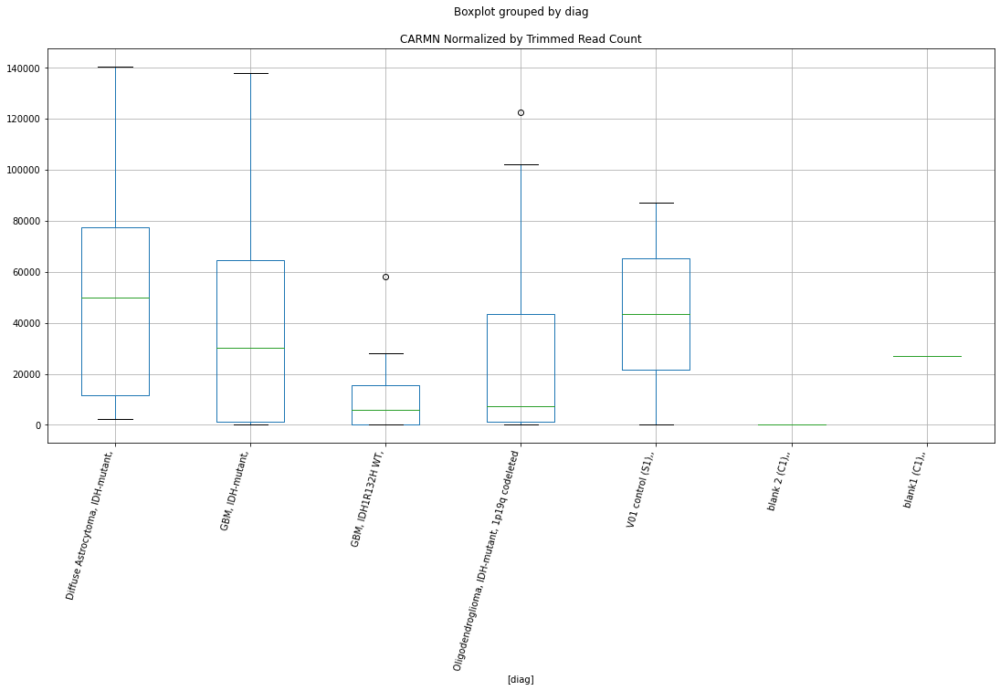

 p : 0.021431258601641728  ( t : 2.5192673720490784 ) :  D-plex  :  cutadapt2  :  BRIP1
Control and blanks
76     969746.19
340    140917.14
Name: BRIP1, dtype: float64
208    269831.13
Name: BRIP1, dtype: float64
472    342149.86
Name: BRIP1, dtype: float64


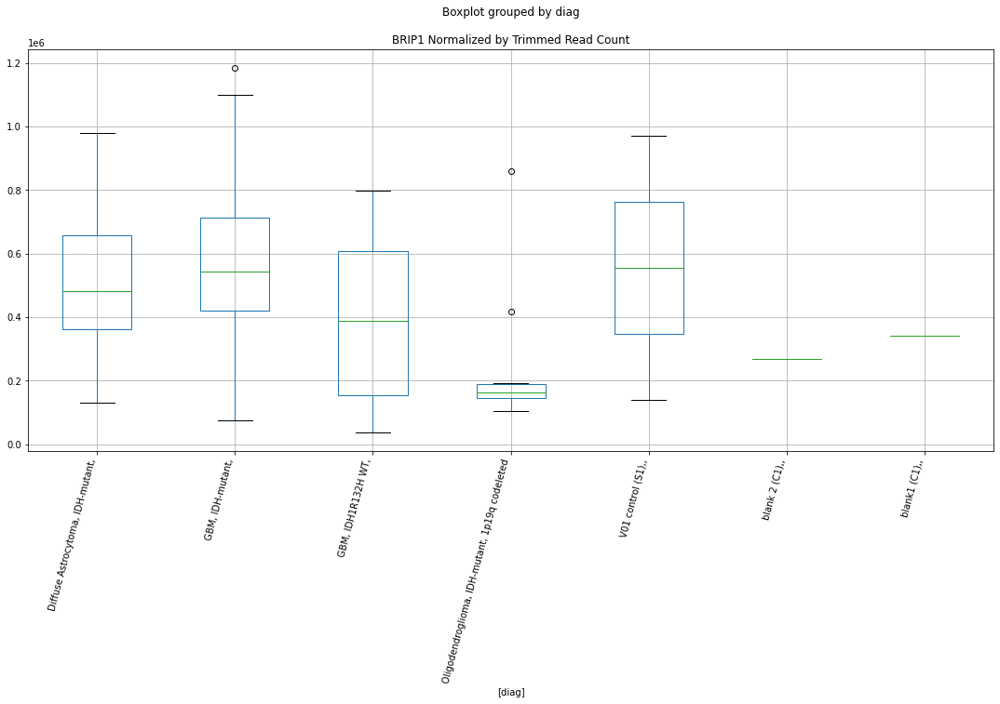

 p : 0.021564111811966026  ( t : 2.516300578094689 ) :  D-plex  :  bbduk2  :  ANKH
Control and blanks
73     773.01
337      0.00
Name: ANKH, dtype: float64
205    537.27
Name: ANKH, dtype: float64
469    1183.05
Name: ANKH, dtype: float64


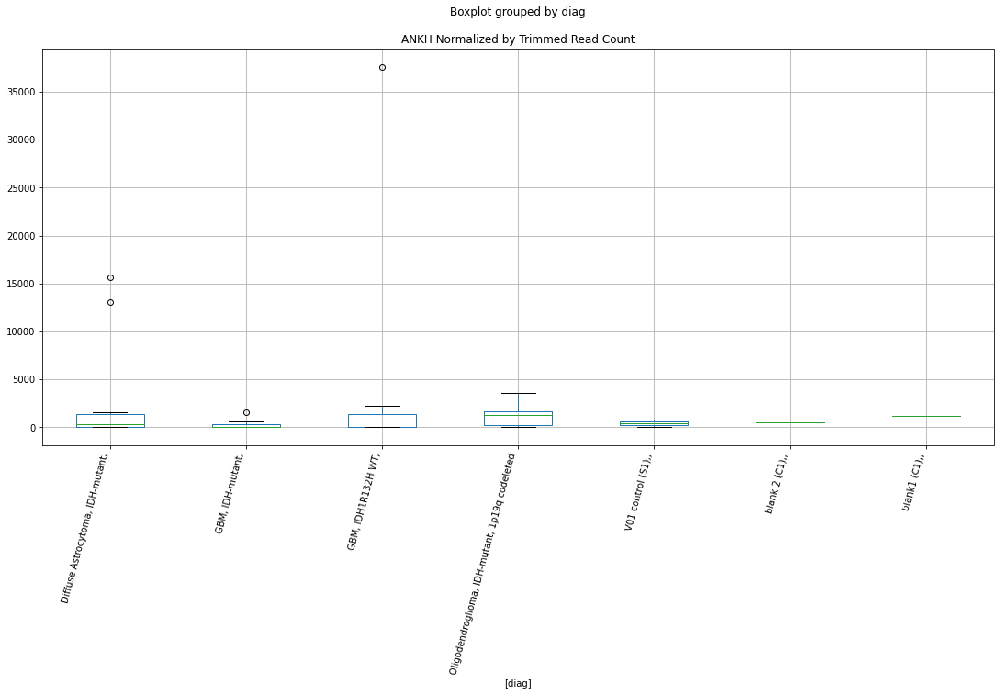

 p : 0.02165426725525461  ( t : 2.5142970898550527 ) :  D-plex  :  bbduk2  :  AP4E1
Control and blanks
73     6184.07
337       0.00
Name: AP4E1, dtype: float64
205    1074.55
Name: AP4E1, dtype: float64
469    4732.22
Name: AP4E1, dtype: float64


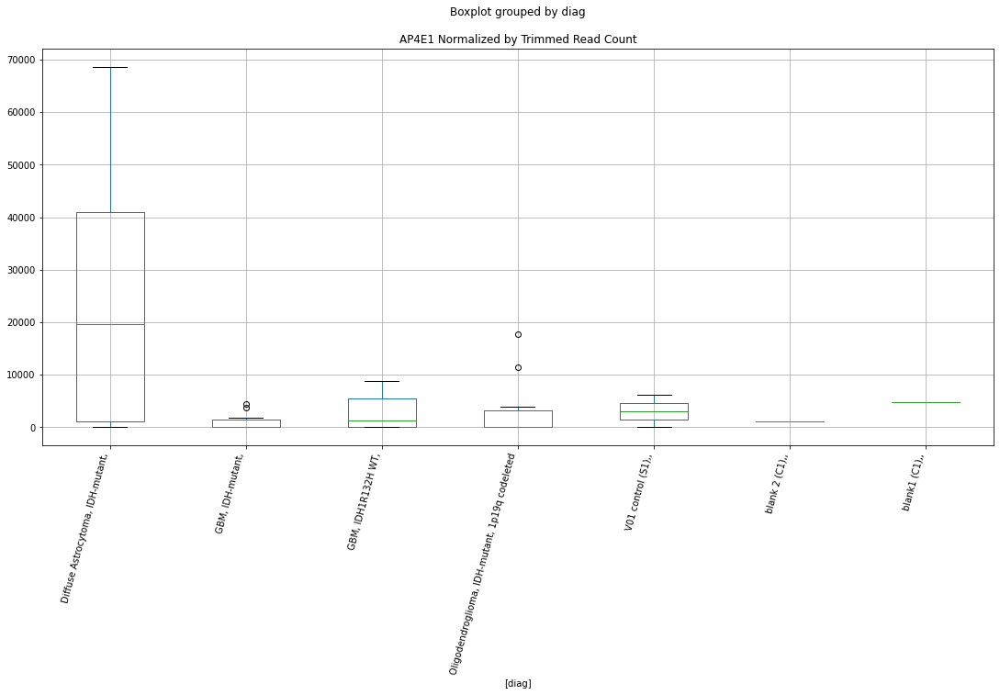

 p : 0.021673266710612354  ( t : 2.5138758766317904 ) :  Lexogen  :  bbduk2  :  CPD
Control and blanks
79     0.0
343    0.0
Name: CPD, dtype: float64
211    0.0
Name: CPD, dtype: float64
475    0.0
Name: CPD, dtype: float64


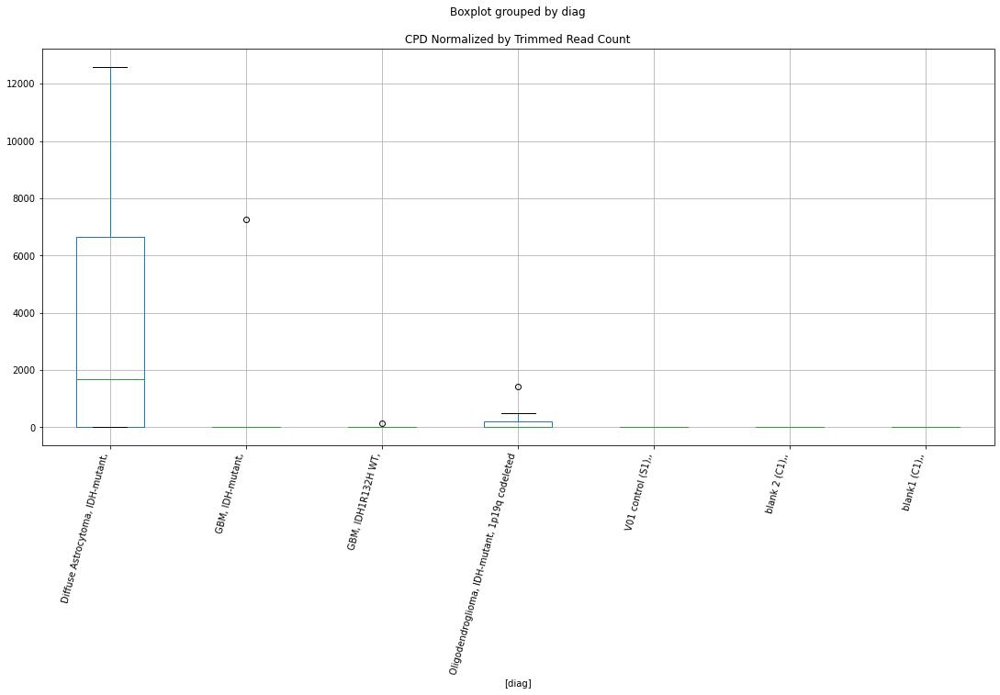

 p : 0.021699375789281786  ( t : 2.5132976126651028 ) :  Lexogen  :  cutadapt2  :  ACOXL
Control and blanks
82     0.0
346    0.0
Name: ACOXL, dtype: float64
214    0.0
Name: ACOXL, dtype: float64
478    0.0
Name: ACOXL, dtype: float64


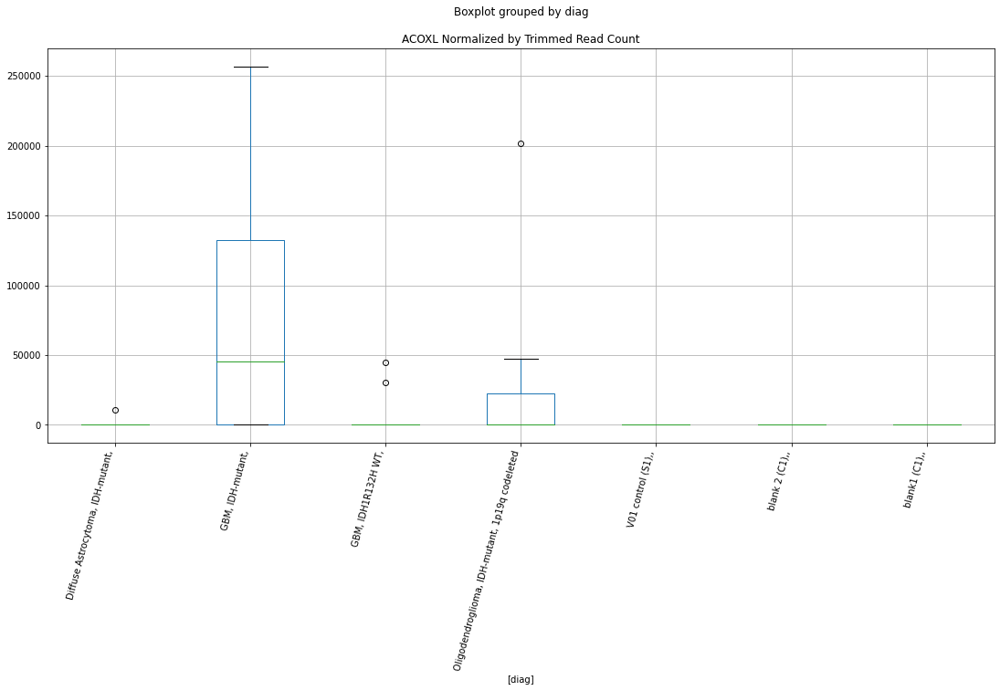

 p : 0.02171837733453297  ( t : 2.512877178852208 ) :  Lexogen  :  bbduk2  :  CARMN
Control and blanks
79         0.00
343    87898.13
Name: CARMN, dtype: float64
211    0.0
Name: CARMN, dtype: float64
475    27304.79
Name: CARMN, dtype: float64


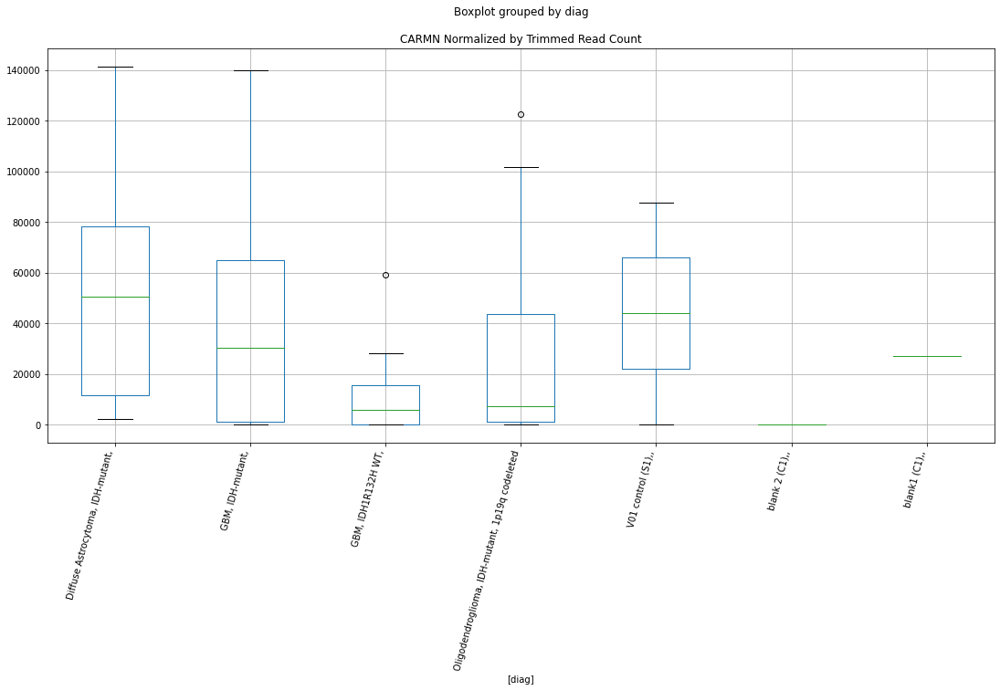

 p : 0.021789207463786608  ( t : 2.511313021528283 ) :  Lexogen  :  cutadapt2  :  AOPEP
Control and blanks
82      17040.61
346    173398.05
Name: AOPEP, dtype: float64
214    0.0
Name: AOPEP, dtype: float64
478    1424.76
Name: AOPEP, dtype: float64


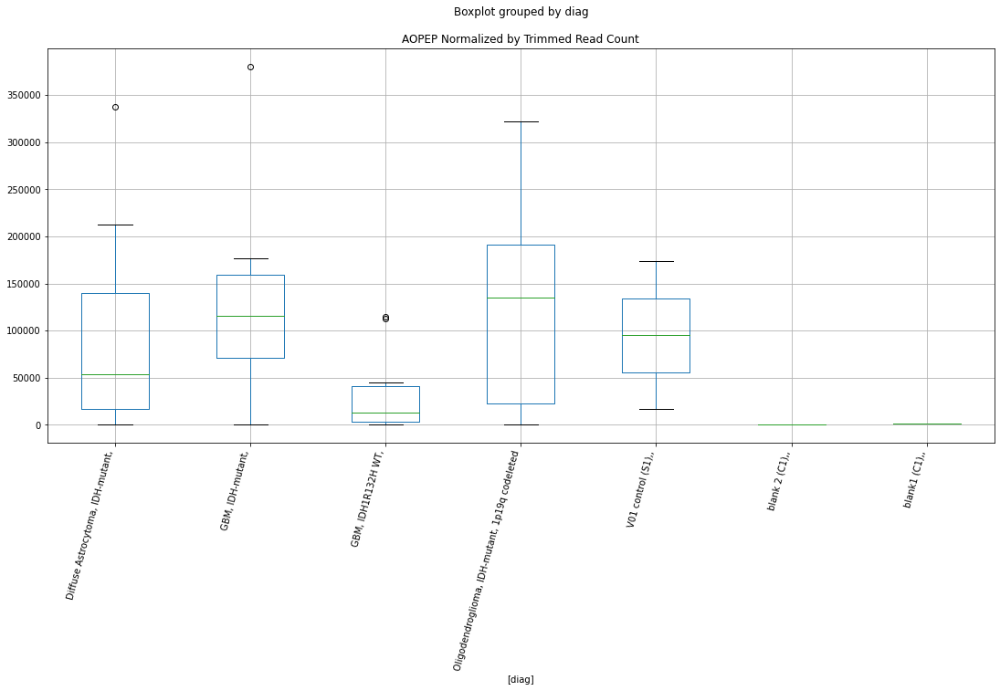

 p : 0.02179978451432389  ( t : 2.5110798578281135 ) :  Lexogen  :  bbduk2  :  ACOXL
Control and blanks
79     0.0
343    0.0
Name: ACOXL, dtype: float64
211    0.0
Name: ACOXL, dtype: float64
475    0.0
Name: ACOXL, dtype: float64


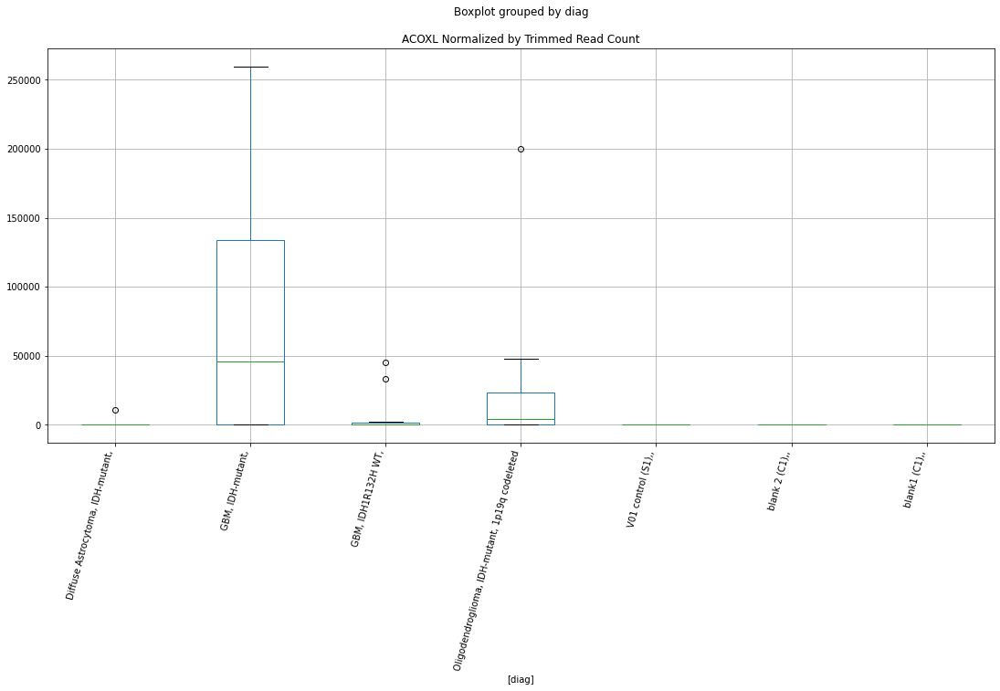

 p : 0.021838940142947894  ( t : 2.510217626854639 ) :  D-plex  :  bbduk2  :  BBOX1
Control and blanks
73     0.0
337    0.0
Name: BBOX1, dtype: float64
205    15043.64
Name: BBOX1, dtype: float64
469    1.29e+06
Name: BBOX1, dtype: float64


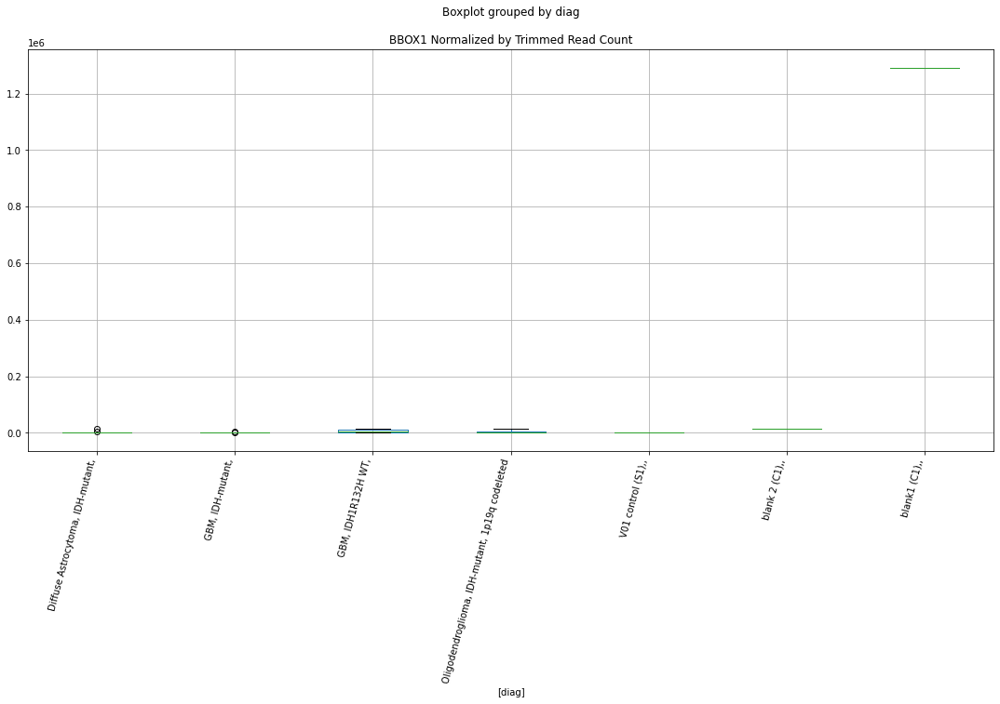

 p : 0.02201792752955524  ( t : 2.5062946848597605 ) :  D-plex  :  cutadapt2  :  BBOX1
Control and blanks
76     0.0
340    0.0
Name: BBOX1, dtype: float64
208    14814.26
Name: BBOX1, dtype: float64
472    1.27e+06
Name: BBOX1, dtype: float64


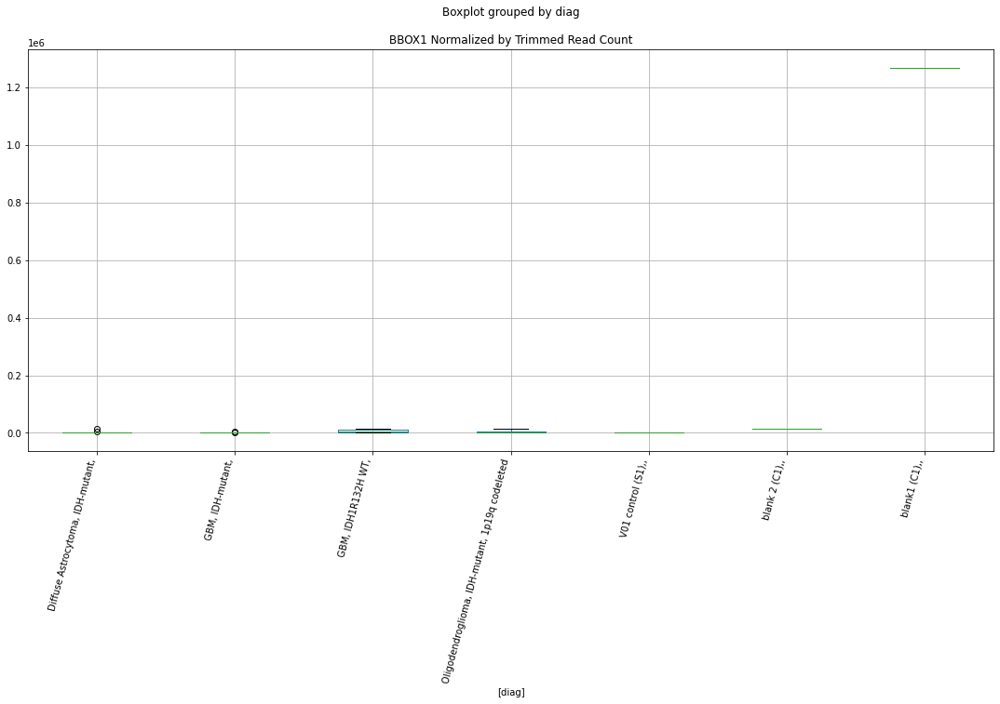

 p : 0.022020348382951162  ( t : 2.5062418323665527 ) :  D-plex  :  cutadapt2  :  C3orf36
Control and blanks
76     0.0
340    0.0
Name: C3orf36, dtype: float64
208    529.08
Name: C3orf36, dtype: float64
472    0.0
Name: C3orf36, dtype: float64


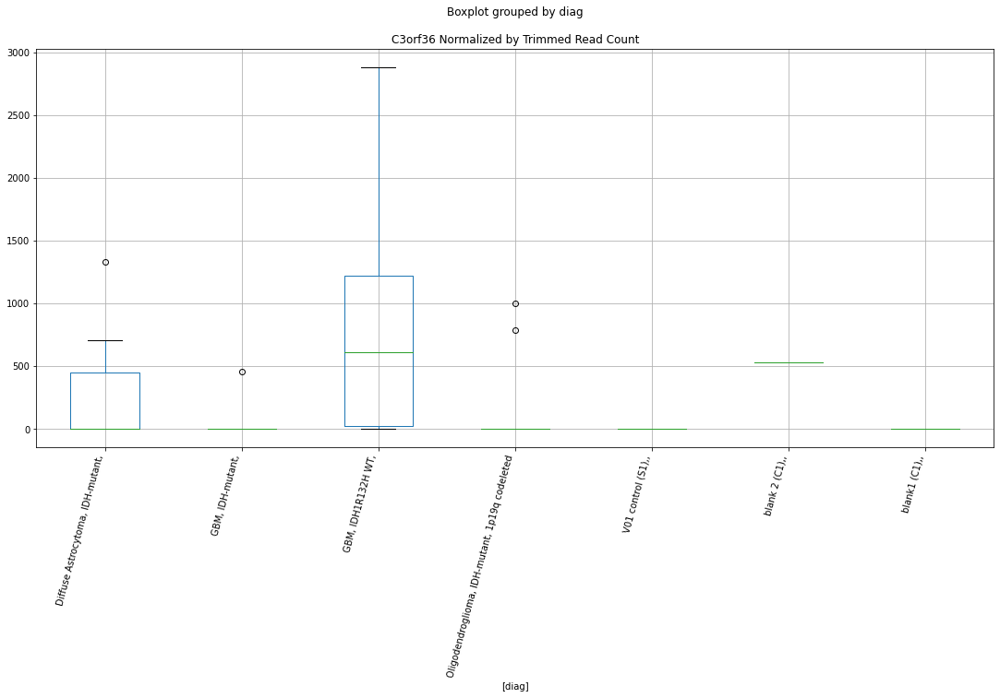

 p : 0.022090826426343826  ( t : 2.504705539599692 ) :  D-plex  :  cutadapt2  :  CHDH
Control and blanks
76     356836.29
340         0.00
Name: CHDH, dtype: float64
208    54495.31
Name: CHDH, dtype: float64
472    13870.94
Name: CHDH, dtype: float64


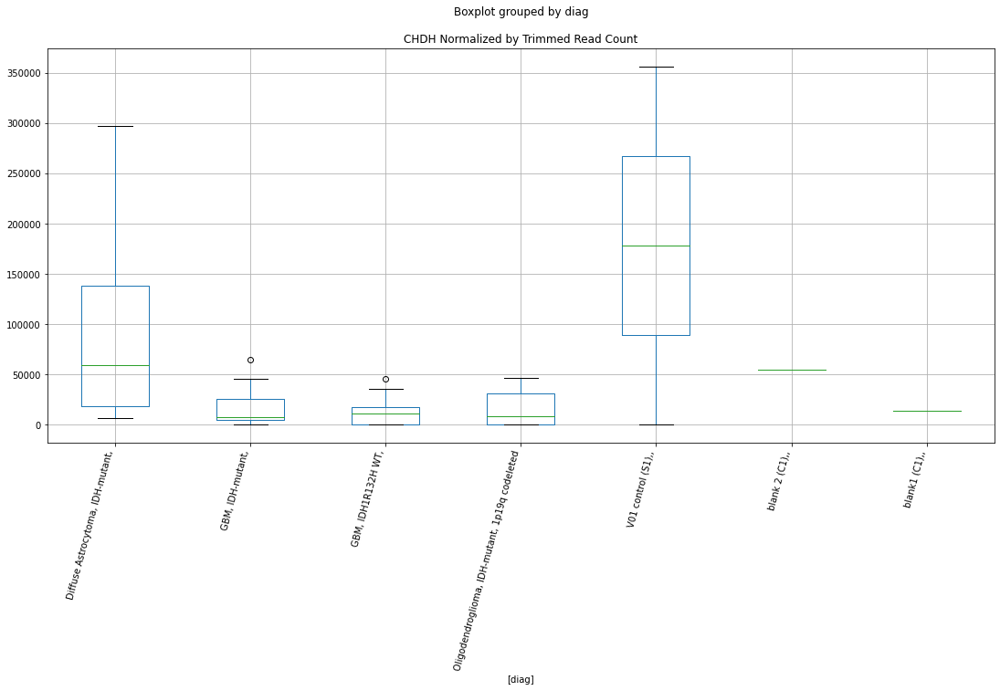

 p : 0.022094950411328113  ( t : 2.504615787406402 ) :  D-plex  :  bbduk2  :  CCDC144CP
Control and blanks
73     0.0
337    0.0
Name: CCDC144CP, dtype: float64
205    358.18
Name: CCDC144CP, dtype: float64
469    591.53
Name: CCDC144CP, dtype: float64


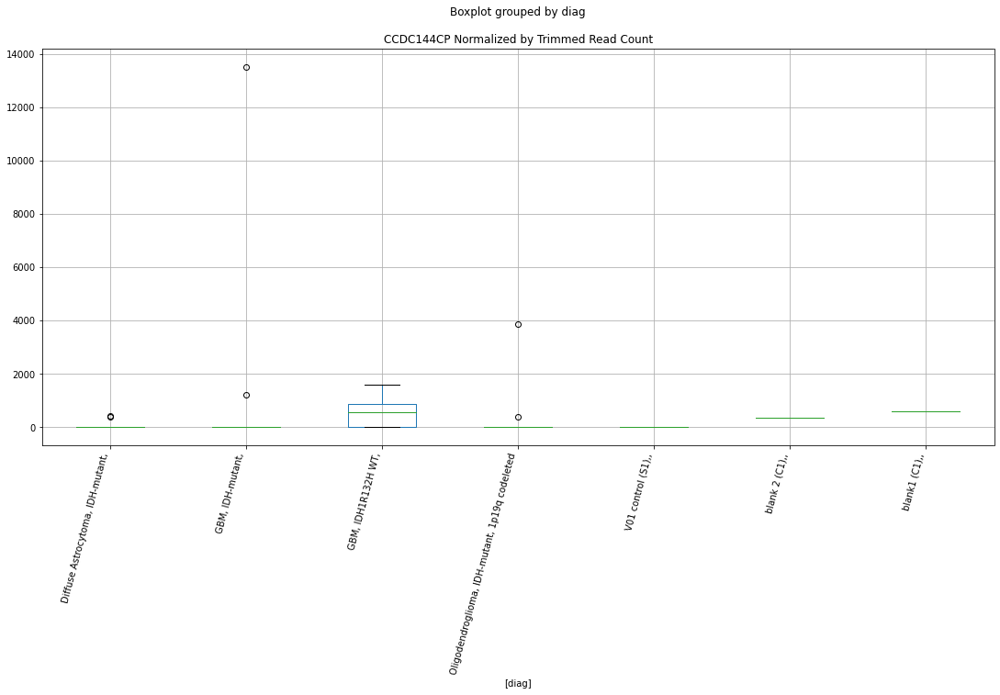

 p : 0.022322627335418076  ( t : 2.4996850862466387 ) :  D-plex  :  bbduk2  :  CPT1C
Control and blanks
73     4.33e+04
337    1.84e+06
Name: CPT1C, dtype: float64
205    245712.79
Name: CPT1C, dtype: float64
469    191063.32
Name: CPT1C, dtype: float64


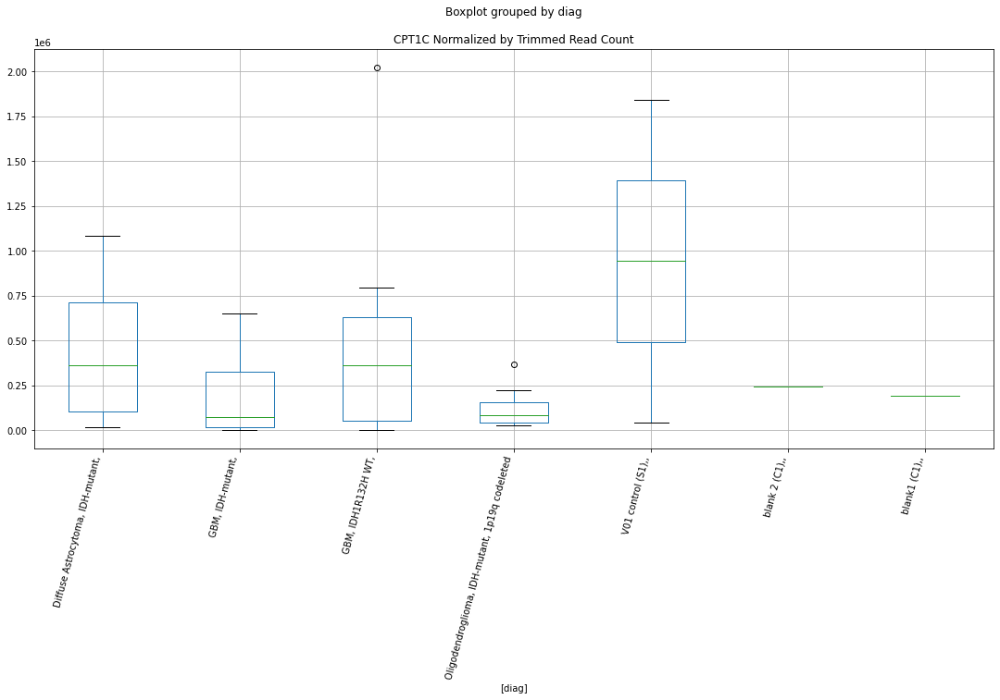

 p : 0.022338452810584327  ( t : 2.499344124756919 ) :  Lexogen  :  bbduk2  :  A3GALT2
Control and blanks
79       0.00
343    212.31
Name: A3GALT2, dtype: float64
211    0.0
Name: A3GALT2, dtype: float64
475    0.0
Name: A3GALT2, dtype: float64


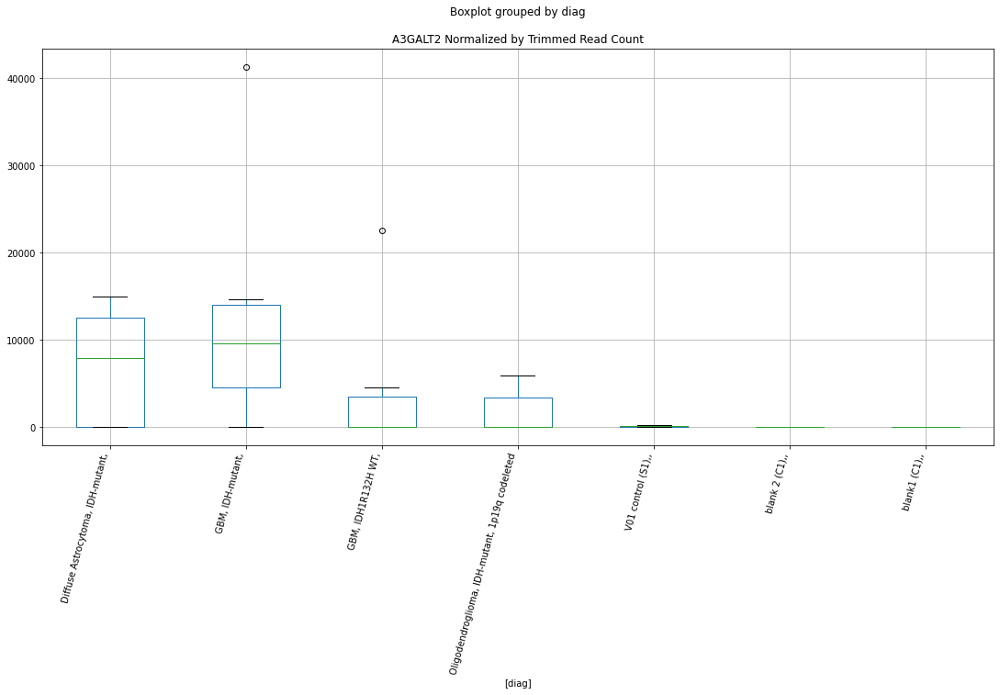

 p : 0.022339586494779014  ( t : 2.499319708151901 ) :  D-plex  :  cutadapt2  :  CCDC144CP
Control and blanks
76     0.0
340    0.0
Name: CCDC144CP, dtype: float64
208    352.72
Name: CCDC144CP, dtype: float64
472    577.96
Name: CCDC144CP, dtype: float64


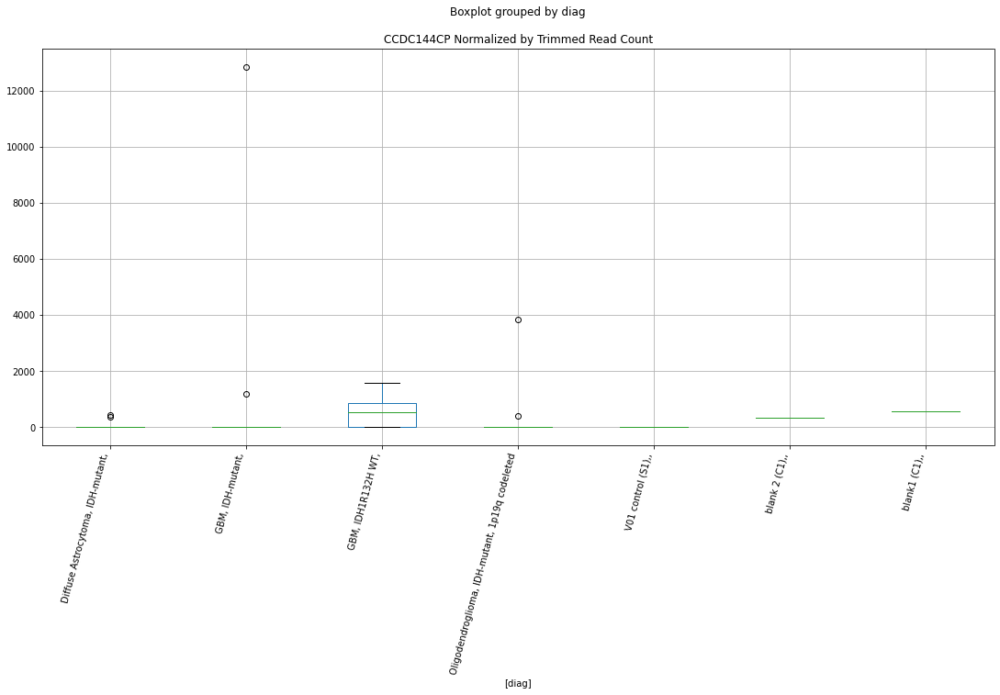

 p : 0.022350952197394584  ( t : 2.499074985026152 ) :  Lexogen  :  bbduk2  :  AOPEP
Control and blanks
79      17167.19
343    172823.85
Name: AOPEP, dtype: float64
211    0.0
Name: AOPEP, dtype: float64
475    1437.09
Name: AOPEP, dtype: float64


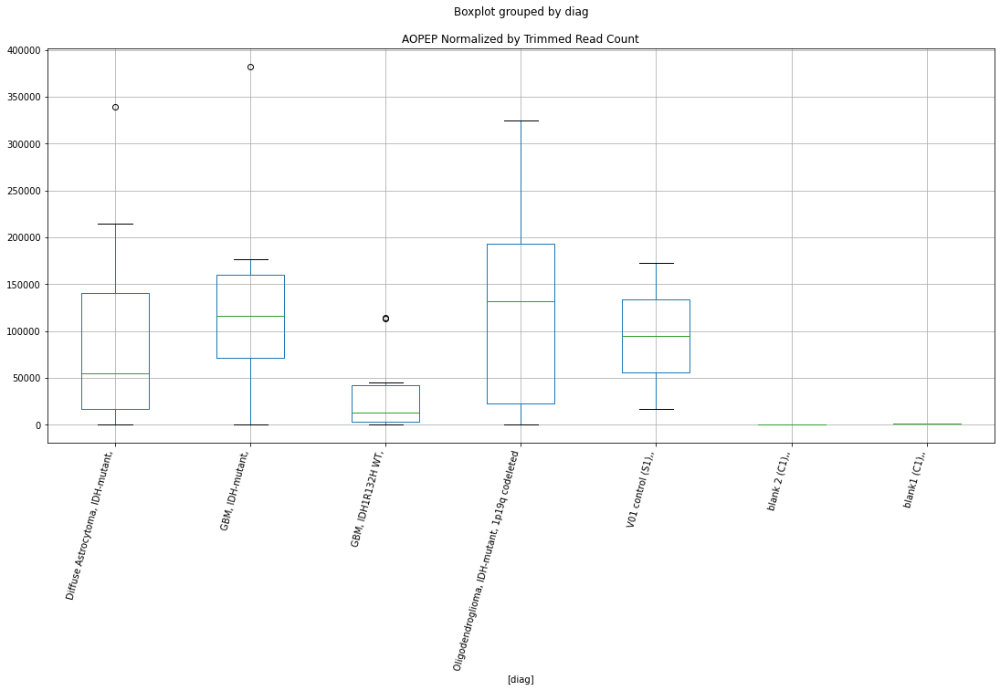

 p : 0.02235927986255779  ( t : 2.498895750494735 ) :  D-plex  :  cutadapt2  :  AOX3P-AOX2P
Control and blanks
76     0.0
340    0.0
Name: AOX3P-AOX2P, dtype: float64
208    1410.88
Name: AOX3P-AOX2P, dtype: float64
472    3467.74
Name: AOX3P-AOX2P, dtype: float64


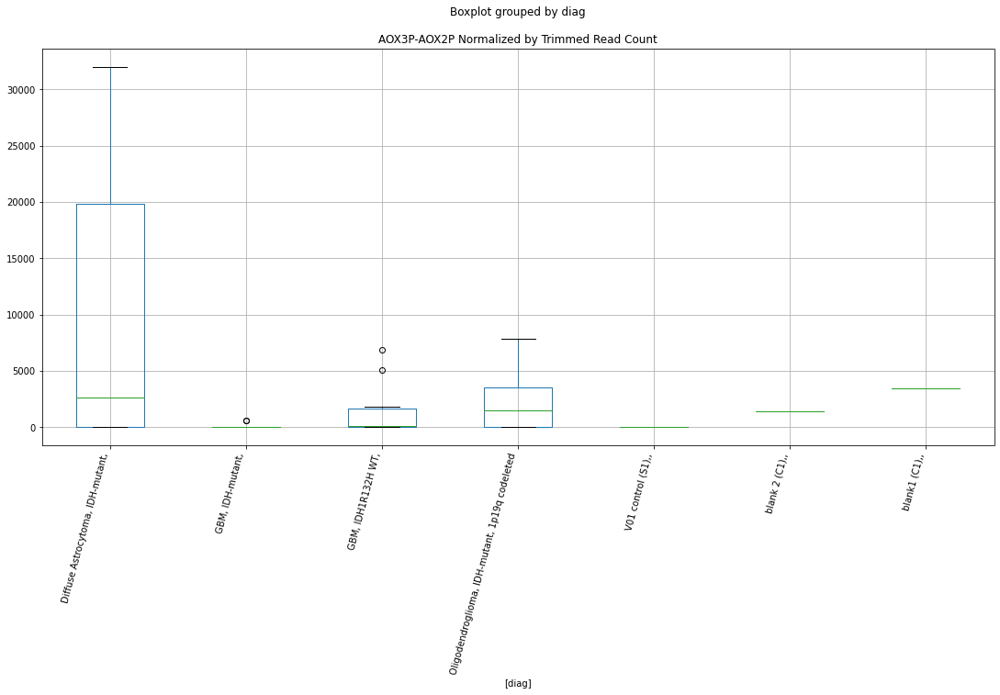

 p : 0.022404620054356245  ( t : 2.4979210054951553 ) :  D-plex  :  bbduk2  :  CTDSPL2
Control and blanks
73      1546.02
337    18693.30
Name: CTDSPL2, dtype: float64
205    18446.37
Name: CTDSPL2, dtype: float64
469    4140.69
Name: CTDSPL2, dtype: float64


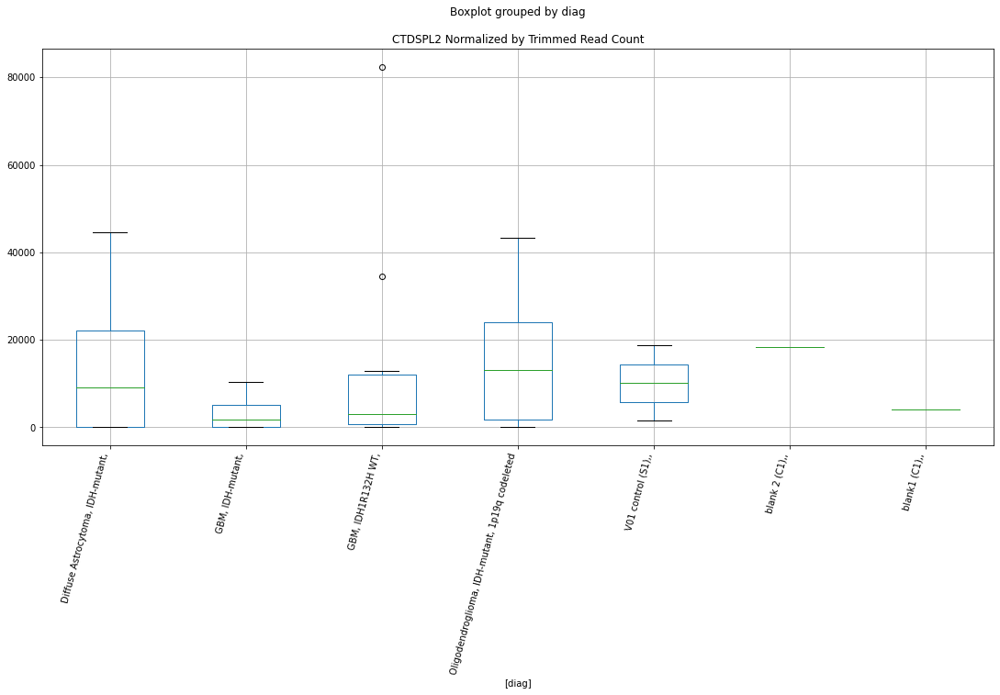

 p : 0.022526509051545077  ( t : 2.495309762590077 ) :  Lexogen  :  cutadapt2  :  ARMC3
Control and blanks
82     1.23e+06
346    5.41e+05
Name: ARMC3, dtype: float64
214    148089.64
Name: ARMC3, dtype: float64
478    359040.25
Name: ARMC3, dtype: float64


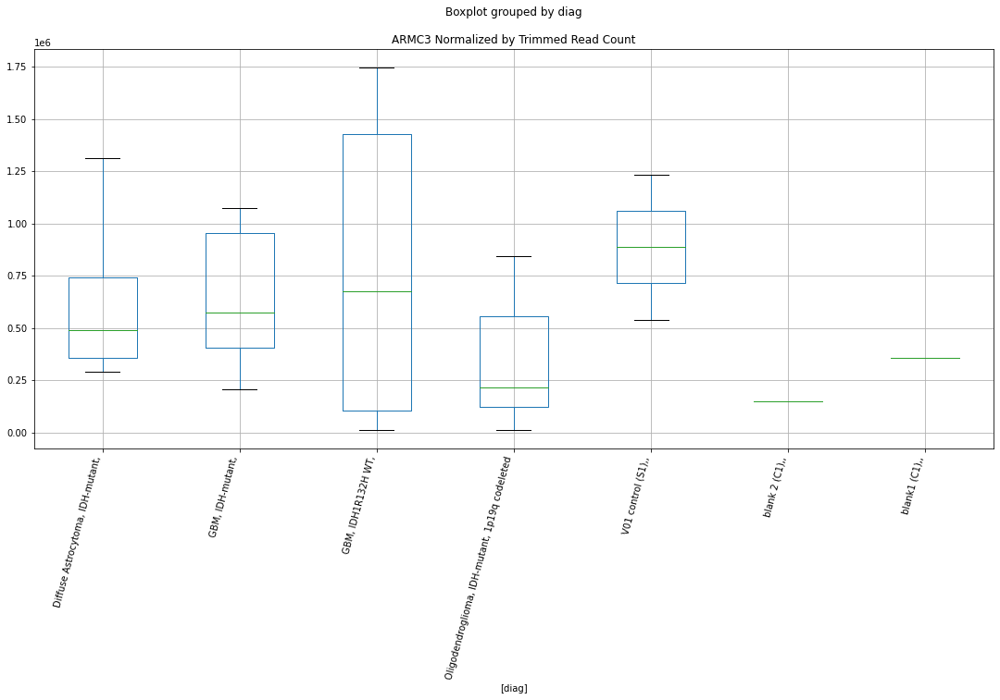

 p : 0.022728146917387754  ( t : 2.491019129185969 ) :  D-plex  :  bbduk2  :  APLF
Control and blanks
73     0.0
337    0.0
Name: APLF, dtype: float64
205    1432.73
Name: APLF, dtype: float64
469    591.53
Name: APLF, dtype: float64


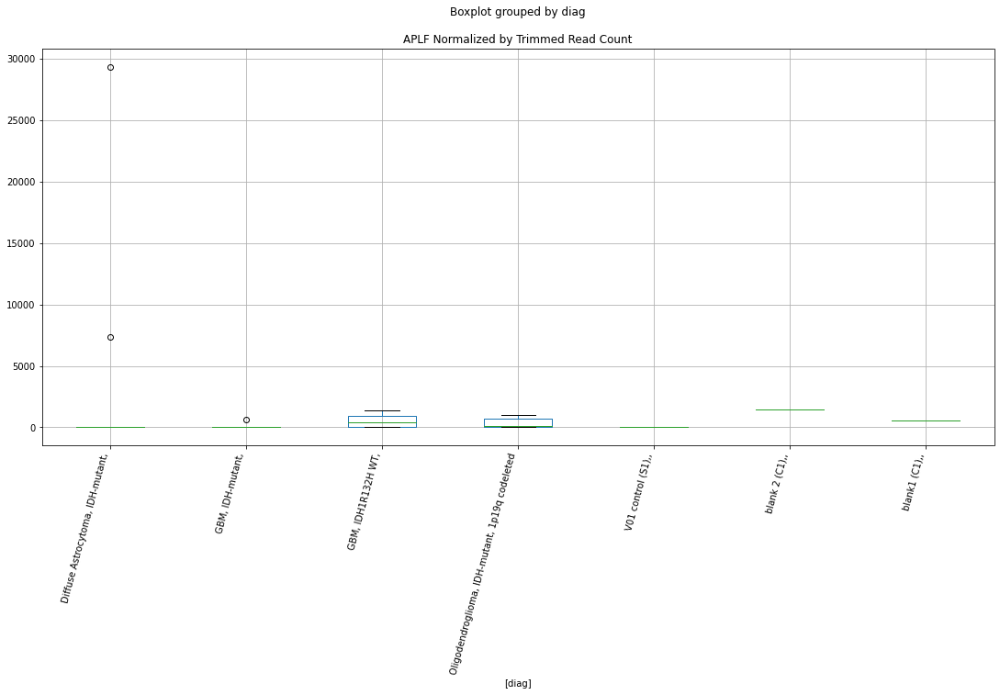

 p : 0.02272825588583089  ( t : 2.49101682016403 ) :  D-plex  :  bbduk2  :  ARHGAP26
Control and blanks
73     0.0
337    0.0
Name: ARHGAP26, dtype: float64
205    23102.73
Name: ARHGAP26, dtype: float64
469    0.0
Name: ARHGAP26, dtype: float64


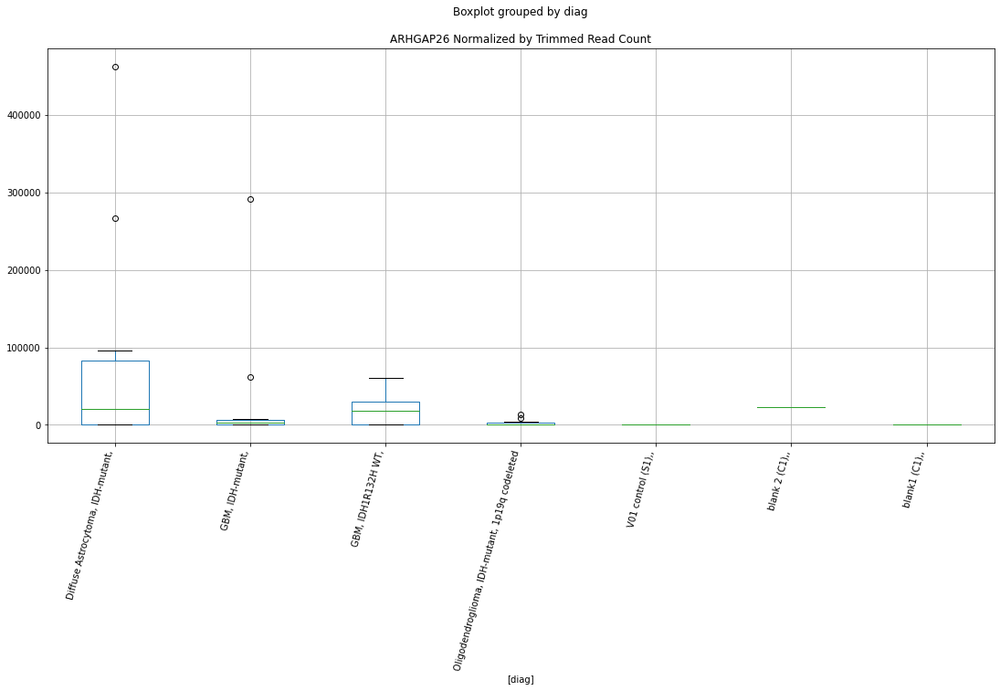

 p : 0.022754420730244352  ( t : 2.490462693311378 ) :  Lexogen  :  cutadapt2  :  ARHGEF37
Control and blanks
82     0.0
346    0.0
Name: ARHGEF37, dtype: float64
214    0.0
Name: ARHGEF37, dtype: float64
478    0.0
Name: ARHGEF37, dtype: float64


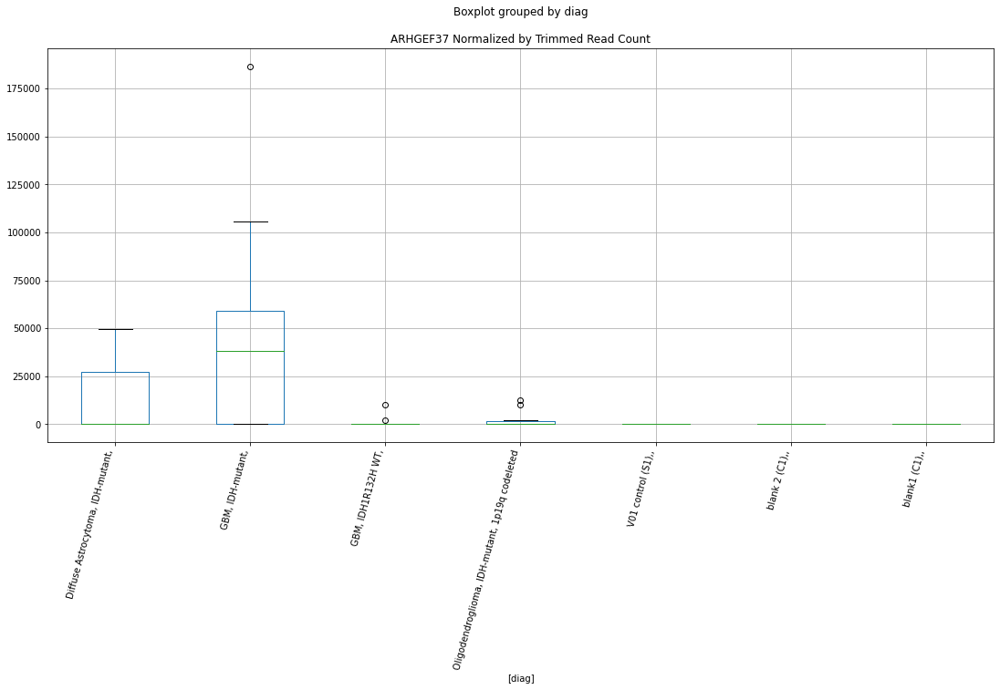

 p : 0.022831709493301384  ( t : 2.4888293457622472 ) :  Lexogen  :  cutadapt2  :  DCTN1-AS1
Control and blanks
82      4260.15
346    49872.98
Name: DCTN1-AS1, dtype: float64
214    1627.36
Name: DCTN1-AS1, dtype: float64
478    17809.54
Name: DCTN1-AS1, dtype: float64


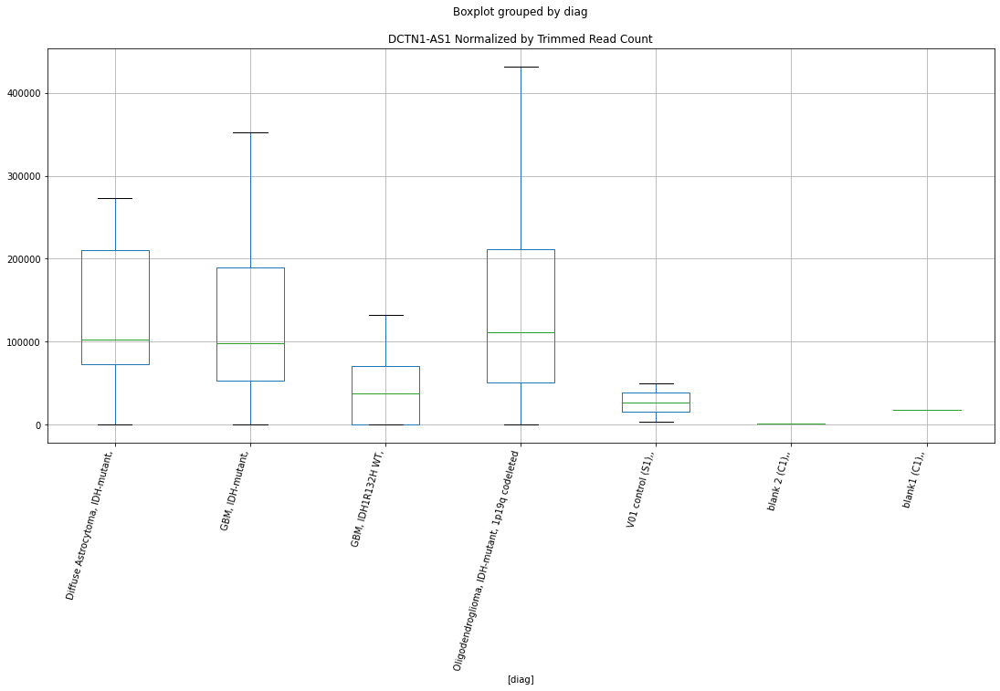

 p : 0.02289500095100852  ( t : 2.4874956765123217 ) :  D-plex  :  cutadapt2  :  CEP250
Control and blanks
76      3030.46
340    12330.25
Name: CEP250, dtype: float64
208    25043.15
Name: CEP250, dtype: float64
472    64731.05
Name: CEP250, dtype: float64


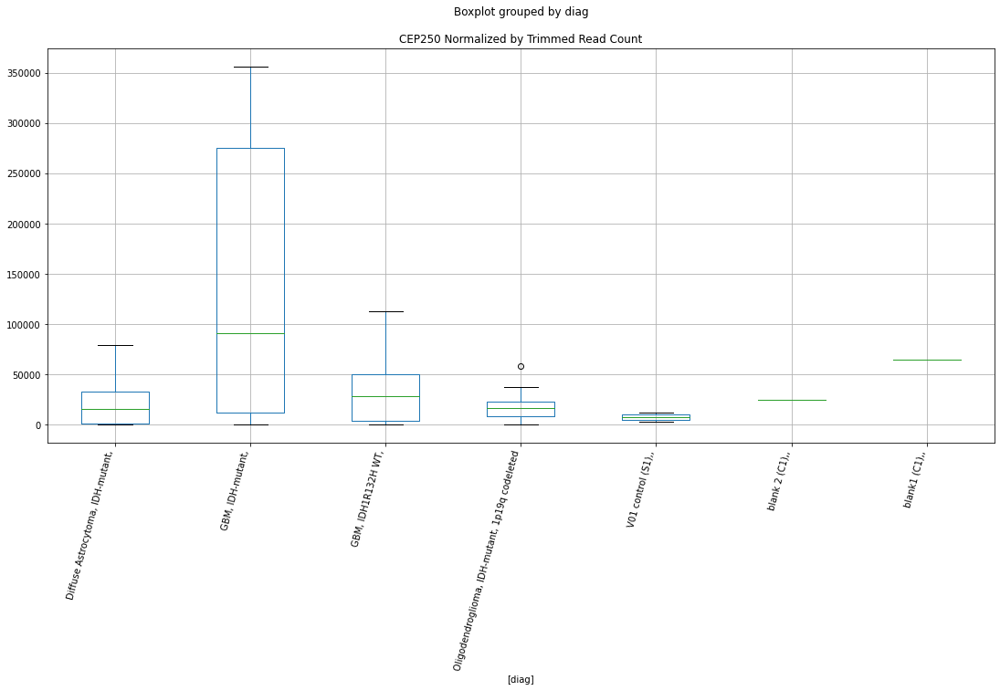

 p : 0.023001426484255617  ( t : 2.4852608972337613 ) :  Lexogen  :  cutadapt2  :  ASB16
Control and blanks
82     0.0
346    0.0
Name: ASB16, dtype: float64
214    0.0
Name: ASB16, dtype: float64
478    0.0
Name: ASB16, dtype: float64


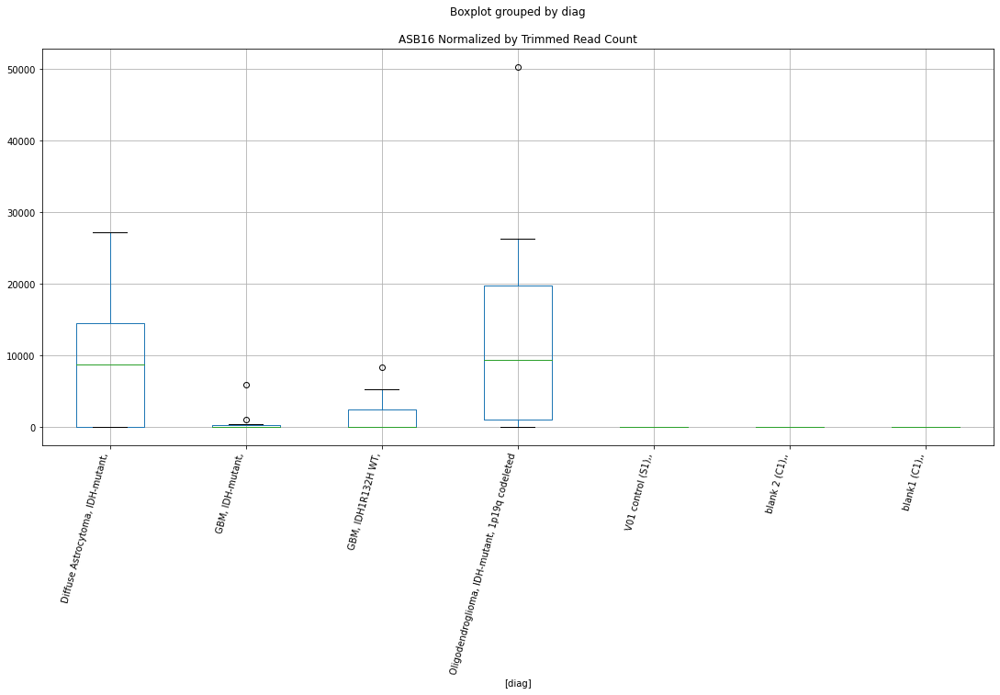

 p : 0.023053935816235275  ( t : 2.484161862237307 ) :  D-plex  :  bbduk2  :  CH507-42P11.6
Control and blanks
73     2319.03
337       0.00
Name: CH507-42P11.6, dtype: float64
205    12178.18
Name: CH507-42P11.6, dtype: float64
469    10647.49
Name: CH507-42P11.6, dtype: float64


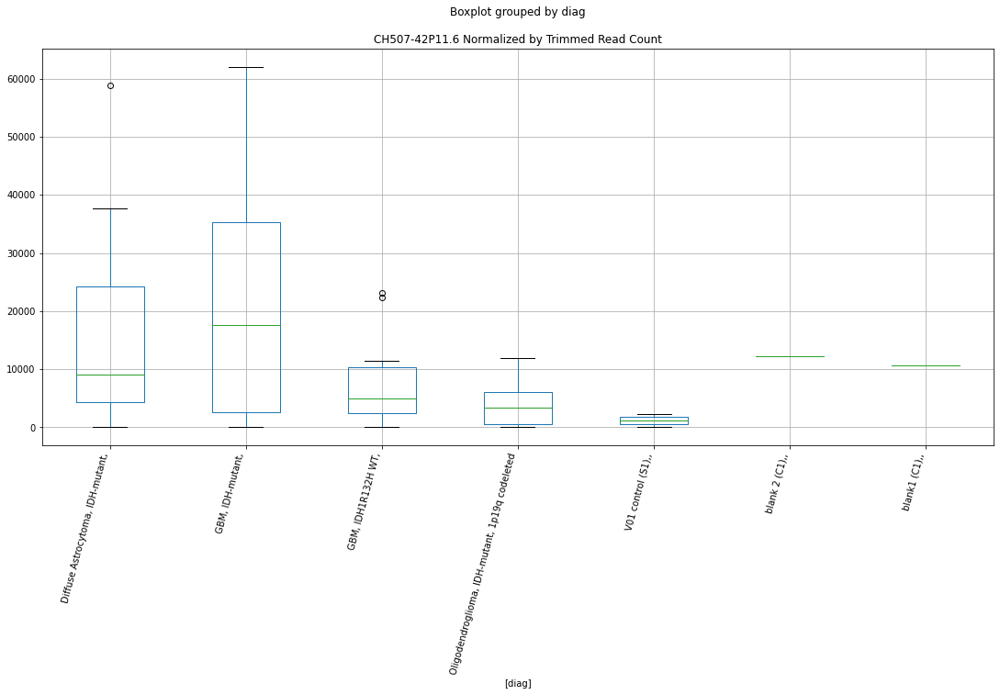

 p : 0.023115087442486363  ( t : 2.482884907388013 ) :  D-plex  :  bbduk2  :  DIS3L2
Control and blanks
73          0.00
337    115720.44
Name: DIS3L2, dtype: float64
205    1970.0
Name: DIS3L2, dtype: float64
469    2957.64
Name: DIS3L2, dtype: float64


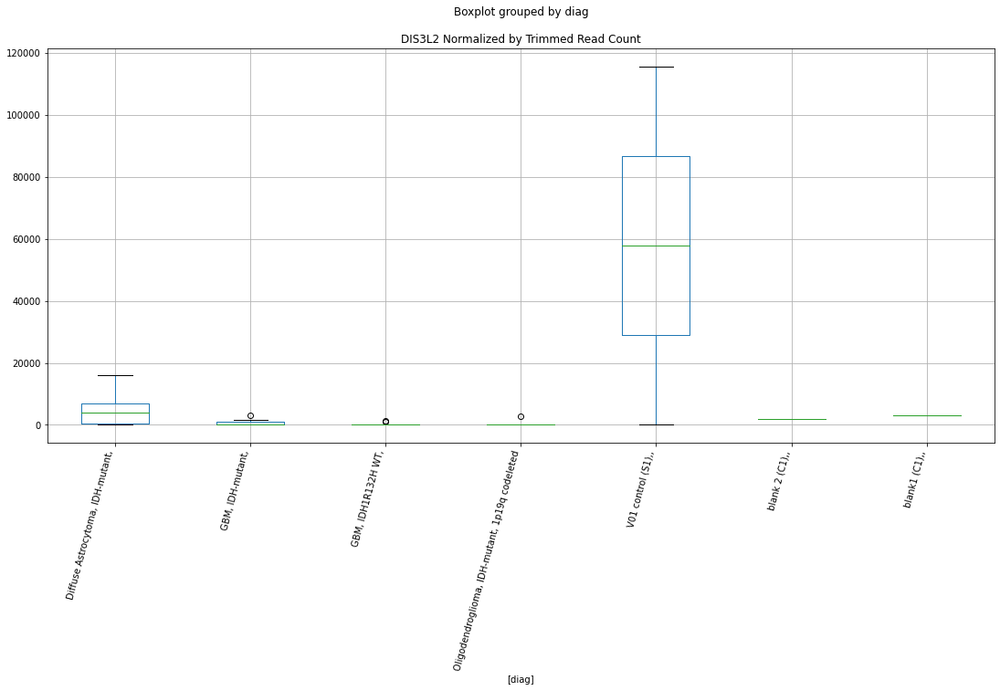

 p : 0.023211134277660805  ( t : 2.480885682460735 ) :  D-plex  :  bbduk2  :  ACADSB
Control and blanks
73     0.0
337    0.0
Name: ACADSB, dtype: float64
205    716.36
Name: ACADSB, dtype: float64
469    0.0
Name: ACADSB, dtype: float64


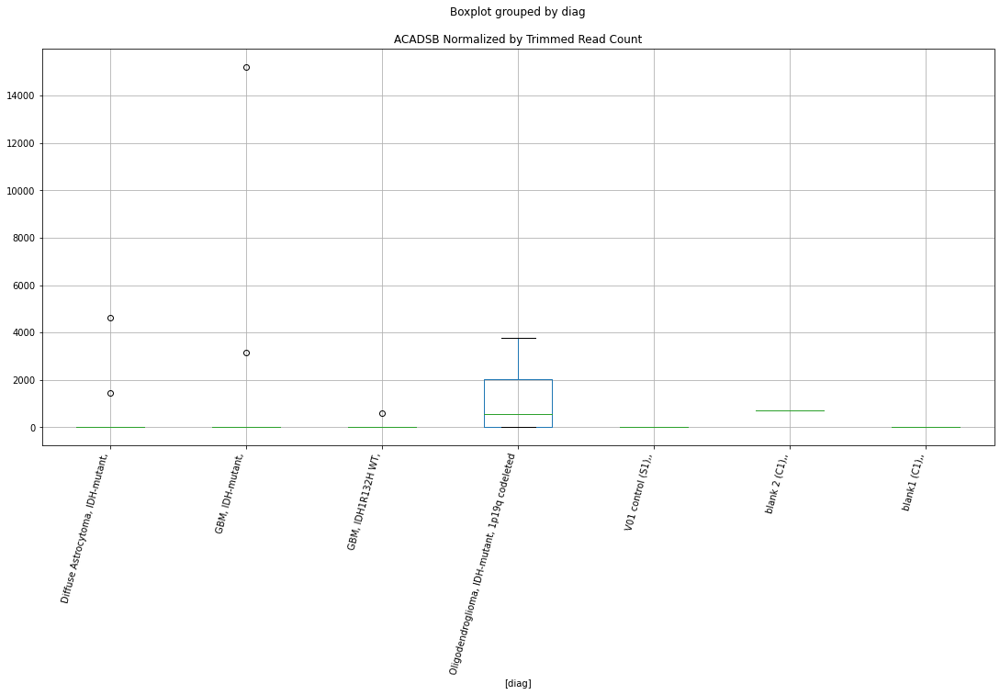

 p : 0.023241441628456167  ( t : 2.4802564474069504 ) :  Lexogen  :  bbduk2  :  ARAF
Control and blanks
79     0.0
343    0.0
Name: ARAF, dtype: float64
211    0.0
Name: ARAF, dtype: float64
475    0.0
Name: ARAF, dtype: float64


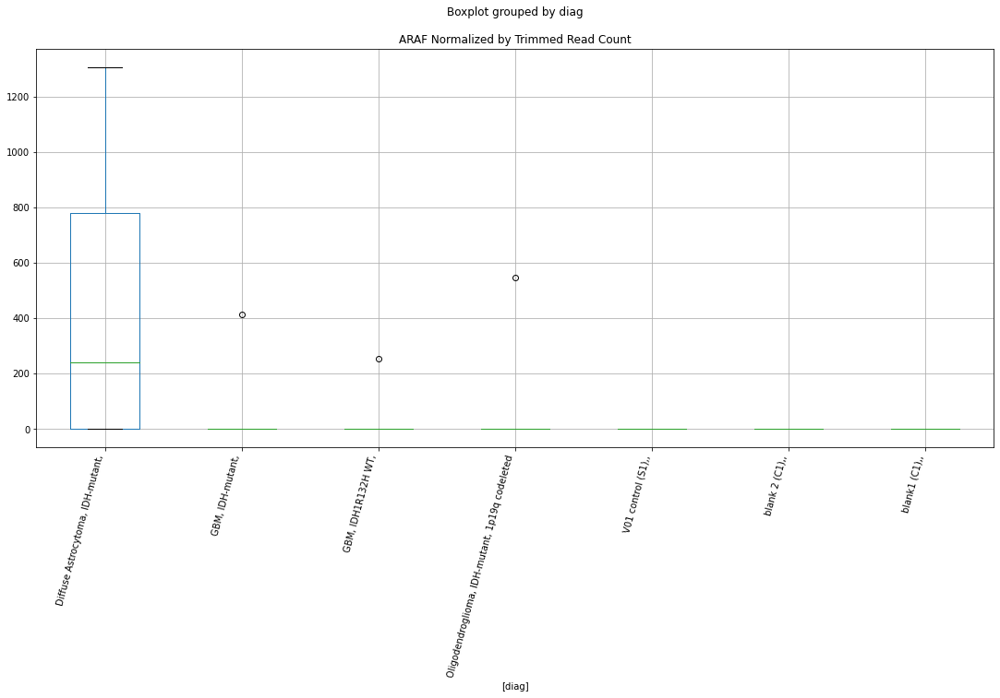

 p : 0.023267989840648144  ( t : 2.4797058928758804 ) :  Lexogen  :  bbduk2  :  DCTN1-AS1
Control and blanks
79      4291.80
343    50318.49
Name: DCTN1-AS1, dtype: float64
211    1639.84
Name: DCTN1-AS1, dtype: float64
475    17963.68
Name: DCTN1-AS1, dtype: float64


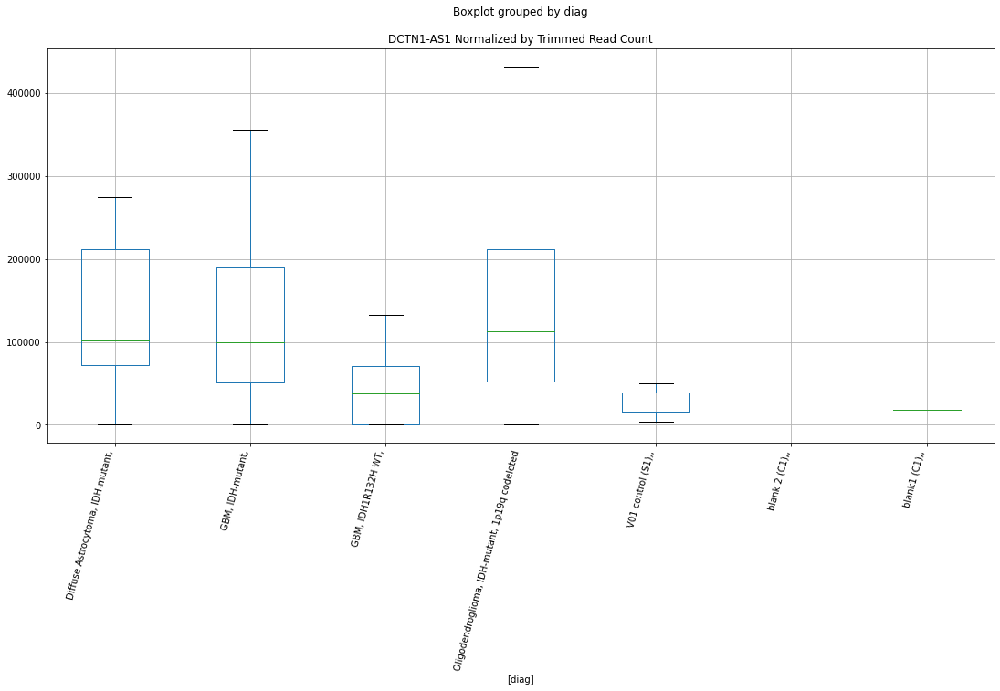

 p : 0.02333153529616008  ( t : 2.478390489410316 ) :  D-plex  :  bbduk2  :  AHCTF1
Control and blanks
73     2319.03
337       0.00
Name: AHCTF1, dtype: float64
205    537.27
Name: AHCTF1, dtype: float64
469    15971.24
Name: AHCTF1, dtype: float64


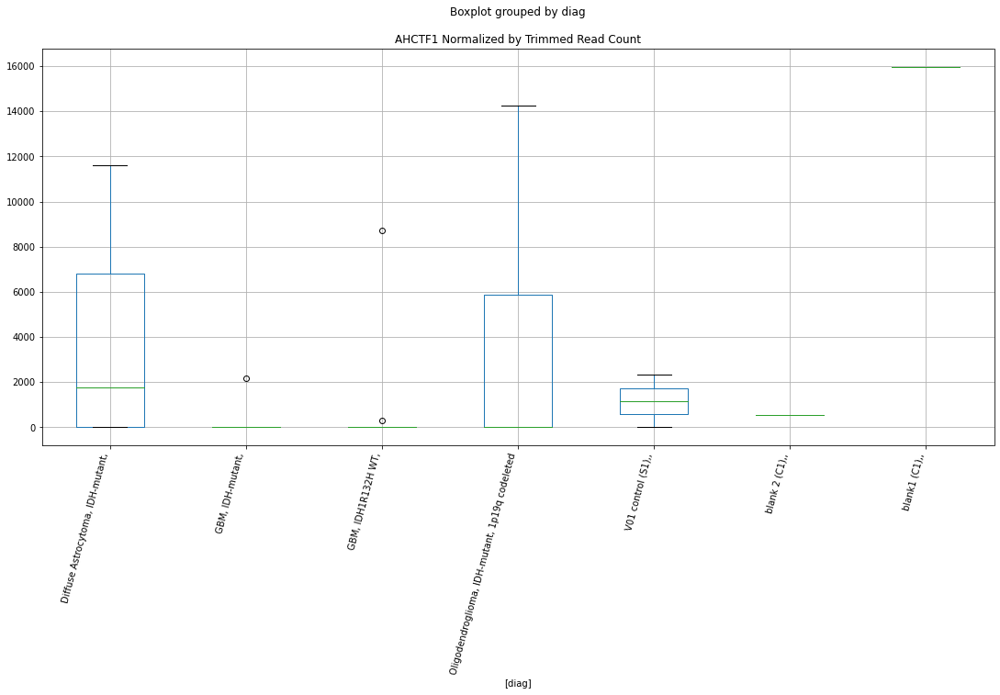

 p : 0.023353562169214227  ( t : 2.477935315374329 ) :  D-plex  :  bbduk2  :  BRIP1
Control and blanks
73     989450.75
337    142425.16
Name: BRIP1, dtype: float64
205    275620.98
Name: BRIP1, dtype: float64
469    350184.17
Name: BRIP1, dtype: float64


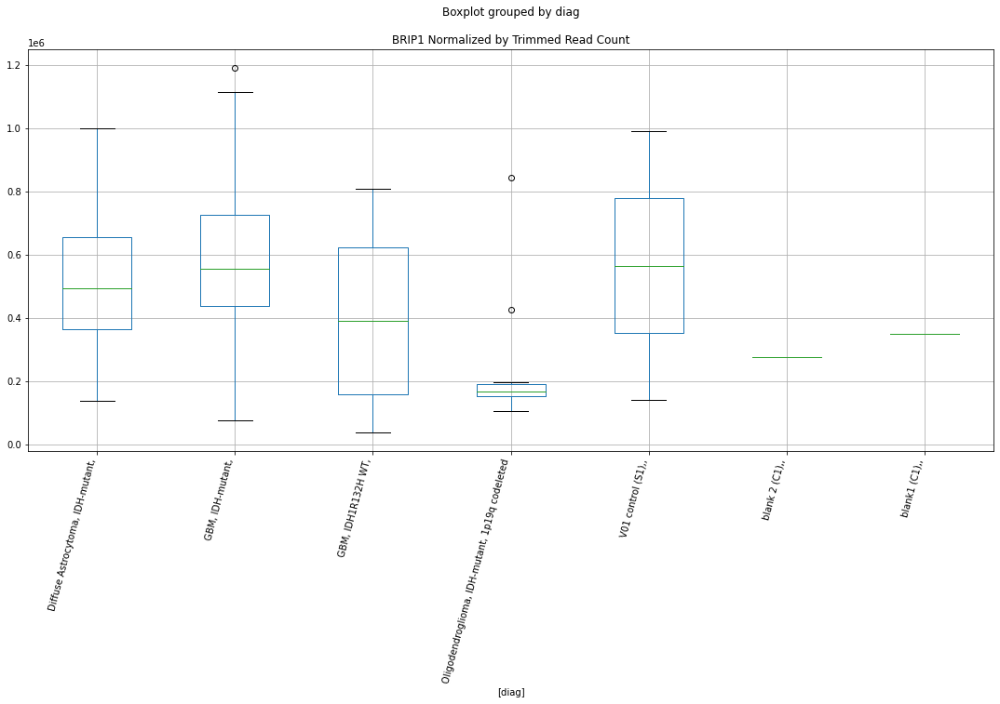

 p : 0.023376472324040838  ( t : 2.477462317084101 ) :  D-plex  :  cutadapt2  :  CELSR2
Control and blanks
76     68185.28
340        0.00
Name: CELSR2, dtype: float64
208    5290.81
Name: CELSR2, dtype: float64
472    6935.47
Name: CELSR2, dtype: float64


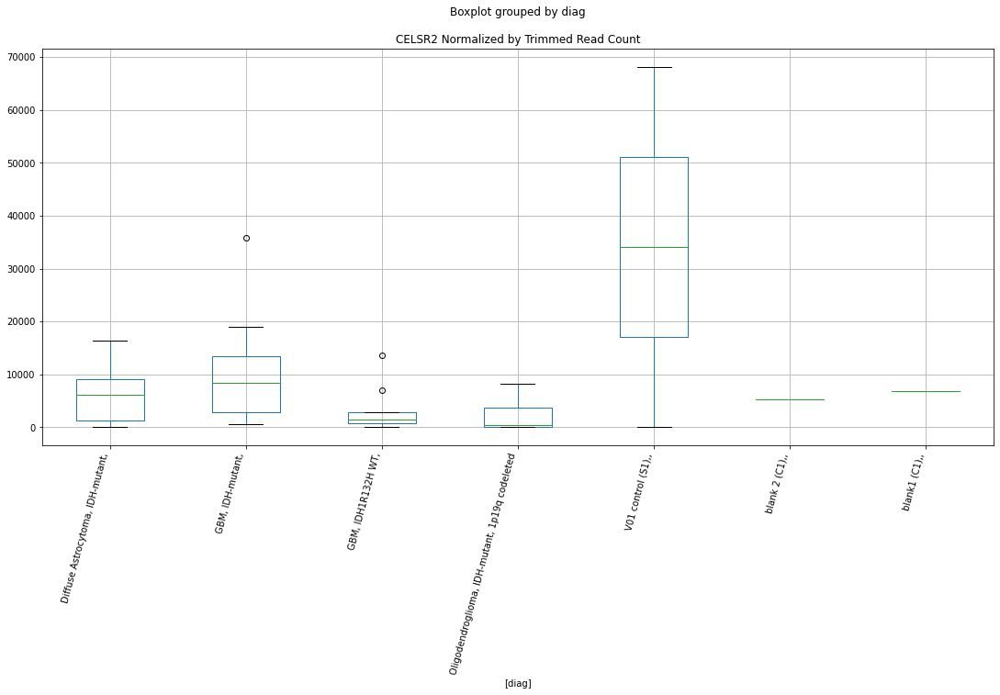

 p : 0.023490803854112504  ( t : 2.475108350862586 ) :  Lexogen  :  cutadapt2  :  A3GALT2
Control and blanks
82       0.00
346    210.43
Name: A3GALT2, dtype: float64
214    0.0
Name: A3GALT2, dtype: float64
478    0.0
Name: A3GALT2, dtype: float64


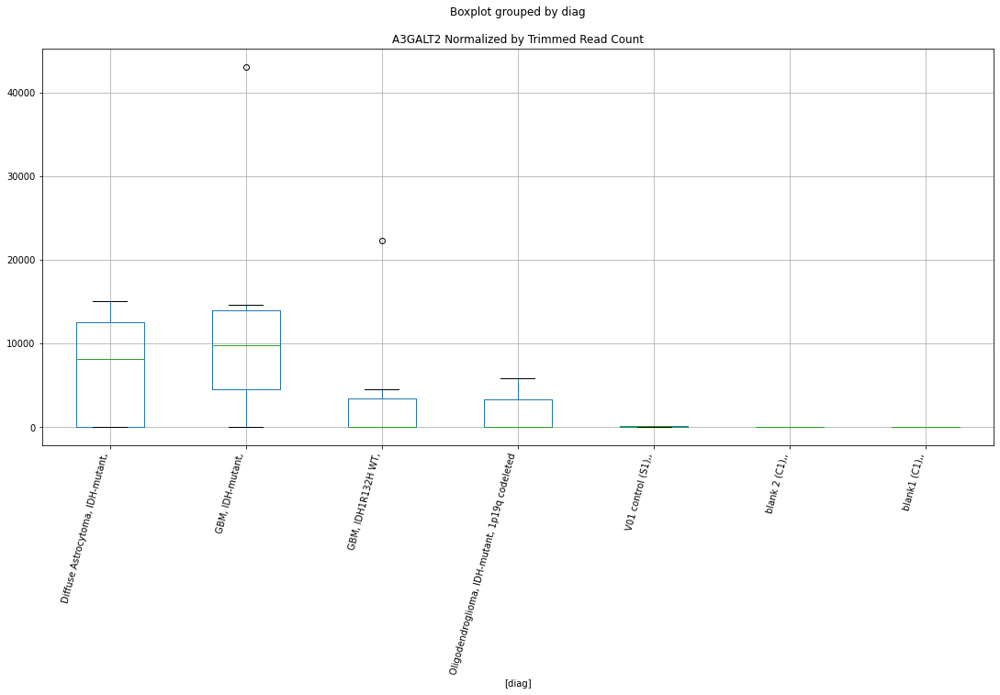

 p : 0.023514098646209985  ( t : 2.4746300573772024 ) :  D-plex  :  bbduk2  :  CASD1
Control and blanks
73     0.0
337    0.0
Name: CASD1, dtype: float64
205    2149.09
Name: CASD1, dtype: float64
469    0.0
Name: CASD1, dtype: float64


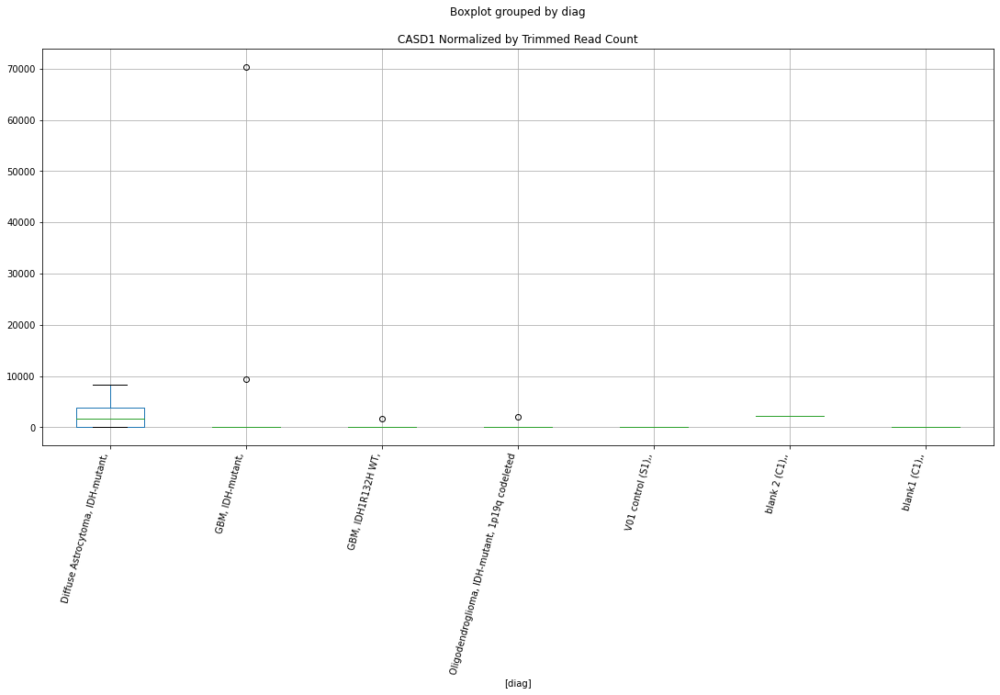

 p : 0.02361821643022581  ( t : 2.4724977221534266 ) :  Lexogen  :  bbduk2  :  AOPEP
Control and blanks
79      17167.19
343    172823.85
Name: AOPEP, dtype: float64
211    0.0
Name: AOPEP, dtype: float64
475    1437.09
Name: AOPEP, dtype: float64


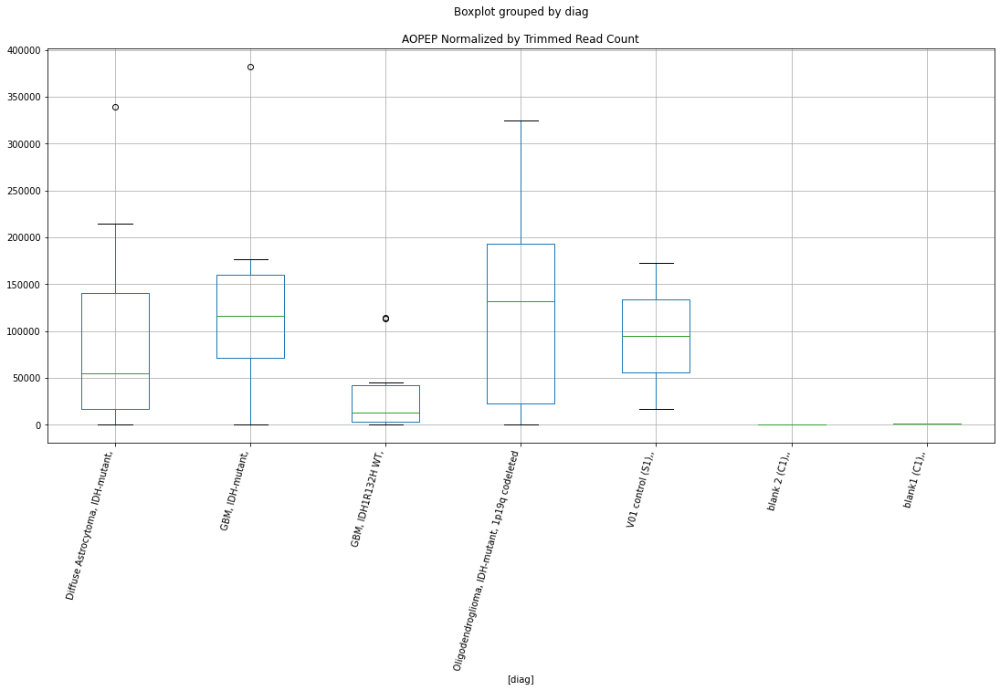

 p : 0.023629618908917932  ( t : 2.4722647363946364 ) :  Lexogen  :  bbduk2  :  ASB16
Control and blanks
79     0.0
343    0.0
Name: ASB16, dtype: float64
211    0.0
Name: ASB16, dtype: float64
475    0.0
Name: ASB16, dtype: float64


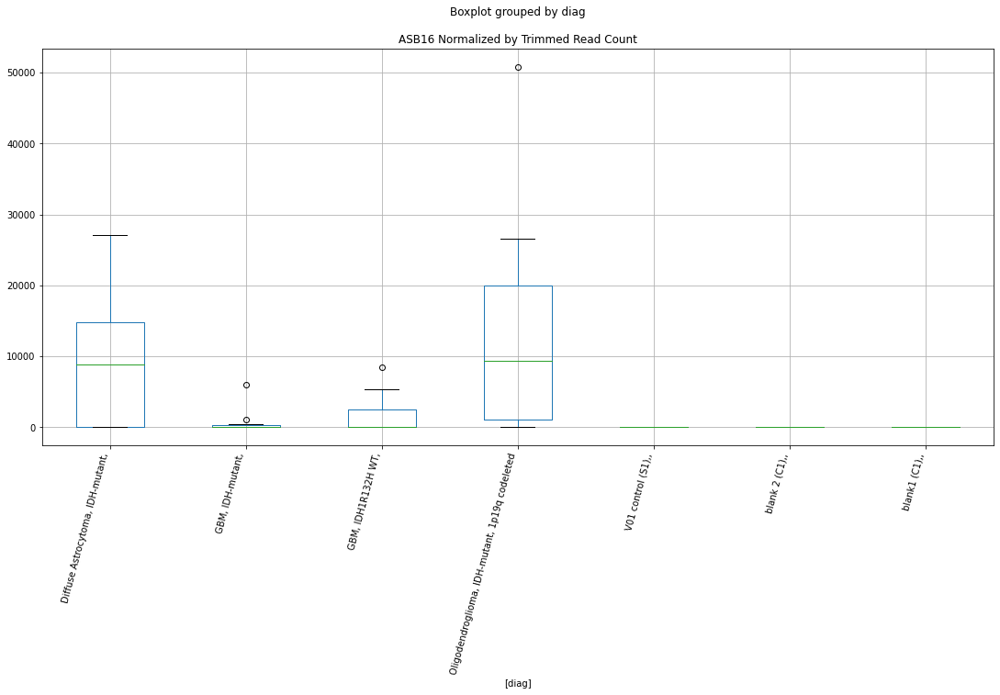

 p : 0.023685289820874884  ( t : 2.4711287339315575 ) :  Lexogen  :  cutadapt2  :  AOPEP
Control and blanks
82      17040.61
346    173398.05
Name: AOPEP, dtype: float64
214    0.0
Name: AOPEP, dtype: float64
478    1424.76
Name: AOPEP, dtype: float64


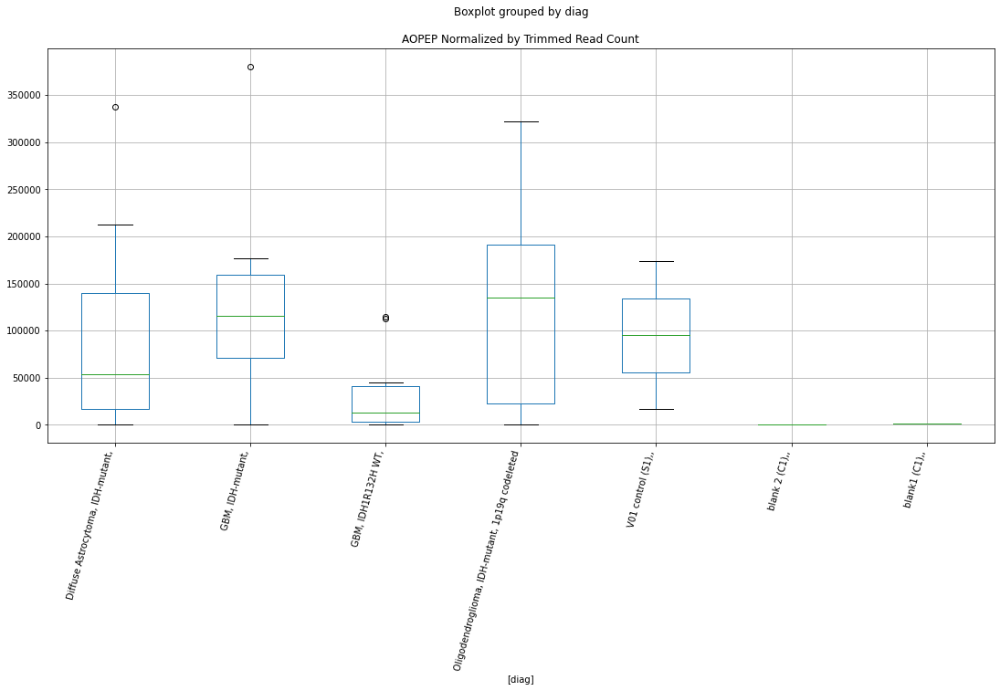

 p : 0.02383133224983726  ( t : 2.468160528986751 ) :  Lexogen  :  bbduk2  :  ARMC3
Control and blanks
79     1.24e+06
343    5.41e+05
Name: ARMC3, dtype: float64
211    149225.26
Name: ARMC3, dtype: float64
475    360471.18
Name: ARMC3, dtype: float64


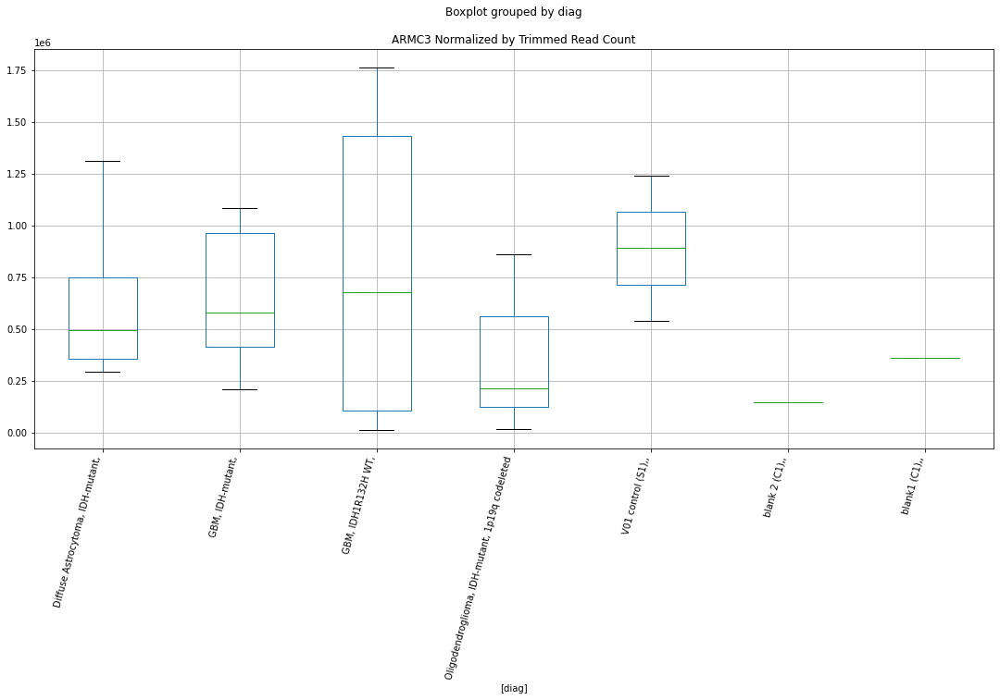

 p : 0.023883920052142814  ( t : 2.4670959066522213 ) :  D-plex  :  cutadapt2  :  CH507-42P11.6
Control and blanks
76     0.0
340    0.0
Name: CH507-42P11.6, dtype: float64
208    5114.45
Name: CH507-42P11.6, dtype: float64
472    8669.34
Name: CH507-42P11.6, dtype: float64


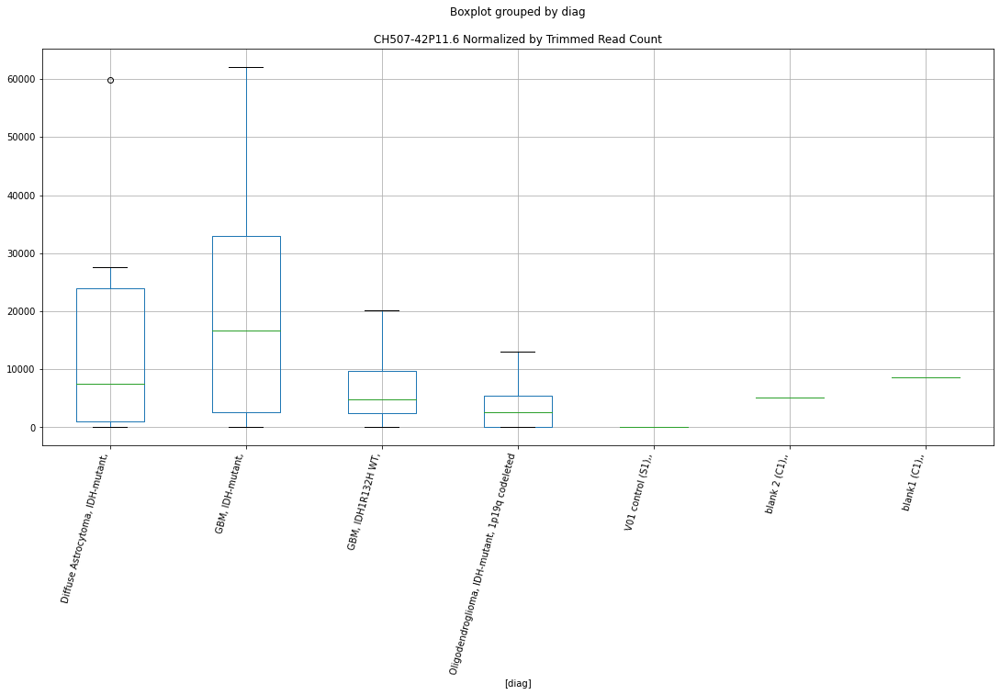

 p : 0.023974407351277236  ( t : 2.4652691687974304 ) :  D-plex  :  bbduk2  :  BAHCC1
Control and blanks
73     0.0
337    0.0
Name: BAHCC1, dtype: float64
205    3223.64
Name: BAHCC1, dtype: float64
469    0.0
Name: BAHCC1, dtype: float64


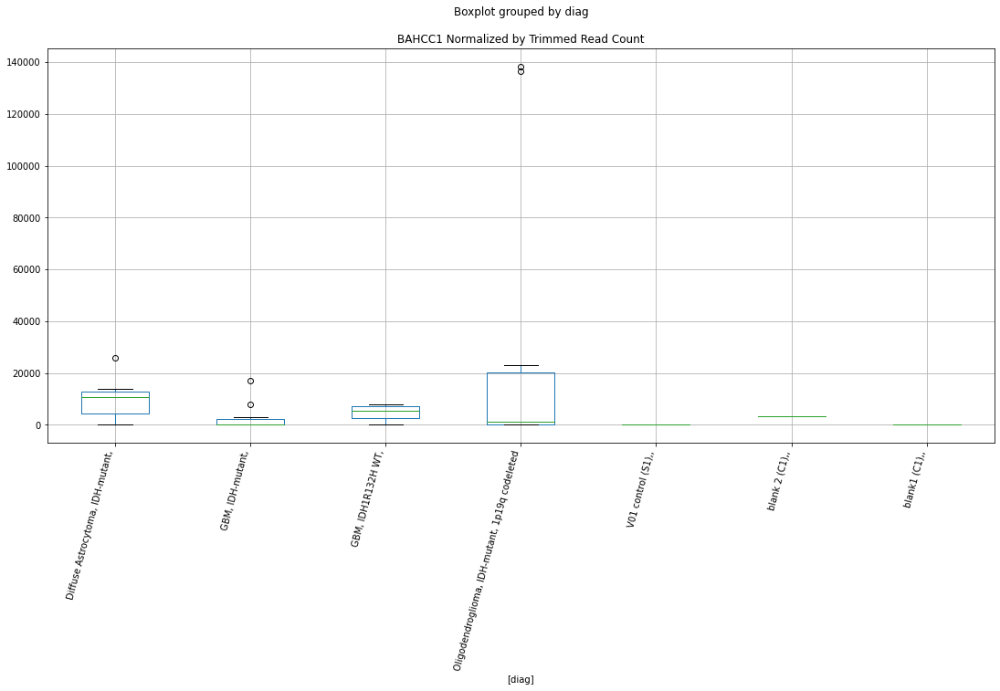

 p : 0.024157393117786596  ( t : 2.461594809269343 ) :  D-plex  :  bbduk2  :  CBLL1
Control and blanks
73     278283.02
337         0.00
Name: CBLL1, dtype: float64
205    6268.18
Name: CBLL1, dtype: float64
469    11239.02
Name: CBLL1, dtype: float64


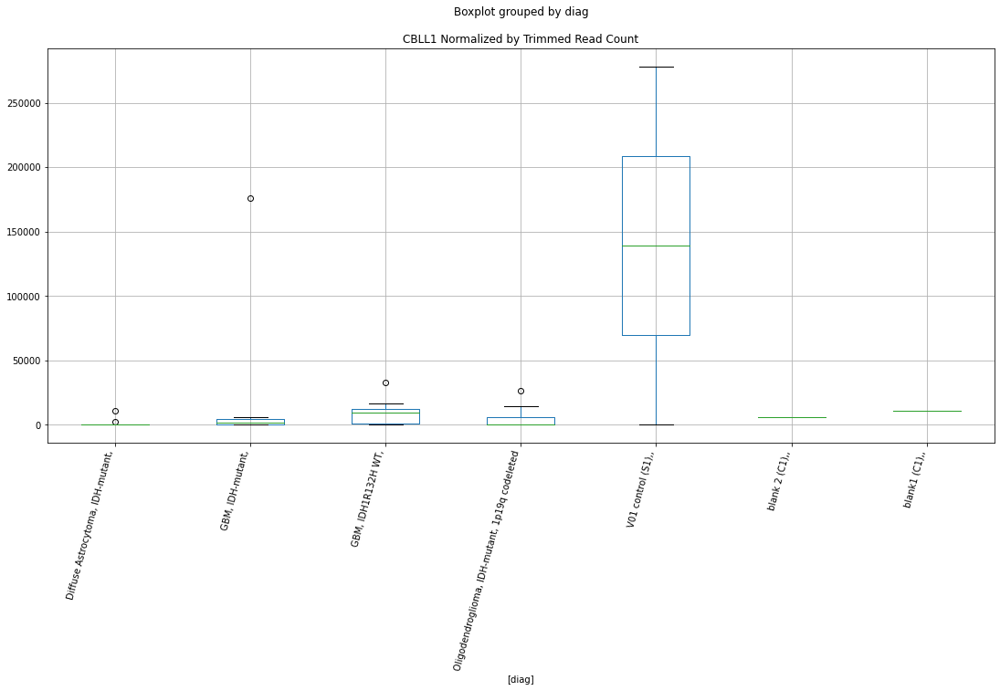

 p : 0.024222716202811103  ( t : 2.460289451833935 ) :  D-plex  :  cutadapt2  :  B3GALNT2
Control and blanks
76     6060.91
340    8807.32
Name: B3GALNT2, dtype: float64
208    0.0
Name: B3GALNT2, dtype: float64
472    4623.65
Name: B3GALNT2, dtype: float64


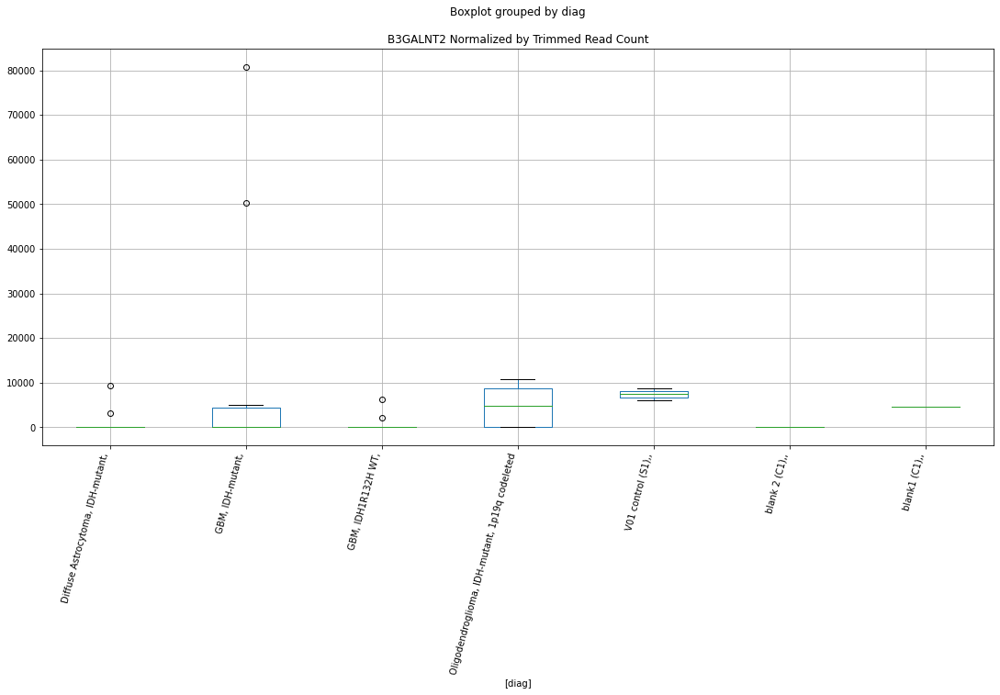

 p : 0.024291960871142486  ( t : 2.4589093351995577 ) :  Lexogen  :  bbduk2  :  ARHGEF37
Control and blanks
79     0.0
343    0.0
Name: ARHGEF37, dtype: float64
211    0.0
Name: ARHGEF37, dtype: float64
475    0.0
Name: ARHGEF37, dtype: float64


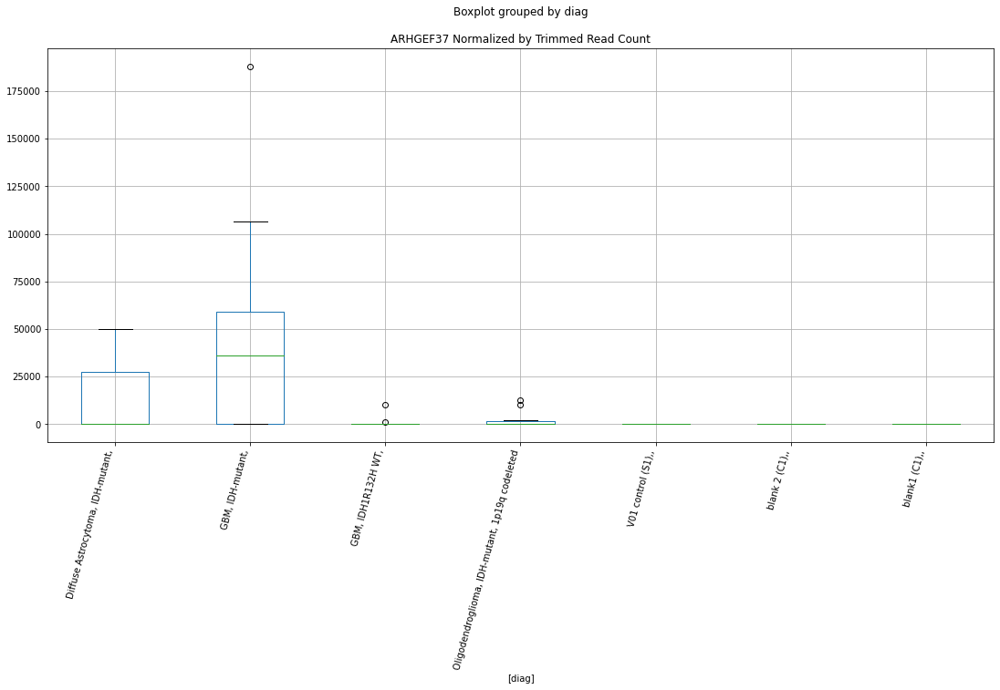

 p : 0.024590438861127193  ( t : 2.4530023475134626 ) :  D-plex  :  cutadapt2  :  COL5A2
Control and blanks
76     0.0
340    0.0
Name: COL5A2, dtype: float64
208    352.72
Name: COL5A2, dtype: float64
472    0.0
Name: COL5A2, dtype: float64


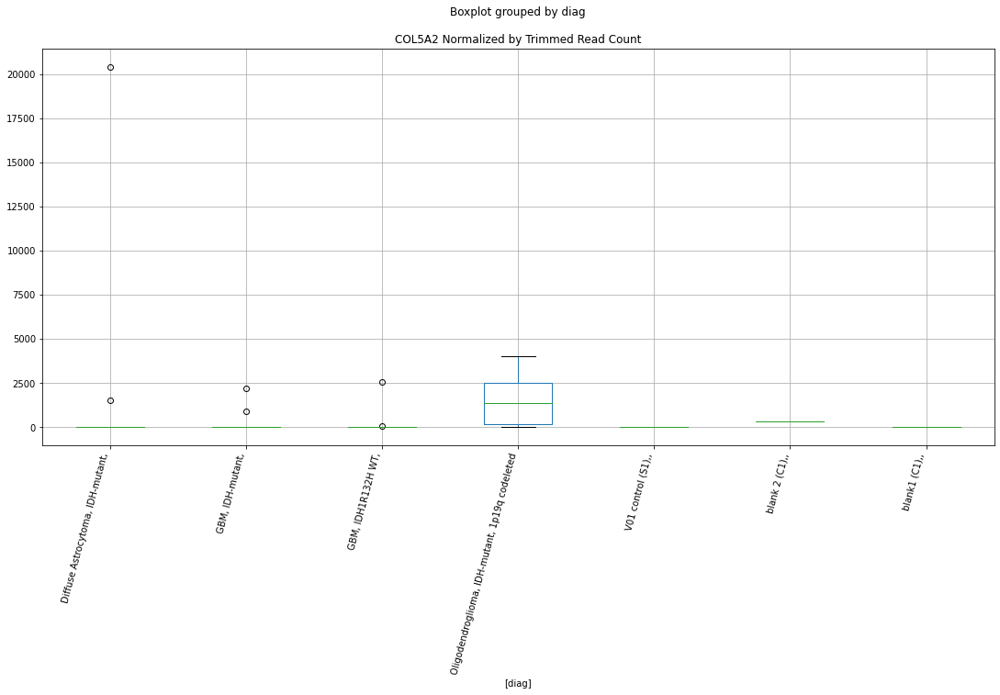

 p : 0.02465736547187397  ( t : 2.4516870907946875 ) :  Lexogen  :  bbduk2  :  BRD9
Control and blanks
79       0.00
343    212.31
Name: BRD9, dtype: float64
211    2186.45
Name: BRD9, dtype: float64
475    239.52
Name: BRD9, dtype: float64


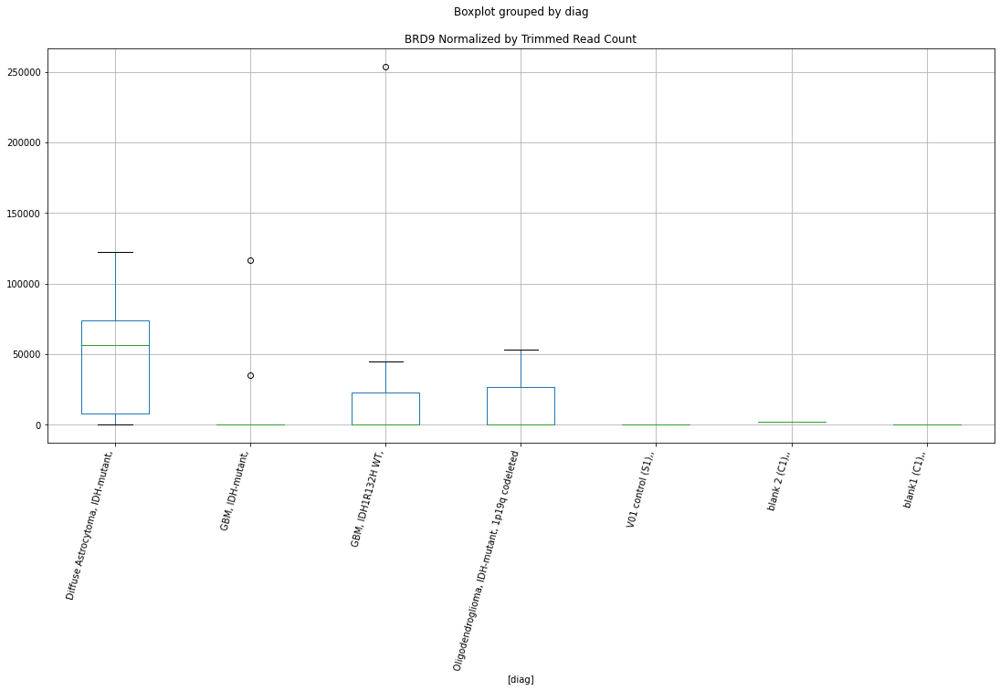

 p : 0.024680123907416106  ( t : 2.451240600544586 ) :  D-plex  :  cutadapt2  :  DLX4
Control and blanks
76         0.00
340    33467.82
Name: DLX4, dtype: float64
208    2116.32
Name: DLX4, dtype: float64
472    577.96
Name: DLX4, dtype: float64


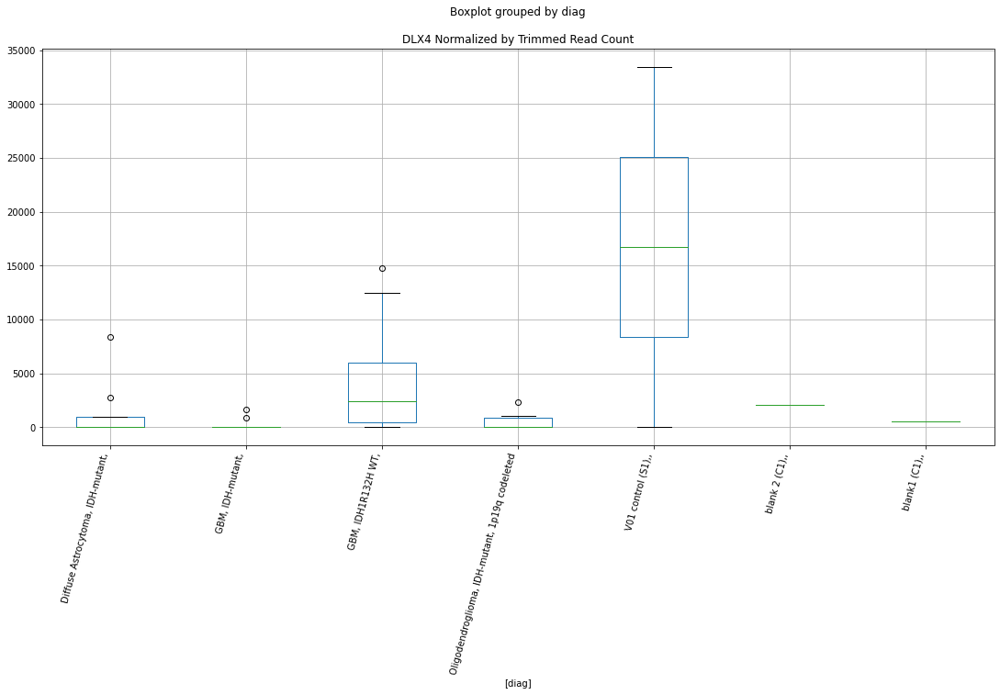

 p : 0.02475905997031621  ( t : 2.4496949696382257 ) :  D-plex  :  cutadapt2  :  BAX
Control and blanks
76     0.0
340    0.0
Name: BAX, dtype: float64
208    14108.82
Name: BAX, dtype: float64
472    8091.38
Name: BAX, dtype: float64


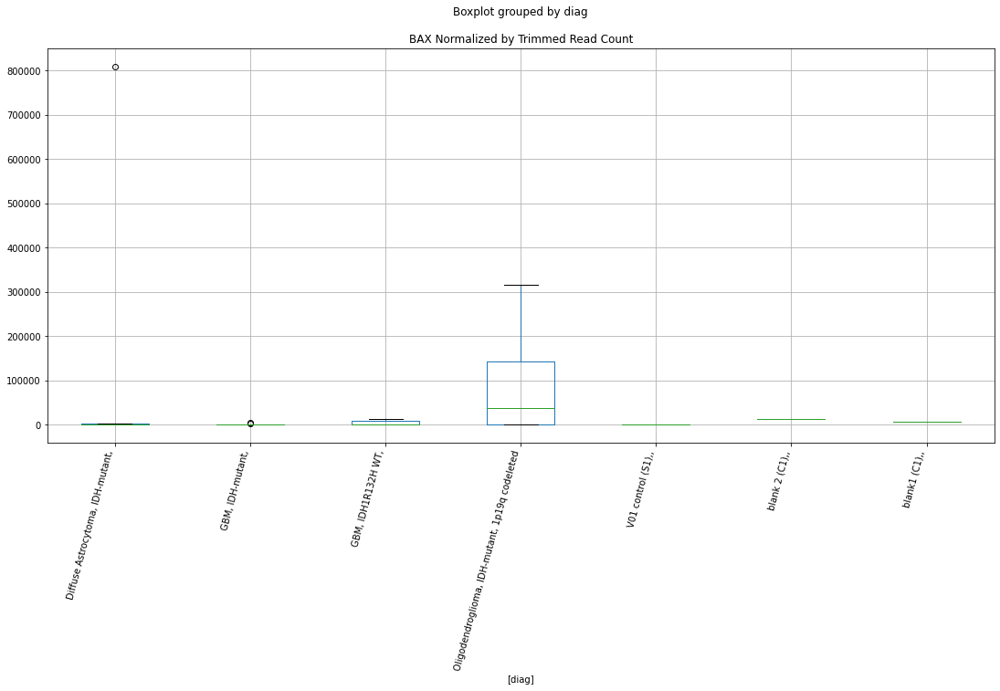

 p : 0.024783165534529118  ( t : 2.4492238855129234 ) :  D-plex  :  bbduk2  :  CIART
Control and blanks
73     773.01
337      0.00
Name: CIART, dtype: float64
205    3581.82
Name: CIART, dtype: float64
469    1774.58
Name: CIART, dtype: float64


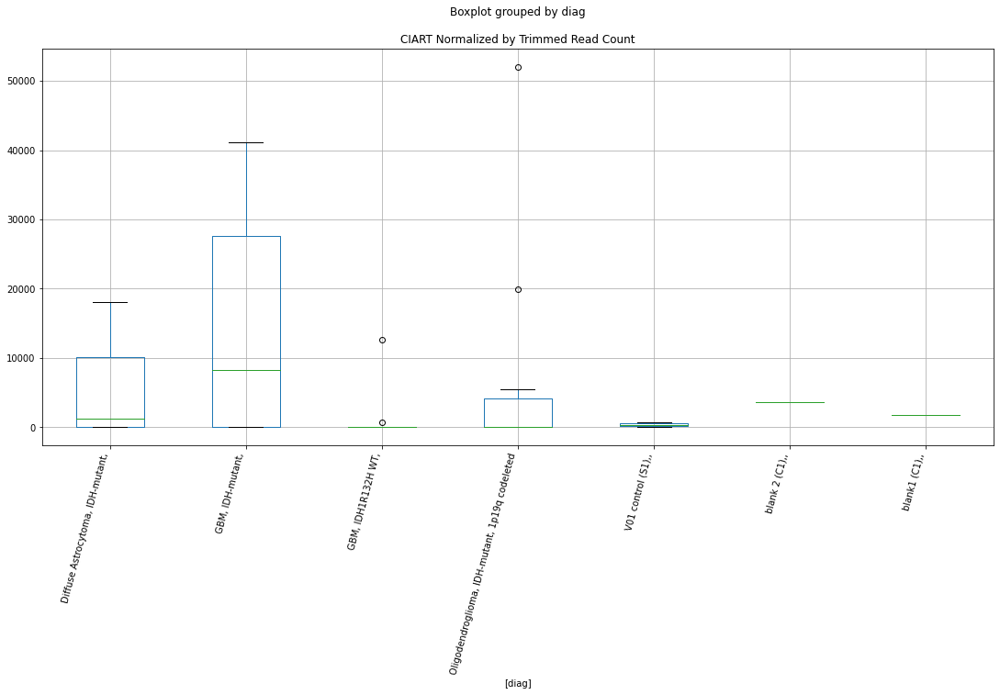

 p : 0.024842760570579943  ( t : 2.4480610902813575 ) :  Lexogen  :  bbduk2  :  ATP10A
Control and blanks
79     17167.19
343     6794.06
Name: ATP10A, dtype: float64
211    15305.15
Name: ATP10A, dtype: float64
475    12454.82
Name: ATP10A, dtype: float64


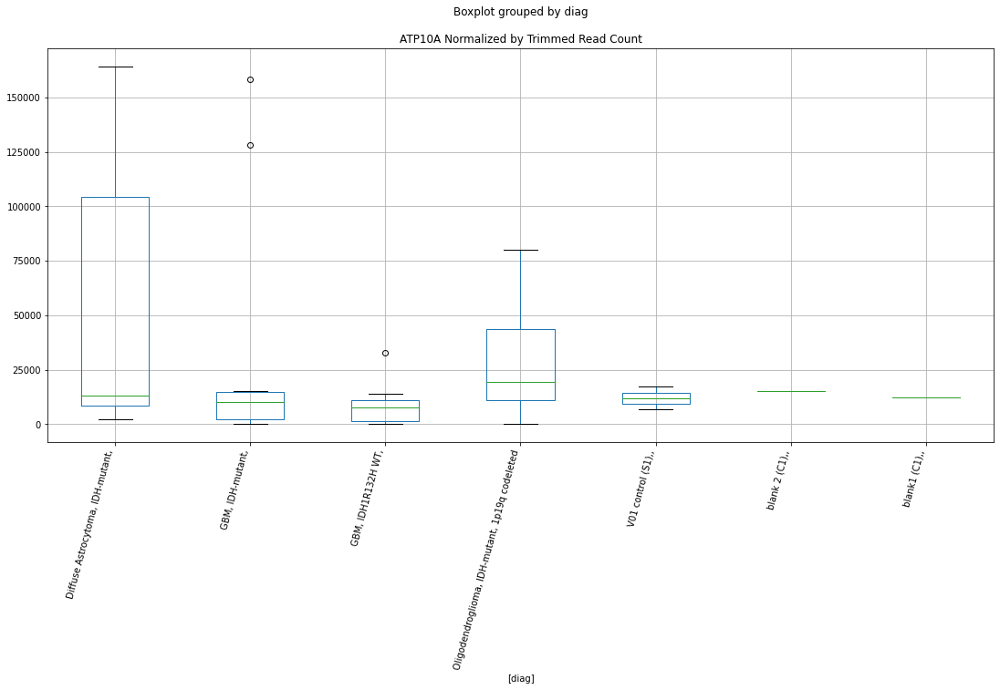

 p : 0.024929749122044292  ( t : 2.4463684948020195 ) :  Lexogen  :  bbduk2  :  A3GALT2
Control and blanks
79       0.00
343    212.31
Name: A3GALT2, dtype: float64
211    0.0
Name: A3GALT2, dtype: float64
475    0.0
Name: A3GALT2, dtype: float64


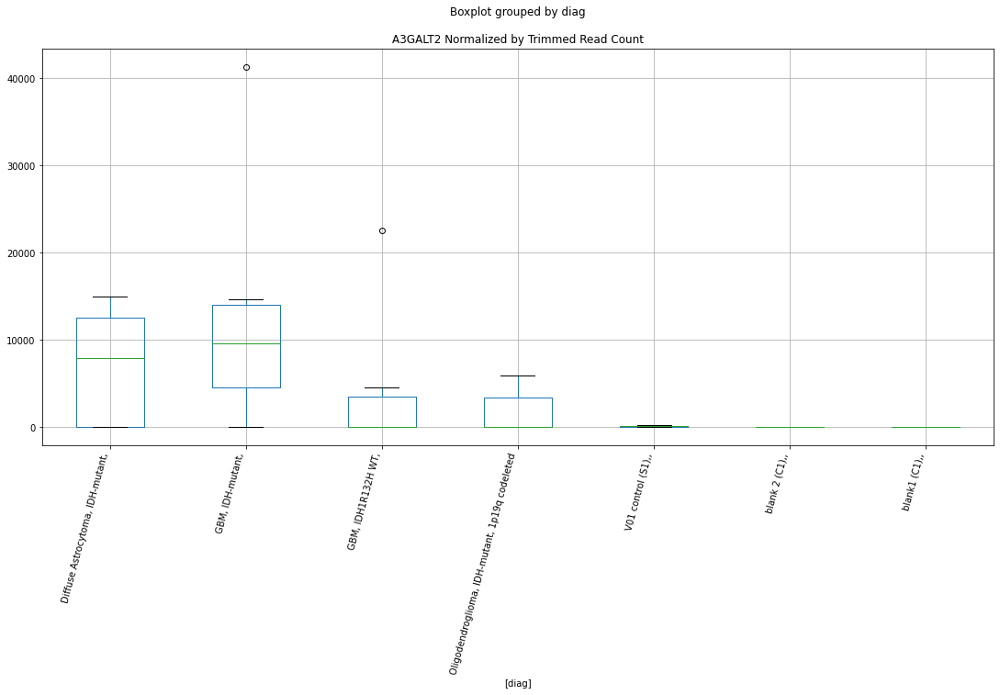

 p : 0.02496173472639495  ( t : 2.4457475226232783 ) :  Lexogen  :  cutadapt2  :  A3GALT2
Control and blanks
82       0.00
346    210.43
Name: A3GALT2, dtype: float64
214    0.0
Name: A3GALT2, dtype: float64
478    0.0
Name: A3GALT2, dtype: float64


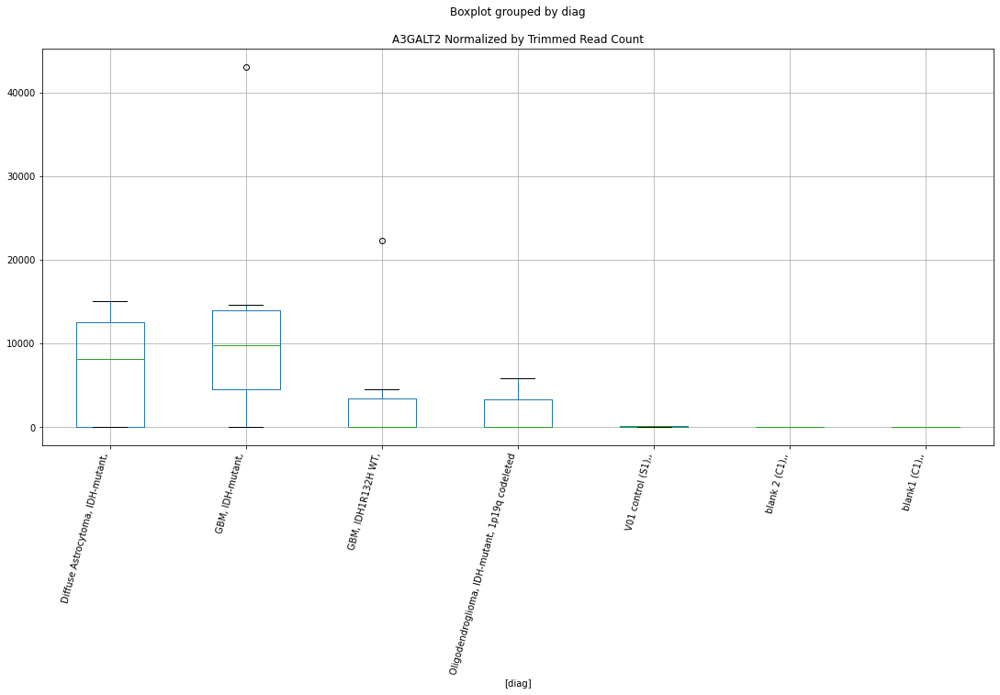

 p : 0.025002392940423394  ( t : 2.4449592564103777 ) :  D-plex  :  cutadapt2  :  ACSBG1
Control and blanks
76      1515.23
340    17614.64
Name: ACSBG1, dtype: float64
208    2821.76
Name: ACSBG1, dtype: float64
472    9247.29
Name: ACSBG1, dtype: float64


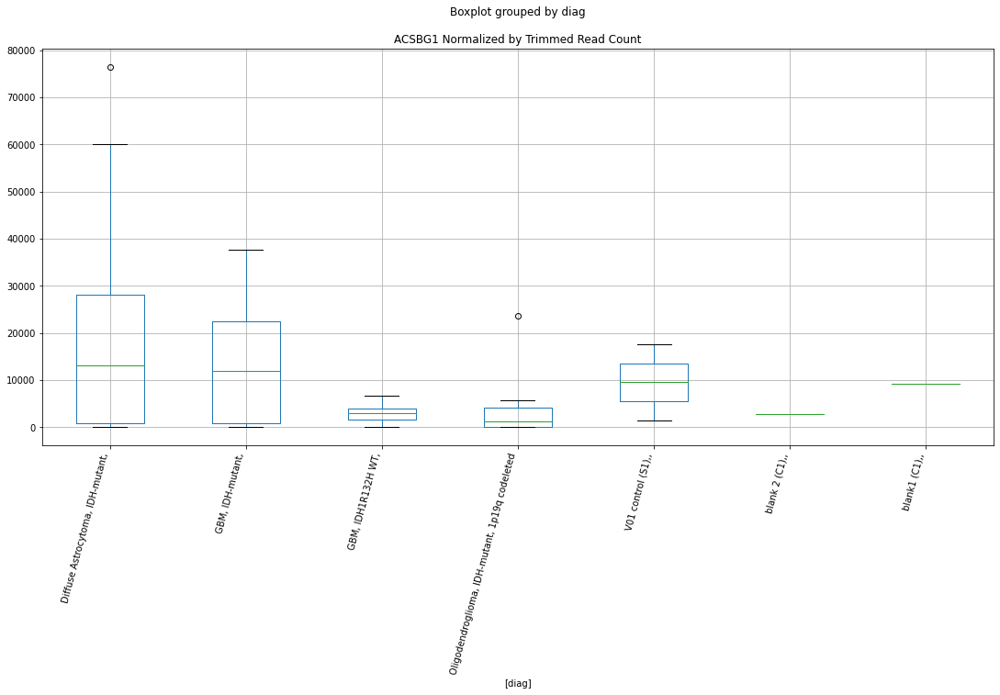

 p : 0.025100018142453752  ( t : 2.4430714362379127 ) :  D-plex  :  cutadapt2  :  BRIP1
Control and blanks
76     969746.19
340    140917.14
Name: BRIP1, dtype: float64
208    269831.13
Name: BRIP1, dtype: float64
472    342149.86
Name: BRIP1, dtype: float64


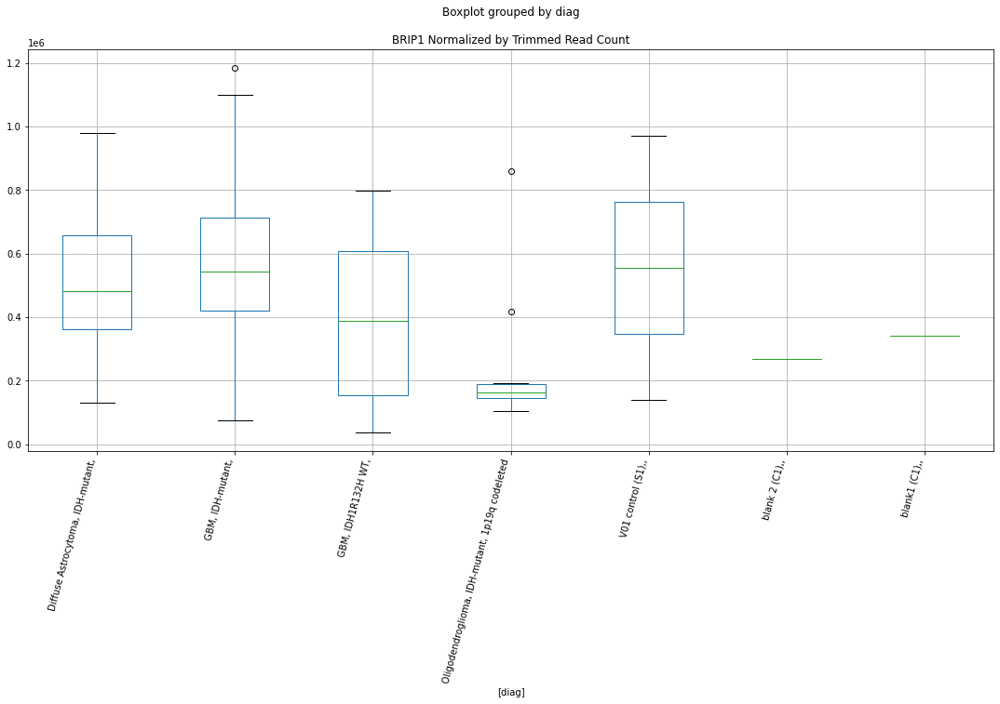

 p : 0.02514203632505736  ( t : 2.4422610326428655 ) :  D-plex  :  bbduk2  :  BAX
Control and blanks
73     0.0
337    0.0
Name: BAX, dtype: float64
205    12536.37
Name: BAX, dtype: float64
469    8281.38
Name: BAX, dtype: float64


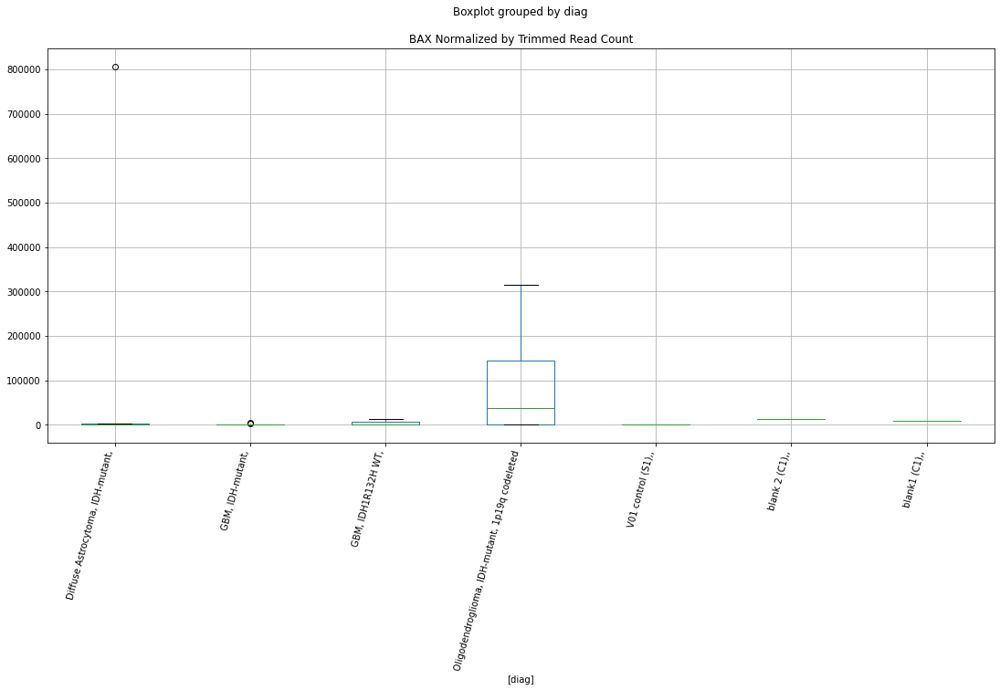

 p : 0.025217552264627116  ( t : 2.44080774738506 ) :  D-plex  :  bbduk2  :  BRINP2
Control and blanks
73     0.0
337    0.0
Name: BRINP2, dtype: float64
205    3402.73
Name: BRINP2, dtype: float64
469    0.0
Name: BRINP2, dtype: float64


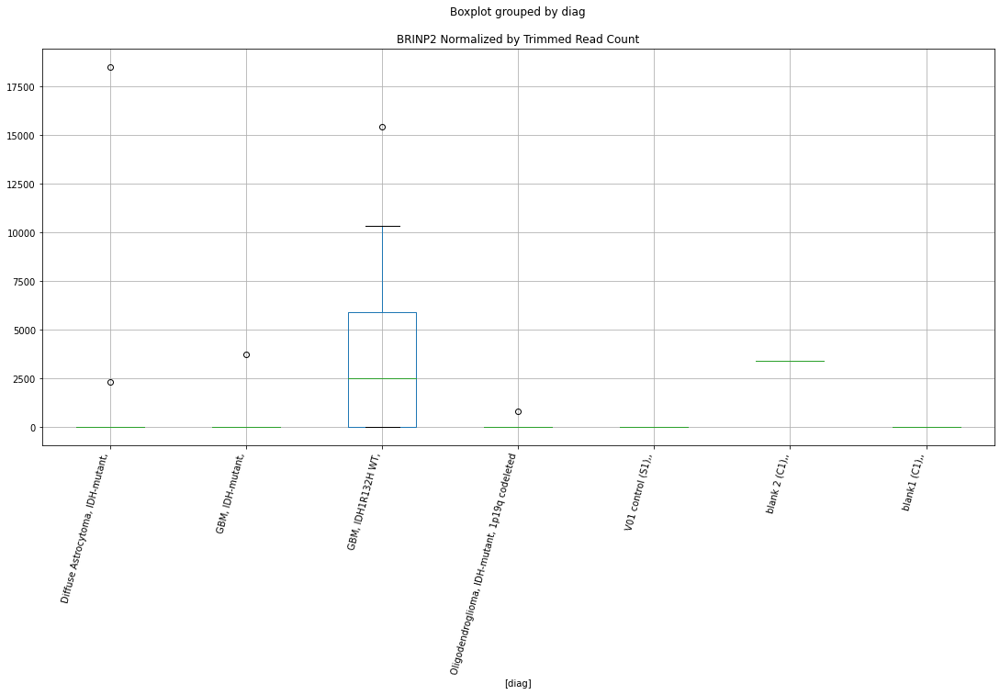

 p : 0.02524259068699161  ( t : 2.440326790400905 ) :  D-plex  :  cutadapt2  :  CHDH
Control and blanks
76     356836.29
340         0.00
Name: CHDH, dtype: float64
208    54495.31
Name: CHDH, dtype: float64
472    13870.94
Name: CHDH, dtype: float64


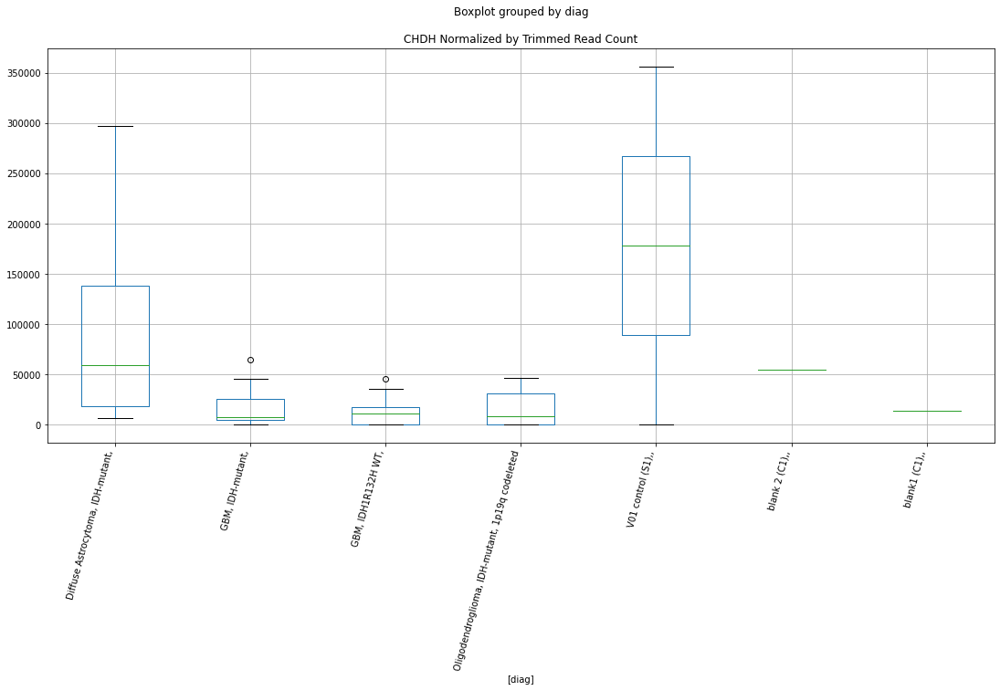

 p : 0.025322416895587254  ( t : 2.438796410207551 ) :  Lexogen  :  bbduk2  :  ALK
Control and blanks
79     0.0
343    0.0
Name: ALK, dtype: float64
211    0.0
Name: ALK, dtype: float64
475    0.0
Name: ALK, dtype: float64


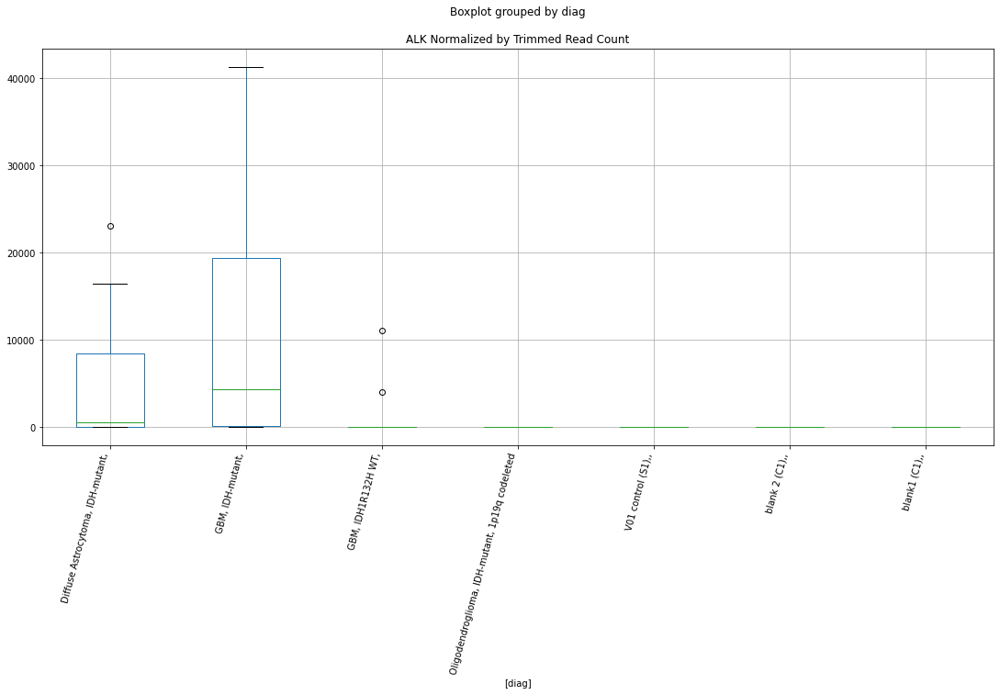

 p : 0.025357034811080828  ( t : 2.4381341425463976 ) :  D-plex  :  bbduk2  :  CHAC1
Control and blanks
73     0.0
337    0.0
Name: CHAC1, dtype: float64
205    4298.18
Name: CHAC1, dtype: float64
469    11830.55
Name: CHAC1, dtype: float64


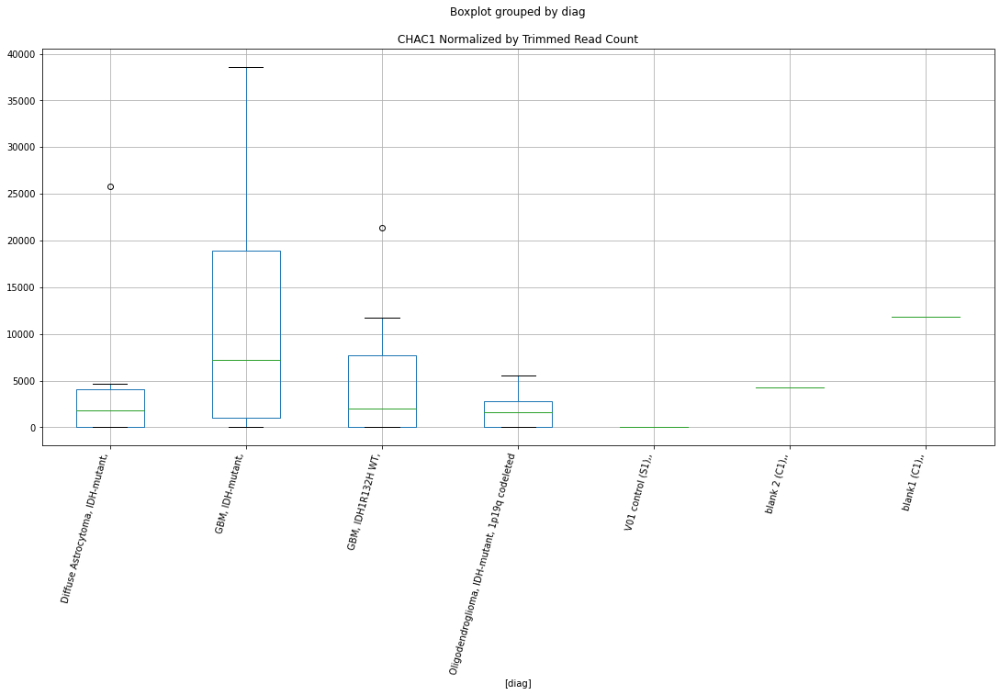

 p : 0.02537473525388944  ( t : 2.4377958468791494 ) :  D-plex  :  bbduk2  :  CEP250
Control and blanks
73      3092.03
337    12462.20
Name: CEP250, dtype: float64
205    25610.01
Name: CEP250, dtype: float64
469    66251.06
Name: CEP250, dtype: float64


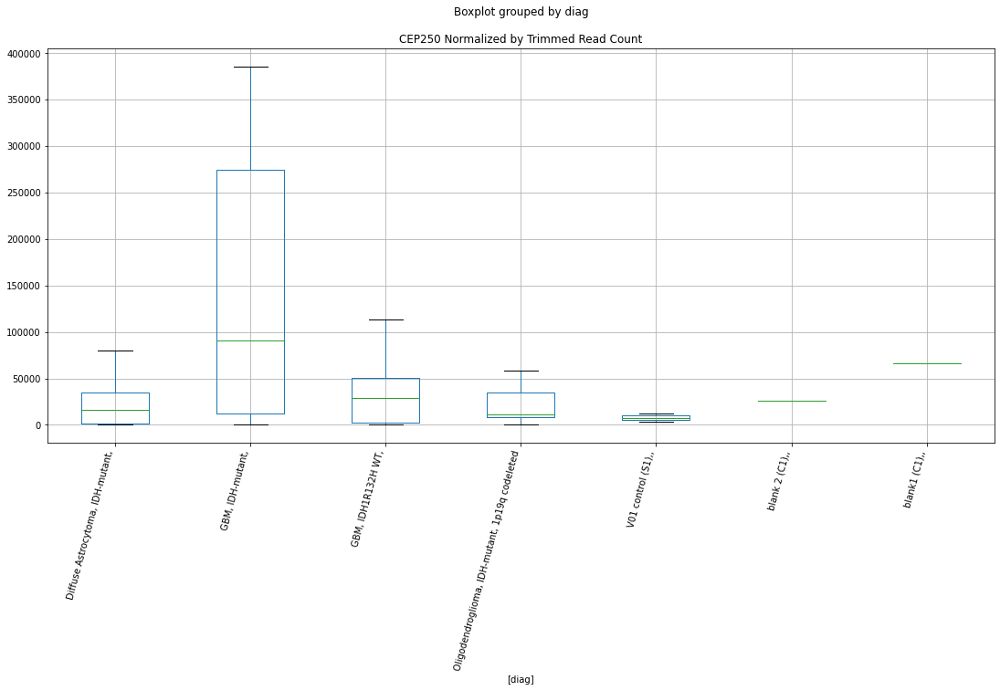

 p : 0.02539180191916532  ( t : 2.437469873652656 ) :  D-plex  :  cutadapt2  :  CIART
Control and blanks
76     757.61
340      0.00
Name: CIART, dtype: float64
208    3527.2
Name: CIART, dtype: float64
472    1733.87
Name: CIART, dtype: float64


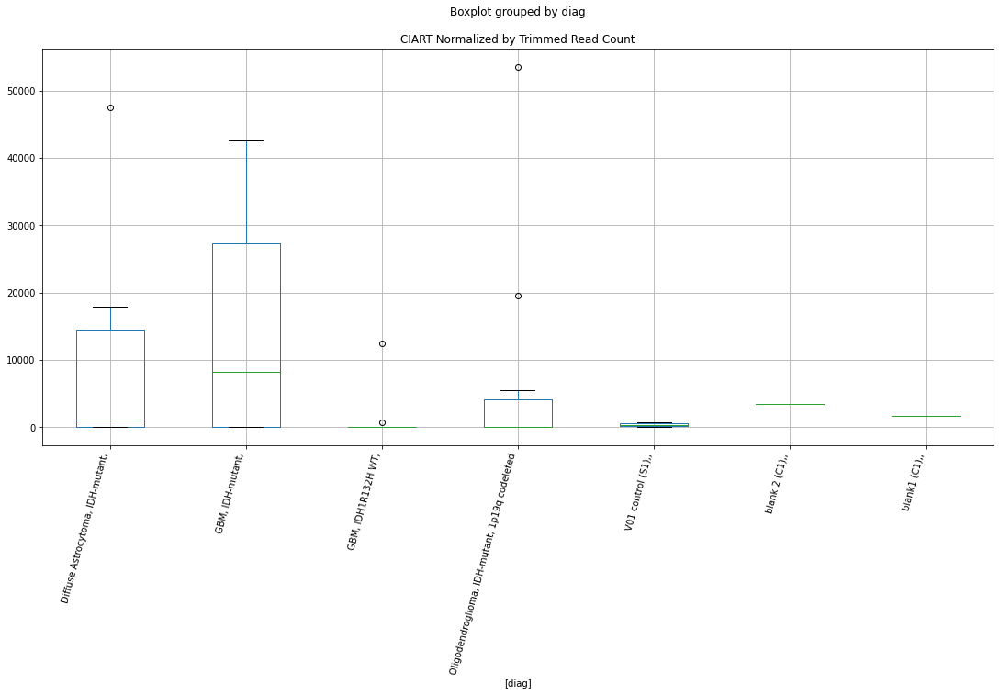

 p : 0.025442504641397162  ( t : 2.43650266248063 ) :  D-plex  :  cutadapt2  :  CRTAC1
Control and blanks
76     757.61
340      0.00
Name: CRTAC1, dtype: float64
208    3527.2
Name: CRTAC1, dtype: float64
472    5779.56
Name: CRTAC1, dtype: float64


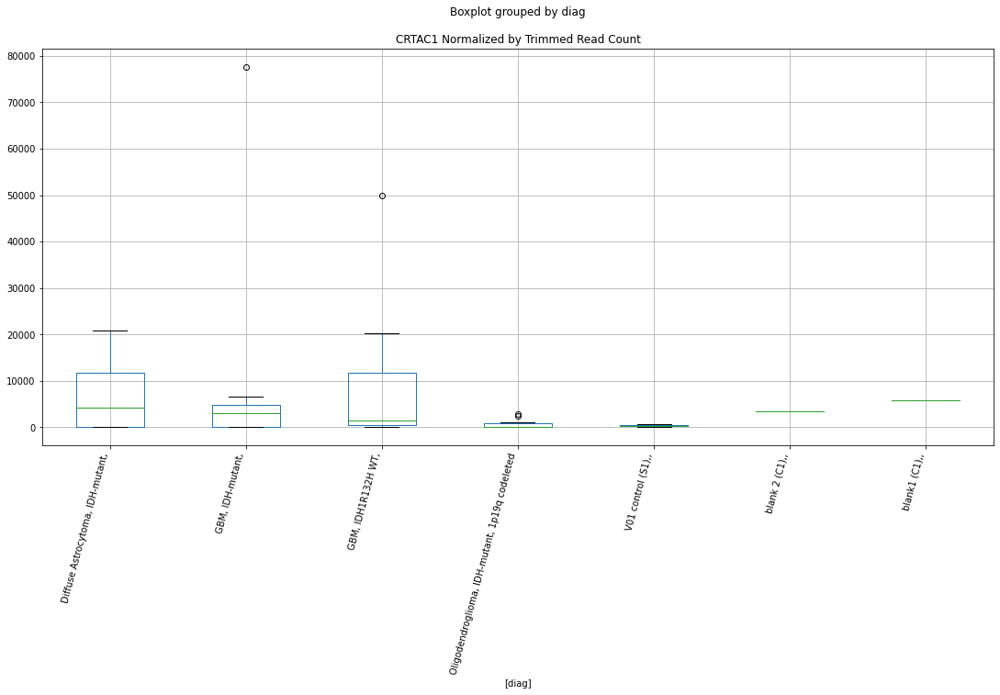

 p : 0.025498806342293897  ( t : 2.4354307602434195 ) :  D-plex  :  cutadapt2  :  CDC42
Control and blanks
76     0.0
340    0.0
Name: CDC42, dtype: float64
208    1234.52
Name: CDC42, dtype: float64
472    2311.82
Name: CDC42, dtype: float64


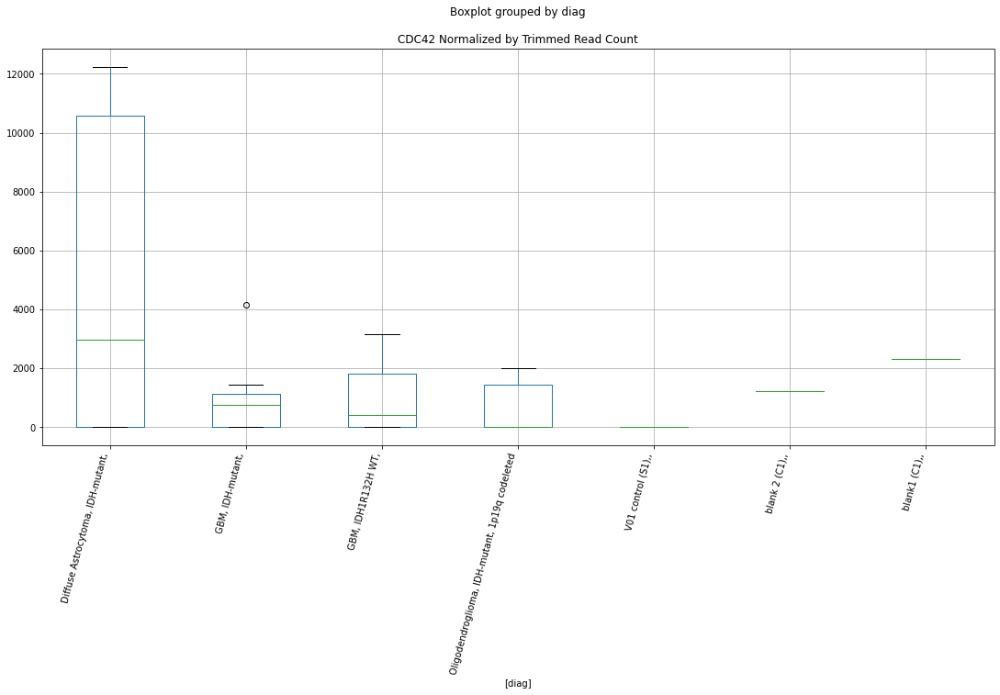

 p : 0.025578316697530693  ( t : 2.4339207731019994 ) :  D-plex  :  bbduk2  :  AJAP1
Control and blanks
73        0.00
337    2670.47
Name: AJAP1, dtype: float64
205    5014.55
Name: AJAP1, dtype: float64
469    7689.86
Name: AJAP1, dtype: float64


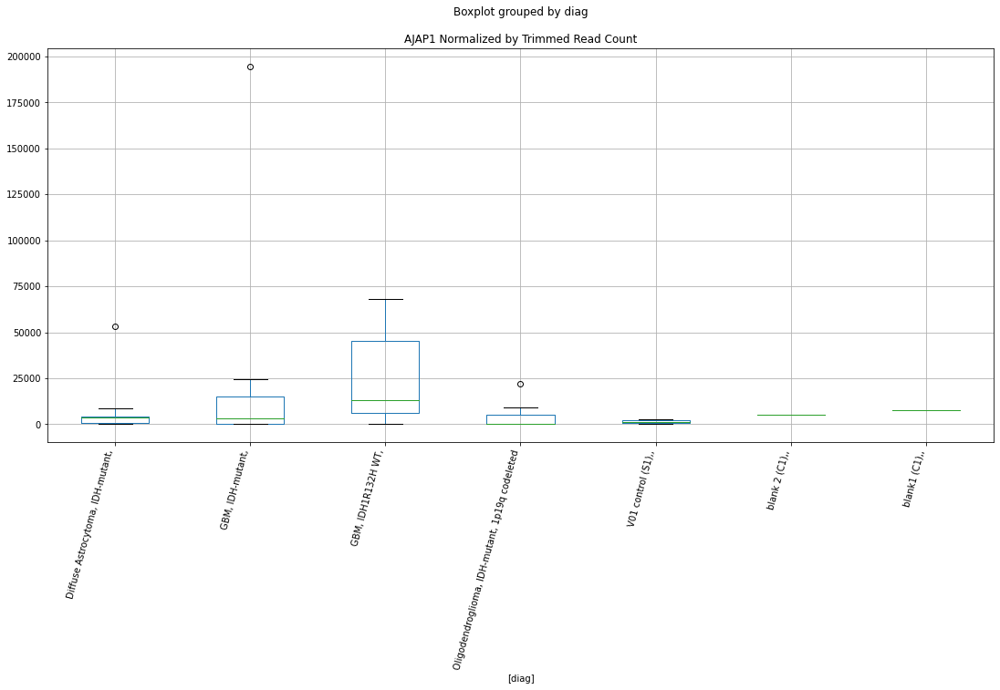

 p : 0.025774998661438245  ( t : 2.4302043946874305 ) :  D-plex  :  cutadapt2  :  CEP250
Control and blanks
76      3030.46
340    12330.25
Name: CEP250, dtype: float64
208    25043.15
Name: CEP250, dtype: float64
472    64731.05
Name: CEP250, dtype: float64


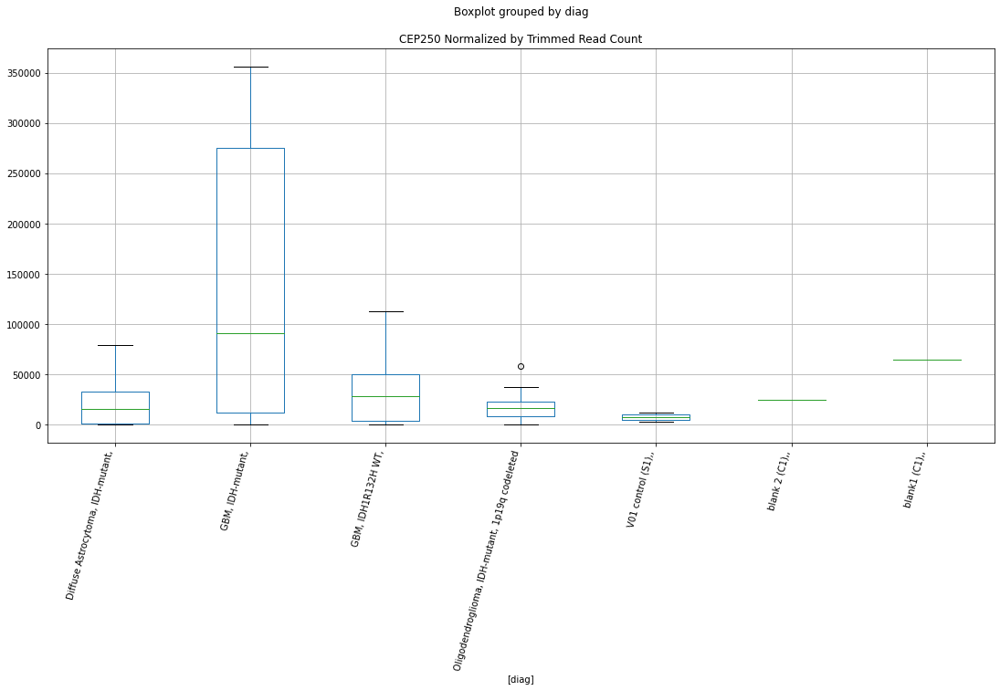

 p : 0.0258075583461533  ( t : 2.429591733414332 ) :  Lexogen  :  cutadapt2  :  ANO7
Control and blanks
82     0.0
346    0.0
Name: ANO7, dtype: float64
214    0.0
Name: ANO7, dtype: float64
478    0.0
Name: ANO7, dtype: float64


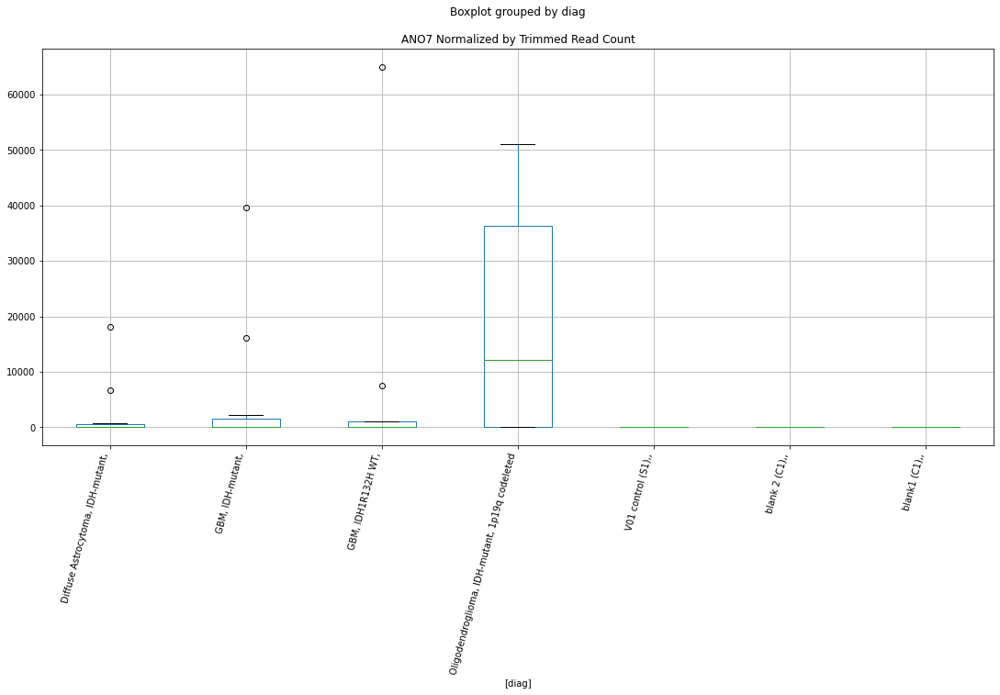

 p : 0.02582423138957061  ( t : 2.4292782845119514 ) :  D-plex  :  cutadapt2  :  CITED1
Control and blanks
76     0.0
340    0.0
Name: CITED1, dtype: float64
208    1234.52
Name: CITED1, dtype: float64
472    1155.91
Name: CITED1, dtype: float64


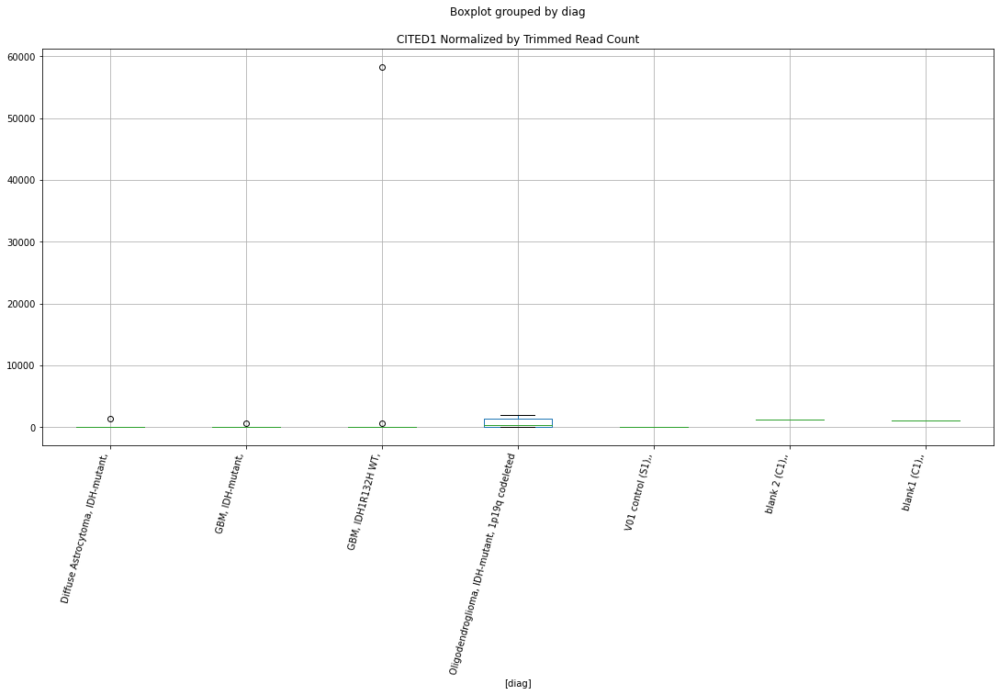

 p : 0.02586164904500474  ( t : 2.4285755321742752 ) :  Lexogen  :  bbduk2  :  ANO7
Control and blanks
79     0.0
343    0.0
Name: ANO7, dtype: float64
211    0.0
Name: ANO7, dtype: float64
475    0.0
Name: ANO7, dtype: float64


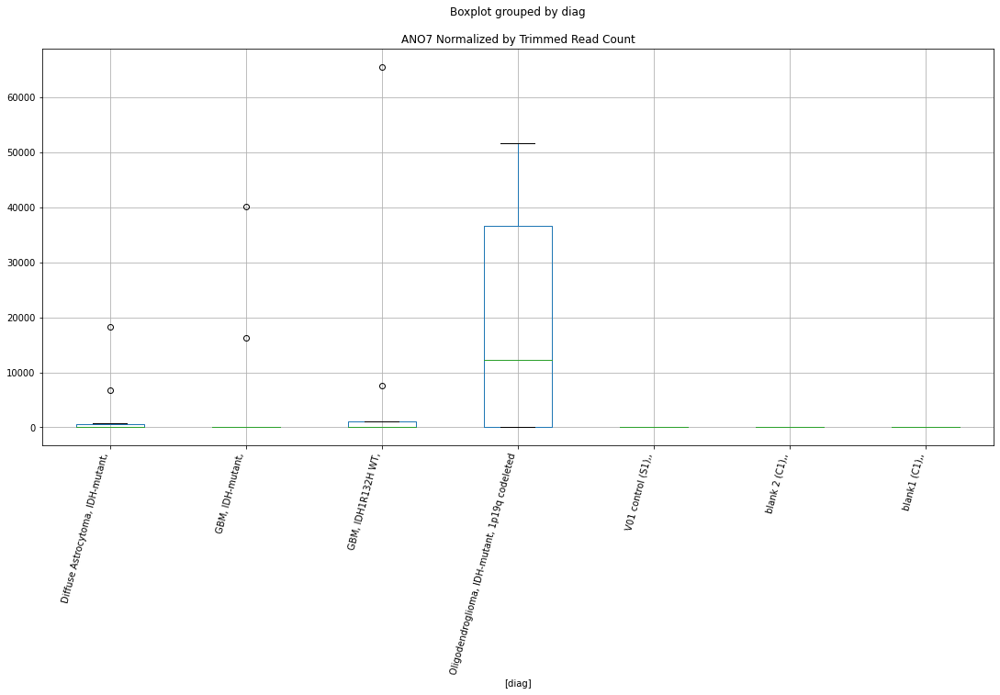

 p : 0.02586718198234527  ( t : 2.4284716972820153 ) :  D-plex  :  cutadapt2  :  CLCN3
Control and blanks
76     0.0
340    0.0
Name: CLCN3, dtype: float64
208    9876.17
Name: CLCN3, dtype: float64
472    6935.47
Name: CLCN3, dtype: float64


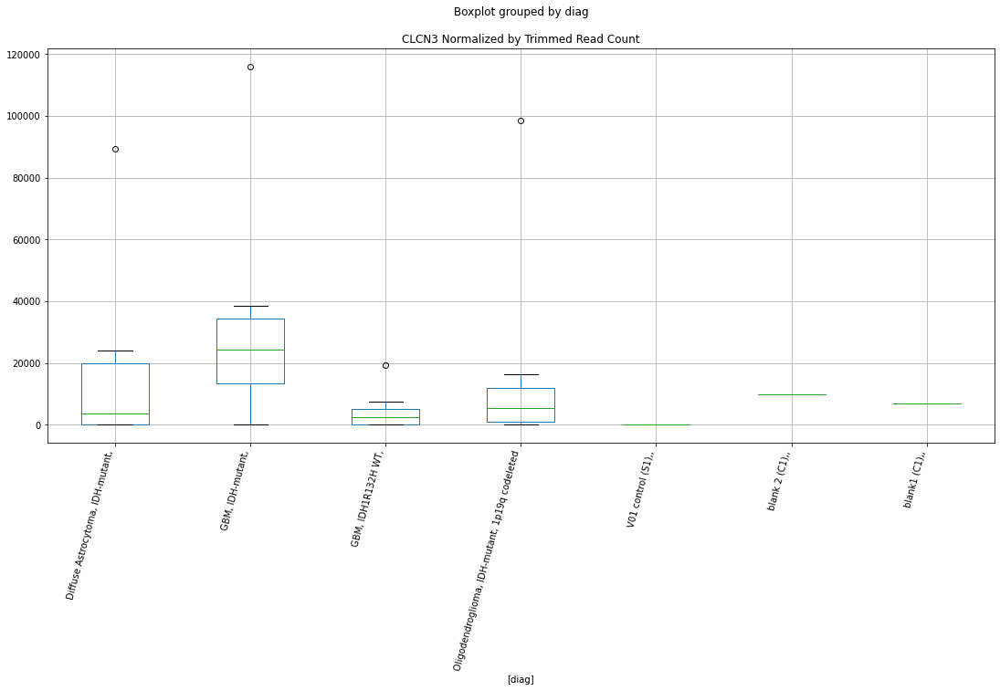

 p : 0.025874061413005186  ( t : 2.428342622199611 ) :  D-plex  :  cutadapt2  :  COL5A2
Control and blanks
76     0.0
340    0.0
Name: COL5A2, dtype: float64
208    352.72
Name: COL5A2, dtype: float64
472    0.0
Name: COL5A2, dtype: float64


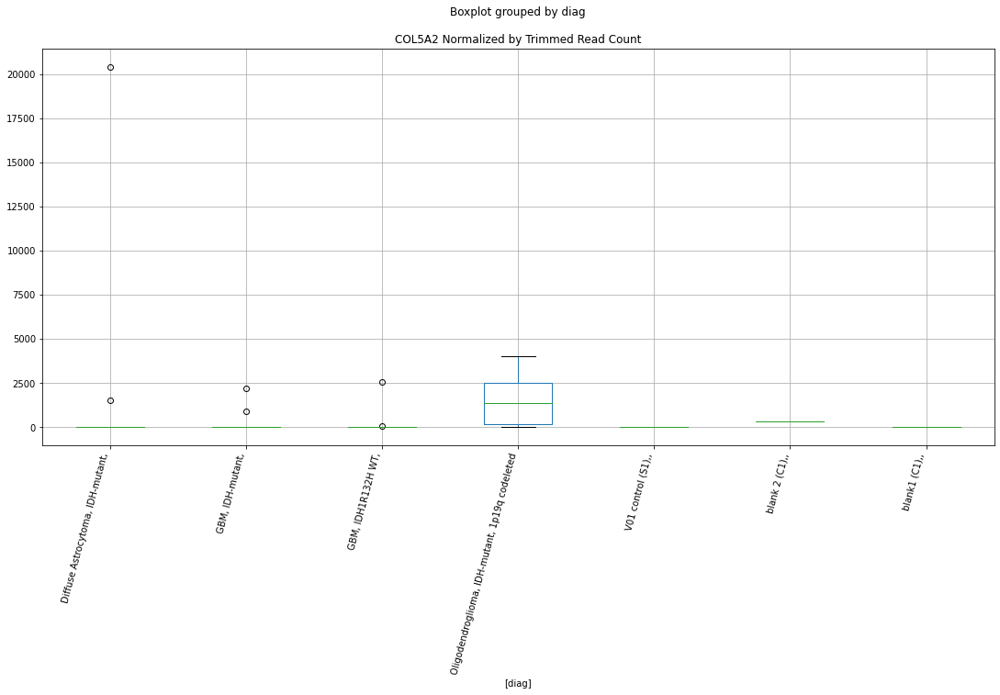

 p : 0.02590837575144202  ( t : 2.4276992805184183 ) :  D-plex  :  bbduk2  :  CITED1
Control and blanks
73     0.0
337    0.0
Name: CITED1, dtype: float64
205    1253.64
Name: CITED1, dtype: float64
469    1183.05
Name: CITED1, dtype: float64


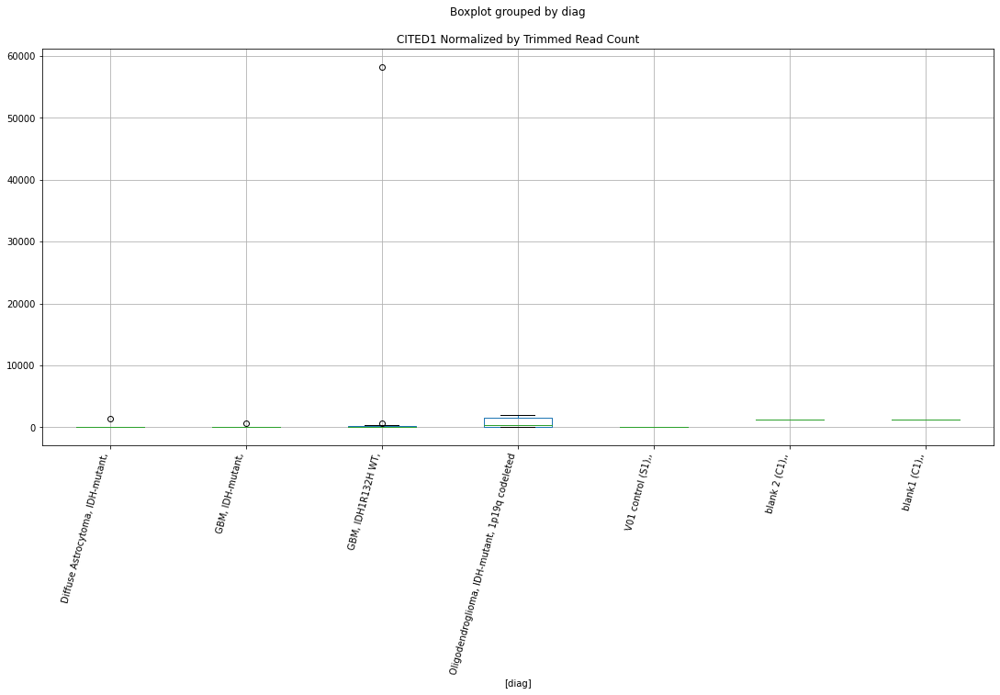

 p : 0.02596488907968743  ( t : 2.4266414799347857 ) :  D-plex  :  bbduk2  :  CHEK2
Control and blanks
73     12368.13
337    14242.52
Name: CHEK2, dtype: float64
205    112110.94
Name: CHEK2, dtype: float64
469    56786.62
Name: CHEK2, dtype: float64


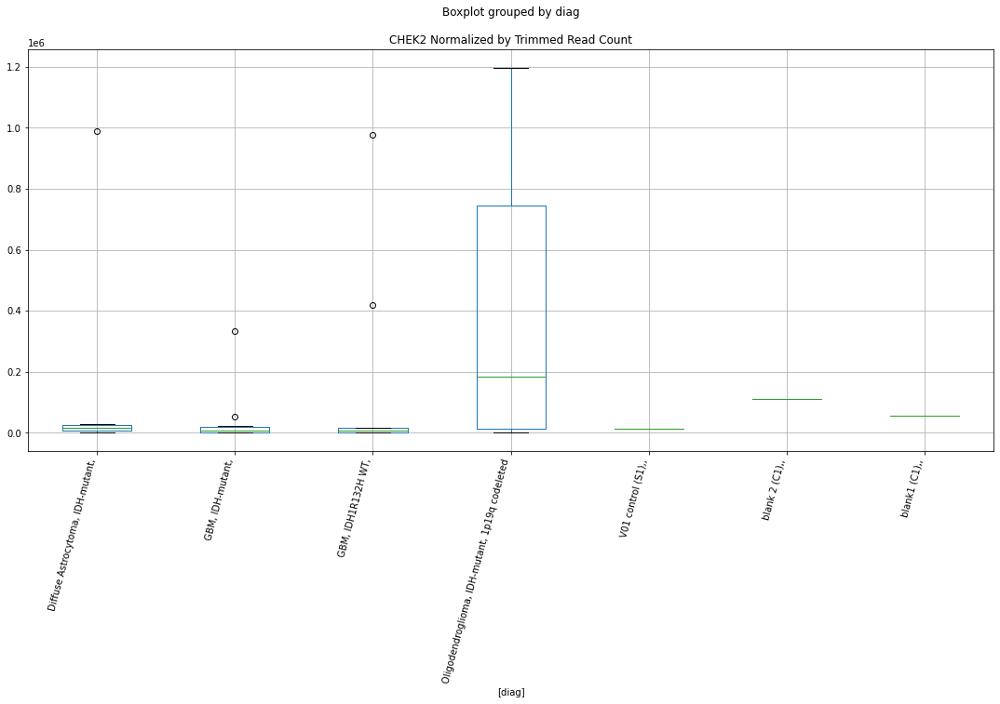

 p : 0.02606727804309255  ( t : 2.4247304753667214 ) :  Lexogen  :  cutadapt2  :  ALK
Control and blanks
82     0.0
346    0.0
Name: ALK, dtype: float64
214    0.0
Name: ALK, dtype: float64
478    0.0
Name: ALK, dtype: float64


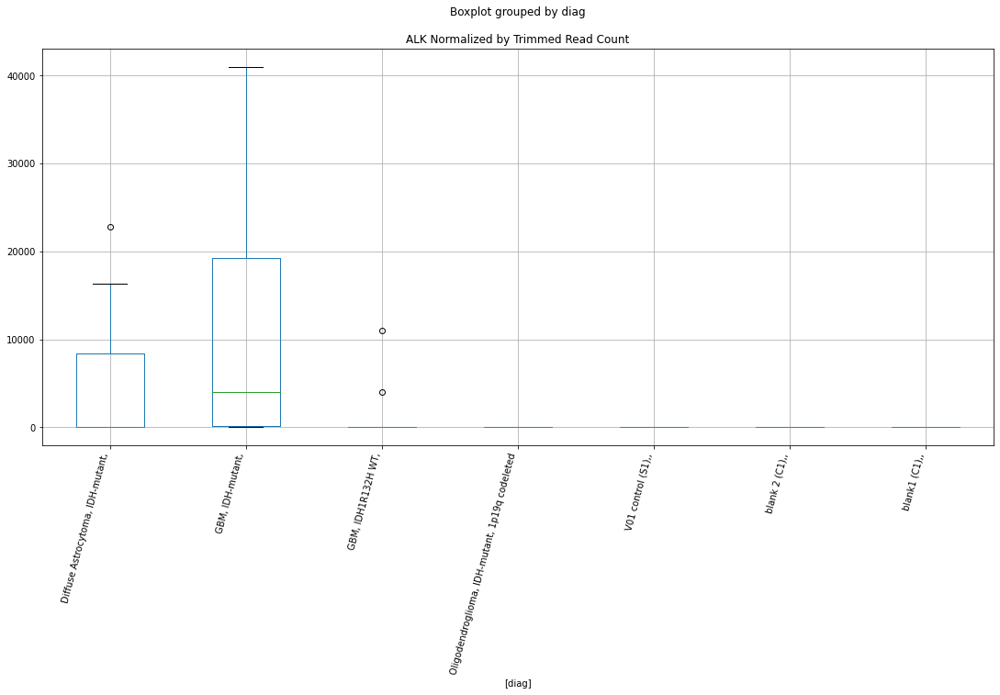

 p : 0.026089328093628867  ( t : 2.4243198500869796 ) :  Lexogen  :  cutadapt2  :  ADGRB1
Control and blanks
82     0.0
346    0.0
Name: ADGRB1, dtype: float64
214    2441.04
Name: ADGRB1, dtype: float64
478    0.0
Name: ADGRB1, dtype: float64


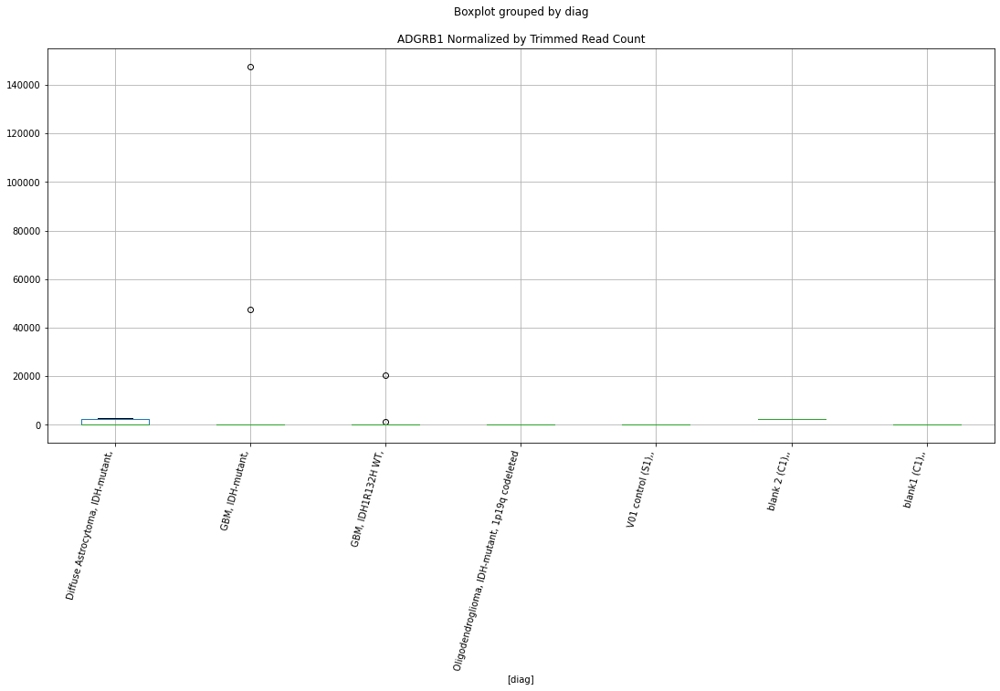

 p : 0.026091169330858394  ( t : 2.4242855765063216 ) :  Lexogen  :  bbduk2  :  ADGRB1
Control and blanks
79     0.0
343    0.0
Name: ADGRB1, dtype: float64
211    2459.76
Name: ADGRB1, dtype: float64
475    0.0
Name: ADGRB1, dtype: float64


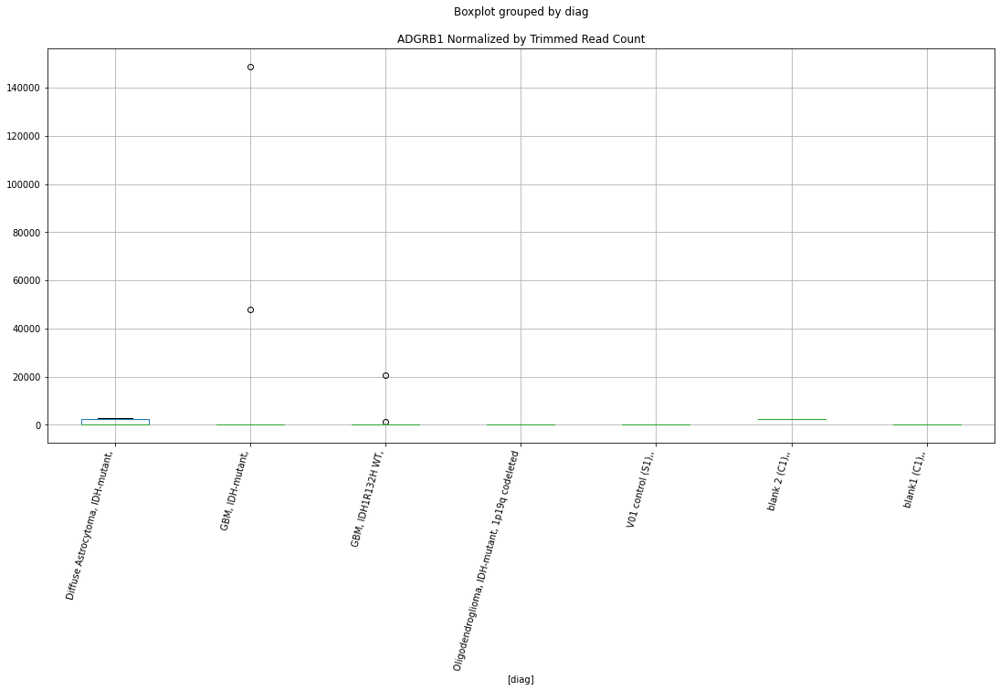

 p : 0.026122491272794028  ( t : 2.4237028833038576 ) :  D-plex  :  cutadapt2  :  AHCY
Control and blanks
76     1515.23
340     880.73
Name: AHCY, dtype: float64
208    9523.45
Name: AHCY, dtype: float64
472    8091.38
Name: AHCY, dtype: float64


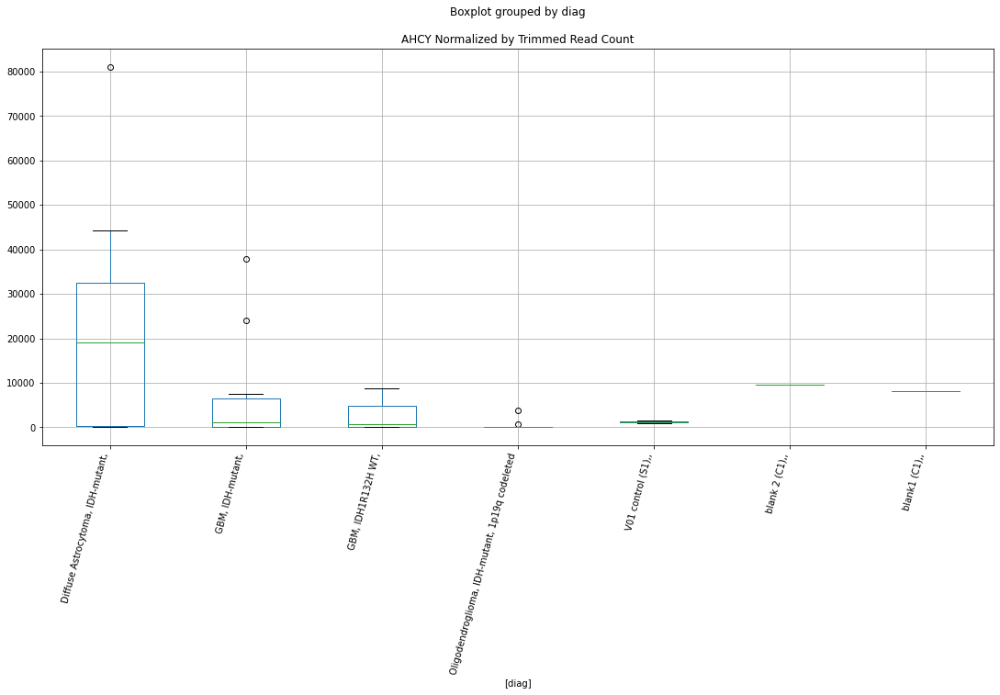

 p : 0.026151187057922538  ( t : 2.423169619667728 ) :  D-plex  :  bbduk2  :  ATP13A1
Control and blanks
73     0.0
337    0.0
Name: ATP13A1, dtype: float64
205    2328.18
Name: ATP13A1, dtype: float64
469    1774.58
Name: ATP13A1, dtype: float64


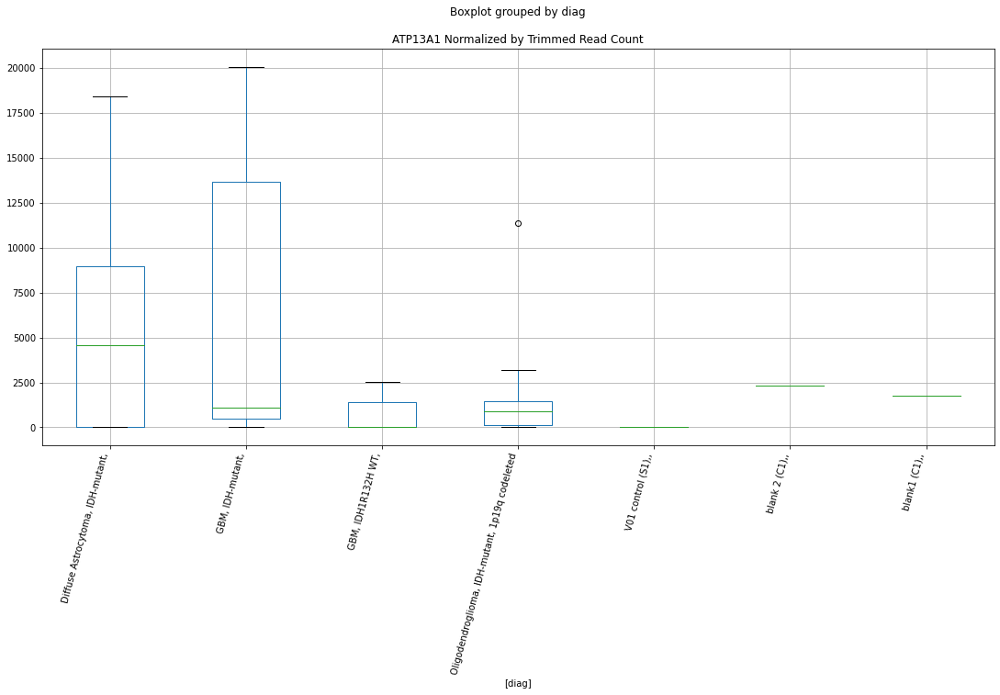

 p : 0.02618604118413942  ( t : 2.422522650223402 ) :  Lexogen  :  cutadapt2  :  CIT
Control and blanks
82        0.00
346    6313.04
Name: CIT, dtype: float64
214    20341.98
Name: CIT, dtype: float64
478    0.0
Name: CIT, dtype: float64


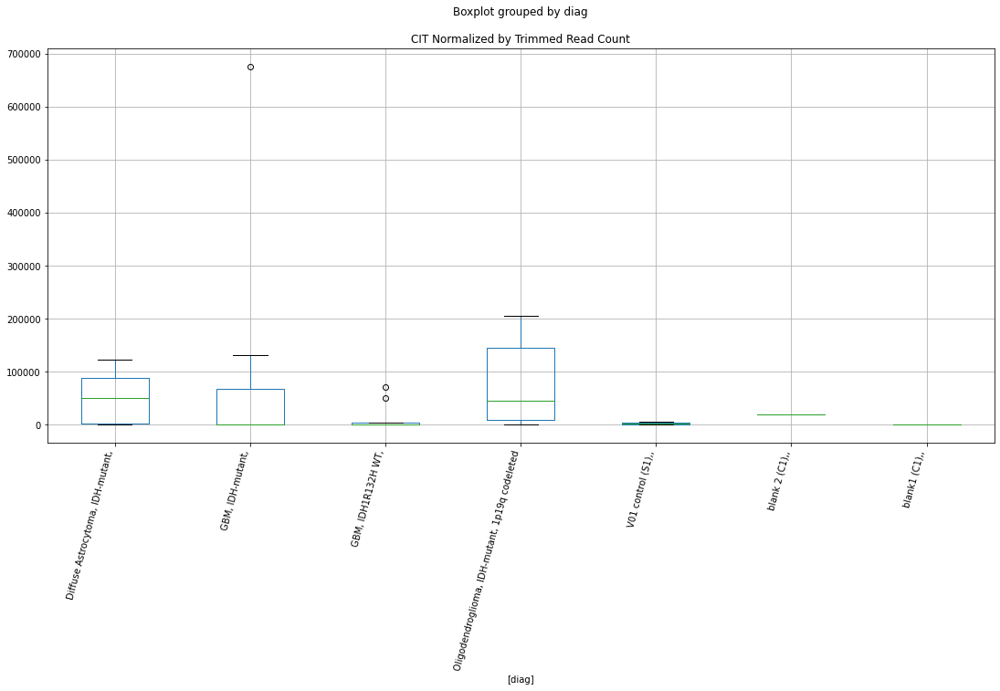

 p : 0.02626473566614642  ( t : 2.421064868722099 ) :  D-plex  :  cutadapt2  :  AJAP1
Control and blanks
76        0.0
340    2642.2
Name: AJAP1, dtype: float64
208    4938.09
Name: AJAP1, dtype: float64
472    7513.43
Name: AJAP1, dtype: float64


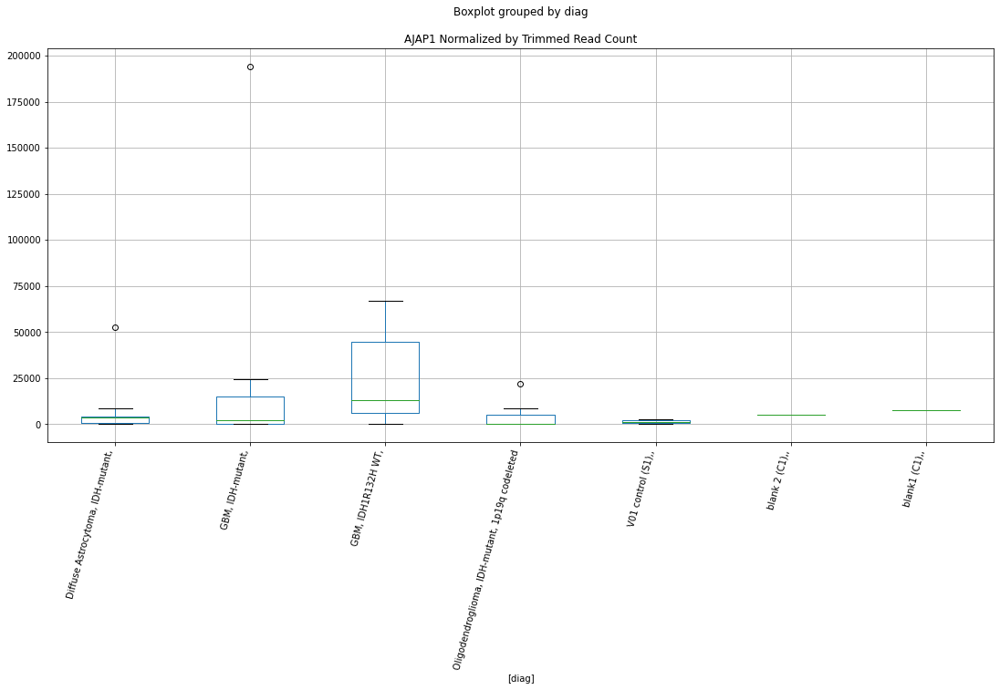

 p : 0.026267095368243485  ( t : 2.4210212194616014 ) :  D-plex  :  cutadapt2  :  CHEK2
Control and blanks
76     12121.83
340    14091.71
Name: CHEK2, dtype: float64
208    110401.5
Name: CHEK2, dtype: float64
472    55483.76
Name: CHEK2, dtype: float64


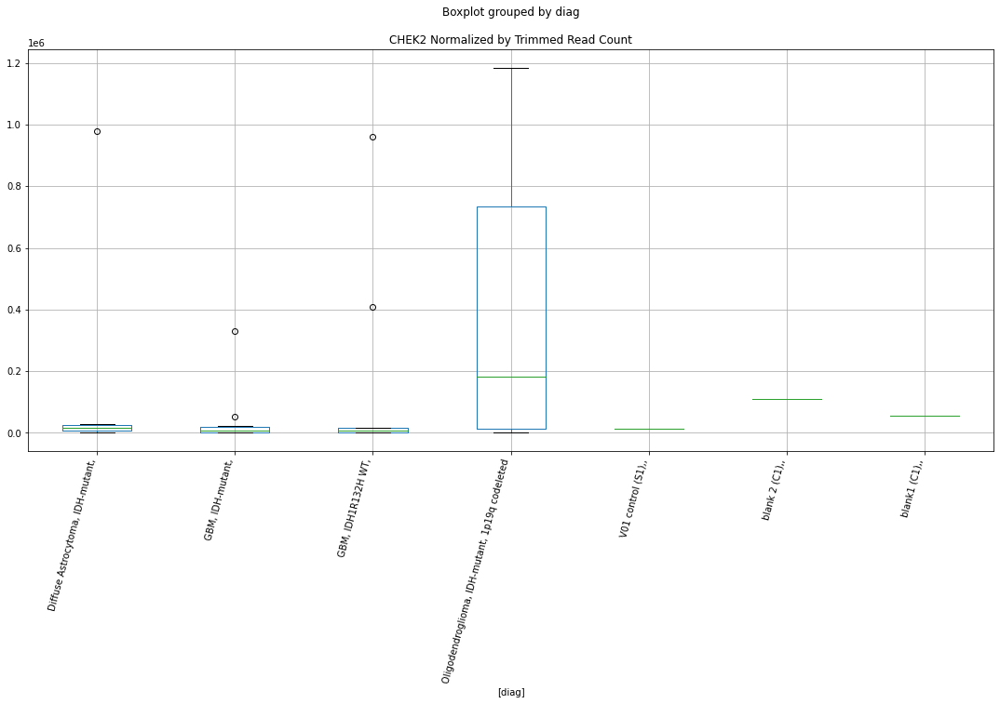

 p : 0.026281953308330958  ( t : 2.42074646482874 ) :  Lexogen  :  cutadapt2  :  ARHGEF37
Control and blanks
82     0.0
346    0.0
Name: ARHGEF37, dtype: float64
214    0.0
Name: ARHGEF37, dtype: float64
478    0.0
Name: ARHGEF37, dtype: float64


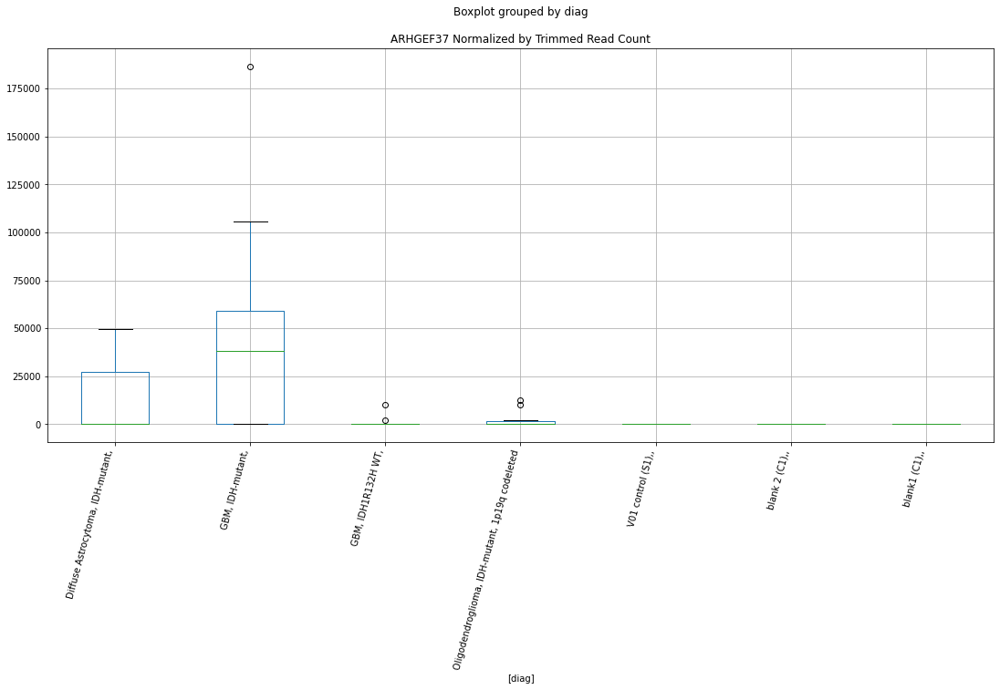

 p : 0.026313916996353583  ( t : 2.420155881648249 ) :  D-plex  :  bbduk2  :  CCDC14
Control and blanks
73     773.01
337      0.00
Name: CCDC14, dtype: float64
205    6805.46
Name: CCDC14, dtype: float64
469    26618.73
Name: CCDC14, dtype: float64


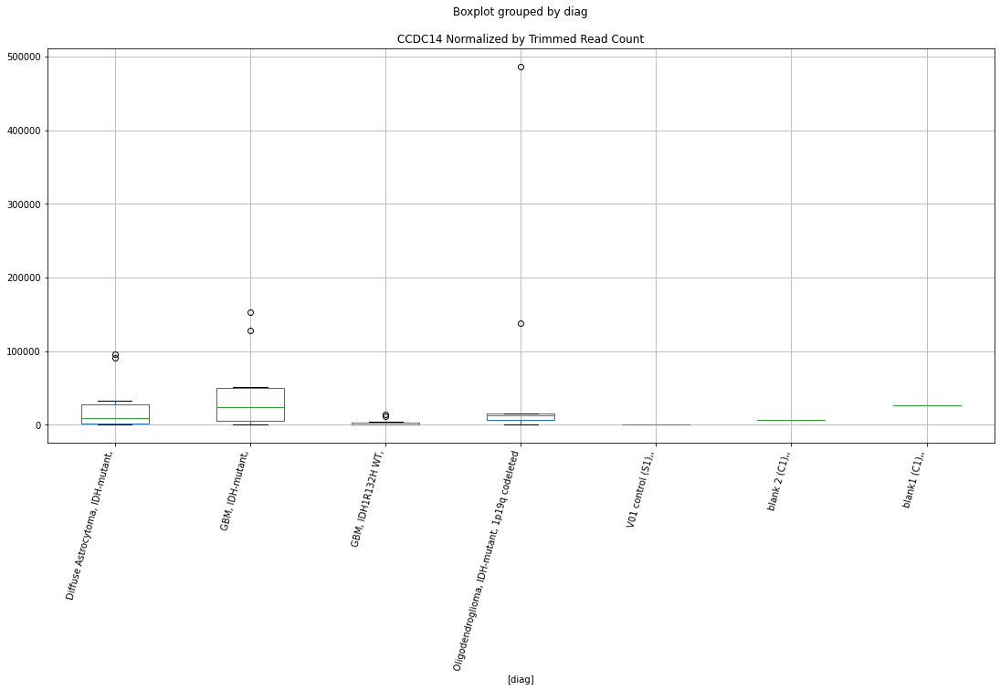

 p : 0.026319638061281233  ( t : 2.4200502461979125 ) :  D-plex  :  bbduk2  :  ASB16
Control and blanks
73     27828.3
337        0.0
Name: ASB16, dtype: float64
205    57309.1
Name: ASB16, dtype: float64
469    6506.8
Name: ASB16, dtype: float64


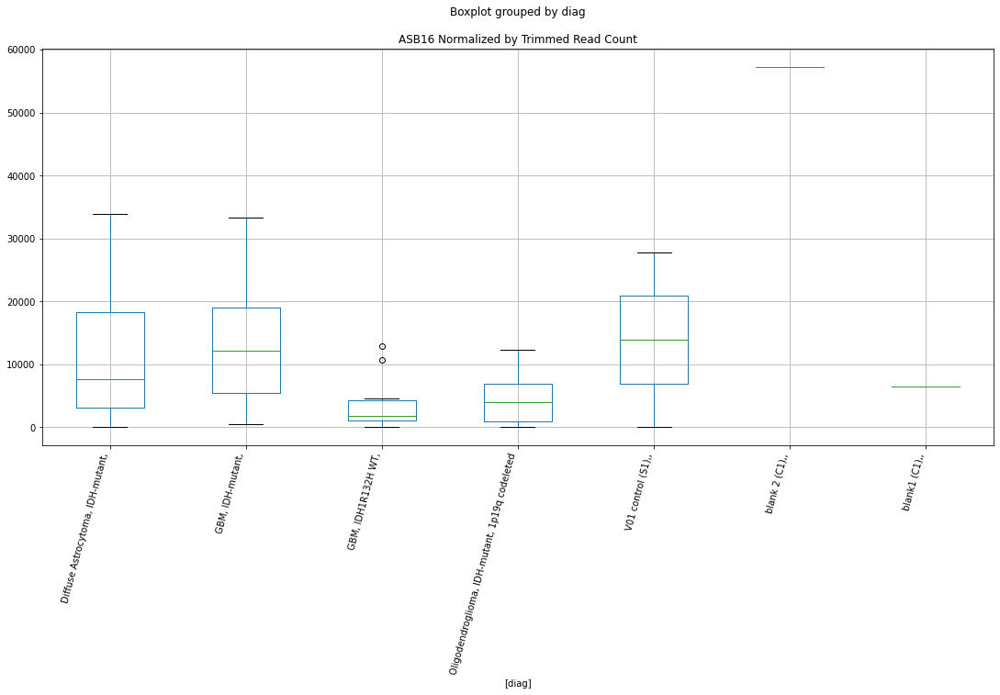

 p : 0.02643880433237535  ( t : 2.4178547994093855 ) :  Lexogen  :  cutadapt2  :  ATXN1
Control and blanks
82         0.00
346    57448.62
Name: ATXN1, dtype: float64
214    0.0
Name: ATXN1, dtype: float64
478    712.38
Name: ATXN1, dtype: float64


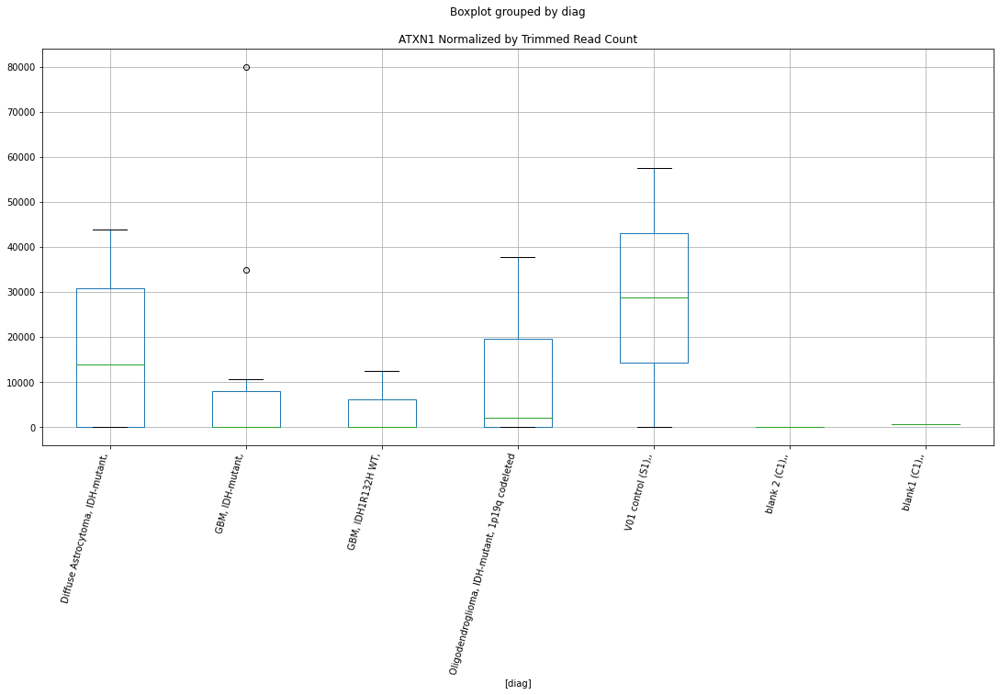

 p : 0.026602456154236183  ( t : 2.4148548299143484 ) :  D-plex  :  cutadapt2  :  COL11A2
Control and blanks
76     748522.84
340     22899.04
Name: COL11A2, dtype: float64
208    50791.74
Name: COL11A2, dtype: float64
472    75134.26
Name: COL11A2, dtype: float64


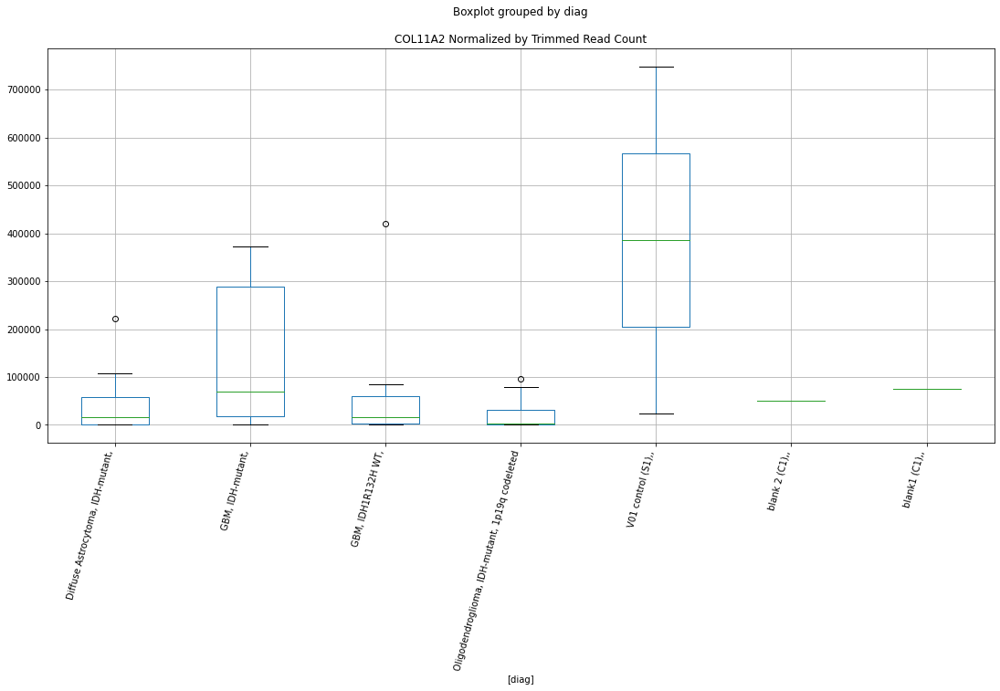

 p : 0.026615258172702223  ( t : 2.414620880058677 ) :  D-plex  :  bbduk2  :  CHRNA6
Control and blanks
73     0.0
337    0.0
Name: CHRNA6, dtype: float64
205    358.18
Name: CHRNA6, dtype: float64
469    2366.11
Name: CHRNA6, dtype: float64


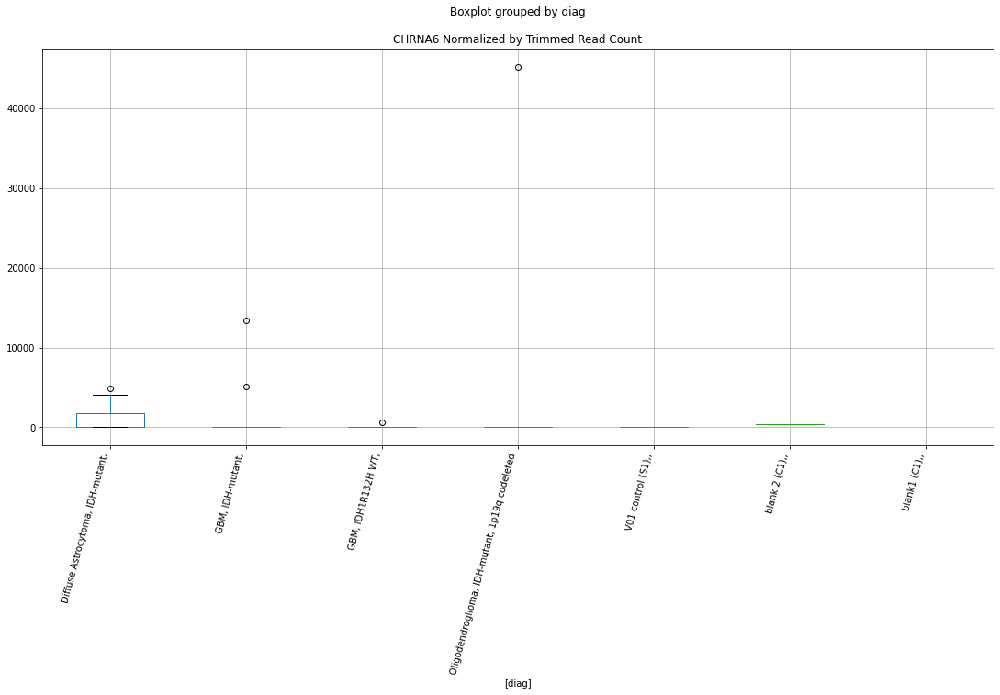

 p : 0.02664953714476693  ( t : 2.4139949689679727 ) :  D-plex  :  bbduk2  :  CRTAC1
Control and blanks
73     773.01
337      0.00
Name: CRTAC1, dtype: float64
205    3581.82
Name: CRTAC1, dtype: float64
469    5915.27
Name: CRTAC1, dtype: float64


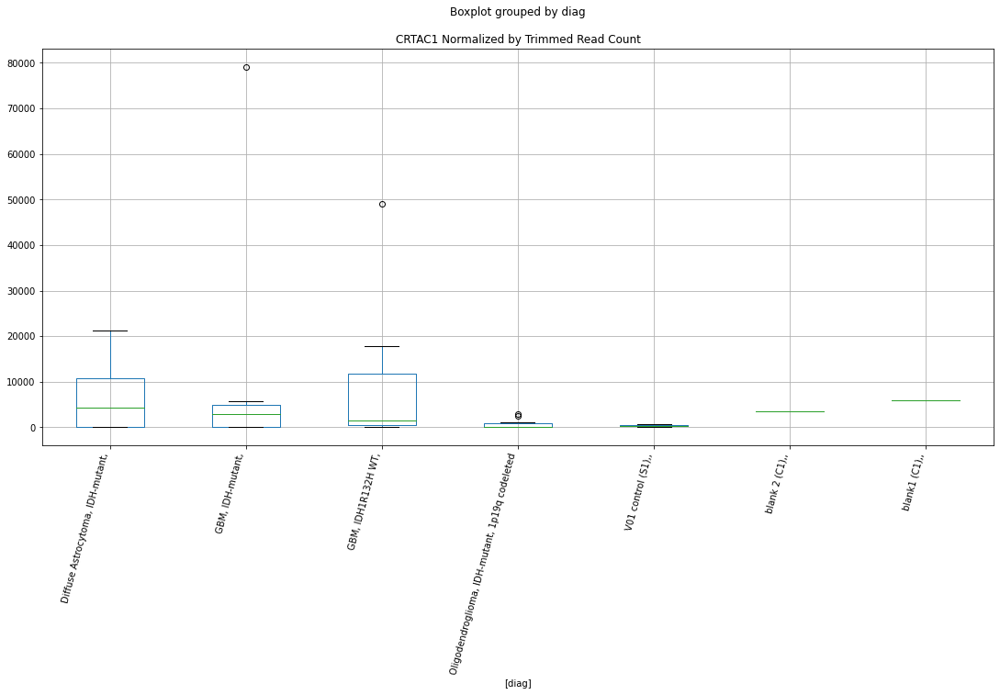

 p : 0.026783084165349046  ( t : 2.4115636554913 ) :  D-plex  :  bbduk2  :  CASD1
Control and blanks
73     0.0
337    0.0
Name: CASD1, dtype: float64
205    2149.09
Name: CASD1, dtype: float64
469    0.0
Name: CASD1, dtype: float64


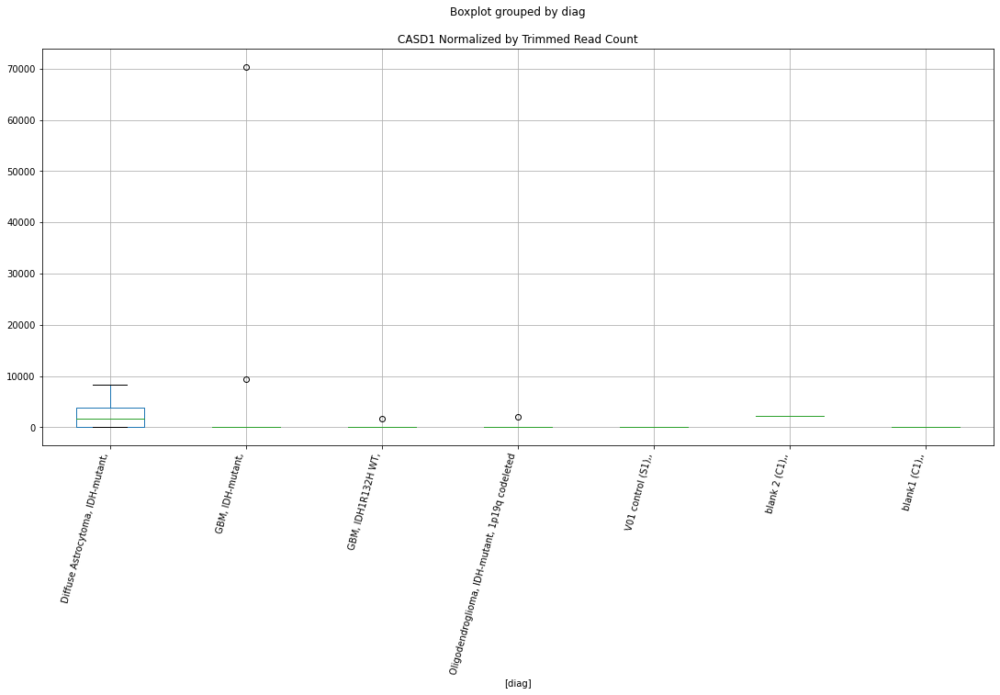

 p : 0.026830440094136637  ( t : 2.4107042333989632 ) :  D-plex  :  cutadapt2  :  AOX3P-AOX2P
Control and blanks
76     0.0
340    0.0
Name: AOX3P-AOX2P, dtype: float64
208    1410.88
Name: AOX3P-AOX2P, dtype: float64
472    3467.74
Name: AOX3P-AOX2P, dtype: float64


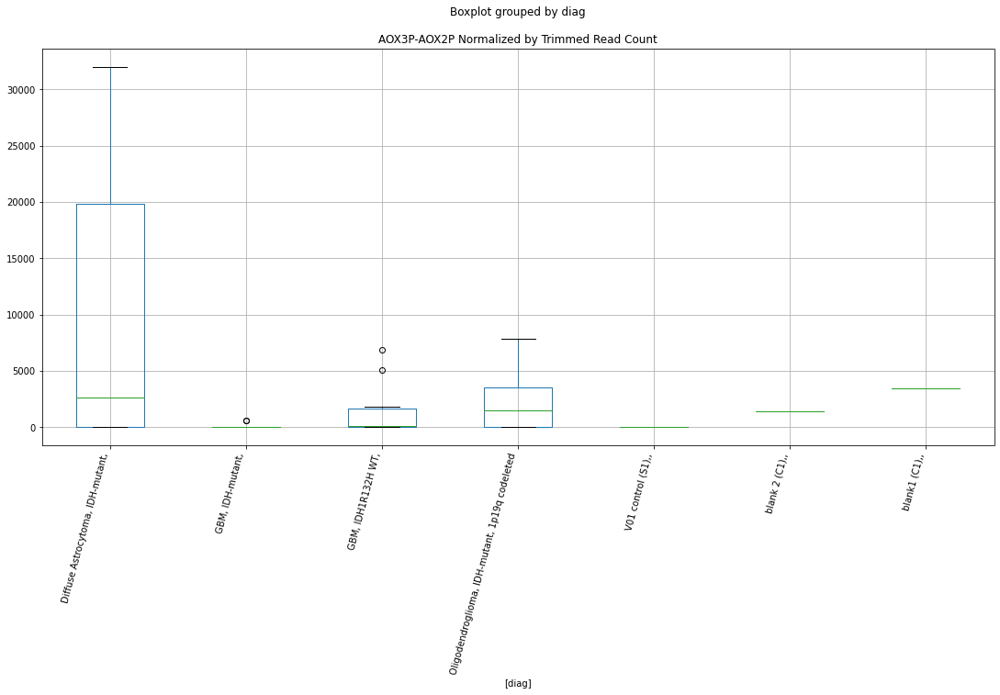

 p : 0.02683643951310951  ( t : 2.4105954564291263 ) :  D-plex  :  bbduk2  :  AEBP1
Control and blanks
73     1546.02
337    1780.31
Name: AEBP1, dtype: float64
205    7880.0
Name: AEBP1, dtype: float64
469    4732.22
Name: AEBP1, dtype: float64


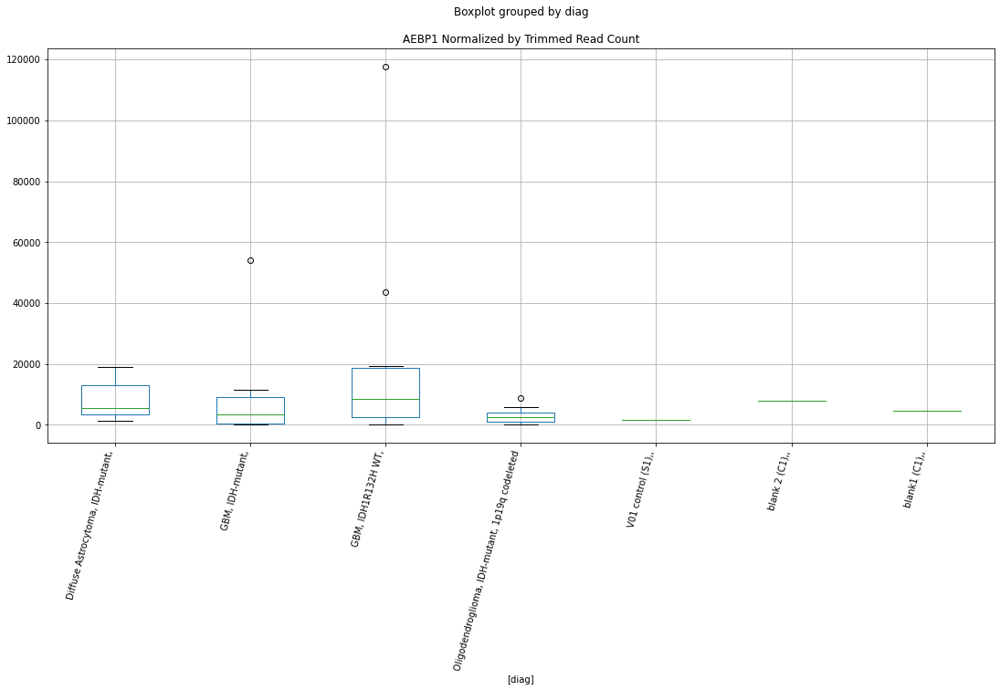

 p : 0.026962738756614972  ( t : 2.408310759559306 ) :  D-plex  :  bbduk2  :  AHCY
Control and blanks
73     1546.02
337       0.00
Name: AHCY, dtype: float64
205    11999.09
Name: AHCY, dtype: float64
469    8281.38
Name: AHCY, dtype: float64


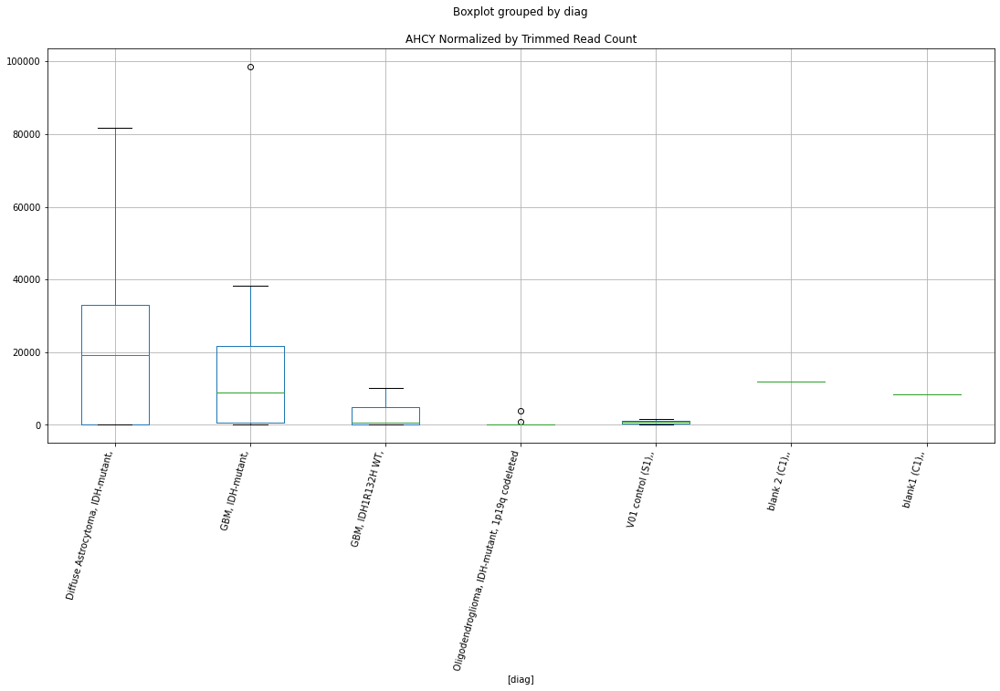

 p : 0.026994550581346664  ( t : 2.407736876800131 ) :  D-plex  :  bbduk2  :  APBB2
Control and blanks
73     0.0
337    0.0
Name: APBB2, dtype: float64
205    5730.91
Name: APBB2, dtype: float64
469    10647.49
Name: APBB2, dtype: float64


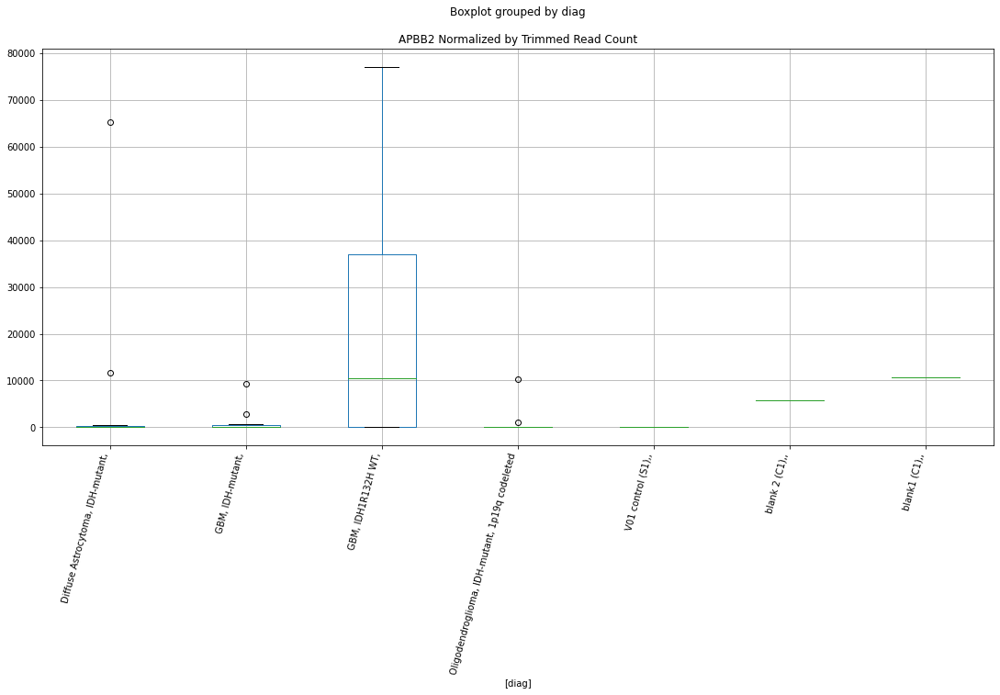

 p : 0.02703777620028061  ( t : 2.406958103312932 ) :  Lexogen  :  bbduk2  :  AMZ1
Control and blanks
79     0.0
343    0.0
Name: AMZ1, dtype: float64
211    0.0
Name: AMZ1, dtype: float64
475    0.0
Name: AMZ1, dtype: float64


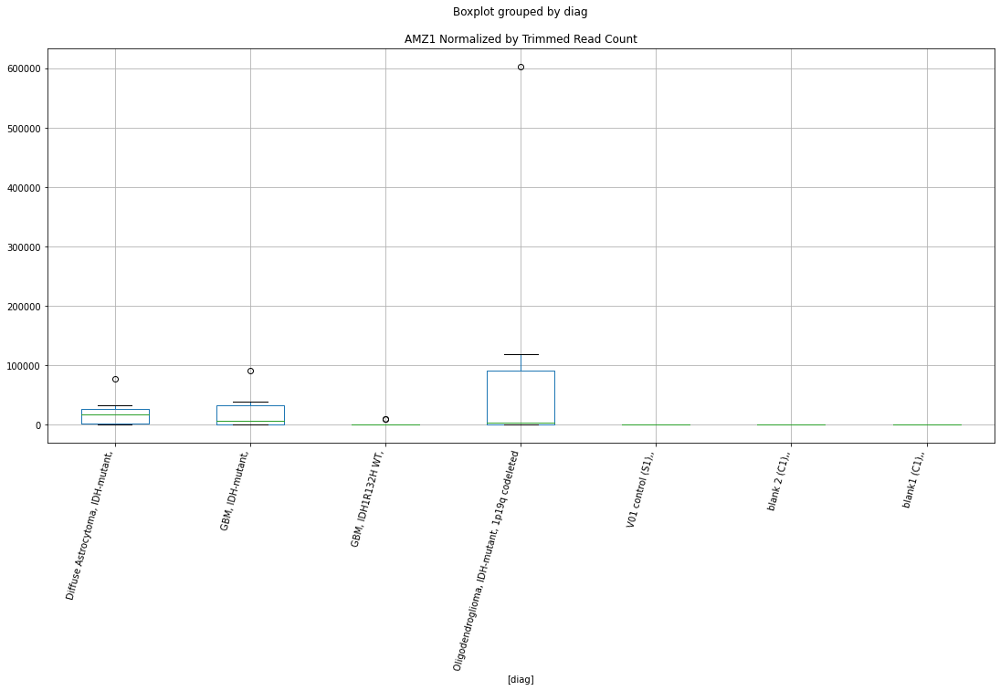

 p : 0.02703990678271516  ( t : 2.406919747847371 ) :  Lexogen  :  cutadapt2  :  BRD9
Control and blanks
82       0.00
346    210.43
Name: BRD9, dtype: float64
214    2169.81
Name: BRD9, dtype: float64
478    0.0
Name: BRD9, dtype: float64


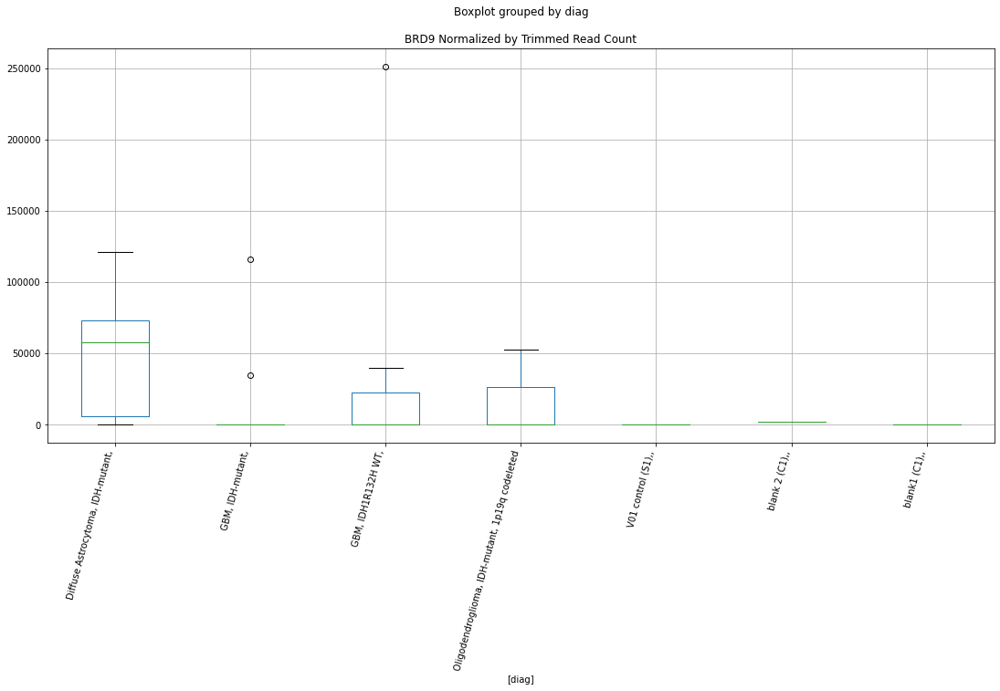

 p : 0.02706153912189652  ( t : 2.4065304751738714 ) :  Lexogen  :  bbduk2  :  BAZ2A
Control and blanks
79     0.0
343    0.0
Name: BAZ2A, dtype: float64
211    819.92
Name: BAZ2A, dtype: float64
475    0.0
Name: BAZ2A, dtype: float64


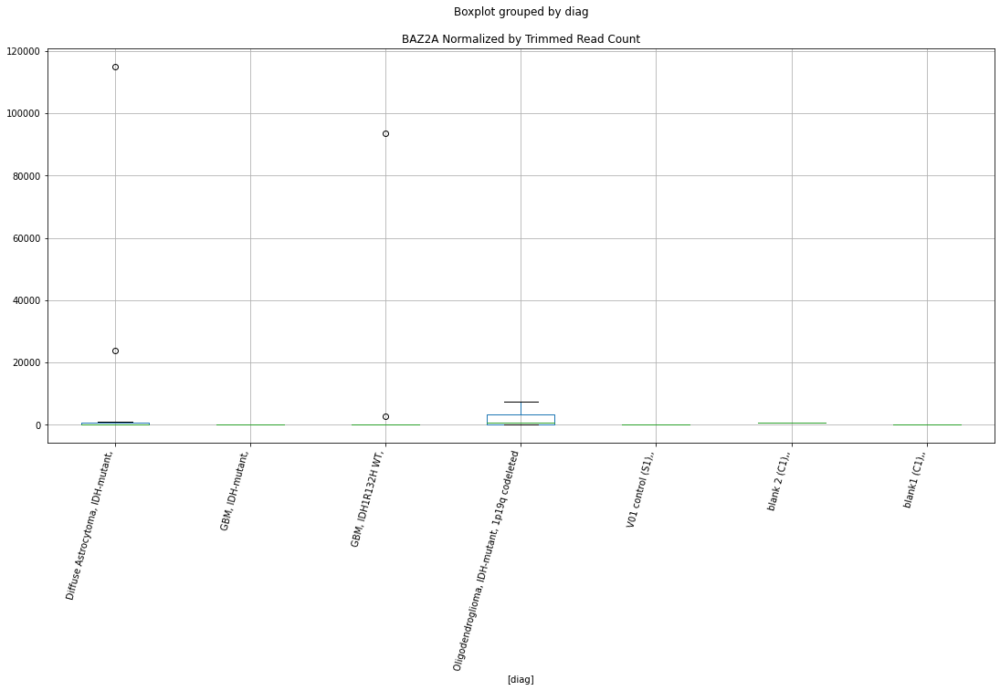

 p : 0.027126642171891  ( t : 2.405360703533522 ) :  D-plex  :  cutadapt2  :  CDS1
Control and blanks
76     0.0
340    0.0
Name: CDS1, dtype: float64
208    3174.48
Name: CDS1, dtype: float64
472    0.0
Name: CDS1, dtype: float64


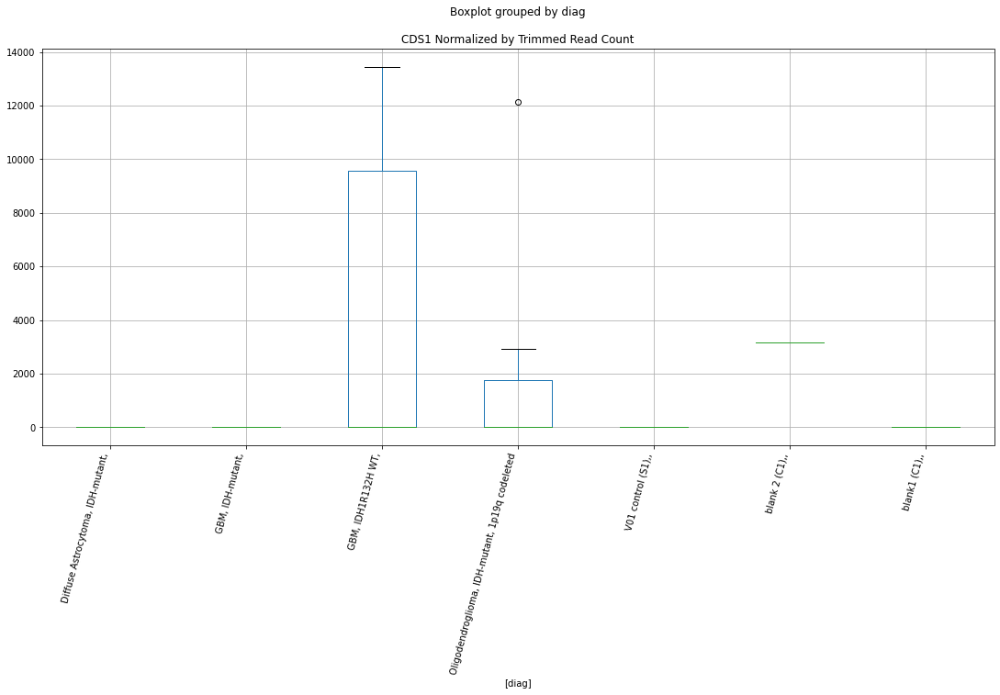

 p : 0.027138308510379017  ( t : 2.4051513602783463 ) :  D-plex  :  cutadapt2  :  C1orf198
Control and blanks
76     3030.46
340    3522.93
Name: C1orf198, dtype: float64
208    14814.26
Name: C1orf198, dtype: float64
472    18494.59
Name: C1orf198, dtype: float64


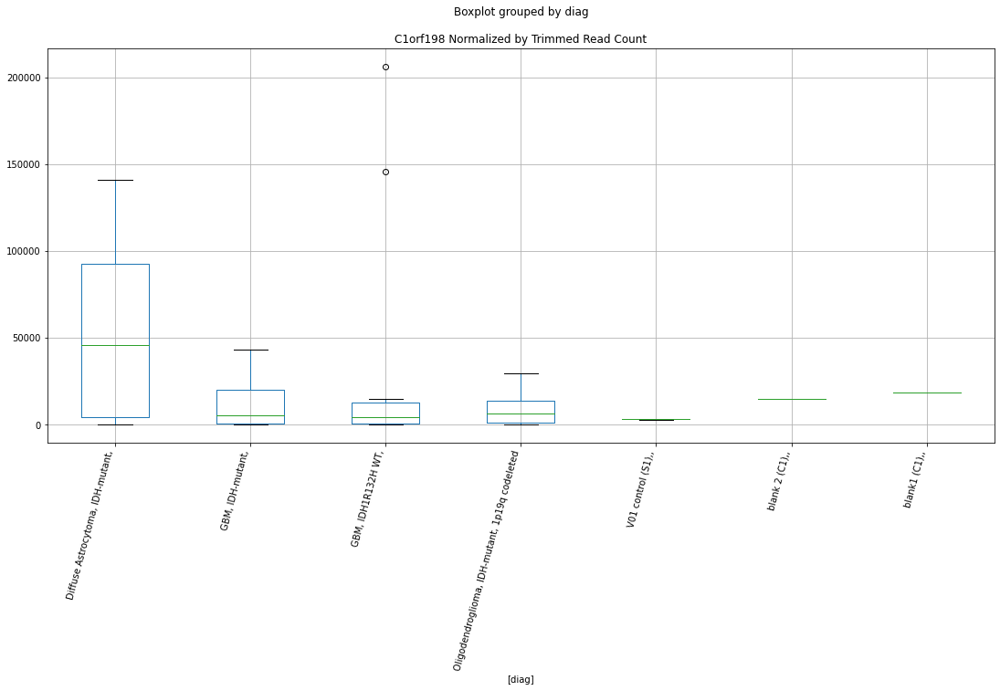

 p : 0.027193122148483916  ( t : 2.404168898272059 ) :  Lexogen  :  bbduk2  :  ATXN1
Control and blanks
79         0.00
343    57324.87
Name: ATXN1, dtype: float64
211    0.0
Name: ATXN1, dtype: float64
475    718.55
Name: ATXN1, dtype: float64


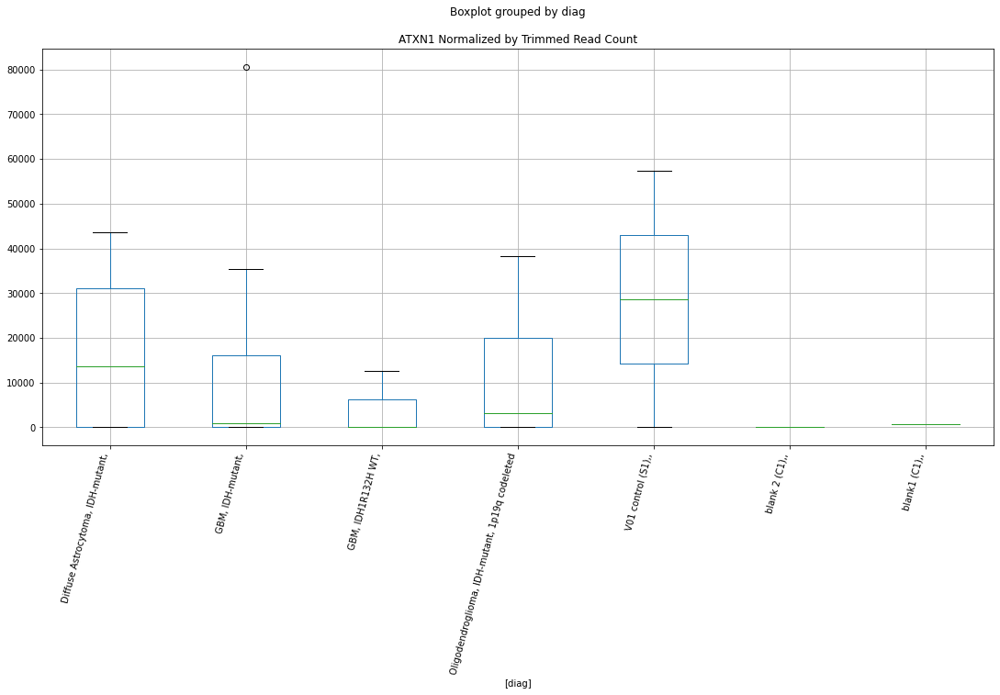

 p : 0.02725359404863776  ( t : 2.4030871661451023 ) :  D-plex  :  bbduk2  :  CLTC
Control and blanks
73     1546.02
337       0.00
Name: CLTC, dtype: float64
205    3581.82
Name: CLTC, dtype: float64
469    0.0
Name: CLTC, dtype: float64


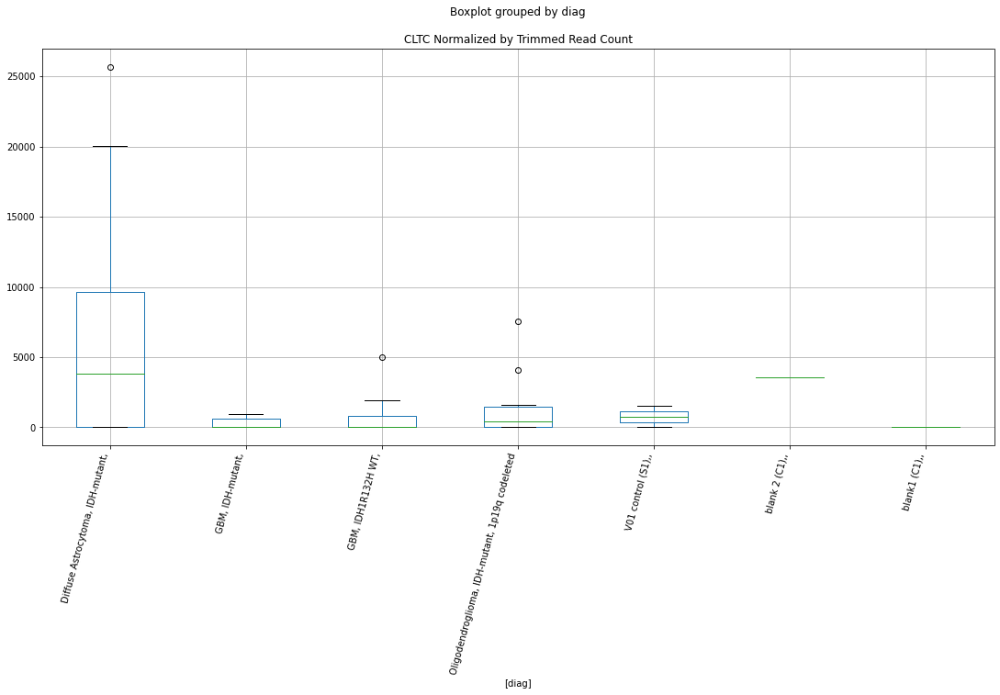

 p : 0.02731782209007376  ( t : 2.4019406990983847 ) :  Lexogen  :  cutadapt2  :  AMZ1
Control and blanks
82     0.0
346    0.0
Name: AMZ1, dtype: float64
214    0.0
Name: AMZ1, dtype: float64
478    0.0
Name: AMZ1, dtype: float64


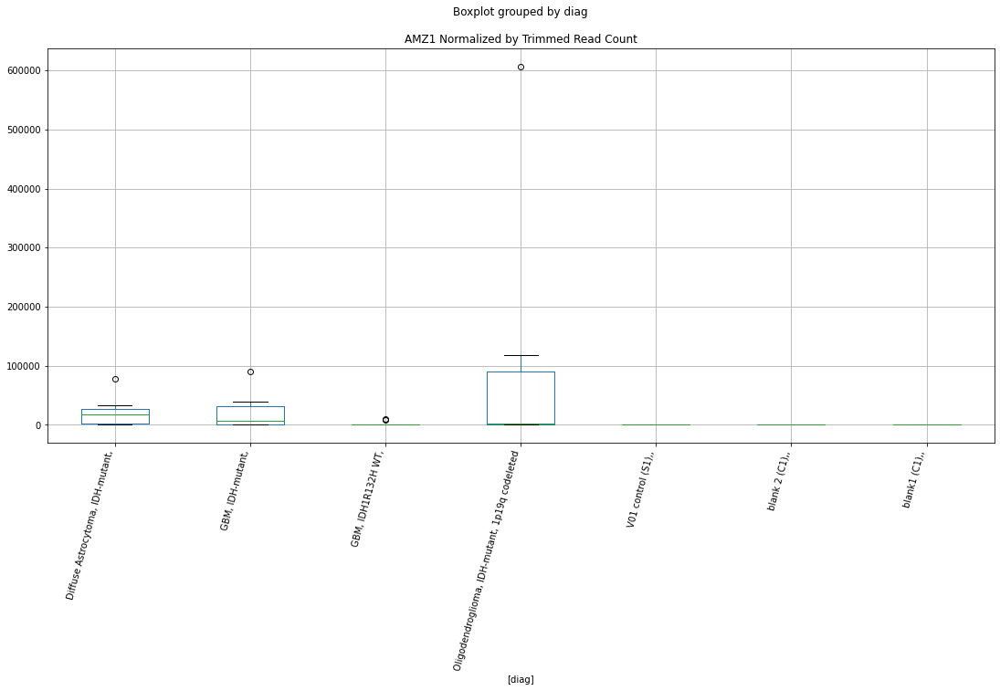

 p : 0.02746206016148651  ( t : 2.3993752168055296 ) :  D-plex  :  cutadapt2  :  ASB16
Control and blanks
76     27274.11
340        0.00
Name: ASB16, dtype: float64
208    56258.91
Name: ASB16, dtype: float64
472    6357.51
Name: ASB16, dtype: float64


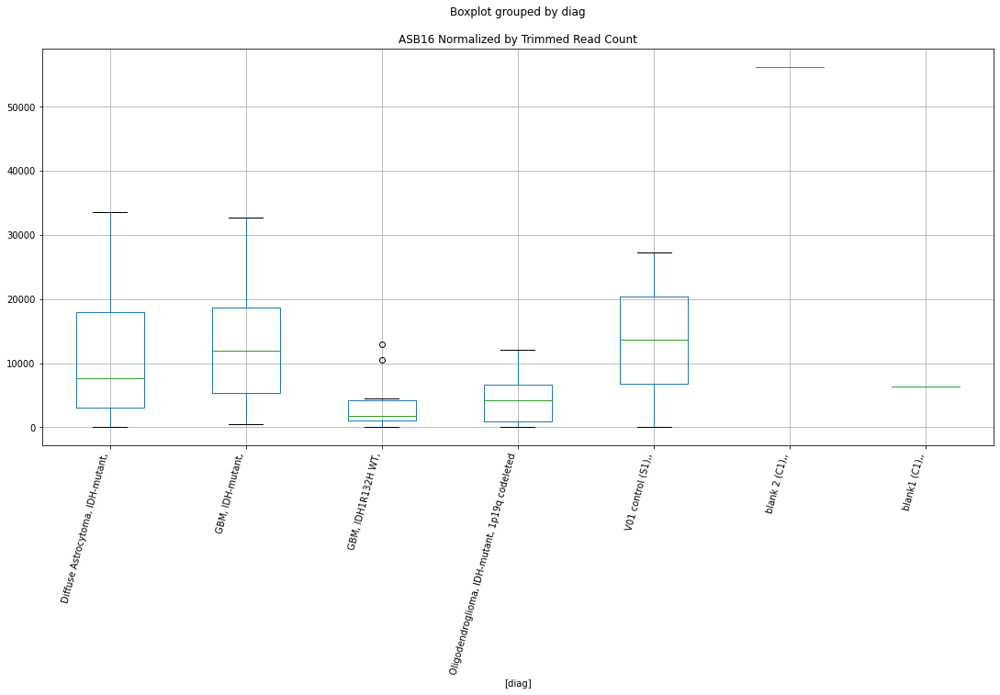

 p : 0.027554037700036012  ( t : 2.3977458341884317 ) :  D-plex  :  cutadapt2  :  CFH
Control and blanks
76     142431.47
340      3522.93
Name: CFH, dtype: float64
208    7759.85
Name: CFH, dtype: float64
472    938600.28
Name: CFH, dtype: float64


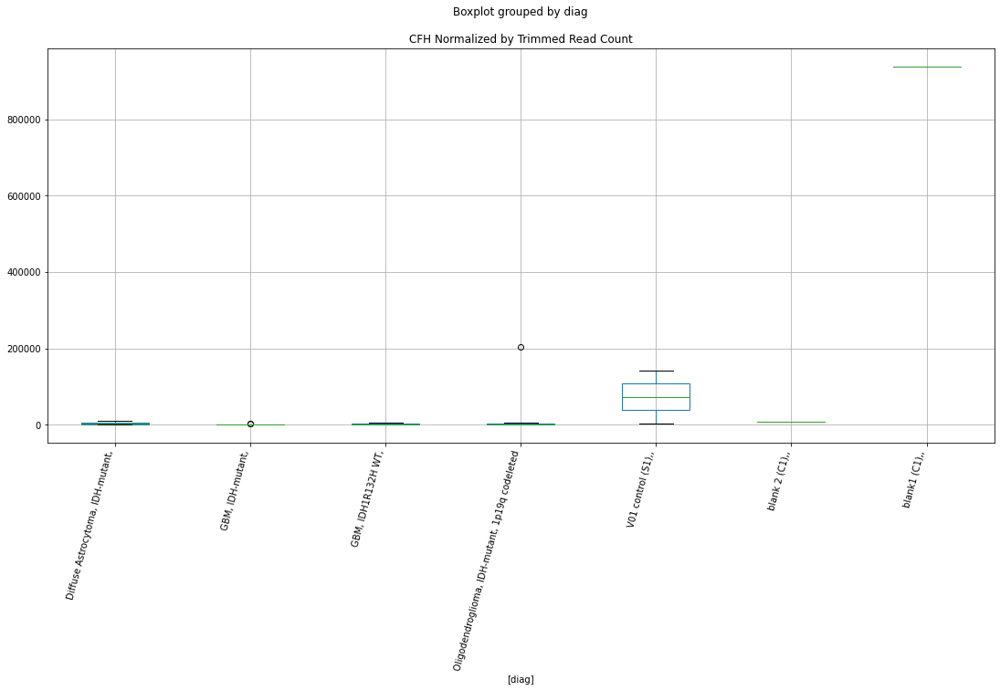

 p : 0.027563992251207512  ( t : 2.397569794320069 ) :  Lexogen  :  bbduk2  :  BHLHE41
Control and blanks
79     0.0
343    0.0
Name: BHLHE41, dtype: float64
211    0.0
Name: BHLHE41, dtype: float64
475    0.0
Name: BHLHE41, dtype: float64


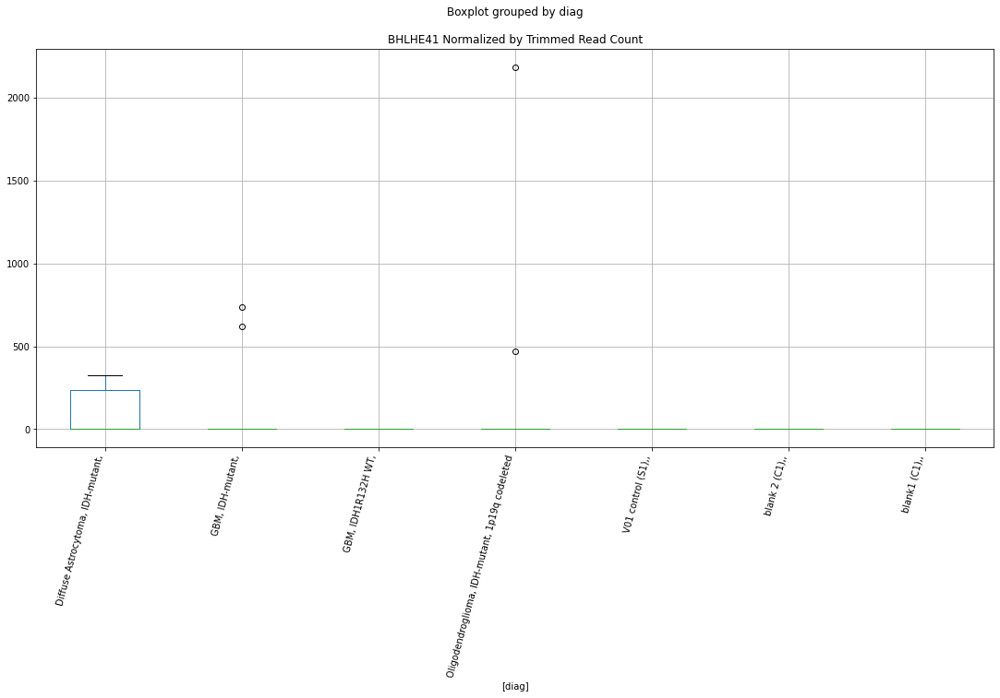

 p : 0.027579344134287153  ( t : 2.3972984225645813 ) :  Lexogen  :  cutadapt2  :  CPD
Control and blanks
82     0.0
346    0.0
Name: CPD, dtype: float64
214    542.45
Name: CPD, dtype: float64
478    0.0
Name: CPD, dtype: float64


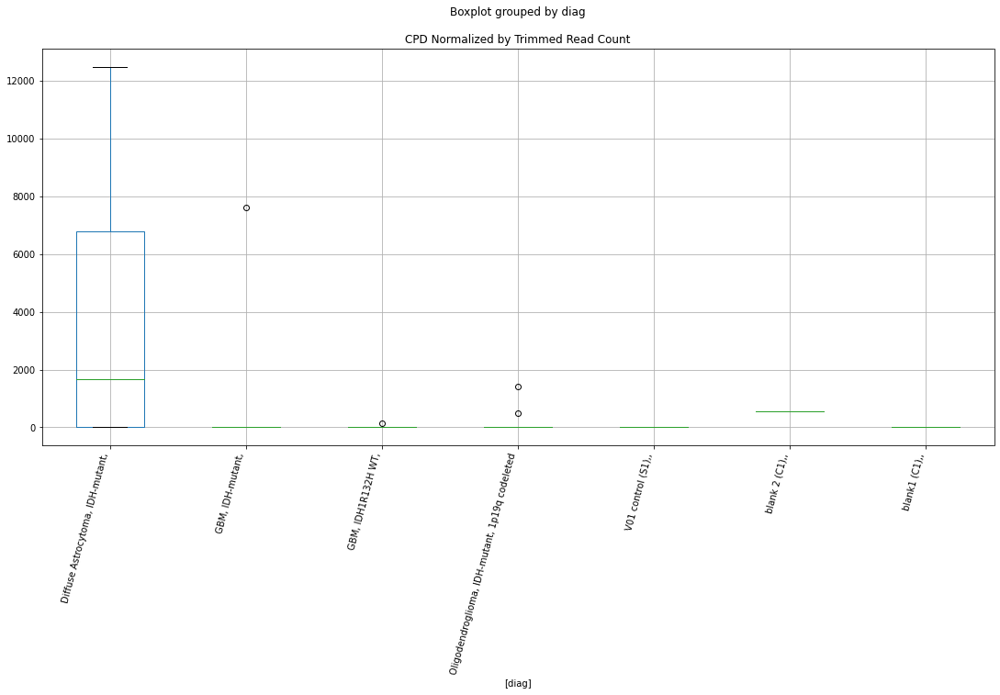

 p : 0.027642476775519474  ( t : 2.396183923563583 ) :  Lexogen  :  cutadapt2  :  ADAMTS18
Control and blanks
82     0.0
346    0.0
Name: ADAMTS18, dtype: float64
214    0.0
Name: ADAMTS18, dtype: float64
478    0.0
Name: ADAMTS18, dtype: float64


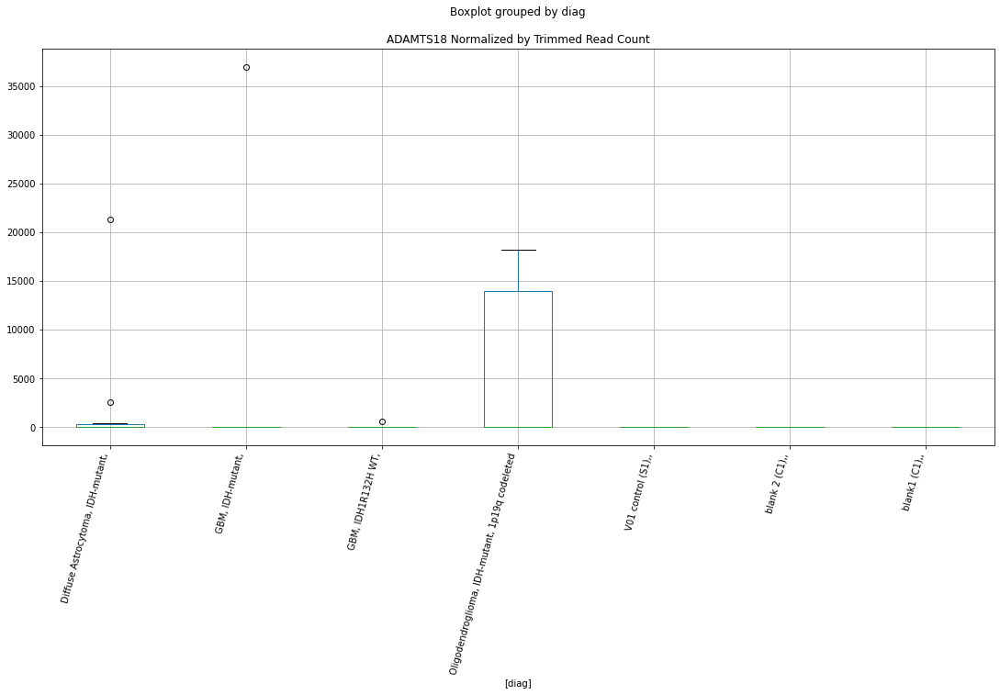

 p : 0.02770678693217599  ( t : 2.395051081189047 ) :  D-plex  :  cutadapt2  :  DDX60
Control and blanks
76     0.0
340    0.0
Name: DDX60, dtype: float64
208    2116.32
Name: DDX60, dtype: float64
472    4045.69
Name: DDX60, dtype: float64


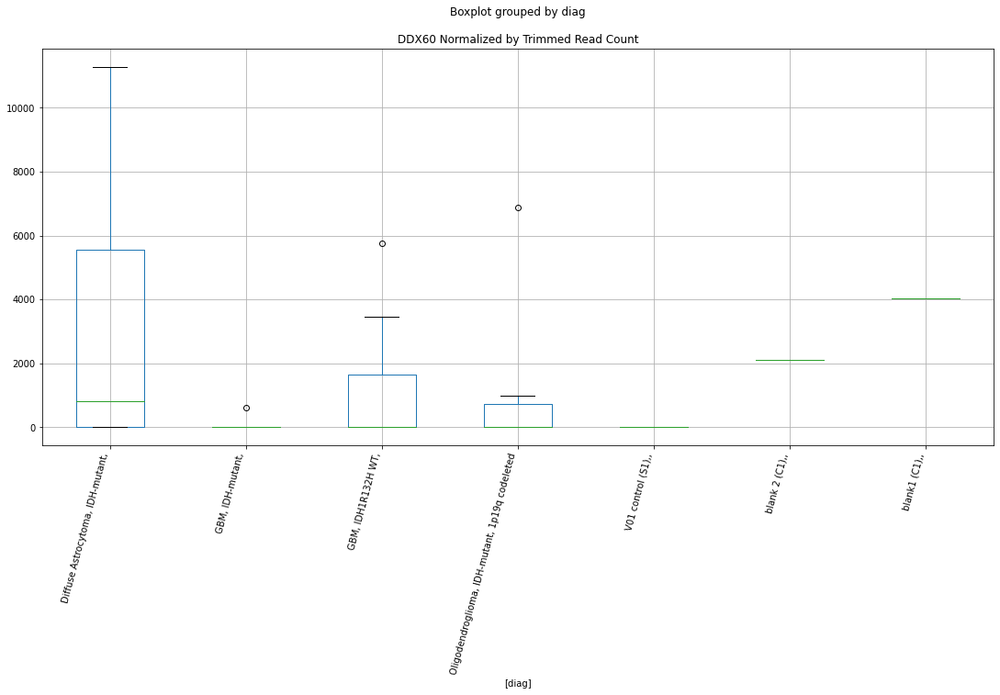

 p : 0.027720898329112103  ( t : 2.3948028336120672 ) :  D-plex  :  cutadapt2  :  CPNE1
Control and blanks
76     0.0
340    0.0
Name: CPNE1, dtype: float64
208    1234.52
Name: CPNE1, dtype: float64
472    4045.69
Name: CPNE1, dtype: float64


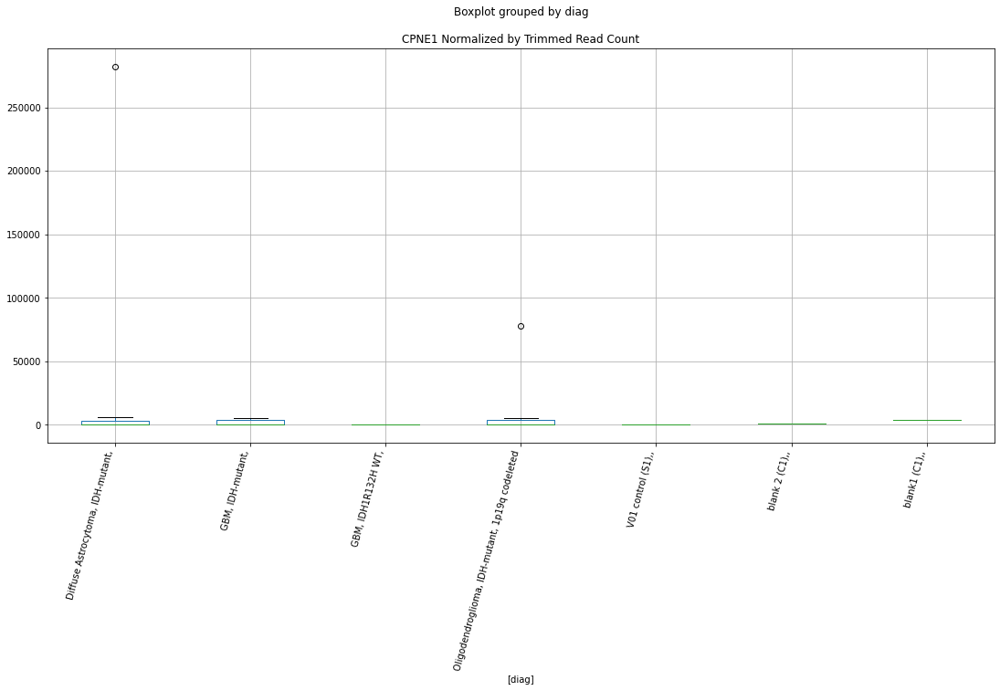

 p : 0.027742226051903154  ( t : 2.3944278605585674 ) :  D-plex  :  bbduk2  :  CPNE1
Control and blanks
73     0.0
337    0.0
Name: CPNE1, dtype: float64
205    1253.64
Name: CPNE1, dtype: float64
469    4140.69
Name: CPNE1, dtype: float64


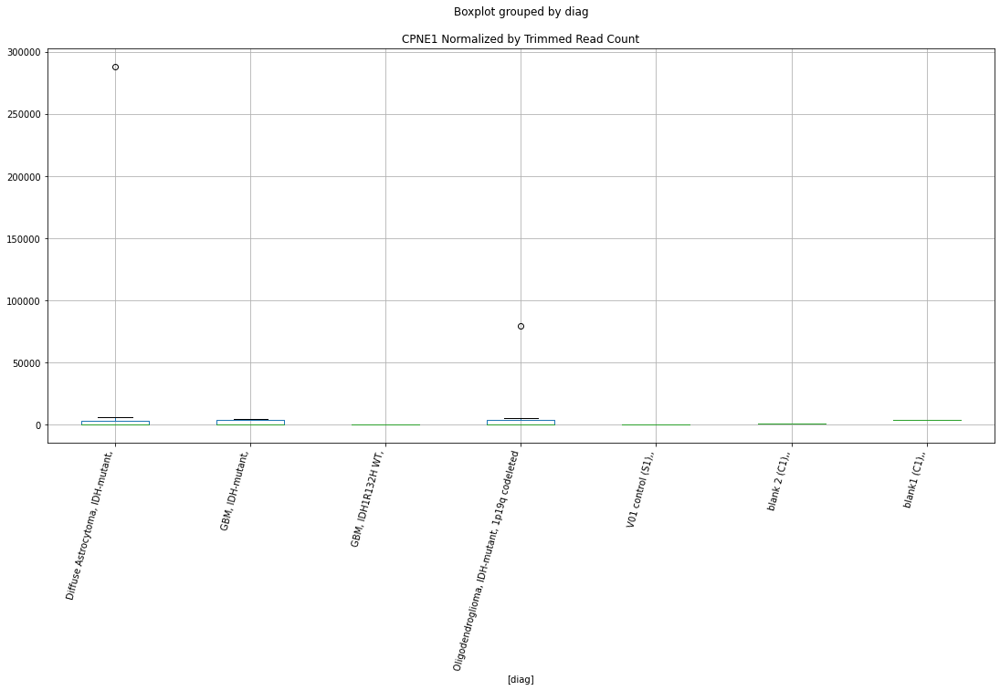

 p : 0.02774258273132163  ( t : 2.3944215918953784 ) :  Lexogen  :  bbduk2  :  CIT
Control and blanks
79        0.00
343    6369.43
Name: CIT, dtype: float64
211    20497.98
Name: CIT, dtype: float64
475    0.0
Name: CIT, dtype: float64


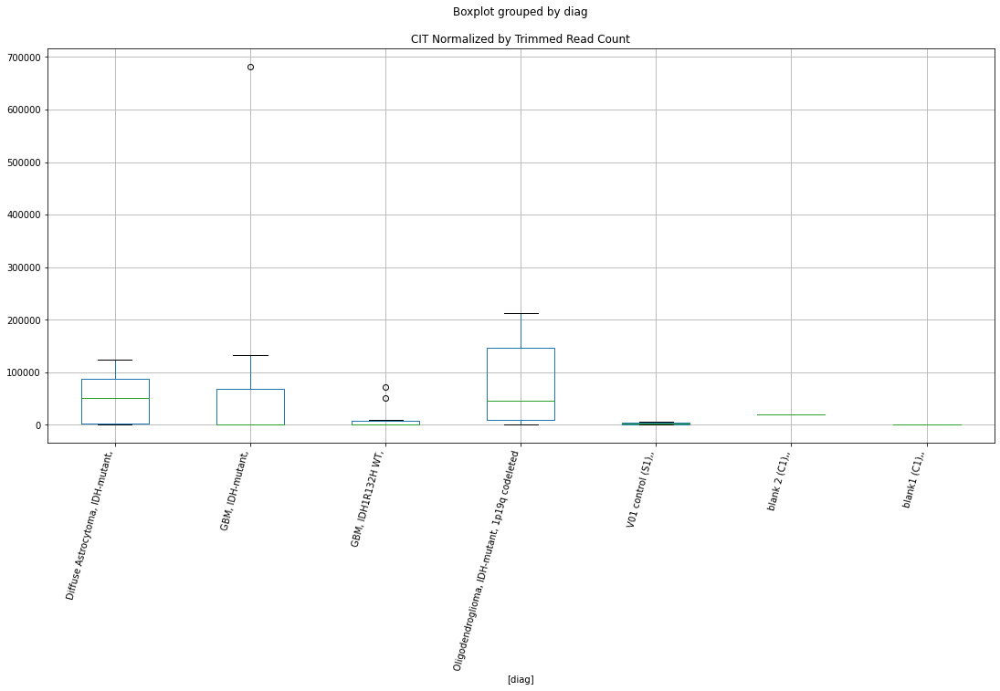

 p : 0.02775583295366695  ( t : 2.394188771763871 ) :  D-plex  :  bbduk2  :  C3orf36
Control and blanks
73     0.0
337    0.0
Name: C3orf36, dtype: float64
205    179.09
Name: C3orf36, dtype: float64
469    0.0
Name: C3orf36, dtype: float64


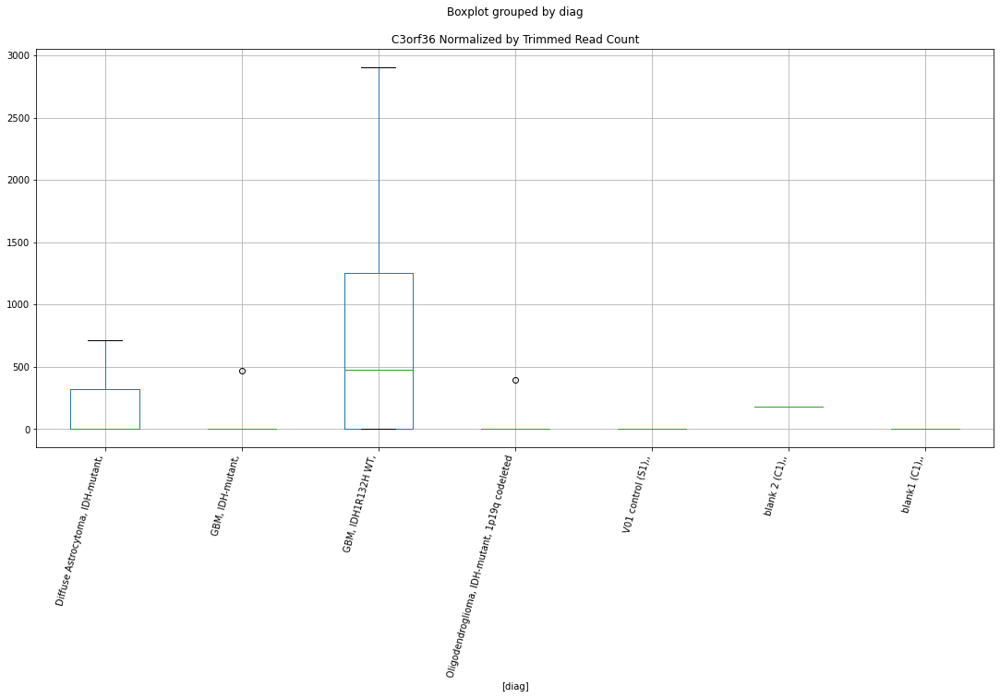

 p : 0.027789720660606258  ( t : 2.393593801873397 ) :  D-plex  :  bbduk2  :  APBB2
Control and blanks
73     0.0
337    0.0
Name: APBB2, dtype: float64
205    5730.91
Name: APBB2, dtype: float64
469    10647.49
Name: APBB2, dtype: float64


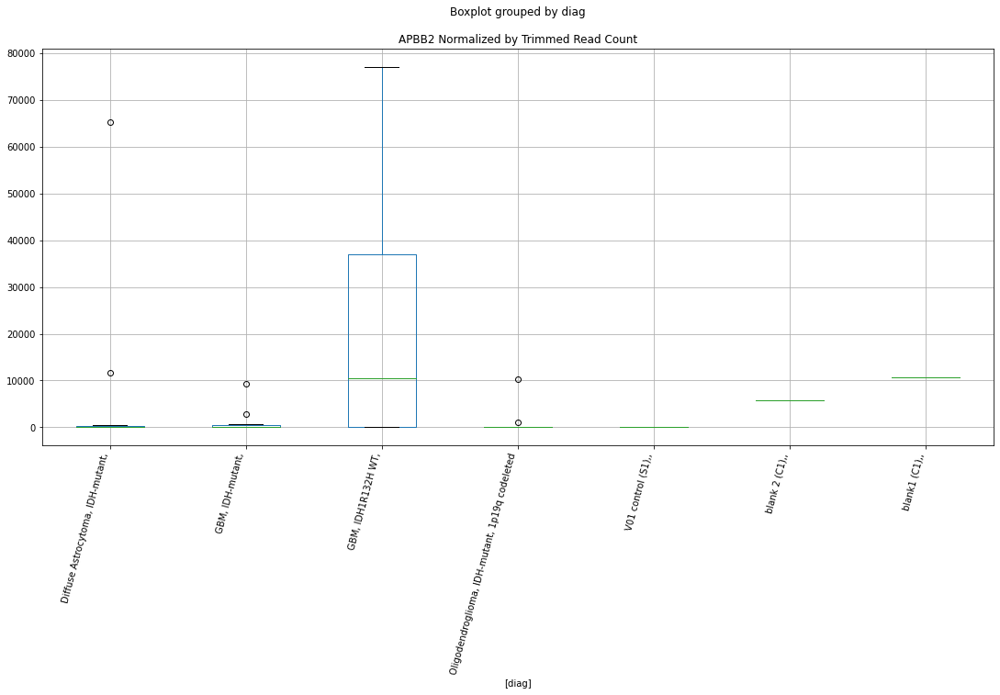

 p : 0.027811378431303754  ( t : 2.3932139092565987 ) :  D-plex  :  cutadapt2  :  CLEC3B
Control and blanks
76     0.0
340    0.0
Name: CLEC3B, dtype: float64
208    881.8
Name: CLEC3B, dtype: float64
472    0.0
Name: CLEC3B, dtype: float64


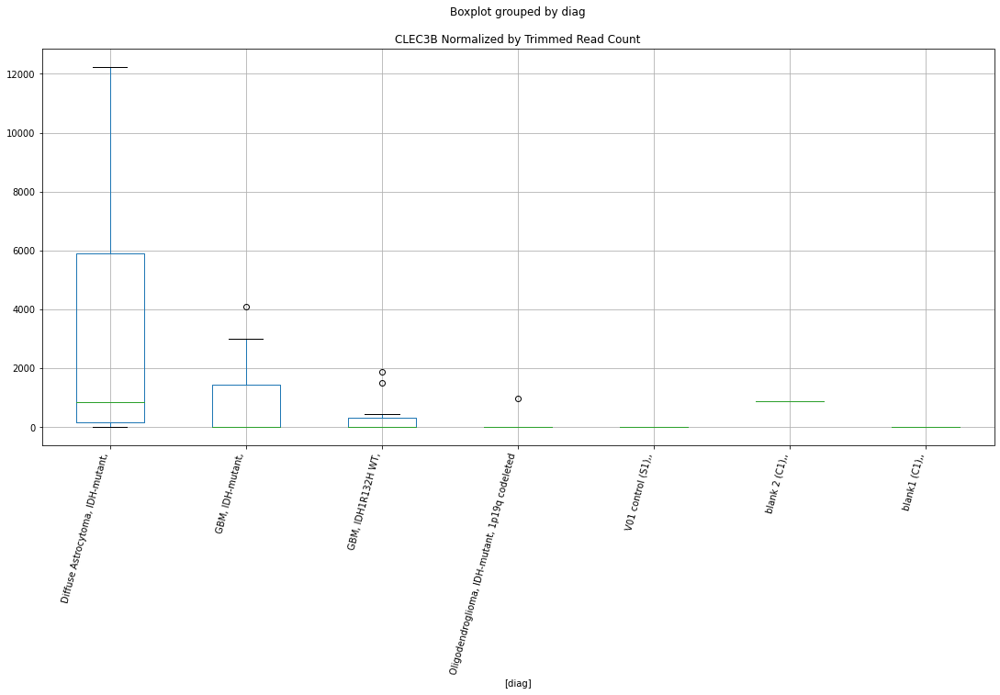

 p : 0.027854593373563944  ( t : 2.392456714082779 ) :  Lexogen  :  cutadapt2  :  CPXM2
Control and blanks
82     0.0
346    0.0
Name: CPXM2, dtype: float64
214    0.0
Name: CPXM2, dtype: float64
478    0.0
Name: CPXM2, dtype: float64


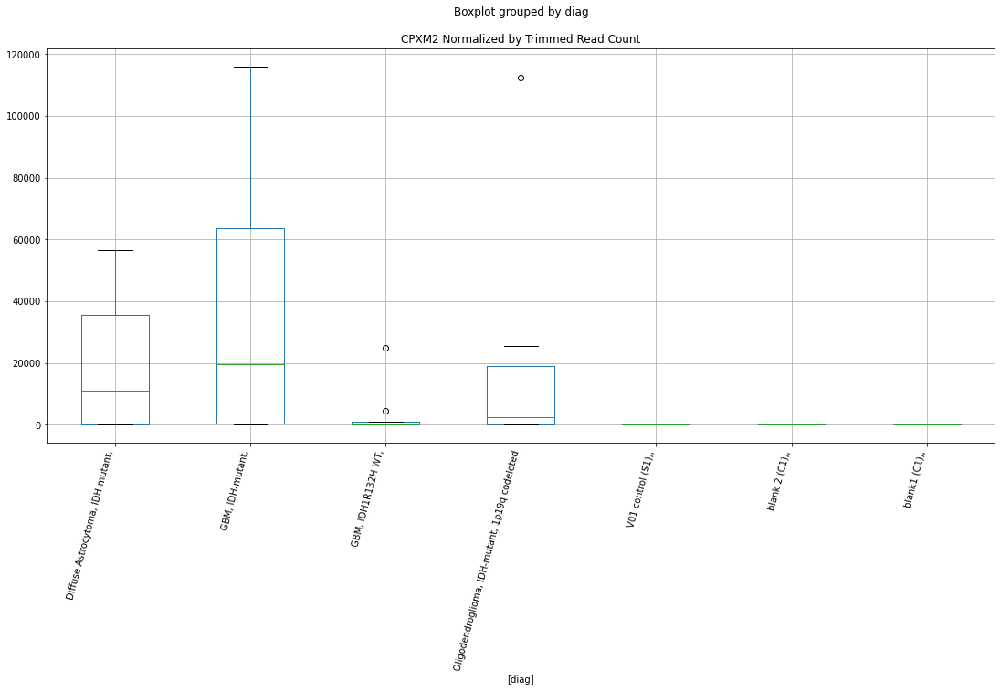

 p : 0.027867952565727924  ( t : 2.3922228617155974 ) :  D-plex  :  cutadapt2  :  CNN1
Control and blanks
76        0.00
340    1761.46
Name: CNN1, dtype: float64
208    2998.12
Name: CNN1, dtype: float64
472    0.0
Name: CNN1, dtype: float64


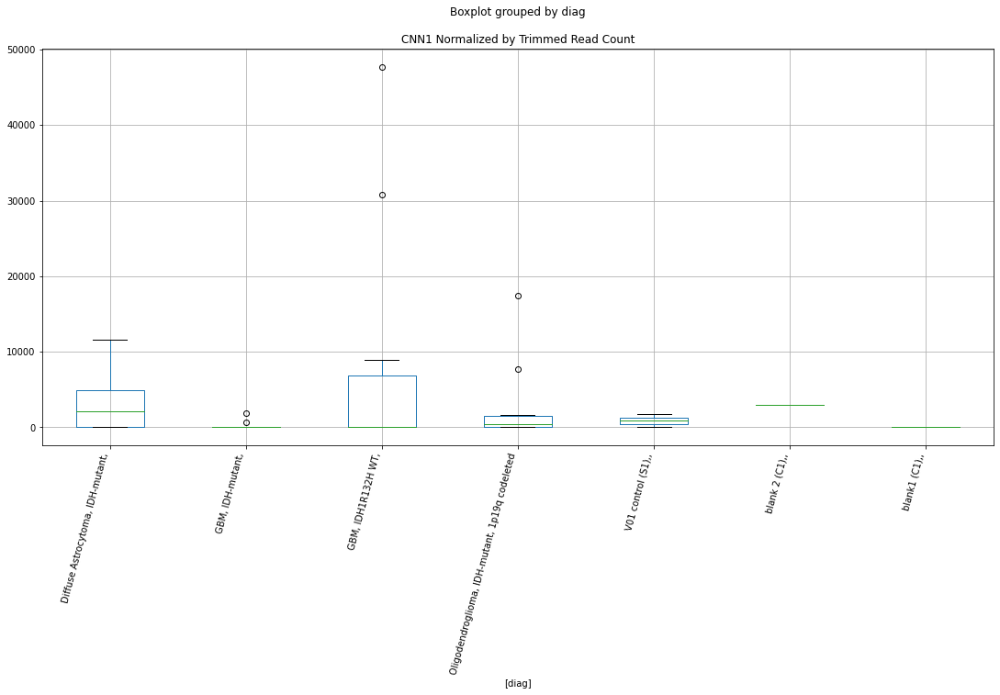

 p : 0.027911085280859536  ( t : 2.391468538937502 ) :  D-plex  :  bbduk2  :  C6orf132
Control and blanks
73     0.0
337    0.0
Name: C6orf132, dtype: float64
205    537.27
Name: C6orf132, dtype: float64
469    591.53
Name: C6orf132, dtype: float64


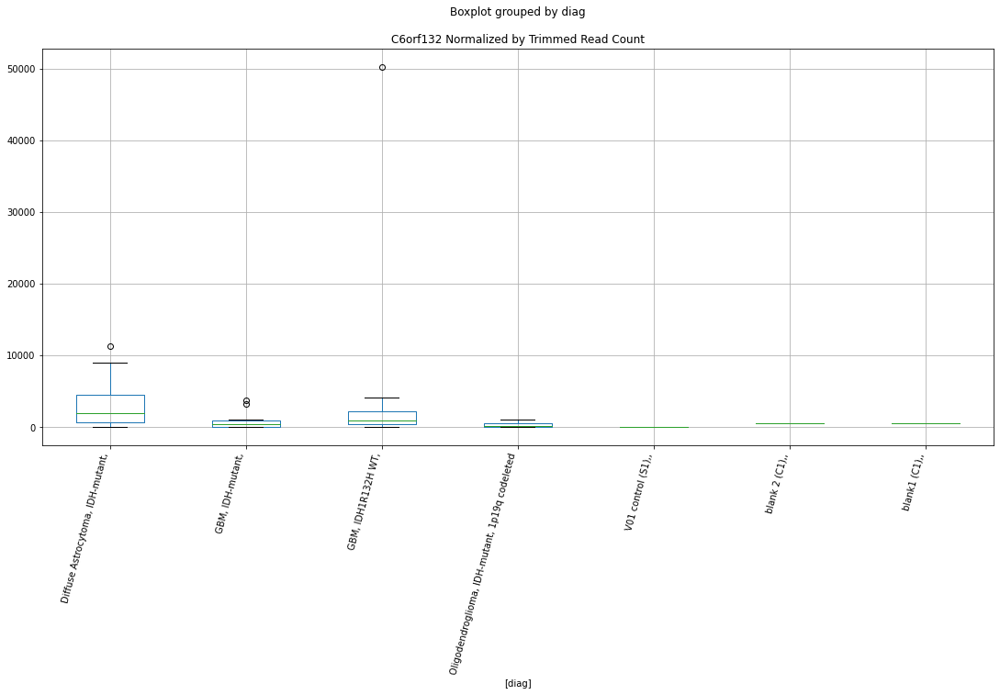

 p : 0.027980087306749415  ( t : 2.390264064987473 ) :  D-plex  :  bbduk2  :  CH17-125A10.2
Control and blanks
73     0.0
337    0.0
Name: CH17-125A10.2, dtype: float64
205    8238.18
Name: CH17-125A10.2, dtype: float64
469    21294.98
Name: CH17-125A10.2, dtype: float64


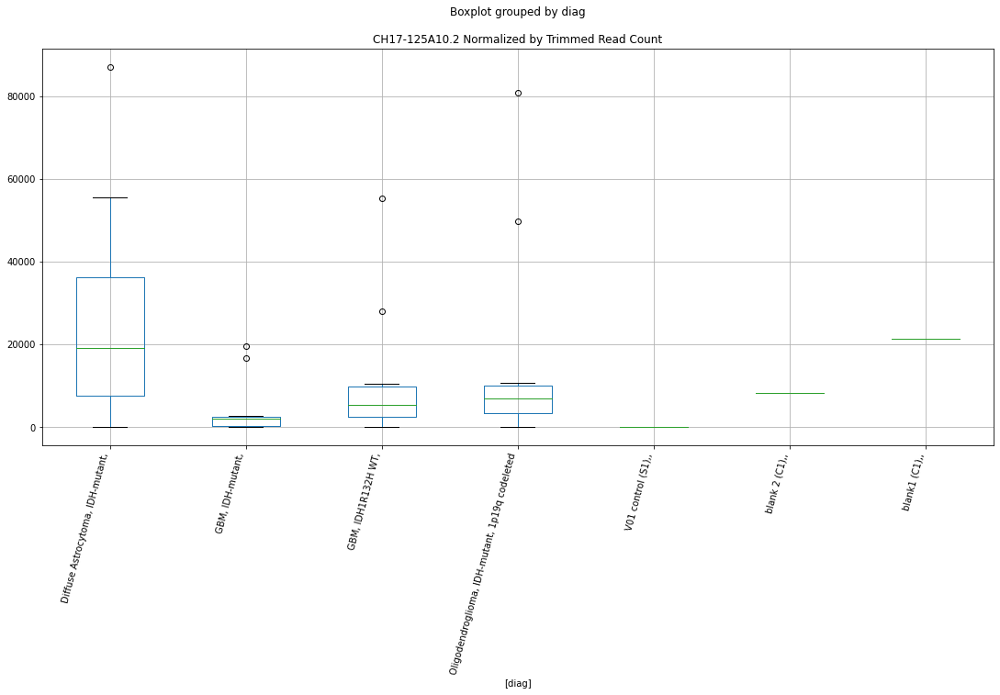

 p : 0.02804226606154204  ( t : 2.3891810703547613 ) :  Lexogen  :  cutadapt2  :  B3GALT6
Control and blanks
82         0.00
346    32406.92
Name: B3GALT6, dtype: float64
214    271.23
Name: B3GALT6, dtype: float64
478    237.46
Name: B3GALT6, dtype: float64


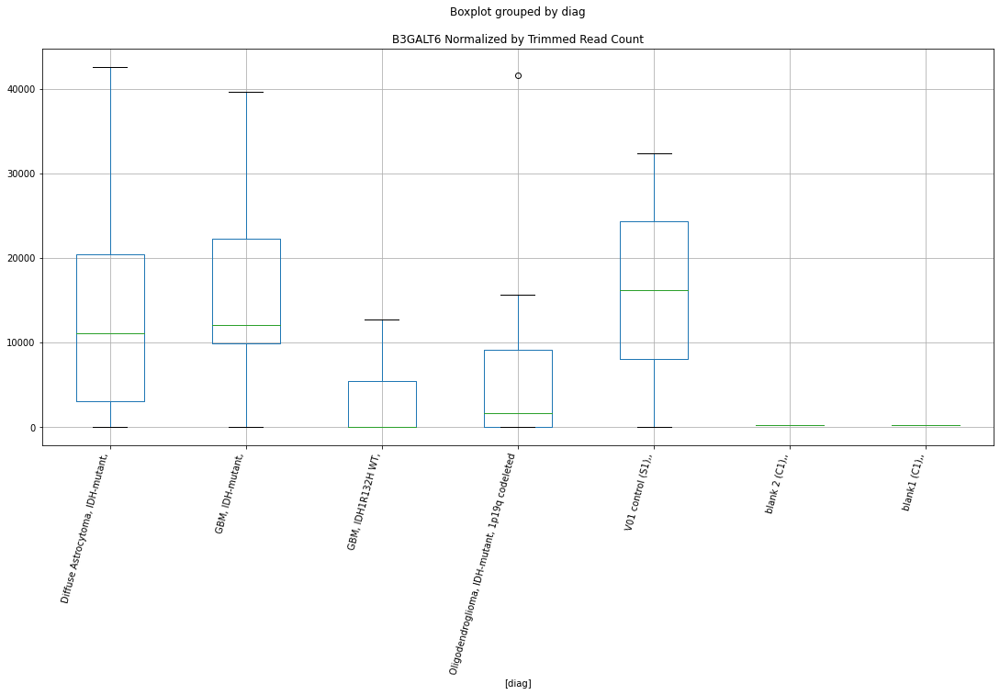

 p : 0.02806599024172626  ( t : 2.3887684471070116 ) :  D-plex  :  bbduk2  :  AOX3P-AOX2P
Control and blanks
73     0.0
337    0.0
Name: AOX3P-AOX2P, dtype: float64
205    1432.73
Name: AOX3P-AOX2P, dtype: float64
469    3549.16
Name: AOX3P-AOX2P, dtype: float64


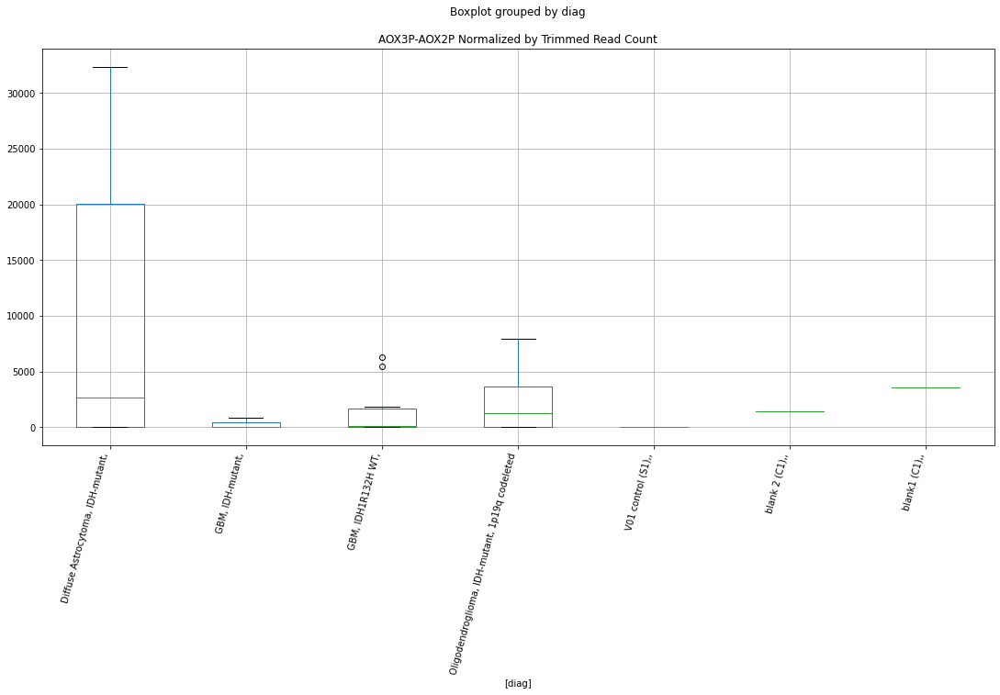

 p : 0.02808592423485663  ( t : 2.3884219965934173 ) :  D-plex  :  bbduk2  :  B3GALNT2
Control and blanks
73     6184.07
337    8901.57
Name: B3GALNT2, dtype: float64
205    0.0
Name: B3GALNT2, dtype: float64
469    4732.22
Name: B3GALNT2, dtype: float64


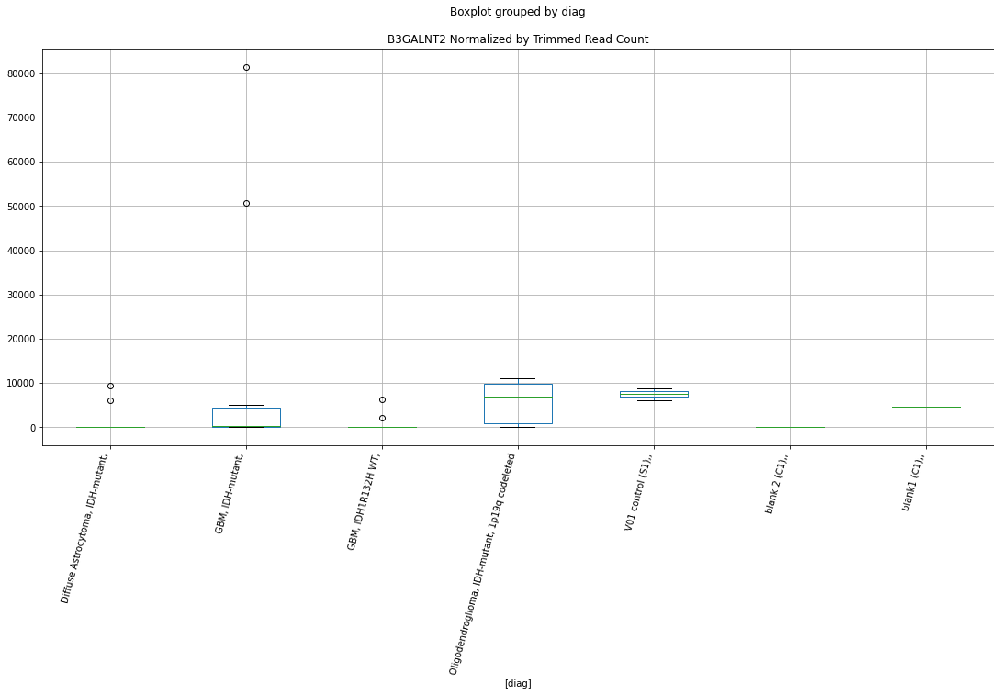

 p : 0.028151160320584814  ( t : 2.3872898046080198 ) :  Lexogen  :  cutadapt2  :  C4orf51
Control and blanks
82     0.0
346    0.0
Name: C4orf51, dtype: float64
214    0.0
Name: C4orf51, dtype: float64
478    85485.77
Name: C4orf51, dtype: float64


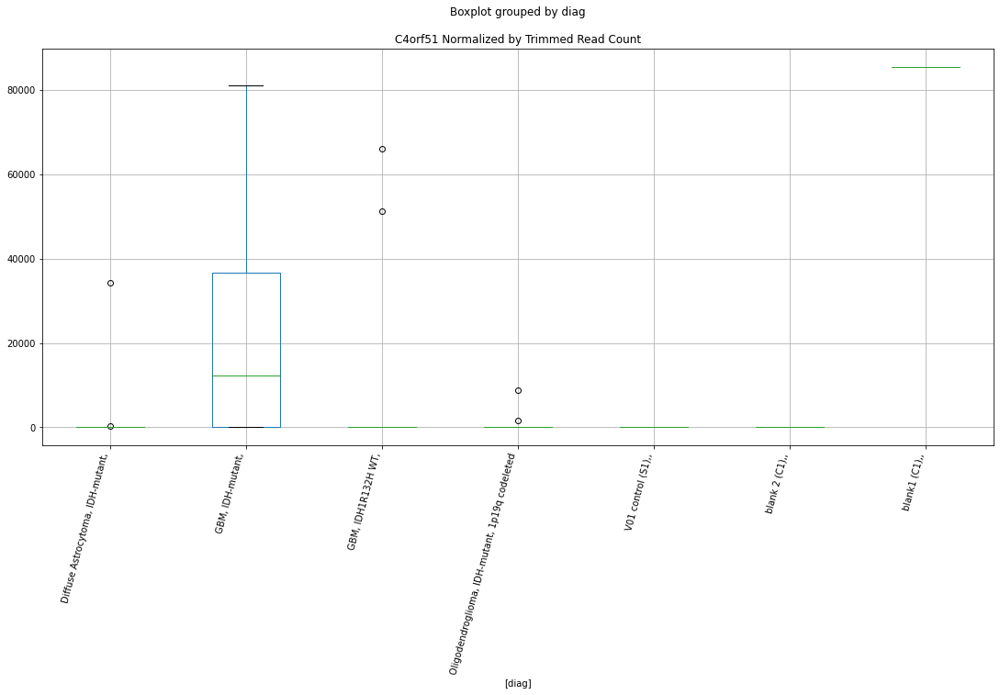

 p : 0.028154987649955582  ( t : 2.3872234562854935 ) :  D-plex  :  bbduk2  :  C1orf198
Control and blanks
73     3092.03
337    3560.63
Name: C1orf198, dtype: float64
205    15043.64
Name: C1orf198, dtype: float64
469    18928.87
Name: C1orf198, dtype: float64


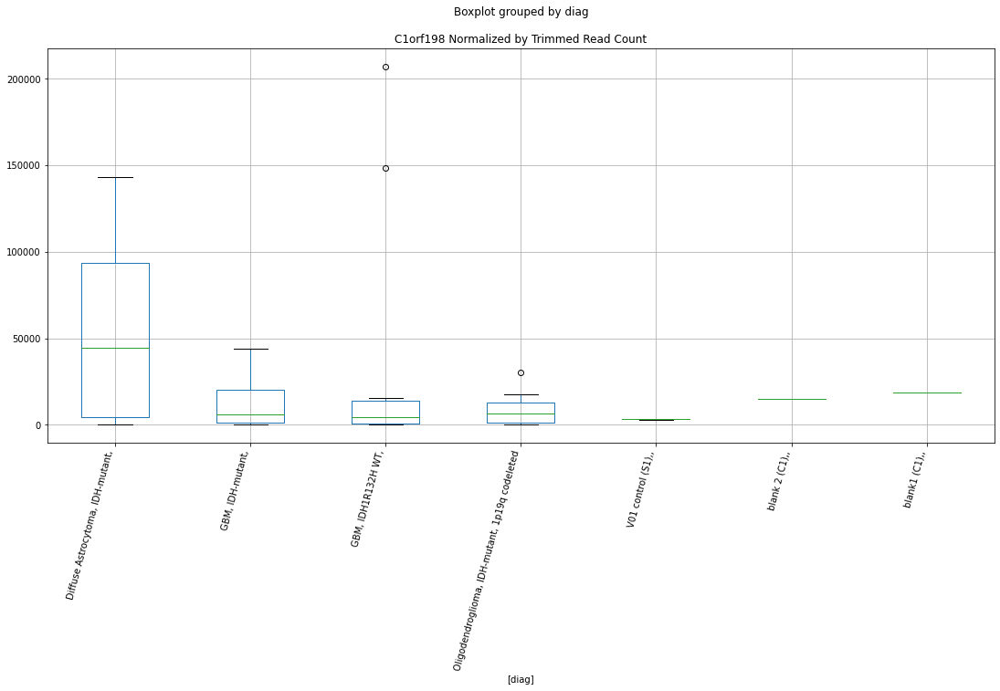

 p : 0.02818897898090461  ( t : 2.3866345720167716 ) :  D-plex  :  cutadapt2  :  DIS3L2
Control and blanks
76          0.00
340    114495.18
Name: DIS3L2, dtype: float64
208    1939.96
Name: DIS3L2, dtype: float64
472    4623.65
Name: DIS3L2, dtype: float64


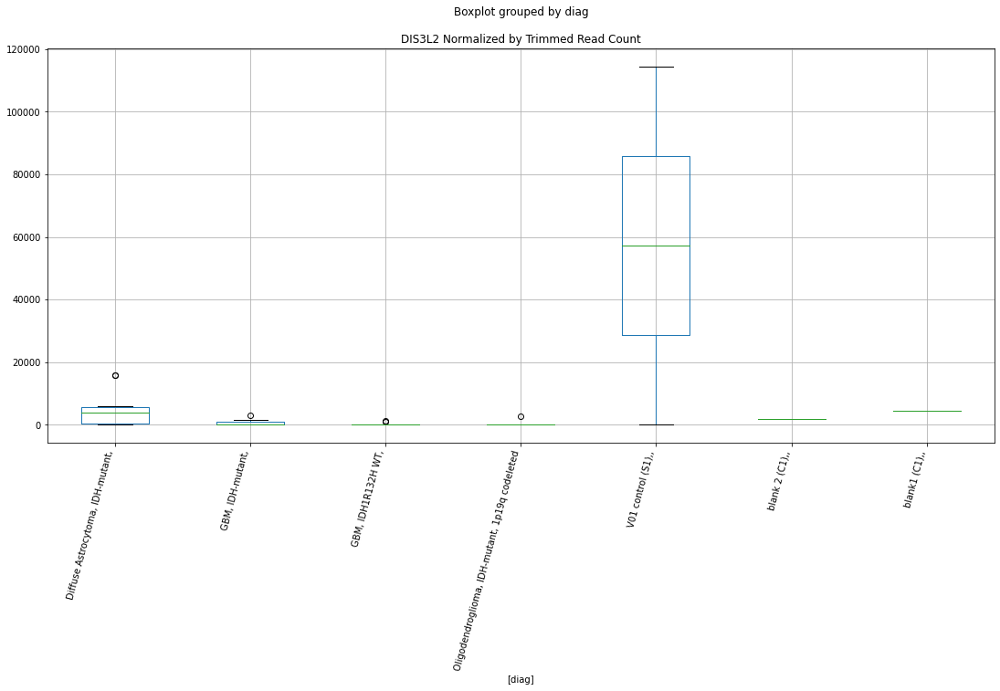

 p : 0.02820511080149425  ( t : 2.386355327644591 ) :  D-plex  :  cutadapt2  :  CMC1
Control and blanks
76         0.0
340    49321.0
Name: CMC1, dtype: float64
208    2645.4
Name: CMC1, dtype: float64
472    5779.56
Name: CMC1, dtype: float64


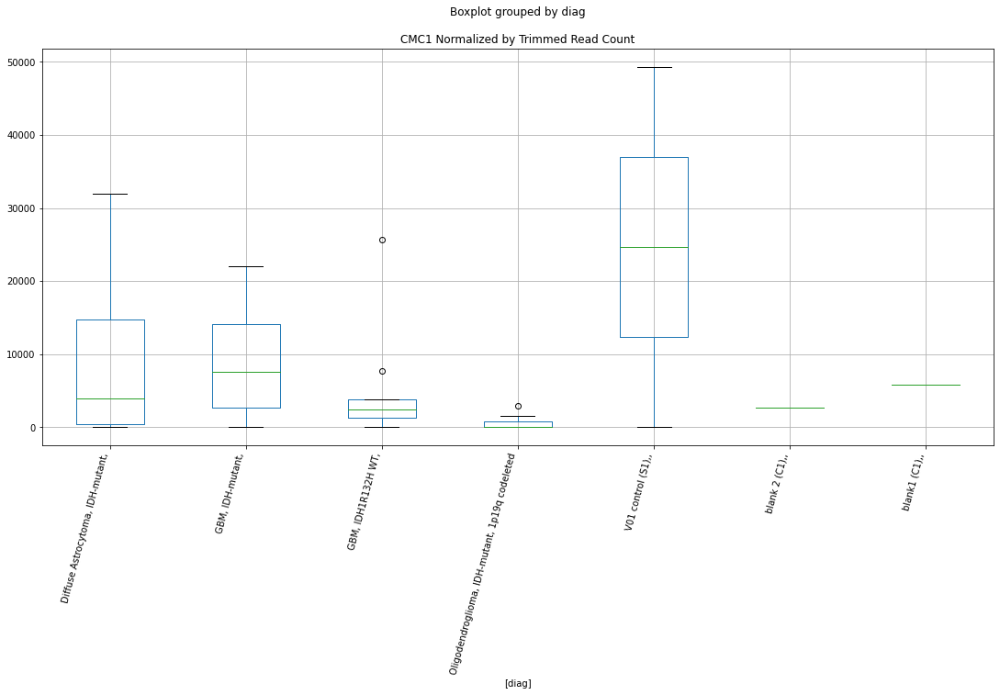

 p : 0.028255769180135233  ( t : 2.3854793917847856 ) :  D-plex  :  bbduk2  :  ARRDC3
Control and blanks
73     0.0
337    0.0
Name: ARRDC3, dtype: float64
205    1790.91
Name: ARRDC3, dtype: float64
469    0.0
Name: ARRDC3, dtype: float64


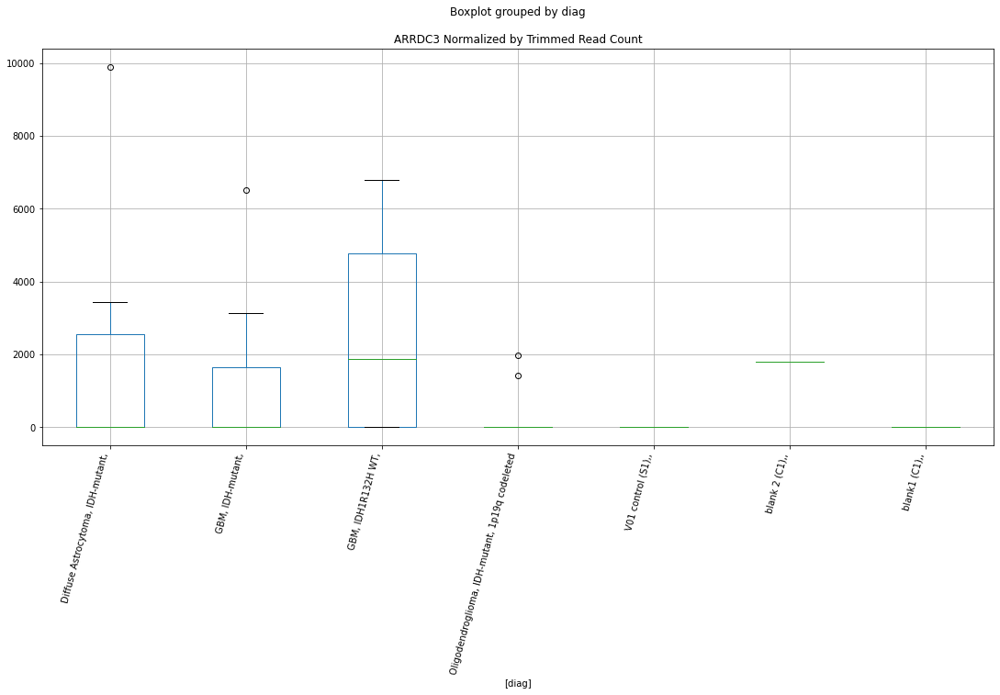

 p : 0.028261018068522045  ( t : 2.3853887169409482 ) :  D-plex  :  bbduk2  :  CALHM1
Control and blanks
73     1546.02
337       0.00
Name: CALHM1, dtype: float64
205    716.36
Name: CALHM1, dtype: float64
469    0.0
Name: CALHM1, dtype: float64


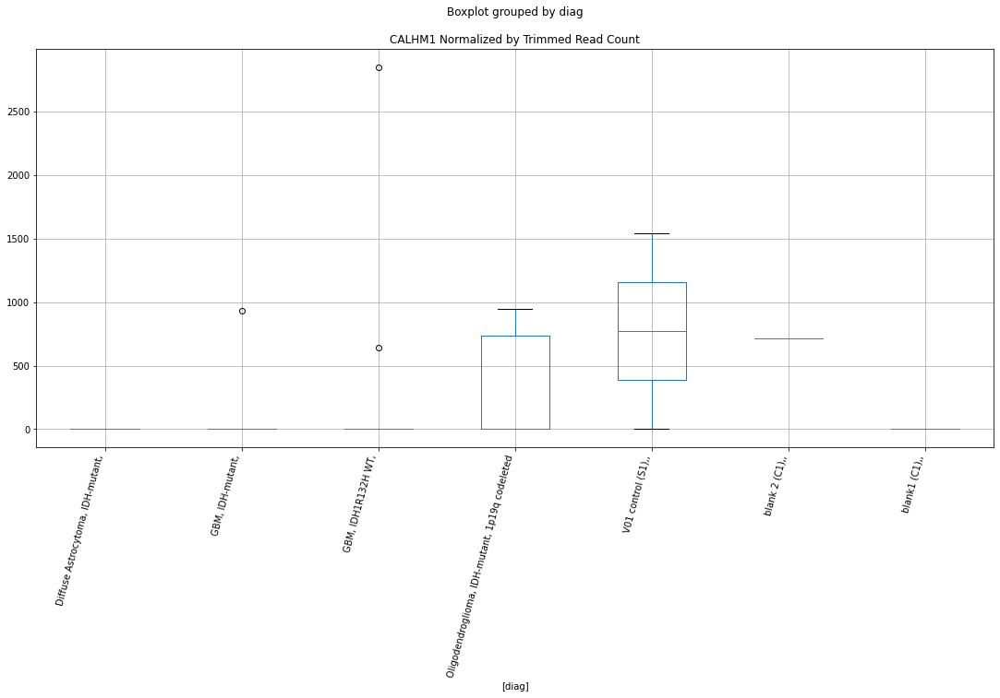

 p : 0.028324866308826985  ( t : 2.3842869924450816 ) :  Lexogen  :  bbduk2  :  COMMD10
Control and blanks
79     0.0
343    0.0
Name: COMMD10, dtype: float64
211    819.92
Name: COMMD10, dtype: float64
475    0.0
Name: COMMD10, dtype: float64


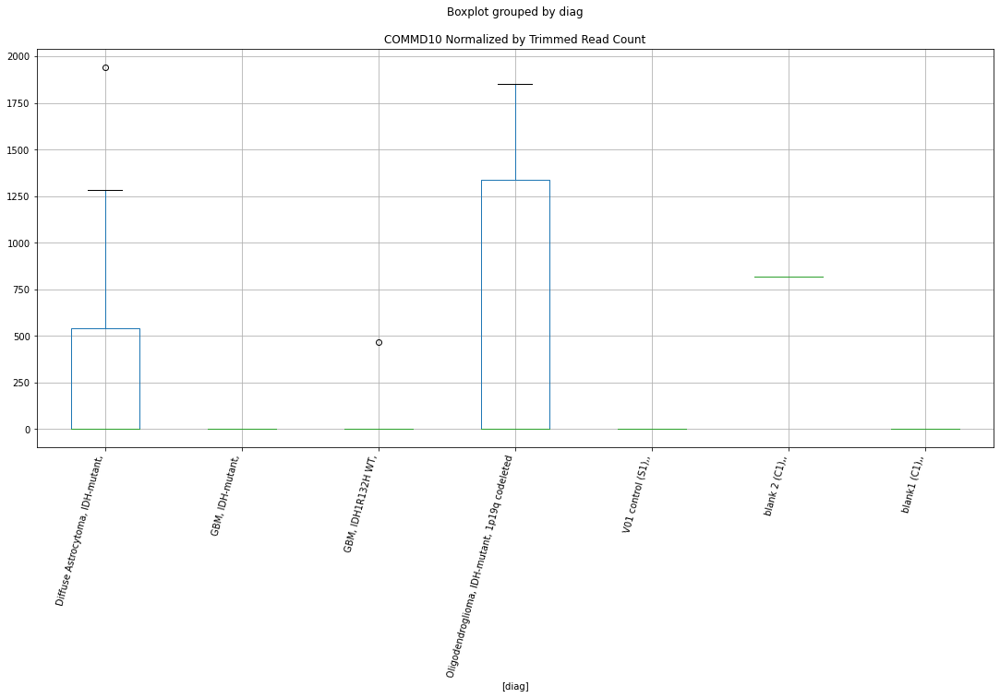

 p : 0.028367234133199824  ( t : 2.3835571996494758 ) :  Lexogen  :  bbduk2  :  ARHGEF37
Control and blanks
79     0.0
343    0.0
Name: ARHGEF37, dtype: float64
211    0.0
Name: ARHGEF37, dtype: float64
475    0.0
Name: ARHGEF37, dtype: float64


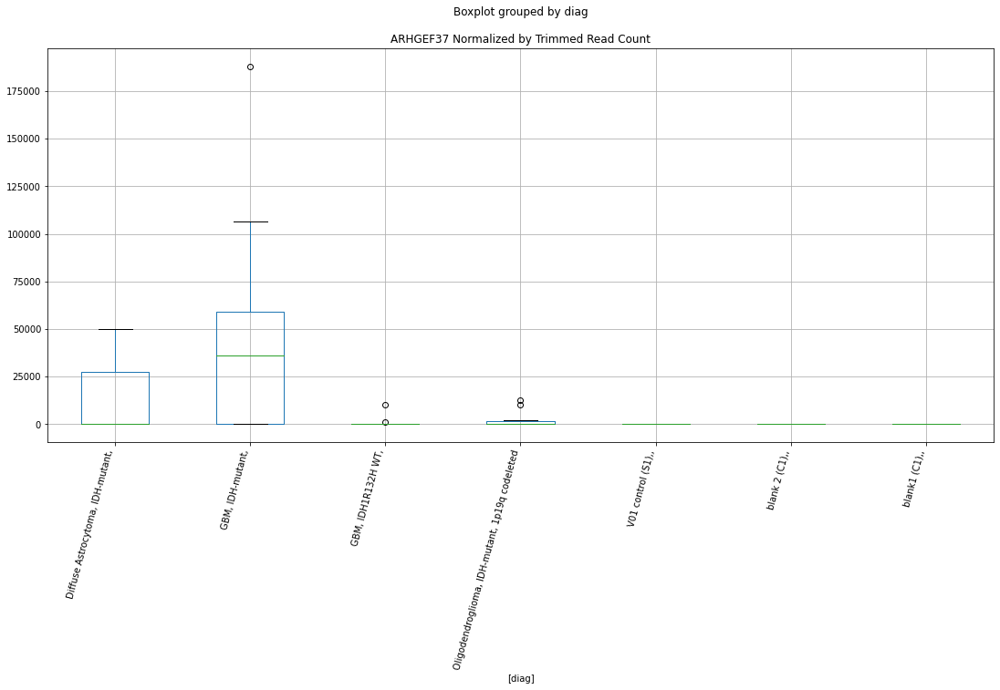

 p : 0.028429147687114444  ( t : 2.382492556775921 ) :  Lexogen  :  bbduk2  :  CPXM2
Control and blanks
79     0.0
343    0.0
Name: CPXM2, dtype: float64
211    0.0
Name: CPXM2, dtype: float64
475    0.0
Name: CPXM2, dtype: float64


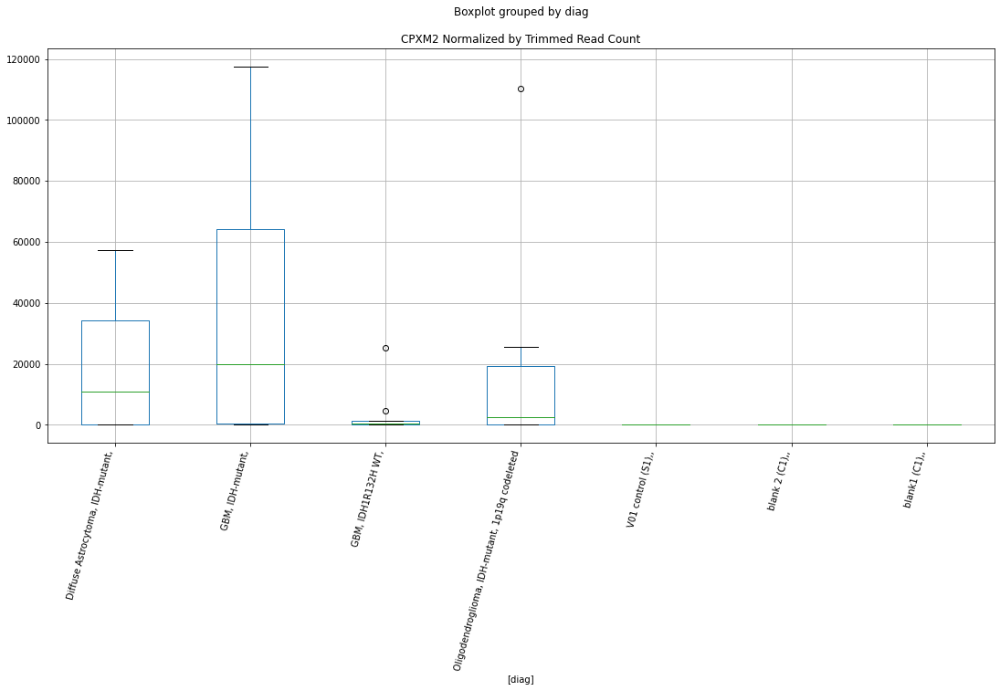

 p : 0.02843274061129724  ( t : 2.3824308406465966 ) :  D-plex  :  bbduk2  :  CEP250
Control and blanks
73      3092.03
337    12462.20
Name: CEP250, dtype: float64
205    25610.01
Name: CEP250, dtype: float64
469    66251.06
Name: CEP250, dtype: float64


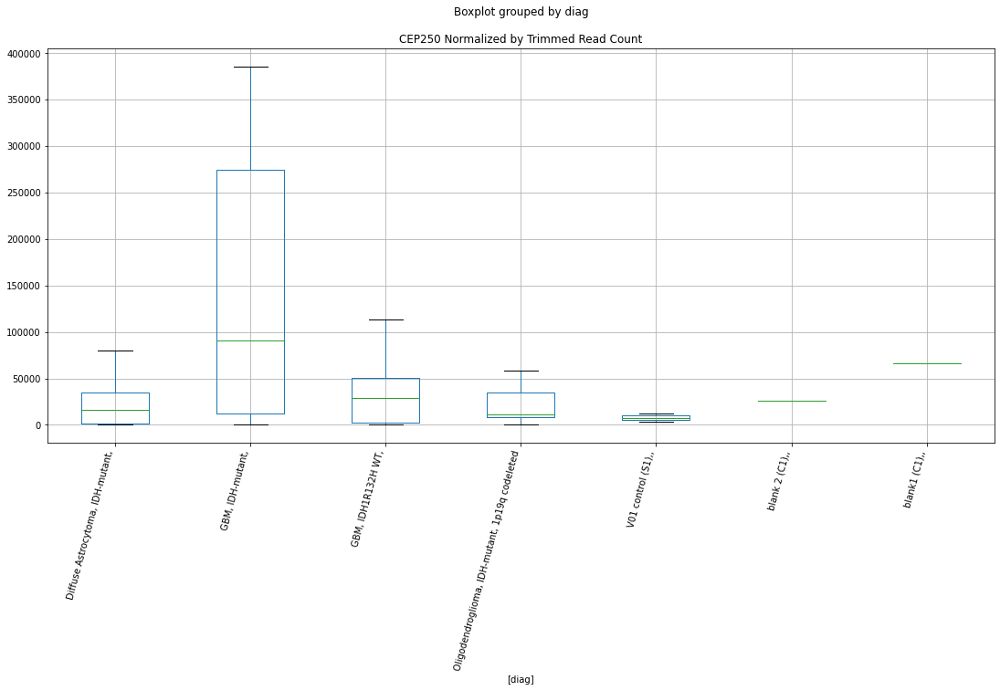

 p : 0.028479933022244646  ( t : 2.3816208856627092 ) :  D-plex  :  bbduk2  :  DCUN1D5
Control and blanks
73     3092.03
337       0.00
Name: DCUN1D5, dtype: float64
205    3223.64
Name: DCUN1D5, dtype: float64
469    9464.44
Name: DCUN1D5, dtype: float64


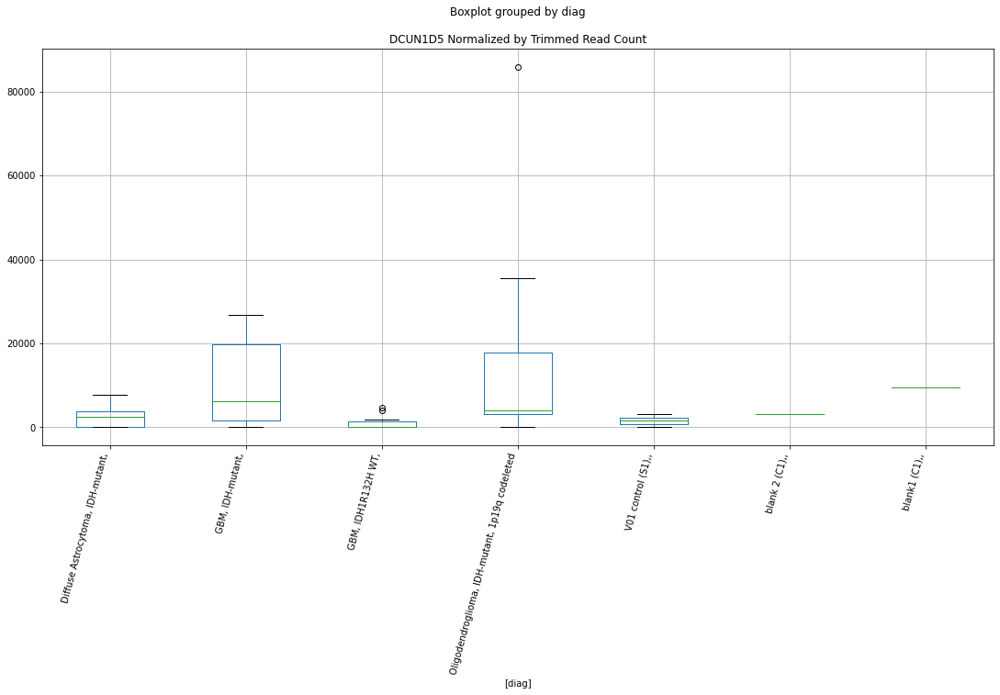

 p : 0.028555325416318864  ( t : 2.3803295356166876 ) :  D-plex  :  bbduk2  :  CXorf40A
Control and blanks
73     0.0
337    0.0
Name: CXorf40A, dtype: float64
205    2149.09
Name: CXorf40A, dtype: float64
469    7098.33
Name: CXorf40A, dtype: float64


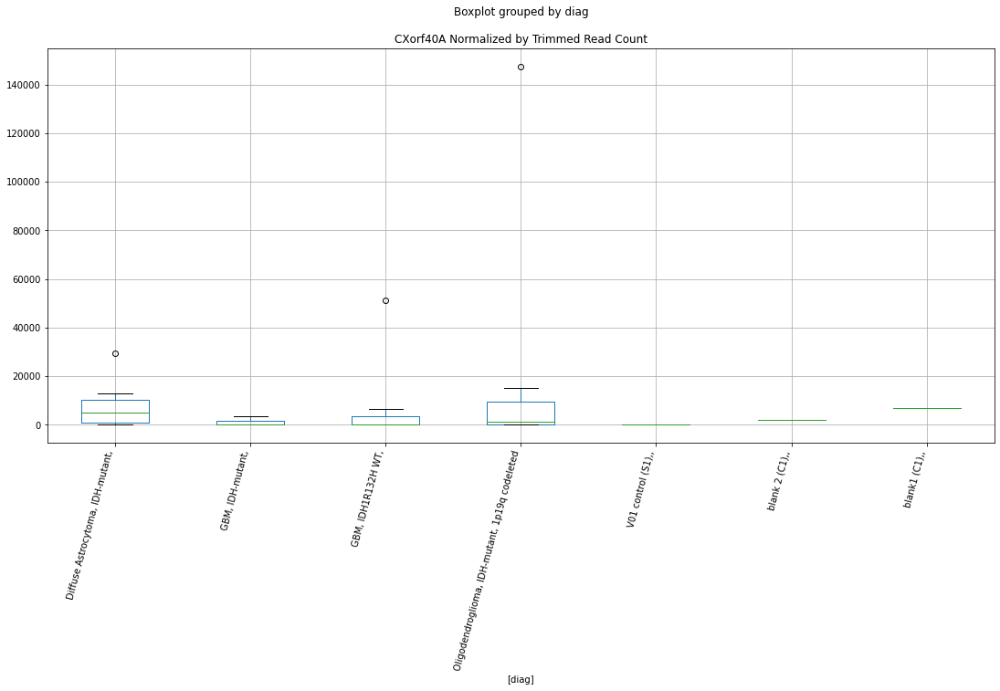

 p : 0.02859522334955332  ( t : 2.379647435757116 ) :  D-plex  :  bbduk2  :  COPS3
Control and blanks
73     0.0
337    0.0
Name: COPS3, dtype: float64
205    291201.89
Name: COPS3, dtype: float64
469    0.0
Name: COPS3, dtype: float64


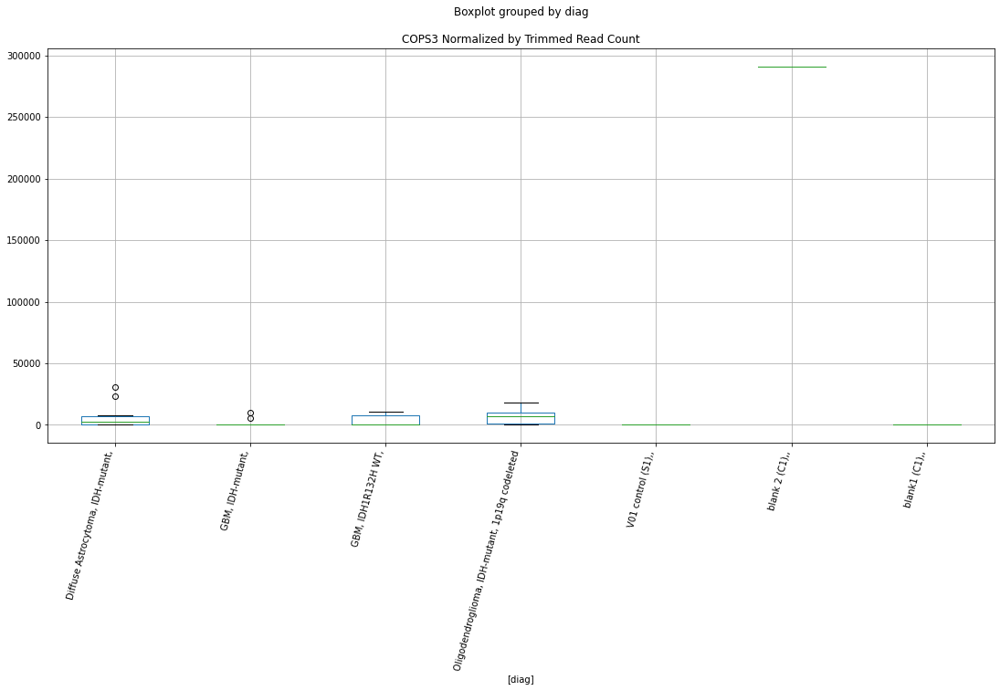

 p : 0.028627366634215414  ( t : 2.3790985561780795 ) :  Lexogen  :  cutadapt2  :  ASCL2
Control and blanks
82     0.0
346    0.0
Name: ASCL2, dtype: float64
214    0.0
Name: ASCL2, dtype: float64
478    237.46
Name: ASCL2, dtype: float64


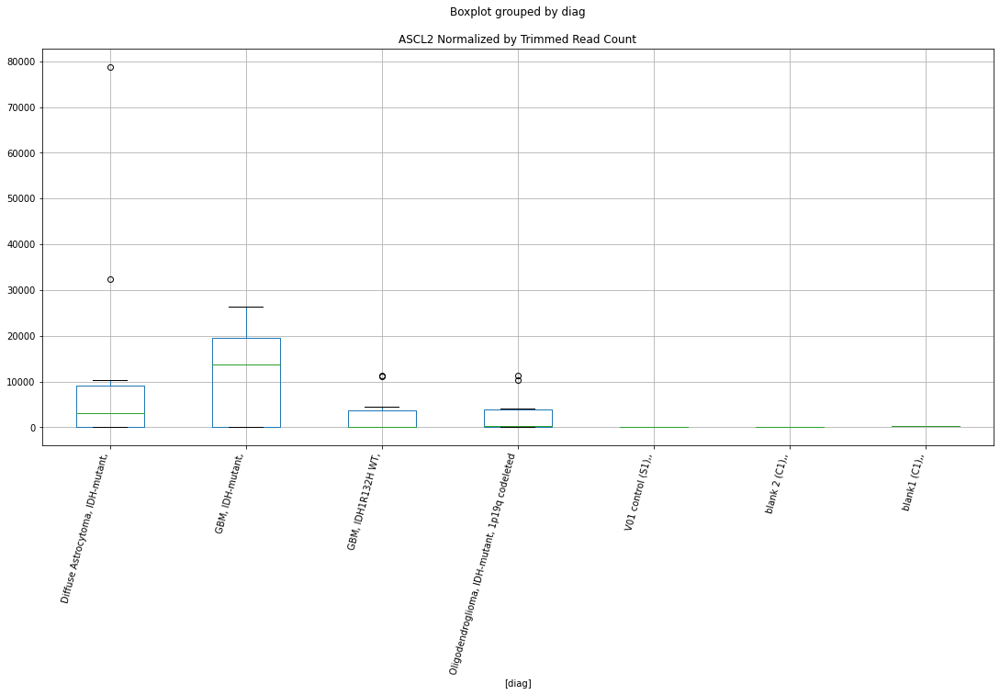

 p : 0.028644745231708953  ( t : 2.3788020383380664 ) :  D-plex  :  cutadapt2  :  CASS4
Control and blanks
76        0.00
340    4403.66
Name: CASS4, dtype: float64
208    705.44
Name: CASS4, dtype: float64
472    2311.82
Name: CASS4, dtype: float64


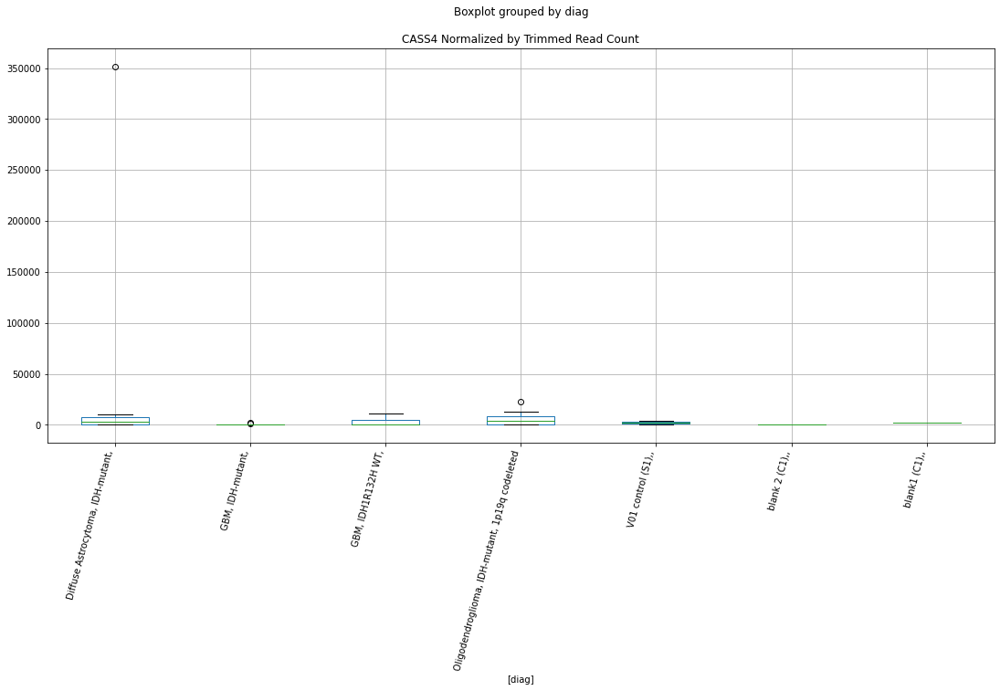

 p : 0.028658720289665603  ( t : 2.3785637142988576 ) :  D-plex  :  bbduk2  :  CEP95
Control and blanks
73     0.0
337    0.0
Name: CEP95, dtype: float64
205    6805.46
Name: CEP95, dtype: float64
469    0.0
Name: CEP95, dtype: float64


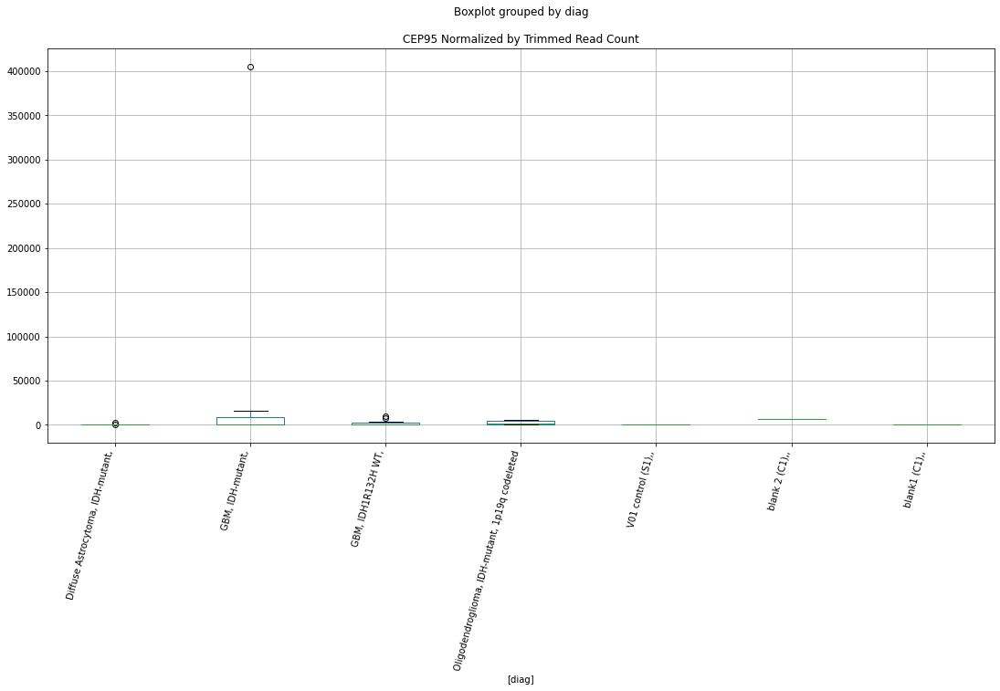

 p : 0.028678881932292042  ( t : 2.37822007823274 ) :  D-plex  :  cutadapt2  :  CHD8
Control and blanks
76     0.0
340    0.0
Name: CHD8, dtype: float64
208    1410.88
Name: CHD8, dtype: float64
472    577.96
Name: CHD8, dtype: float64


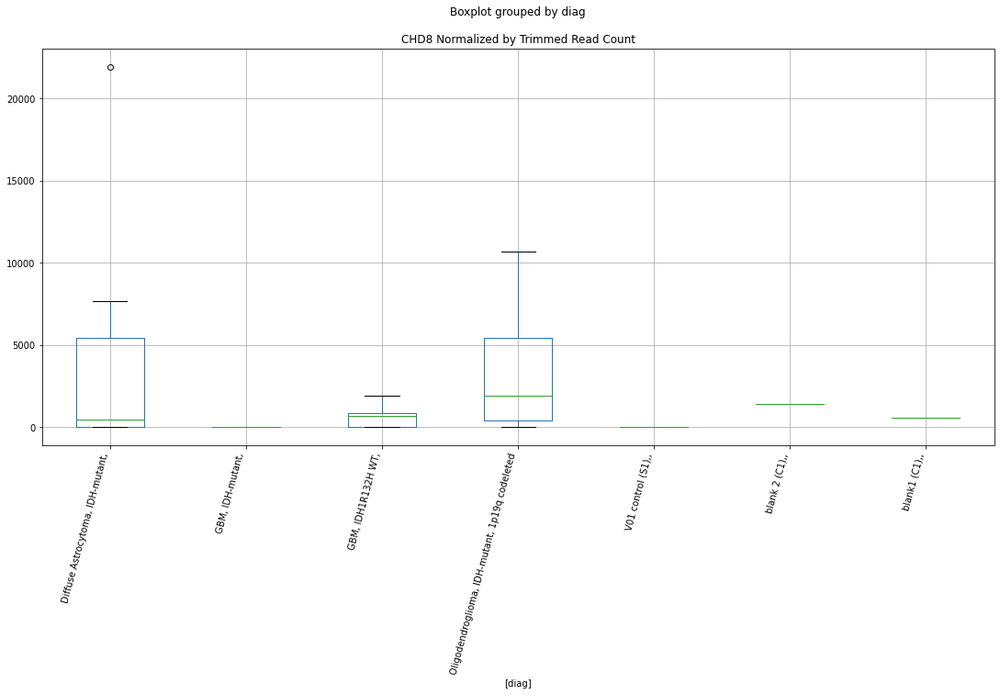

 p : 0.028682749401937047  ( t : 2.3781541866591462 ) :  D-plex  :  cutadapt2  :  CHRNA6
Control and blanks
76     0.0
340    0.0
Name: CHRNA6, dtype: float64
208    352.72
Name: CHRNA6, dtype: float64
472    1155.91
Name: CHRNA6, dtype: float64


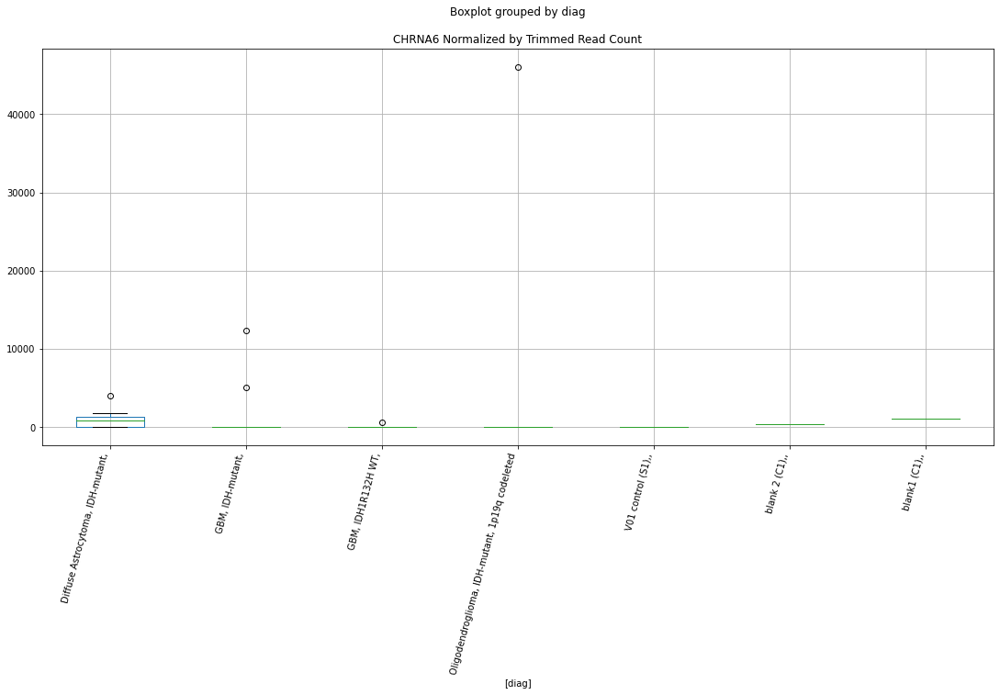

 p : 0.028692926120877524  ( t : 2.3779808415808525 ) :  D-plex  :  bbduk2  :  CTXND1
Control and blanks
73     29374.32
337    18693.30
Name: CTXND1, dtype: float64
205    20774.55
Name: CTXND1, dtype: float64
469    29576.37
Name: CTXND1, dtype: float64


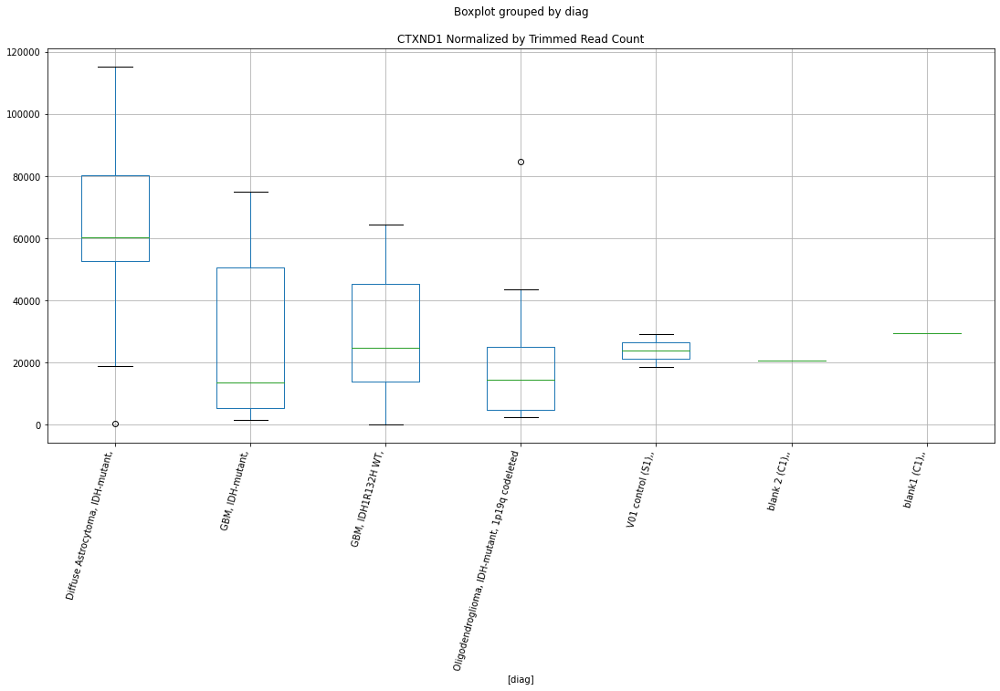

 p : 0.028768541957705594  ( t : 2.376694633968748 ) :  D-plex  :  bbduk2  :  CLCN3
Control and blanks
73     0.0
337    0.0
Name: CLCN3, dtype: float64
205    10029.09
Name: CLCN3, dtype: float64
469    7098.33
Name: CLCN3, dtype: float64


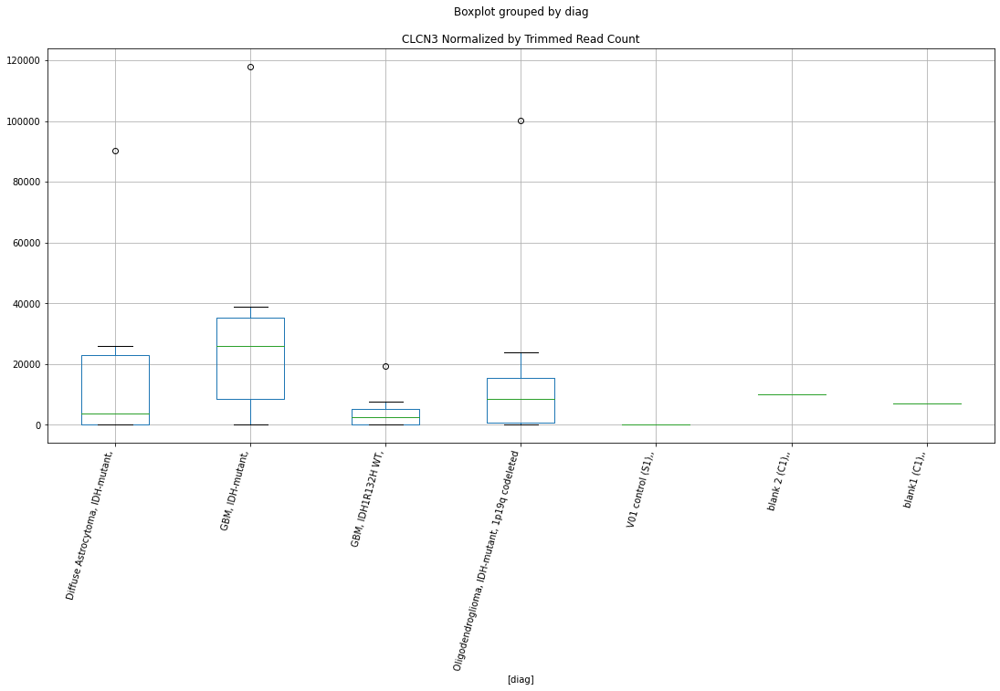

 p : 0.02888014521860702  ( t : 2.3748020417022775 ) :  D-plex  :  bbduk2  :  CASP10
Control and blanks
73     0.0
337    0.0
Name: CASP10, dtype: float64
205    0.0
Name: CASP10, dtype: float64
469    0.0
Name: CASP10, dtype: float64


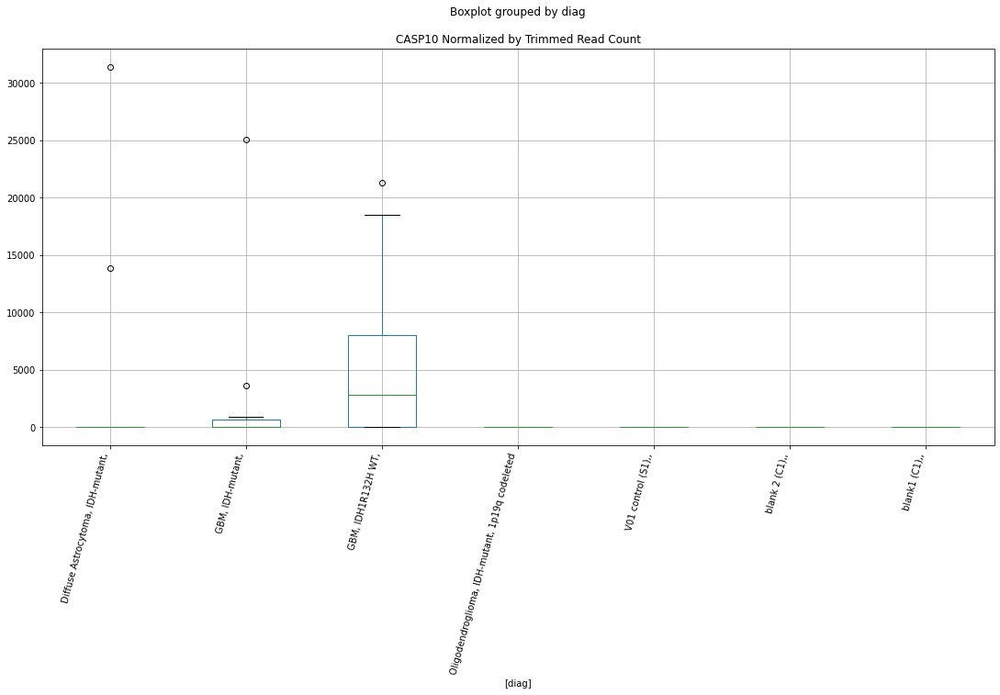

 p : 0.028983522011447424  ( t : 2.373055034306141 ) :  D-plex  :  bbduk2  :  CASS4
Control and blanks
73        0.00
337    8901.57
Name: CASS4, dtype: float64
205    716.36
Name: CASS4, dtype: float64
469    2366.11
Name: CASS4, dtype: float64


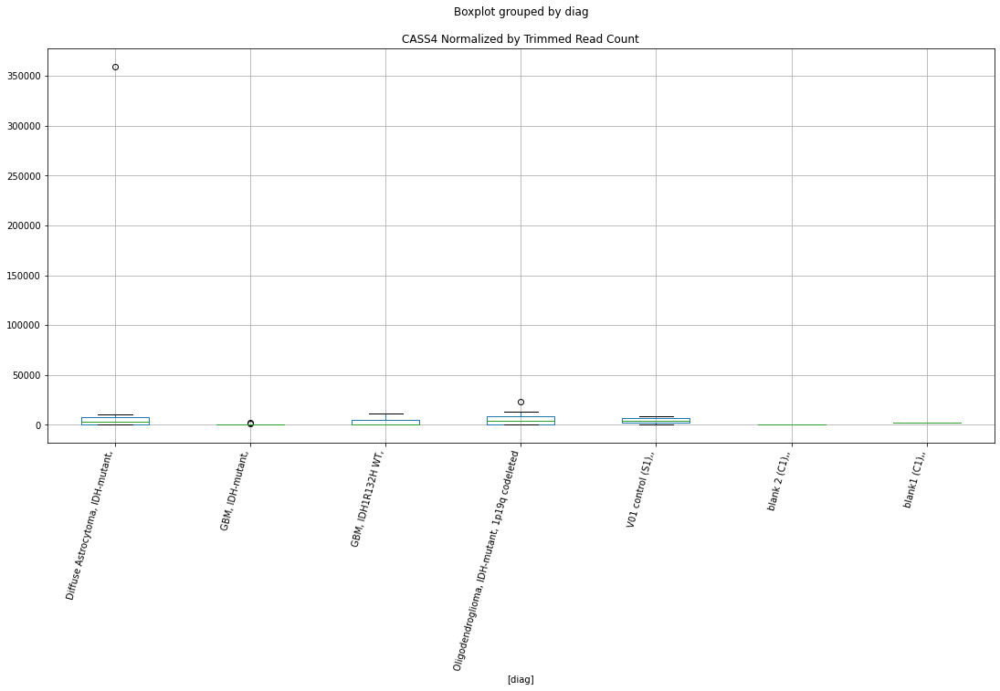

 p : 0.029027980255495717  ( t : 2.3723055030646454 ) :  Lexogen  :  bbduk2  :  CPD
Control and blanks
79     0.0
343    0.0
Name: CPD, dtype: float64
211    0.0
Name: CPD, dtype: float64
475    0.0
Name: CPD, dtype: float64


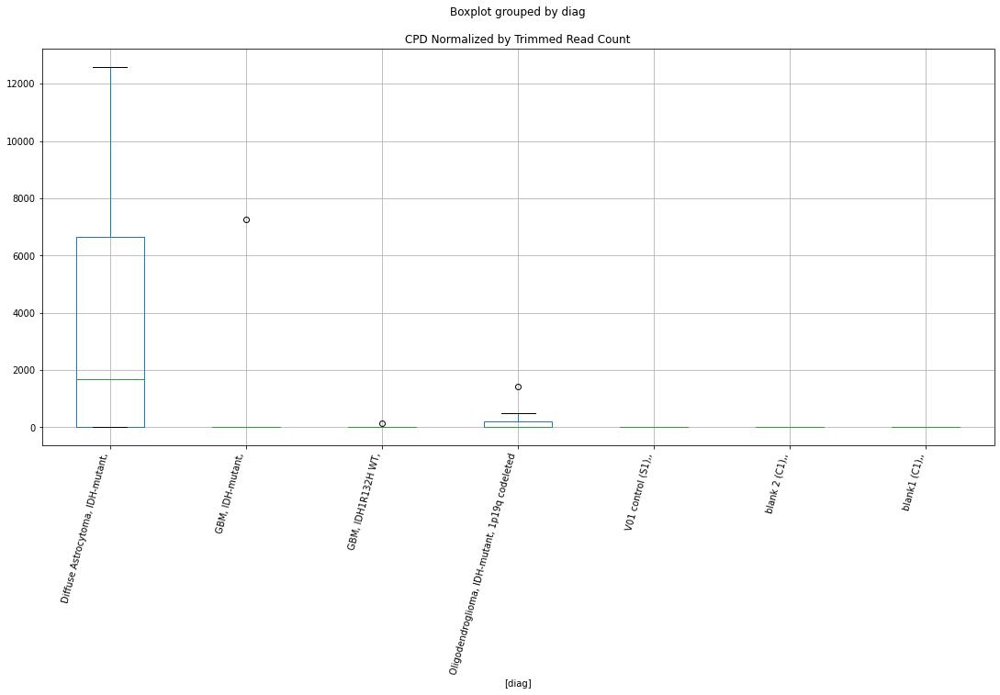

 p : 0.02911279576402495  ( t : 2.3708785454998513 ) :  D-plex  :  cutadapt2  :  BORCS8-MEF2B
Control and blanks
76     0.0
340    0.0
Name: BORCS8-MEF2B, dtype: float64
208    0.0
Name: BORCS8-MEF2B, dtype: float64
472    0.0
Name: BORCS8-MEF2B, dtype: float64


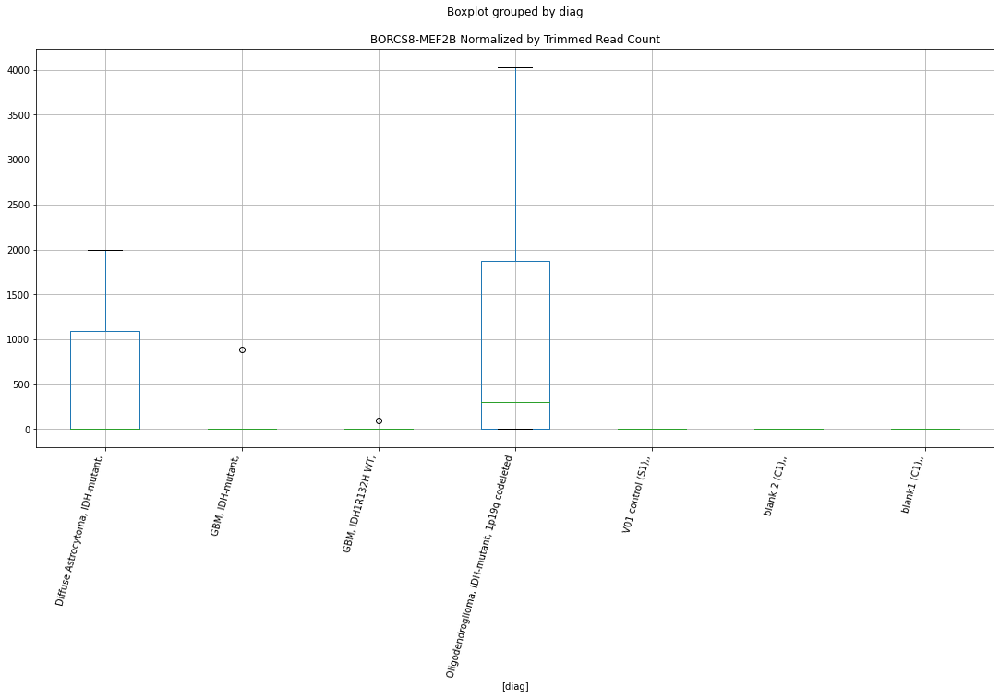

 p : 0.029163129579922172  ( t : 2.3700335491214166 ) :  Lexogen  :  bbduk2  :  B3GALT6
Control and blanks
79         0.0
343    32696.4
Name: B3GALT6, dtype: float64
211    273.31
Name: B3GALT6, dtype: float64
475    239.52
Name: B3GALT6, dtype: float64


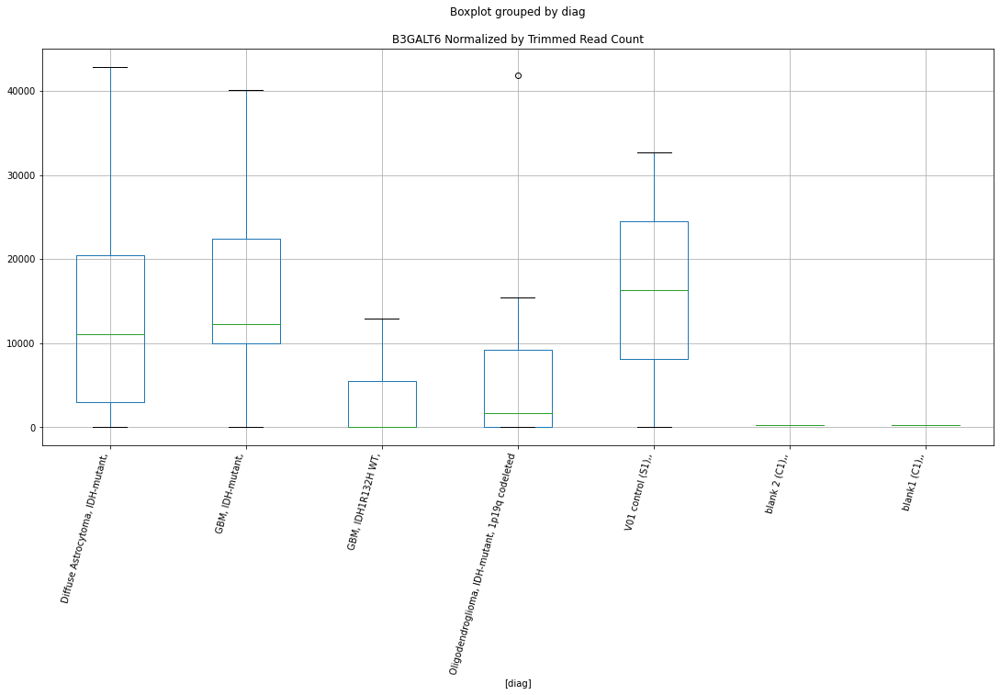

 p : 0.029323340668214053  ( t : 2.36735297619722 ) :  D-plex  :  bbduk2  :  BAX
Control and blanks
73     0.0
337    0.0
Name: BAX, dtype: float64
205    12536.37
Name: BAX, dtype: float64
469    8281.38
Name: BAX, dtype: float64


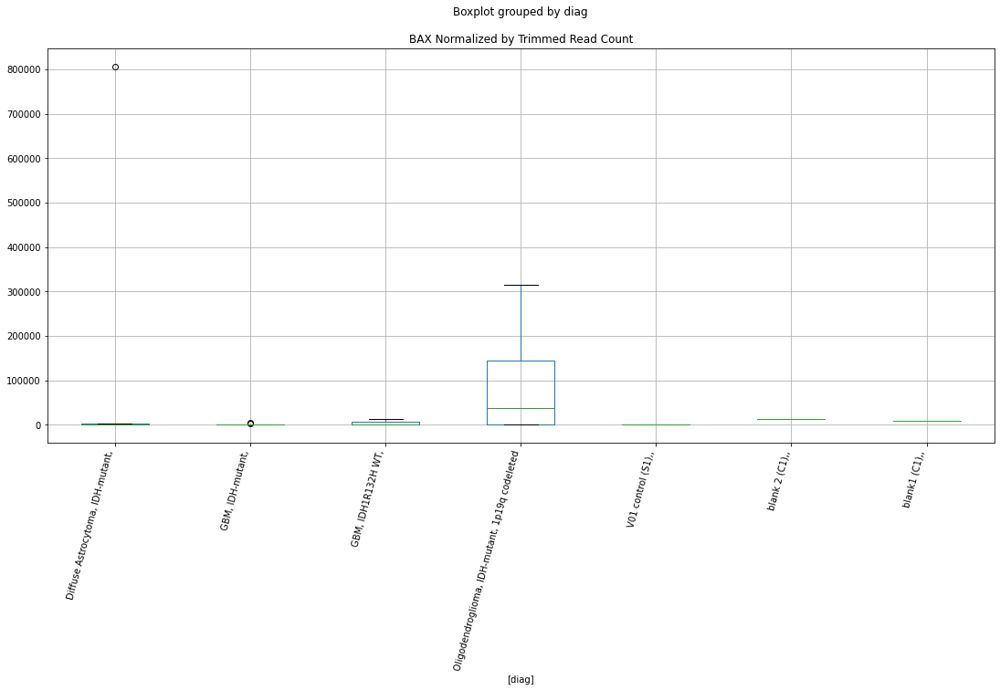

 p : 0.029344108853119576  ( t : 2.367006493712819 ) :  D-plex  :  cutadapt2  :  CD1B
Control and blanks
76     159098.98
340         0.00
Name: CD1B, dtype: float64
208    5290.81
Name: CD1B, dtype: float64
472    596450.43
Name: CD1B, dtype: float64


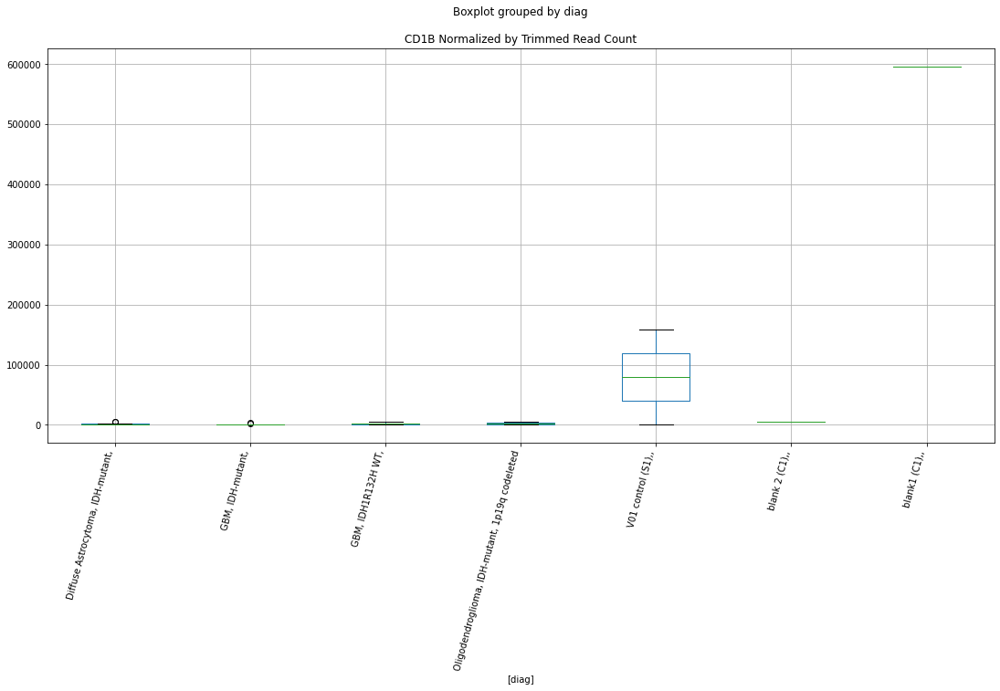

 p : 0.029350871661866697  ( t : 2.366893716896396 ) :  D-plex  :  bbduk2  :  C3orf36
Control and blanks
73     0.0
337    0.0
Name: C3orf36, dtype: float64
205    179.09
Name: C3orf36, dtype: float64
469    0.0
Name: C3orf36, dtype: float64


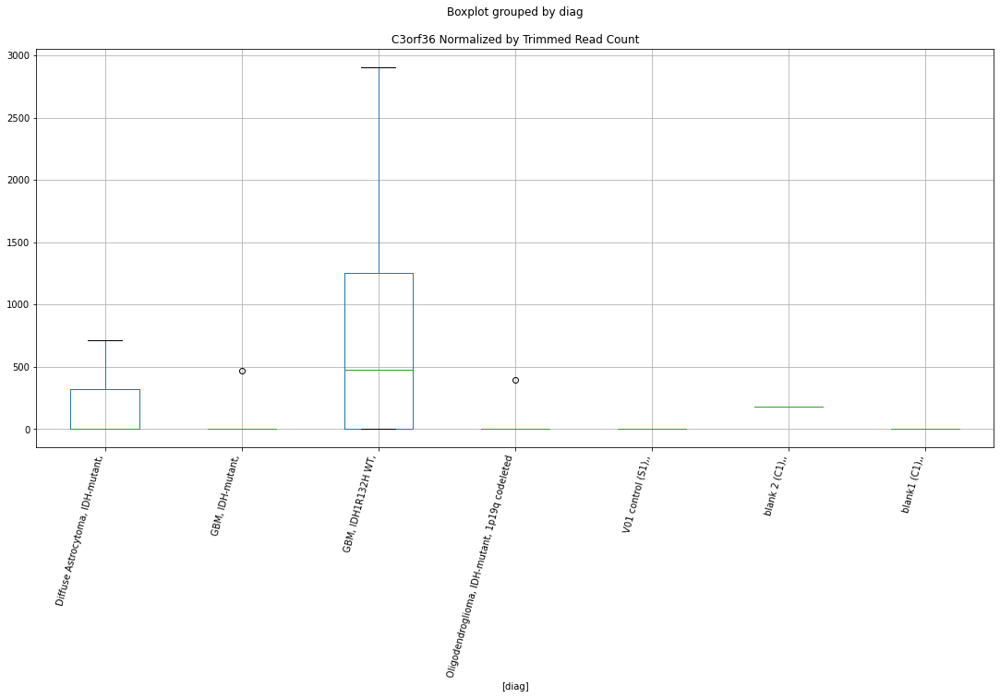

 p : 0.02937146530564512  ( t : 2.366550445806239 ) :  D-plex  :  cutadapt2  :  CLEC4C
Control and blanks
76     403050.76
340         0.00
Name: CLEC4C, dtype: float64
208    49380.86
Name: CLEC4C, dtype: float64
472    56639.67
Name: CLEC4C, dtype: float64


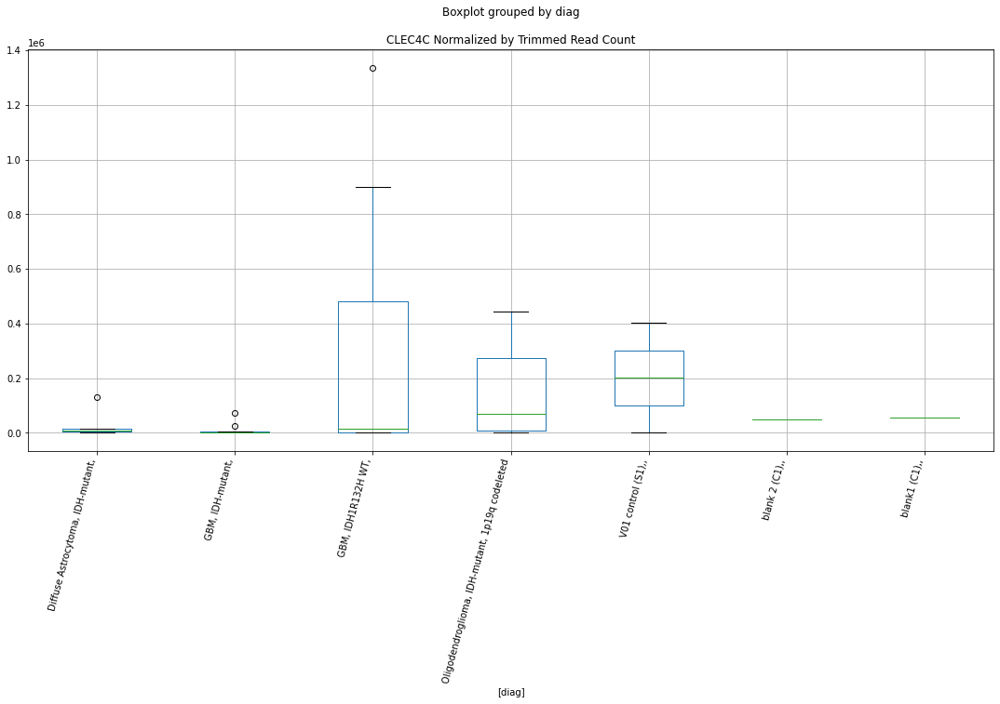

 p : 0.029377804899375876  ( t : 2.3664448176382034 ) :  D-plex  :  cutadapt2  :  CNIH3
Control and blanks
76     0.0
340    0.0
Name: CNIH3, dtype: float64
208    2645.4
Name: CNIH3, dtype: float64
472    0.0
Name: CNIH3, dtype: float64


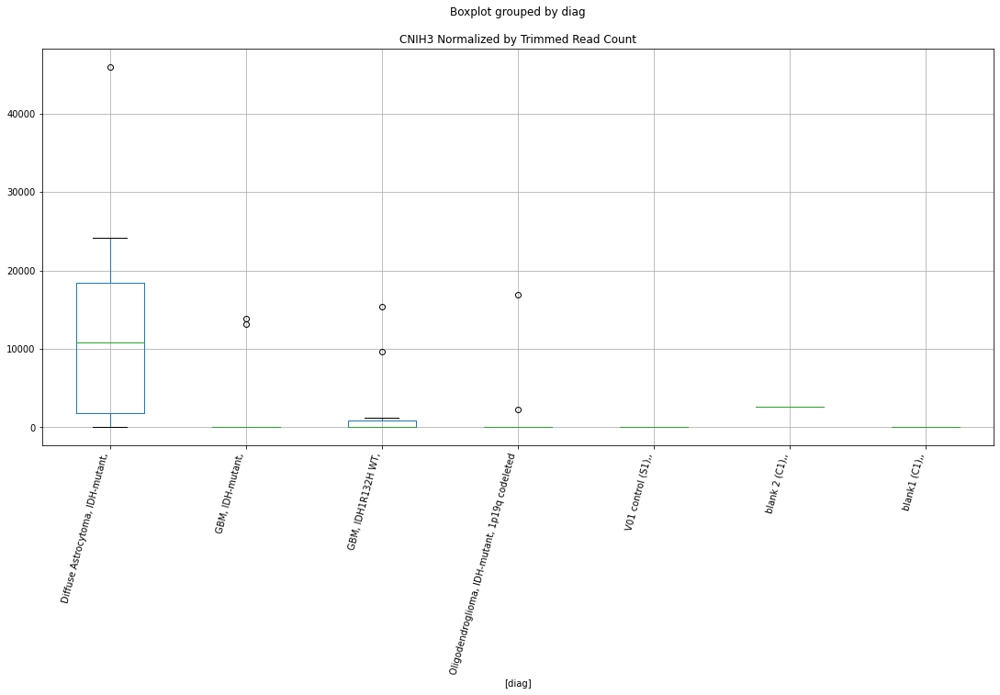

 p : 0.02940342938582414  ( t : 2.3660180875699424 ) :  D-plex  :  bbduk2  :  CLEC4C
Control and blanks
73     416651.53
337         0.00
Name: CLEC4C, dtype: float64
205    51220.01
Name: CLEC4C, dtype: float64
469    57969.68
Name: CLEC4C, dtype: float64


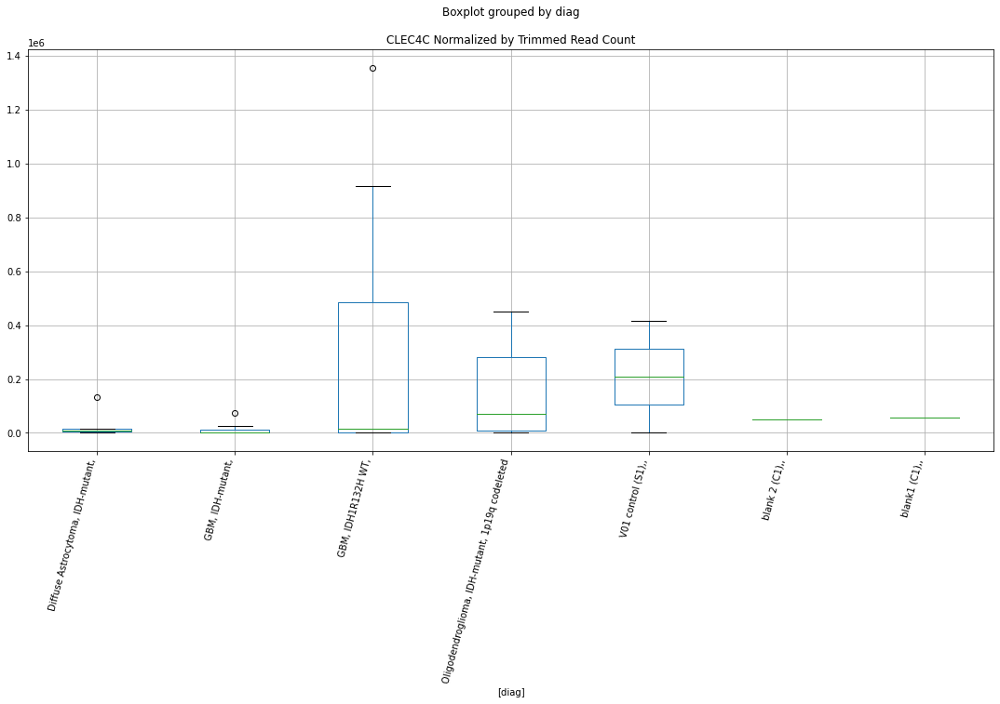

 p : 0.029416873177190817  ( t : 2.365794343896213 ) :  D-plex  :  bbduk2  :  CHST4
Control and blanks
73      72662.79
337    197614.91
Name: CHST4, dtype: float64
205    360689.18
Name: CHST4, dtype: float64
469    22478.04
Name: CHST4, dtype: float64


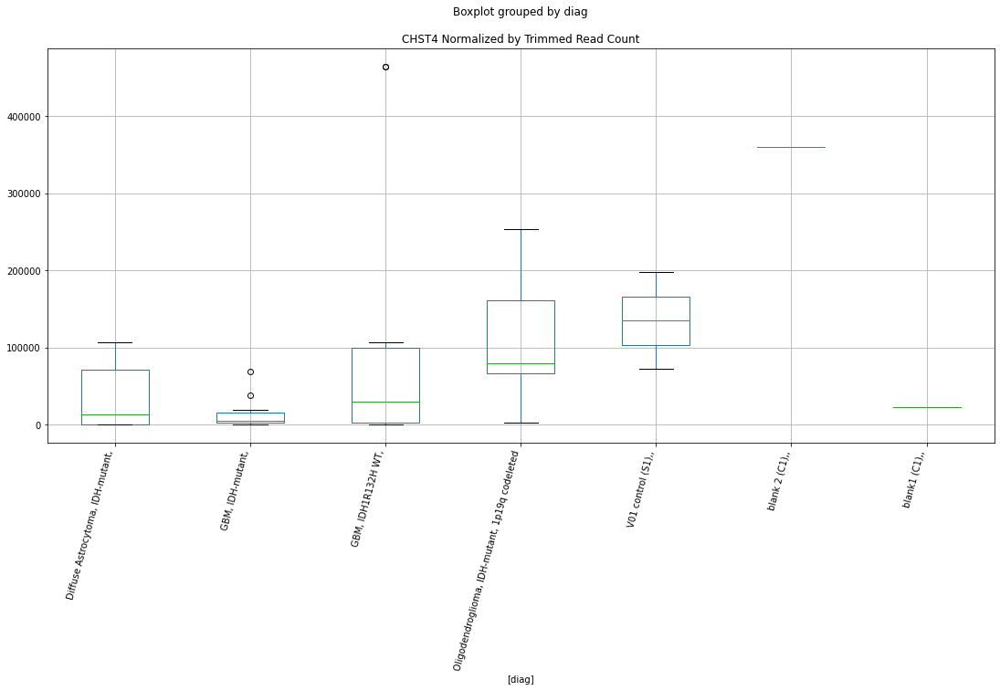

 p : 0.029437303678257812  ( t : 2.3654545035853953 ) :  Lexogen  :  cutadapt2  :  CRHBP
Control and blanks
82     0.0
346    0.0
Name: CRHBP, dtype: float64
214    0.0
Name: CRHBP, dtype: float64
478    0.0
Name: CRHBP, dtype: float64


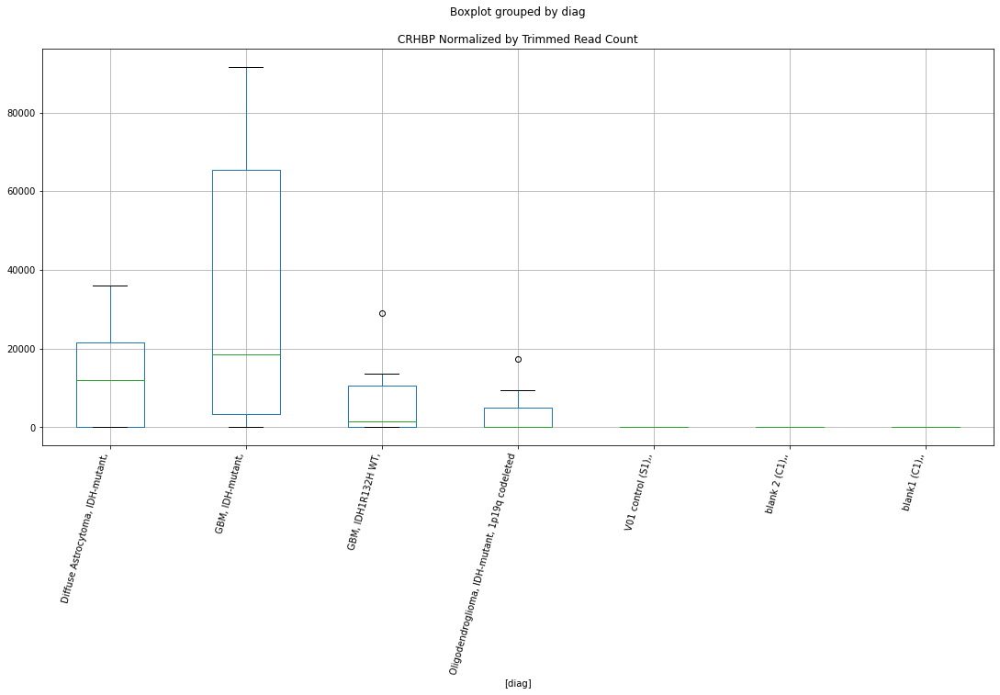

 p : 0.029441294348988397  ( t : 2.3653881485682664 ) :  D-plex  :  cutadapt2  :  DBET
Control and blanks
76     0.0
340    0.0
Name: DBET, dtype: float64
208    1058.16
Name: DBET, dtype: float64
472    2311.82
Name: DBET, dtype: float64


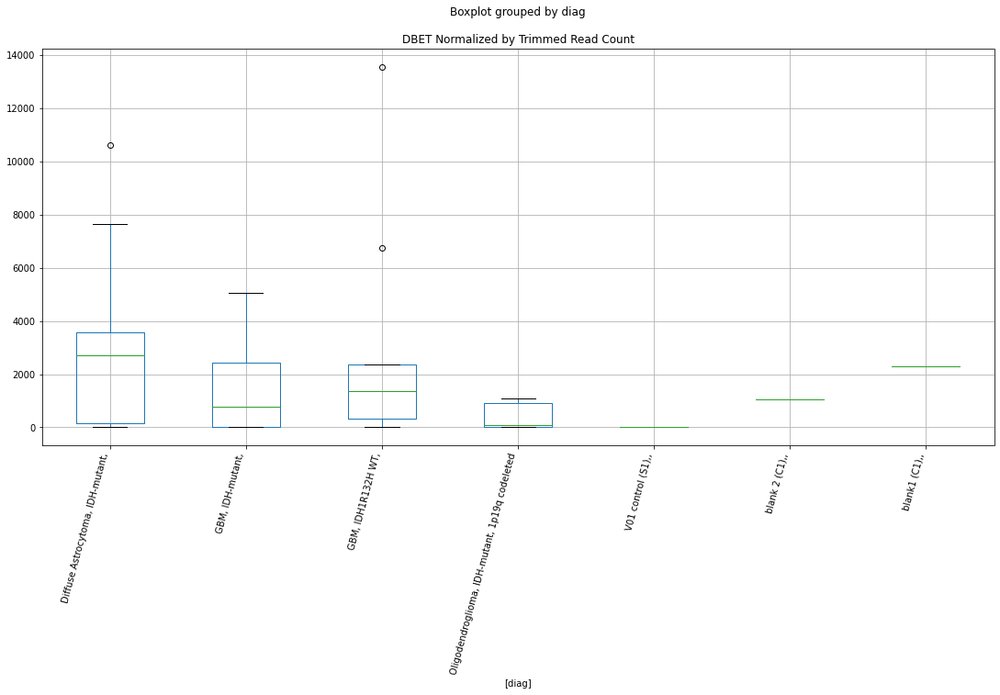

 p : 0.029446602002930547  ( t : 2.3652999083594577 ) :  D-plex  :  bbduk2  :  ARID5B
Control and blanks
73      773.01
337    8011.42
Name: ARID5B, dtype: float64
205    5730.91
Name: ARID5B, dtype: float64
469    2957.64
Name: ARID5B, dtype: float64


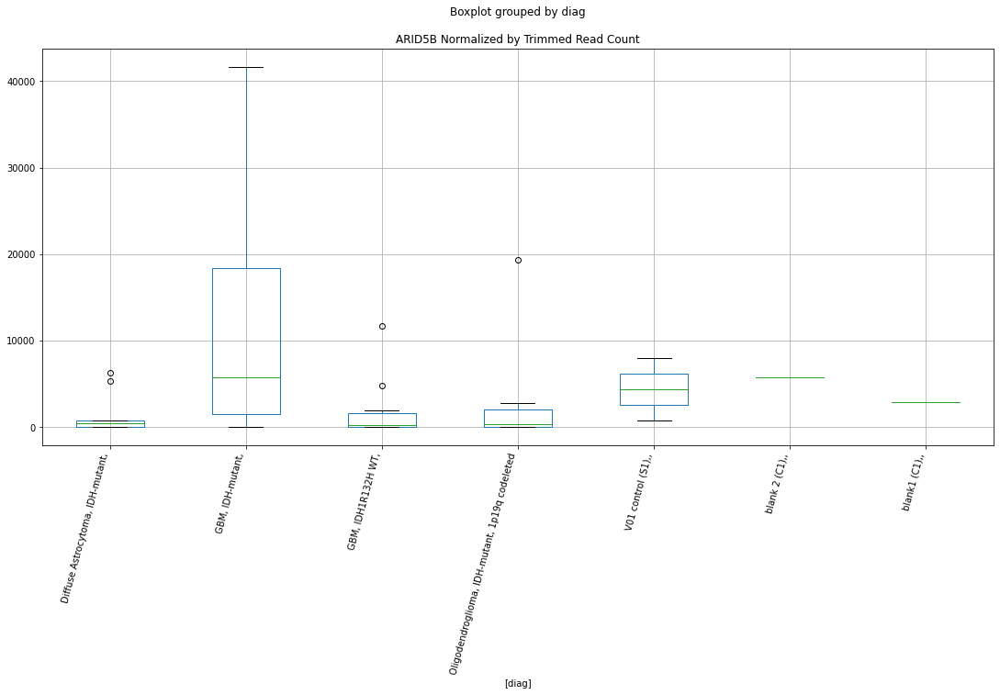

 p : 0.02945289927298941  ( t : 2.3651952349290886 ) :  Lexogen  :  bbduk2  :  C4orf51
Control and blanks
79     0.0
343    0.0
Name: C4orf51, dtype: float64
211    0.0
Name: C4orf51, dtype: float64
475    86225.67
Name: C4orf51, dtype: float64


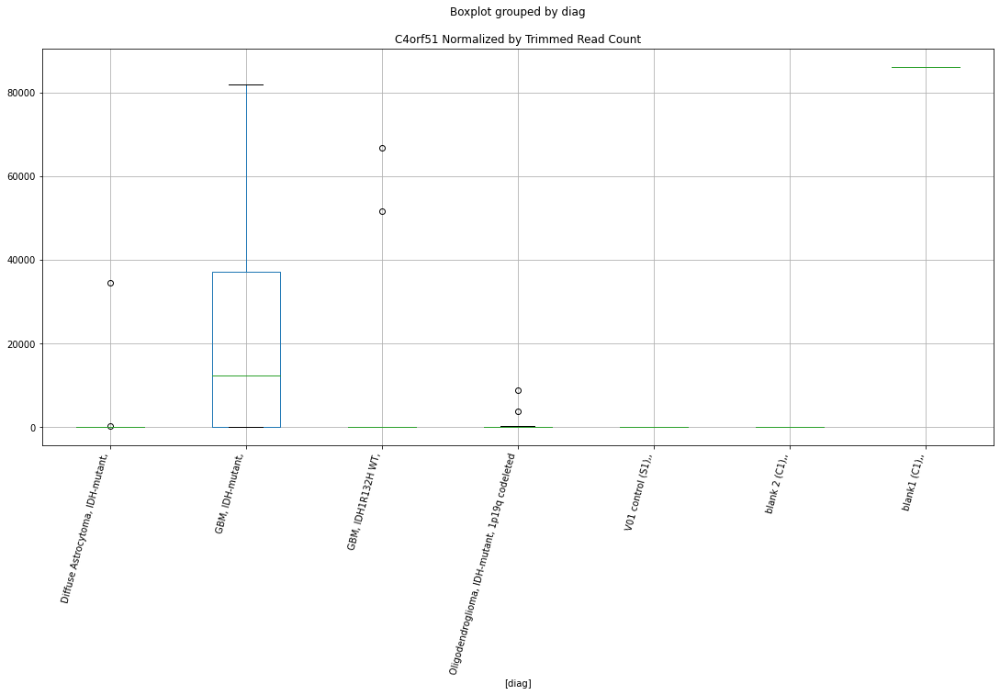

 p : 0.029465615983529377  ( t : 2.3649839209470485 ) :  D-plex  :  cutadapt2  :  ARL17B
Control and blanks
76     0.0
340    0.0
Name: ARL17B, dtype: float64
208    0.0
Name: ARL17B, dtype: float64
472    577.96
Name: ARL17B, dtype: float64


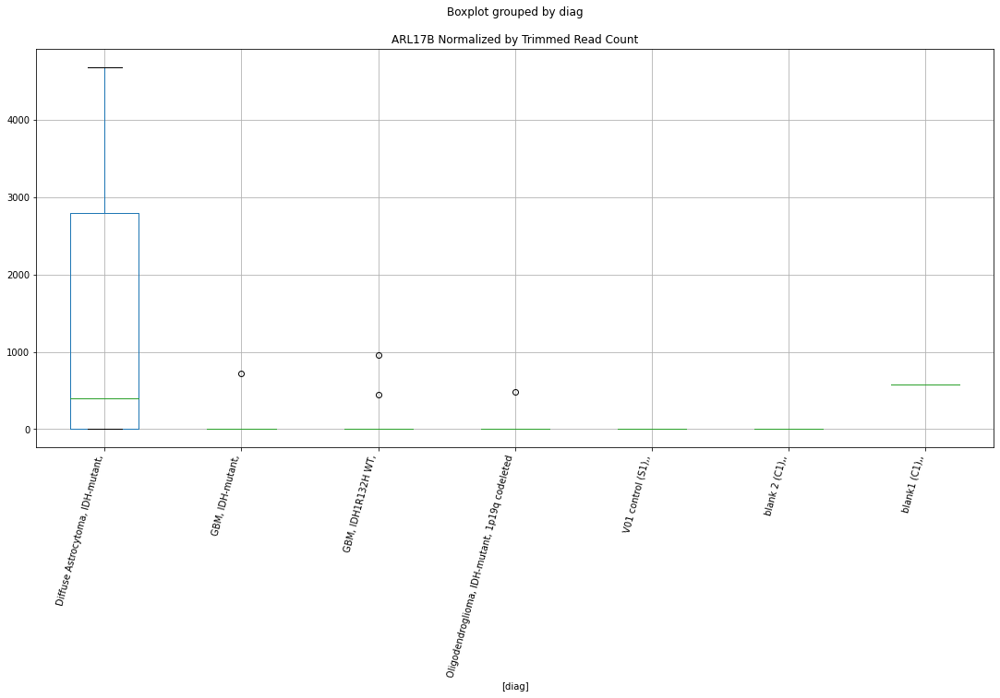

 p : 0.029570165577623254  ( t : 2.3632498329444727 ) :  Lexogen  :  cutadapt2  :  ASCL2
Control and blanks
82     0.0
346    0.0
Name: ASCL2, dtype: float64
214    0.0
Name: ASCL2, dtype: float64
478    237.46
Name: ASCL2, dtype: float64


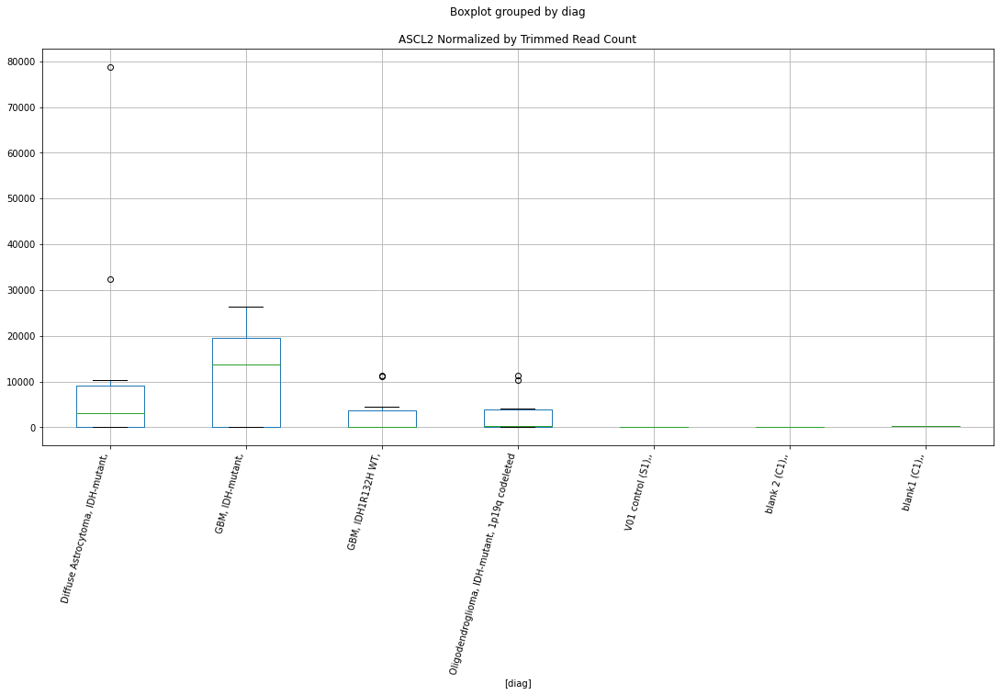

 p : 0.02958129025660712  ( t : 2.363065652575014 ) :  D-plex  :  cutadapt2  :  CLTC
Control and blanks
76     1515.23
340       0.00
Name: CLTC, dtype: float64
208    3527.2
Name: CLTC, dtype: float64
472    0.0
Name: CLTC, dtype: float64


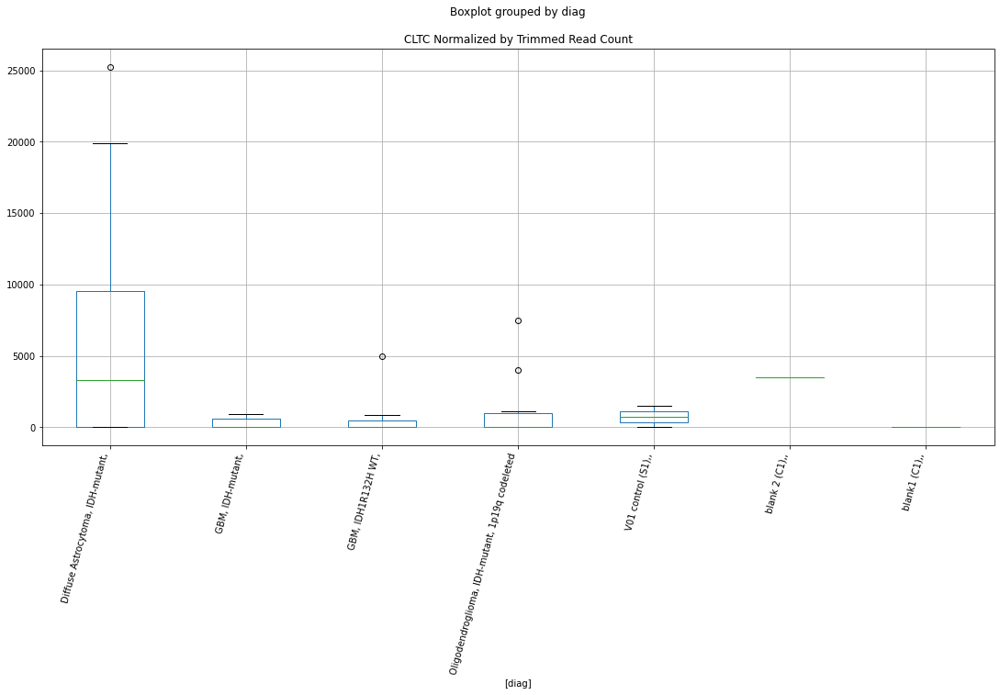

 p : 0.029654724225283726  ( t : 2.361851495885947 ) :  Lexogen  :  bbduk2  :  ASCL2
Control and blanks
79     0.0
343    0.0
Name: ASCL2, dtype: float64
211    0.0
Name: ASCL2, dtype: float64
475    239.52
Name: ASCL2, dtype: float64


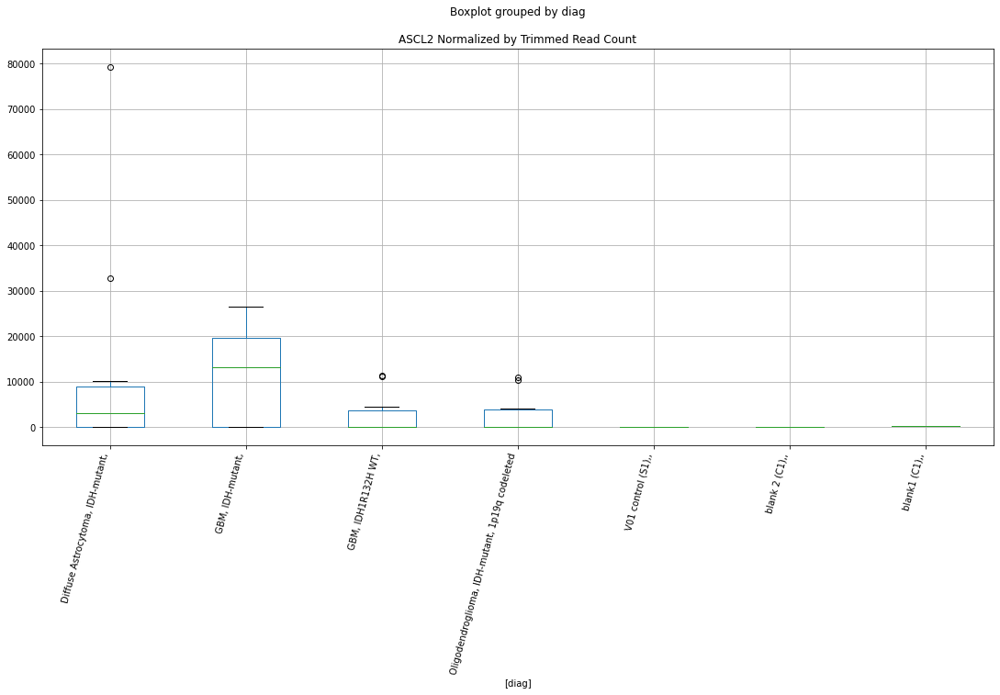

 p : 0.029788447116242883  ( t : 2.359647702897719 ) :  D-plex  :  bbduk2  :  COL5A2
Control and blanks
73     0.0
337    0.0
Name: COL5A2, dtype: float64
205    358.18
Name: COL5A2, dtype: float64
469    0.0
Name: COL5A2, dtype: float64


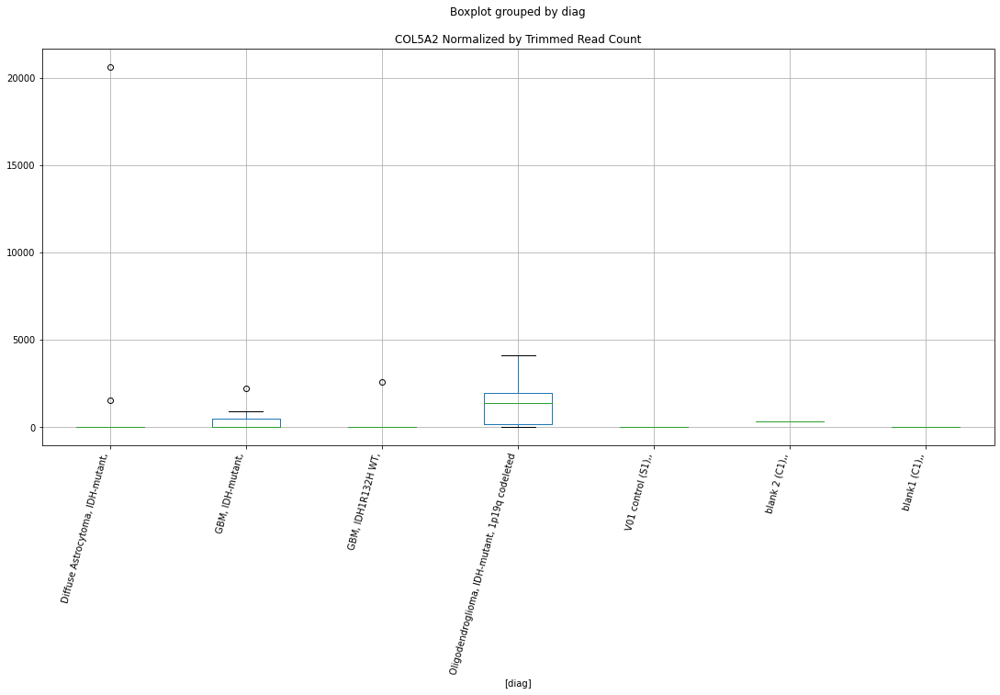

 p : 0.02981320644782031  ( t : 2.3592406736267764 ) :  D-plex  :  cutadapt2  :  CD180
Control and blanks
76     0.0
340    0.0
Name: CD180, dtype: float64
208    6172.61
Name: CD180, dtype: float64
472    4623.65
Name: CD180, dtype: float64


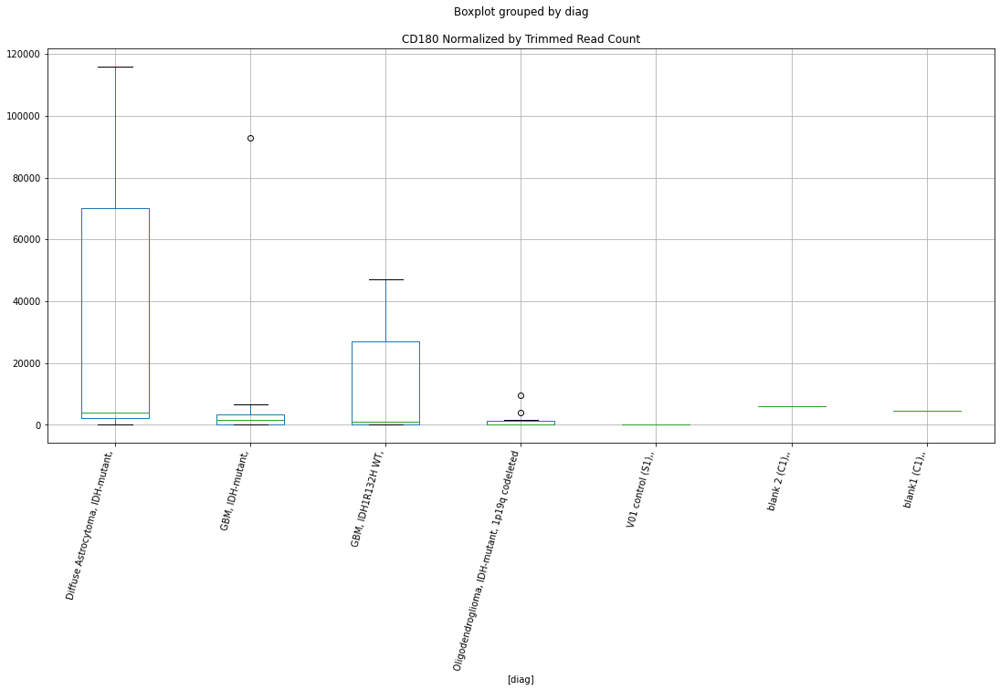

 p : 0.029815716611285785  ( t : 2.3591994255618958 ) :  D-plex  :  bbduk2  :  APBA1
Control and blanks
73     0.0
337    0.0
Name: APBA1, dtype: float64
205    1970.0
Name: APBA1, dtype: float64
469    591.53
Name: APBA1, dtype: float64


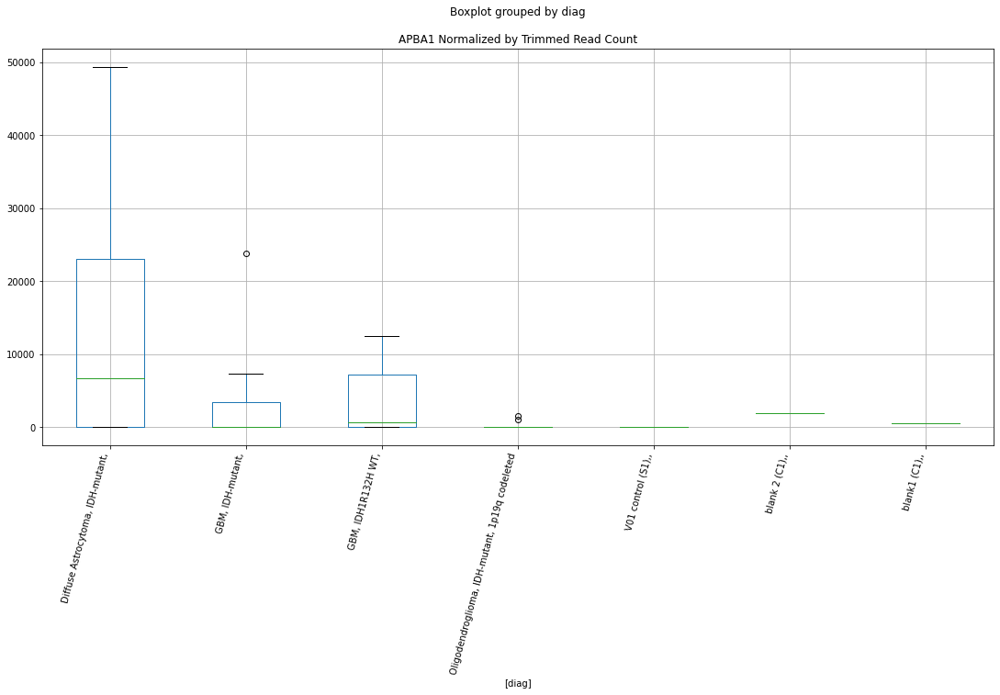

 p : 0.029820304832911183  ( t : 2.3591240383317196 ) :  Lexogen  :  bbduk2  :  CDH4
Control and blanks
79        0.00
343    1273.89
Name: CDH4, dtype: float64
211    0.0
Name: CDH4, dtype: float64
475    0.0
Name: CDH4, dtype: float64


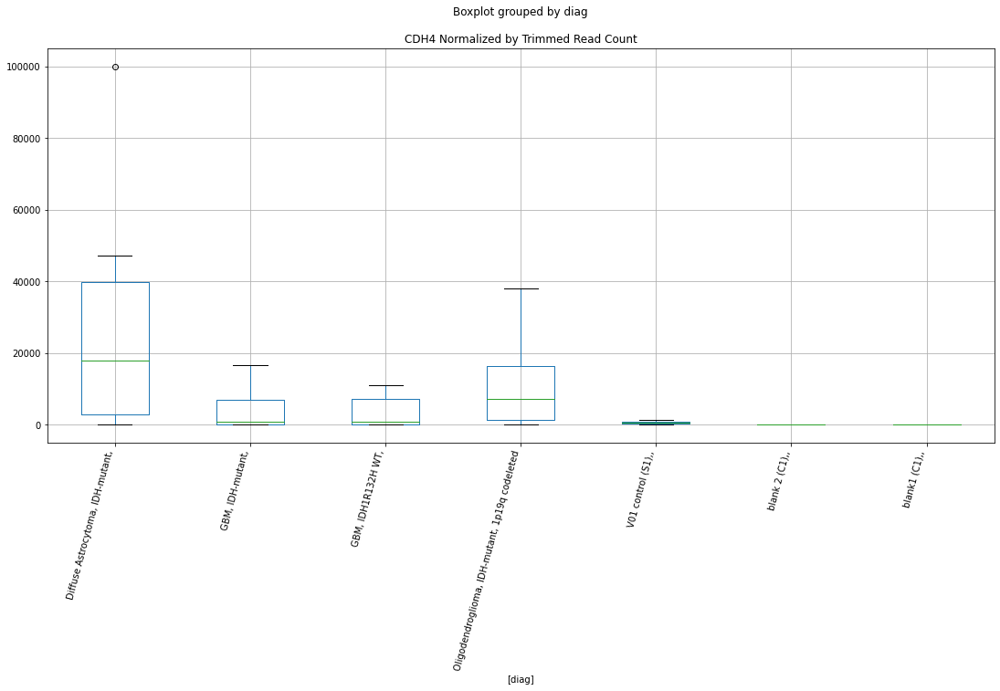

 p : 0.029854790569756734  ( t : 2.358557762701821 ) :  D-plex  :  bbduk2  :  AIRN
Control and blanks
73     773.01
337      0.00
Name: AIRN, dtype: float64
205    0.0
Name: AIRN, dtype: float64
469    591.53
Name: AIRN, dtype: float64


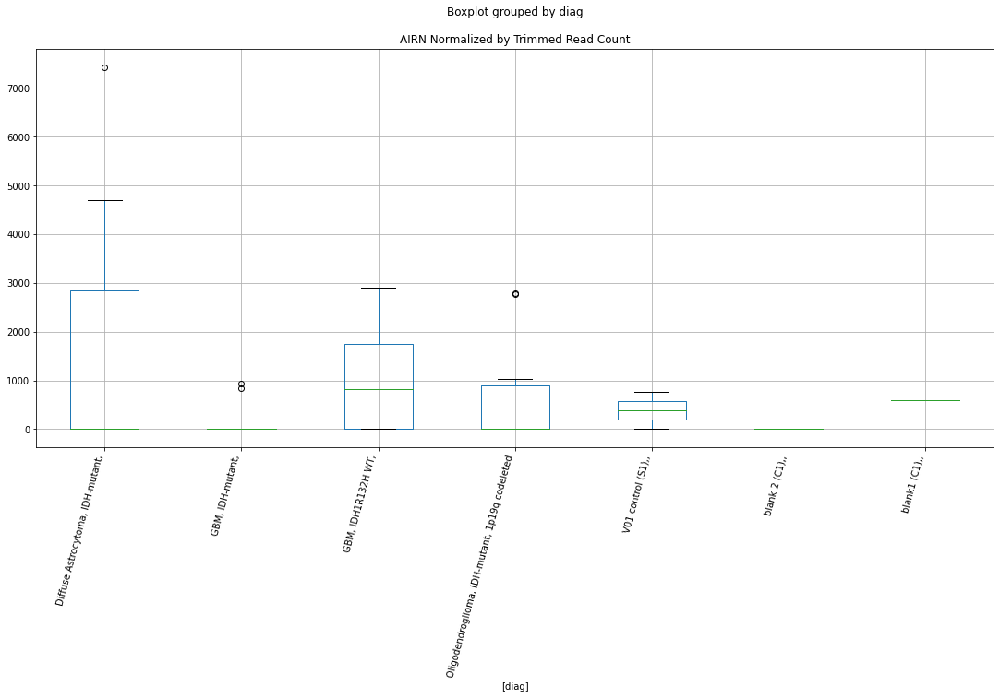

 p : 0.02987289741006496  ( t : 2.3582606819641354 ) :  D-plex  :  bbduk2  :  C1orf122
Control and blanks
73     0.0
337    0.0
Name: C1orf122, dtype: float64
205    716.36
Name: C1orf122, dtype: float64
469    4732.22
Name: C1orf122, dtype: float64


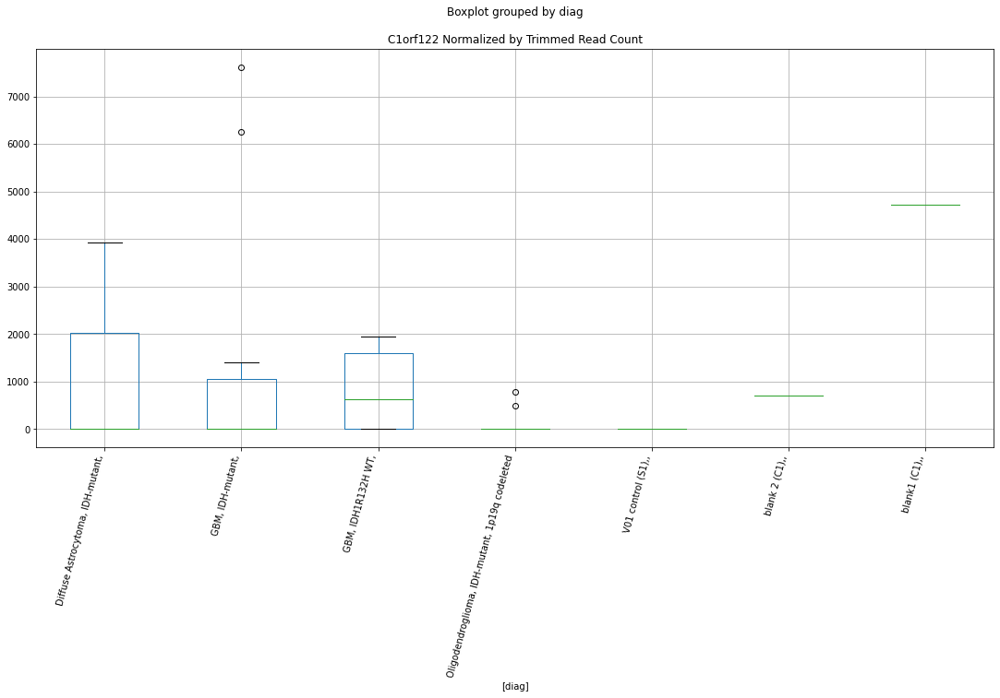

 p : 0.029919467503173477  ( t : 2.357497371841738 ) :  D-plex  :  cutadapt2  :  APBA1
Control and blanks
76     0.0
340    0.0
Name: APBA1, dtype: float64
208    1763.6
Name: APBA1, dtype: float64
472    577.96
Name: APBA1, dtype: float64


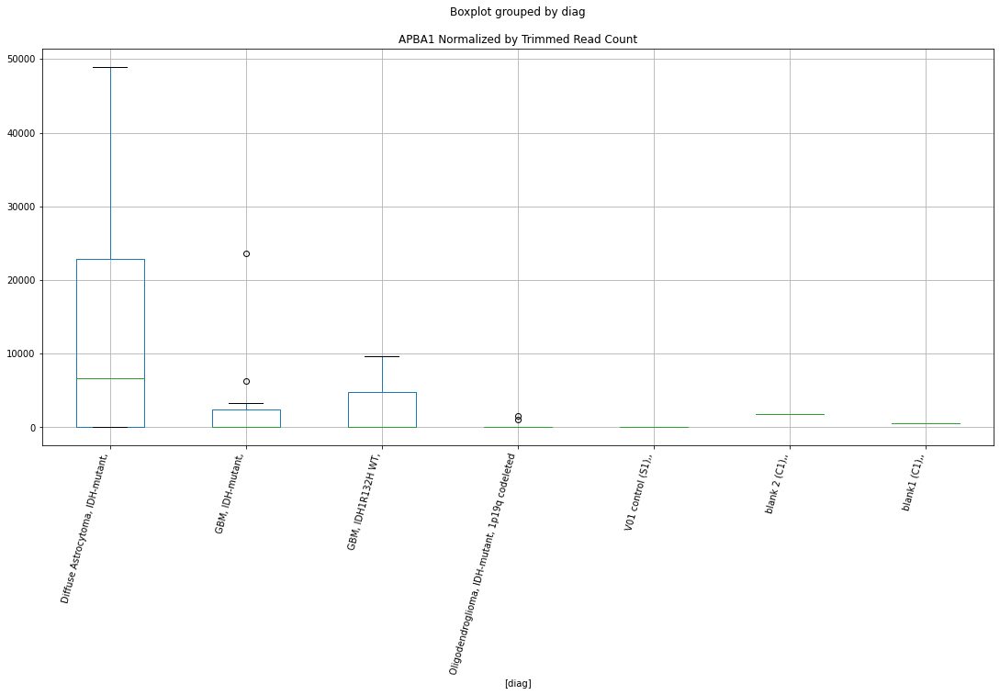

 p : 0.029984109131572224  ( t : 2.3564396917408783 ) :  D-plex  :  bbduk2  :  CD180
Control and blanks
73     0.0
337    0.0
Name: CD180, dtype: float64
205    6268.18
Name: CD180, dtype: float64
469    5915.27
Name: CD180, dtype: float64


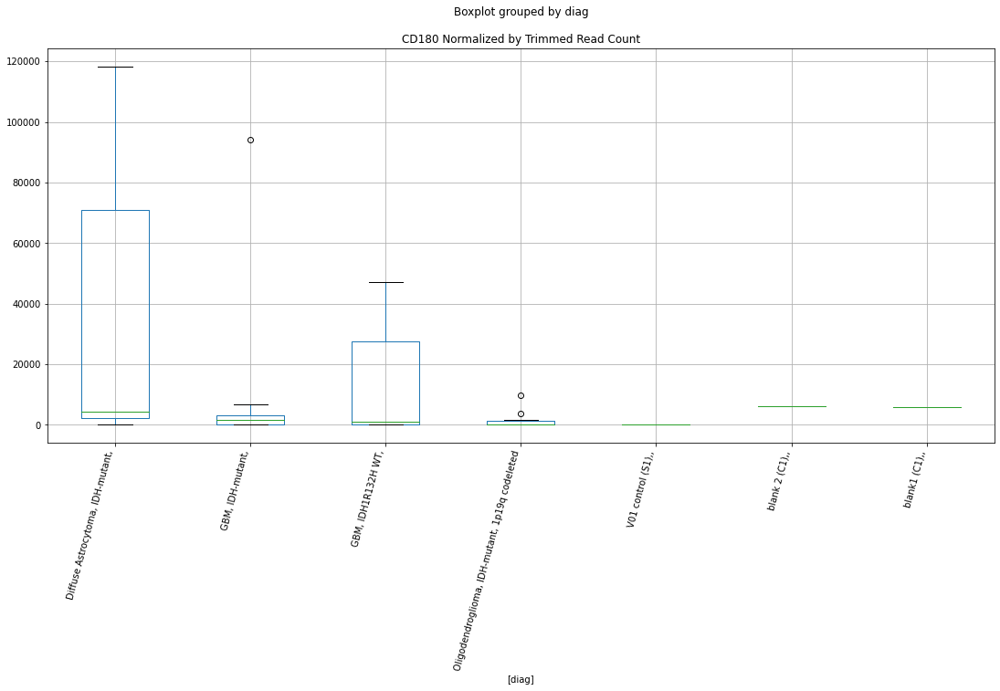

 p : 0.029993422384283163  ( t : 2.356287481438475 ) :  D-plex  :  cutadapt2  :  CERT1
Control and blanks
76     0.0
340    0.0
Name: CERT1, dtype: float64
208    12345.22
Name: CERT1, dtype: float64
472    24852.1
Name: CERT1, dtype: float64


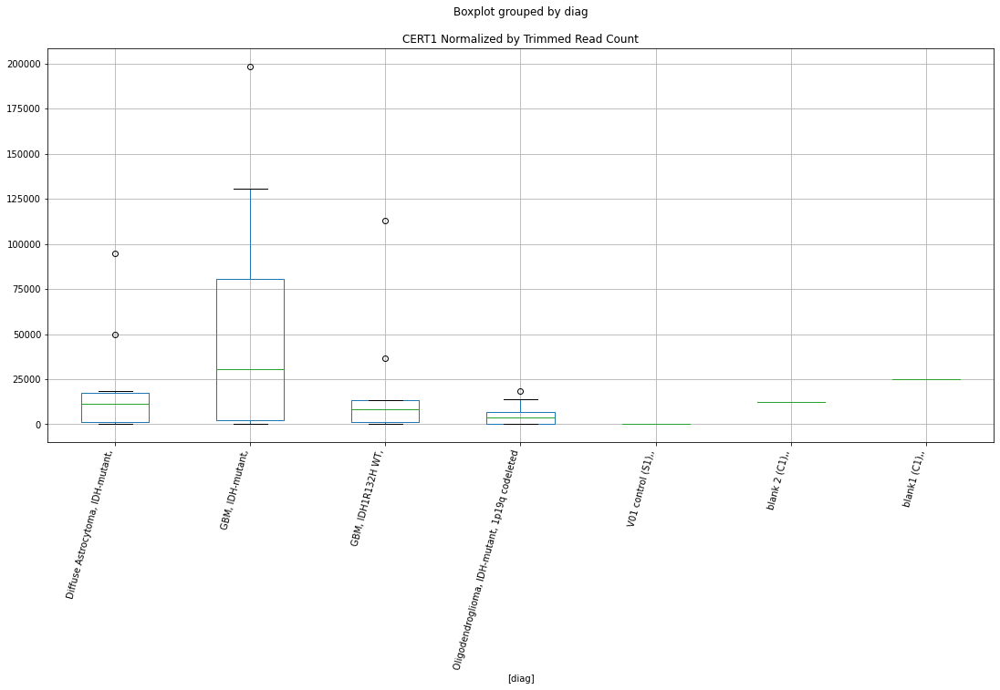

 p : 0.030020731088547067  ( t : 2.3558414178222935 ) :  Lexogen  :  bbduk2  :  ASB16
Control and blanks
79     0.0
343    0.0
Name: ASB16, dtype: float64
211    0.0
Name: ASB16, dtype: float64
475    0.0
Name: ASB16, dtype: float64


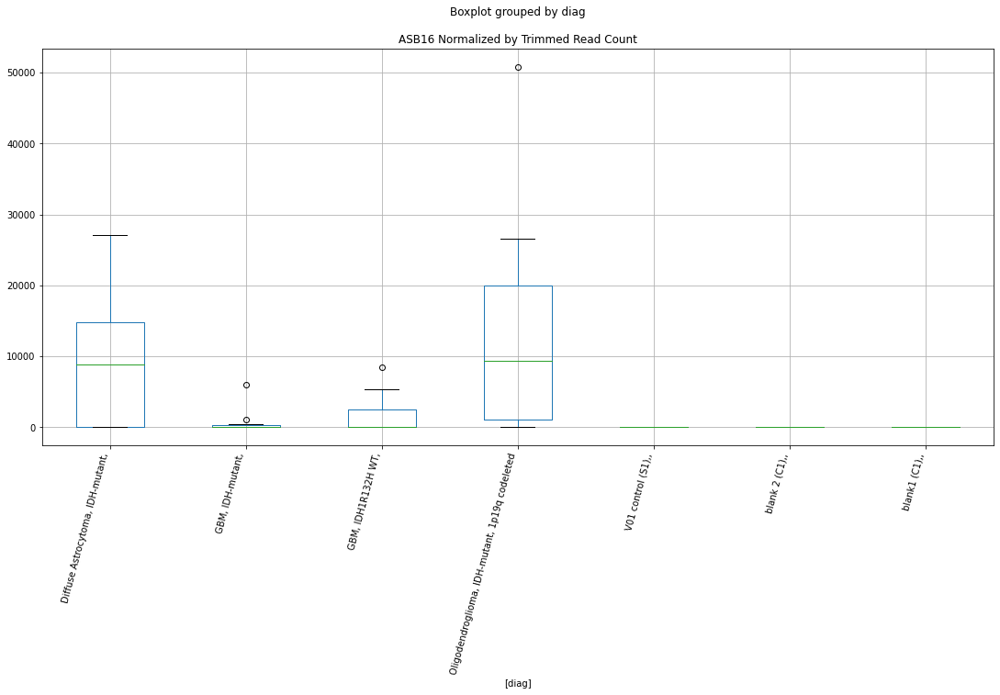

 p : 0.03006550284128888  ( t : 2.3551109279556406 ) :  D-plex  :  bbduk2  :  CDC42
Control and blanks
73     0.0
337    0.0
Name: CDC42, dtype: float64
205    1970.0
Name: CDC42, dtype: float64
469    2366.11
Name: CDC42, dtype: float64


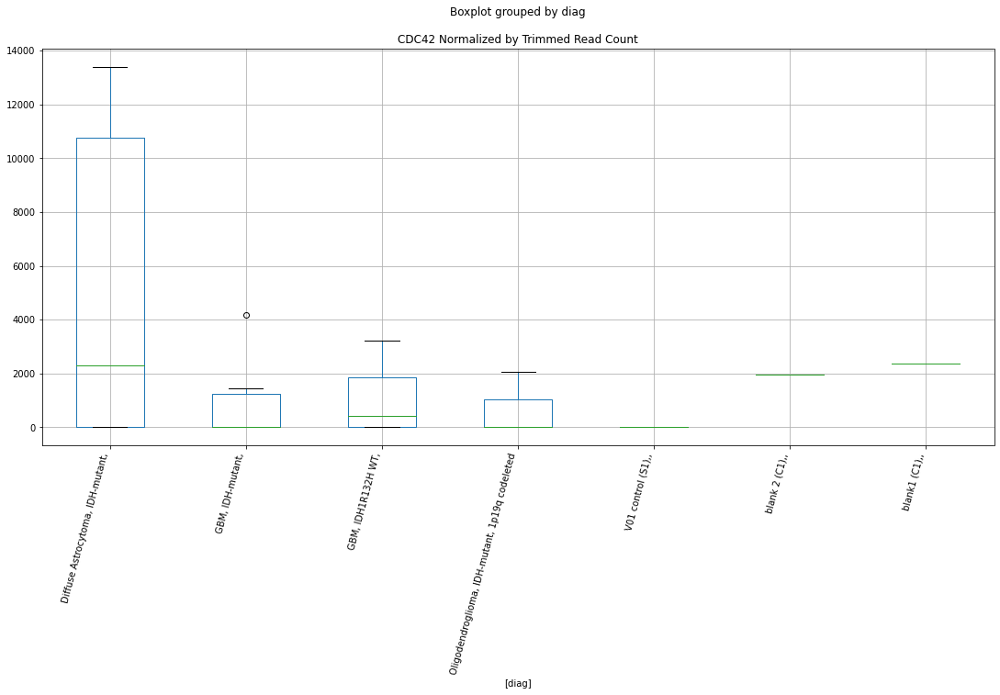

 p : 0.030143234765808002  ( t : 2.3538450679767586 ) :  Lexogen  :  cutadapt2  :  ASB16
Control and blanks
82     0.0
346    0.0
Name: ASB16, dtype: float64
214    0.0
Name: ASB16, dtype: float64
478    0.0
Name: ASB16, dtype: float64


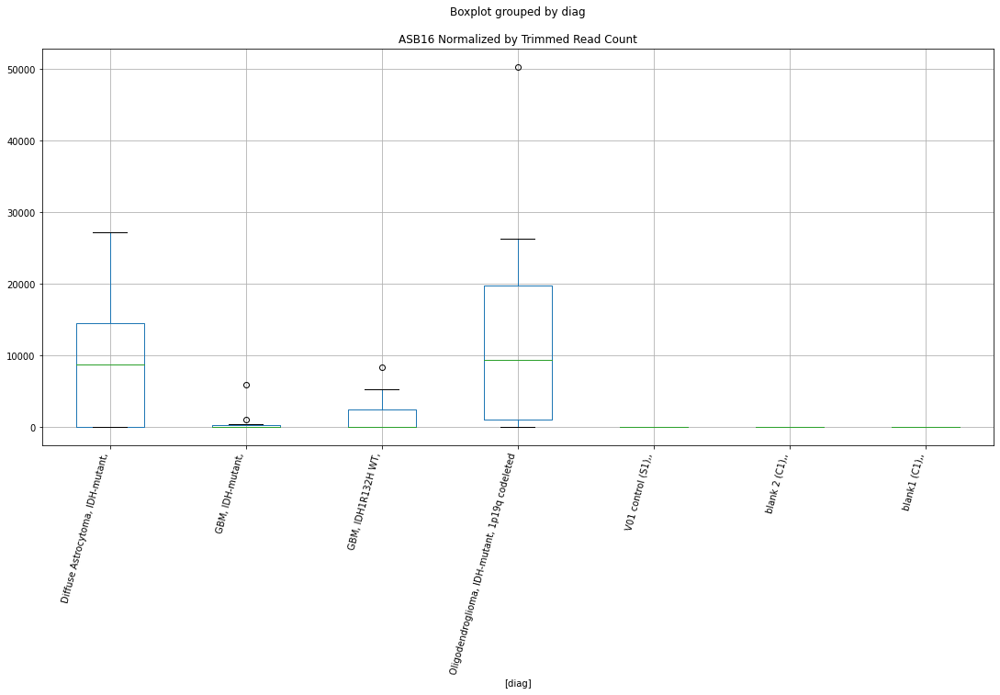

 p : 0.03024255522237667  ( t : 2.352232057209997 ) :  D-plex  :  cutadapt2  :  C2orf42
Control and blanks
76     0.0
340    0.0
Name: C2orf42, dtype: float64
208    705.44
Name: C2orf42, dtype: float64
472    0.0
Name: C2orf42, dtype: float64


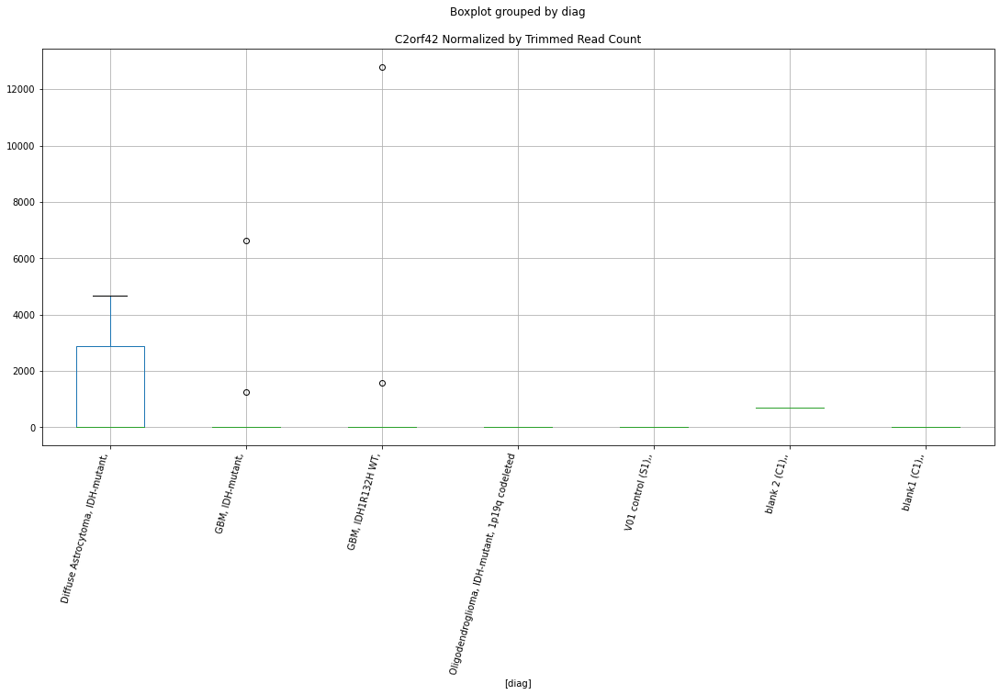

 p : 0.03031531191106931  ( t : 2.3510535823077285 ) :  D-plex  :  cutadapt2  :  BAX
Control and blanks
76     0.0
340    0.0
Name: BAX, dtype: float64
208    14108.82
Name: BAX, dtype: float64
472    8091.38
Name: BAX, dtype: float64


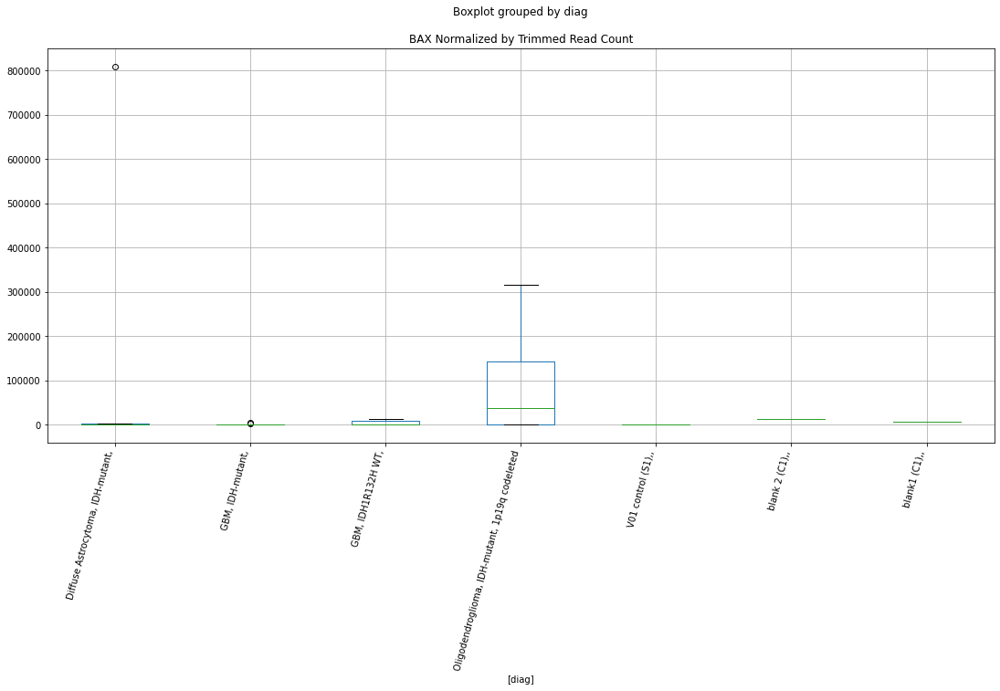

 p : 0.030320463262453794  ( t : 2.3509702432836392 ) :  D-plex  :  cutadapt2  :  CNOT7
Control and blanks
76         0.0
340    49321.0
Name: CNOT7, dtype: float64
208    7583.49
Name: CNOT7, dtype: float64
472    1733.87
Name: CNOT7, dtype: float64


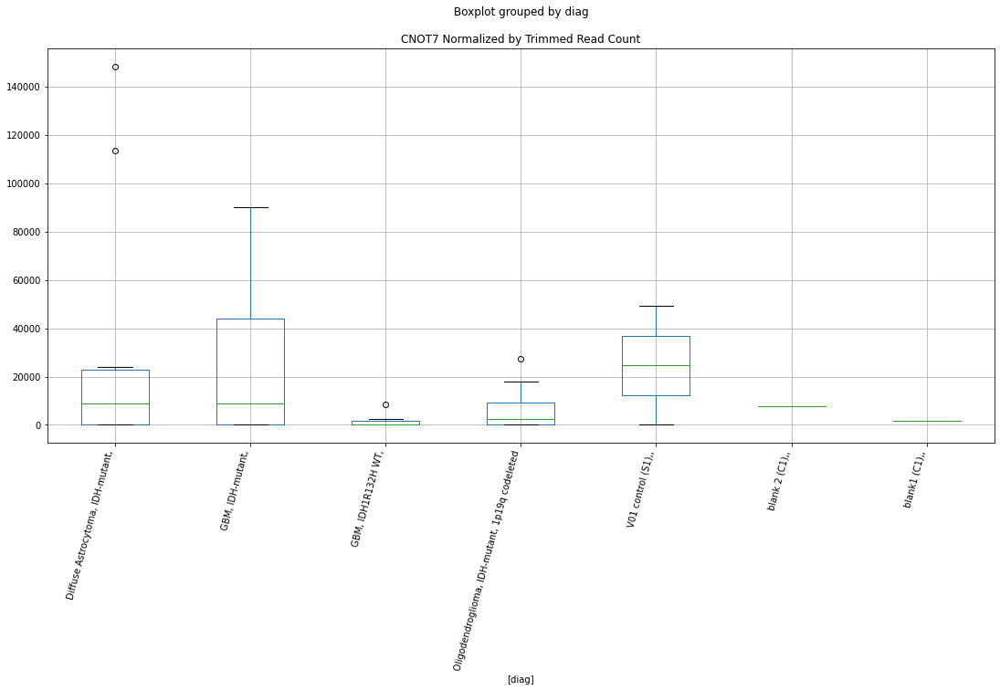

 p : 0.030321844382639587  ( t : 2.3509479016390427 ) :  D-plex  :  bbduk2  :  CMC1
Control and blanks
73         0.00
337    48068.49
Name: CMC1, dtype: float64
205    3044.55
Name: CMC1, dtype: float64
469    5915.27
Name: CMC1, dtype: float64


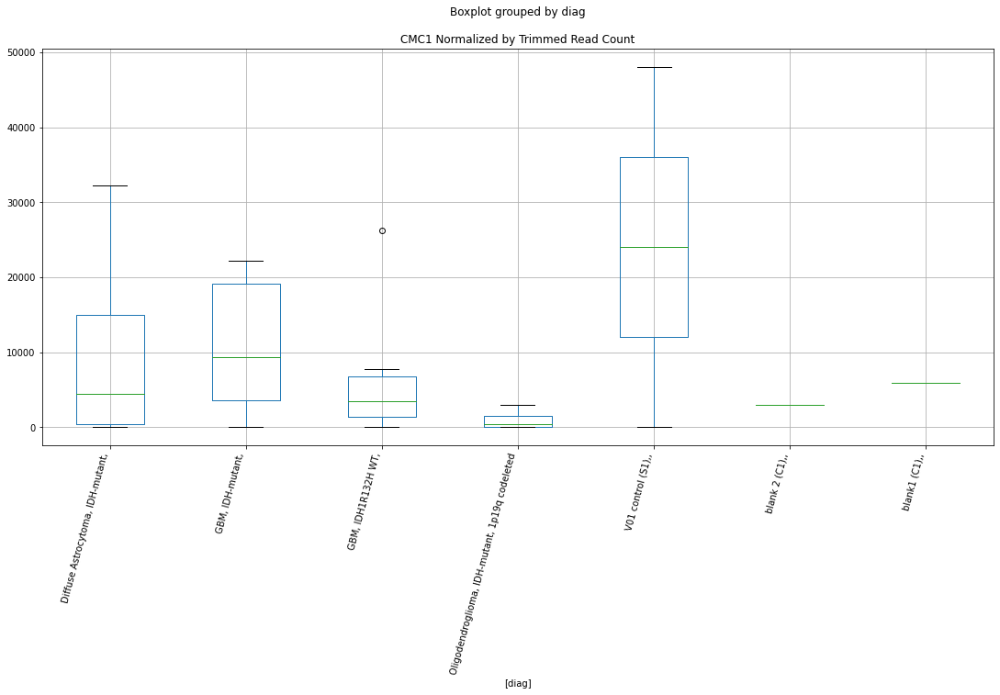

 p : 0.030347319023219514  ( t : 2.350535981816933 ) :  Lexogen  :  cutadapt2  :  CDH4
Control and blanks
82     0.0
346    0.0
Name: CDH4, dtype: float64
214    0.0
Name: CDH4, dtype: float64
478    0.0
Name: CDH4, dtype: float64


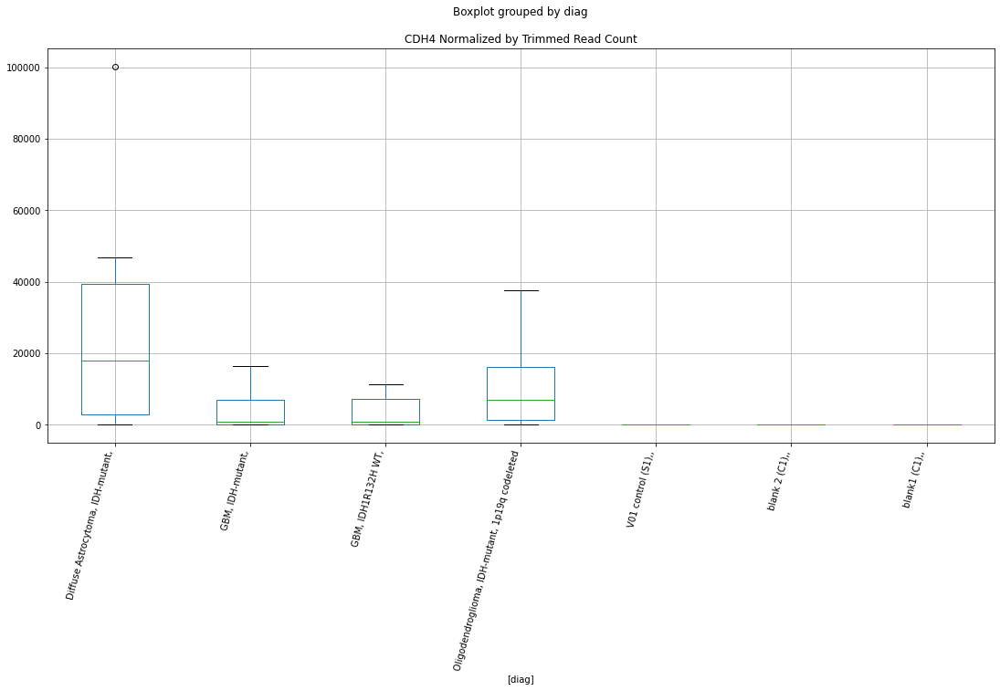

 p : 0.030365948903886622  ( t : 2.350234944180338 ) :  D-plex  :  bbduk2  :  CDC25B
Control and blanks
73        0.00
337    3560.63
Name: CDC25B, dtype: float64
205    31878.19
Name: CDC25B, dtype: float64
469    2366.11
Name: CDC25B, dtype: float64


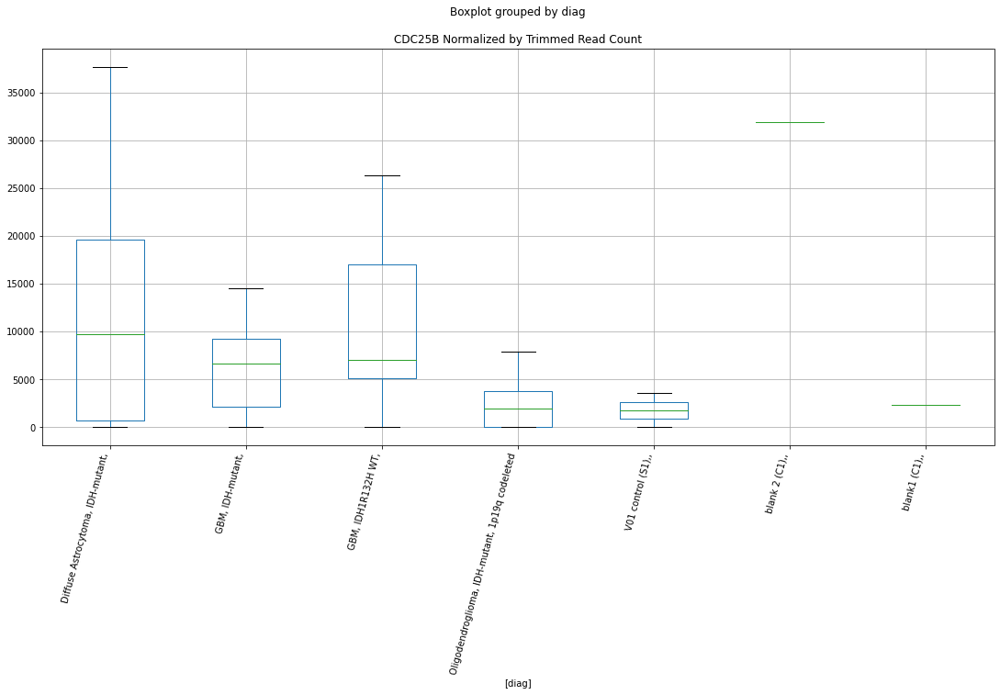

 p : 0.030420000161043792  ( t : 2.349362509771344 ) :  D-plex  :  cutadapt2  :  CBLL1
Control and blanks
76     272741.12
340         0.00
Name: CBLL1, dtype: float64
208    1939.96
Name: CBLL1, dtype: float64
472    0.0
Name: CBLL1, dtype: float64


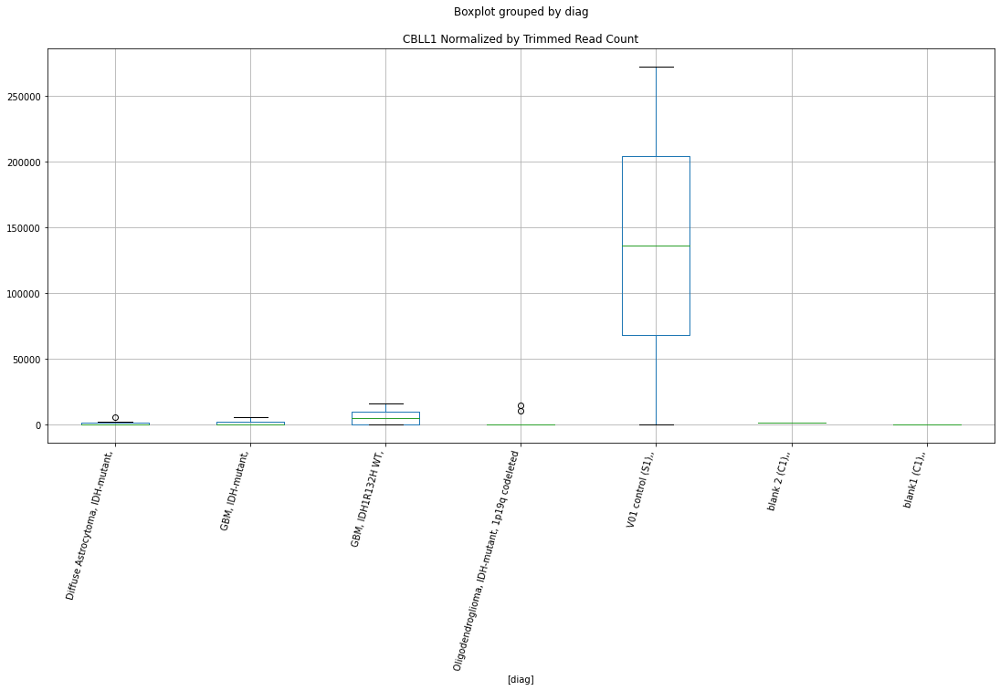

 p : 0.030428846313666418  ( t : 2.3492198626215823 ) :  Lexogen  :  bbduk2  :  ASCL2
Control and blanks
79     0.0
343    0.0
Name: ASCL2, dtype: float64
211    0.0
Name: ASCL2, dtype: float64
475    239.52
Name: ASCL2, dtype: float64


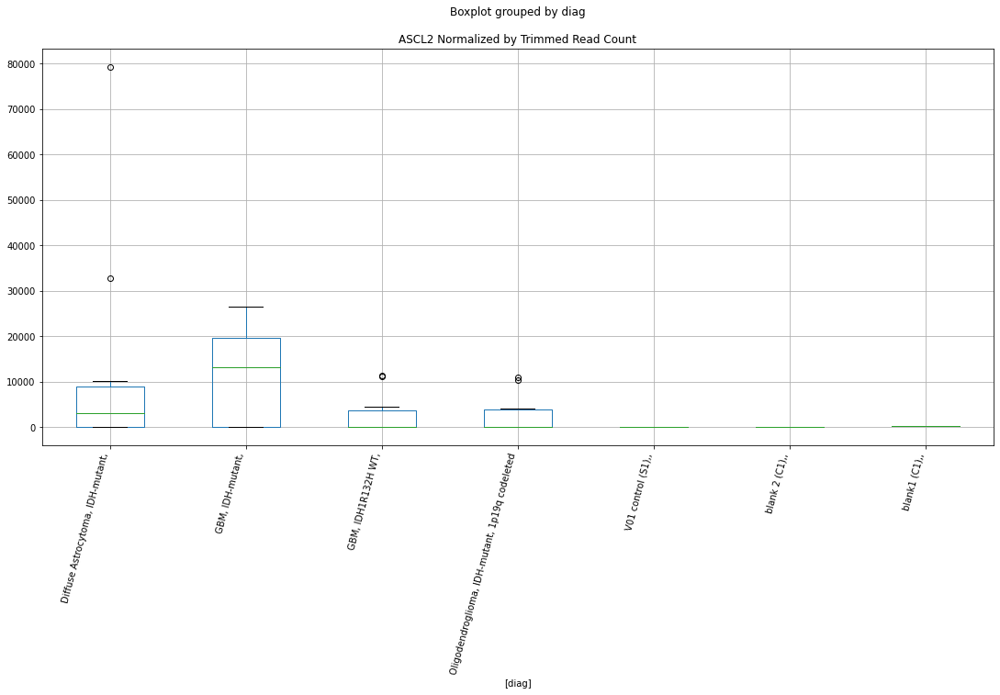

 p : 0.030451684484092887  ( t : 2.3488517679820915 ) :  D-plex  :  cutadapt2  :  CPT1C
Control and blanks
76     4.24e+04
340    1.82e+06
Name: CPT1C, dtype: float64
208    251842.39
Name: CPT1C, dtype: float64
472    186679.74
Name: CPT1C, dtype: float64


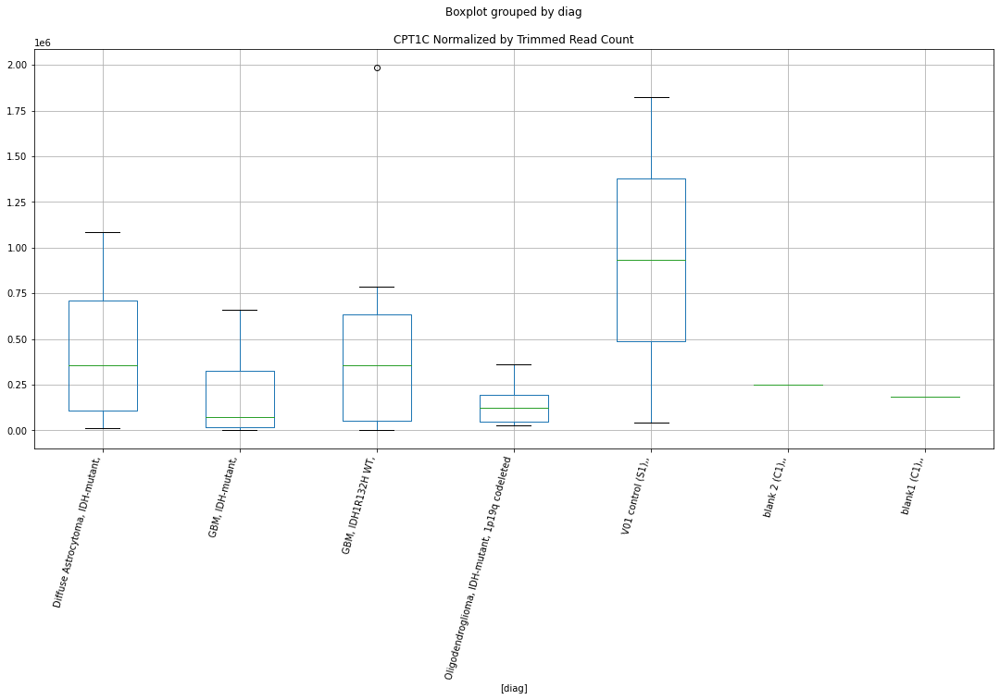

 p : 0.030528915016579016  ( t : 2.3476089047970428 ) :  D-plex  :  cutadapt2  :  CD3D
Control and blanks
76     0.0
340    0.0
Name: CD3D, dtype: float64
208    5819.89
Name: CD3D, dtype: float64
472    146800.78
Name: CD3D, dtype: float64


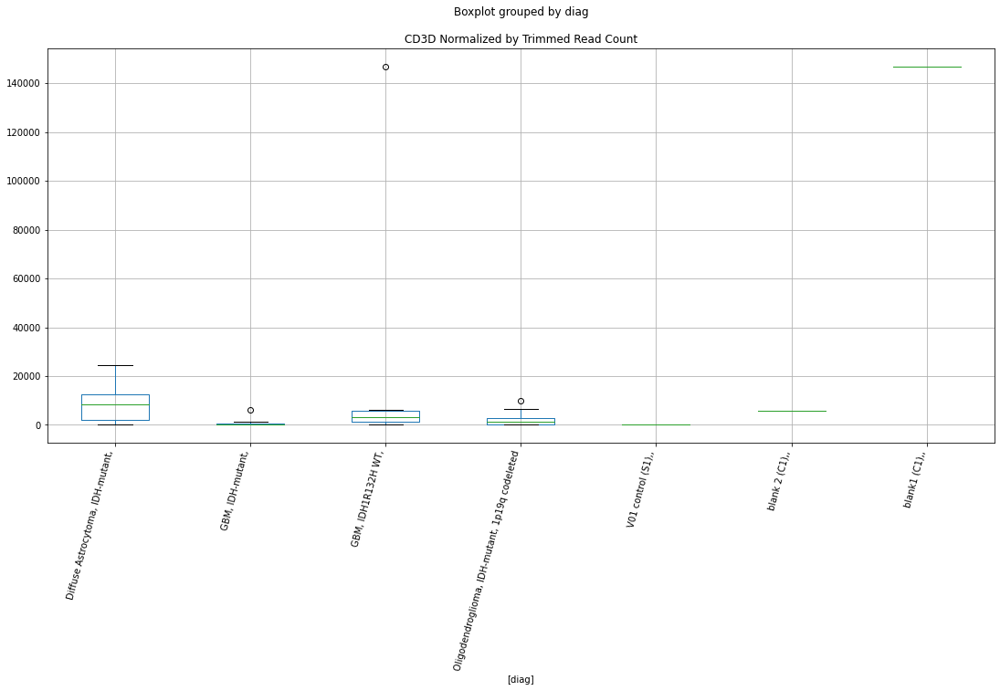

 p : 0.030557158806112088  ( t : 2.3471551112163964 ) :  D-plex  :  cutadapt2  :  DHCR7
Control and blanks
76     65912.44
340        0.00
Name: DHCR7, dtype: float64
208    96292.68
Name: DHCR7, dtype: float64
472    15604.81
Name: DHCR7, dtype: float64


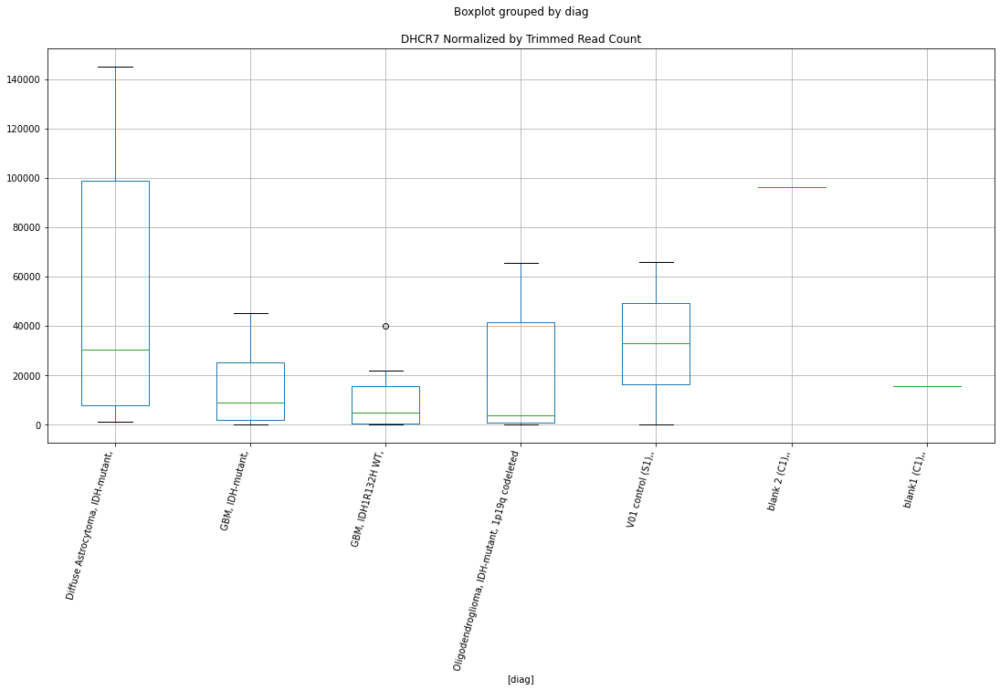

 p : 0.03059293410295536  ( t : 2.34658086895057 ) :  D-plex  :  cutadapt2  :  ASDURF
Control and blanks
76     0.0
340    0.0
Name: ASDURF, dtype: float64
208    705.44
Name: ASDURF, dtype: float64
472    2311.82
Name: ASDURF, dtype: float64


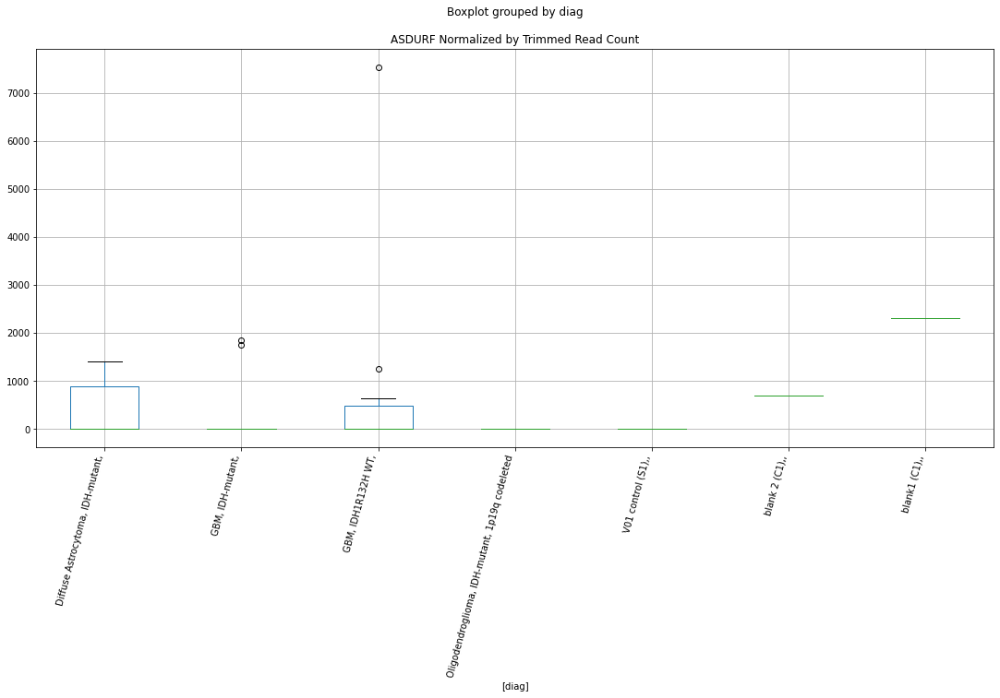

 p : 0.030594699994491374  ( t : 2.34655254017747 ) :  Lexogen  :  cutadapt2  :  CTDSP1
Control and blanks
82         0.00
346    33459.09
Name: CTDSP1, dtype: float64
214    0.0
Name: CTDSP1, dtype: float64
478    1662.22
Name: CTDSP1, dtype: float64


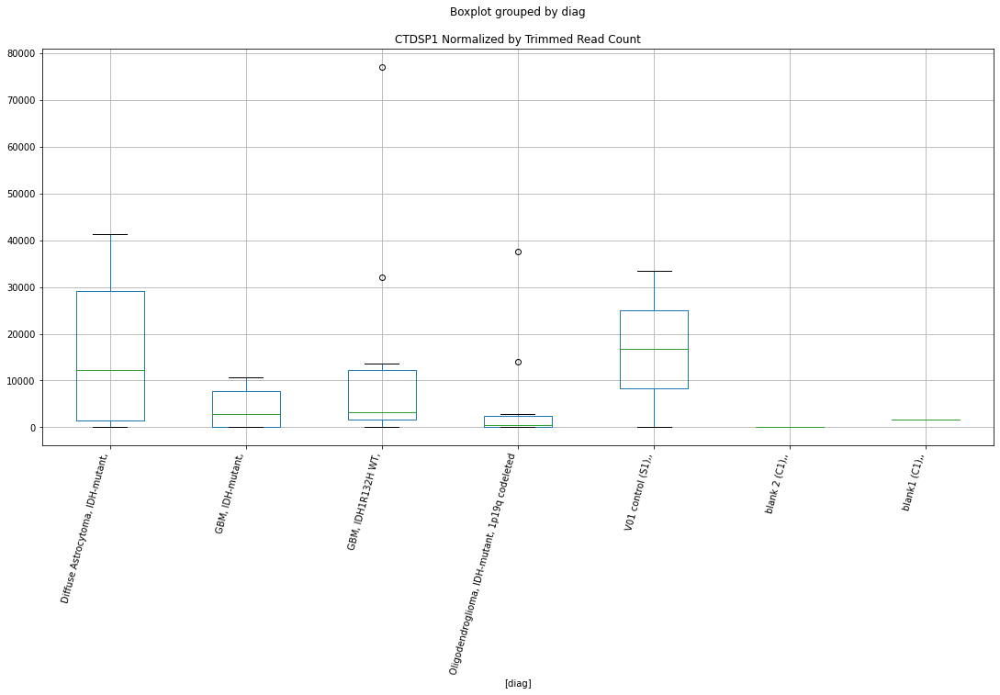

 p : 0.03063022558958095  ( t : 2.345982954799009 ) :  D-plex  :  bbduk2  :  ANKRD28
Control and blanks
73     0.0
337    0.0
Name: ANKRD28, dtype: float64
205    37071.83
Name: ANKRD28, dtype: float64
469    16562.76
Name: ANKRD28, dtype: float64


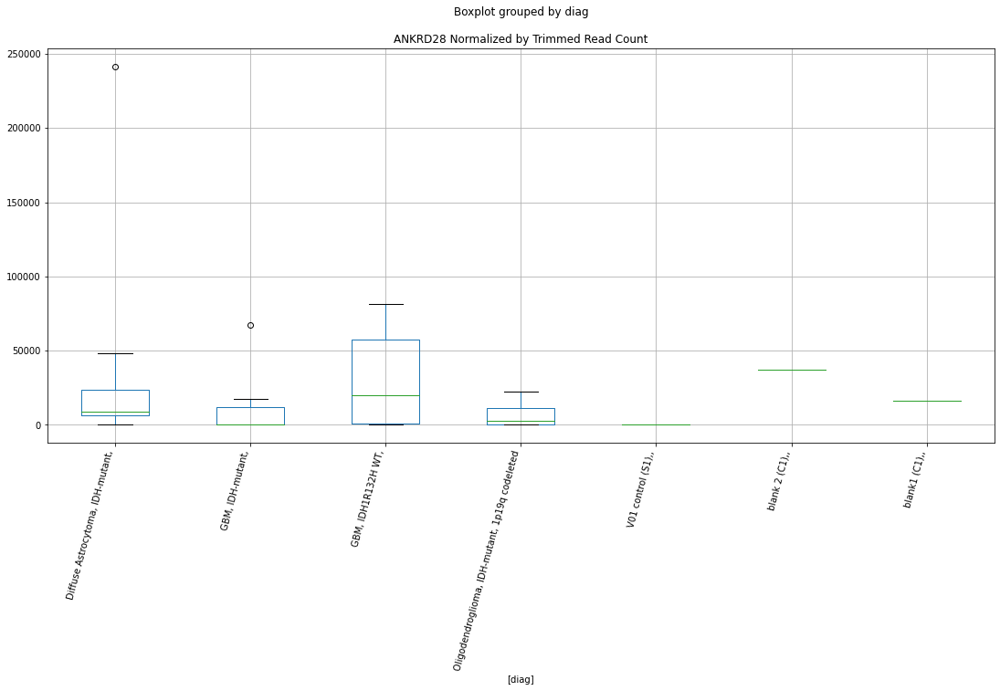

 p : 0.030663361435851254  ( t : 2.345452238503485 ) :  D-plex  :  bbduk2  :  CRB1
Control and blanks
73     0.0
337    0.0
Name: CRB1, dtype: float64
205    4119.09
Name: CRB1, dtype: float64
469    13605.13
Name: CRB1, dtype: float64


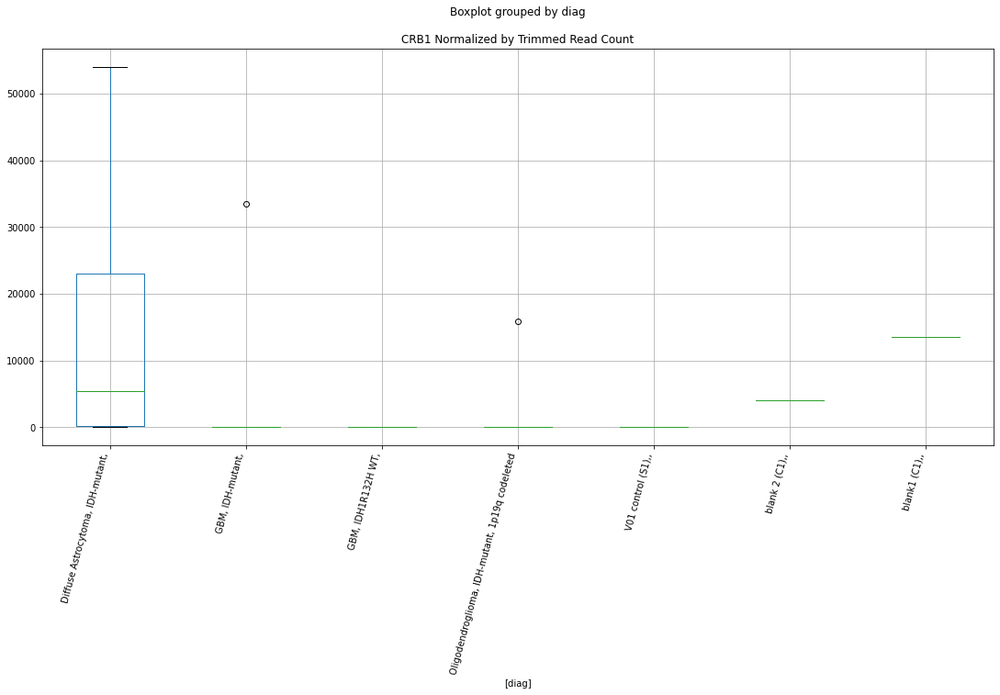

 p : 0.03068553280287401  ( t : 2.345097431479799 ) :  D-plex  :  cutadapt2  :  CHST4
Control and blanks
76      71215.74
340    197284.00
Name: CHST4, dtype: float64
208    359774.84
Name: CHST4, dtype: float64
472    21962.32
Name: CHST4, dtype: float64


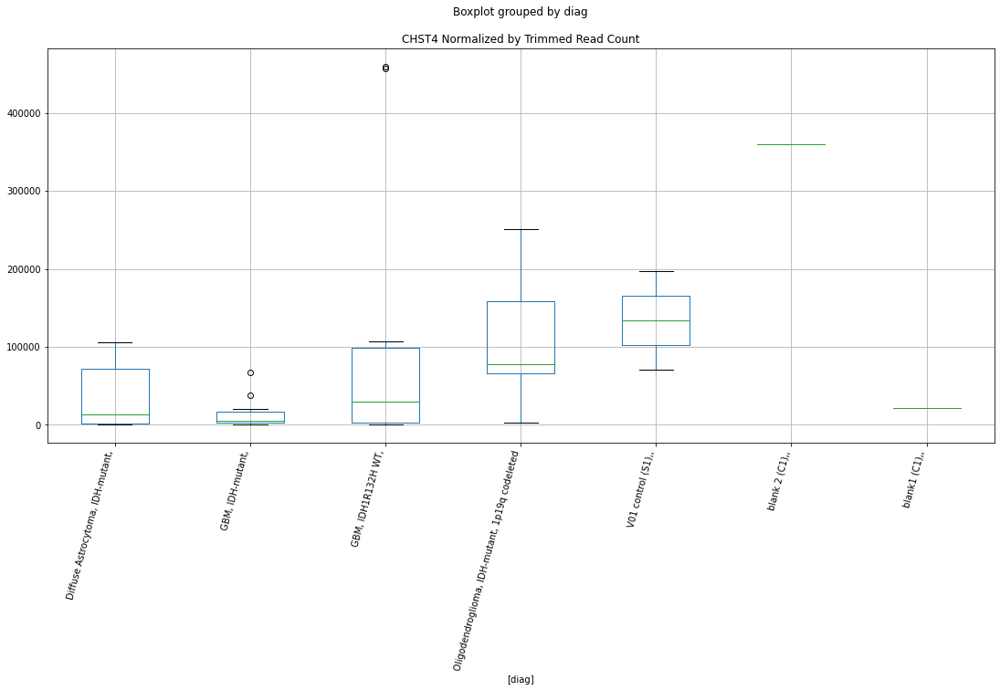

 p : 0.030709819958407505  ( t : 2.3447090393738037 ) :  Lexogen  :  cutadapt2  :  BAHCC1
Control and blanks
82     0.0
346    0.0
Name: BAHCC1, dtype: float64
214    0.0
Name: BAHCC1, dtype: float64
478    0.0
Name: BAHCC1, dtype: float64


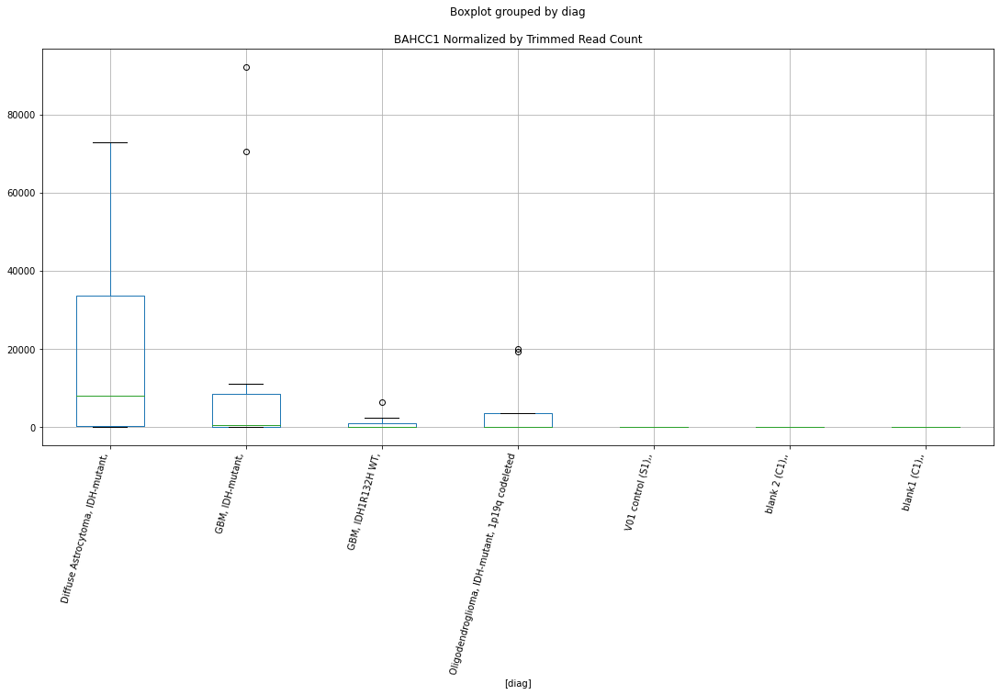

 p : 0.030720014206456463  ( t : 2.3445461015306104 ) :  Lexogen  :  bbduk2  :  BAHCC1
Control and blanks
79     0.0
343    0.0
Name: BAHCC1, dtype: float64
211    2733.06
Name: BAHCC1, dtype: float64
475    0.0
Name: BAHCC1, dtype: float64


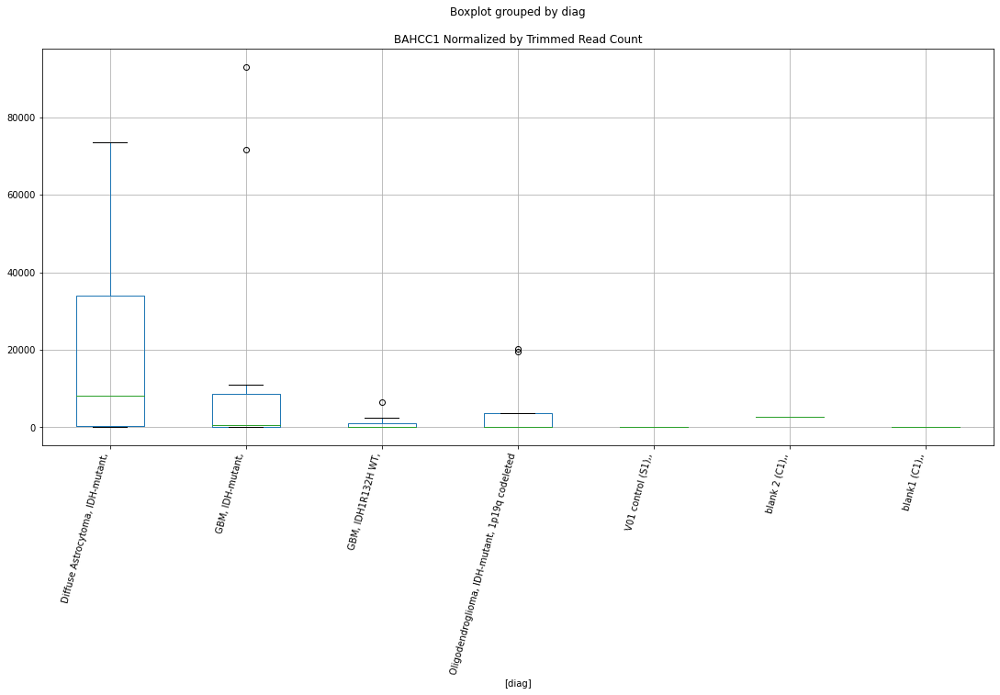

 p : 0.030729537664516995  ( t : 2.3443939305927373 ) :  D-plex  :  bbduk2  :  DHCR7
Control and blanks
73     67251.73
337        0.00
Name: DHCR7, dtype: float64
205    96171.84
Name: DHCR7, dtype: float64
469    14196.66
Name: DHCR7, dtype: float64


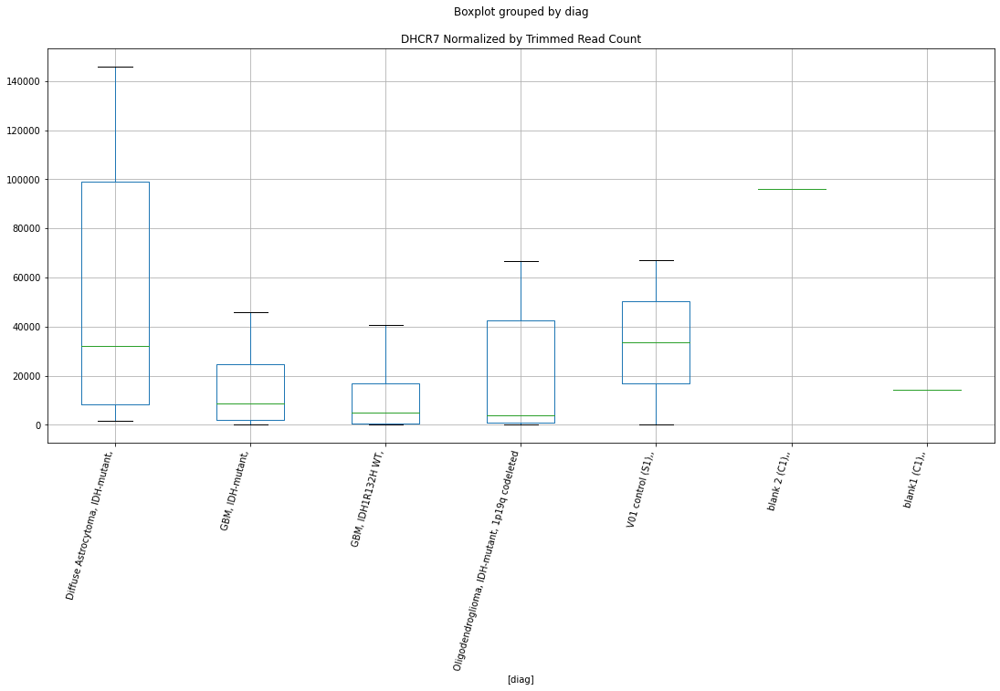

 p : 0.03080239168525202  ( t : 2.343231279882828 ) :  D-plex  :  bbduk2  :  CNN1
Control and blanks
73        0.00
337    1780.31
Name: CNN1, dtype: float64
205    3044.55
Name: CNN1, dtype: float64
469    0.0
Name: CNN1, dtype: float64


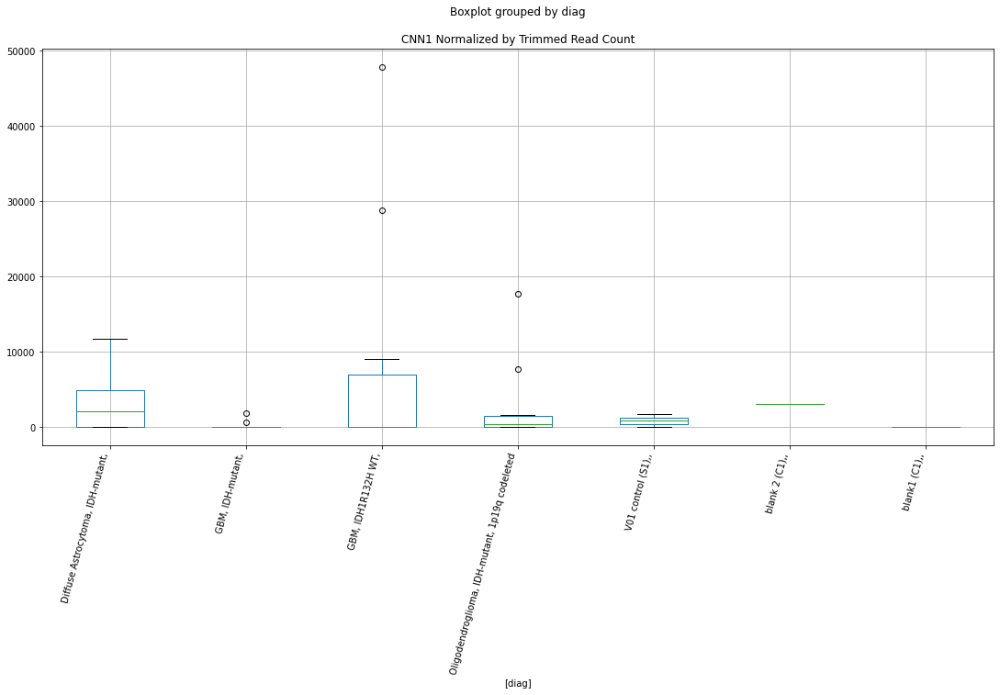

 p : 0.030948989580299194  ( t : 2.340899512666232 ) :  D-plex  :  cutadapt2  :  C6orf132
Control and blanks
76     0.0
340    0.0
Name: C6orf132, dtype: float64
208    352.72
Name: C6orf132, dtype: float64
472    577.96
Name: C6orf132, dtype: float64


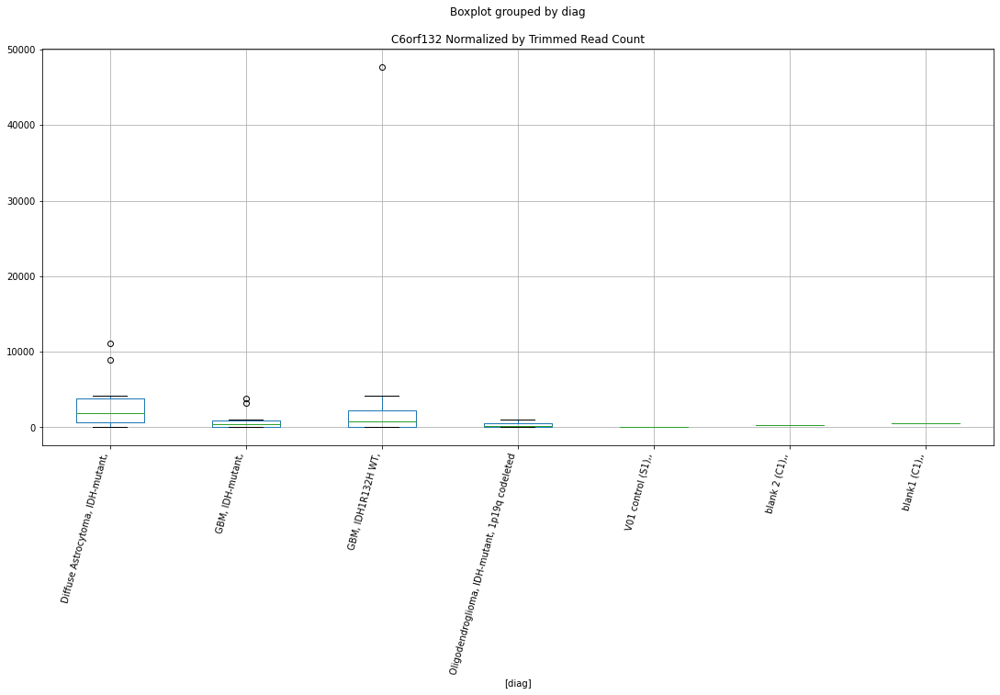

 p : 0.030954281192484577  ( t : 2.3408155372880706 ) :  D-plex  :  bbduk2  :  CMTM3
Control and blanks
73     0.0
337    0.0
Name: CMTM3, dtype: float64
205    895.45
Name: CMTM3, dtype: float64
469    3549.16
Name: CMTM3, dtype: float64


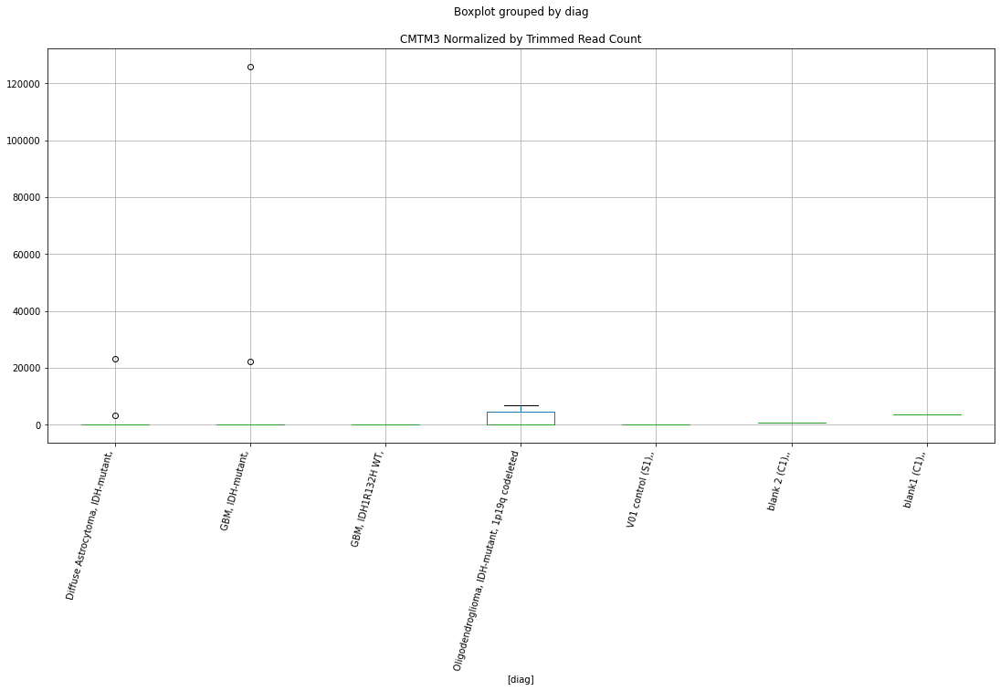

 p : 0.030961869244279308  ( t : 2.3406951418078275 ) :  D-plex  :  bbduk2  :  DHRS11
Control and blanks
73     0.0
337    0.0
Name: DHRS11, dtype: float64
205    716.36
Name: DHRS11, dtype: float64
469    0.0
Name: DHRS11, dtype: float64


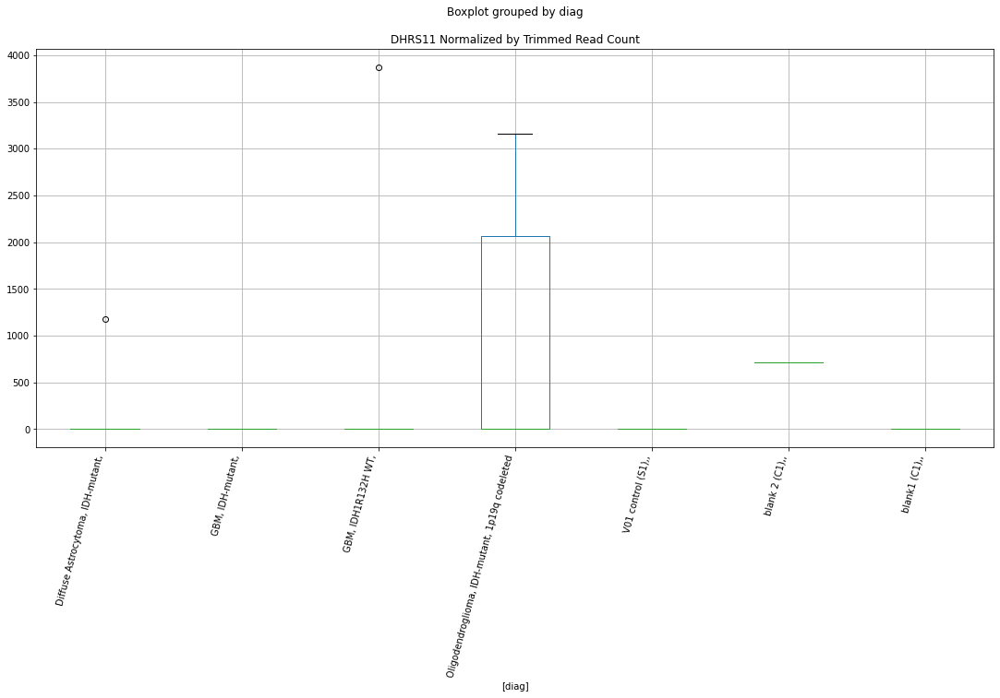

 p : 0.03101803206972655  ( t : 2.3398048894698125 ) :  Lexogen  :  bbduk2  :  ANKRD50
Control and blanks
79       0.00
343    636.94
Name: ANKRD50, dtype: float64
211    2459.76
Name: ANKRD50, dtype: float64
475    22274.96
Name: ANKRD50, dtype: float64


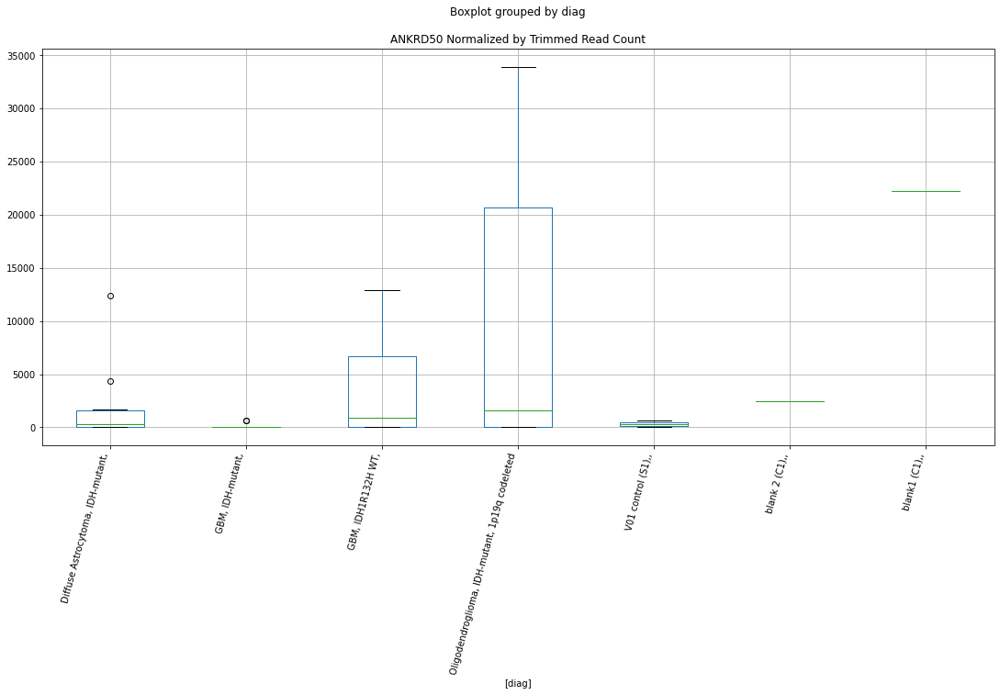

 p : 0.0310334074596085  ( t : 2.3395614314318505 ) :  D-plex  :  bbduk2  :  ASNSP1
Control and blanks
73     773.01
337      0.00
Name: ASNSP1, dtype: float64
205    358.18
Name: ASNSP1, dtype: float64
469    591.53
Name: ASNSP1, dtype: float64


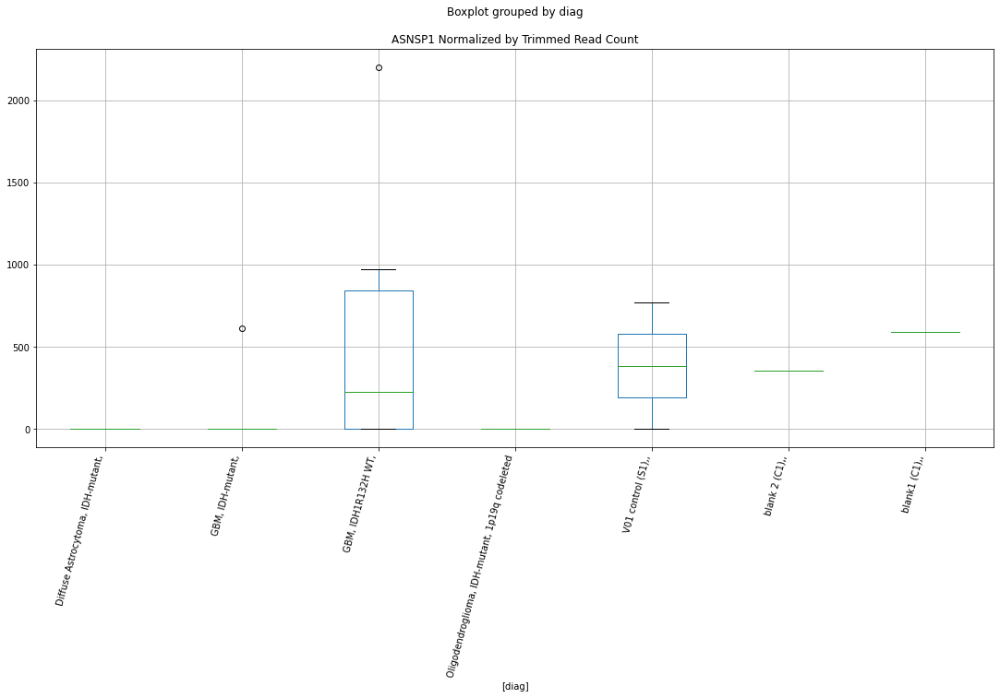

 p : 0.03107668658255616  ( t : 2.338876740219939 ) :  Lexogen  :  cutadapt2  :  CFAP221
Control and blanks
82     0.0
346    0.0
Name: CFAP221, dtype: float64
214    0.0
Name: CFAP221, dtype: float64
478    0.0
Name: CFAP221, dtype: float64


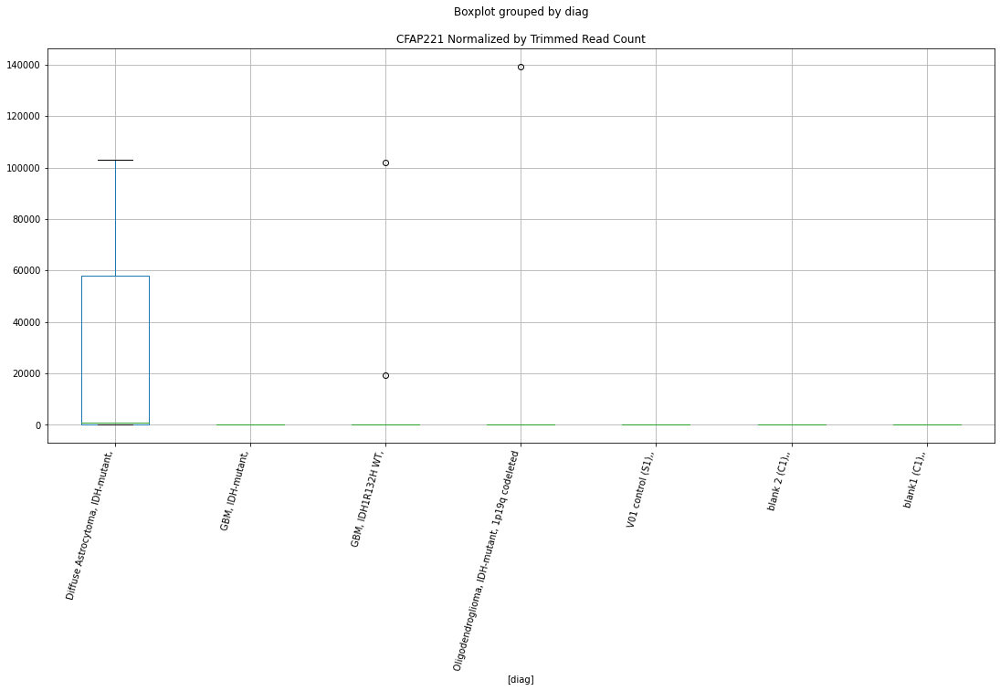

 p : 0.031089728958325222  ( t : 2.3386705791044764 ) :  Lexogen  :  bbduk2  :  CFAP221
Control and blanks
79     0.0
343    0.0
Name: CFAP221, dtype: float64
211    0.0
Name: CFAP221, dtype: float64
475    0.0
Name: CFAP221, dtype: float64


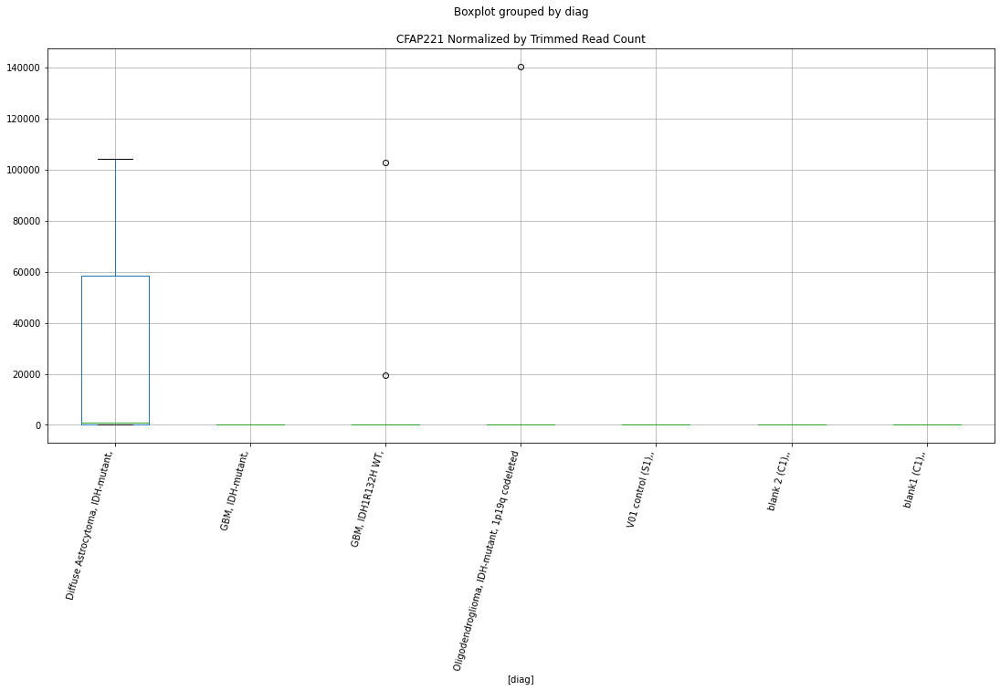

 p : 0.031092437328785253  ( t : 2.3386277779226017 ) :  Lexogen  :  bbduk2  :  ADARB2
Control and blanks
79         0.0
343    14862.0
Name: ADARB2, dtype: float64
211    2459.76
Name: ADARB2, dtype: float64
475    0.0
Name: ADARB2, dtype: float64


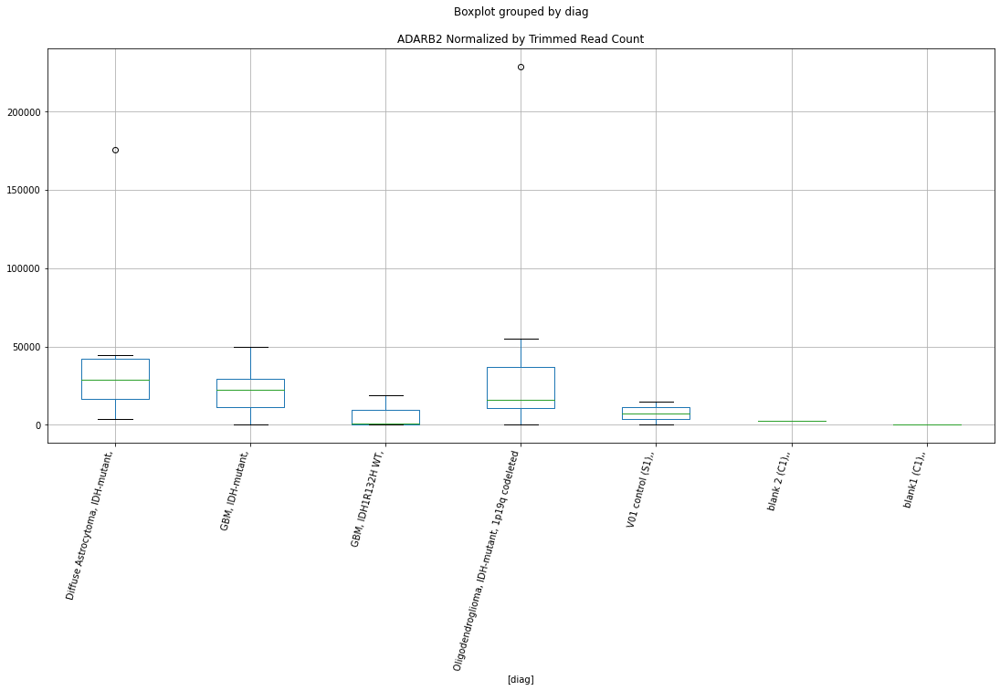

 p : 0.031217547943104502  ( t : 2.336654388400195 ) :  D-plex  :  bbduk2  :  BSN-DT
Control and blanks
73         0.00
337    15132.67
Name: BSN-DT, dtype: float64
205    358.18
Name: BSN-DT, dtype: float64
469    591.53
Name: BSN-DT, dtype: float64


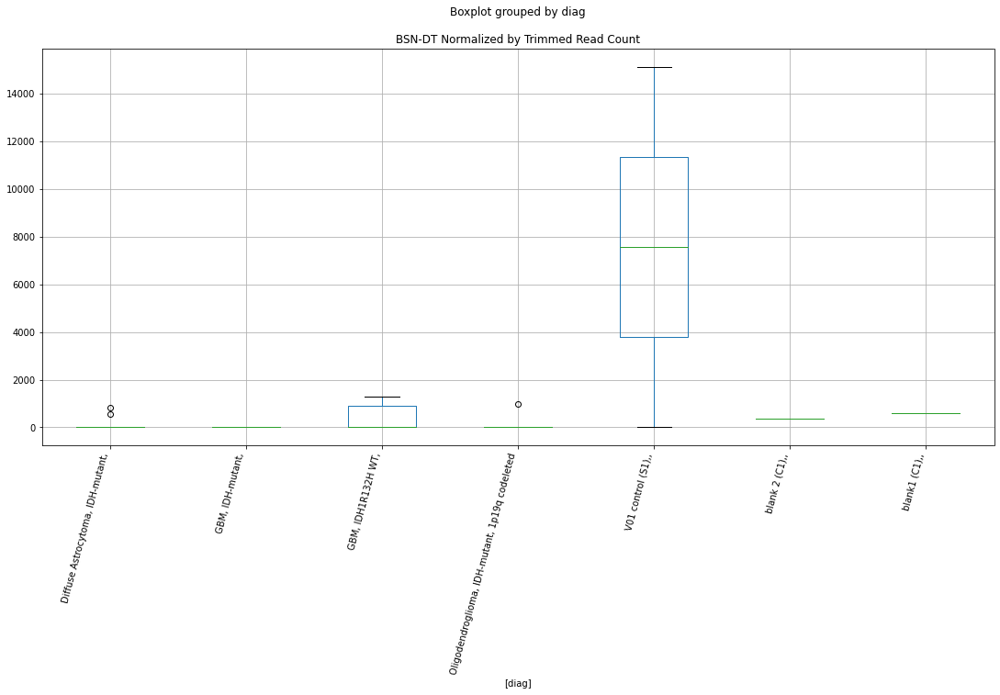

 p : 0.03123400388288274  ( t : 2.3363953738856127 ) :  Lexogen  :  cutadapt2  :  ADARB2
Control and blanks
82         0.00
346    14940.85
Name: ADARB2, dtype: float64
214    2441.04
Name: ADARB2, dtype: float64
478    0.0
Name: ADARB2, dtype: float64


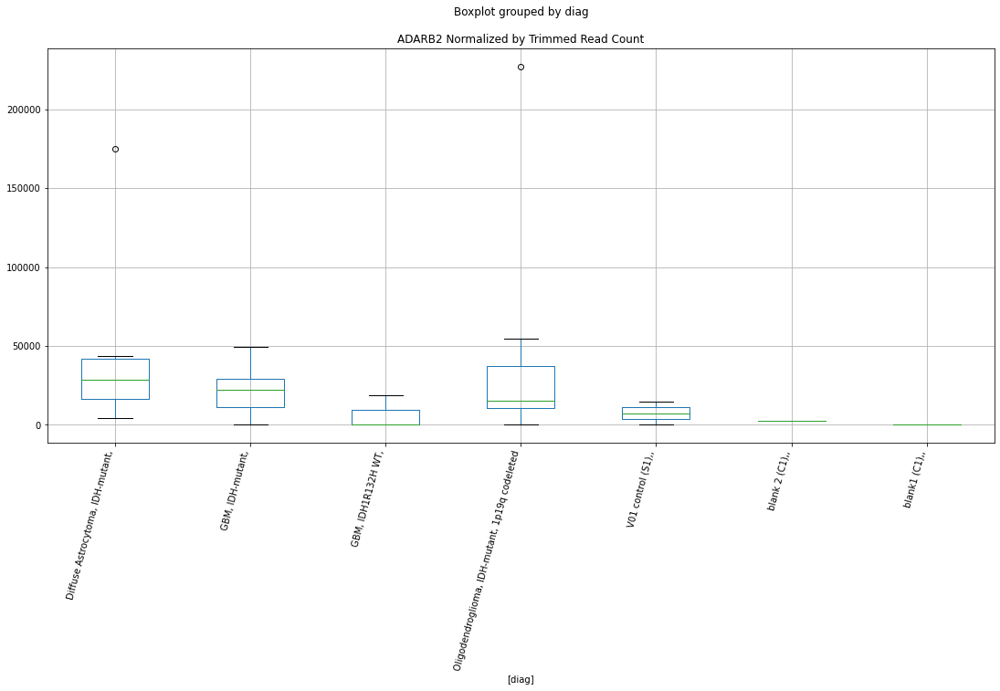

 p : 0.03126358740923691  ( t : 2.3359300517541013 ) :  D-plex  :  cutadapt2  :  ATP6V0E2-AS1
Control and blanks
76     0.0
340    0.0
Name: ATP6V0E2-AS1, dtype: float64
208    0.0
Name: ATP6V0E2-AS1, dtype: float64
472    0.0
Name: ATP6V0E2-AS1, dtype: float64


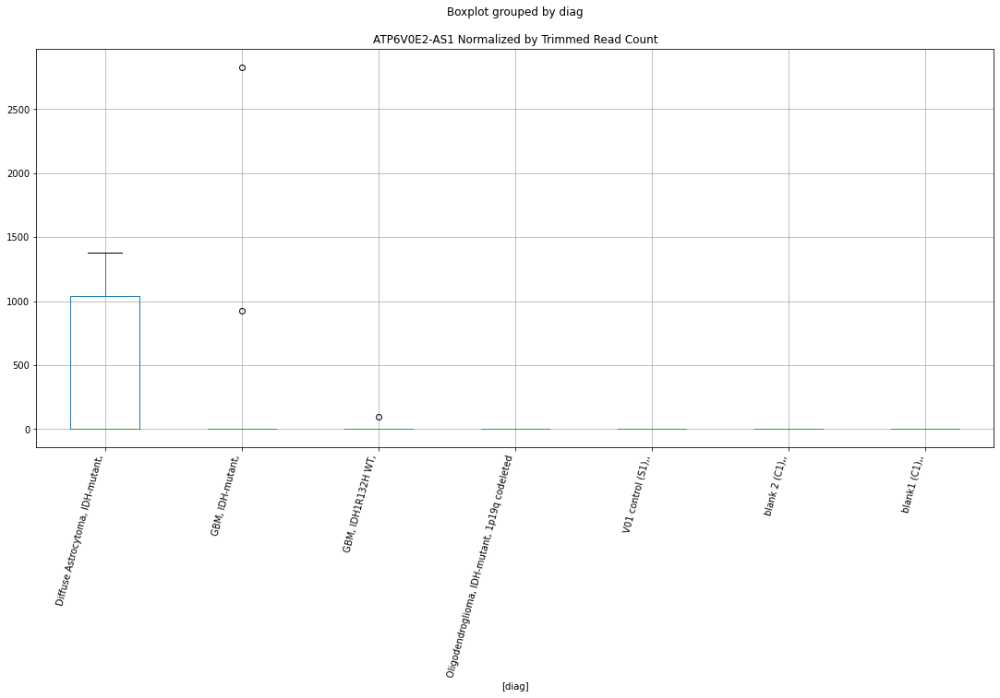

 p : 0.03130388215753434  ( t : 2.335296910102589 ) :  D-plex  :  bbduk2  :  ARHGAP4
Control and blanks
73     0.0
337    0.0
Name: ARHGAP4, dtype: float64
205    1790.91
Name: ARHGAP4, dtype: float64
469    1183.05
Name: ARHGAP4, dtype: float64


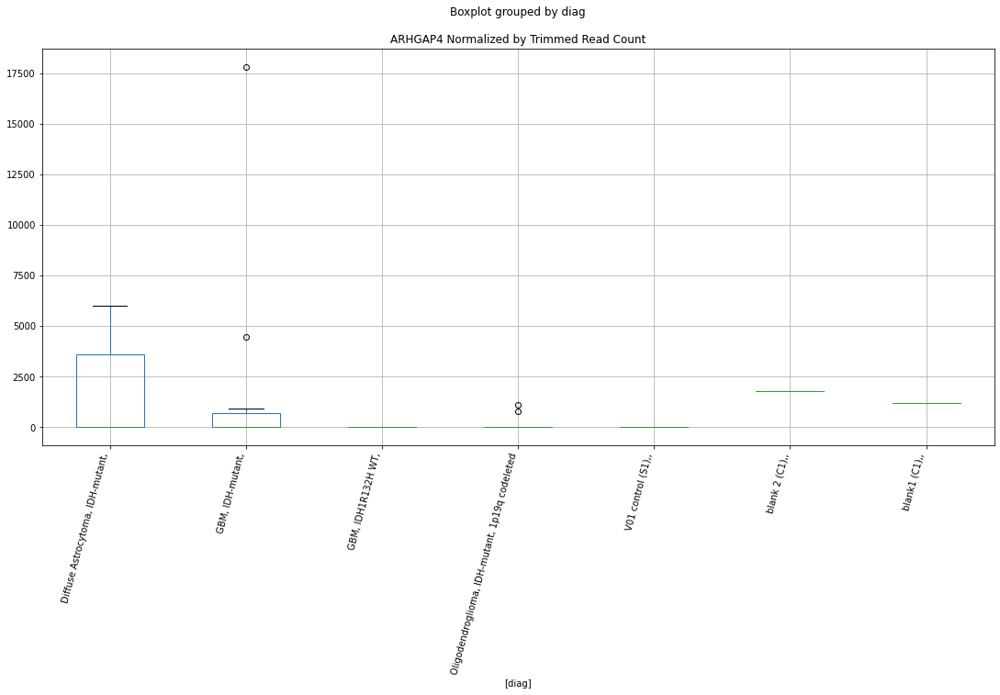

 p : 0.03138543168922846  ( t : 2.3340178577509576 ) :  Lexogen  :  bbduk2  :  B4GAT1
Control and blanks
79     0.0
343    0.0
Name: B4GAT1, dtype: float64
211    273.31
Name: B4GAT1, dtype: float64
475    479.03
Name: B4GAT1, dtype: float64


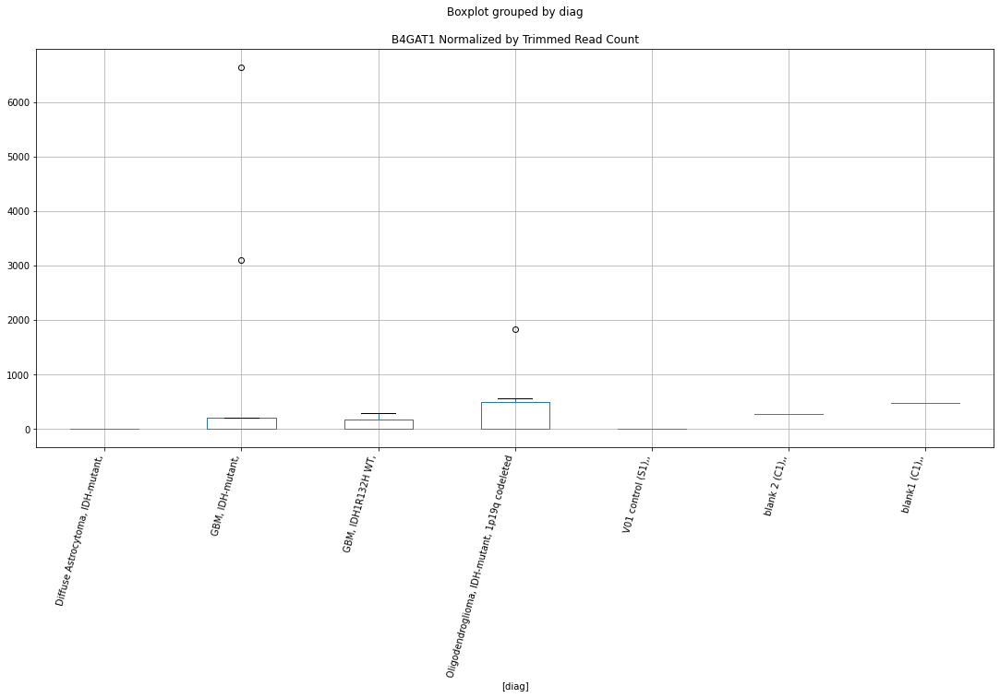

 p : 0.0314129284565924  ( t : 2.3335872851278325 ) :  Lexogen  :  cutadapt2  :  BASP1
Control and blanks
82       0.00
346    420.87
Name: BASP1, dtype: float64
214    0.0
Name: BASP1, dtype: float64
478    13772.71
Name: BASP1, dtype: float64


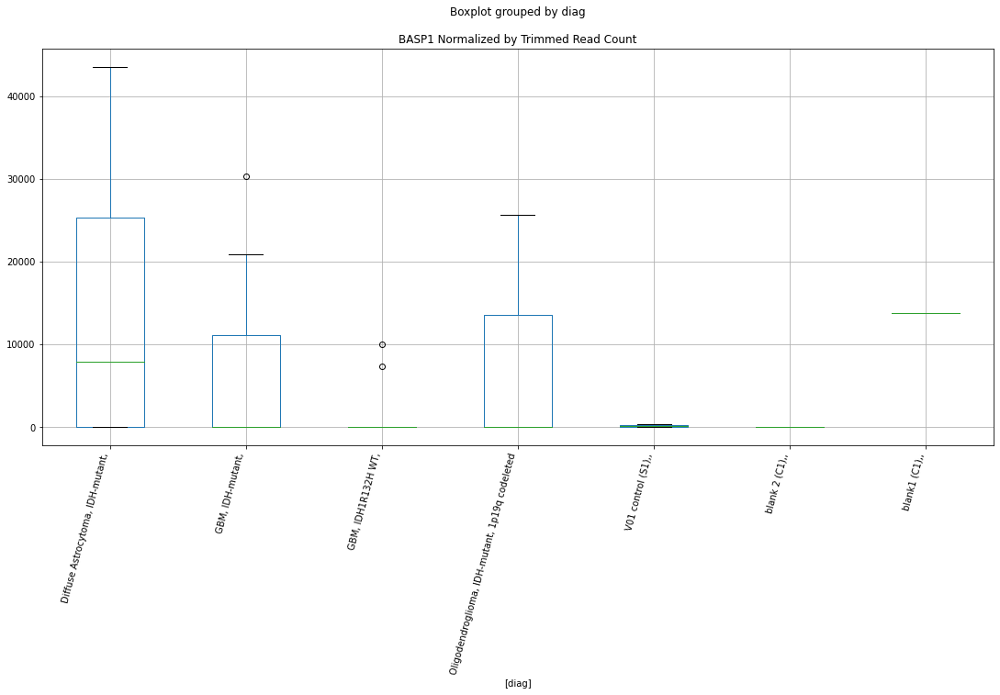

 p : 0.03152438533803326  ( t : 2.3318455604075674 ) :  D-plex  :  cutadapt2  :  ATP5MGL
Control and blanks
76     0.0
340    0.0
Name: ATP5MGL, dtype: float64
208    0.0
Name: ATP5MGL, dtype: float64
472    0.0
Name: ATP5MGL, dtype: float64


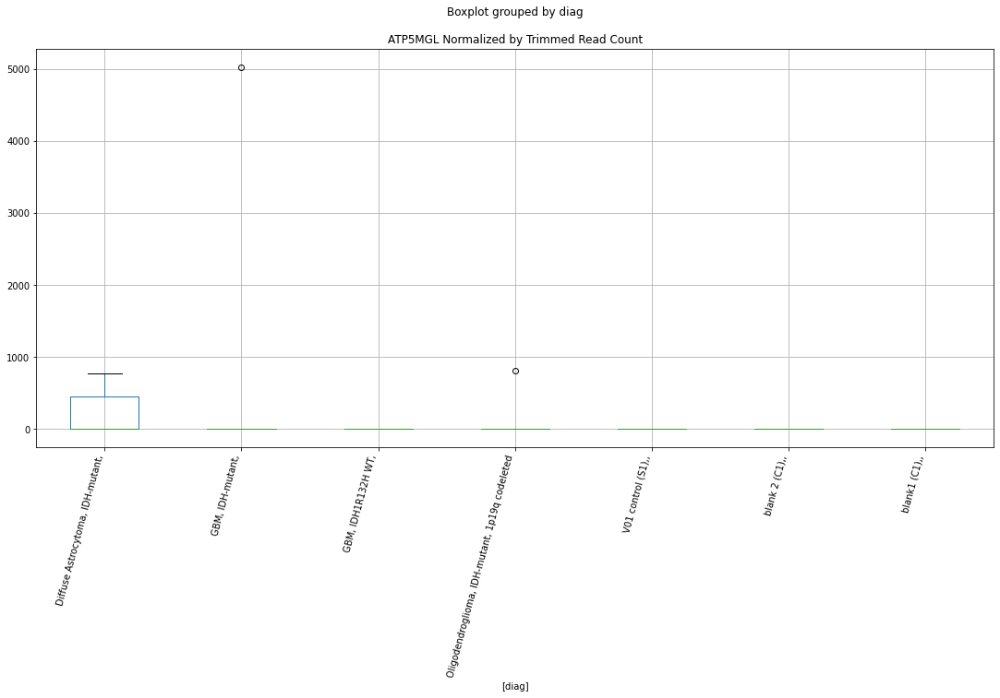

 p : 0.03155184681470227  ( t : 2.3314173020311033 ) :  D-plex  :  bbduk2  :  CCDC168
Control and blanks
73     1546.02
337    1780.31
Name: CCDC168, dtype: float64
205    1432.73
Name: CCDC168, dtype: float64
469    3549.16
Name: CCDC168, dtype: float64


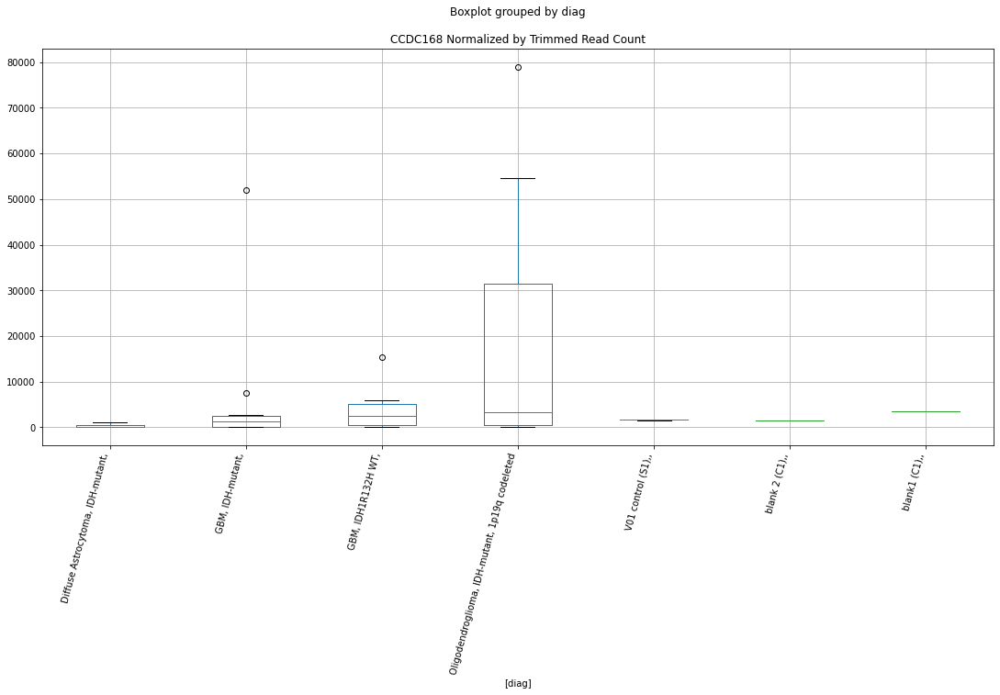

 p : 0.03158175193031268  ( t : 2.330951329374675 ) :  D-plex  :  bbduk2  :  CAB39L
Control and blanks
73     0.0
337    0.0
Name: CAB39L, dtype: float64
205    21490.91
Name: CAB39L, dtype: float64
469    7098.33
Name: CAB39L, dtype: float64


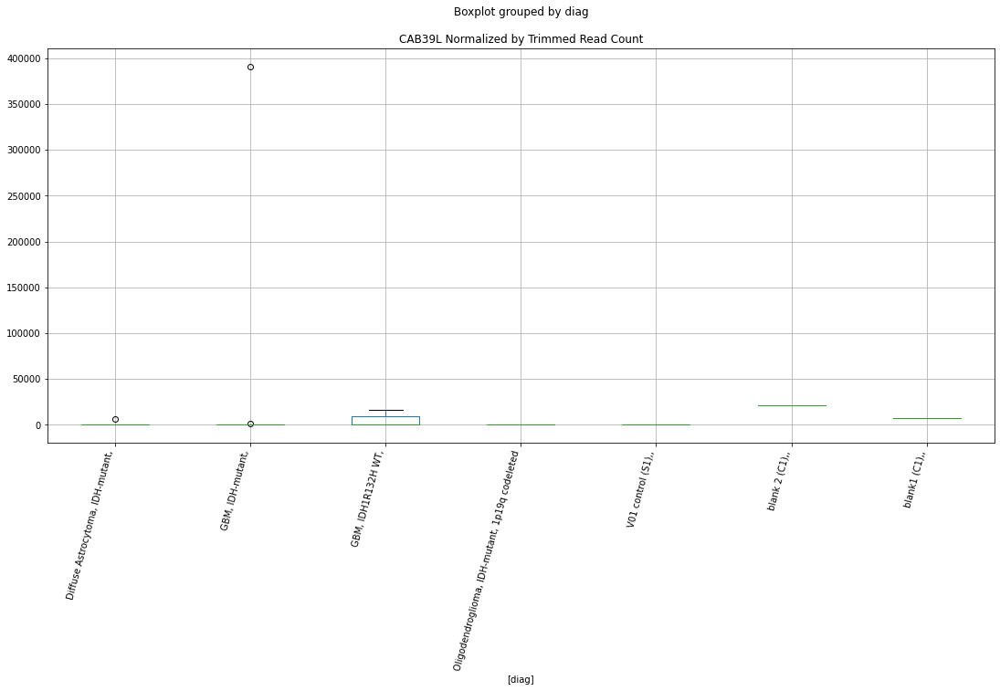

 p : 0.03159881215407995  ( t : 2.330685685736219 ) :  D-plex  :  cutadapt2  :  CCDC14
Control and blanks
76     757.61
340      0.00
Name: CCDC14, dtype: float64
208    3879.92
Name: CCDC14, dtype: float64
472    26008.01
Name: CCDC14, dtype: float64


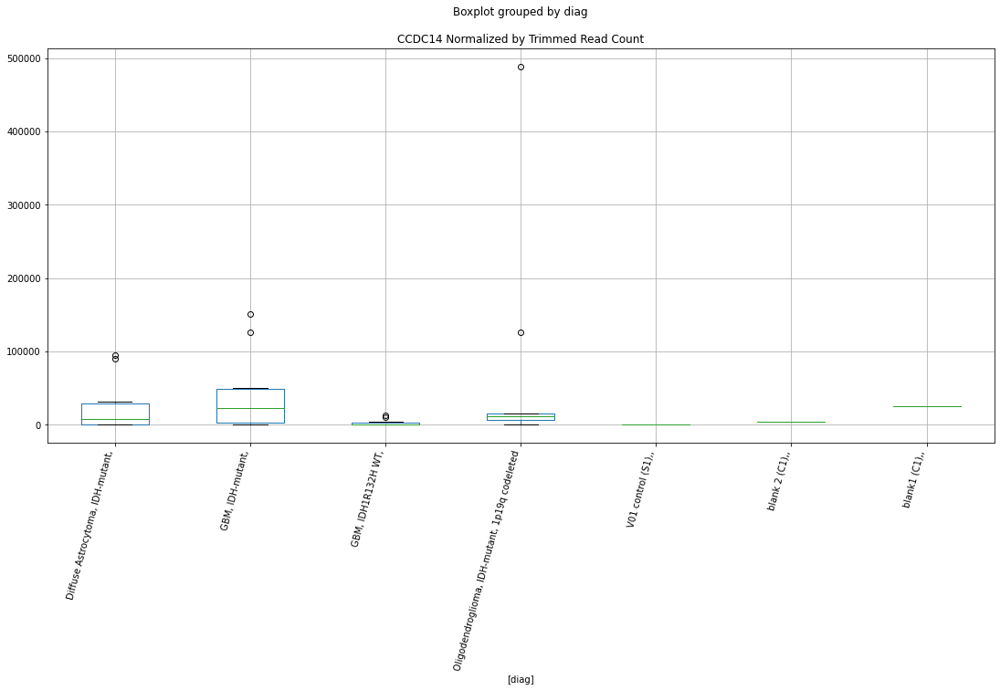

 p : 0.03162266679135874  ( t : 2.3303144701855616 ) :  D-plex  :  bbduk2  :  AOX3P-AOX2P
Control and blanks
73     0.0
337    0.0
Name: AOX3P-AOX2P, dtype: float64
205    1432.73
Name: AOX3P-AOX2P, dtype: float64
469    3549.16
Name: AOX3P-AOX2P, dtype: float64


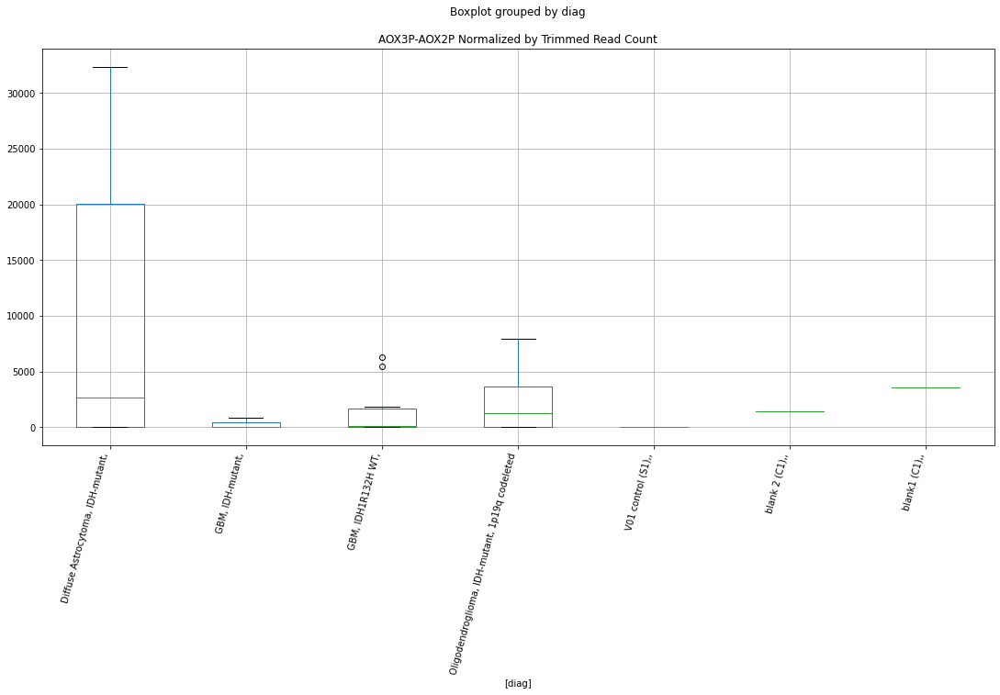

 p : 0.03165421843803929  ( t : 2.3298238767463397 ) :  D-plex  :  cutadapt2  :  CAB39L
Control and blanks
76     0.0
340    0.0
Name: CAB39L, dtype: float64
208    21163.23
Name: CAB39L, dtype: float64
472    6935.47
Name: CAB39L, dtype: float64


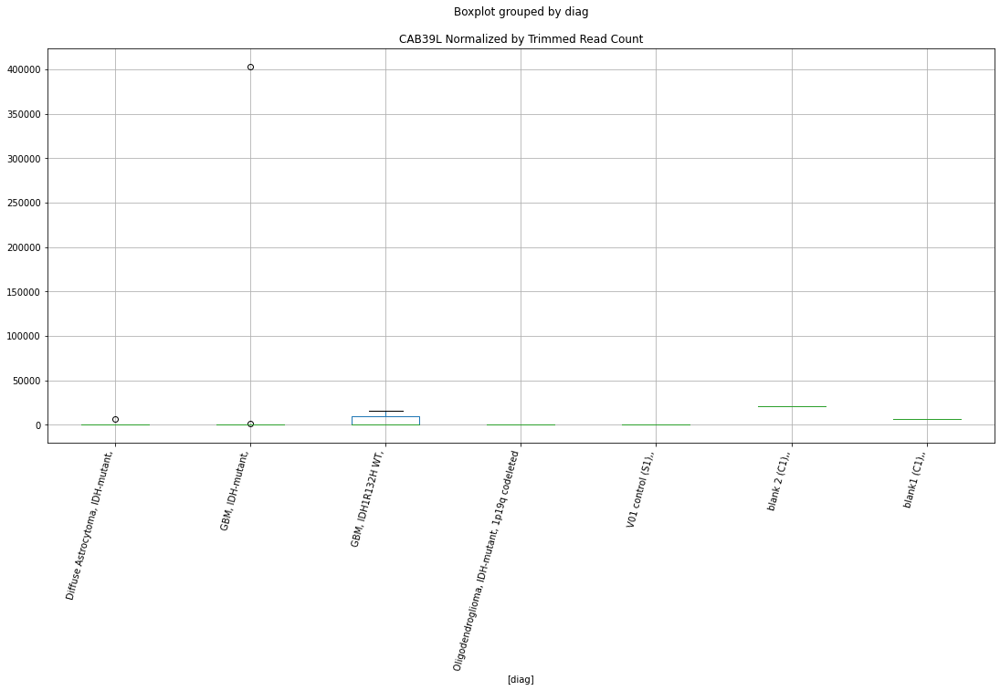

 p : 0.031692858251182295  ( t : 2.329223688923943 ) :  Lexogen  :  cutadapt2  :  ACTN3
Control and blanks
82       0.0
346    631.3
Name: ACTN3, dtype: float64
214    3254.72
Name: ACTN3, dtype: float64
478    0.0
Name: ACTN3, dtype: float64


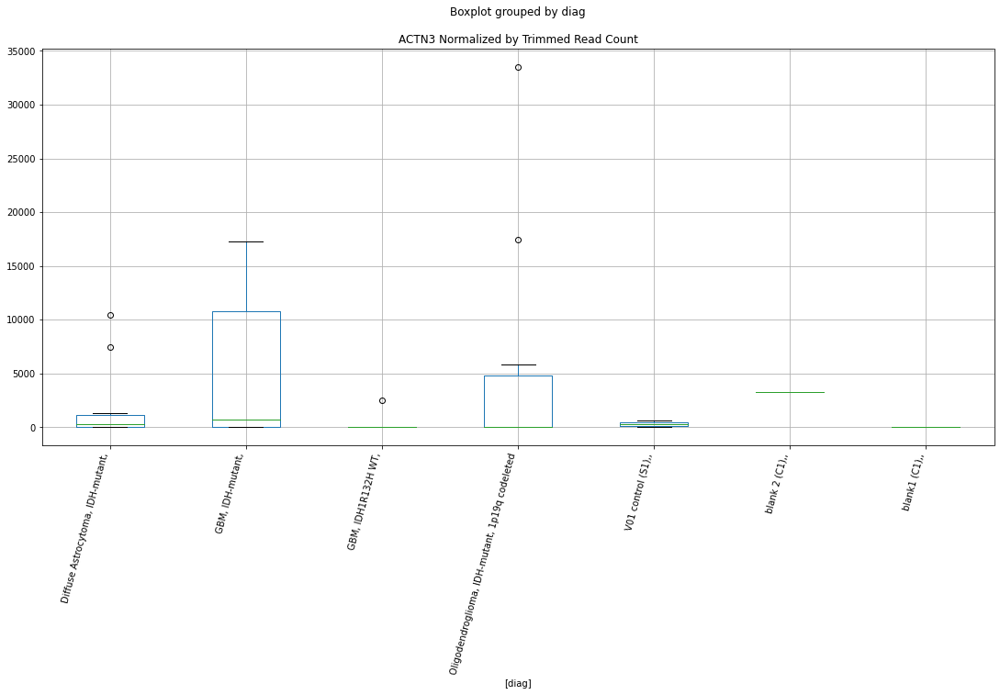

 p : 0.031699046991731705  ( t : 2.329127623120113 ) :  D-plex  :  bbduk2  :  BAD
Control and blanks
73     0.0
337    0.0
Name: BAD, dtype: float64
205    1790.91
Name: BAD, dtype: float64
469    0.0
Name: BAD, dtype: float64


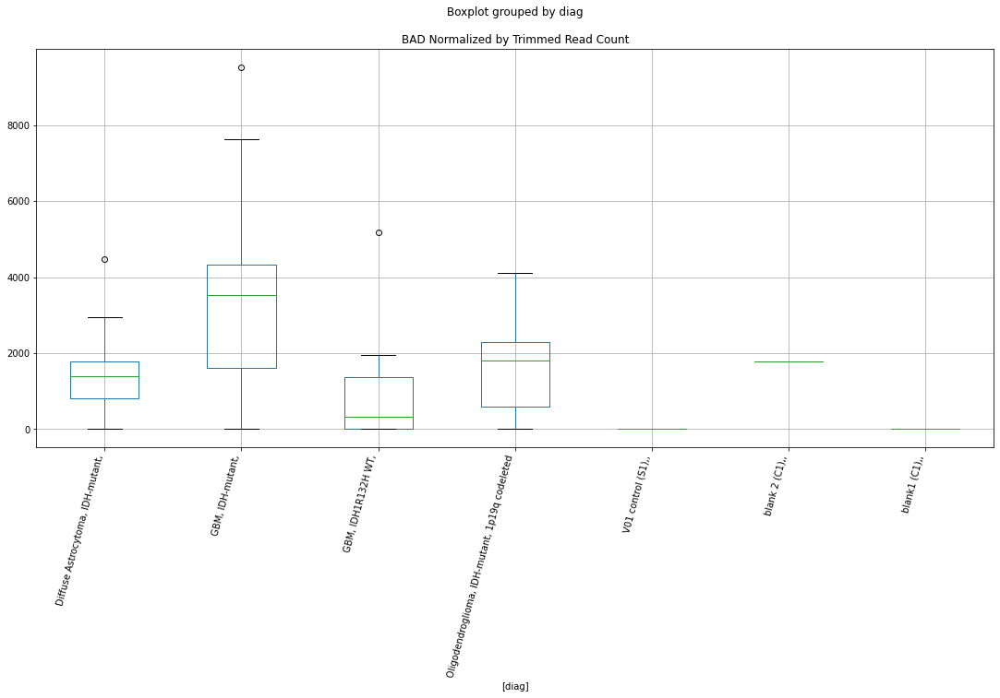

 p : 0.03172558319842078  ( t : 2.3287159077549666 ) :  D-plex  :  cutadapt2  :  ANKRD13B
Control and blanks
76         0.00
340    21137.57
Name: ANKRD13B, dtype: float64
208    16930.58
Name: ANKRD13B, dtype: float64
472    0.0
Name: ANKRD13B, dtype: float64


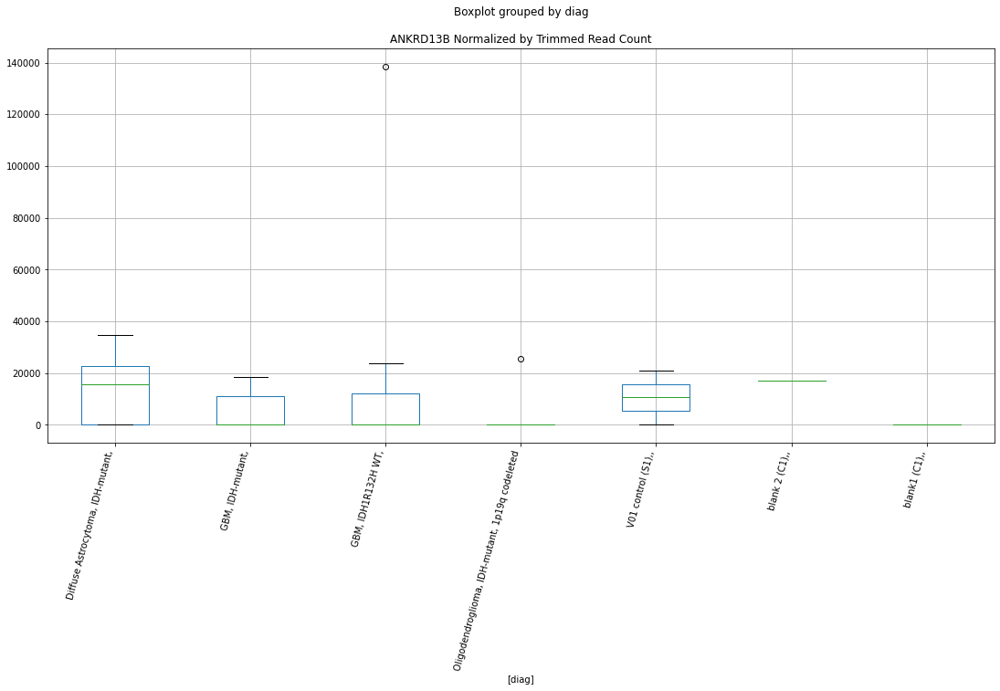

 p : 0.03182420159742338  ( t : 2.327188620408167 ) :  D-plex  :  cutadapt2  :  CHDH
Control and blanks
76     356836.29
340         0.00
Name: CHDH, dtype: float64
208    54495.31
Name: CHDH, dtype: float64
472    13870.94
Name: CHDH, dtype: float64


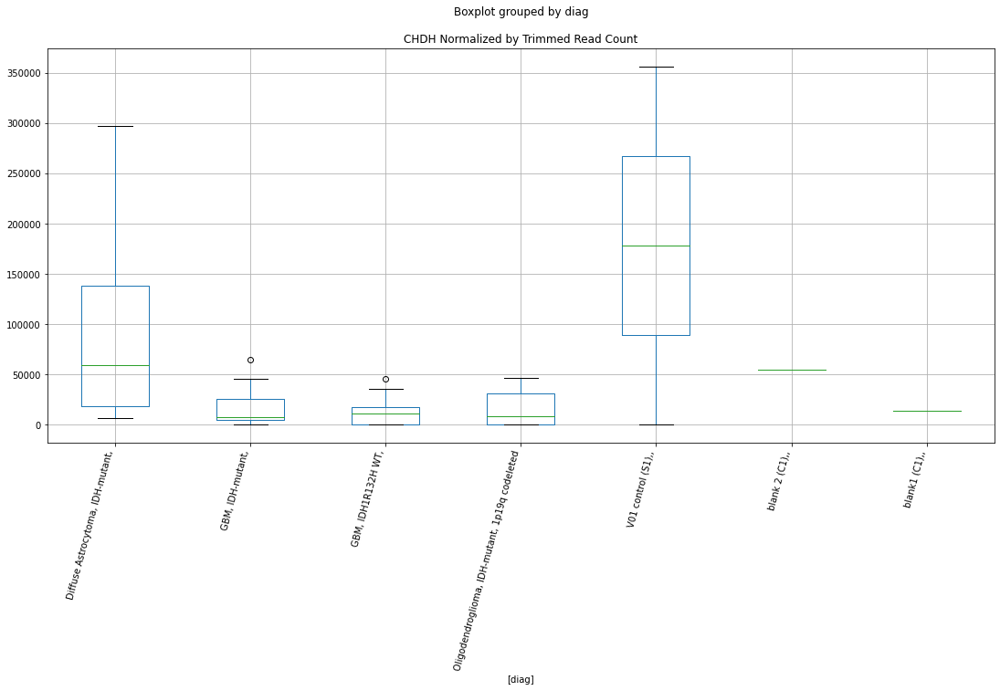

 p : 0.03187012516296019  ( t : 2.32647890996041 ) :  D-plex  :  cutadapt2  :  DENND2D
Control and blanks
76     0.0
340    0.0
Name: DENND2D, dtype: float64
208    2821.76
Name: DENND2D, dtype: float64
472    0.0
Name: DENND2D, dtype: float64


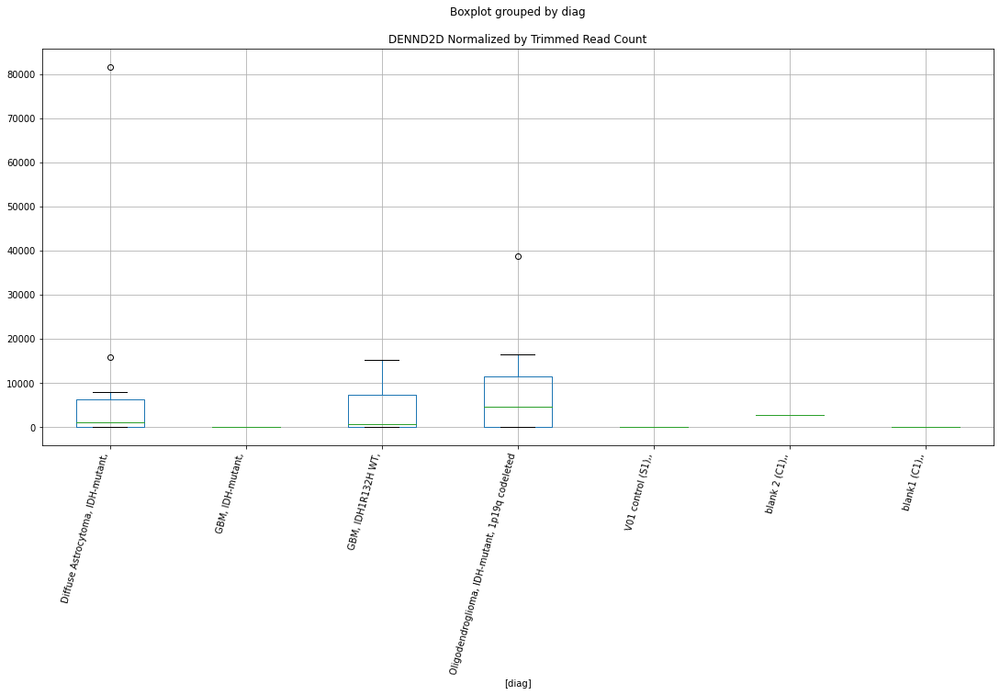

 p : 0.0318815339280778  ( t : 2.3263027443775623 ) :  Lexogen  :  bbduk2  :  ARAF
Control and blanks
79     0.0
343    0.0
Name: ARAF, dtype: float64
211    0.0
Name: ARAF, dtype: float64
475    0.0
Name: ARAF, dtype: float64


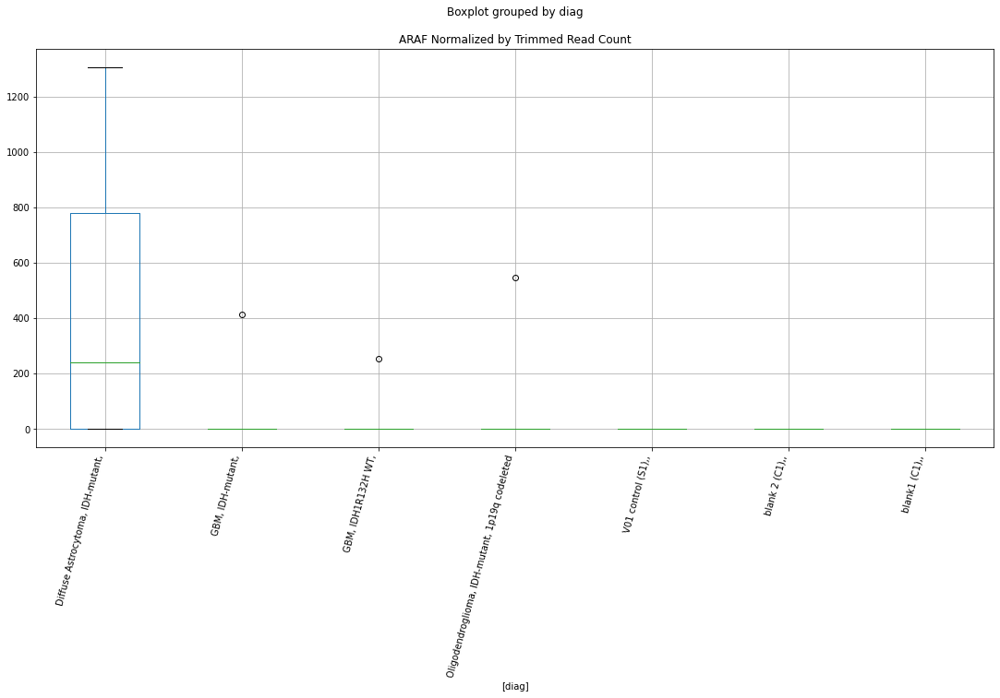

 p : 0.0318828606872402  ( t : 2.3262822613615532 ) :  D-plex  :  cutadapt2  :  CXorf40A
Control and blanks
76     0.0
340    0.0
Name: CXorf40A, dtype: float64
208    2116.32
Name: CXorf40A, dtype: float64
472    6935.47
Name: CXorf40A, dtype: float64


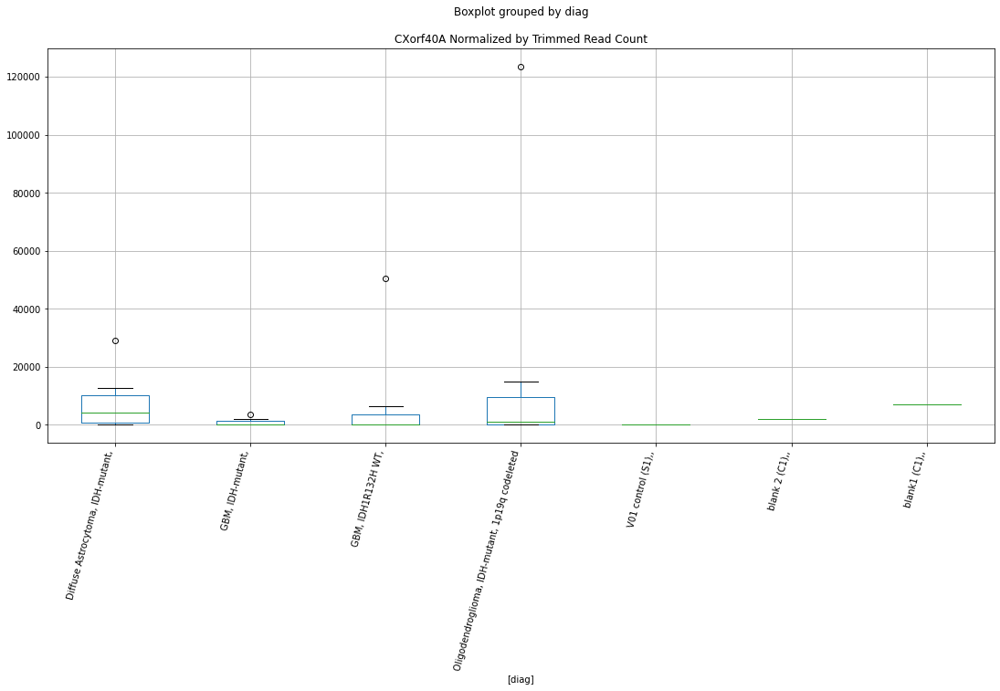

 p : 0.03188353610439056  ( t : 2.3262718343171898 ) :  D-plex  :  cutadapt2  :  ARFIP2
Control and blanks
76     0.0
340    0.0
Name: ARFIP2, dtype: float64
208    6525.33
Name: ARFIP2, dtype: float64
472    21962.32
Name: ARFIP2, dtype: float64


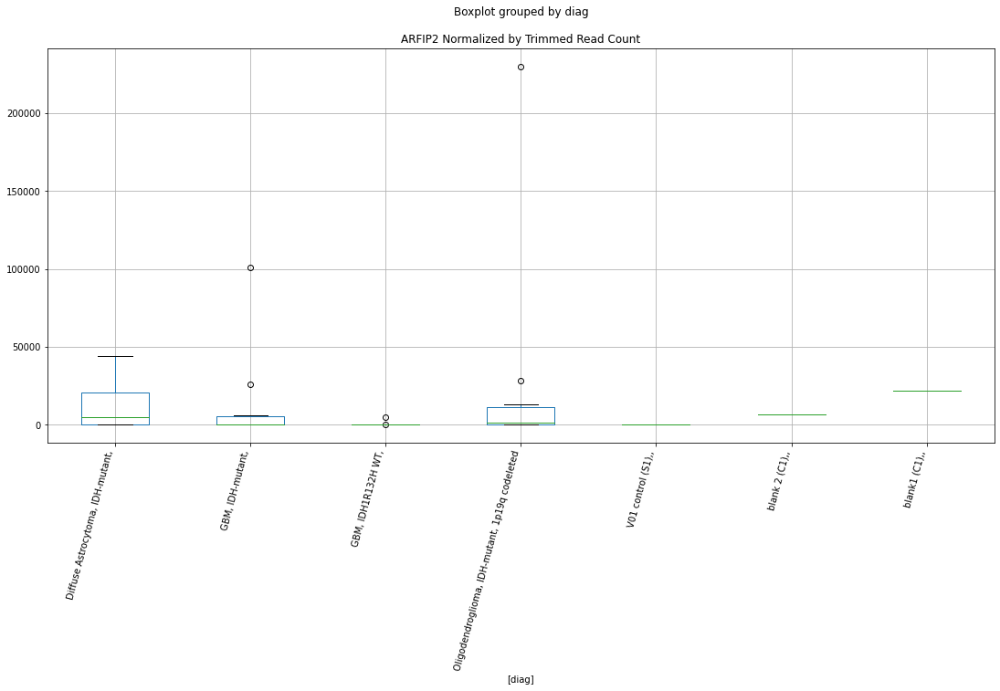

 p : 0.03190129611583722  ( t : 2.325997730091758 ) :  Lexogen  :  bbduk2  :  BASP1
Control and blanks
79       0.00
343    424.63
Name: BASP1, dtype: float64
211    0.0
Name: BASP1, dtype: float64
475    12933.85
Name: BASP1, dtype: float64


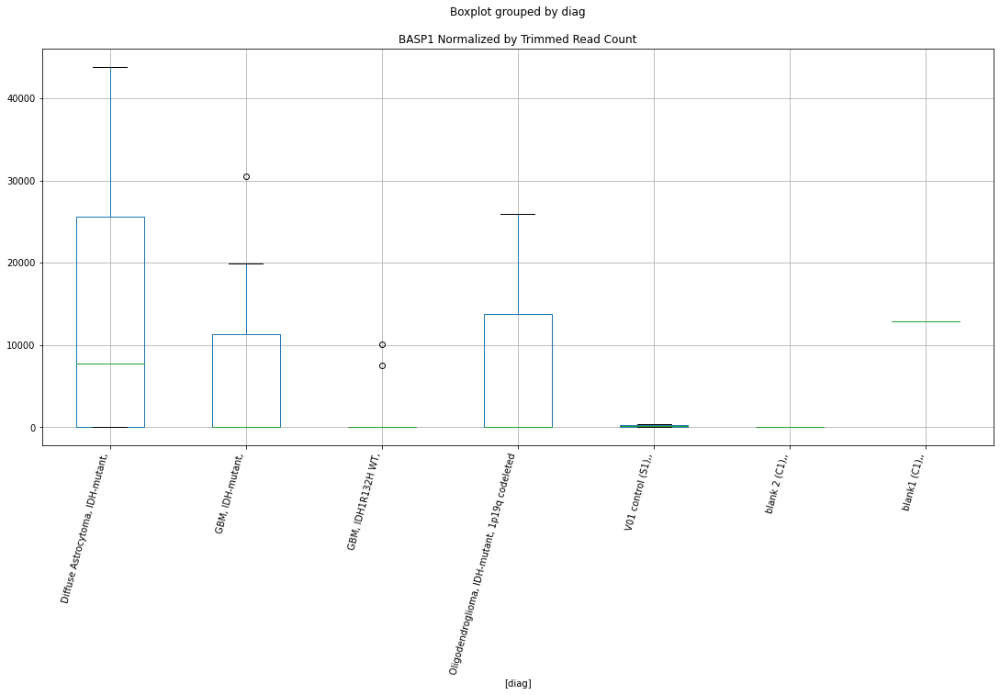

 p : 0.031930003465373336  ( t : 2.325554966689472 ) :  D-plex  :  cutadapt2  :  ATF4
Control and blanks
76     0.0
340    0.0
Name: ATF4, dtype: float64
208    1058.16
Name: ATF4, dtype: float64
472    577.96
Name: ATF4, dtype: float64


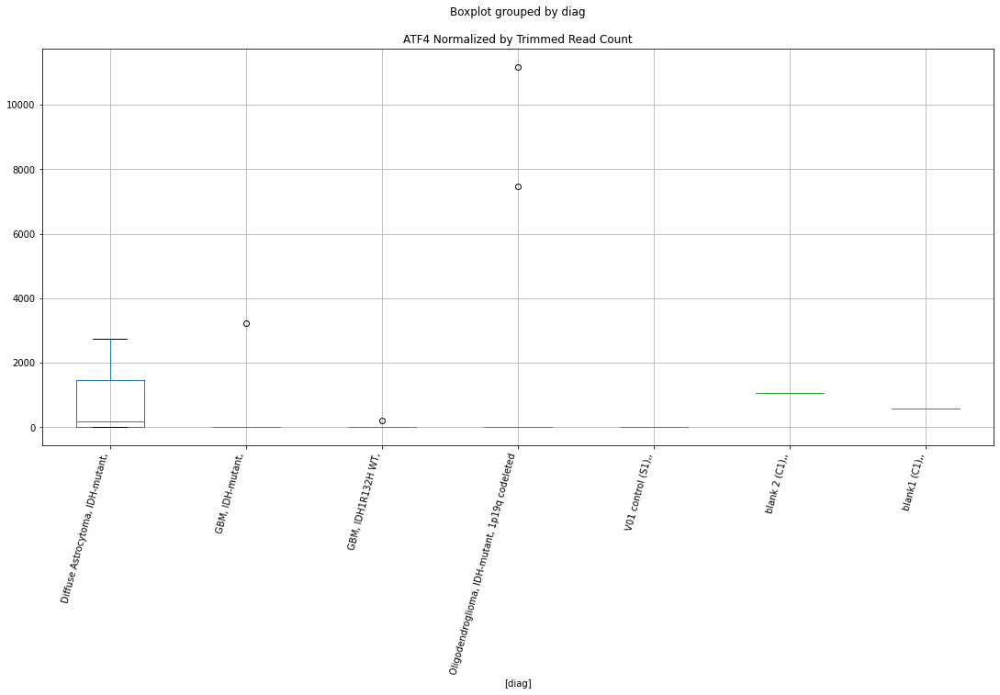

 p : 0.03196598107205221  ( t : 2.3250005935632116 ) :  D-plex  :  cutadapt2  :  AFAP1L2
Control and blanks
76     0.0
340    0.0
Name: AFAP1L2, dtype: float64
208    4056.29
Name: AFAP1L2, dtype: float64
472    51438.07
Name: AFAP1L2, dtype: float64


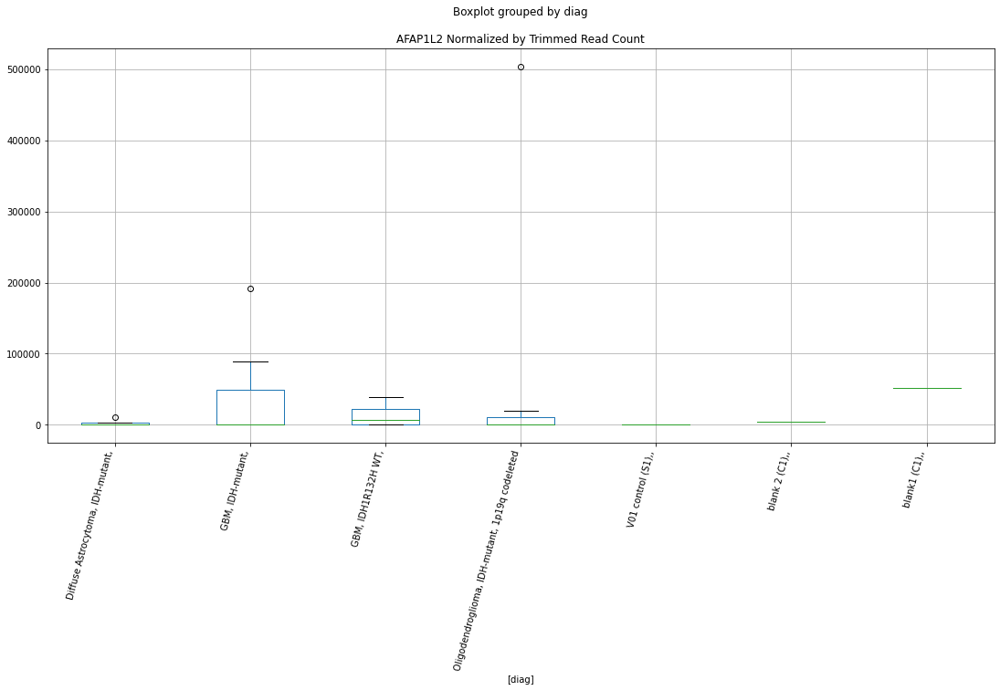

 p : 0.03200149751354881  ( t : 2.3244538948062488 ) :  D-plex  :  bbduk2  :  ADAM8
Control and blanks
73     0.0
337    0.0
Name: ADAM8, dtype: float64
205    1611.82
Name: ADAM8, dtype: float64
469    13013.6
Name: ADAM8, dtype: float64


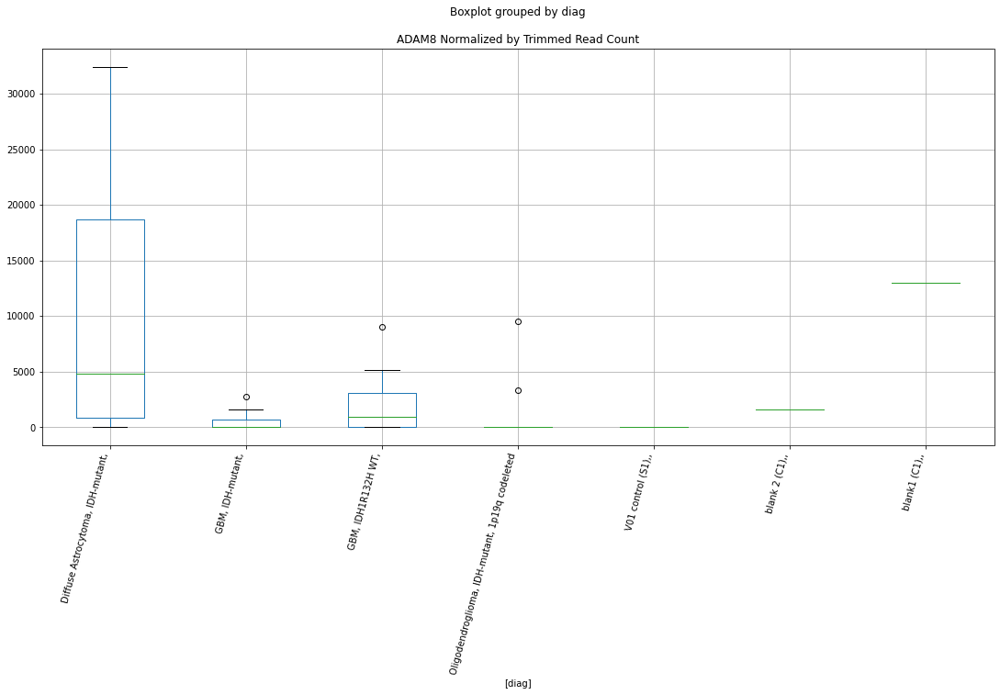

 p : 0.03205718662550664  ( t : 2.3235978153371755 ) :  D-plex  :  bbduk2  :  ADGRE1
Control and blanks
73     0.0
337    0.0
Name: ADGRE1, dtype: float64
205    4298.18
Name: ADGRE1, dtype: float64
469    31942.48
Name: ADGRE1, dtype: float64


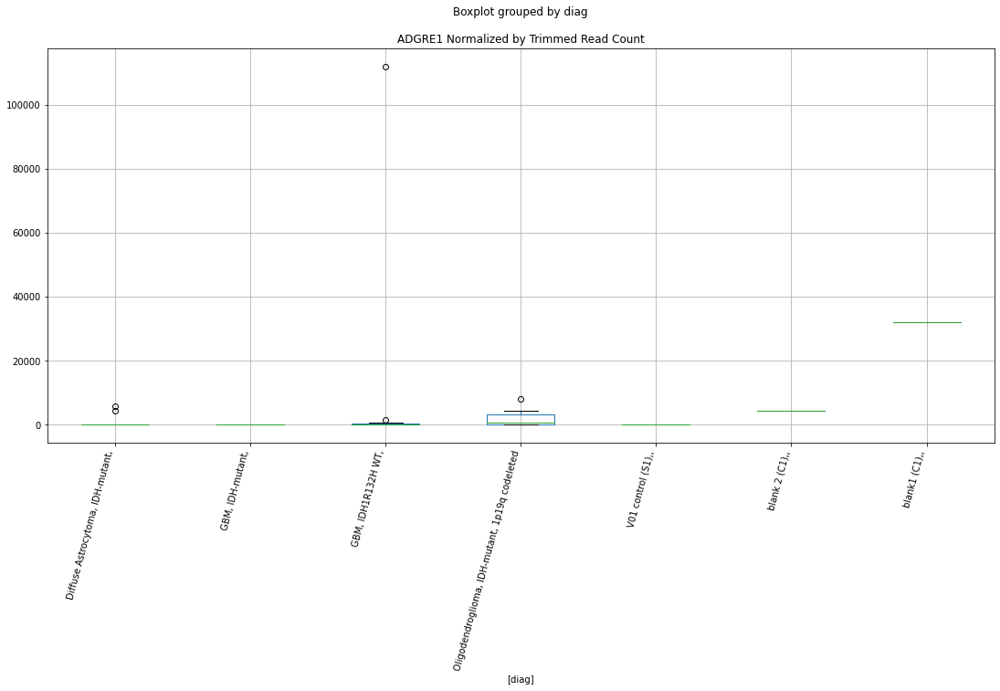

 p : 0.03210493711609158  ( t : 2.322864871655681 ) :  D-plex  :  cutadapt2  :  ATP6V1H
Control and blanks
76     0.0
340    0.0
Name: ATP6V1H, dtype: float64
208    881.8
Name: ATP6V1H, dtype: float64
472    0.0
Name: ATP6V1H, dtype: float64


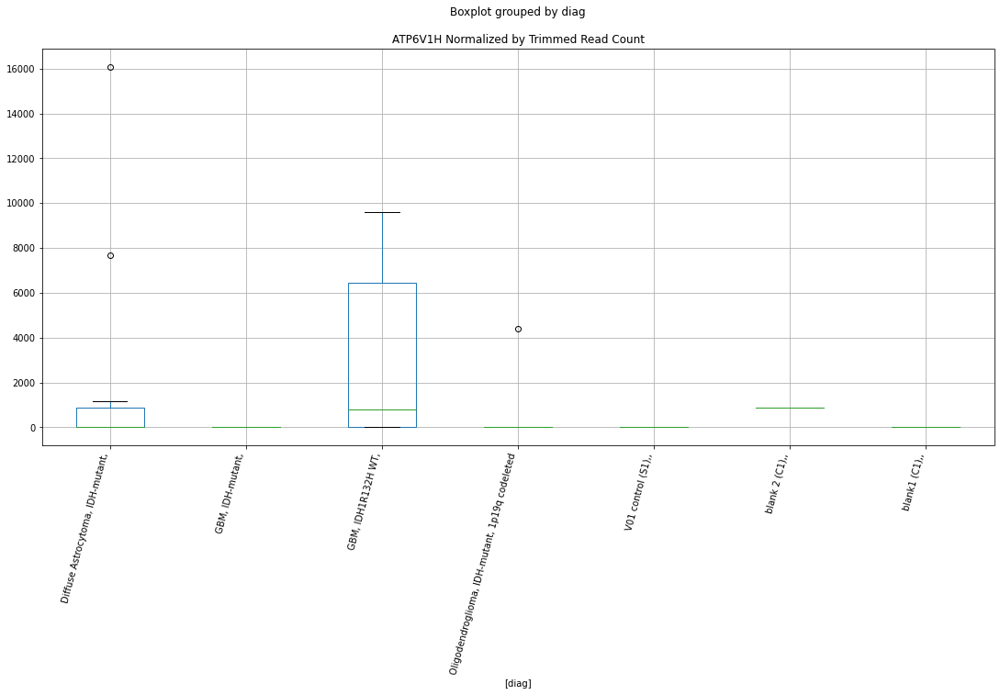

 p : 0.03214223046575259  ( t : 2.32229314330336 ) :  D-plex  :  bbduk2  :  CHDH
Control and blanks
73     347853.78
337         0.00
Name: CHDH, dtype: float64
205    57130.01
Name: CHDH, dtype: float64
469    14196.66
Name: CHDH, dtype: float64


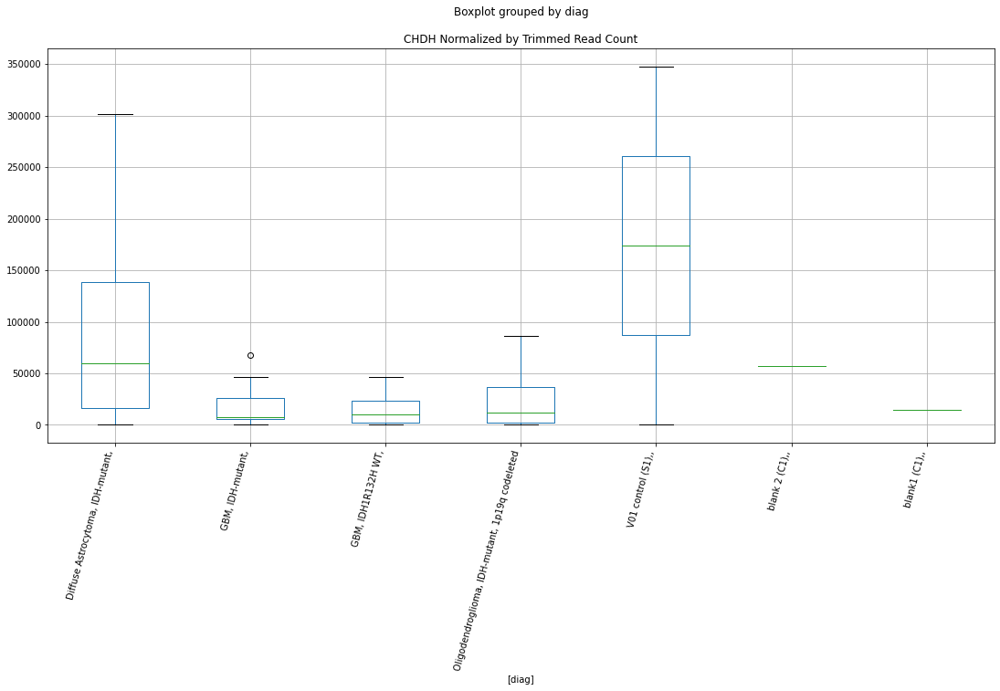

 p : 0.03225141967967139  ( t : 2.3206227464354083 ) :  D-plex  :  cutadapt2  :  C9orf47
Control and blanks
76     0.0
340    0.0
Name: C9orf47, dtype: float64
208    2469.04
Name: C9orf47, dtype: float64
472    2311.82
Name: C9orf47, dtype: float64


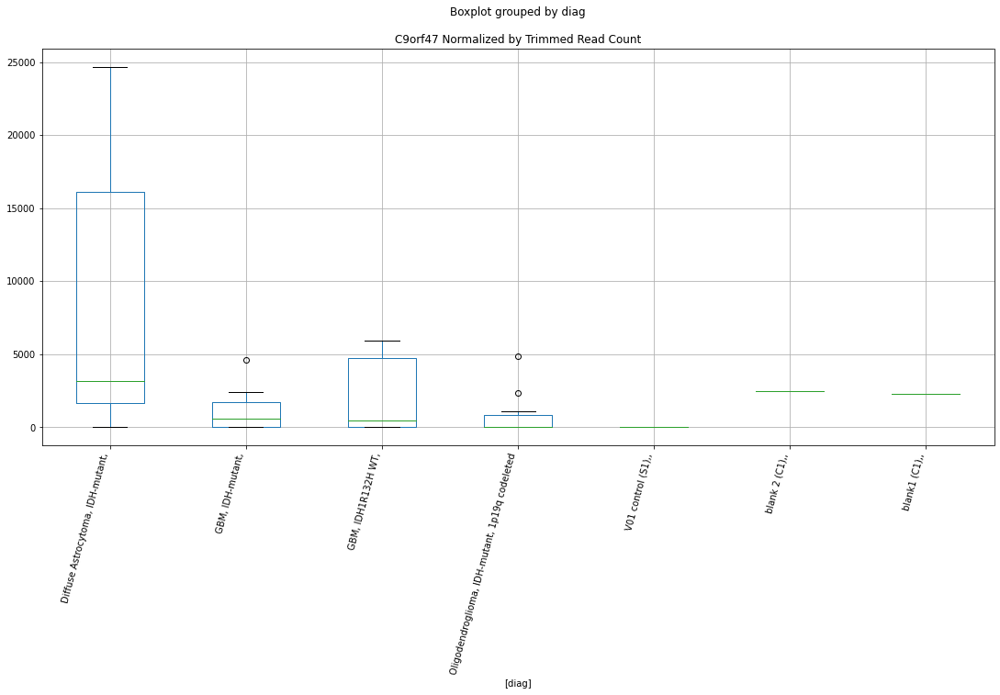

 p : 0.03232727834444182  ( t : 2.3194653359656634 ) :  D-plex  :  bbduk2  :  CCDC102A
Control and blanks
73     0.0
337    0.0
Name: CCDC102A, dtype: float64
205    2865.46
Name: CCDC102A, dtype: float64
469    2366.11
Name: CCDC102A, dtype: float64


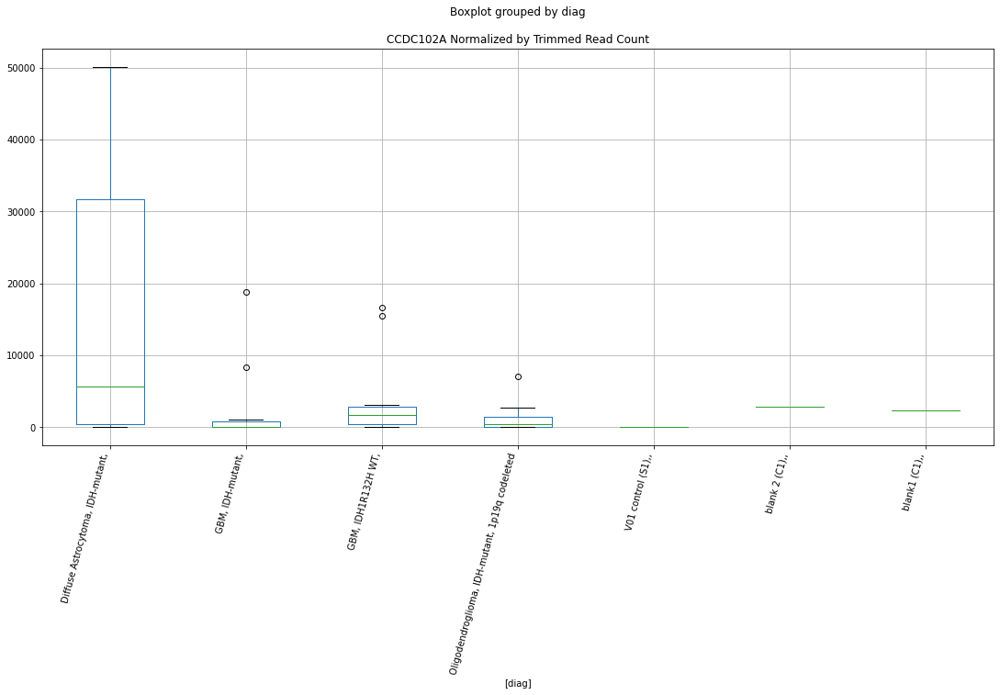

 p : 0.032329687200459443  ( t : 2.3194286242795505 ) :  D-plex  :  cutadapt2  :  CDK16
Control and blanks
76     13637.06
340        0.00
Name: CDK16, dtype: float64
208    12697.94
Name: CDK16, dtype: float64
472    0.0
Name: CDK16, dtype: float64


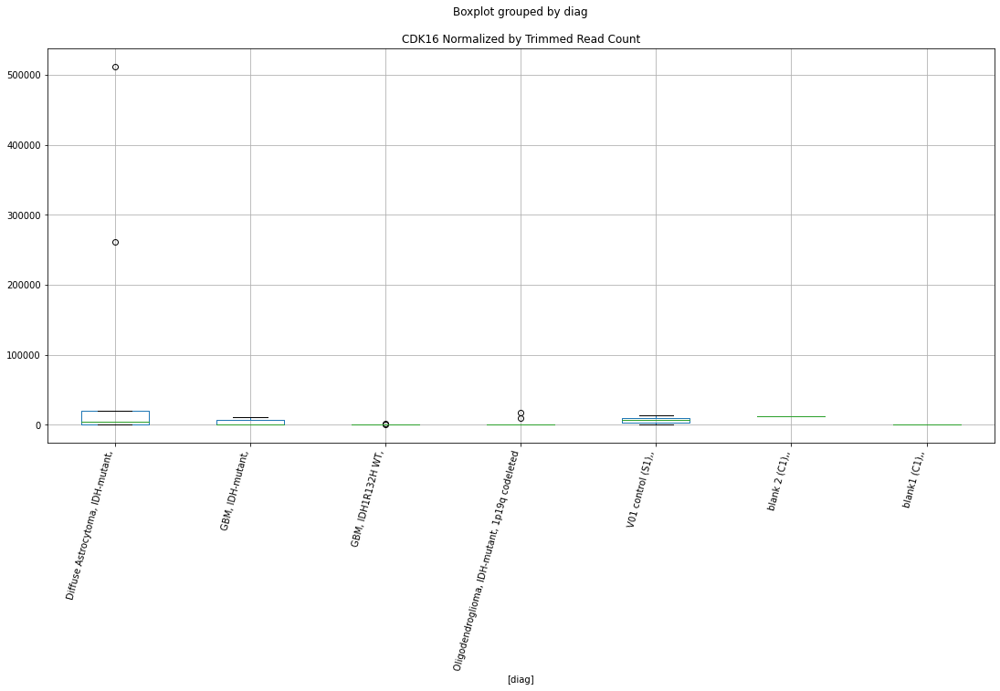

 p : 0.03234437654894542  ( t : 2.3192048091780384 ) :  D-plex  :  bbduk2  :  B4GALT6
Control and blanks
73         0.00
337    10681.89
Name: B4GALT6, dtype: float64
205    1970.0
Name: B4GALT6, dtype: float64
469    4140.69
Name: B4GALT6, dtype: float64


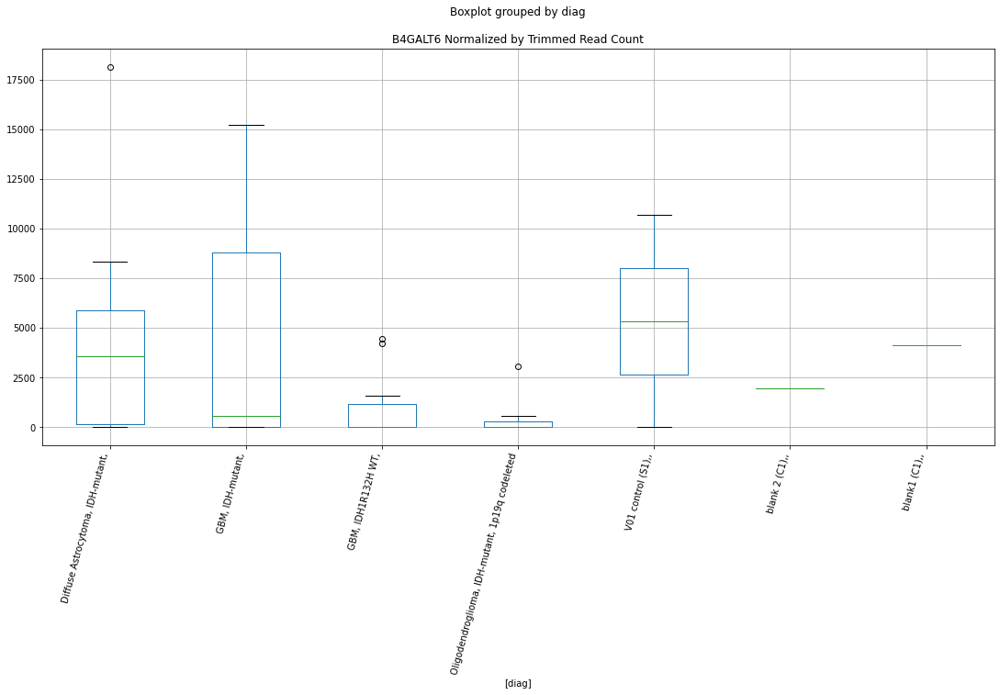

 p : 0.03235396743581702  ( t : 2.319058728011449 ) :  D-plex  :  cutadapt2  :  ADAM8
Control and blanks
76     0.0
340    0.0
Name: ADAM8, dtype: float64
208    1587.24
Name: ADAM8, dtype: float64
472    12715.03
Name: ADAM8, dtype: float64


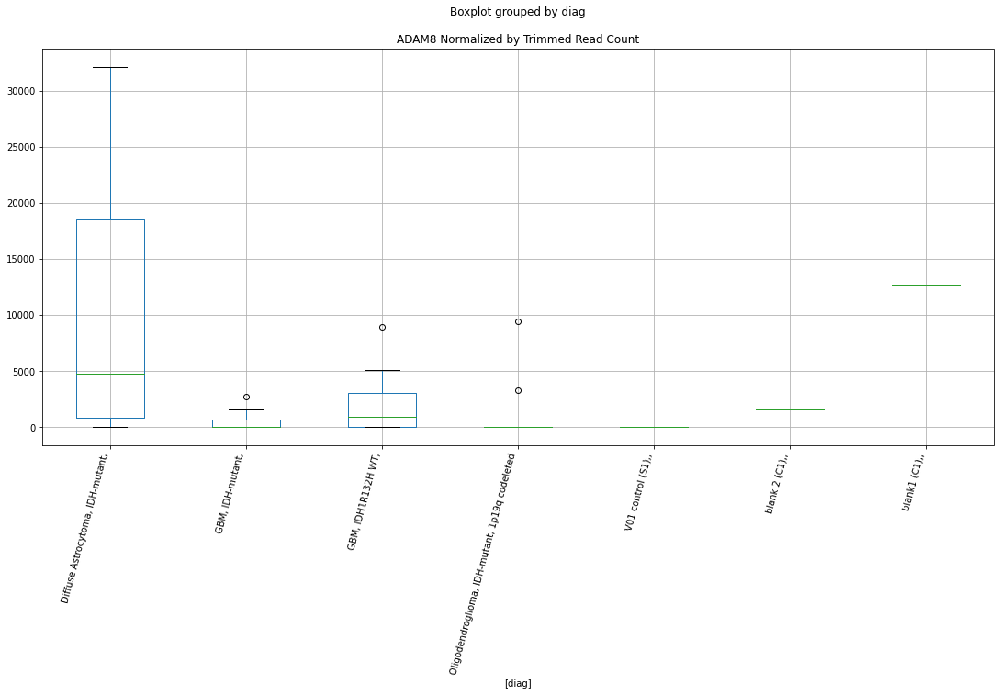

 p : 0.03237982493478148  ( t : 2.318665086329818 ) :  D-plex  :  cutadapt2  :  C1orf174
Control and blanks
76     3030.46
340       0.00
Name: C1orf174, dtype: float64
208    1587.24
Name: C1orf174, dtype: float64
472    0.0
Name: C1orf174, dtype: float64


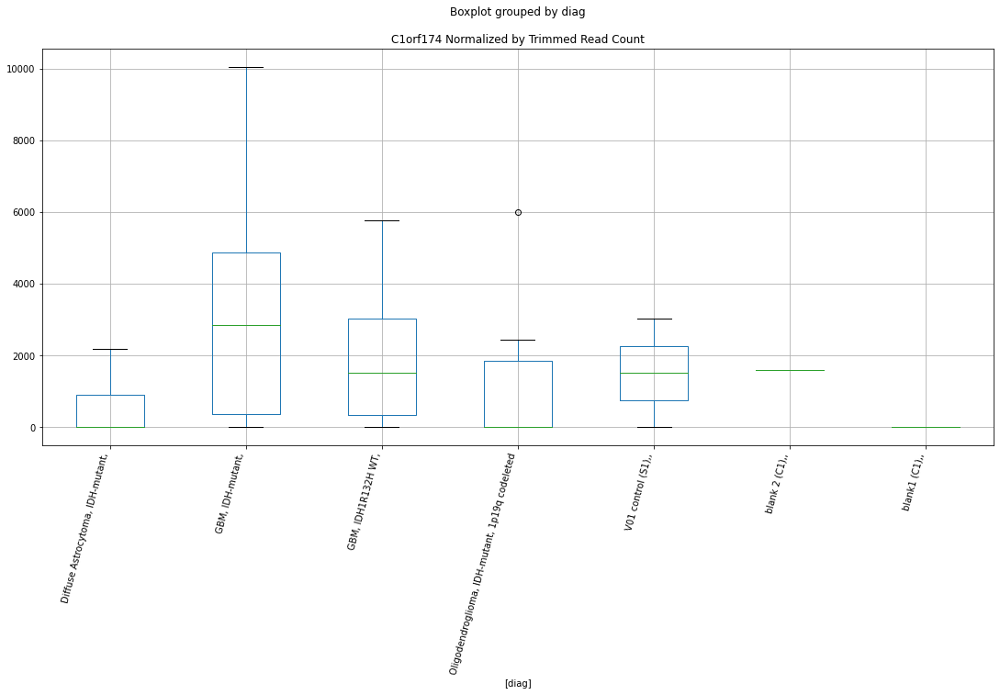

 p : 0.032381842243934325  ( t : 2.3186343880972418 ) :  D-plex  :  cutadapt2  :  BRINP2
Control and blanks
76     0.0
340    0.0
Name: BRINP2, dtype: float64
208    3350.84
Name: BRINP2, dtype: float64
472    0.0
Name: BRINP2, dtype: float64


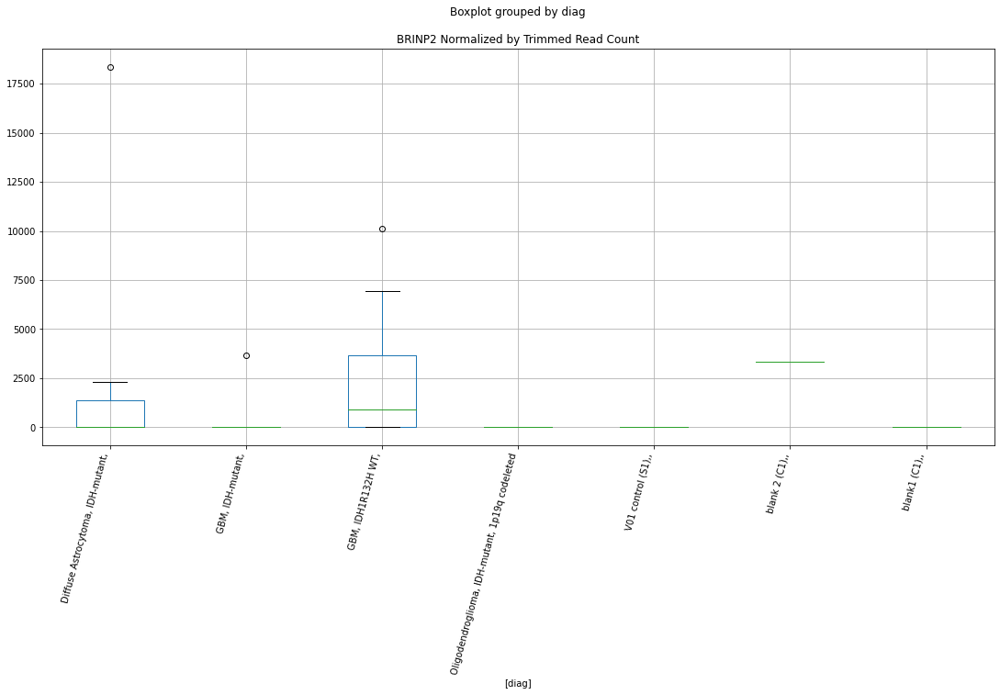

 p : 0.032397493217369414  ( t : 2.318396281043051 ) :  D-plex  :  cutadapt2  :  ARL17B
Control and blanks
76     0.0
340    0.0
Name: ARL17B, dtype: float64
208    0.0
Name: ARL17B, dtype: float64
472    577.96
Name: ARL17B, dtype: float64


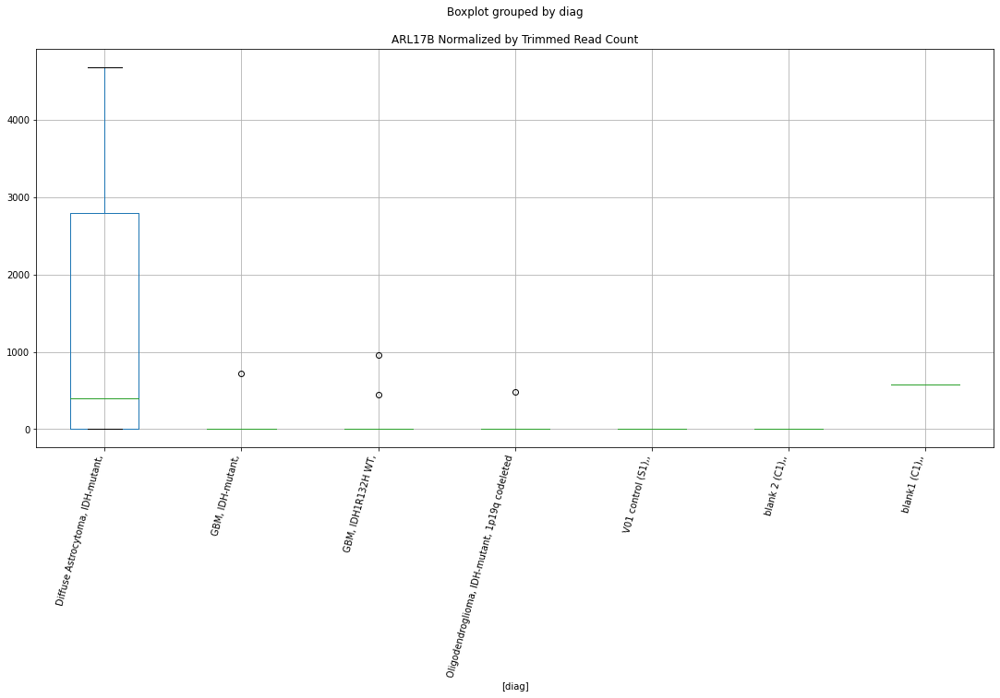

 p : 0.032433564681816136  ( t : 2.3178479121113207 ) :  D-plex  :  bbduk2  :  AACSP1
Control and blanks
73     3092.03
337       0.00
Name: AACSP1, dtype: float64
205    358.18
Name: AACSP1, dtype: float64
469    591.53
Name: AACSP1, dtype: float64


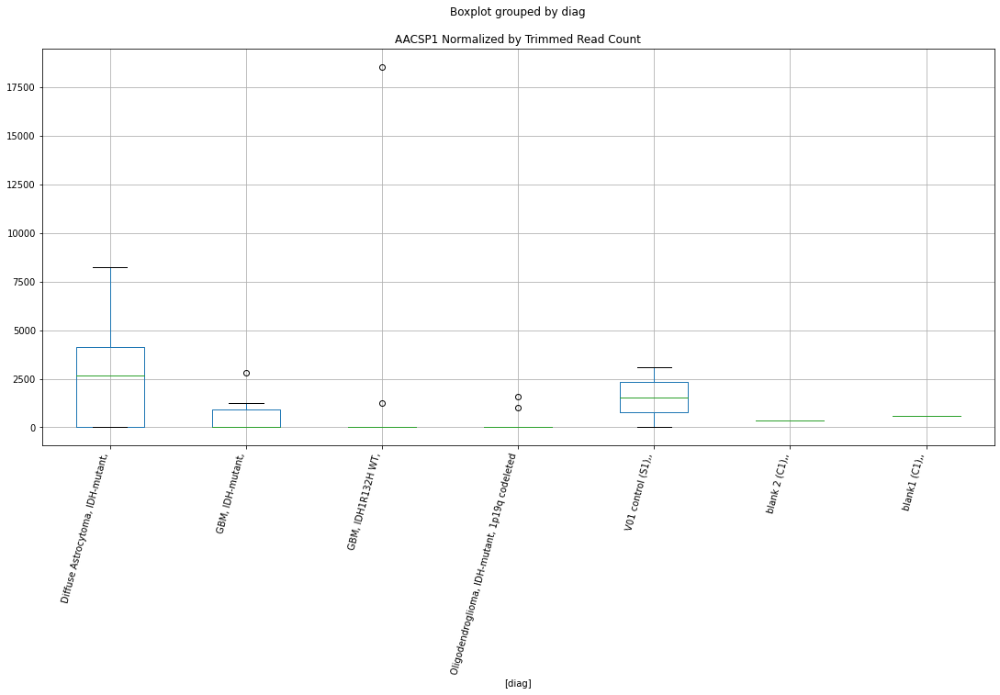

 p : 0.032461823335770176  ( t : 2.3174187112712006 ) :  Lexogen  :  bbduk2  :  ACTN3
Control and blanks
79       0.00
343    636.94
Name: ACTN3, dtype: float64
211    3279.68
Name: ACTN3, dtype: float64
475    0.0
Name: ACTN3, dtype: float64


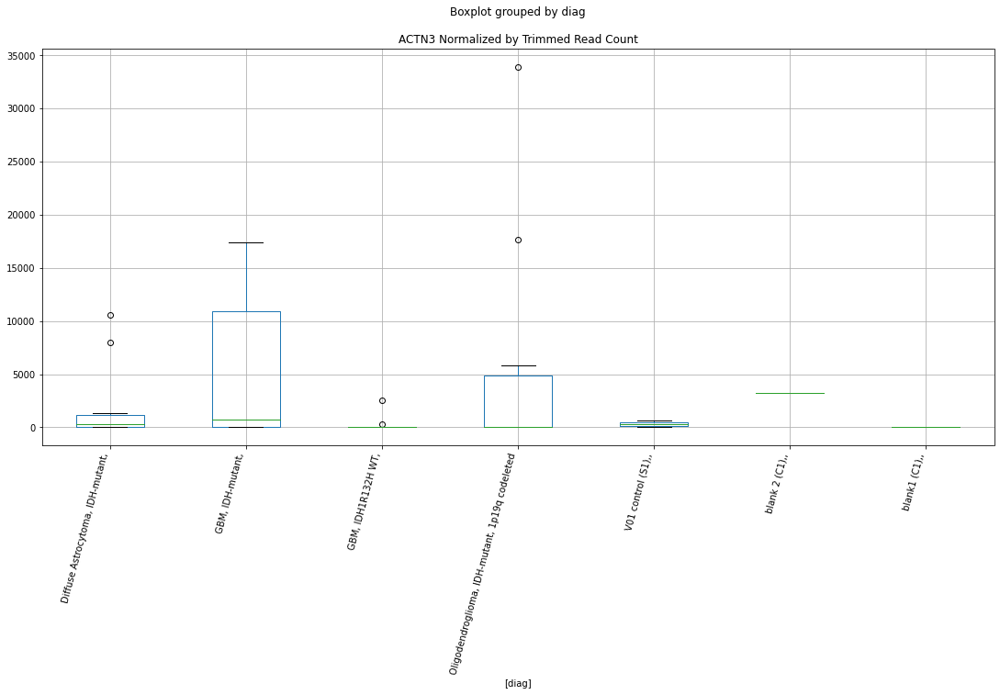

 p : 0.03252263496301424  ( t : 2.316496261527876 ) :  D-plex  :  bbduk2  :  DDX60
Control and blanks
73     0.0
337    0.0
Name: DDX60, dtype: float64
205    3044.55
Name: DDX60, dtype: float64
469    4140.69
Name: DDX60, dtype: float64


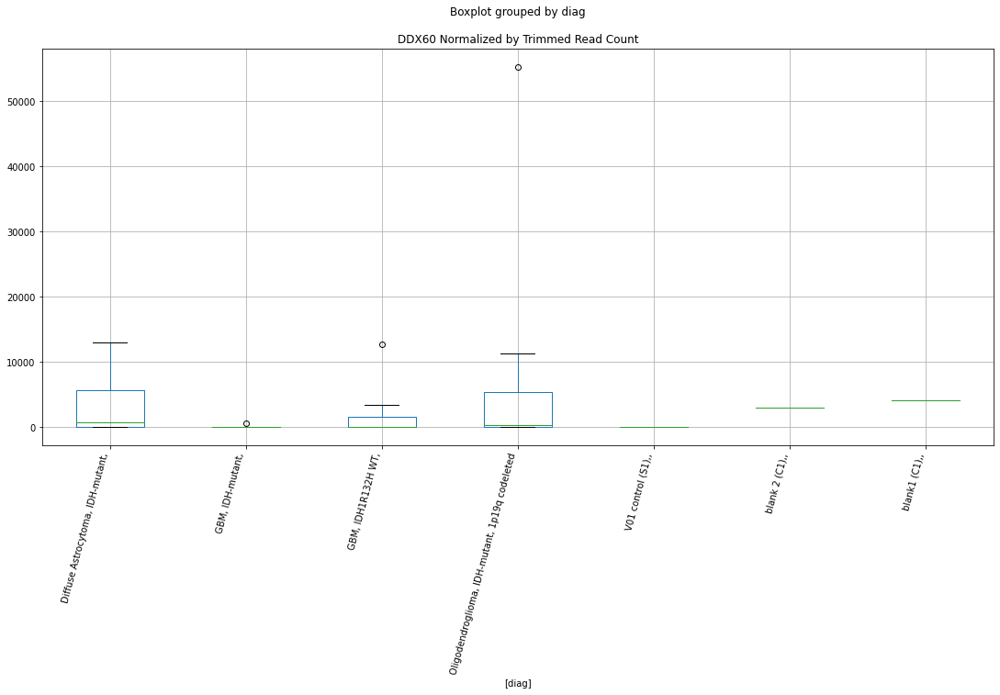

 p : 0.032576570767460254  ( t : 2.315679450014259 ) :  D-plex  :  cutadapt2  :  BAG2
Control and blanks
76     0.0
340    0.0
Name: BAG2, dtype: float64
208    1234.52
Name: BAG2, dtype: float64
472    0.0
Name: BAG2, dtype: float64


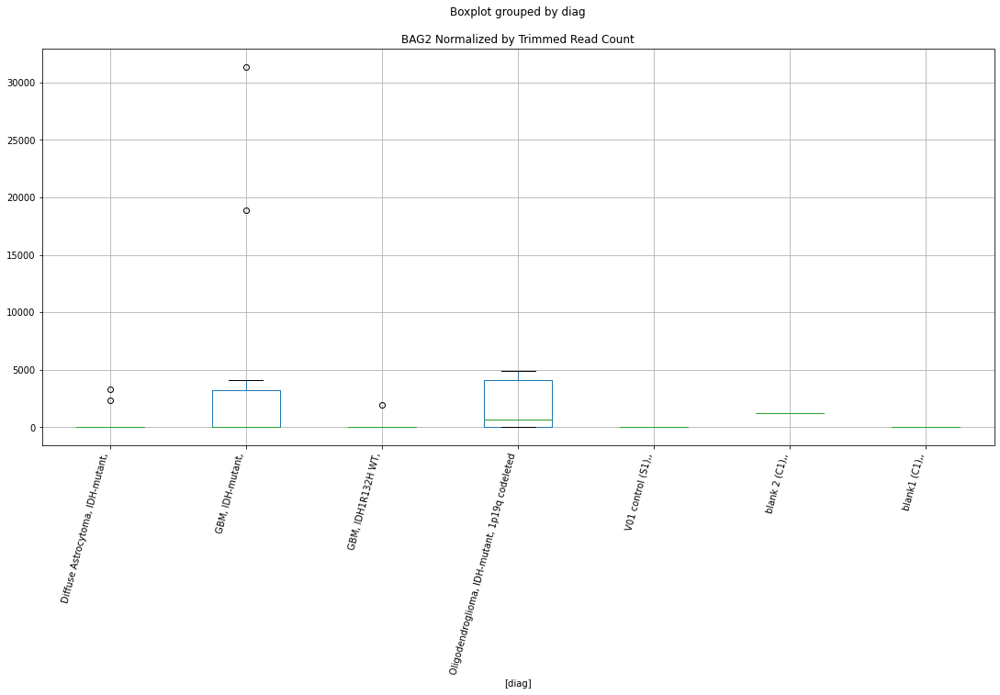

 p : 0.03266580814041279  ( t : 2.3143307795162236 ) :  D-plex  :  bbduk2  :  ATF4
Control and blanks
73     0.0
337    0.0
Name: ATF4, dtype: float64
205    1253.64
Name: ATF4, dtype: float64
469    591.53
Name: ATF4, dtype: float64


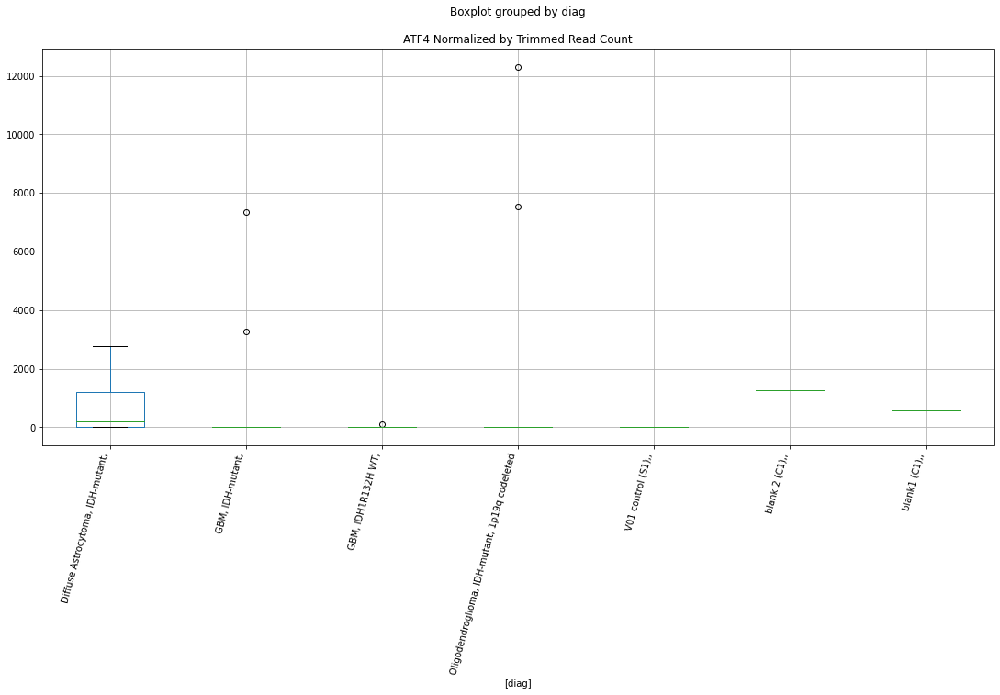

 p : 0.032669676389297006  ( t : 2.3142723949153554 ) :  D-plex  :  bbduk2  :  CERT1
Control and blanks
73        0.00
337    4450.79
Name: CERT1, dtype: float64
205    16118.19
Name: CERT1, dtype: float64
469    28393.31
Name: CERT1, dtype: float64


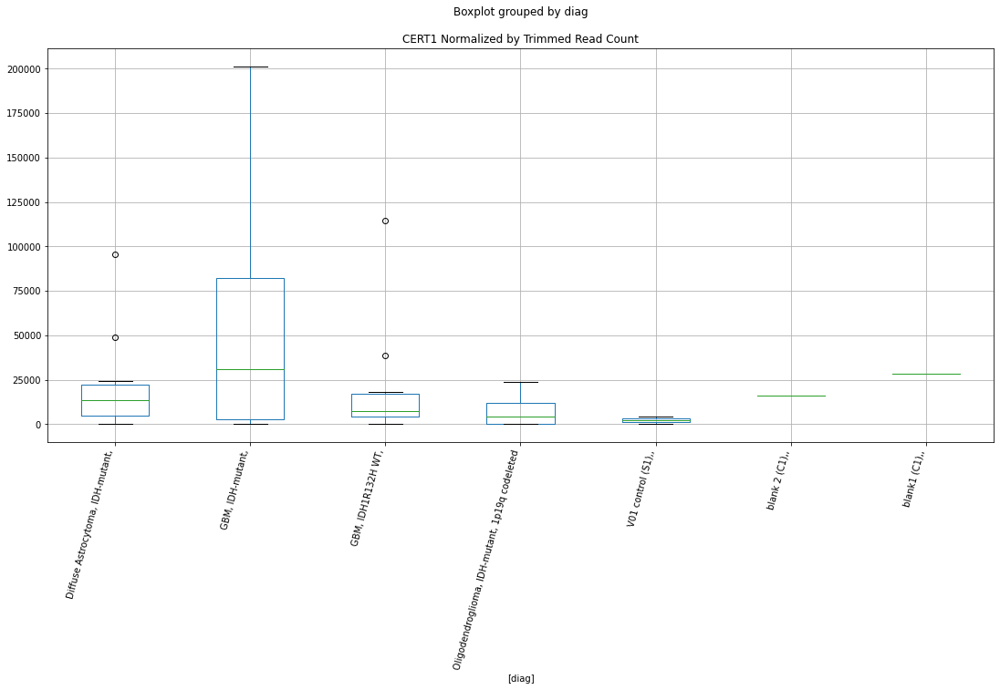

 p : 0.03267157980978821  ( t : 2.3142436683942225 ) :  D-plex  :  bbduk2  :  CD3D
Control and blanks
73       0.00
337    890.16
Name: CD3D, dtype: float64
205    6984.55
Name: CD3D, dtype: float64
469    150247.94
Name: CD3D, dtype: float64


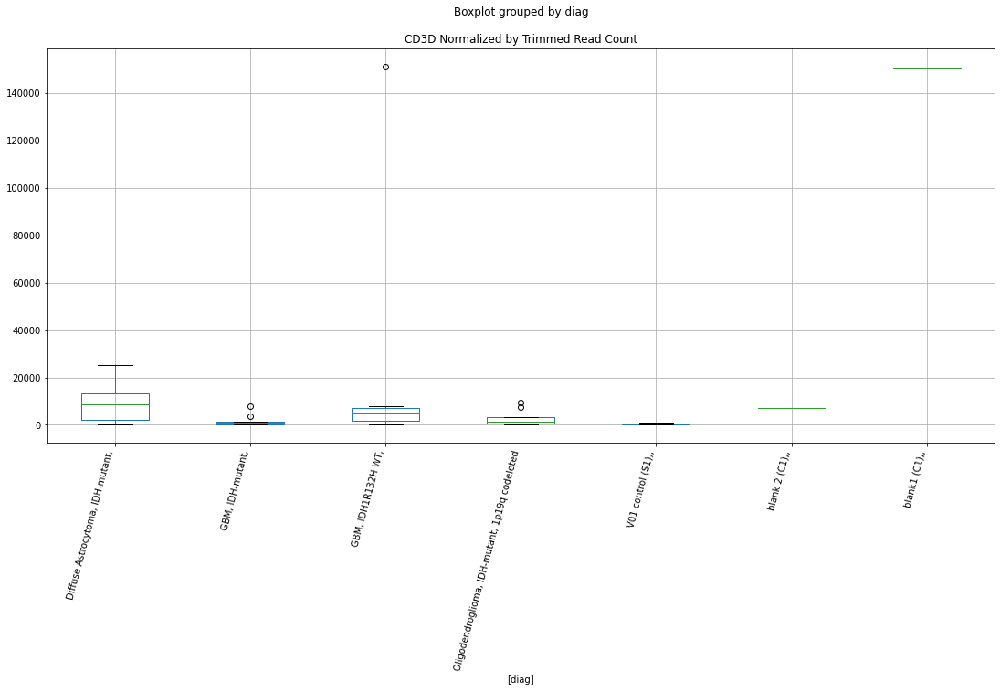

 p : 0.032674005436158456  ( t : 2.314207062966033 ) :  D-plex  :  bbduk2  :  CFH
Control and blanks
73     142233.55
337      3560.63
Name: CFH, dtype: float64
205    9312.73
Name: CFH, dtype: float64
469    955908.15
Name: CFH, dtype: float64


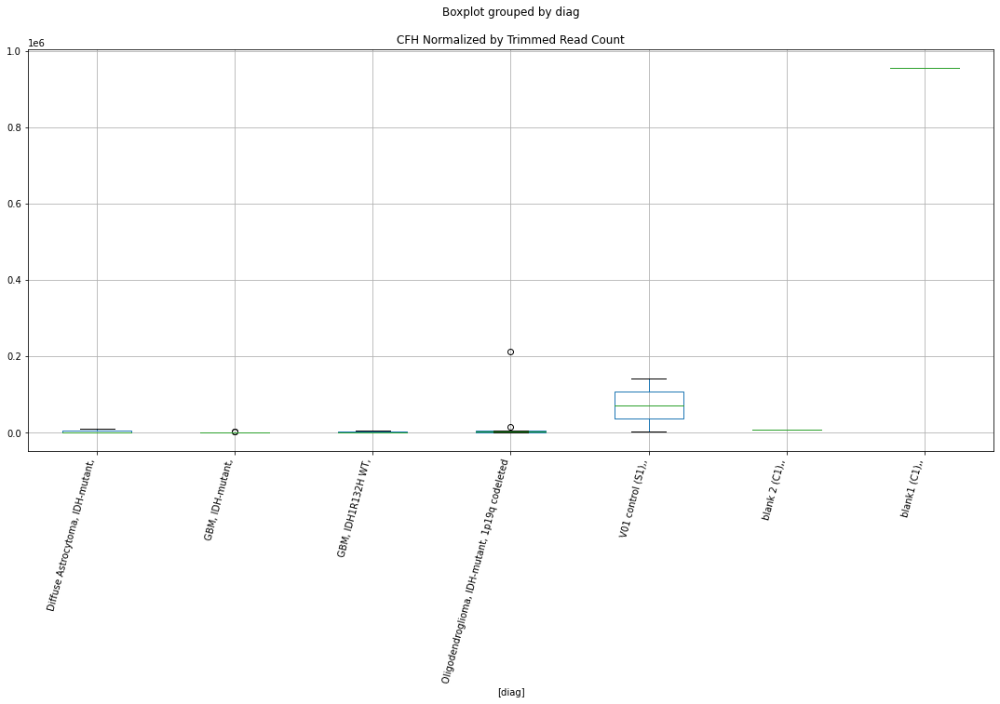

 p : 0.032692238517714654  ( t : 2.3139319859911063 ) :  D-plex  :  bbduk2  :  ASPHD2
Control and blanks
73     0.0
337    0.0
Name: ASPHD2, dtype: float64
205    0.0
Name: ASPHD2, dtype: float64
469    591.53
Name: ASPHD2, dtype: float64


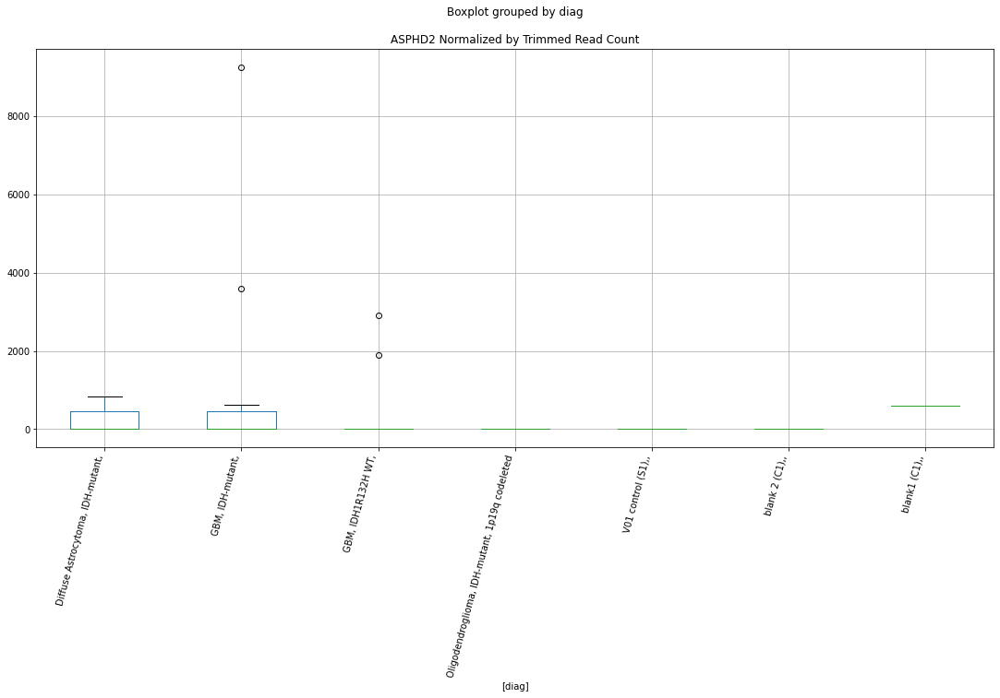

 p : 0.032758432710994746  ( t : 2.3129345297771033 ) :  D-plex  :  cutadapt2  :  CTXND1
Control and blanks
76     29546.95
340    18495.37
Name: CTXND1, dtype: float64
208    20281.43
Name: CTXND1, dtype: float64
472    28897.79
Name: CTXND1, dtype: float64


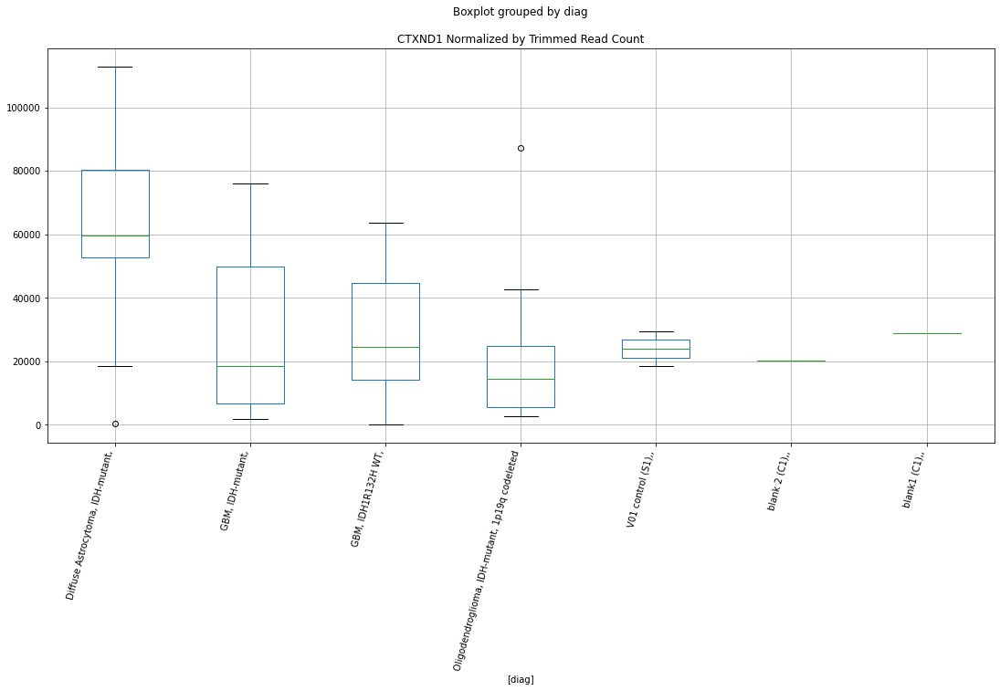

 p : 0.03280518859932865  ( t : 2.312231109068843 ) :  D-plex  :  bbduk2  :  CPEB4
Control and blanks
73      4638.05
337    26704.72
Name: CPEB4, dtype: float64
205    16118.19
Name: CPEB4, dtype: float64
469    28393.31
Name: CPEB4, dtype: float64


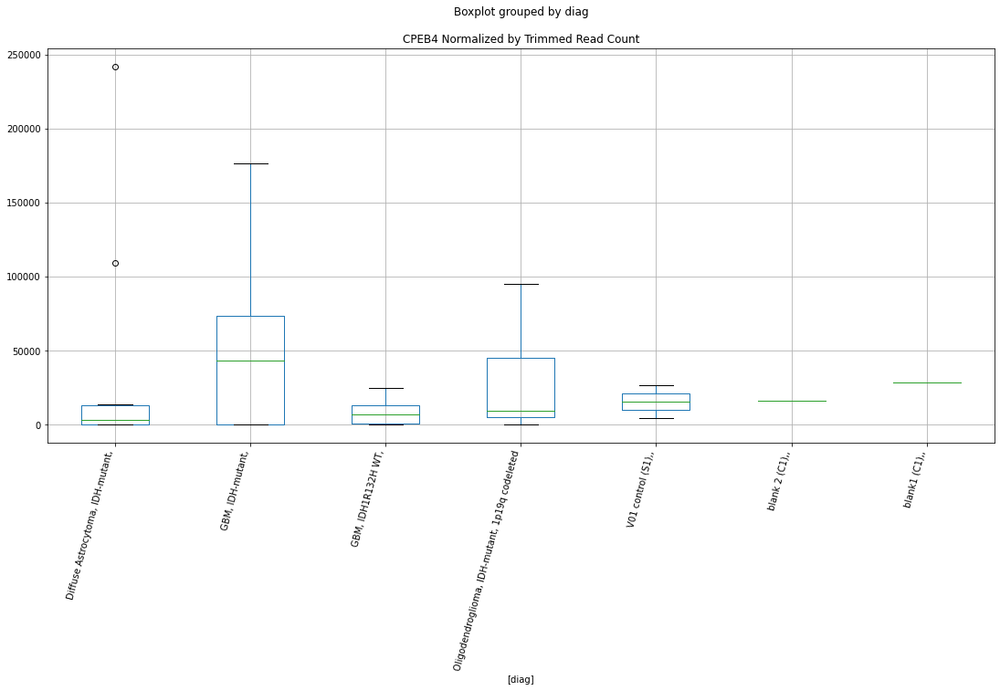

 p : 0.032901898446833326  ( t : 2.310779101989449 ) :  Lexogen  :  bbduk2  :  BLOC1S3
Control and blanks
79     0.0
343    0.0
Name: BLOC1S3, dtype: float64
211    0.0
Name: BLOC1S3, dtype: float64
475    0.0
Name: BLOC1S3, dtype: float64


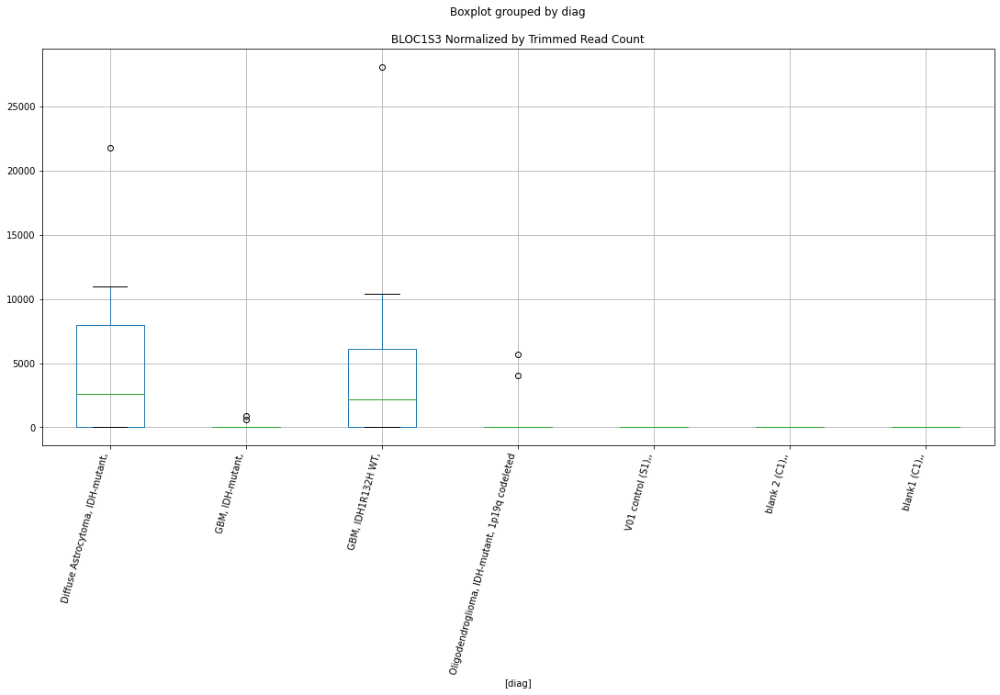

 p : 0.03292659410998949  ( t : 2.310408954781865 ) :  D-plex  :  cutadapt2  :  CYBB
Control and blanks
76     0.0
340    0.0
Name: CYBB, dtype: float64
208    1763.6
Name: CYBB, dtype: float64
472    4045.69
Name: CYBB, dtype: float64


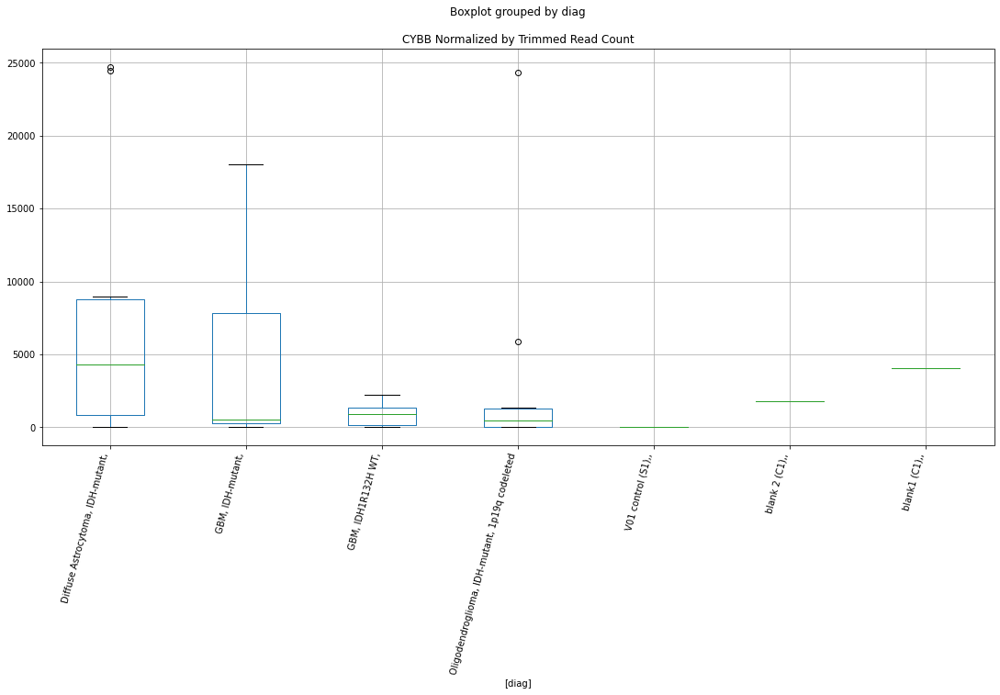

 p : 0.03295641976691841  ( t : 2.309962260733506 ) :  Lexogen  :  cutadapt2  :  ASXL2
Control and blanks
82        0.00
346    7365.21
Name: ASXL2, dtype: float64
214    0.0
Name: ASXL2, dtype: float64
478    712.38
Name: ASXL2, dtype: float64


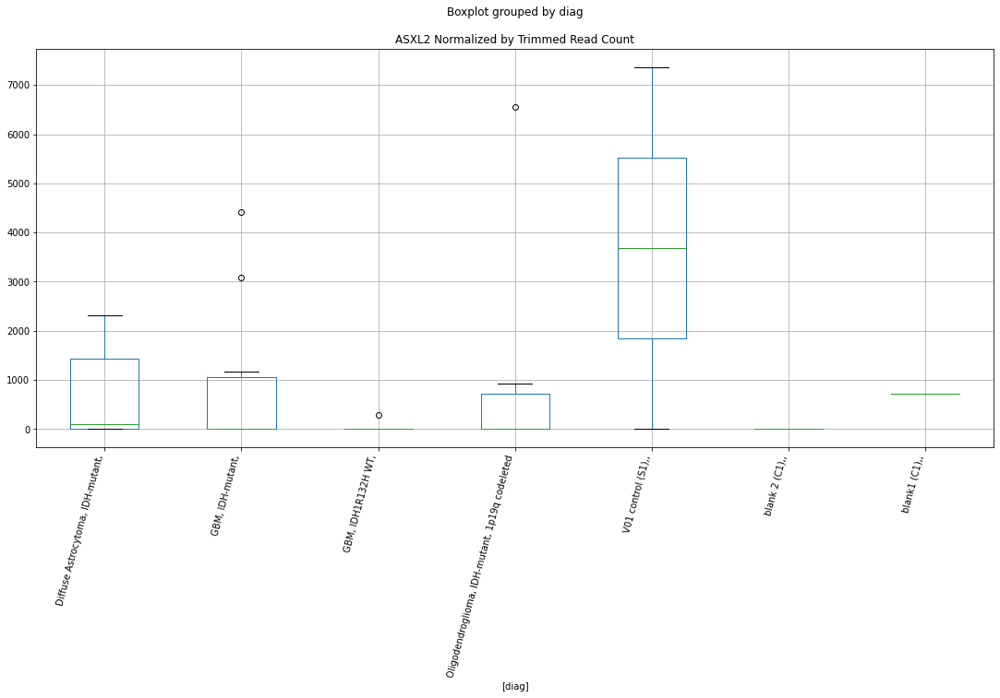

 p : 0.03302968972953258  ( t : 2.3088664989641523 ) :  D-plex  :  cutadapt2  :  BSN-DT
Control and blanks
76         0.00
340    14091.71
Name: BSN-DT, dtype: float64
208    352.72
Name: BSN-DT, dtype: float64
472    577.96
Name: BSN-DT, dtype: float64


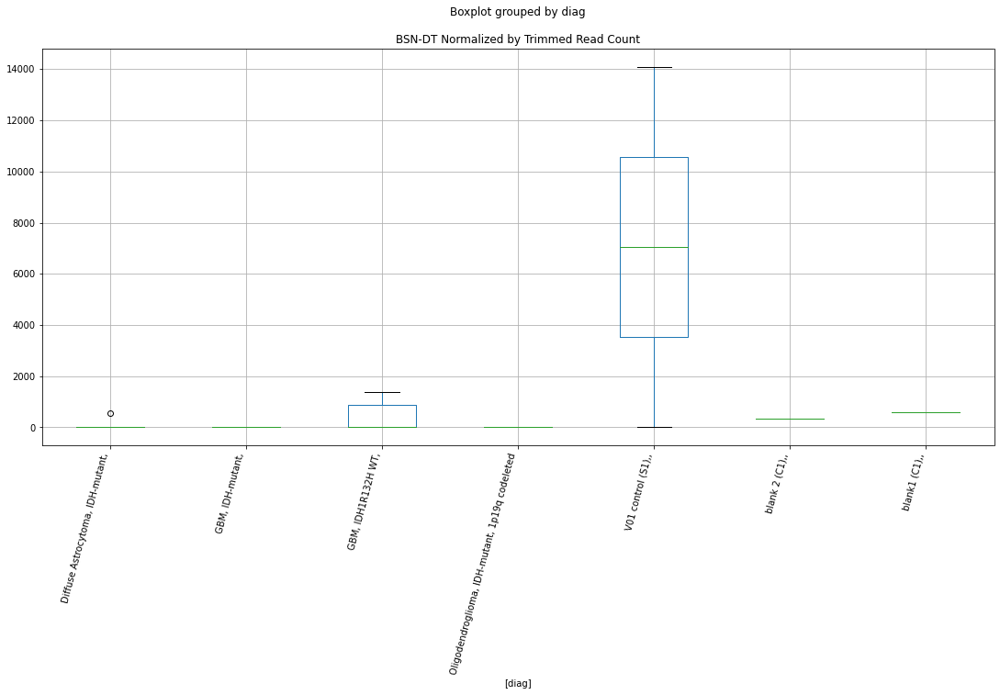

 p : 0.03303324951619013  ( t : 2.3088133193631792 ) :  Lexogen  :  cutadapt2  :  CATSPERD
Control and blanks
82        0.00
346    2104.35
Name: CATSPERD, dtype: float64
214    27122.65
Name: CATSPERD, dtype: float64
478    0.0
Name: CATSPERD, dtype: float64


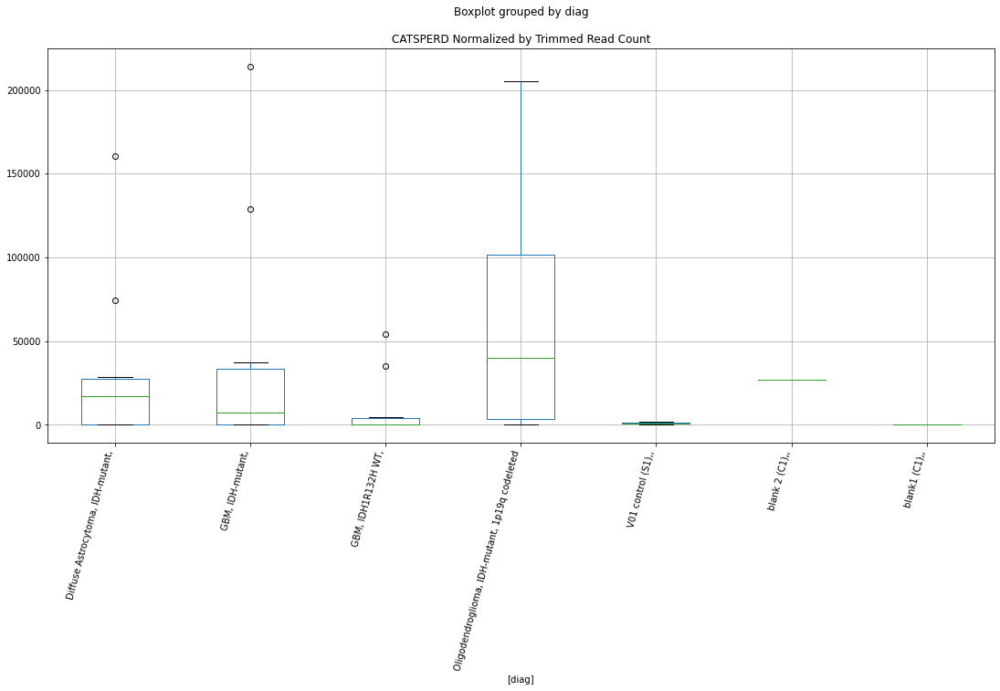

 p : 0.033090072387200374  ( t : 2.3079651623739257 ) :  Lexogen  :  bbduk2  :  ASIC5
Control and blanks
79     0.0
343    0.0
Name: ASIC5, dtype: float64
211    819.92
Name: ASIC5, dtype: float64
475    0.0
Name: ASIC5, dtype: float64


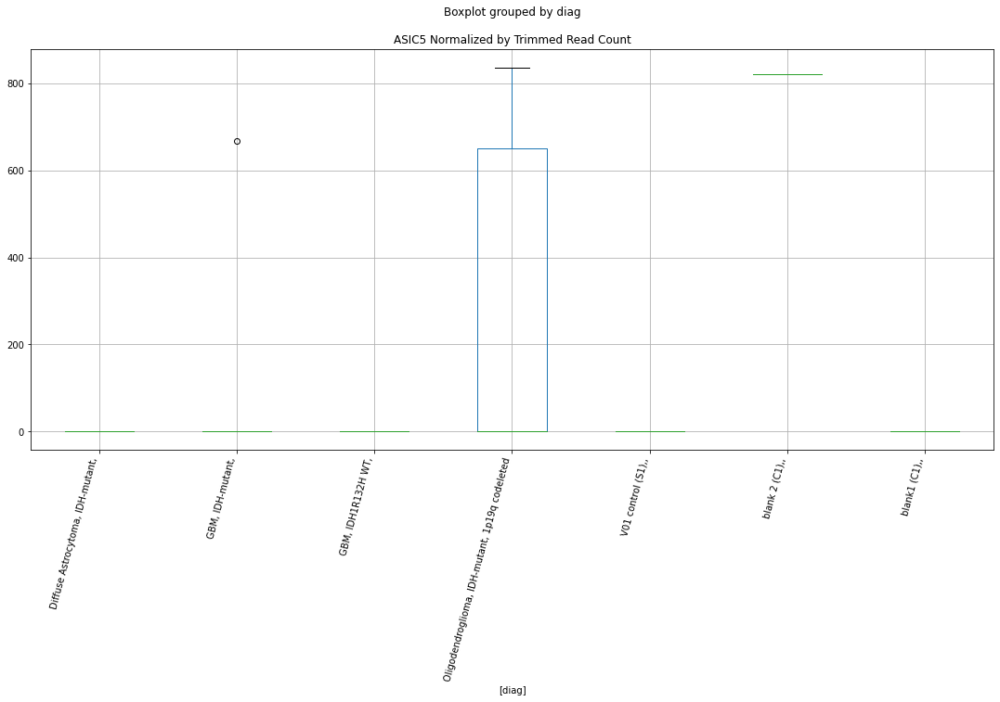

 p : 0.03312285453200647  ( t : 2.3074764596808275 ) :  D-plex  :  cutadapt2  :  CCDC102A
Control and blanks
76     0.0
340    0.0
Name: CCDC102A, dtype: float64
208    2821.76
Name: CCDC102A, dtype: float64
472    2311.82
Name: CCDC102A, dtype: float64


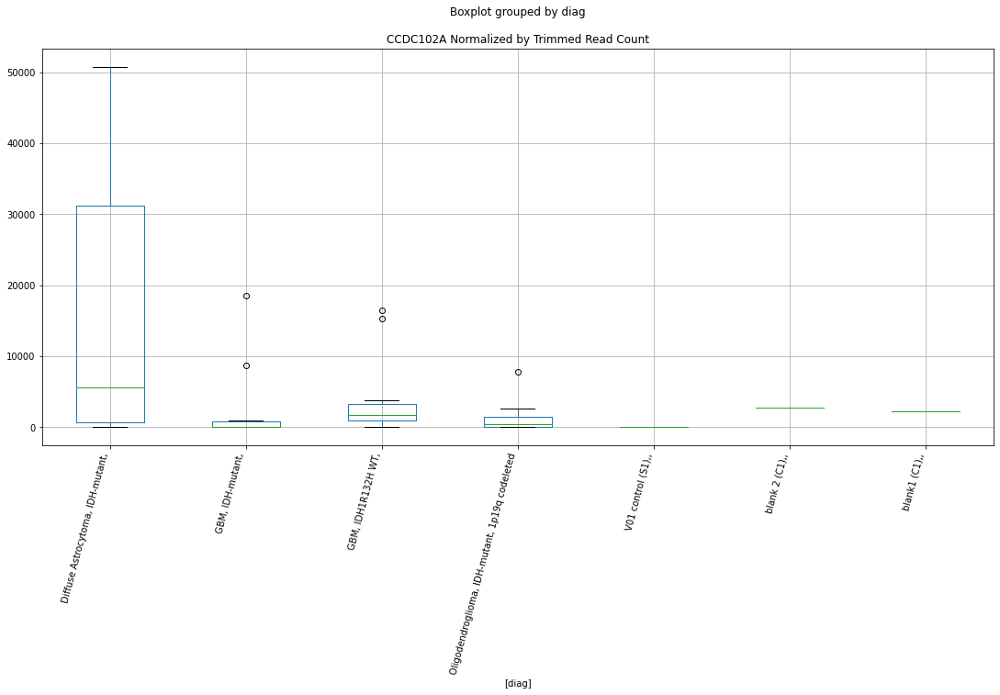

 p : 0.033146505807794116  ( t : 2.307124154787337 ) :  D-plex  :  cutadapt2  :  CLN3
Control and blanks
76         0.00
340    44917.34
Name: CLN3, dtype: float64
208    1410.88
Name: CLN3, dtype: float64
472    3467.74
Name: CLN3, dtype: float64


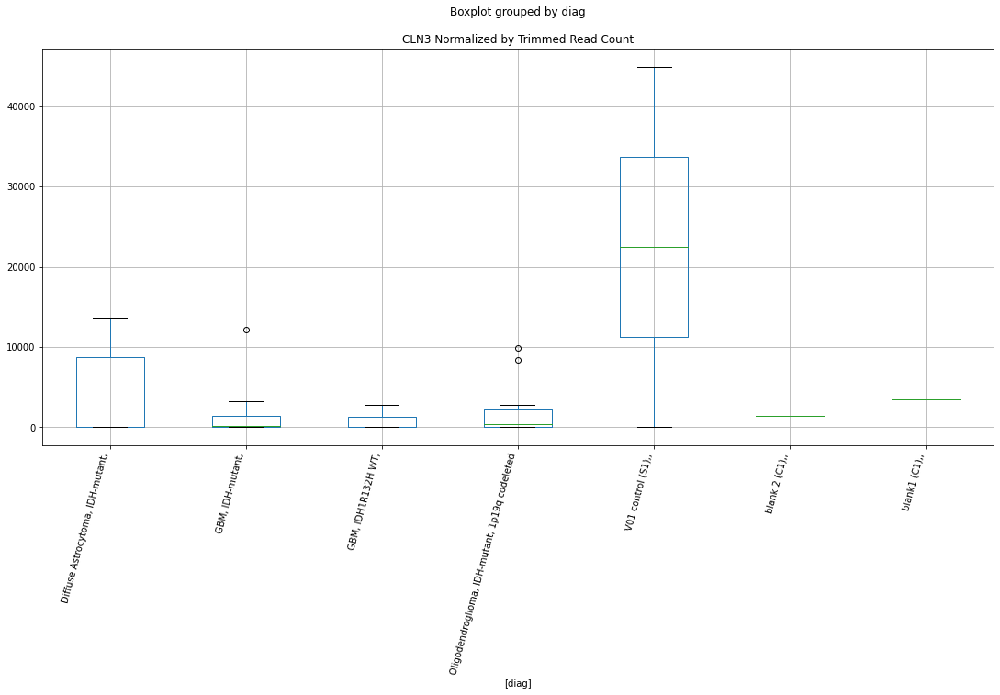

 p : 0.03318141400908146  ( t : 2.3066045947533382 ) :  Lexogen  :  cutadapt2  :  ARFGAP1
Control and blanks
82     0.0
346    0.0
Name: ARFGAP1, dtype: float64
214    0.0
Name: ARFGAP1, dtype: float64
478    0.0
Name: ARFGAP1, dtype: float64


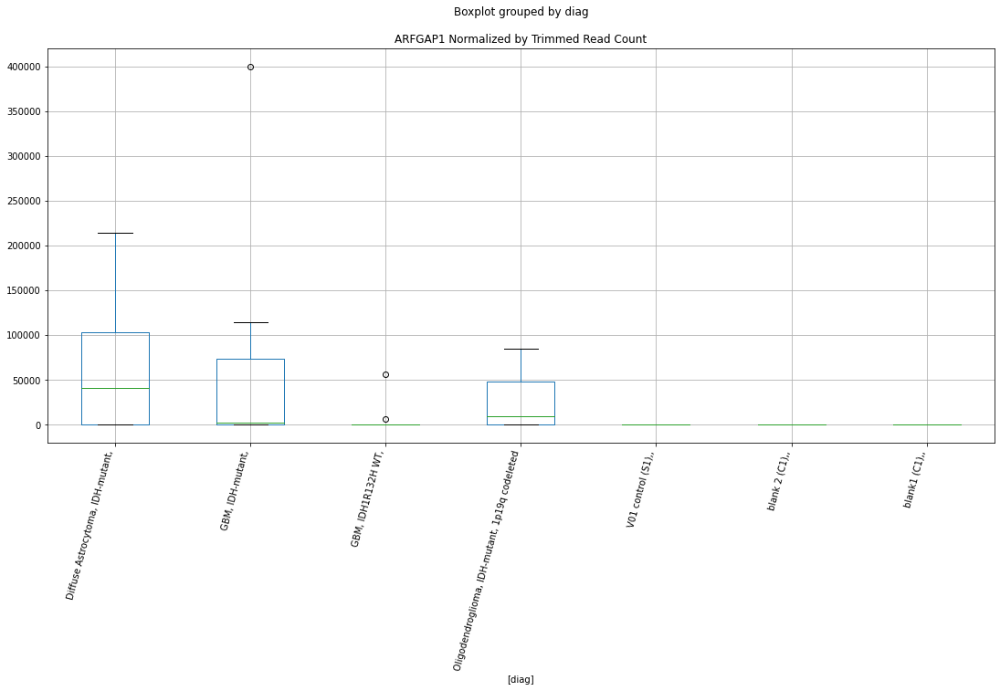

 p : 0.033486503063313175  ( t : 2.302085224026671 ) :  D-plex  :  cutadapt2  :  CA4
Control and blanks
76     0.0
340    0.0
Name: CA4, dtype: float64
208    6701.69
Name: CA4, dtype: float64
472    2889.78
Name: CA4, dtype: float64


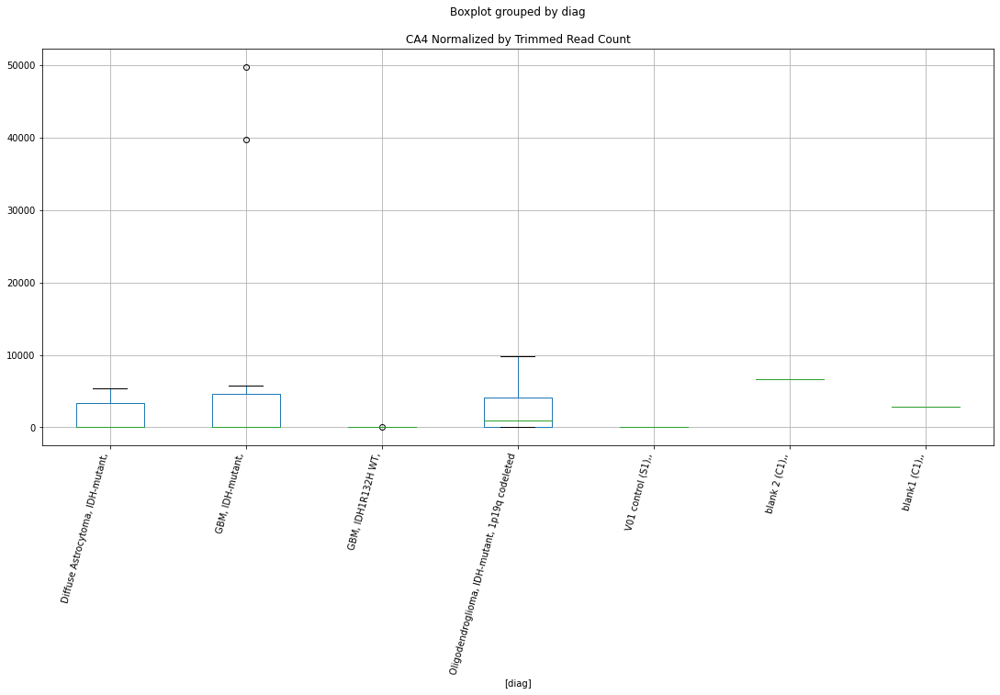

 p : 0.03351298418764914  ( t : 2.3016947546866824 ) :  Lexogen  :  cutadapt2  :  CHRD
Control and blanks
82     0.0
346    0.0
Name: CHRD, dtype: float64
214    5153.3
Name: CHRD, dtype: float64
478    0.0
Name: CHRD, dtype: float64


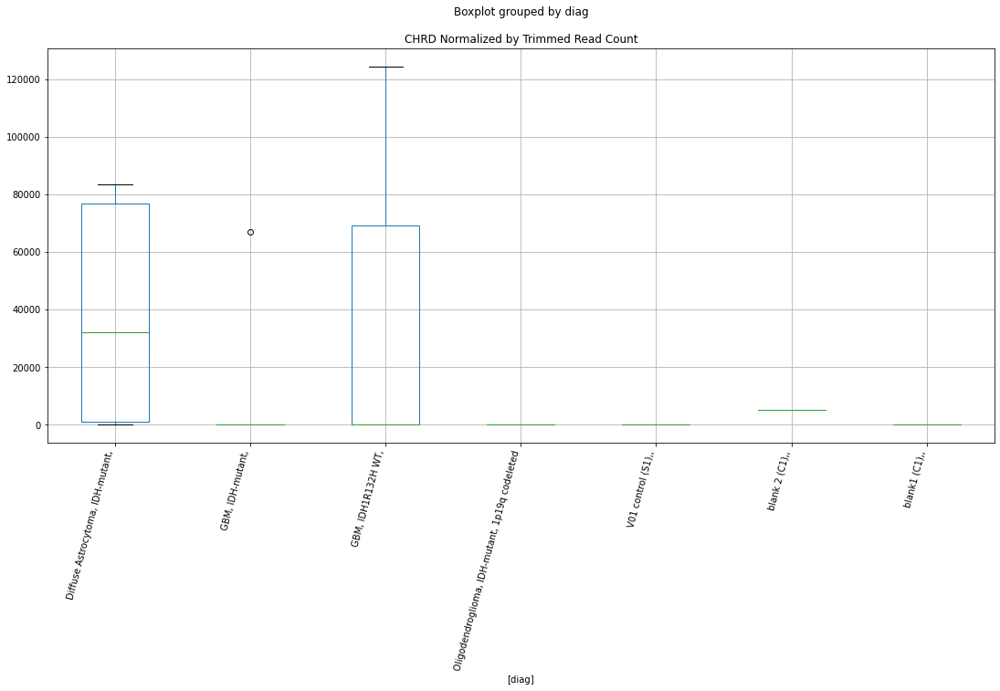

 p : 0.033535750898587326  ( t : 2.301359283739488 ) :  D-plex  :  bbduk2  :  BORCS8-MEF2B
Control and blanks
73     0.0
337    0.0
Name: BORCS8-MEF2B, dtype: float64
205    0.0
Name: BORCS8-MEF2B, dtype: float64
469    0.0
Name: BORCS8-MEF2B, dtype: float64


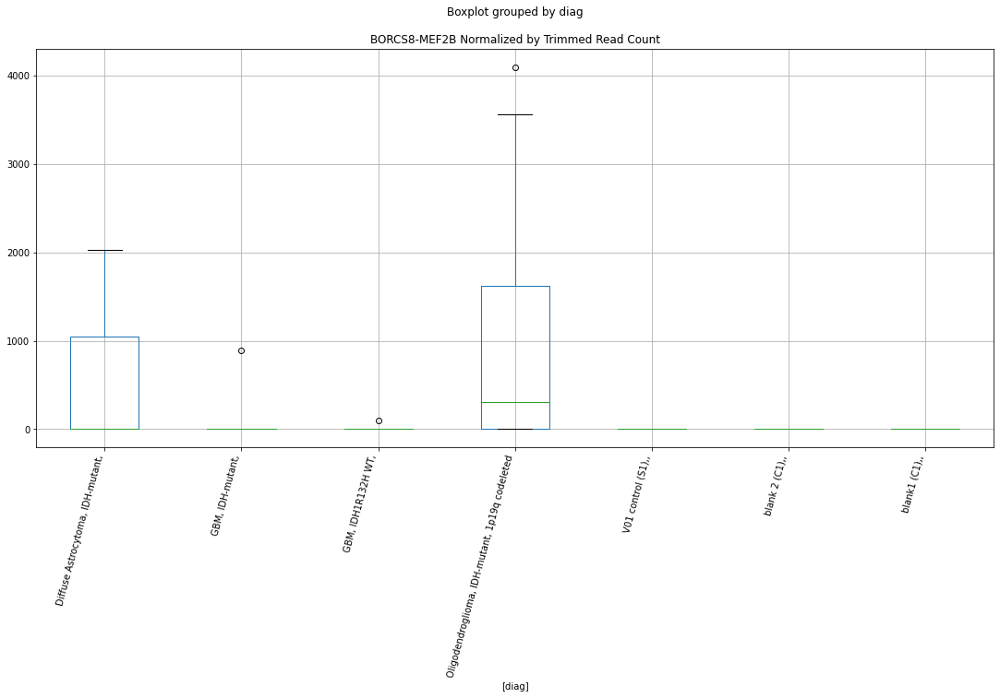

 p : 0.0335703525579734  ( t : 2.3008498271626223 ) :  D-plex  :  bbduk2  :  ACKR4
Control and blanks
73     0.0
337    0.0
Name: ACKR4, dtype: float64
205    716.36
Name: ACKR4, dtype: float64
469    1183.05
Name: ACKR4, dtype: float64


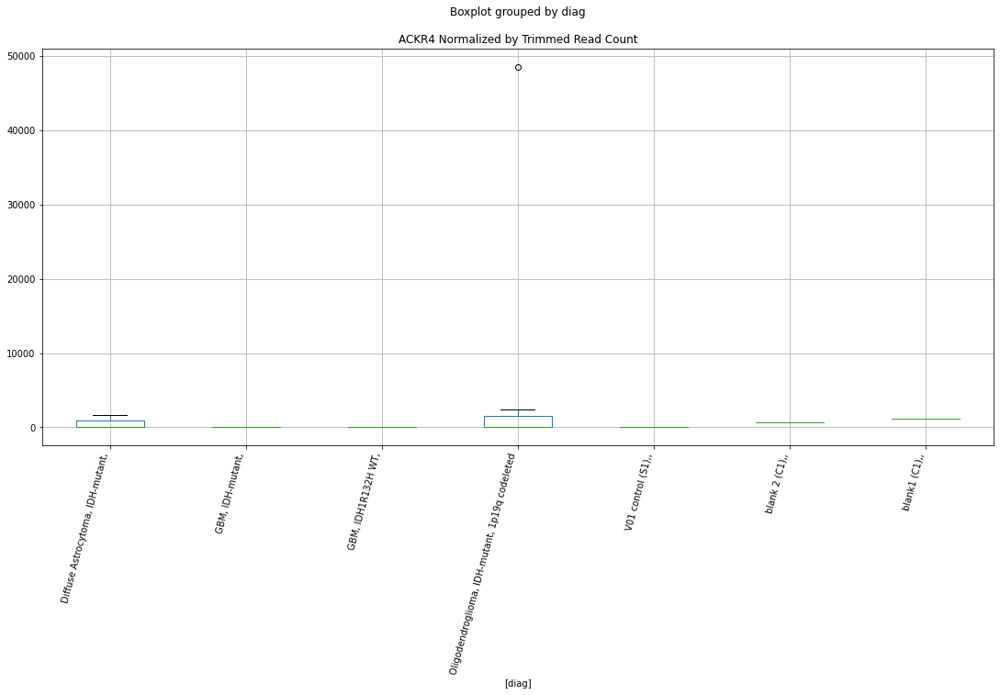

 p : 0.03364092674517319  ( t : 2.299812237475613 ) :  D-plex  :  bbduk2  :  DGCR10
Control and blanks
73     0.0
337    0.0
Name: DGCR10, dtype: float64
205    0.0
Name: DGCR10, dtype: float64
469    0.0
Name: DGCR10, dtype: float64


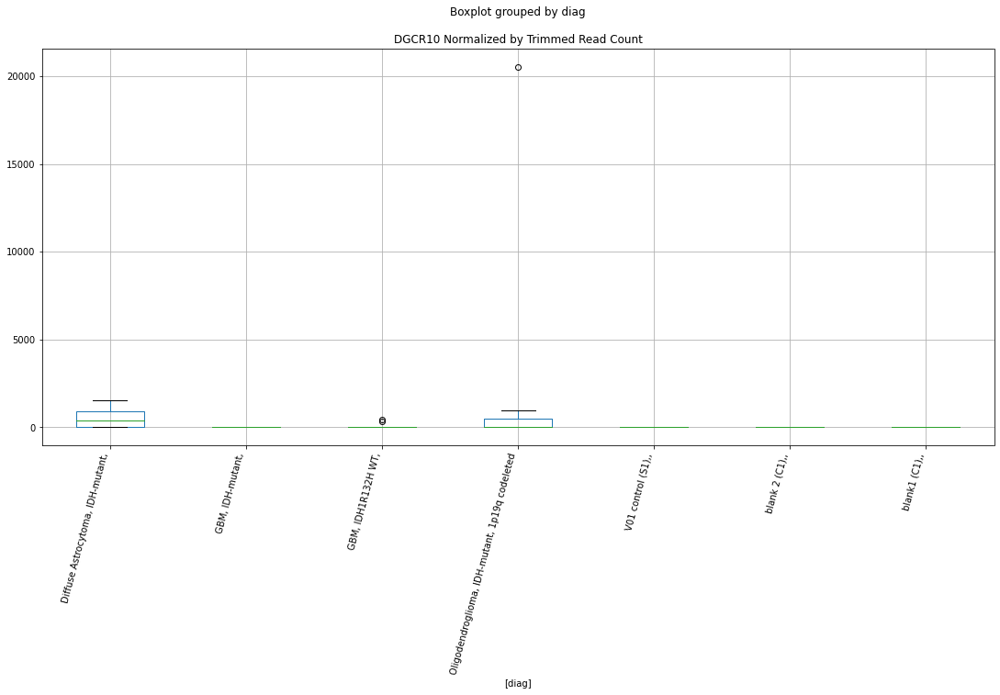

 p : 0.03372880645736502  ( t : 2.298523037234009 ) :  D-plex  :  cutadapt2  :  APBB2
Control and blanks
76         0.0
340    27302.7
Name: APBB2, dtype: float64
208    5643.53
Name: APBB2, dtype: float64
472    10403.21
Name: APBB2, dtype: float64


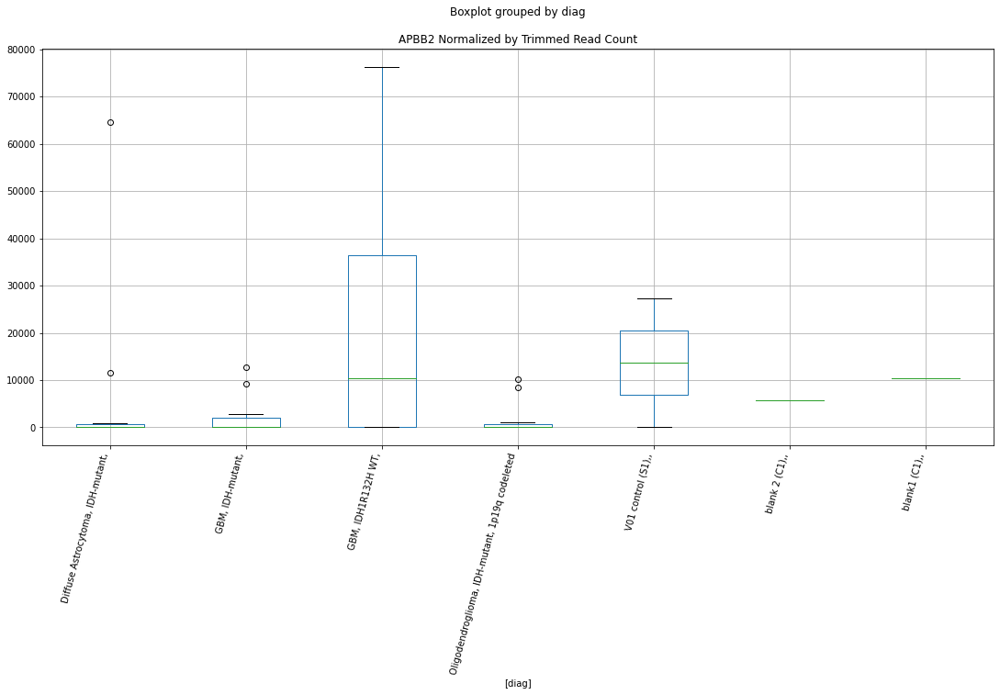

 p : 0.03373243534089111  ( t : 2.2984698682835907 ) :  Lexogen  :  bbduk2  :  DCTN1-AS1
Control and blanks
79      4291.80
343    50318.49
Name: DCTN1-AS1, dtype: float64
211    1639.84
Name: DCTN1-AS1, dtype: float64
475    17963.68
Name: DCTN1-AS1, dtype: float64


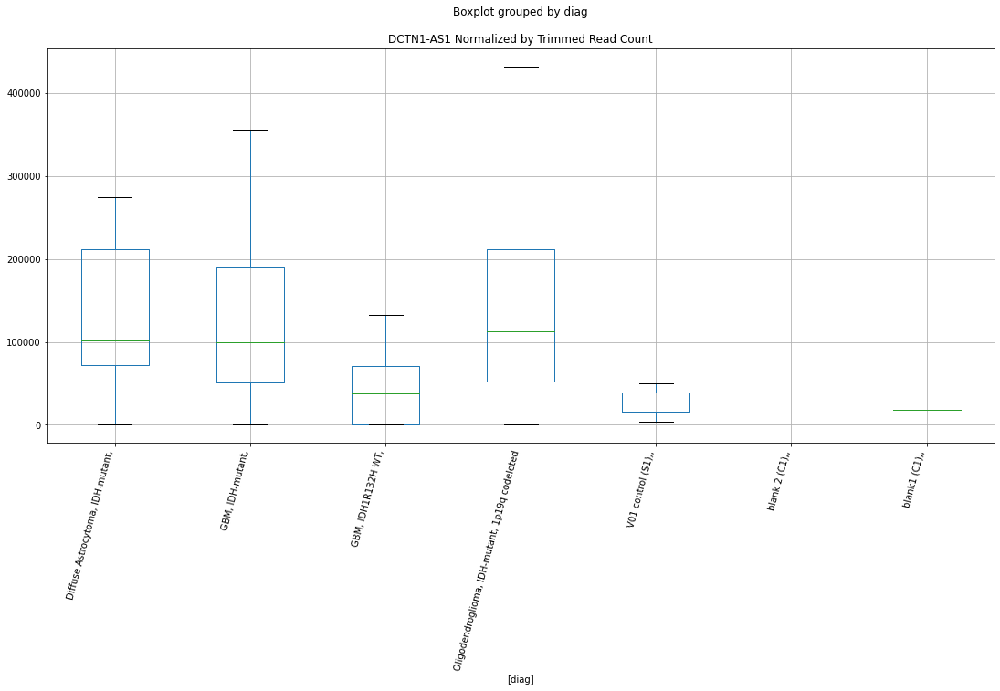

 p : 0.03373435748662522  ( t : 2.298441707920818 ) :  Lexogen  :  cutadapt2  :  C3
Control and blanks
82     0.0
346    0.0
Name: C3, dtype: float64
214    0.0
Name: C3, dtype: float64
478    0.0
Name: C3, dtype: float64


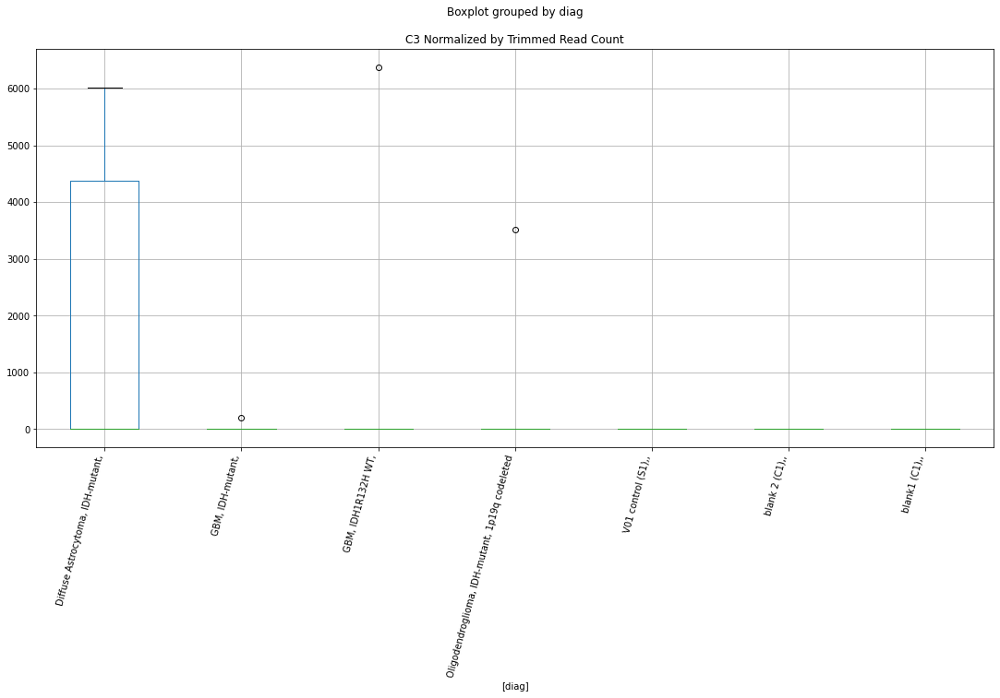

 p : 0.03374078478242791  ( t : 2.2983475557356736 ) :  Lexogen  :  bbduk2  :  ARFGAP1
Control and blanks
79     0.0
343    0.0
Name: ARFGAP1, dtype: float64
211    0.0
Name: ARFGAP1, dtype: float64
475    0.0
Name: ARFGAP1, dtype: float64


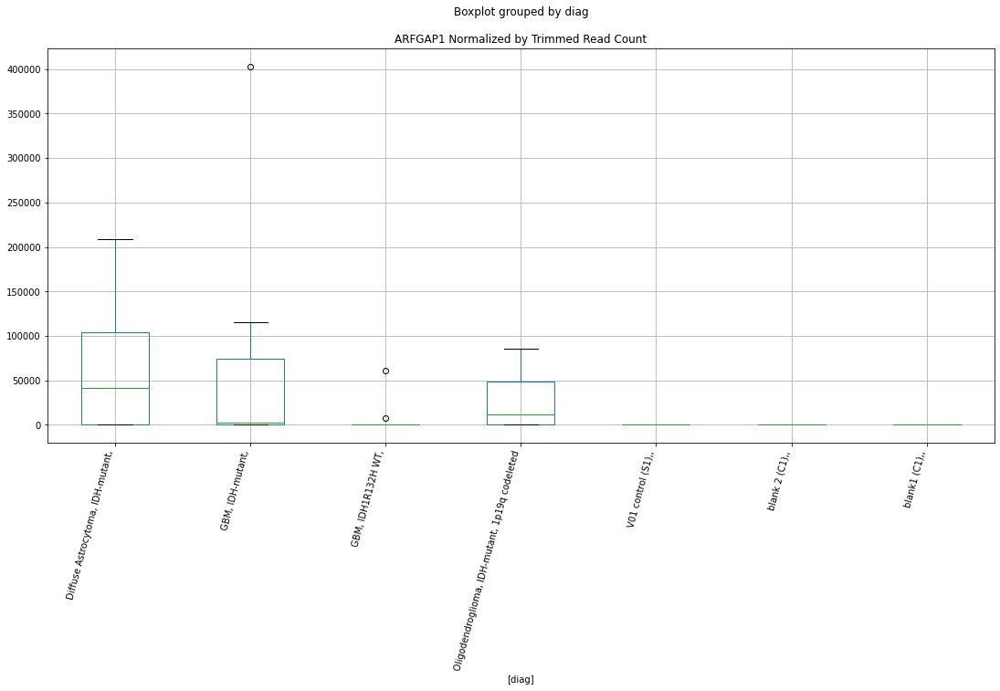

 p : 0.033747027560659296  ( t : 2.298256122426613 ) :  Lexogen  :  cutadapt2  :  CDKL1
Control and blanks
82     0.0
346    0.0
Name: CDKL1, dtype: float64
214    0.0
Name: CDKL1, dtype: float64
478    0.0
Name: CDKL1, dtype: float64


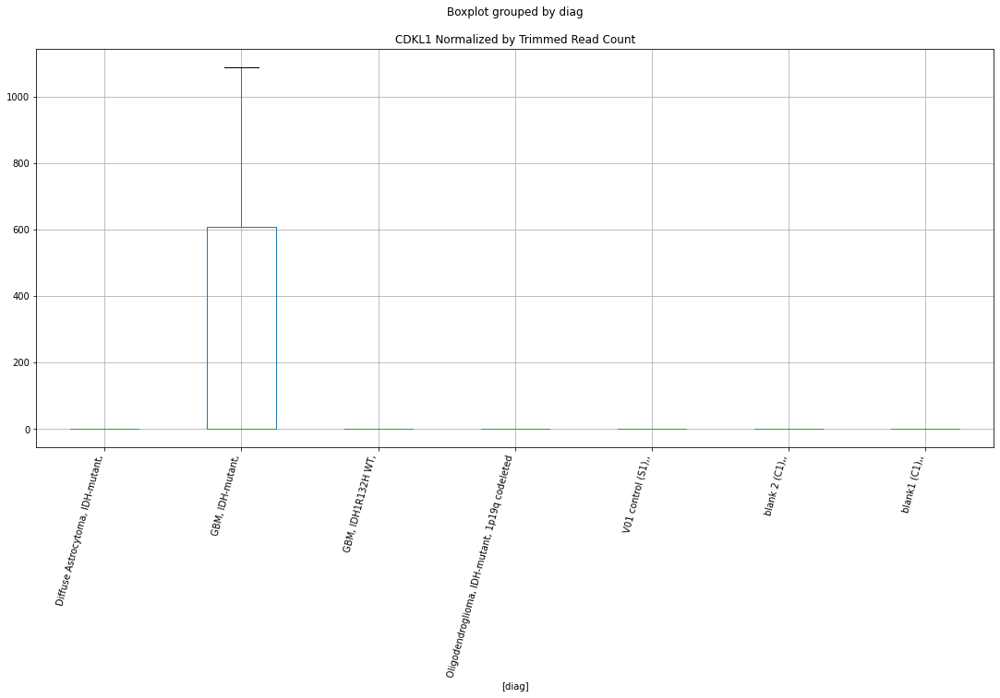

 p : 0.03377441008655455  ( t : 2.2978552561411054 ) :  Lexogen  :  bbduk2  :  C3
Control and blanks
79     0.0
343    0.0
Name: C3, dtype: float64
211    0.0
Name: C3, dtype: float64
475    0.0
Name: C3, dtype: float64


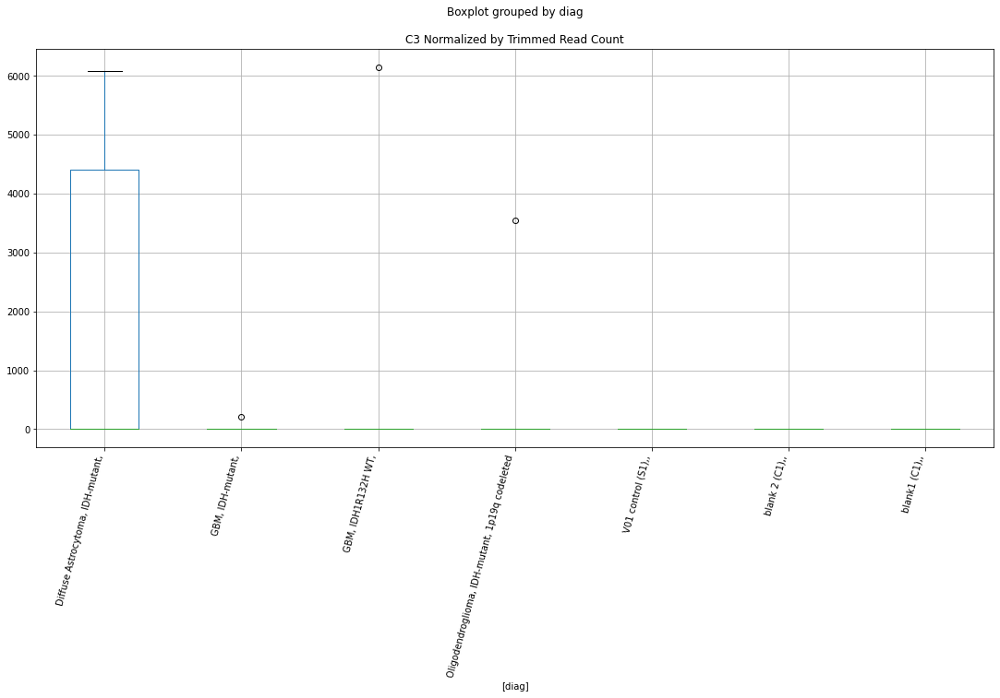

 p : 0.03387194202417096  ( t : 2.2964298812335033 ) :  Lexogen  :  bbduk2  :  CDKL1
Control and blanks
79     0.0
343    0.0
Name: CDKL1, dtype: float64
211    0.0
Name: CDKL1, dtype: float64
475    0.0
Name: CDKL1, dtype: float64


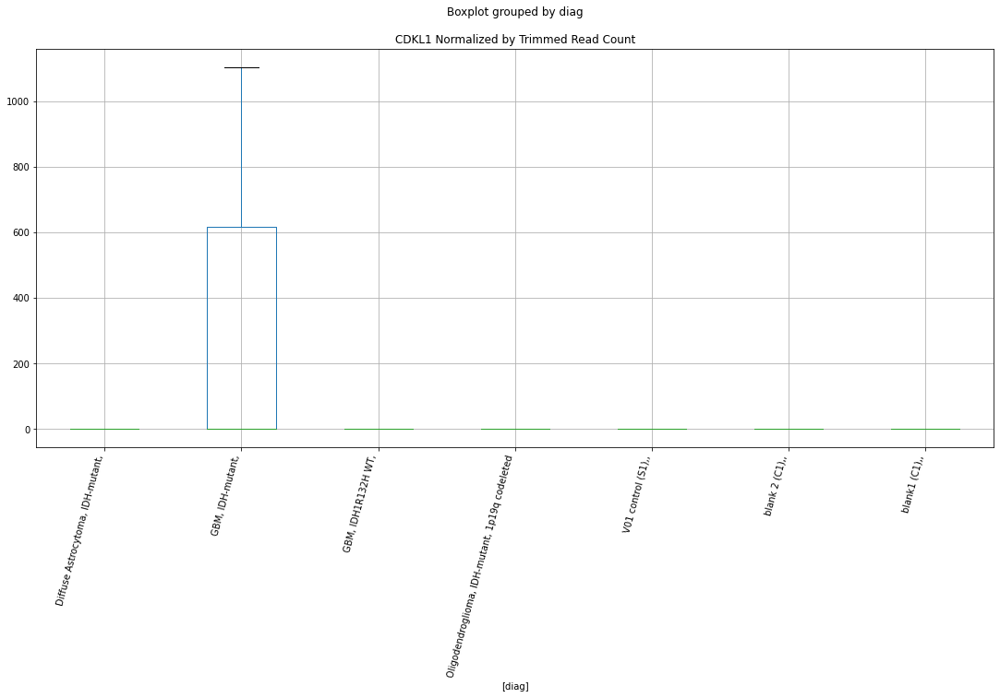

 p : 0.0338963287584568  ( t : 2.2960740772134645 ) :  Lexogen  :  cutadapt2  :  BLOC1S3
Control and blanks
82     0.0
346    0.0
Name: BLOC1S3, dtype: float64
214    0.0
Name: BLOC1S3, dtype: float64
478    0.0
Name: BLOC1S3, dtype: float64


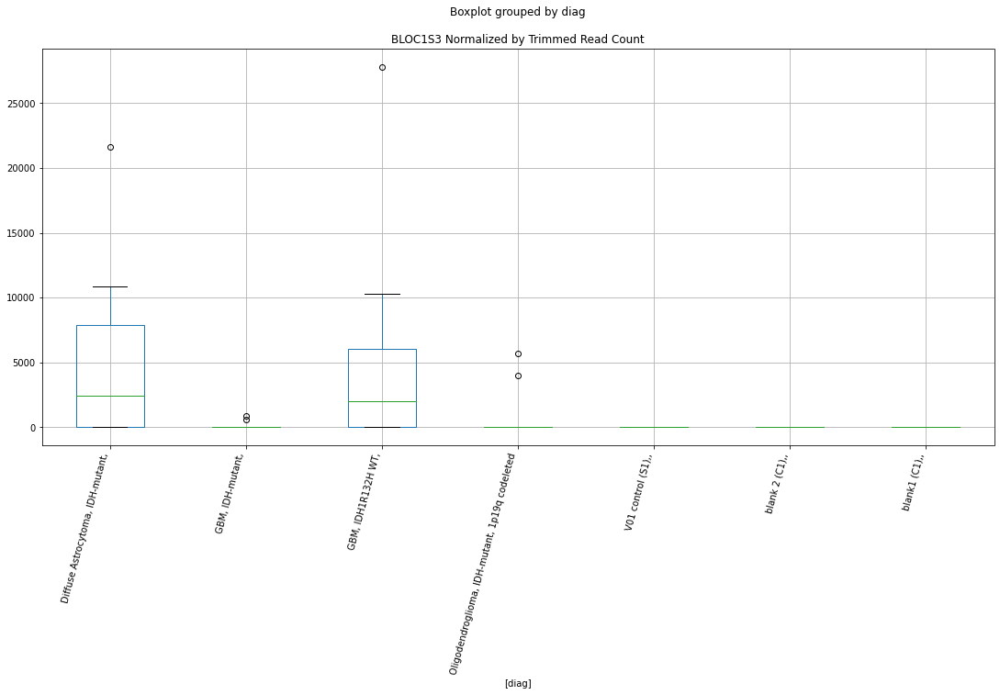

 p : 0.03390971160378439  ( t : 2.2958789214459148 ) :  D-plex  :  bbduk2  :  CHD8
Control and blanks
73     0.0
337    0.0
Name: CHD8, dtype: float64
205    1432.73
Name: CHD8, dtype: float64
469    0.0
Name: CHD8, dtype: float64


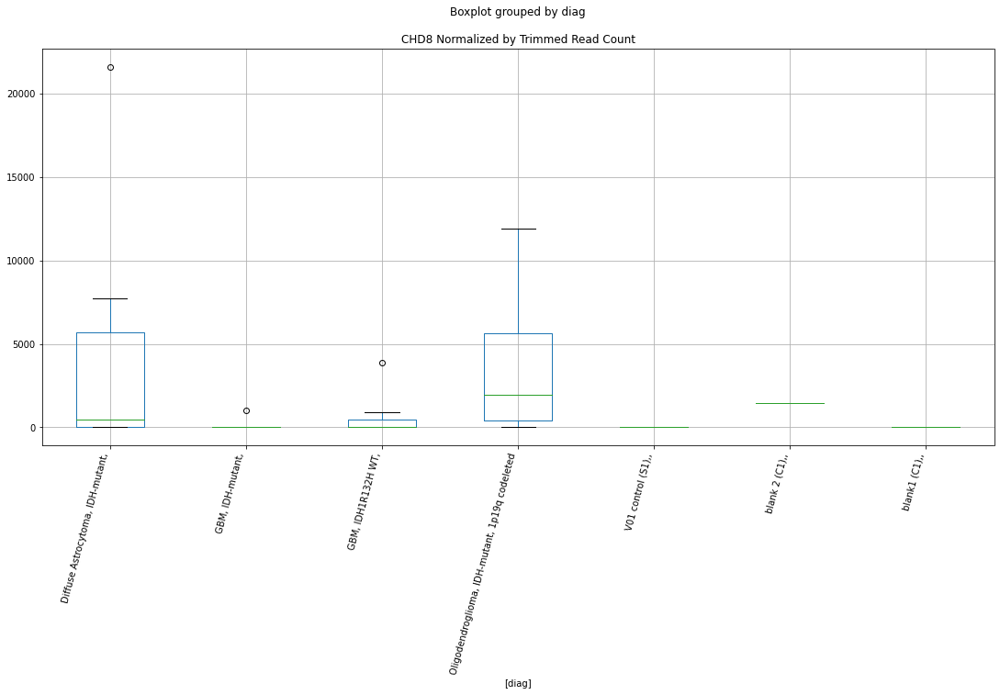

 p : 0.03399650609487294  ( t : 2.2946149678679184 ) :  D-plex  :  cutadapt2  :  ARL16
Control and blanks
76     18182.74
340        0.00
Name: ARL16, dtype: float64
208    1587.24
Name: ARL16, dtype: float64
472    5201.6
Name: ARL16, dtype: float64


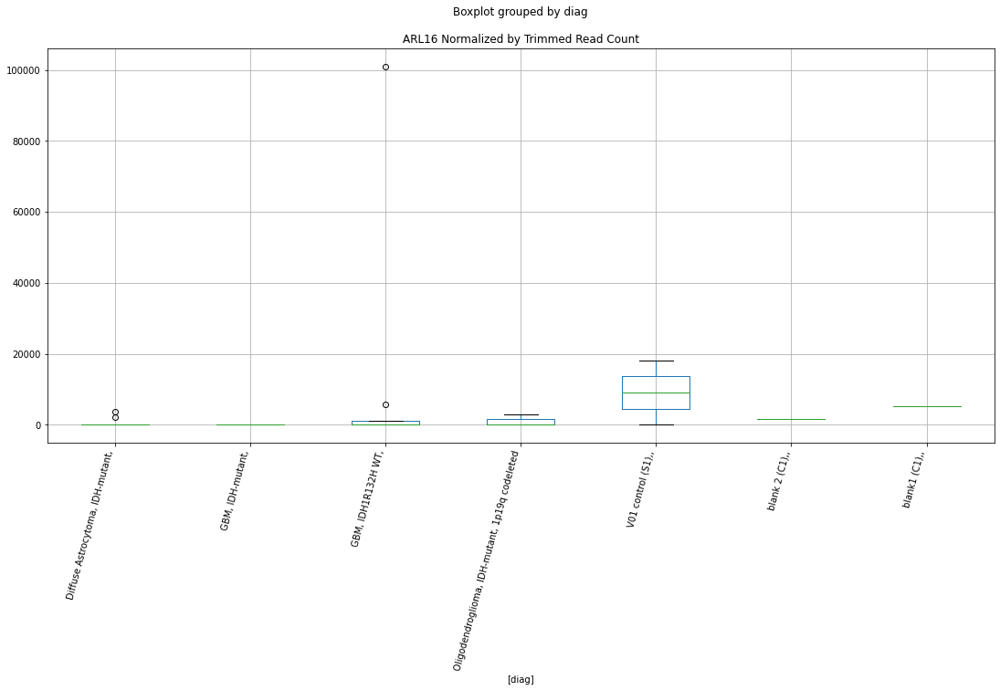

 p : 0.03404658340575172  ( t : 2.2938870716374233 ) :  Lexogen  :  bbduk2  :  ACTG1P4
Control and blanks
79     0.0
343    0.0
Name: ACTG1P4, dtype: float64
211    0.0
Name: ACTG1P4, dtype: float64
475    0.0
Name: ACTG1P4, dtype: float64


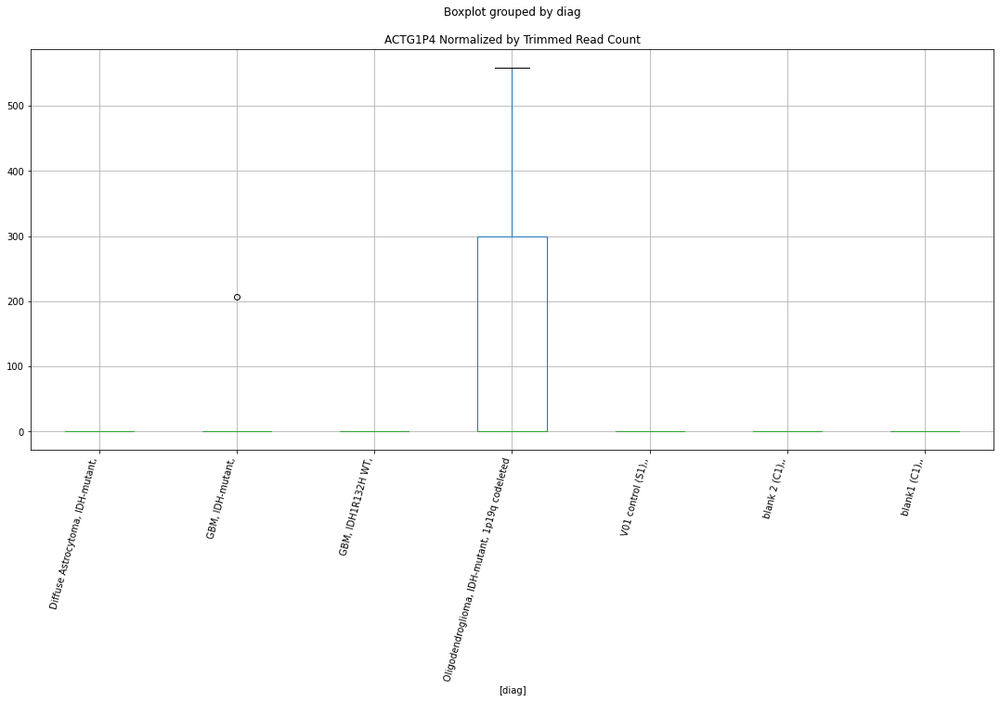

 p : 0.034065875356949424  ( t : 2.293606919129372 ) :  D-plex  :  cutadapt2  :  BHLHE23
Control and blanks
76     0.0
340    0.0
Name: BHLHE23, dtype: float64
208    881.8
Name: BHLHE23, dtype: float64
472    0.0
Name: BHLHE23, dtype: float64


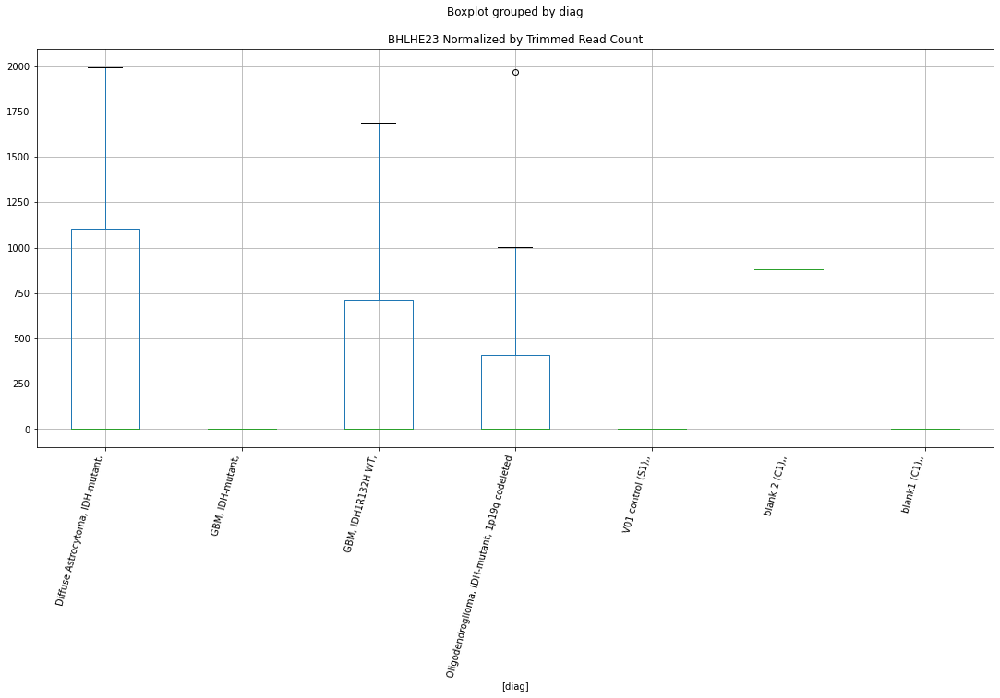

 p : 0.03410770401045661  ( t : 2.2929999992617955 ) :  Lexogen  :  bbduk2  :  CELF4
Control and blanks
79     0.0
343    0.0
Name: CELF4, dtype: float64
211    0.0
Name: CELF4, dtype: float64
475    0.0
Name: CELF4, dtype: float64


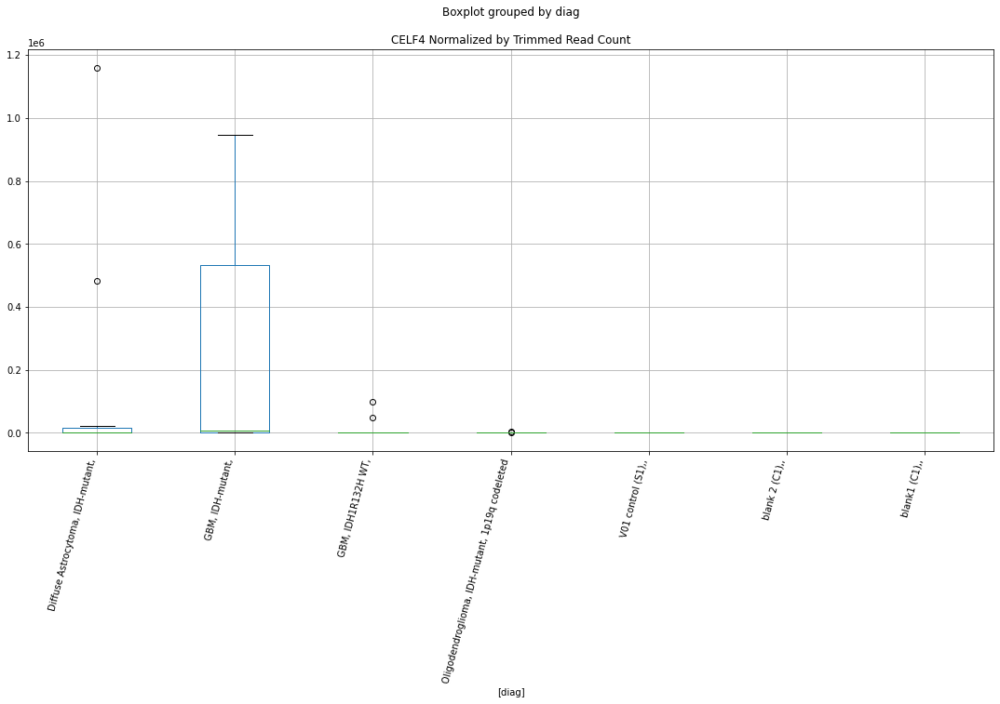

 p : 0.03411836272631562  ( t : 2.2928454550907658 ) :  Lexogen  :  cutadapt2  :  ACOXL
Control and blanks
82     0.0
346    0.0
Name: ACOXL, dtype: float64
214    0.0
Name: ACOXL, dtype: float64
478    0.0
Name: ACOXL, dtype: float64


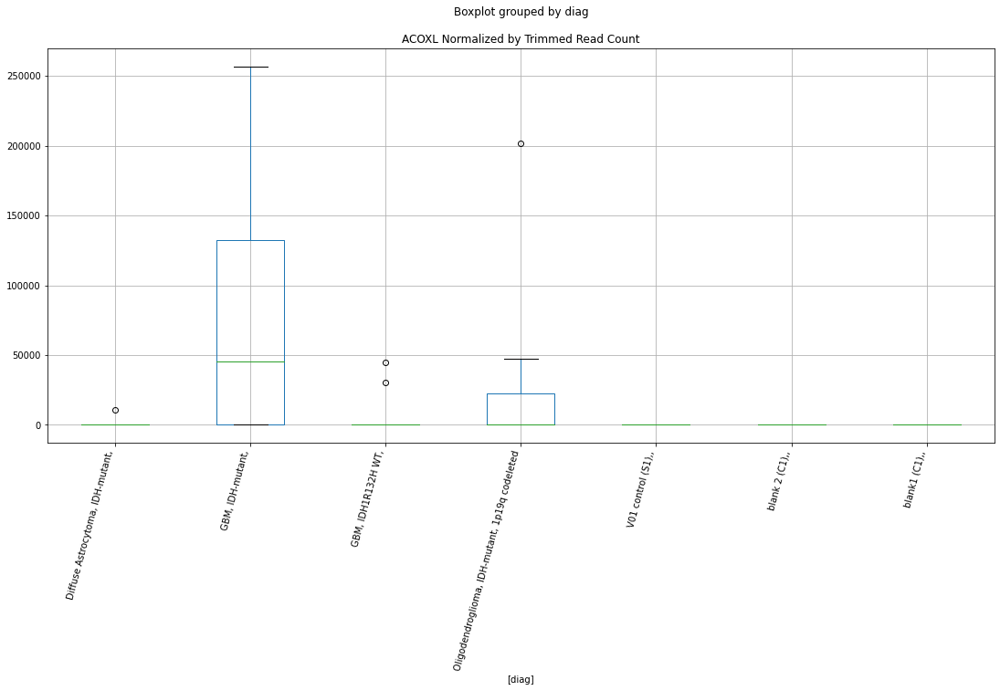

 p : 0.0341614462320105  ( t : 2.292221228875419 ) :  Lexogen  :  cutadapt2  :  ALDH2
Control and blanks
82     0.0
346    0.0
Name: ALDH2, dtype: float64
214    0.0
Name: ALDH2, dtype: float64
478    0.0
Name: ALDH2, dtype: float64


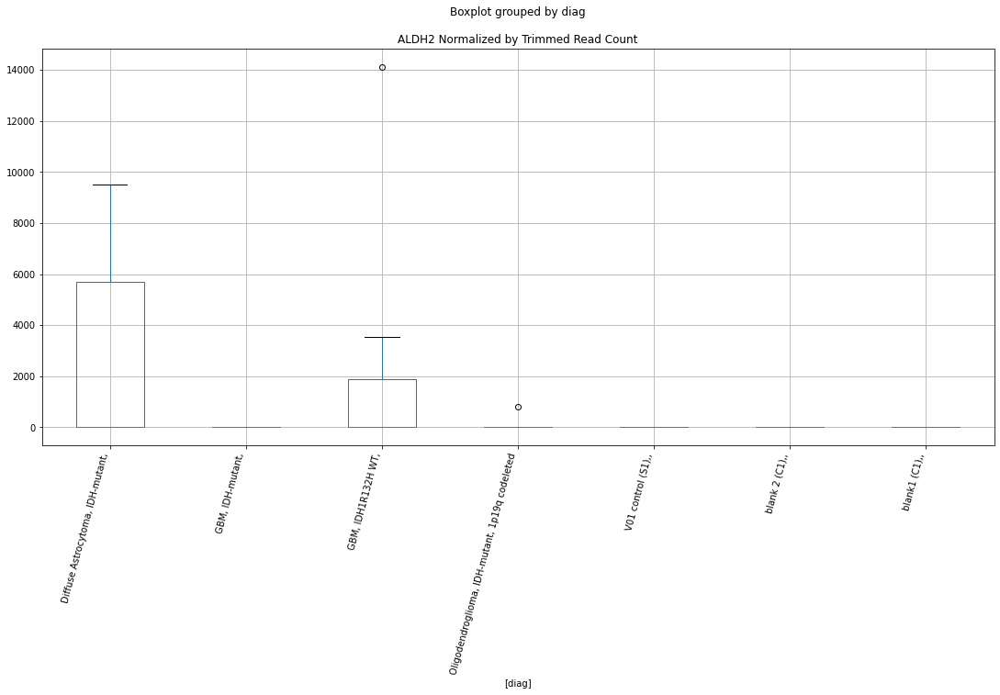

 p : 0.03426539383546596  ( t : 2.2907181552843885 ) :  D-plex  :  bbduk2  :  BHLHE23
Control and blanks
73     0.0
337    0.0
Name: BHLHE23, dtype: float64
205    895.45
Name: BHLHE23, dtype: float64
469    0.0
Name: BHLHE23, dtype: float64


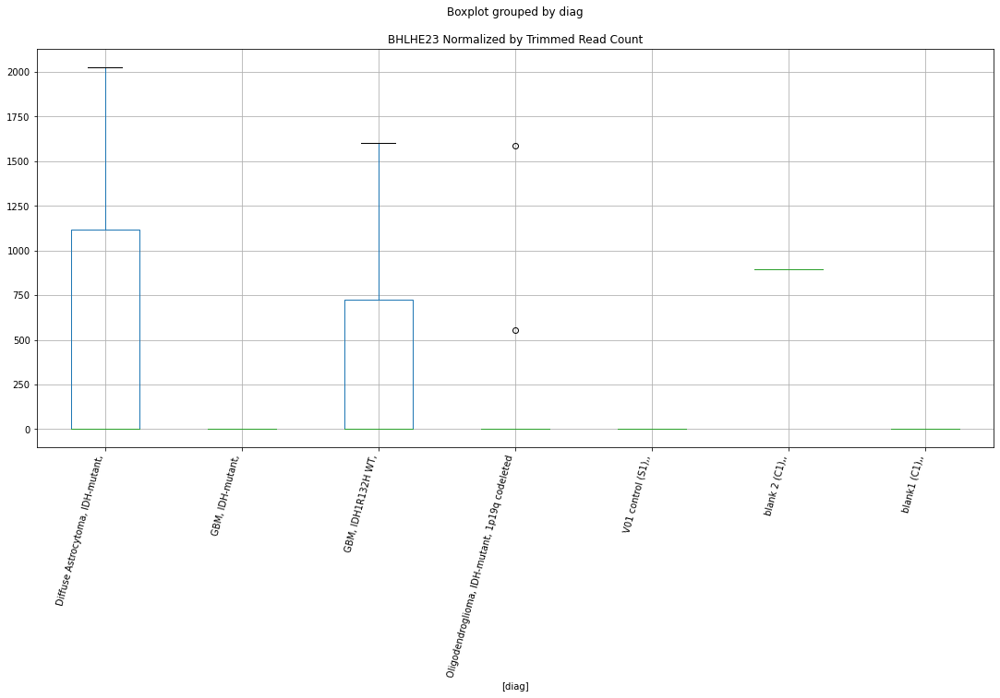

 p : 0.034314566720258  ( t : 2.290008590628055 ) :  Lexogen  :  cutadapt2  :  BRD3OS
Control and blanks
82       0.00
346    210.43
Name: BRD3OS, dtype: float64
214    0.0
Name: BRD3OS, dtype: float64
478    0.0
Name: BRD3OS, dtype: float64


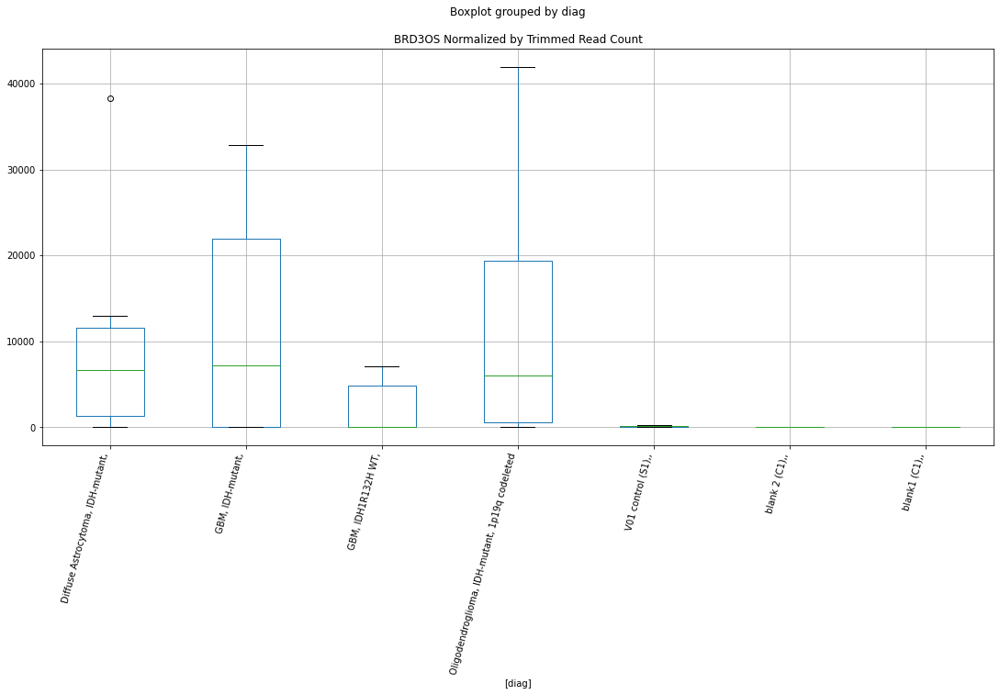

 p : 0.034336064277575094  ( t : 2.2896986767494543 ) :  D-plex  :  bbduk2  :  COL24A1
Control and blanks
73     265141.88
337     24924.40
Name: COL24A1, dtype: float64
205    161719.13
Name: COL24A1, dtype: float64
469    190471.8
Name: COL24A1, dtype: float64


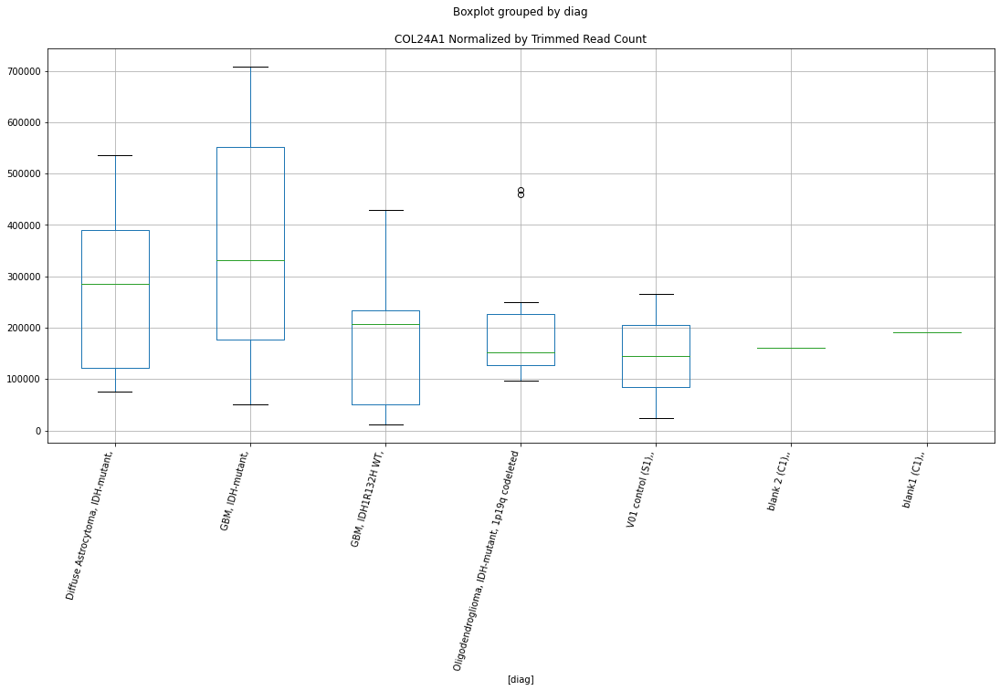

 p : 0.034393139804694925  ( t : 2.2888767335852473 ) :  Lexogen  :  bbduk2  :  DLGAP4
Control and blanks
79     0.0
343    0.0
Name: DLGAP4, dtype: float64
211    0.0
Name: DLGAP4, dtype: float64
475    1197.58
Name: DLGAP4, dtype: float64


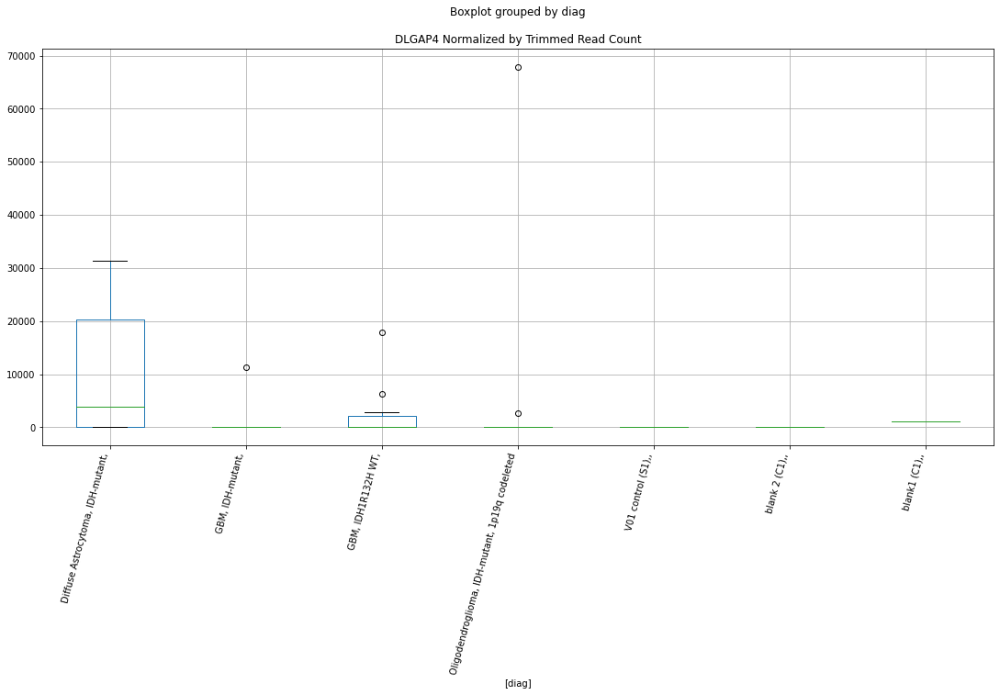

 p : 0.03443828504541342  ( t : 2.288227492487244 ) :  D-plex  :  bbduk2  :  ANKRD13B
Control and blanks
73         0.00
337    21363.77
Name: ANKRD13B, dtype: float64
205    17192.73
Name: ANKRD13B, dtype: float64
469    0.0
Name: ANKRD13B, dtype: float64


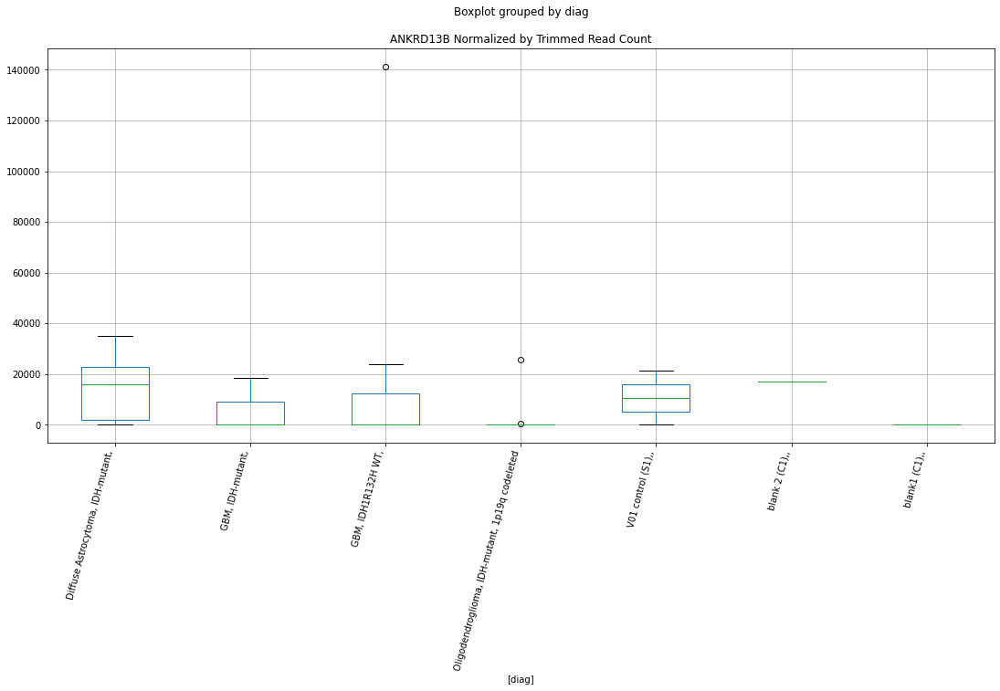

 p : 0.034556203294308044  ( t : 2.2865354015669164 ) :  Lexogen  :  cutadapt2  :  CELF4
Control and blanks
82     0.0
346    0.0
Name: CELF4, dtype: float64
214    0.0
Name: CELF4, dtype: float64
478    0.0
Name: CELF4, dtype: float64


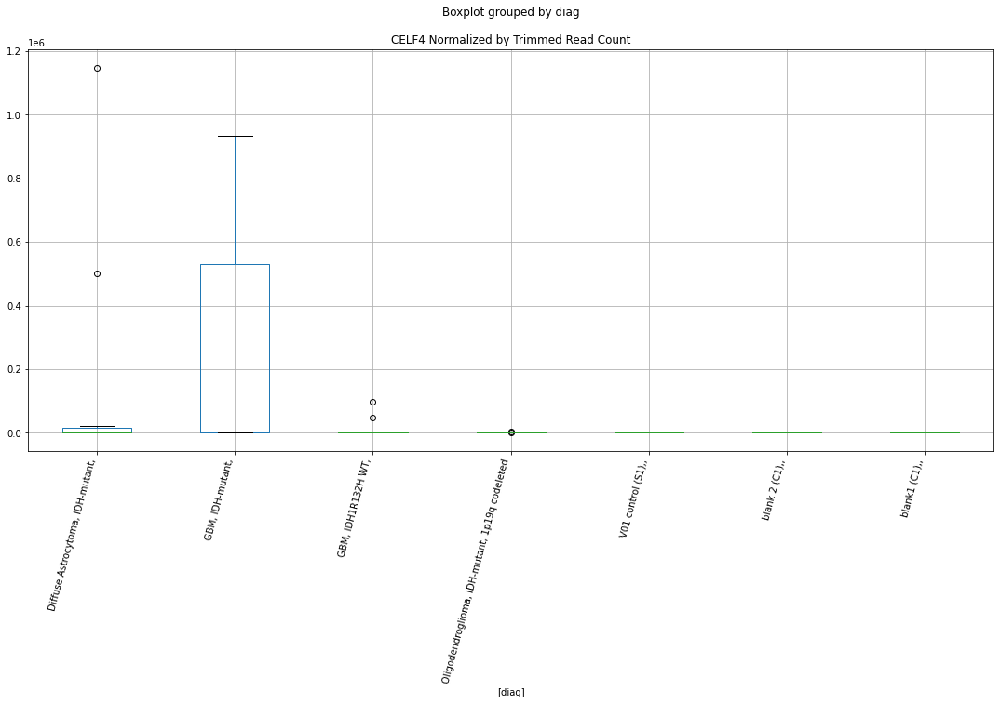

 p : 0.03455980449453065  ( t : 2.2864838096266453 ) :  Lexogen  :  cutadapt2  :  DCTN1-AS1
Control and blanks
82      4260.15
346    49872.98
Name: DCTN1-AS1, dtype: float64
214    1627.36
Name: DCTN1-AS1, dtype: float64
478    17809.54
Name: DCTN1-AS1, dtype: float64


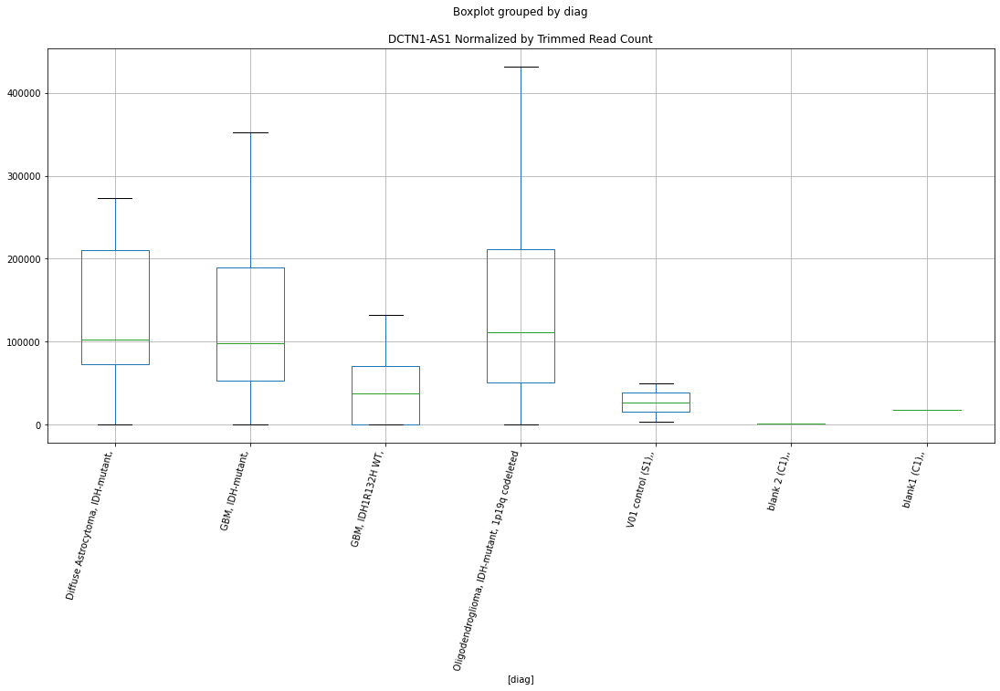

 p : 0.03464014061132422  ( t : 2.2853341810856853 ) :  D-plex  :  cutadapt2  :  ANKRD18DP
Control and blanks
76     0.0
340    0.0
Name: ANKRD18DP, dtype: float64
208    1410.88
Name: ANKRD18DP, dtype: float64
472    2311.82
Name: ANKRD18DP, dtype: float64


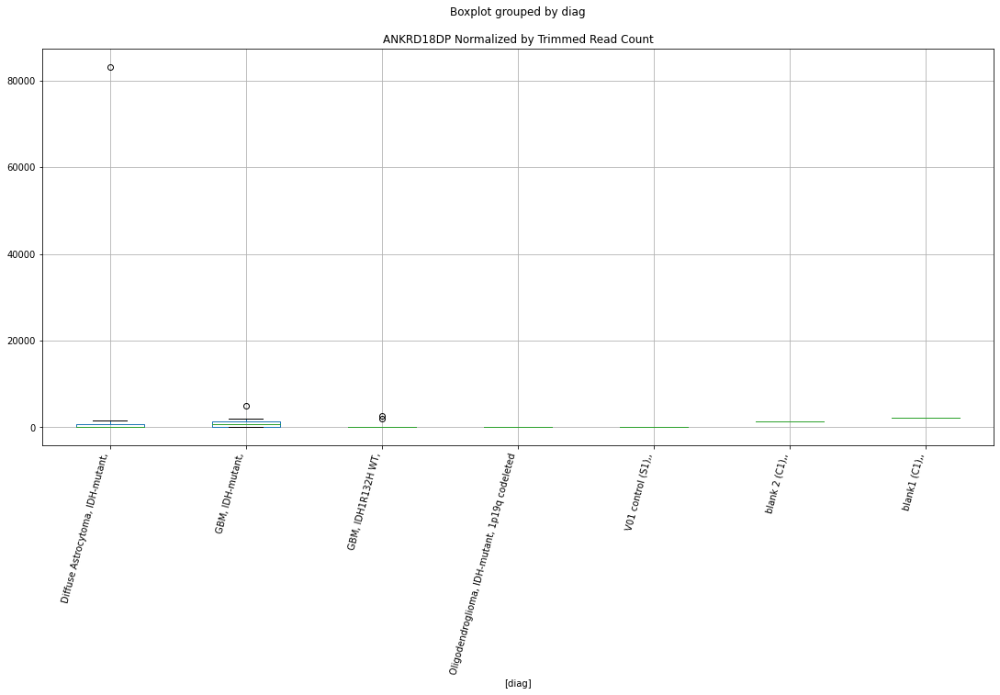

 p : 0.034663637940483175  ( t : 2.284998395432475 ) :  D-plex  :  cutadapt2  :  CPEB4
Control and blanks
76      4545.69
340    31706.36
Name: CPEB4, dtype: float64
208    15872.42
Name: CPEB4, dtype: float64
472    20806.41
Name: CPEB4, dtype: float64


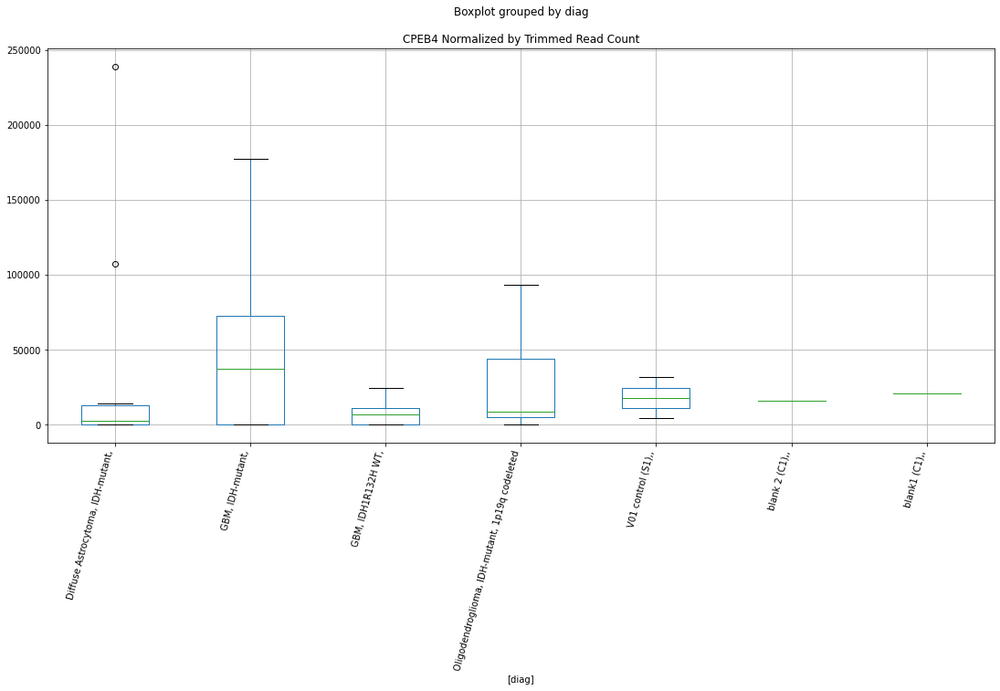

 p : 0.034673807355799564  ( t : 2.284853136005616 ) :  D-plex  :  cutadapt2  :  BCCIP
Control and blanks
76     0.0
340    0.0
Name: BCCIP, dtype: float64
208    176.36
Name: BCCIP, dtype: float64
472    0.0
Name: BCCIP, dtype: float64


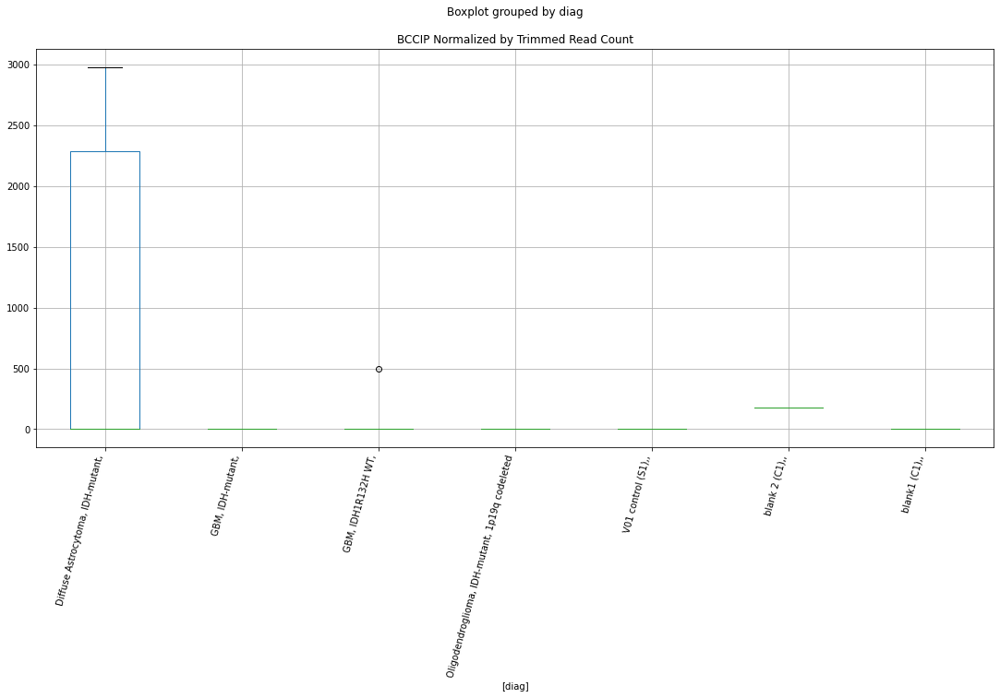

 p : 0.03469340382548864  ( t : 2.284573332199619 ) :  D-plex  :  bbduk2  :  BCCIP
Control and blanks
73     0.0
337    0.0
Name: BCCIP, dtype: float64
205    0.0
Name: BCCIP, dtype: float64
469    0.0
Name: BCCIP, dtype: float64


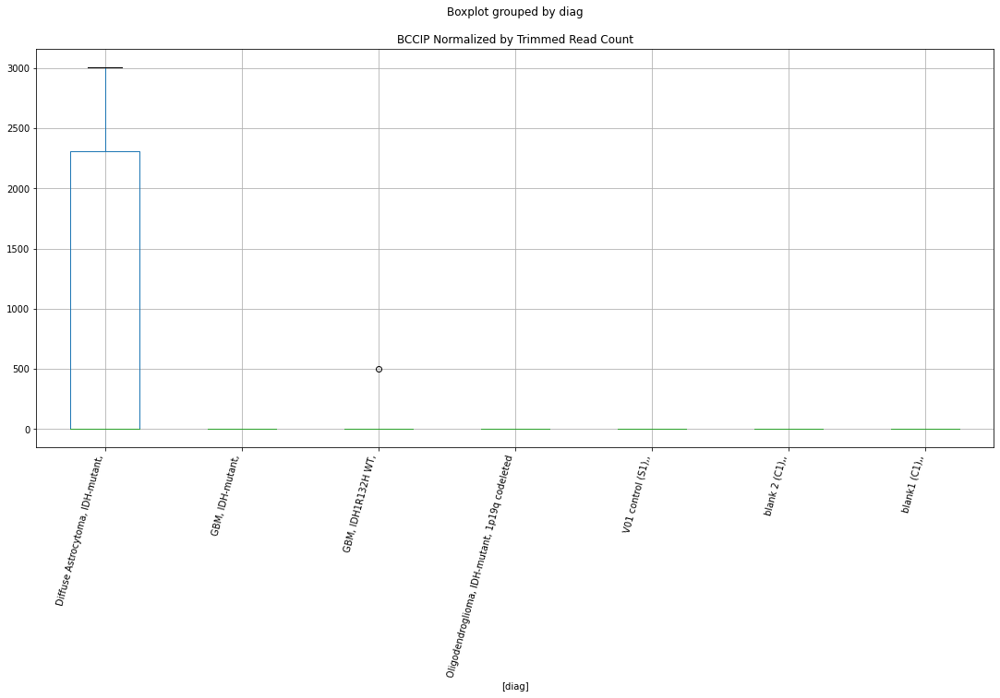

 p : 0.03473821638856325  ( t : 2.2839340355183806 ) :  D-plex  :  bbduk2  :  COX4I1
Control and blanks
73     773.01
337      0.00
Name: COX4I1, dtype: float64
205    895.45
Name: COX4I1, dtype: float64
469    5323.75
Name: COX4I1, dtype: float64


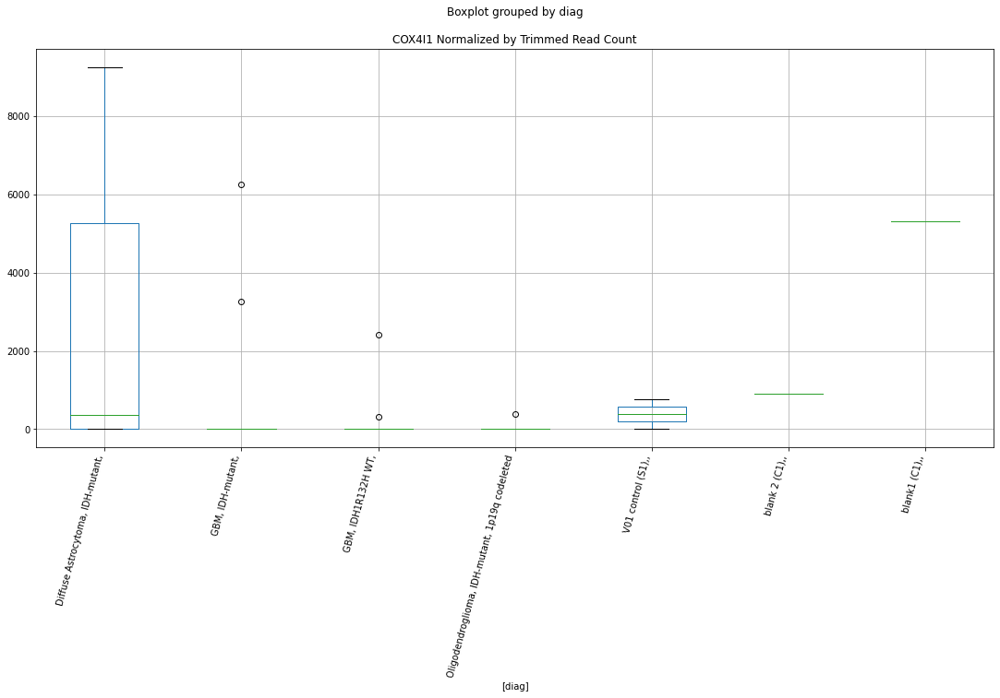

 p : 0.0347785751632189  ( t : 2.2833589297302077 ) :  D-plex  :  cutadapt2  :  DLX4
Control and blanks
76         0.00
340    33467.82
Name: DLX4, dtype: float64
208    2116.32
Name: DLX4, dtype: float64
472    577.96
Name: DLX4, dtype: float64


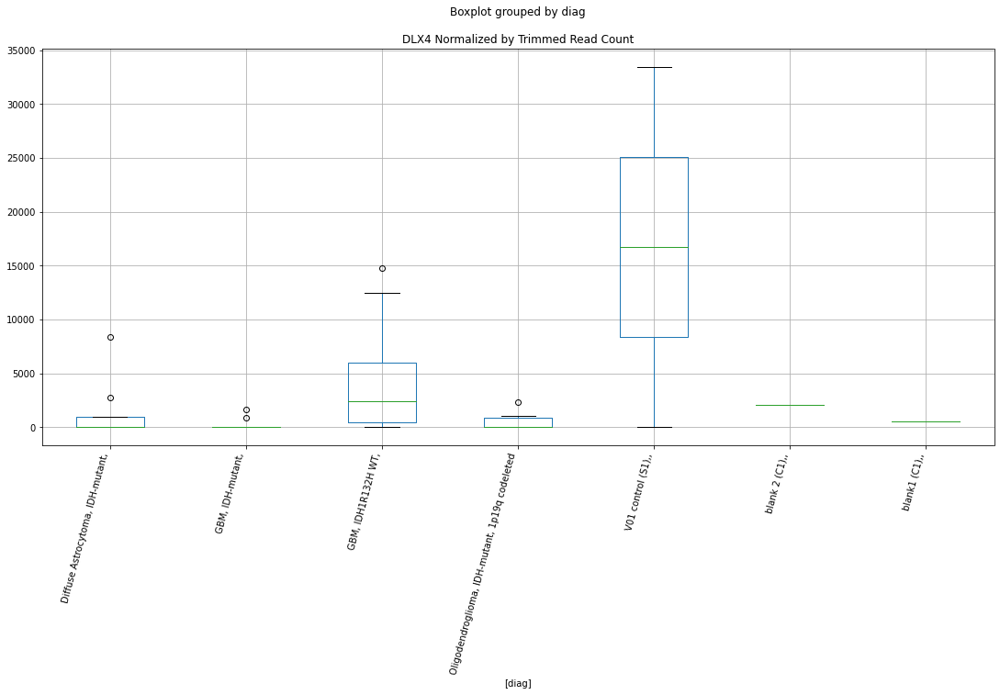

 p : 0.034794275884798505  ( t : 2.283135363981818 ) :  D-plex  :  bbduk2  :  CPXM2
Control and blanks
73         0.00
337    11572.04
Name: CPXM2, dtype: float64
205    6984.55
Name: CPXM2, dtype: float64
469    10055.96
Name: CPXM2, dtype: float64


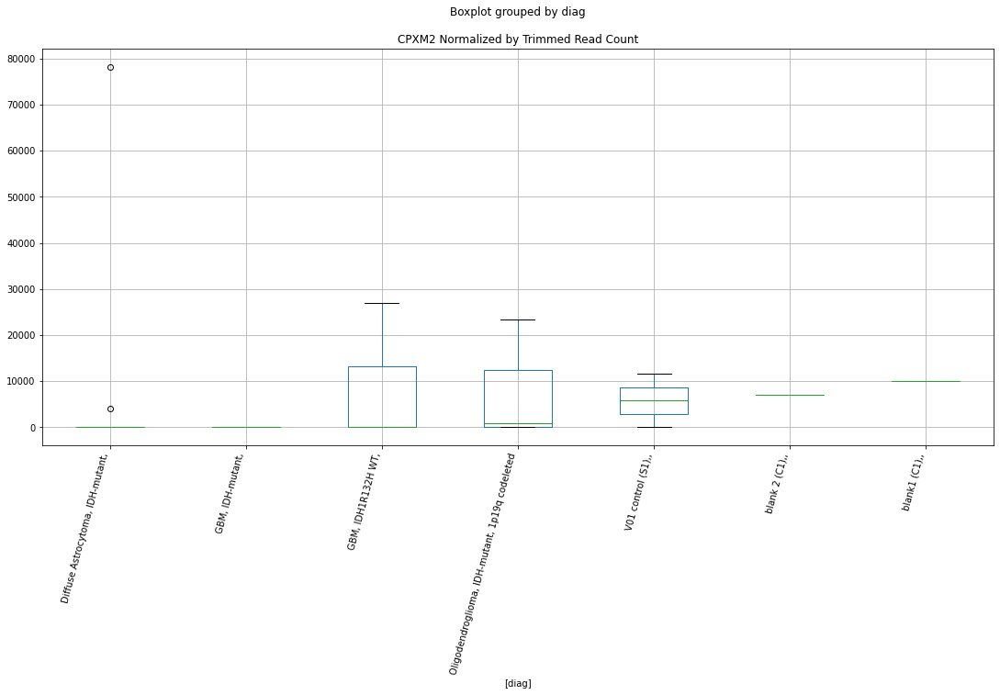

 p : 0.034872462606450355  ( t : 2.2820234359541707 ) :  D-plex  :  cutadapt2  :  CLCA4-AS1
Control and blanks
76     0.0
340    0.0
Name: CLCA4-AS1, dtype: float64
208    2821.76
Name: CLCA4-AS1, dtype: float64
472    3467.74
Name: CLCA4-AS1, dtype: float64


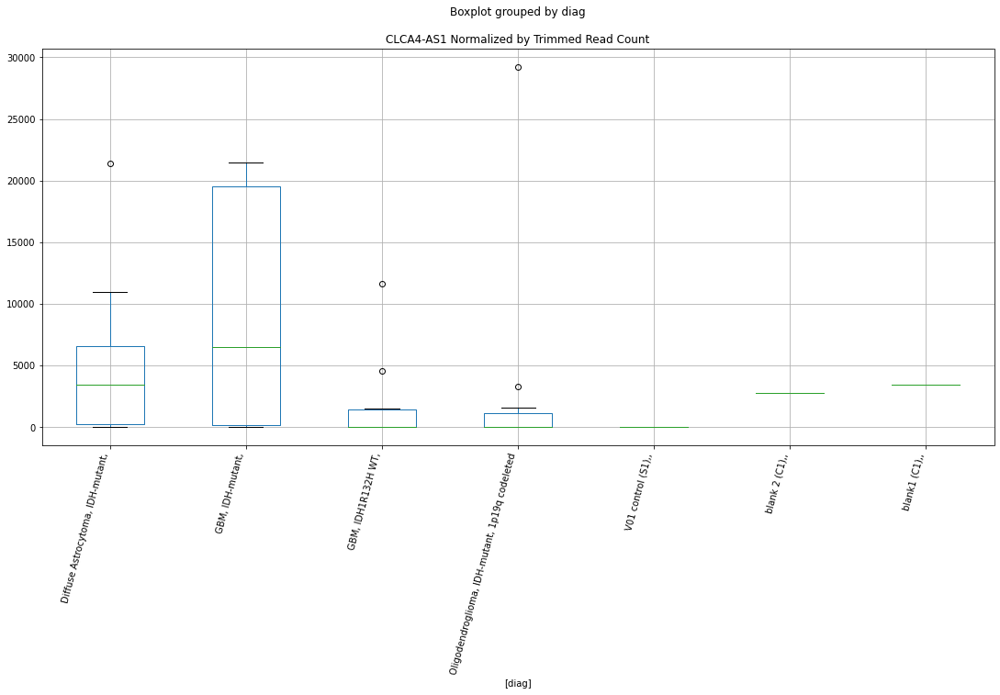

 p : 0.0349002715025421  ( t : 2.281628509581641 ) :  D-plex  :  bbduk2  :  CLN3
Control and blanks
73         0.00
337    45398.02
Name: CLN3, dtype: float64
205    1611.82
Name: CLN3, dtype: float64
469    3549.16
Name: CLN3, dtype: float64


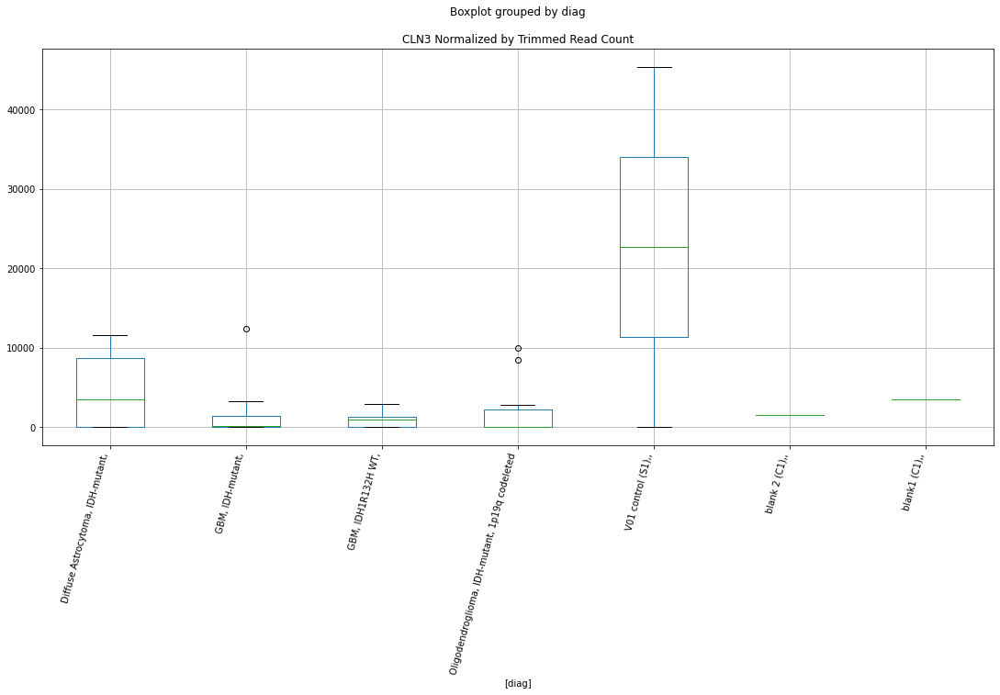

 p : 0.03492128198951457  ( t : 2.281330323516948 ) :  D-plex  :  cutadapt2  :  ARV1
Control and blanks
76     0.0
340    0.0
Name: ARV1, dtype: float64
208    0.0
Name: ARV1, dtype: float64
472    0.0
Name: ARV1, dtype: float64


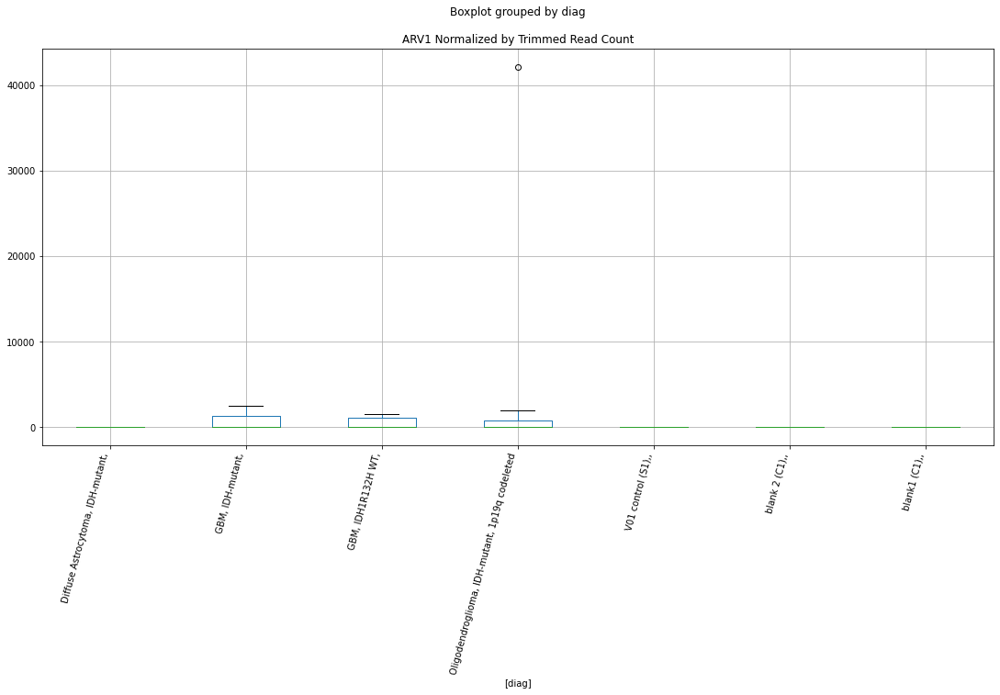

 p : 0.03492773945743323  ( t : 2.281238710882364 ) :  D-plex  :  cutadapt2  :  ATP6V0E2-AS1
Control and blanks
76     0.0
340    0.0
Name: ATP6V0E2-AS1, dtype: float64
208    0.0
Name: ATP6V0E2-AS1, dtype: float64
472    0.0
Name: ATP6V0E2-AS1, dtype: float64


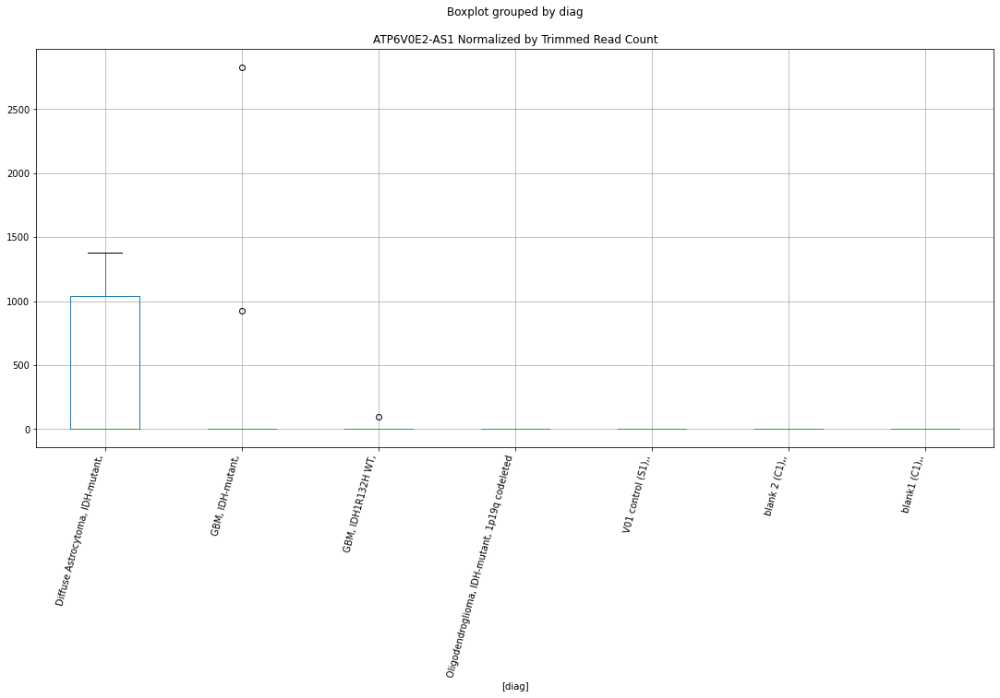

 p : 0.035073038256852415  ( t : 2.279181478237446 ) :  Lexogen  :  bbduk2  :  BRD3OS
Control and blanks
79       0.00
343    212.31
Name: BRD3OS, dtype: float64
211    0.0
Name: BRD3OS, dtype: float64
475    0.0
Name: BRD3OS, dtype: float64


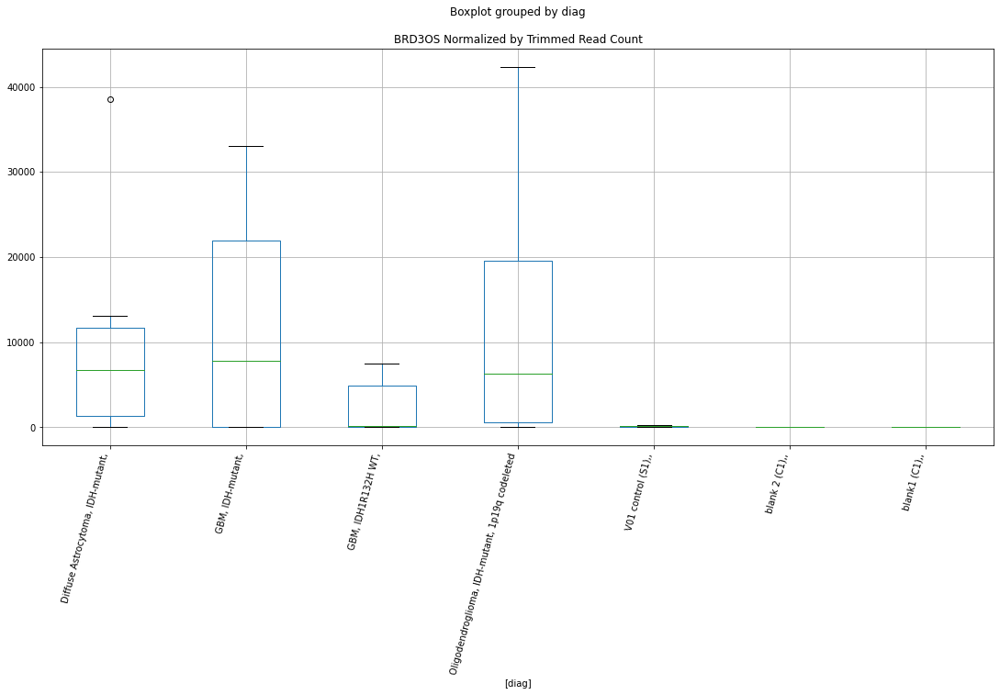

 p : 0.03508430218669353  ( t : 2.2790223259471696 ) :  D-plex  :  bbduk2  :  B4GALNT2
Control and blanks
73     51018.55
337        0.00
Name: B4GALNT2, dtype: float64
205    7163.64
Name: B4GALNT2, dtype: float64
469    7689.86
Name: B4GALNT2, dtype: float64


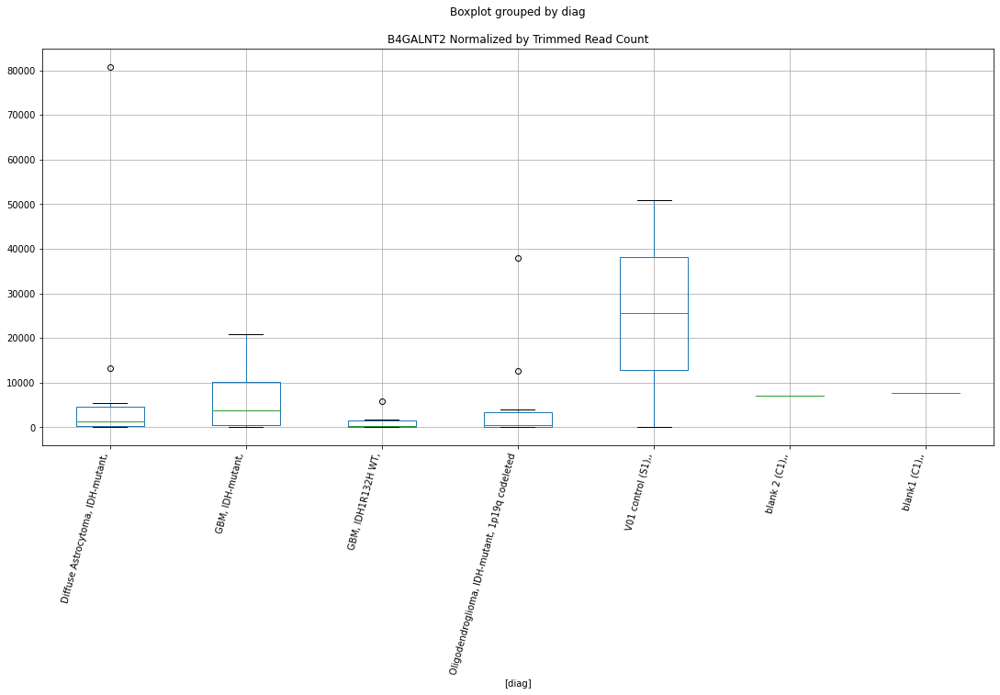

 p : 0.03518298772262308  ( t : 2.277629979128453 ) :  D-plex  :  bbduk2  :  CCDC144NL
Control and blanks
73     0.0
337    0.0
Name: CCDC144NL, dtype: float64
205    0.0
Name: CCDC144NL, dtype: float64
469    591.53
Name: CCDC144NL, dtype: float64


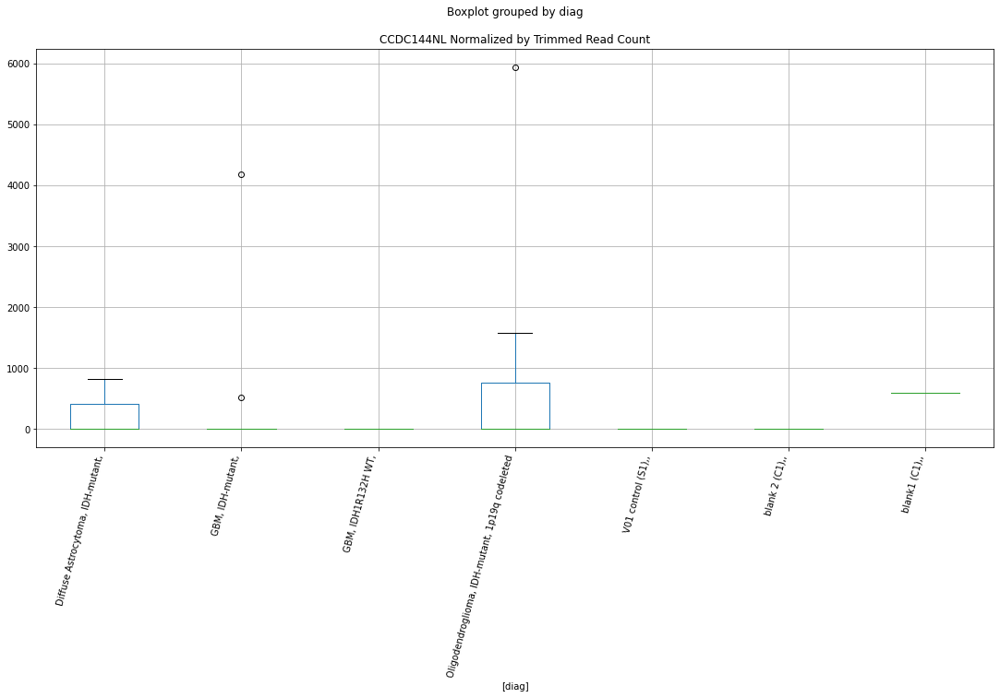

 p : 0.03521373891090564  ( t : 2.2771968513042635 ) :  D-plex  :  cutadapt2  :  CPXM2
Control and blanks
76         0.00
340    11449.52
Name: CPXM2, dtype: float64
208    6878.05
Name: CPXM2, dtype: float64
472    21962.32
Name: CPXM2, dtype: float64


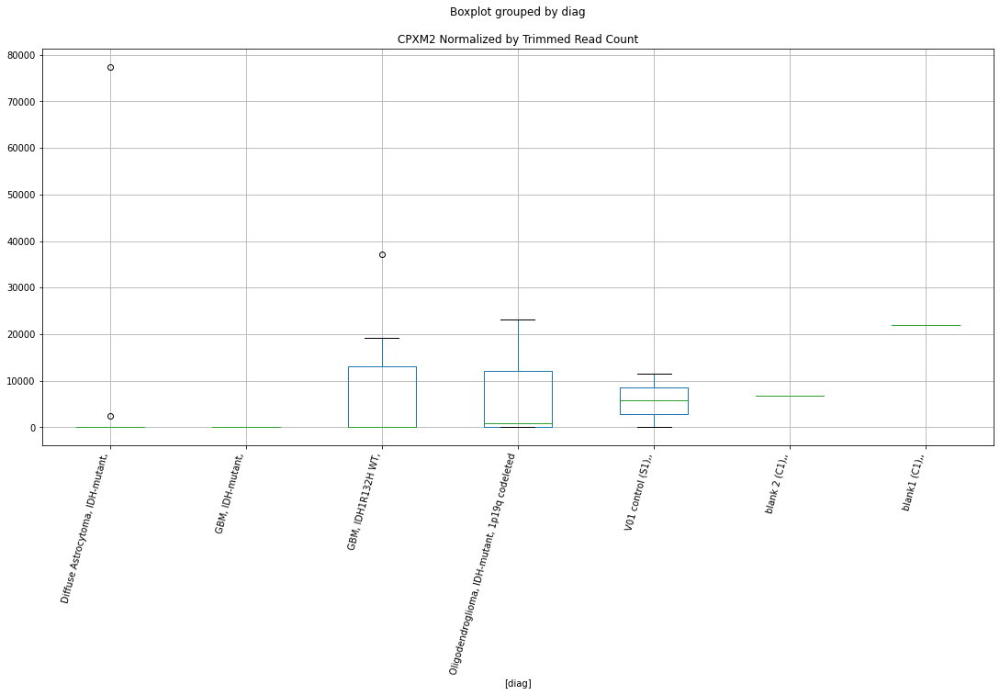

 p : 0.03522552284498665  ( t : 2.2770309683504166 ) :  D-plex  :  bbduk2  :  ANKRD44
Control and blanks
73     0.0
337    0.0
Name: ANKRD44, dtype: float64
205    6268.18
Name: ANKRD44, dtype: float64
469    0.0
Name: ANKRD44, dtype: float64


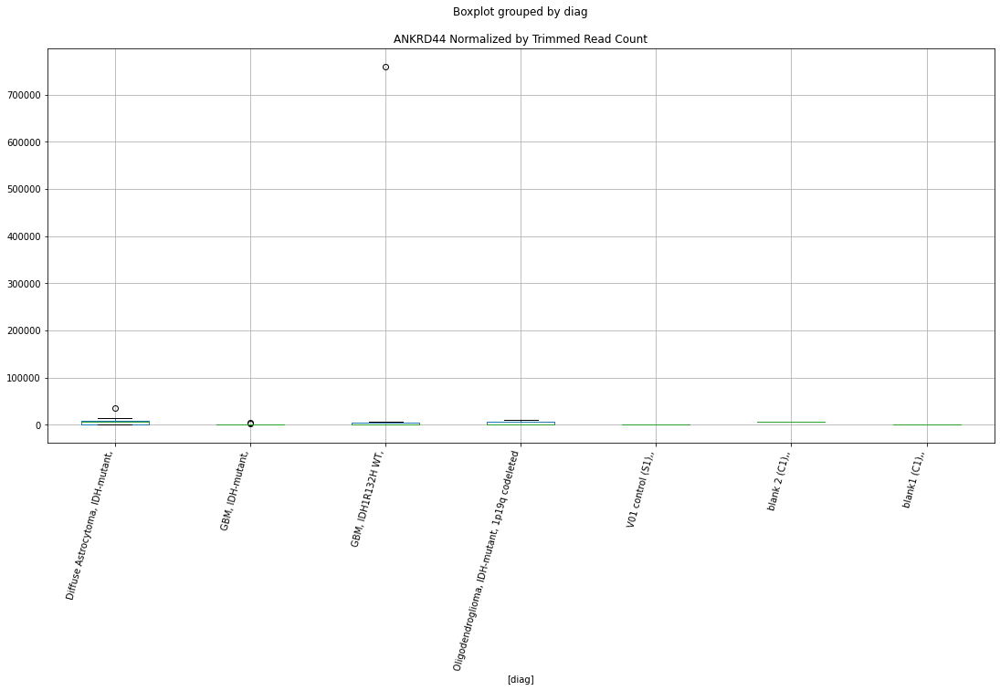

 p : 0.03529914418964259  ( t : 2.275995758290782 ) :  D-plex  :  cutadapt2  :  BTBD17
Control and blanks
76     2272.84
340       0.00
Name: BTBD17, dtype: float64
208    529.08
Name: BTBD17, dtype: float64
472    0.0
Name: BTBD17, dtype: float64


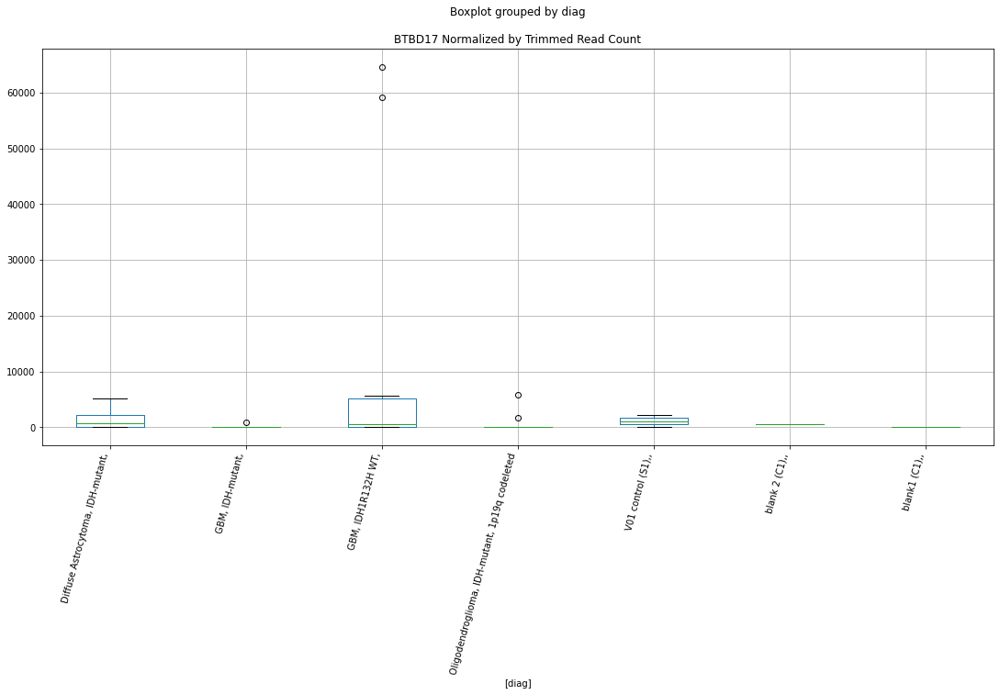

 p : 0.035304001230626776  ( t : 2.275927532349545 ) :  Lexogen  :  cutadapt2  :  CYGB
Control and blanks
82     0.0
346    0.0
Name: CYGB, dtype: float64
214    0.0
Name: CYGB, dtype: float64
478    0.0
Name: CYGB, dtype: float64


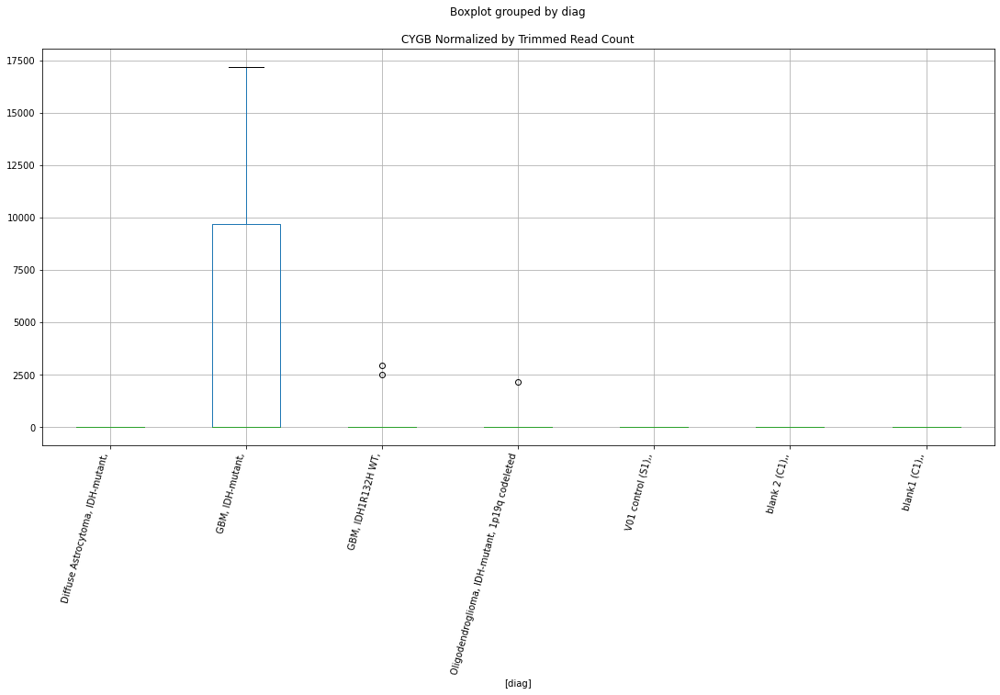

 p : 0.03530663782924339  ( t : 2.275890500180666 ) :  D-plex  :  bbduk2  :  CLCC1
Control and blanks
73     0.0
337    0.0
Name: CLCC1, dtype: float64
205    1432.73
Name: CLCC1, dtype: float64
469    0.0
Name: CLCC1, dtype: float64


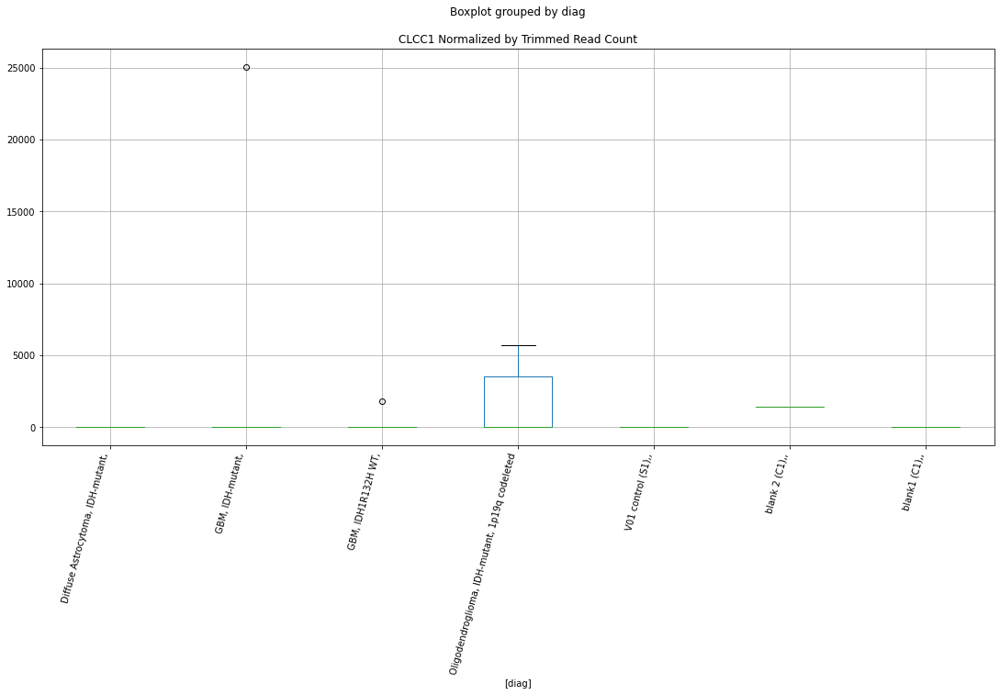

 p : 0.03534504678764886  ( t : 2.2753513196132924 ) :  D-plex  :  bbduk2  :  ANKRD12
Control and blanks
73     16233.18
337        0.00
Name: ANKRD12, dtype: float64
205    8059.09
Name: ANKRD12, dtype: float64
469    3549.16
Name: ANKRD12, dtype: float64


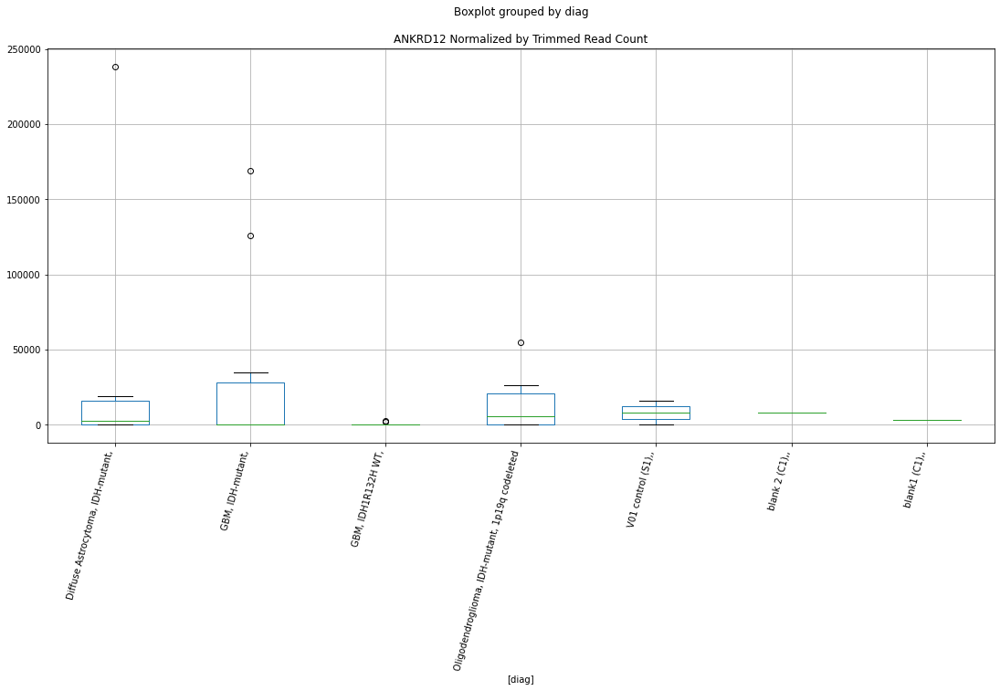

 p : 0.035401073879196124  ( t : 2.274565788823513 ) :  Lexogen  :  bbduk2  :  ACOXL
Control and blanks
79     0.0
343    0.0
Name: ACOXL, dtype: float64
211    0.0
Name: ACOXL, dtype: float64
475    0.0
Name: ACOXL, dtype: float64


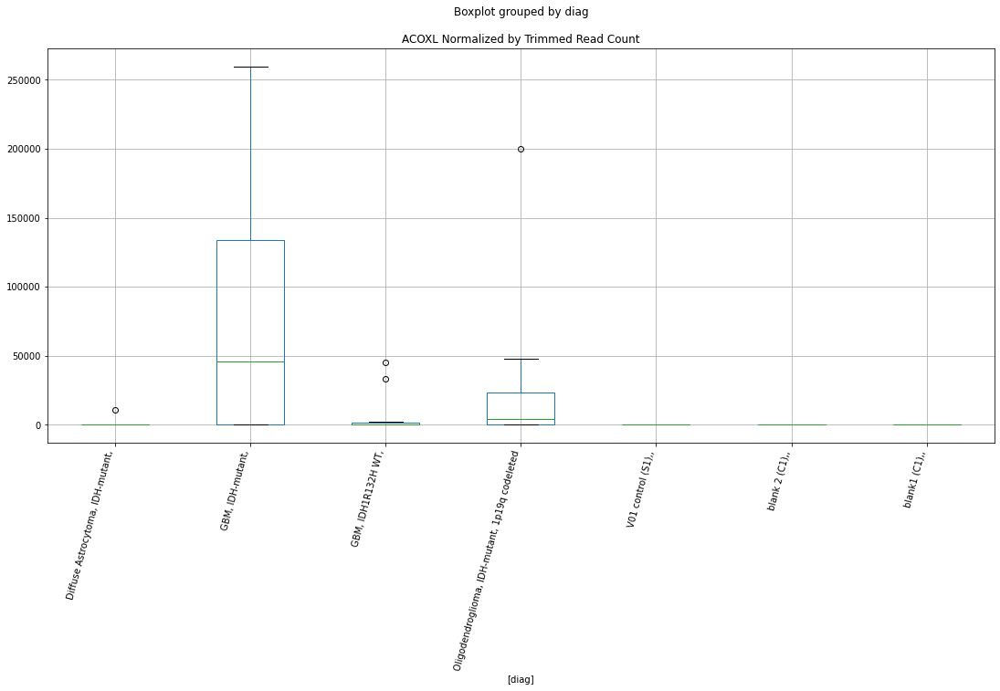

 p : 0.03541622426083717  ( t : 2.2743535696222272 ) :  D-plex  :  cutadapt2  :  ANKRD44
Control and blanks
76     0.0
340    0.0
Name: ANKRD44, dtype: float64
208    6172.61
Name: ANKRD44, dtype: float64
472    0.0
Name: ANKRD44, dtype: float64


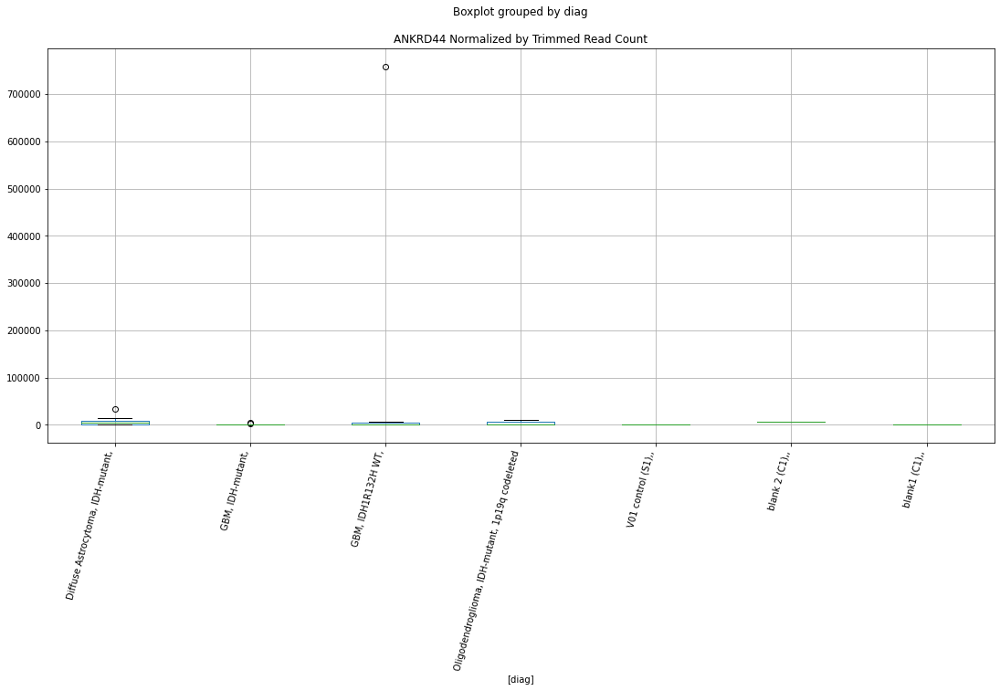

 p : 0.0354458122983548  ( t : 2.2739393567482384 ) :  Lexogen  :  bbduk2  :  CYGB
Control and blanks
79     0.0
343    0.0
Name: CYGB, dtype: float64
211    0.0
Name: CYGB, dtype: float64
475    0.0
Name: CYGB, dtype: float64


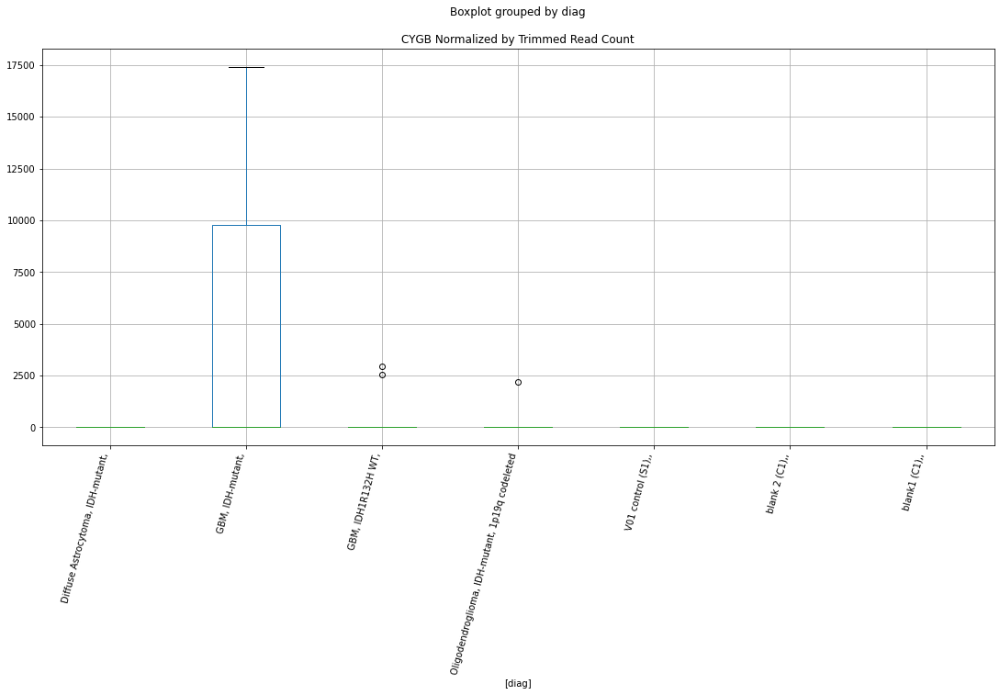

 p : 0.03550765570118921  ( t : 2.273074621923521 ) :  D-plex  :  bbduk2  :  COX7A2L
Control and blanks
73      3092.03
337    35606.29
Name: COX7A2L, dtype: float64
205    19520.91
Name: COX7A2L, dtype: float64
469    26618.73
Name: COX7A2L, dtype: float64


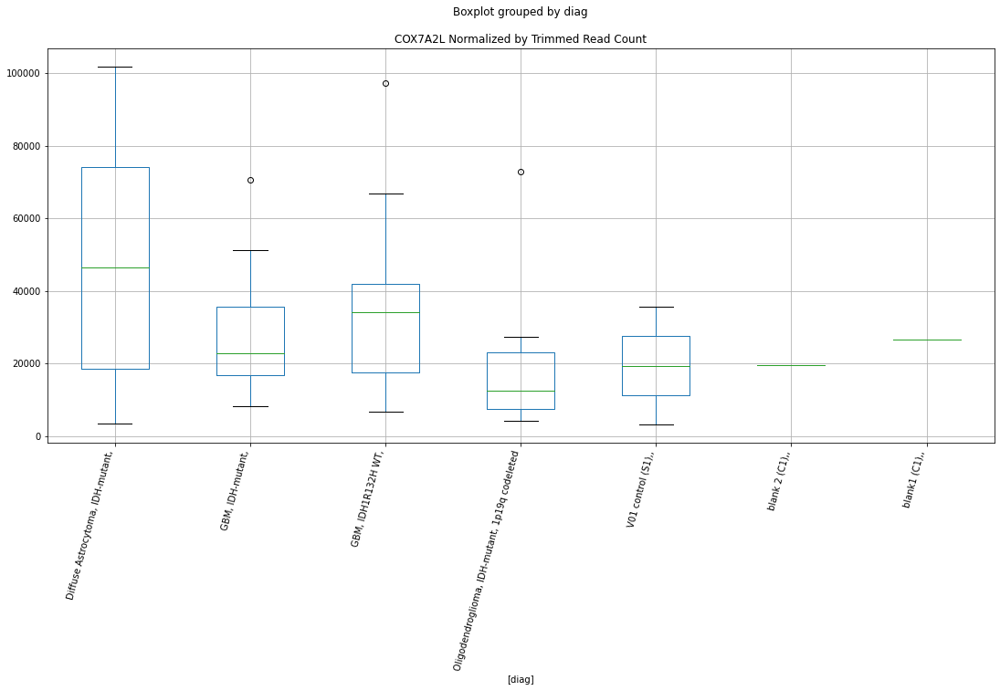

 p : 0.035535687131915725  ( t : 2.2726831268368404 ) :  D-plex  :  cutadapt2  :  C16orf54
Control and blanks
76        0.00
340    7926.59
Name: C16orf54, dtype: float64
208    529.08
Name: C16orf54, dtype: float64
472    2311.82
Name: C16orf54, dtype: float64


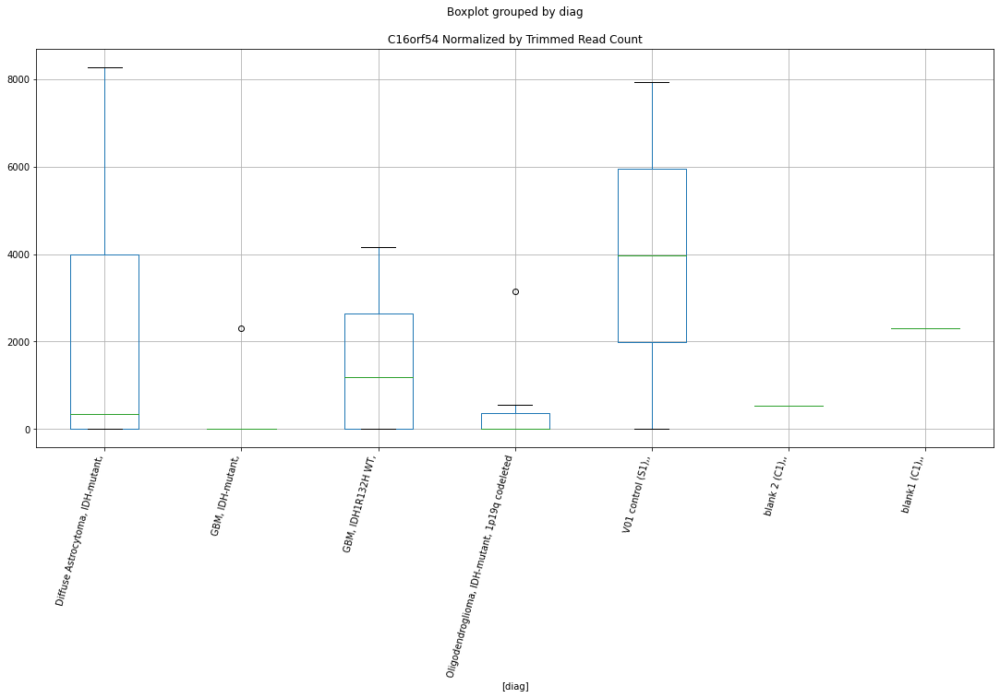

 p : 0.035553053988425634  ( t : 2.272440719543287 ) :  D-plex  :  bbduk2  :  CBLL2
Control and blanks
73     0.0
337    0.0
Name: CBLL2, dtype: float64
205    179.09
Name: CBLL2, dtype: float64
469    591.53
Name: CBLL2, dtype: float64


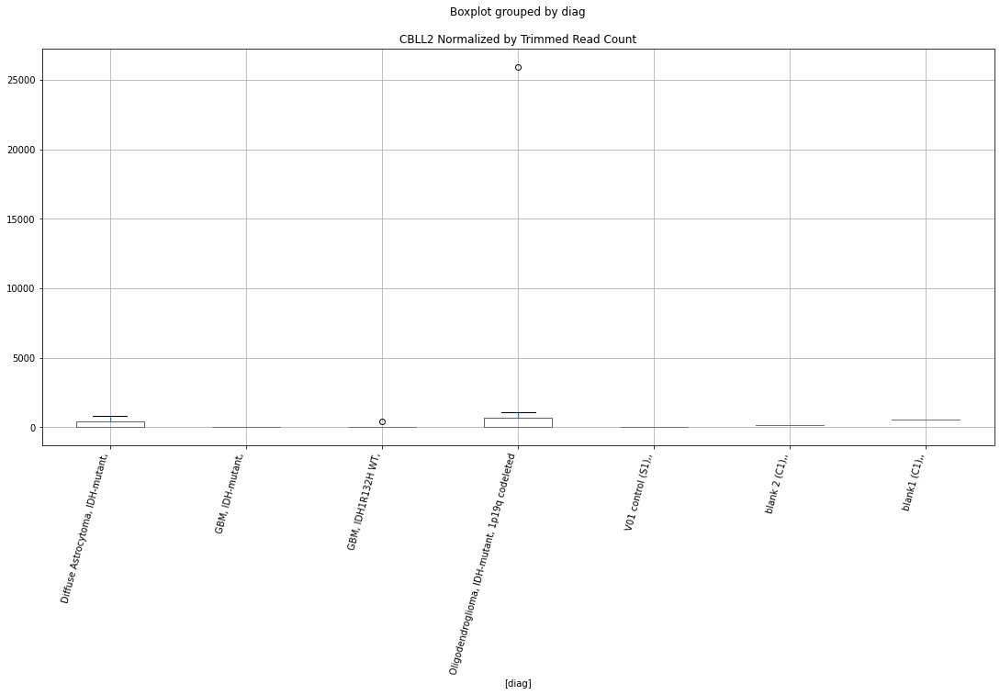

 p : 0.03558087327935999  ( t : 2.272052644841368 ) :  D-plex  :  cutadapt2  :  CH17-125A10.2
Control and blanks
76     0.0
340    0.0
Name: CH17-125A10.2, dtype: float64
208    8112.57
Name: CH17-125A10.2, dtype: float64
472    23118.23
Name: CH17-125A10.2, dtype: float64


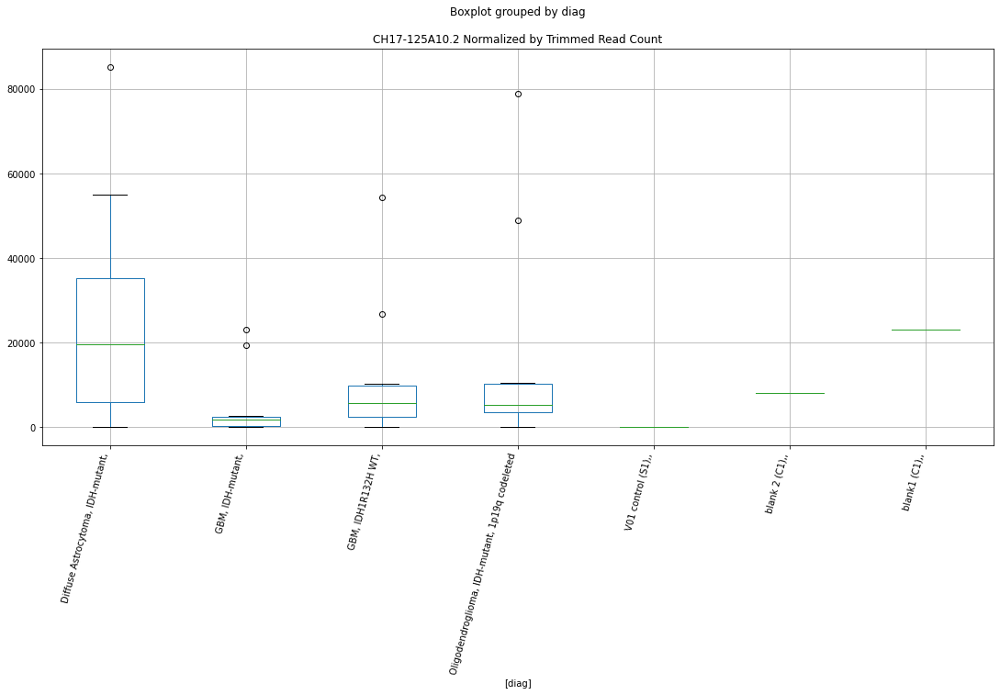

 p : 0.03559640908348277  ( t : 2.271836044918719 ) :  Lexogen  :  cutadapt2  :  CTXND1
Control and blanks
82         0.00
346    16413.89
Name: CTXND1, dtype: float64
214    0.0
Name: CTXND1, dtype: float64
478    0.0
Name: CTXND1, dtype: float64


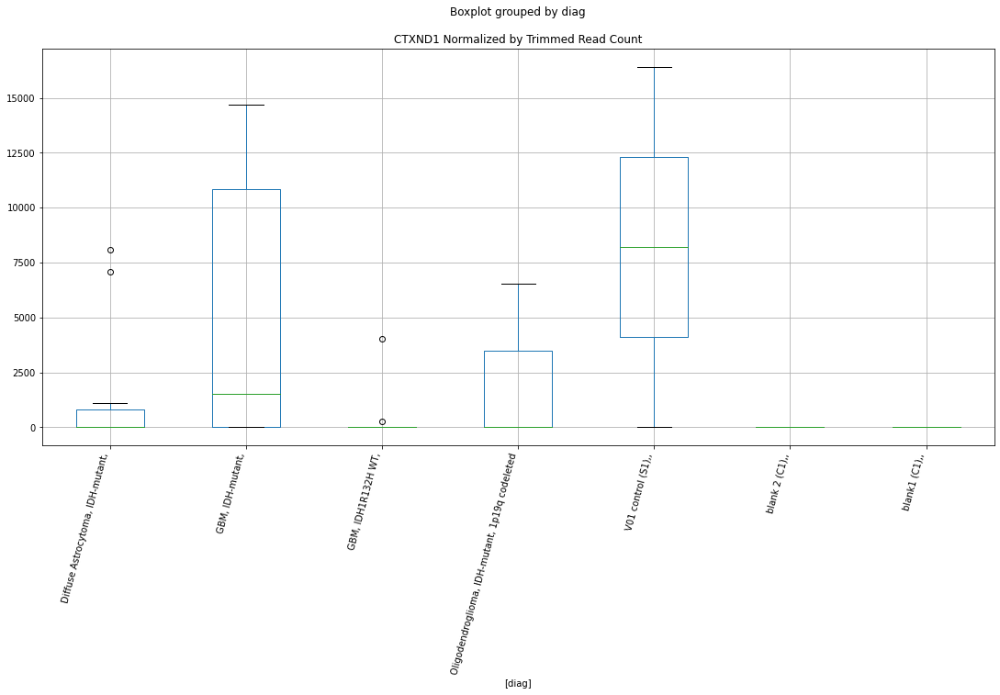

 p : 0.03564236680895085  ( t : 2.271195814470312 ) :  Lexogen  :  cutadapt2  :  ASB16
Control and blanks
82     0.0
346    0.0
Name: ASB16, dtype: float64
214    0.0
Name: ASB16, dtype: float64
478    0.0
Name: ASB16, dtype: float64


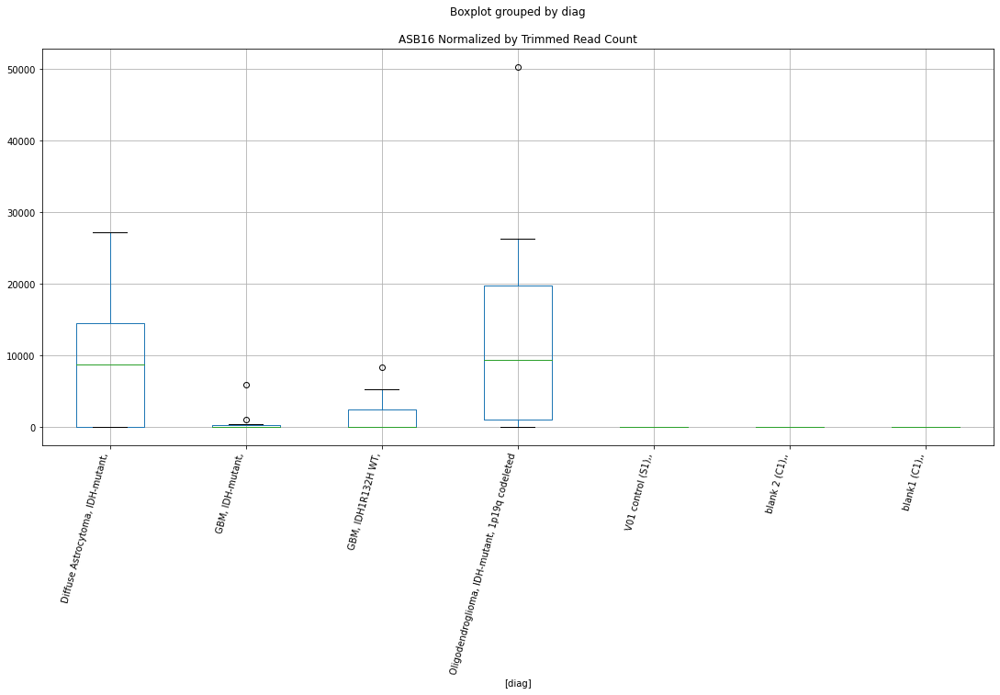

 p : 0.03566513715271929  ( t : 2.2708788868407446 ) :  D-plex  :  cutadapt2  :  AACSP1
Control and blanks
76     0.0
340    0.0
Name: AACSP1, dtype: float64
208    0.0
Name: AACSP1, dtype: float64
472    577.96
Name: AACSP1, dtype: float64


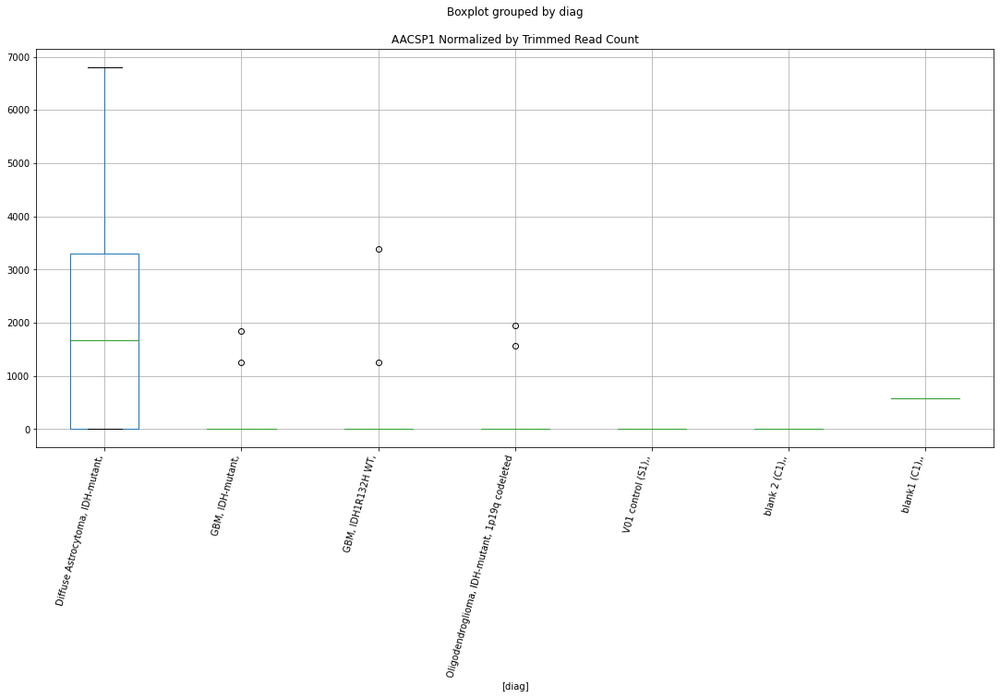

 p : 0.03570716364925939  ( t : 2.2702944346369898 ) :  D-plex  :  bbduk2  :  BNIPL
Control and blanks
73     4638.05
337       0.00
Name: BNIPL, dtype: float64
205    1074.55
Name: BNIPL, dtype: float64
469    5915.27
Name: BNIPL, dtype: float64


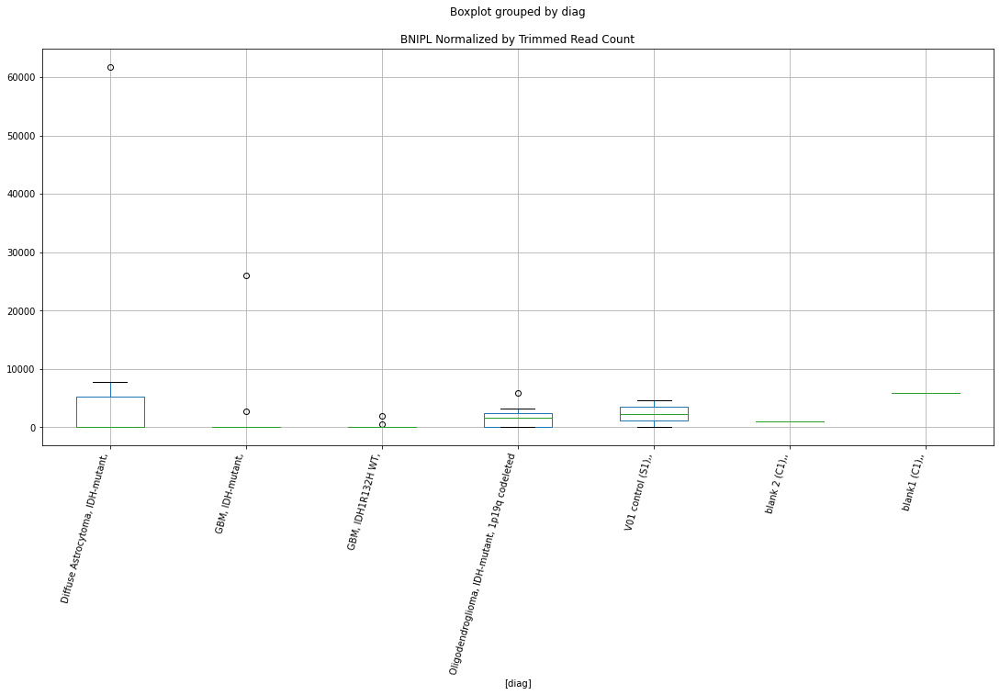

 p : 0.03579234567027903  ( t : 2.269111777496796 ) :  Lexogen  :  cutadapt2  :  CHRD
Control and blanks
82     0.0
346    0.0
Name: CHRD, dtype: float64
214    5153.3
Name: CHRD, dtype: float64
478    0.0
Name: CHRD, dtype: float64


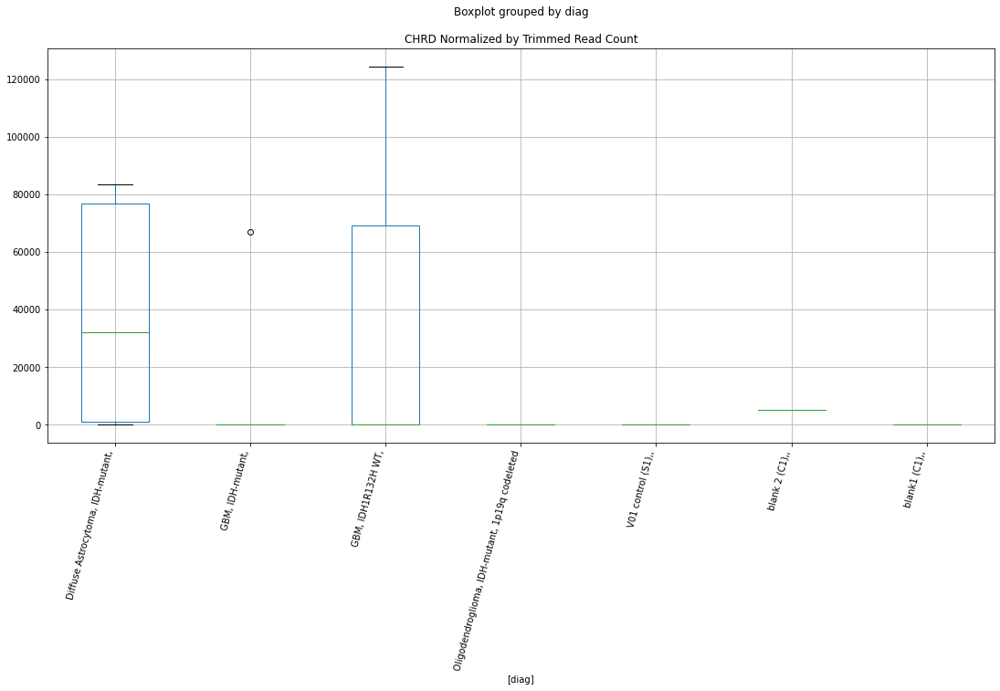

 p : 0.03582112659800811  ( t : 2.2687127745647238 ) :  Lexogen  :  bbduk2  :  CHRD
Control and blanks
79     0.0
343    0.0
Name: CHRD, dtype: float64
211    5192.82
Name: CHRD, dtype: float64
475    0.0
Name: CHRD, dtype: float64


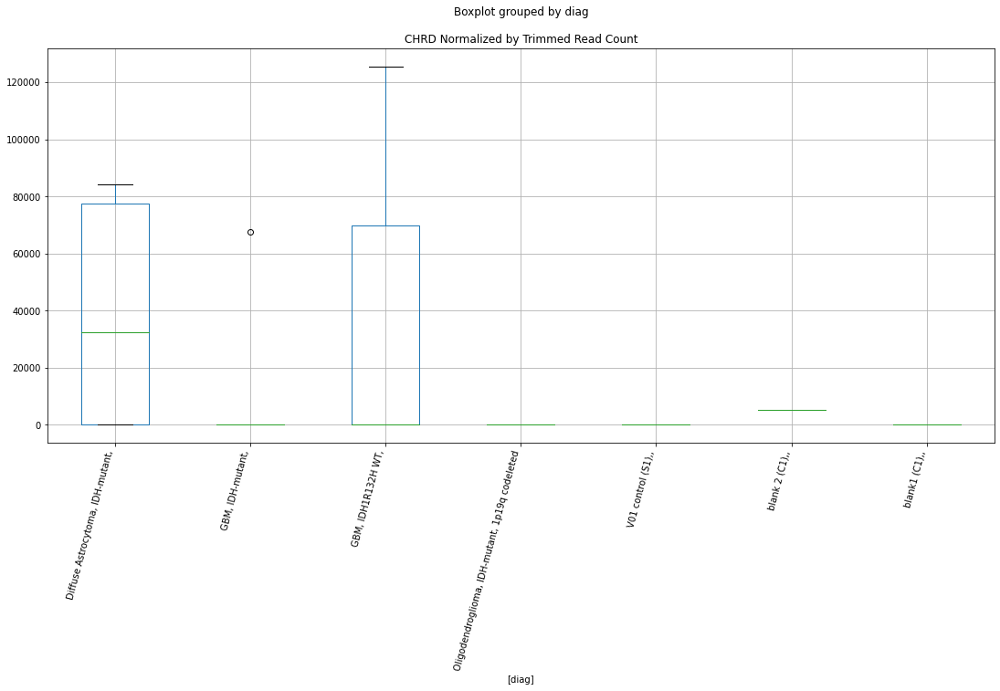

 p : 0.03586718839093115  ( t : 2.268074815517488 ) :  D-plex  :  bbduk2  :  CERCAM
Control and blanks
73     0.0
337    0.0
Name: CERCAM, dtype: float64
205    3760.91
Name: CERCAM, dtype: float64
469    0.0
Name: CERCAM, dtype: float64


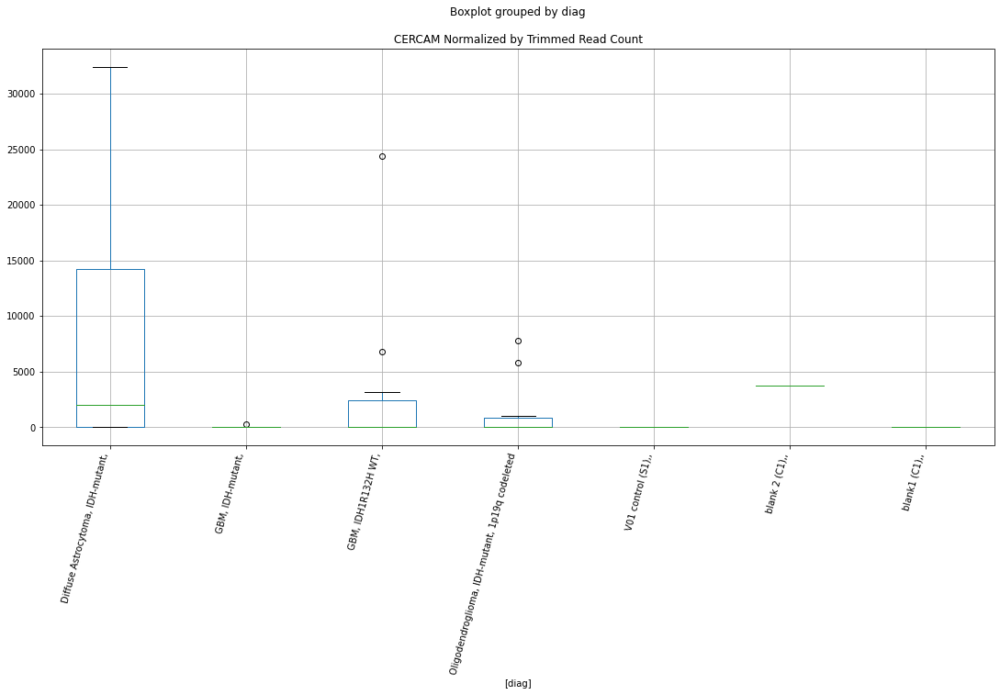

 p : 0.036006518584576444  ( t : 2.2661496822502545 ) :  Lexogen  :  bbduk2  :  ABHD14B
Control and blanks
79         0.00
343    24840.77
Name: ABHD14B, dtype: float64
211    13118.7
Name: ABHD14B, dtype: float64
475    24430.61
Name: ABHD14B, dtype: float64


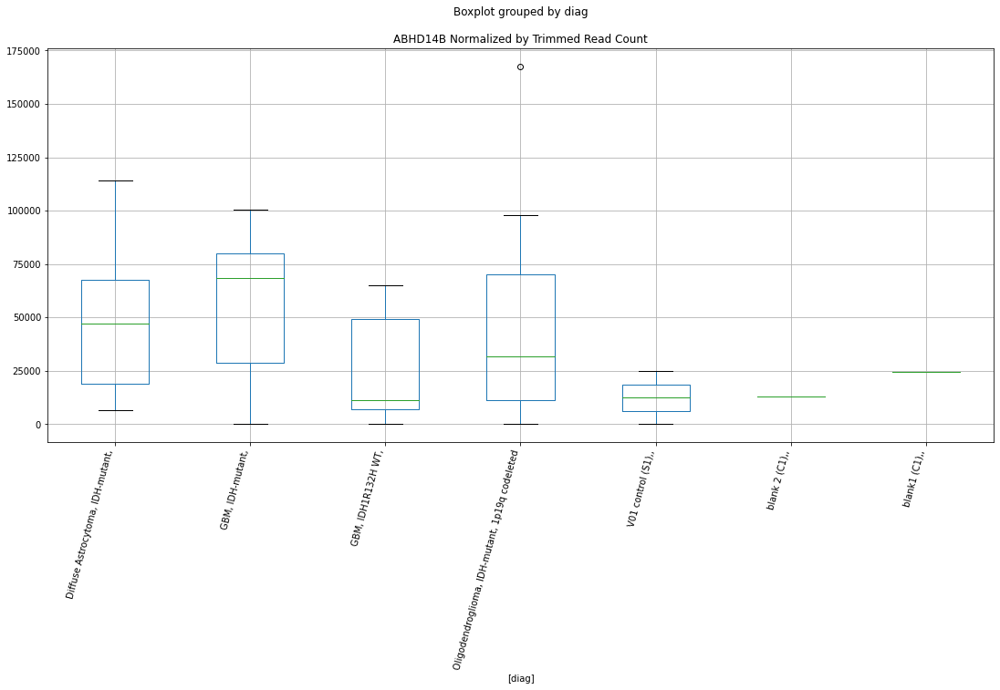

 p : 0.03609385286591643  ( t : 2.2649464869379337 ) :  D-plex  :  bbduk2  :  A4GALT
Control and blanks
73     0.0
337    0.0
Name: A4GALT, dtype: float64
205    716.36
Name: A4GALT, dtype: float64
469    1183.05
Name: A4GALT, dtype: float64


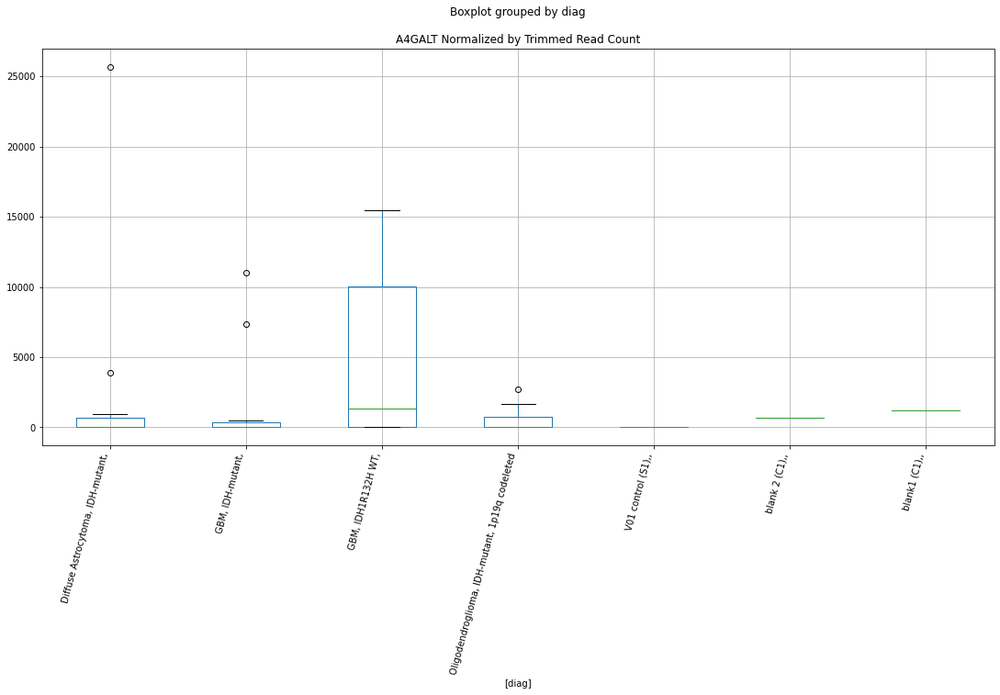

 p : 0.036163485211331316  ( t : 2.263989095532864 ) :  D-plex  :  bbduk2  :  CNGA4
Control and blanks
73     2319.03
337       0.00
Name: CNGA4, dtype: float64
205    6626.37
Name: CNGA4, dtype: float64
469    5915.27
Name: CNGA4, dtype: float64


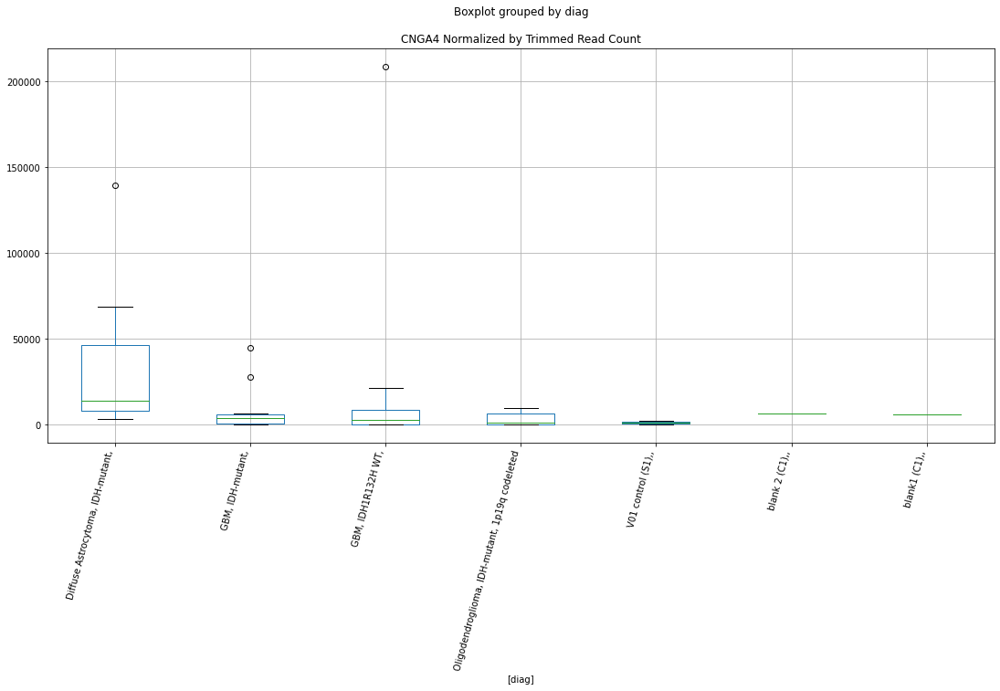

 p : 0.03622400885334871  ( t : 2.2631583245898304 ) :  Lexogen  :  bbduk2  :  ALDH2
Control and blanks
79     0.0
343    0.0
Name: ALDH2, dtype: float64
211    0.0
Name: ALDH2, dtype: float64
475    0.0
Name: ALDH2, dtype: float64


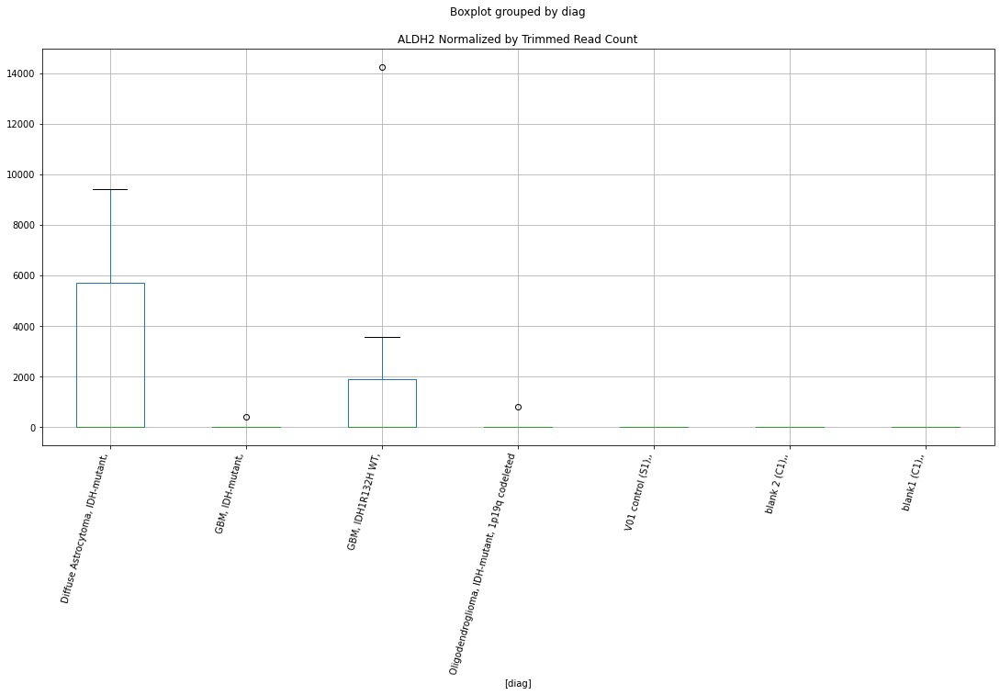

 p : 0.03623512952469759  ( t : 2.2630058174444296 ) :  Lexogen  :  bbduk2  :  CATSPERD
Control and blanks
79        0.00
343    2123.14
Name: CATSPERD, dtype: float64
211    27330.63
Name: CATSPERD, dtype: float64
475    0.0
Name: CATSPERD, dtype: float64


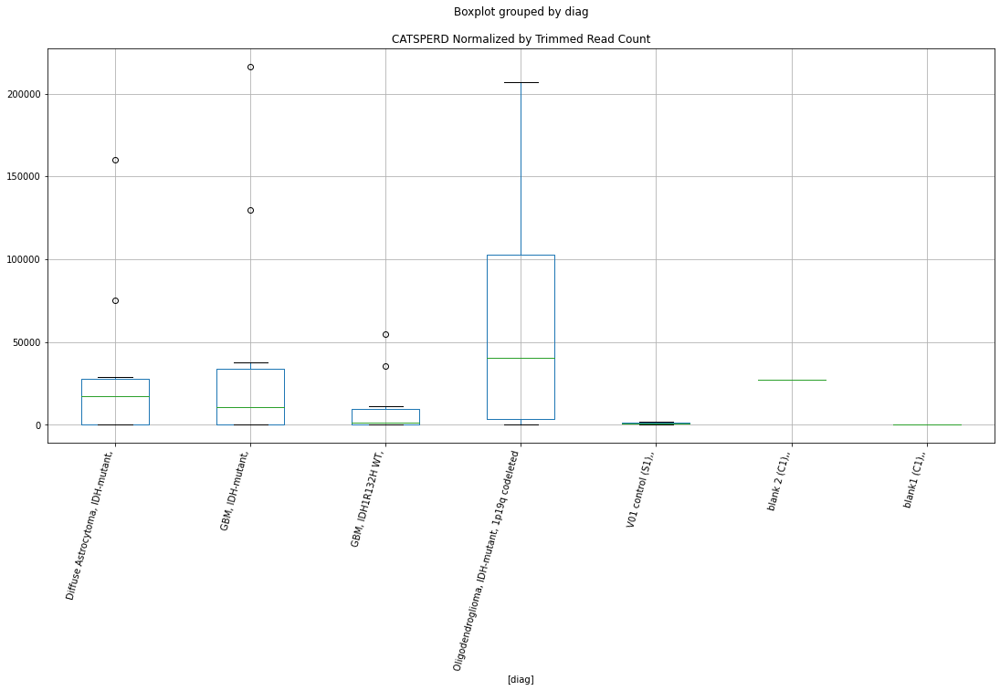

 p : 0.03624881243251089  ( t : 2.2628182315183665 ) :  D-plex  :  cutadapt2  :  CPED1
Control and blanks
76     0.0
340    0.0
Name: CPED1, dtype: float64
208    0.0
Name: CPED1, dtype: float64
472    1155.91
Name: CPED1, dtype: float64


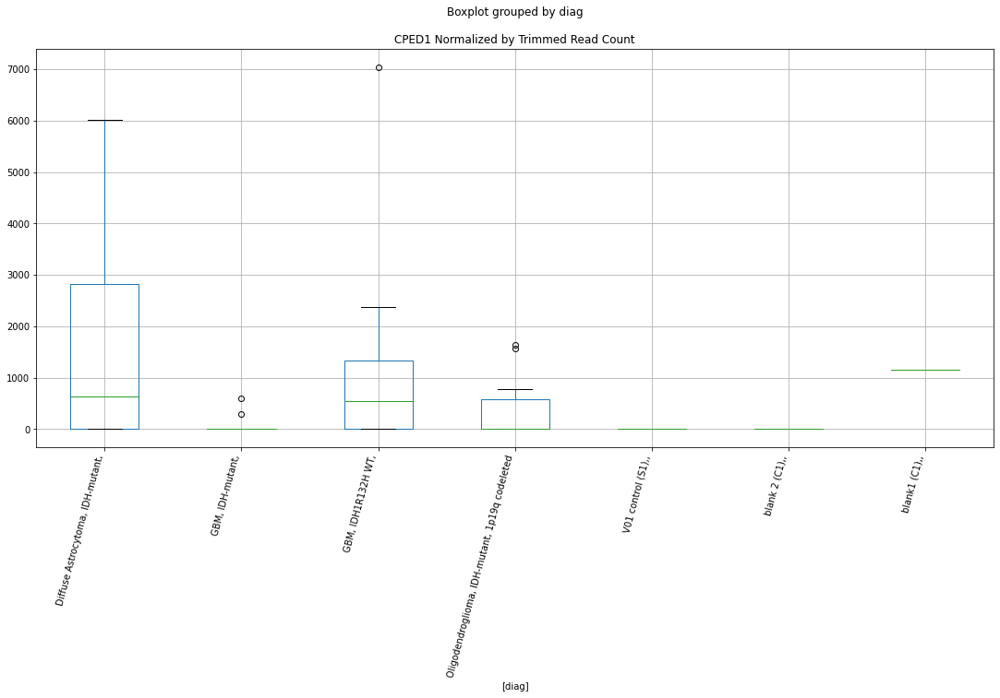

 p : 0.03627512136890931  ( t : 2.262457732717997 ) :  D-plex  :  bbduk2  :  ANO6
Control and blanks
73     0.0
337    0.0
Name: ANO6, dtype: float64
205    94022.75
Name: ANO6, dtype: float64
469    0.0
Name: ANO6, dtype: float64


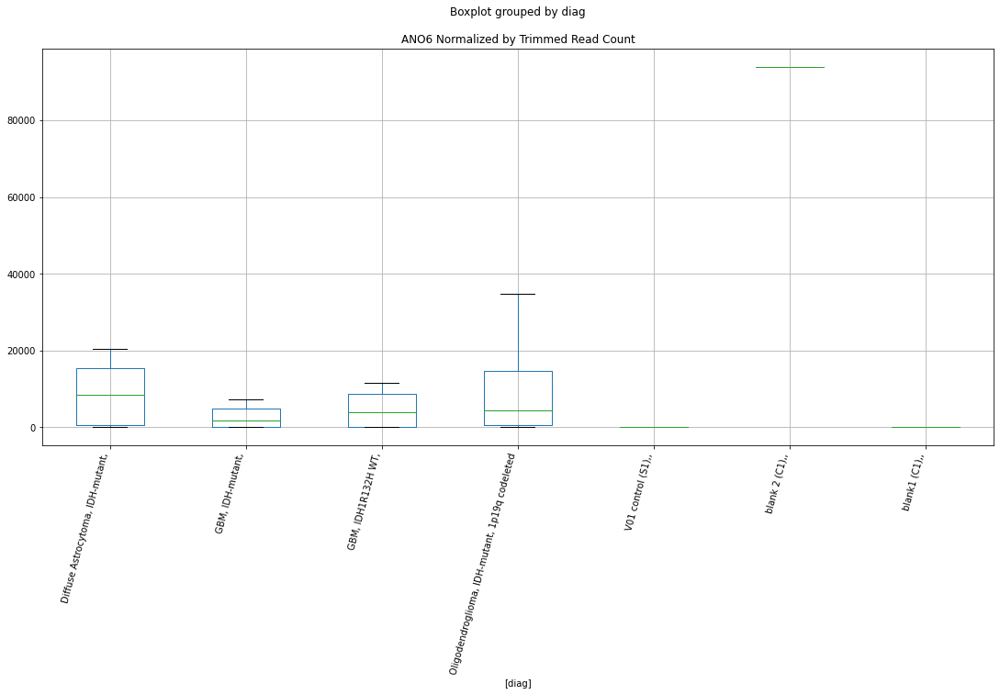

 p : 0.03638825833744387  ( t : 2.2609102185911913 ) :  D-plex  :  bbduk2  :  CPED1
Control and blanks
73     0.0
337    0.0
Name: CPED1, dtype: float64
205    0.0
Name: CPED1, dtype: float64
469    1183.05
Name: CPED1, dtype: float64


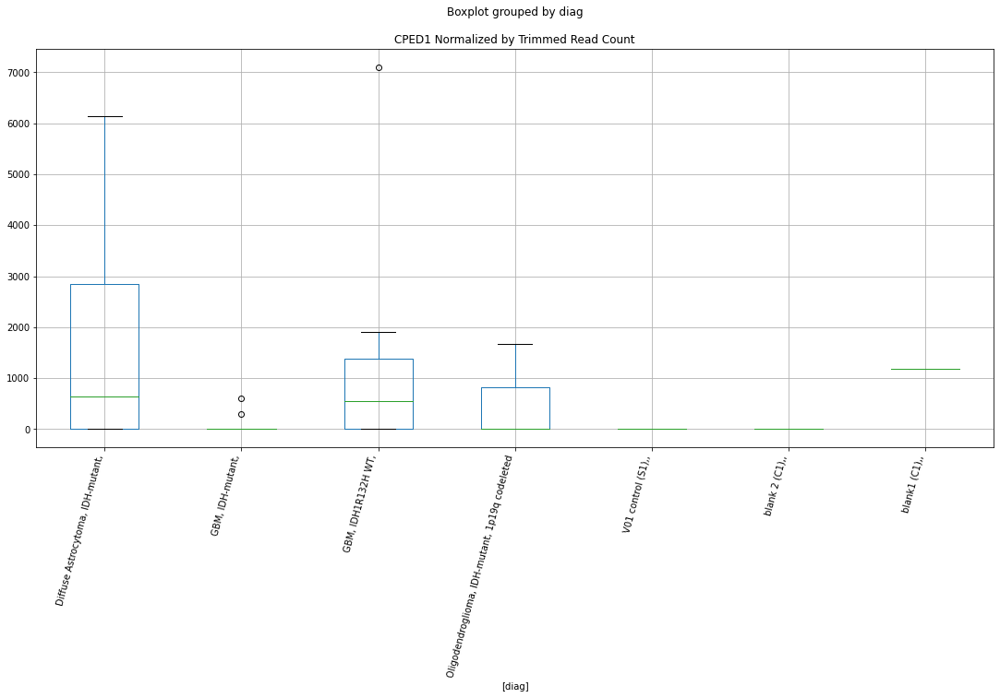

 p : 0.0363954131605014  ( t : 2.2608125027386405 ) :  D-plex  :  bbduk2  :  CDK16
Control and blanks
73     13914.15
337        0.00
Name: CDK16, dtype: float64
205    14864.55
Name: CDK16, dtype: float64
469    0.0
Name: CDK16, dtype: float64


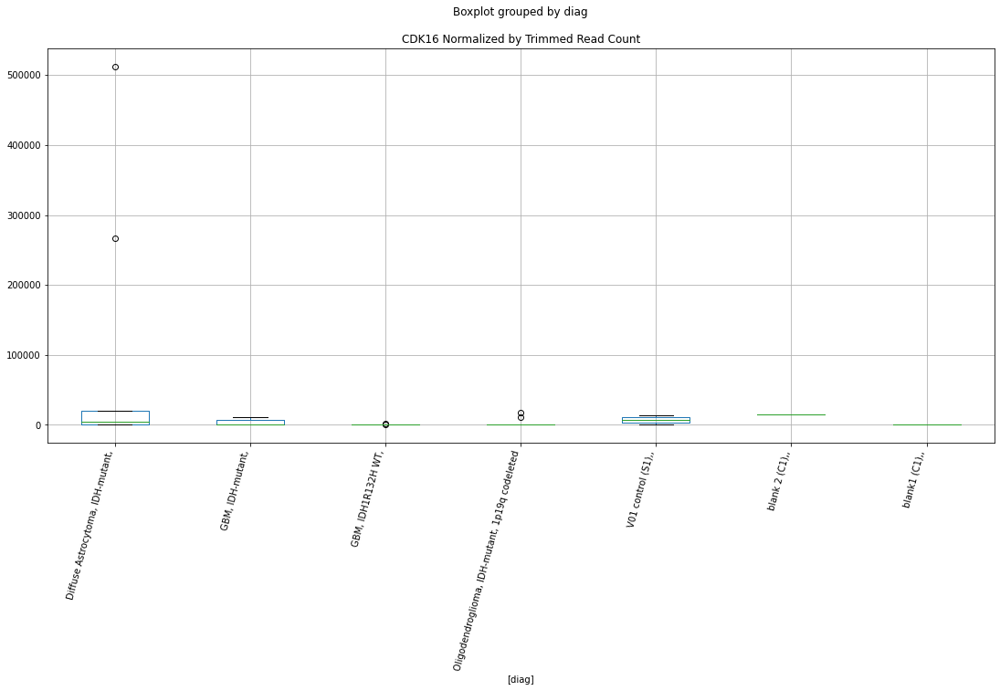

 p : 0.036414299233522636  ( t : 2.260554654430824 ) :  D-plex  :  cutadapt2  :  DKFZP434H168
Control and blanks
76     0.0
340    0.0
Name: DKFZP434H168, dtype: float64
208    2292.68
Name: DKFZP434H168, dtype: float64
472    2889.78
Name: DKFZP434H168, dtype: float64


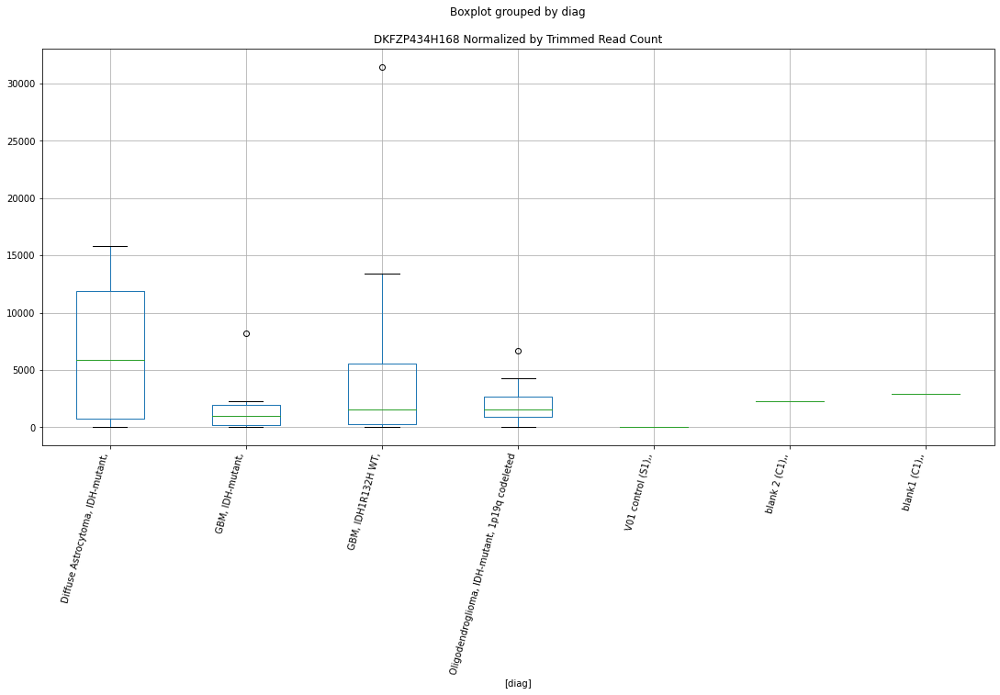

 p : 0.03644835481346213  ( t : 2.26009001151518 ) :  Lexogen  :  bbduk2  :  ARMC2
Control and blanks
79     0.0
343    0.0
Name: ARMC2, dtype: float64
211    0.0
Name: ARMC2, dtype: float64
475    4550.8
Name: ARMC2, dtype: float64


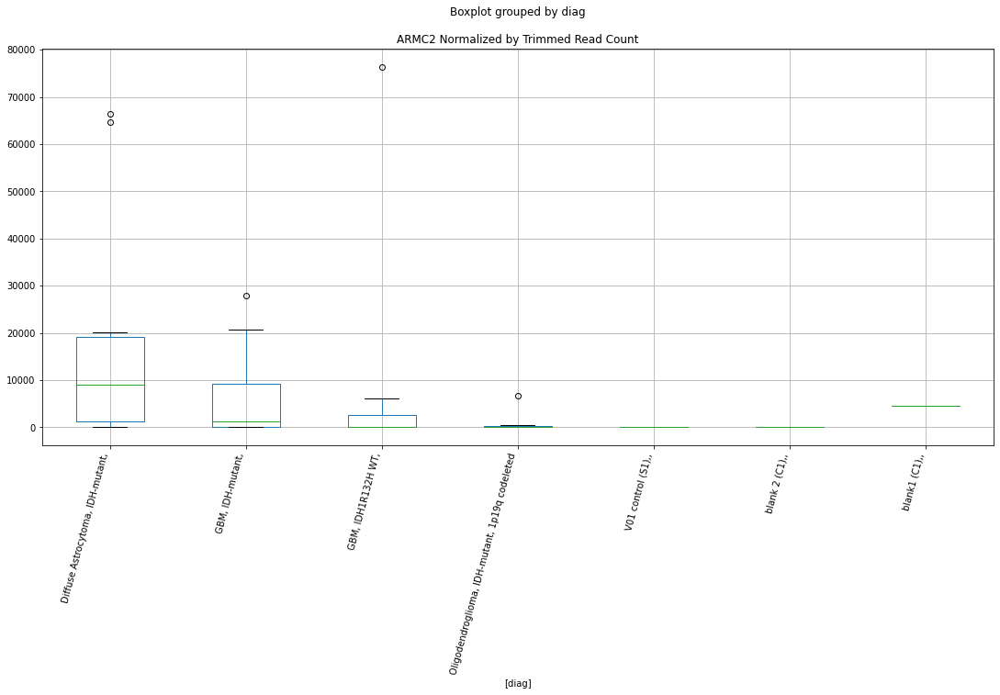

 p : 0.03645954921211166  ( t : 2.2599373664662776 ) :  Lexogen  :  cutadapt2  :  ADRA1A
Control and blanks
82          0.00
346    191284.98
Name: ADRA1A, dtype: float64
214    542.45
Name: ADRA1A, dtype: float64
478    237.46
Name: ADRA1A, dtype: float64


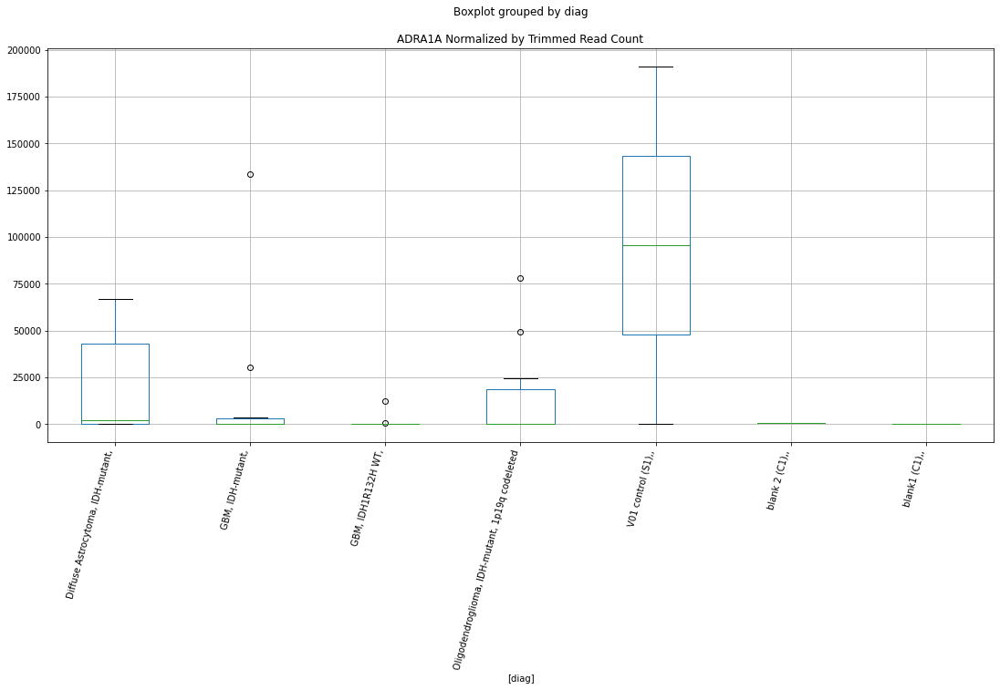

 p : 0.03650319859169976  ( t : 2.2593425836345493 ) :  D-plex  :  cutadapt2  :  ANKRD62P1-PARP4P3
Control and blanks
76     0.0
340    0.0
Name: ANKRD62P1-PARP4P3, dtype: float64
208    19575.98
Name: ANKRD62P1-PARP4P3, dtype: float64
472    577.96
Name: ANKRD62P1-PARP4P3, dtype: float64


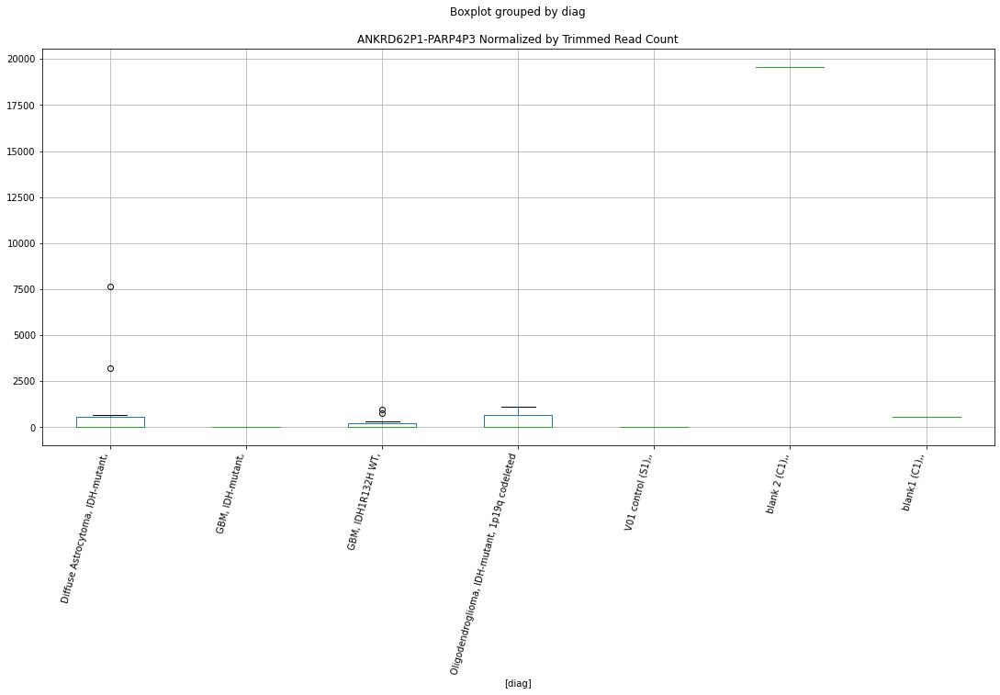

 p : 0.036514714392948705  ( t : 2.2591857745249677 ) :  D-plex  :  cutadapt2  :  BACE2
Control and blanks
76     0.0
340    0.0
Name: BACE2, dtype: float64
208    2645.4
Name: BACE2, dtype: float64
472    4045.69
Name: BACE2, dtype: float64


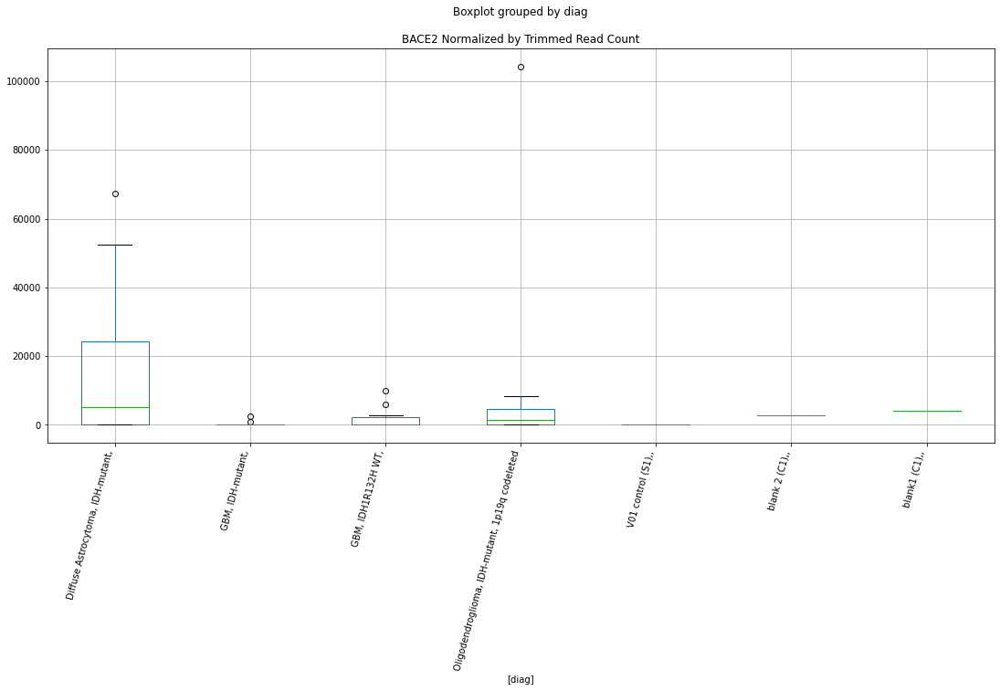

 p : 0.03656037324960083  ( t : 2.2585644932847475 ) :  D-plex  :  cutadapt2  :  COX7A2L
Control and blanks
76      3030.46
340    35229.29
Name: COX7A2L, dtype: float64
208    19223.26
Name: COX7A2L, dtype: float64
472    26008.01
Name: COX7A2L, dtype: float64


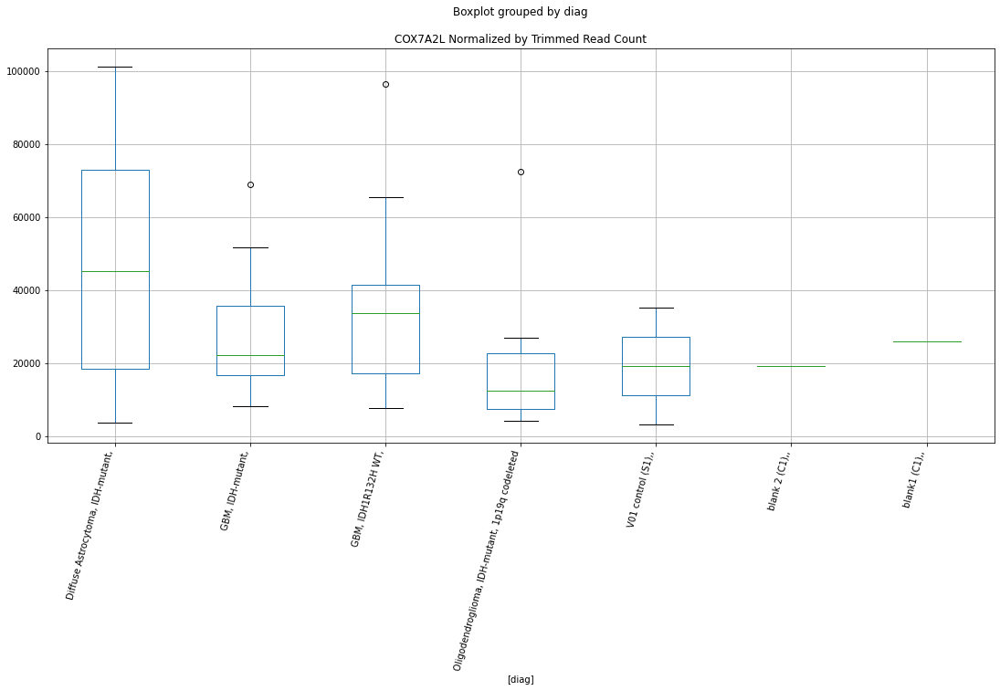

 p : 0.03656591898408031  ( t : 2.258489081144958 ) :  D-plex  :  bbduk2  :  B3GAT2
Control and blanks
73     0.0
337    0.0
Name: B3GAT2, dtype: float64
205    716.36
Name: B3GAT2, dtype: float64
469    2366.11
Name: B3GAT2, dtype: float64


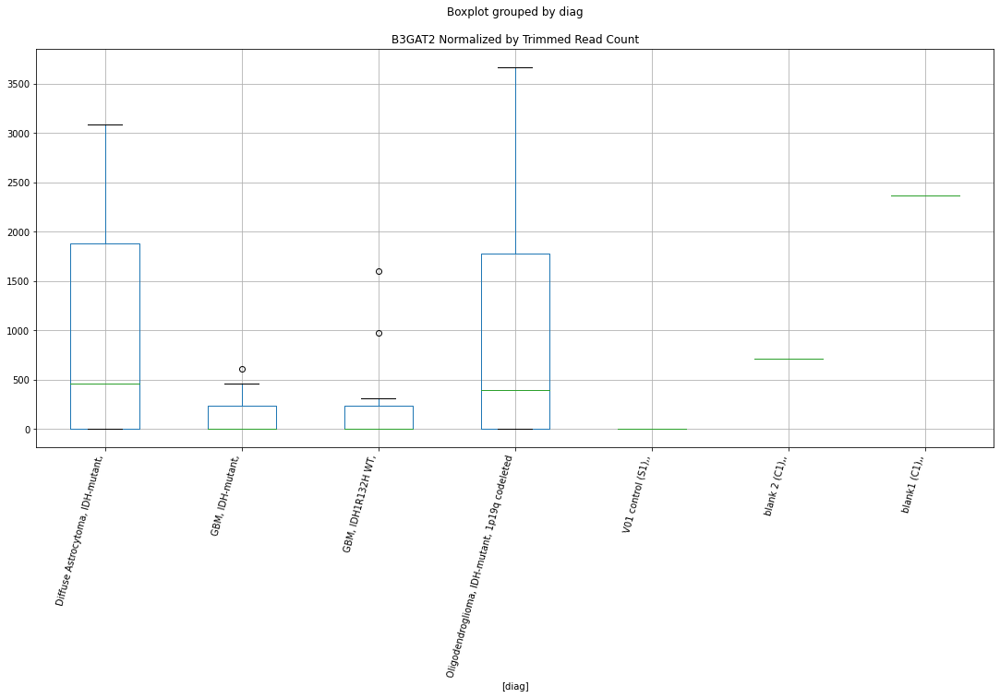

 p : 0.03657918959548517  ( t : 2.2583086672713097 ) :  Lexogen  :  bbduk2  :  ASB16
Control and blanks
79     0.0
343    0.0
Name: ASB16, dtype: float64
211    0.0
Name: ASB16, dtype: float64
475    0.0
Name: ASB16, dtype: float64


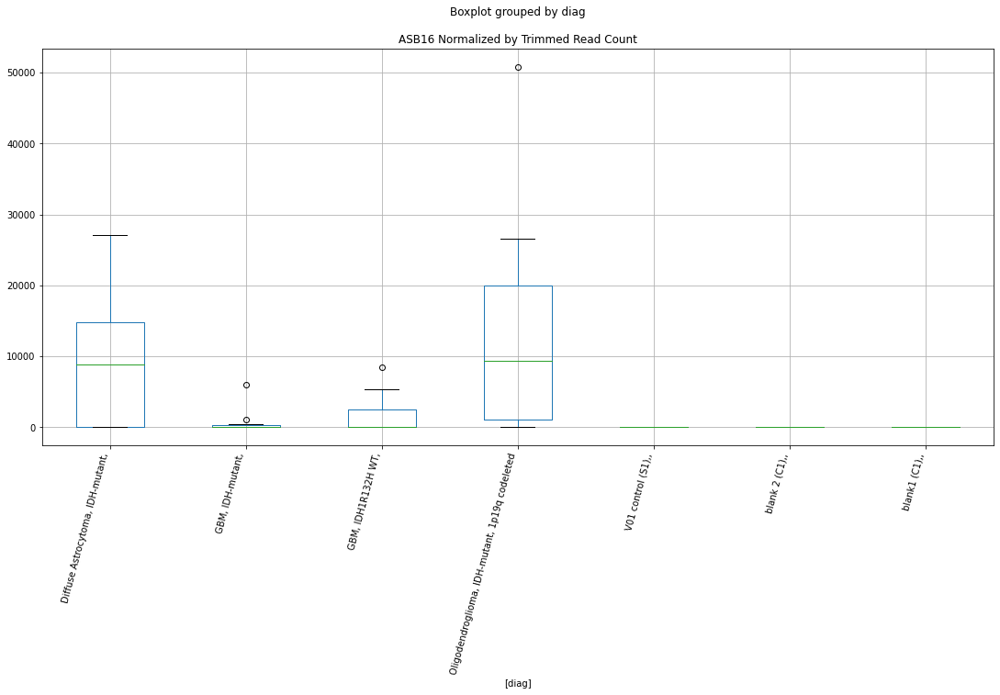

 p : 0.036608103727403  ( t : 2.2579157890839388 ) :  D-plex  :  cutadapt2  :  CRB1
Control and blanks
76     0.0
340    0.0
Name: CRB1, dtype: float64
208    4056.29
Name: CRB1, dtype: float64
472    13292.98
Name: CRB1, dtype: float64


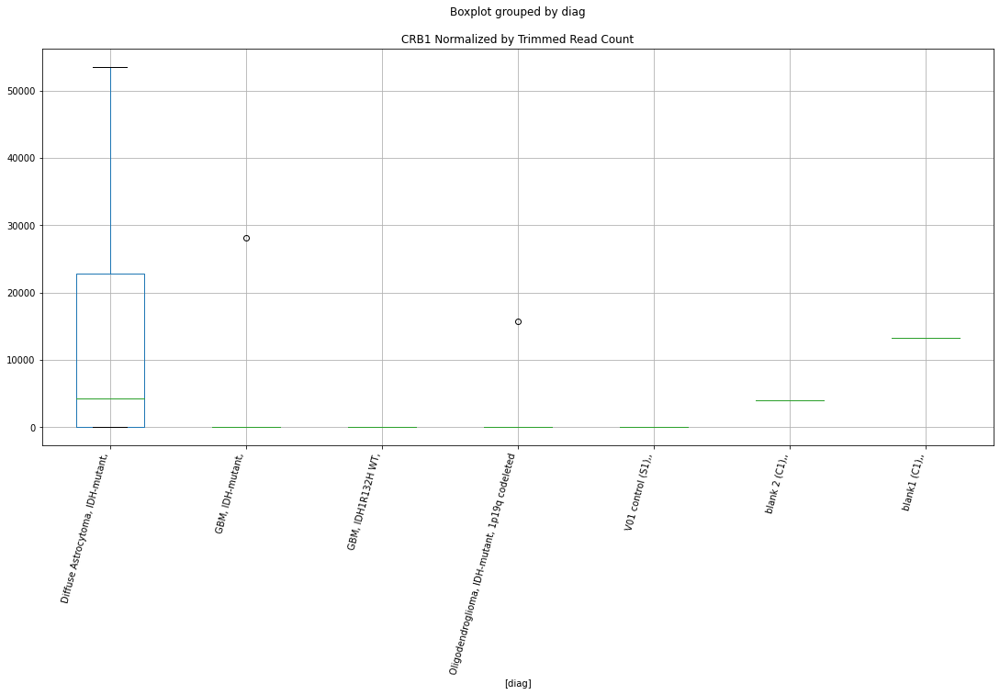

 p : 0.03662775348133046  ( t : 2.257648956531471 ) :  Lexogen  :  bbduk2  :  CTXND1
Control and blanks
79         0.00
343    16560.52
Name: CTXND1, dtype: float64
211    0.0
Name: CTXND1, dtype: float64
475    0.0
Name: CTXND1, dtype: float64


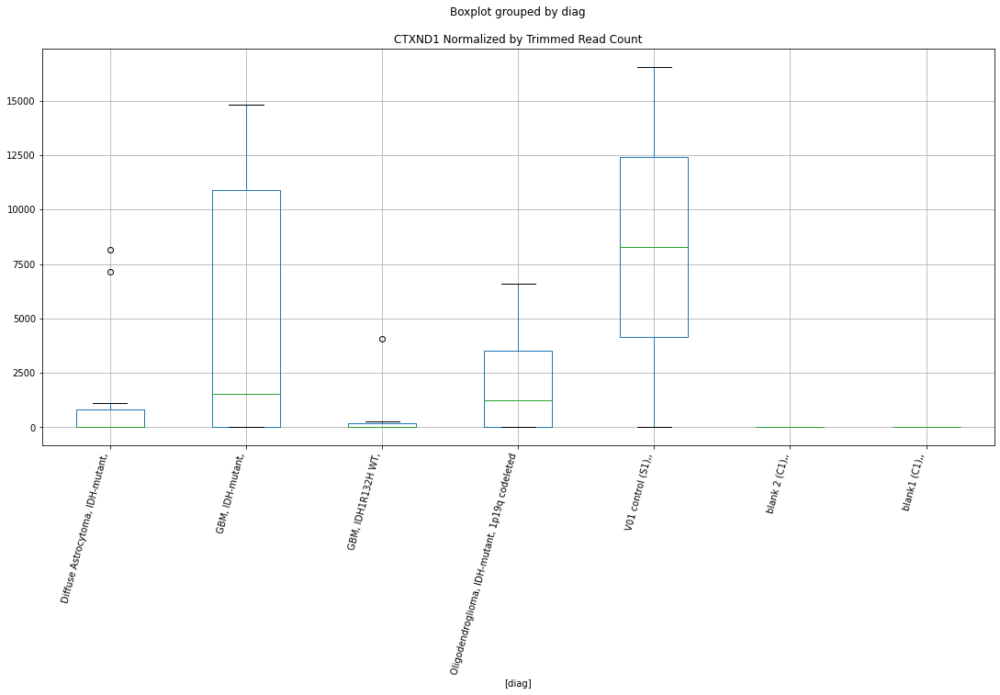

 p : 0.03666702343747379  ( t : 2.257116088581895 ) :  D-plex  :  bbduk2  :  ANKRD62P1-PARP4P3
Control and blanks
73     0.0
337    0.0
Name: ANKRD62P1-PARP4P3, dtype: float64
205    19879.1
Name: ANKRD62P1-PARP4P3, dtype: float64
469    591.53
Name: ANKRD62P1-PARP4P3, dtype: float64


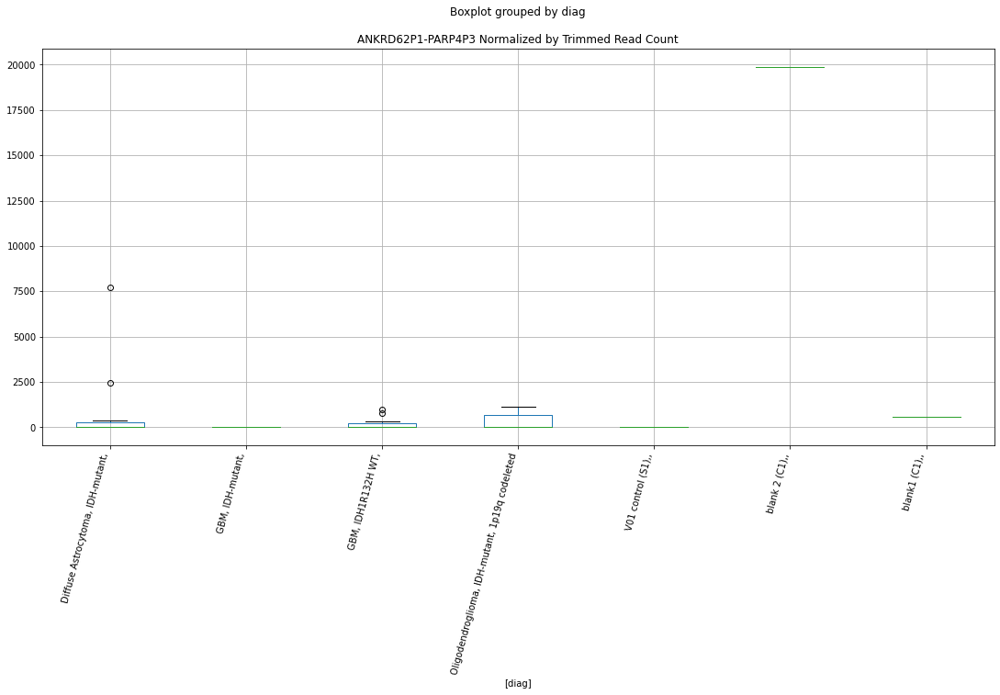

 p : 0.03682538134389627  ( t : 2.2549726076340635 ) :  D-plex  :  bbduk2  :  ANKRD13D
Control and blanks
73     0.0
337    0.0
Name: ANKRD13D, dtype: float64
205    1611.82
Name: ANKRD13D, dtype: float64
469    0.0
Name: ANKRD13D, dtype: float64


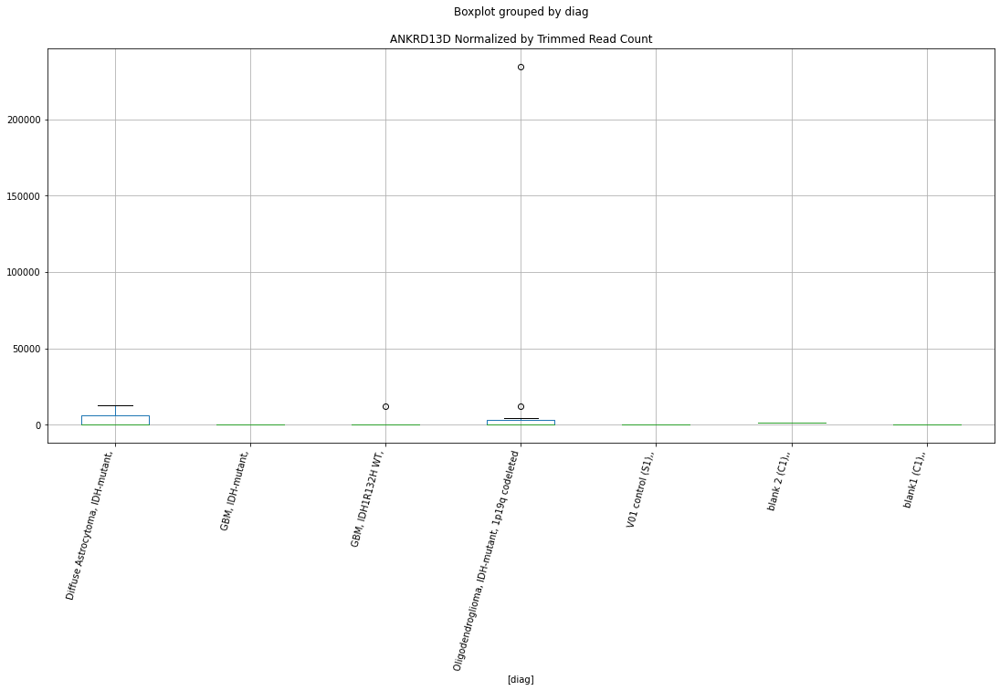

 p : 0.03688297186774326  ( t : 2.2541951909520592 ) :  D-plex  :  cutadapt2  :  CDC42
Control and blanks
76     0.0
340    0.0
Name: CDC42, dtype: float64
208    1234.52
Name: CDC42, dtype: float64
472    2311.82
Name: CDC42, dtype: float64


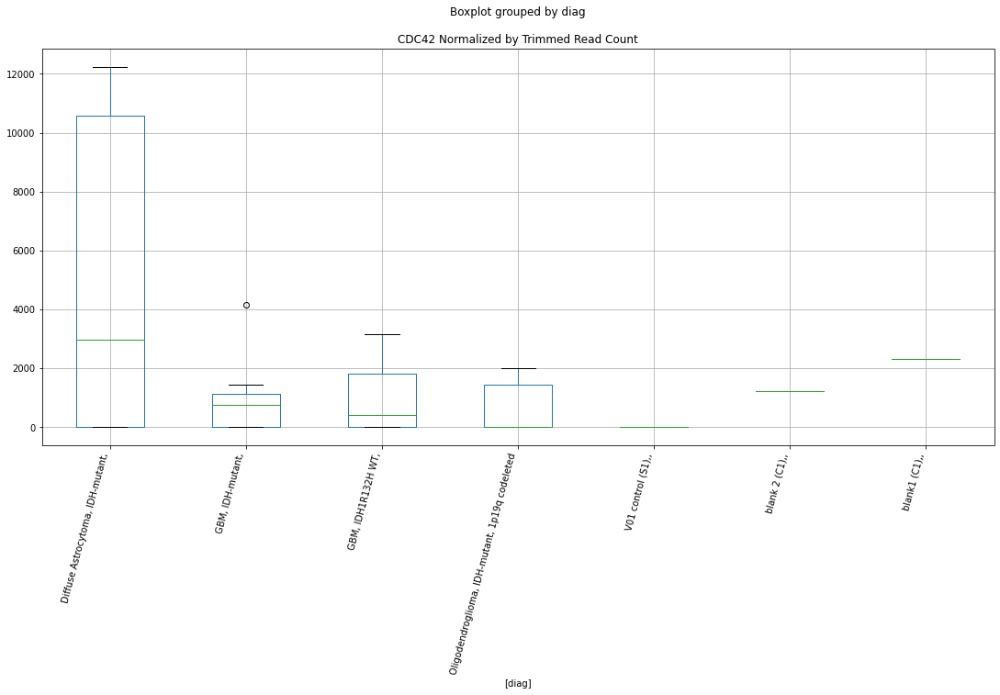

 p : 0.03688519859736039  ( t : 2.2541651547527866 ) :  D-plex  :  cutadapt2  :  CENPF
Control and blanks
76     4545.69
340       0.00
Name: CENPF, dtype: float64
208    5114.45
Name: CENPF, dtype: float64
472    5201.6
Name: CENPF, dtype: float64


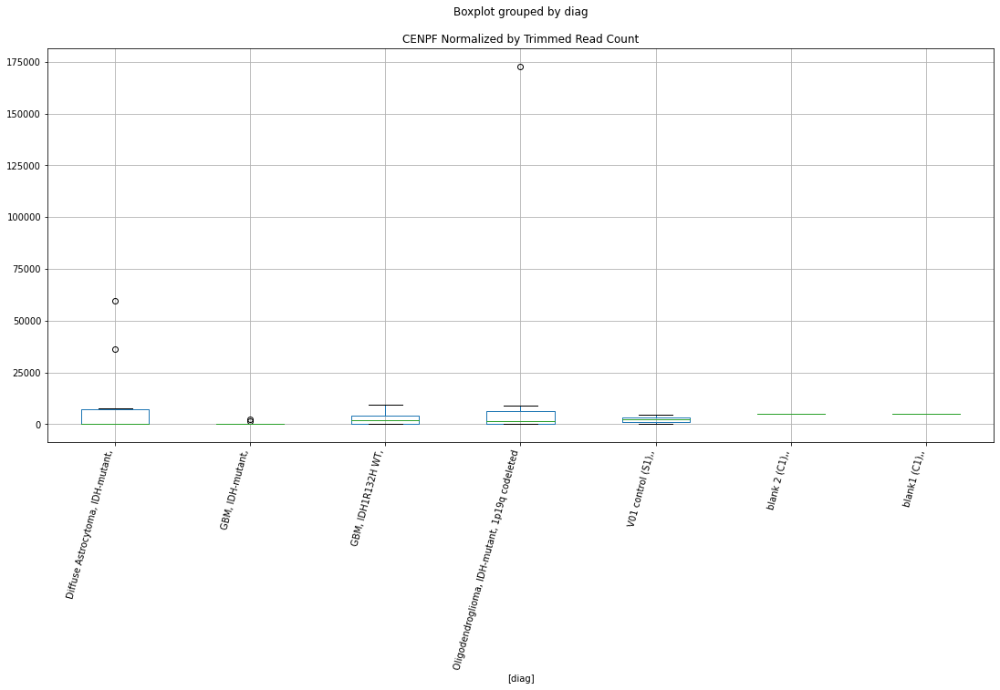

 p : 0.03693675562913632  ( t : 2.253470173244388 ) :  D-plex  :  cutadapt2  :  COL13A1
Control and blanks
76     0.0
340    0.0
Name: COL13A1, dtype: float64
208    1234.52
Name: COL13A1, dtype: float64
472    0.0
Name: COL13A1, dtype: float64


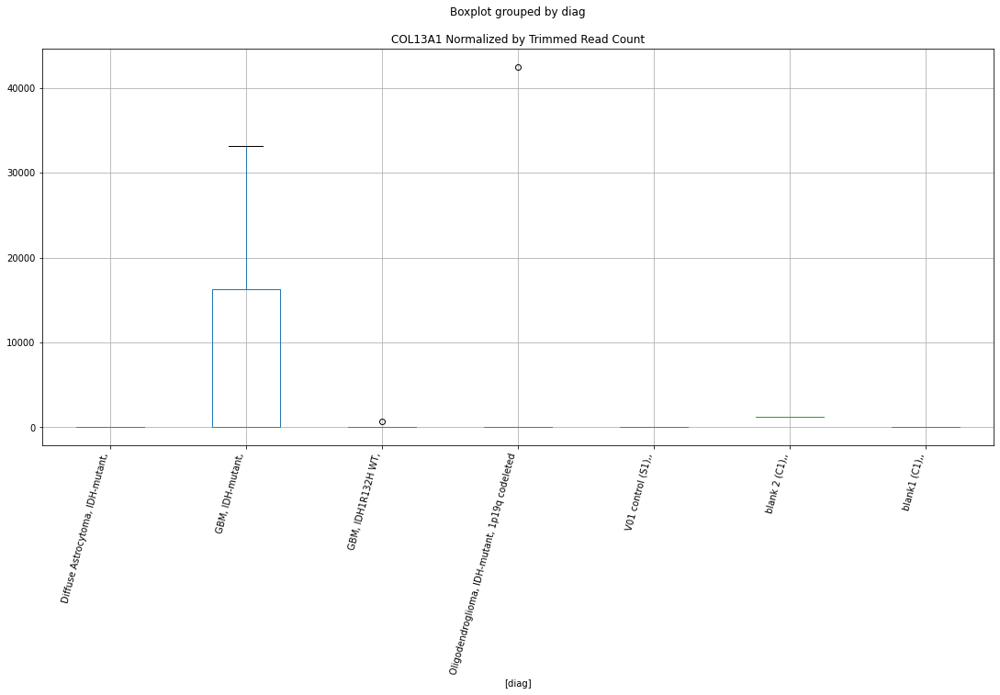

 p : 0.03696034044337573  ( t : 2.253152551759273 ) :  Lexogen  :  bbduk2  :  ADARB1
Control and blanks
79     0.0
343    0.0
Name: ADARB1, dtype: float64
211    0.0
Name: ADARB1, dtype: float64
475    0.0
Name: ADARB1, dtype: float64


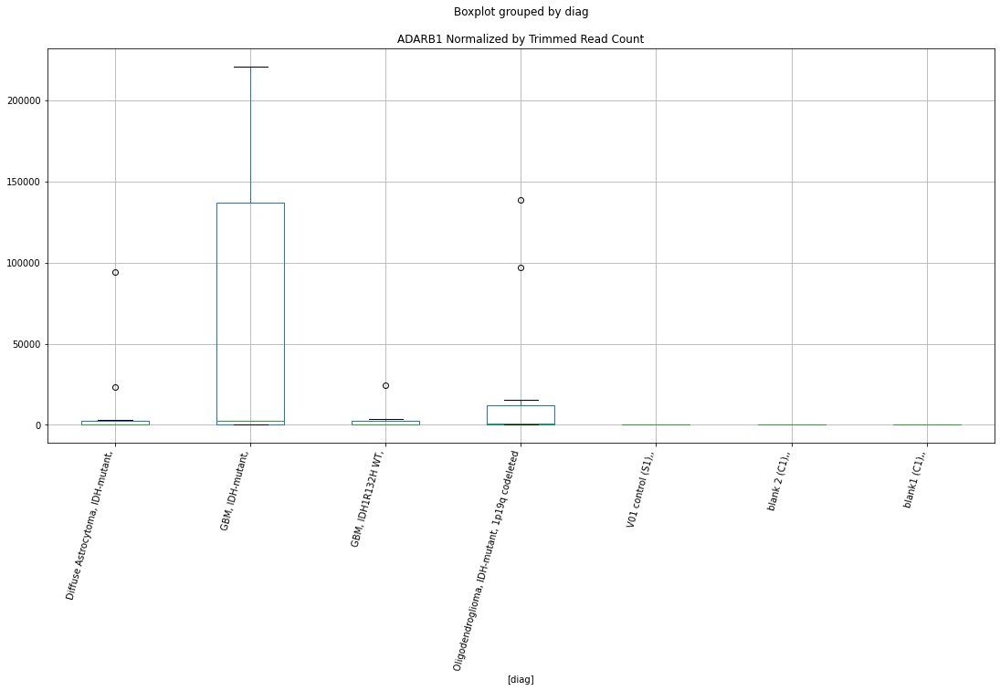

 p : 0.03697059783682913  ( t : 2.2530144717341343 ) :  Lexogen  :  cutadapt2  :  ADARB1
Control and blanks
82     0.0
346    0.0
Name: ADARB1, dtype: float64
214    0.0
Name: ADARB1, dtype: float64
478    0.0
Name: ADARB1, dtype: float64


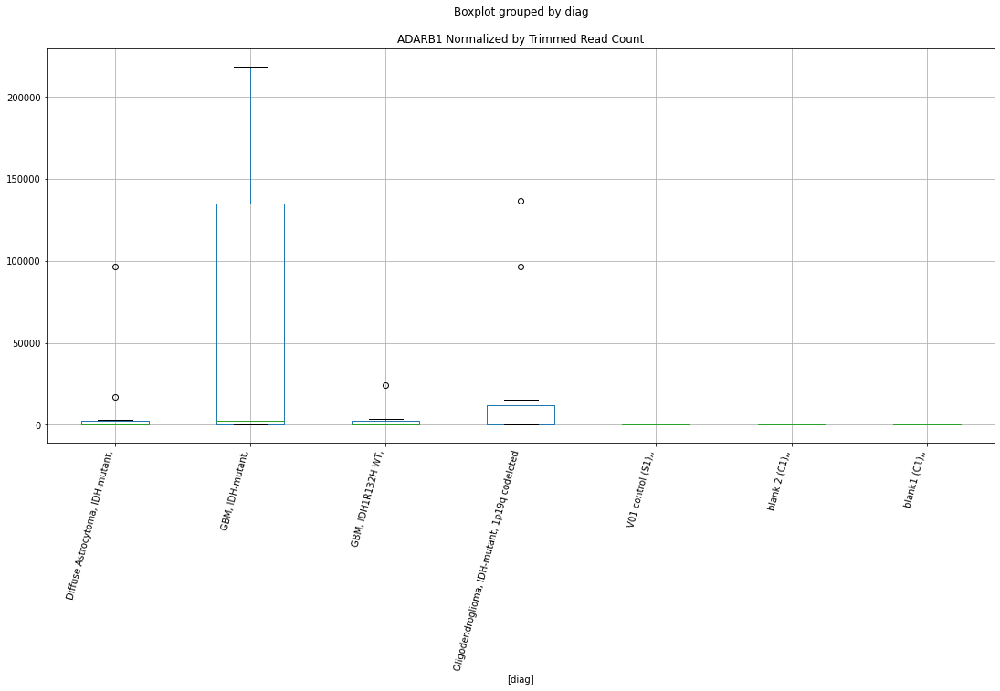

 p : 0.03702906055223094  ( t : 2.2522281497065184 ) :  Lexogen  :  cutadapt2  :  ANKRD50
Control and blanks
82       0.0
346    631.3
Name: ANKRD50, dtype: float64
214    2441.04
Name: ANKRD50, dtype: float64
478    22083.82
Name: ANKRD50, dtype: float64


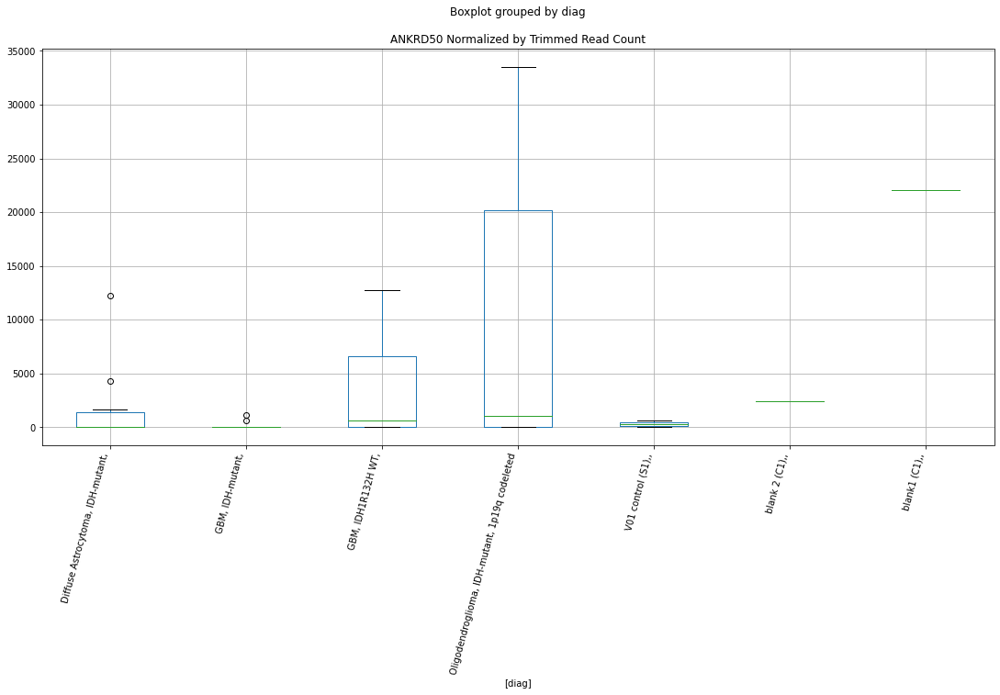

 p : 0.037048478347800874  ( t : 2.2519672343537125 ) :  D-plex  :  cutadapt2  :  C18orf25
Control and blanks
76      2272.84
340    36990.75
Name: C18orf25, dtype: float64
208    3350.84
Name: C18orf25, dtype: float64
472    5779.56
Name: C18orf25, dtype: float64


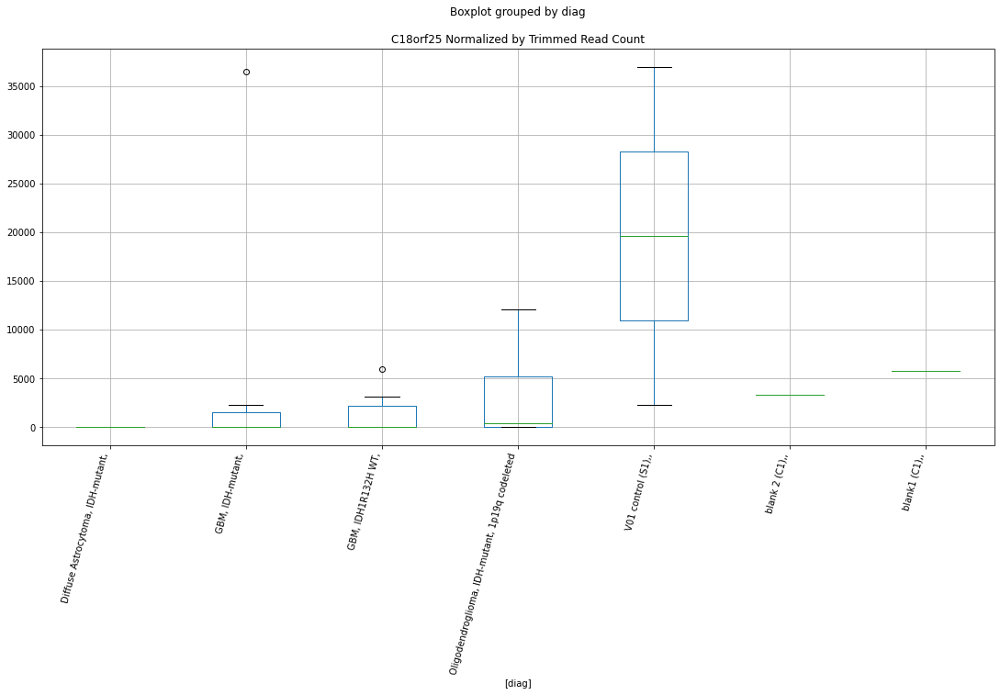

 p : 0.037108583169245944  ( t : 2.2511604099776865 ) :  Lexogen  :  bbduk2  :  CYB5R3
Control and blanks
79     0.0
343    0.0
Name: CYB5R3, dtype: float64
211    0.0
Name: CYB5R3, dtype: float64
475    0.0
Name: CYB5R3, dtype: float64


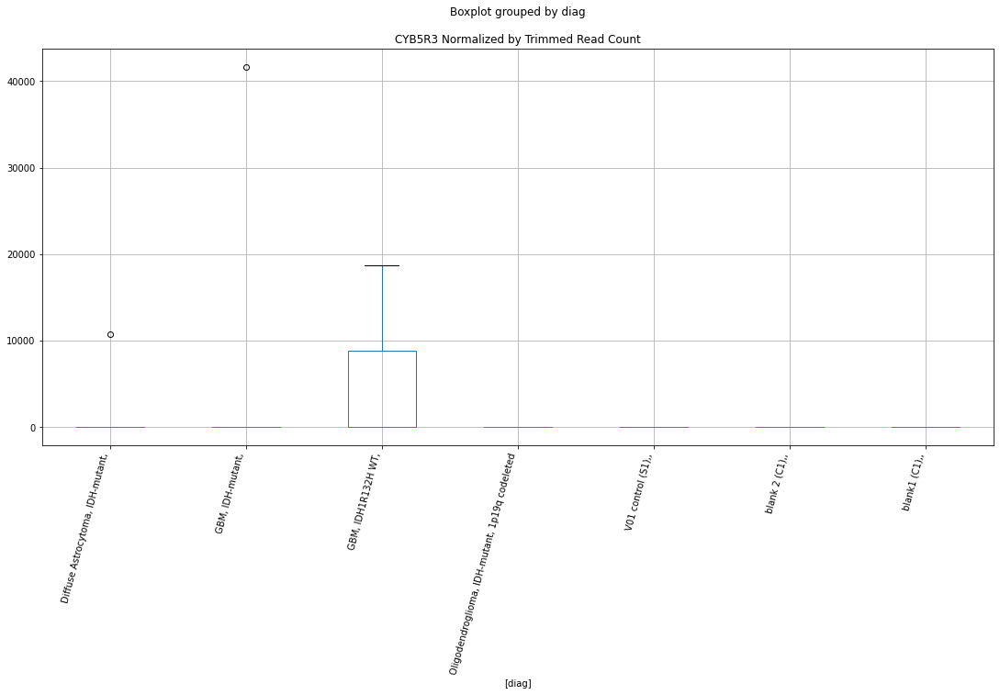

 p : 0.03715936483766037  ( t : 2.2504796755275858 ) :  D-plex  :  bbduk2  :  CLEC3B
Control and blanks
73     0.0
337    0.0
Name: CLEC3B, dtype: float64
205    895.45
Name: CLEC3B, dtype: float64
469    0.0
Name: CLEC3B, dtype: float64


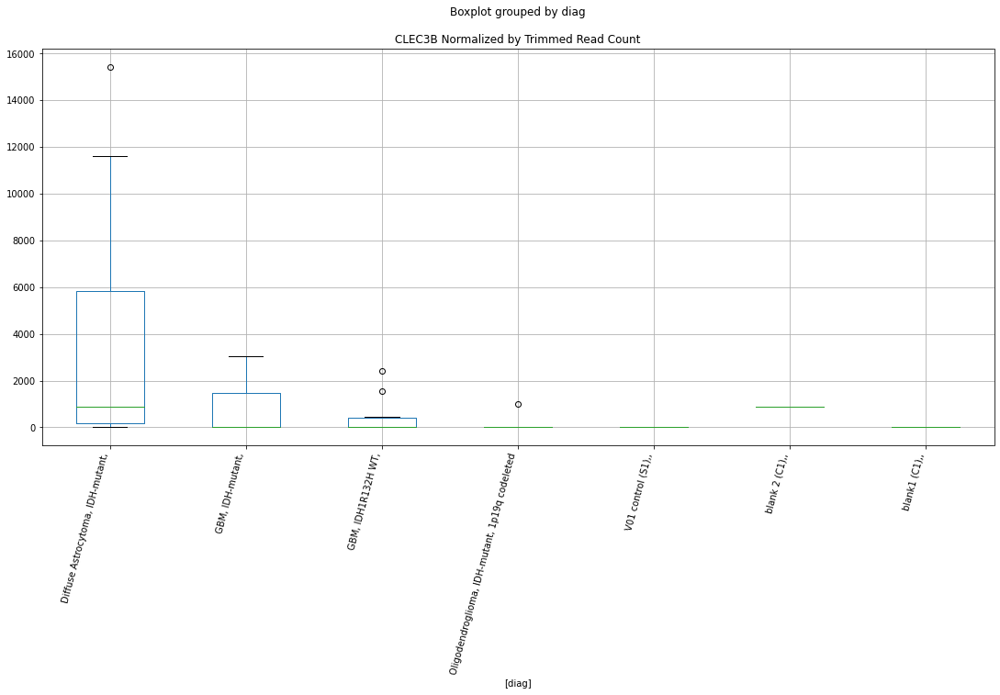

 p : 0.03715956827022331  ( t : 2.2504769502163215 ) :  D-plex  :  cutadapt2  :  CERCAM
Control and blanks
76     0.0
340    0.0
Name: CERCAM, dtype: float64
208    4938.09
Name: CERCAM, dtype: float64
472    0.0
Name: CERCAM, dtype: float64


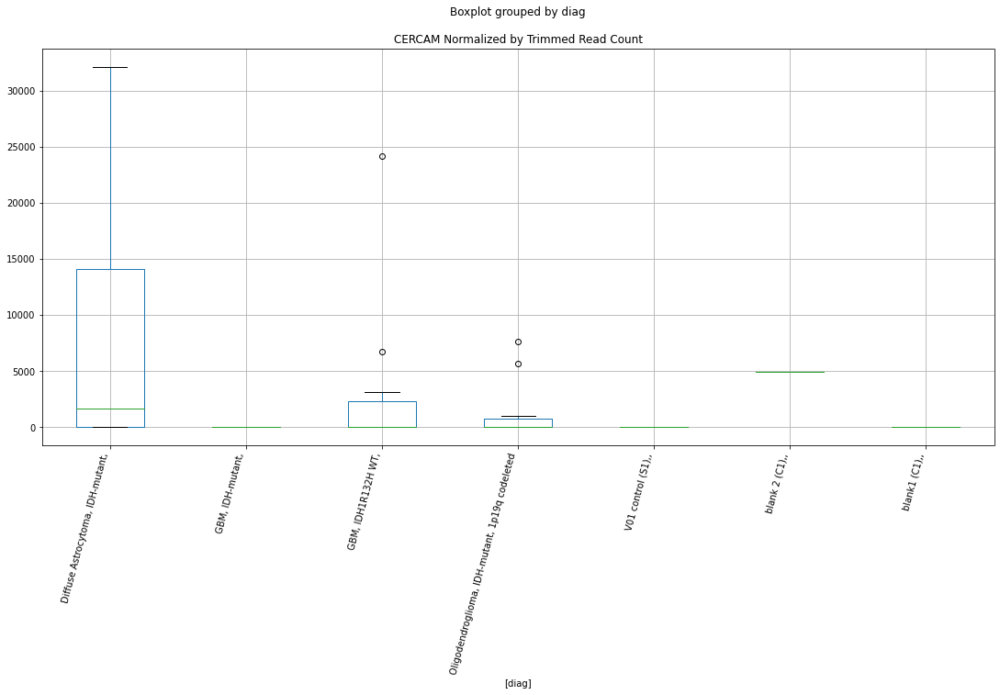

 p : 0.03718717948737488  ( t : 2.250107180589564 ) :  D-plex  :  bbduk2  :  CD81
Control and blanks
73     106675.16
337         0.00
Name: CD81, dtype: float64
205    1074.55
Name: CD81, dtype: float64
469    3549.16
Name: CD81, dtype: float64


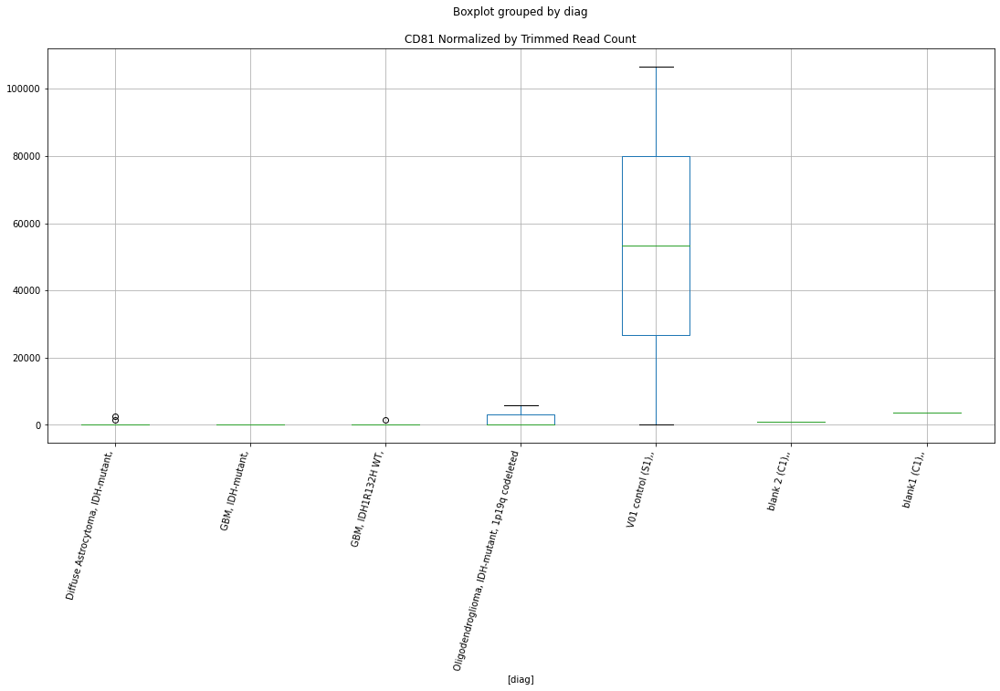

 p : 0.037191047999792434  ( t : 2.25005539368006 ) :  D-plex  :  cutadapt2  :  CD81
Control and blanks
76     104550.76
340         0.00
Name: CD81, dtype: float64
208    1058.16
Name: CD81, dtype: float64
472    3467.74
Name: CD81, dtype: float64


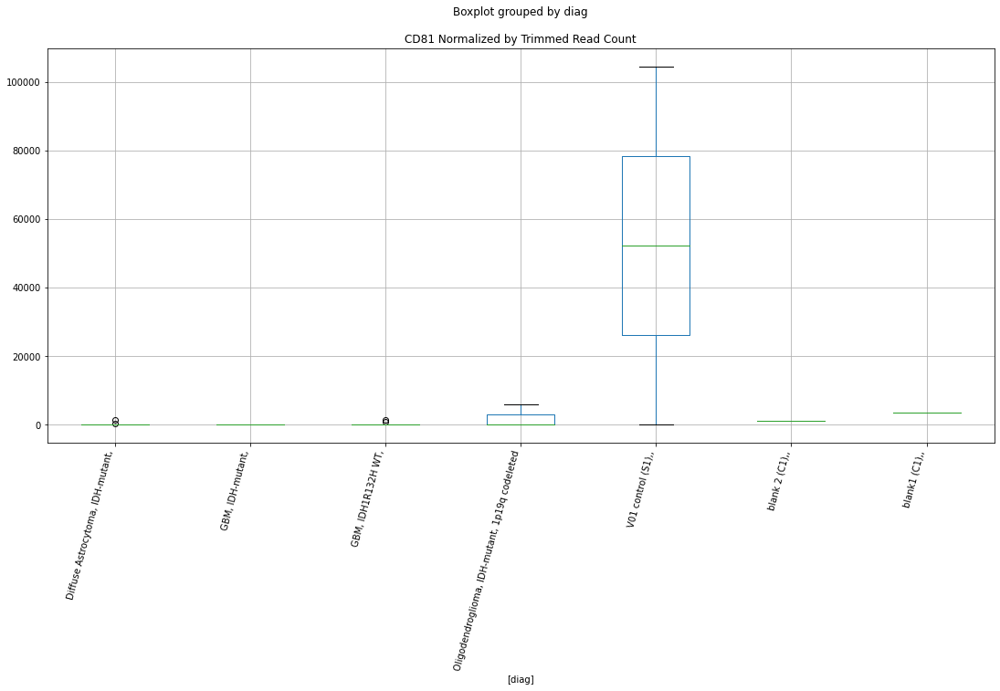

 p : 0.03722618538105928  ( t : 2.249585244922114 ) :  D-plex  :  cutadapt2  :  ACTA1
Control and blanks
76     0.0
340    0.0
Name: ACTA1, dtype: float64
208    1058.16
Name: ACTA1, dtype: float64
472    1155.91
Name: ACTA1, dtype: float64


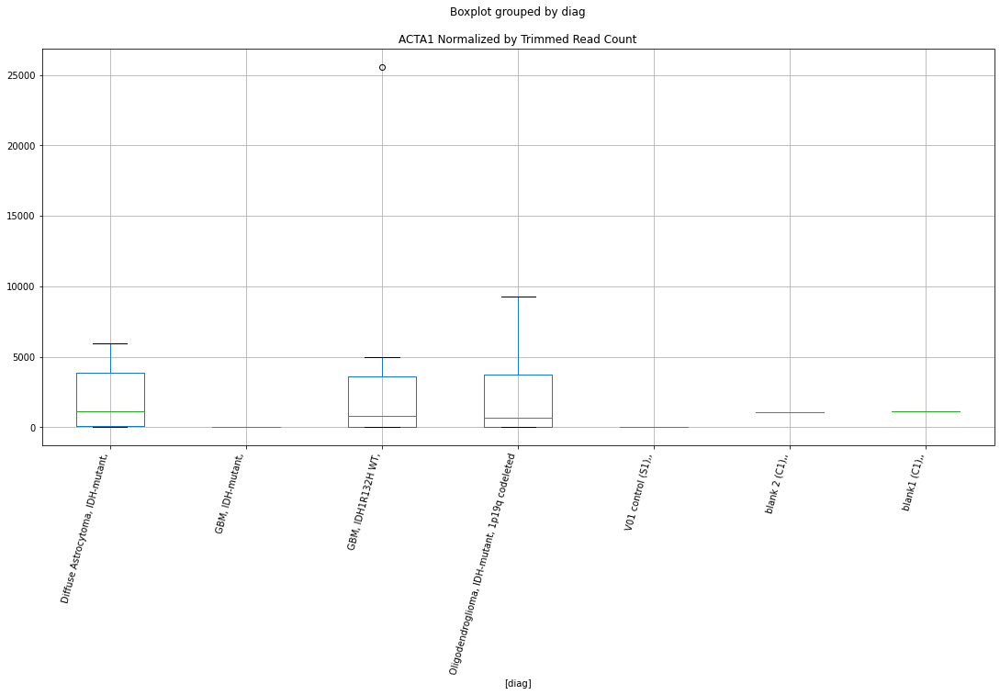

 p : 0.037248077097315306  ( t : 2.2492925341640975 ) :  Lexogen  :  bbduk2  :  CHRD
Control and blanks
79     0.0
343    0.0
Name: CHRD, dtype: float64
211    5192.82
Name: CHRD, dtype: float64
475    0.0
Name: CHRD, dtype: float64


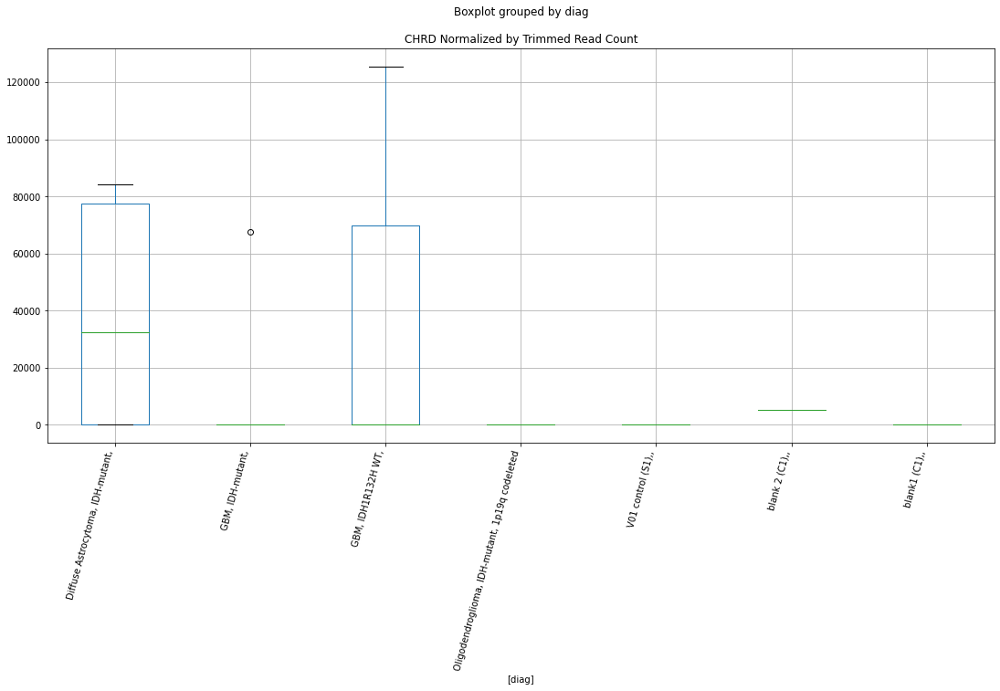

 p : 0.037369814353957066  ( t : 2.2476676941672213 ) :  D-plex  :  bbduk2  :  ACTA1
Control and blanks
73     0.0
337    0.0
Name: ACTA1, dtype: float64
205    1074.55
Name: ACTA1, dtype: float64
469    1183.05
Name: ACTA1, dtype: float64


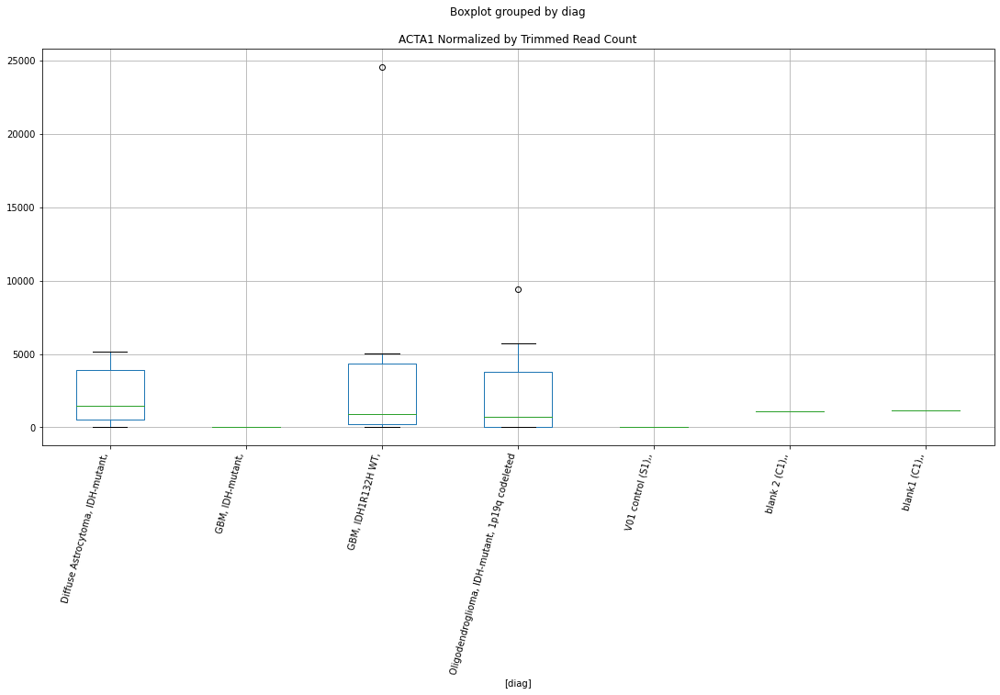

 p : 0.03737364780769164  ( t : 2.247616608014635 ) :  Lexogen  :  cutadapt2  :  DLGAP4
Control and blanks
82     0.0
346    0.0
Name: DLGAP4, dtype: float64
214    0.0
Name: DLGAP4, dtype: float64
478    0.0
Name: DLGAP4, dtype: float64


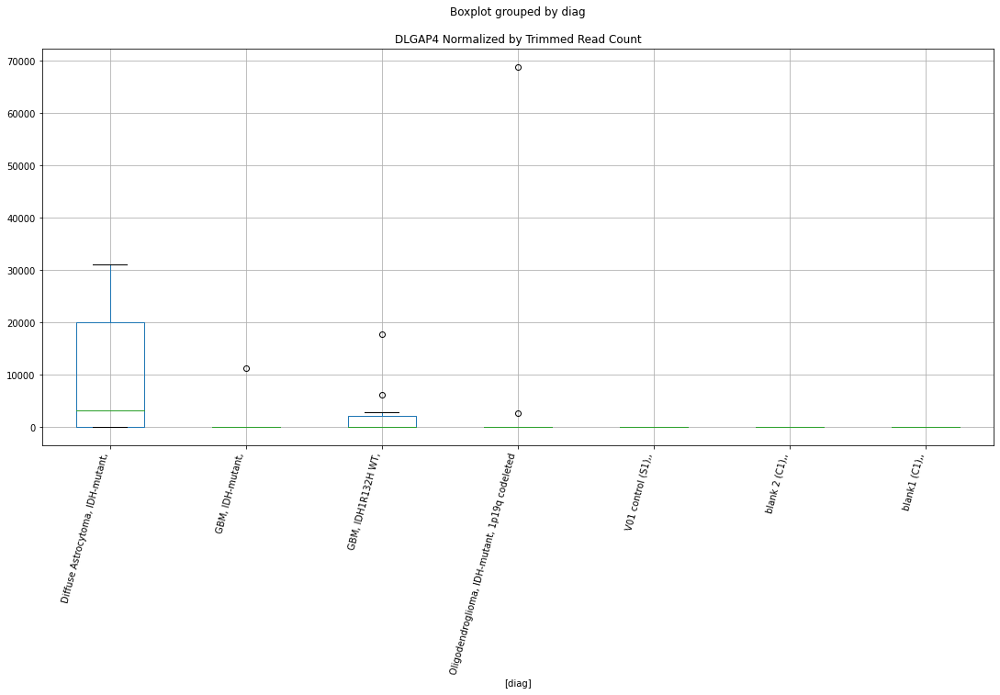

 p : 0.03739601897371658  ( t : 2.2473185772159985 ) :  D-plex  :  cutadapt2  :  CDCA7L
Control and blanks
76     0.0
340    0.0
Name: CDCA7L, dtype: float64
208    2116.32
Name: CDCA7L, dtype: float64
472    1733.87
Name: CDCA7L, dtype: float64


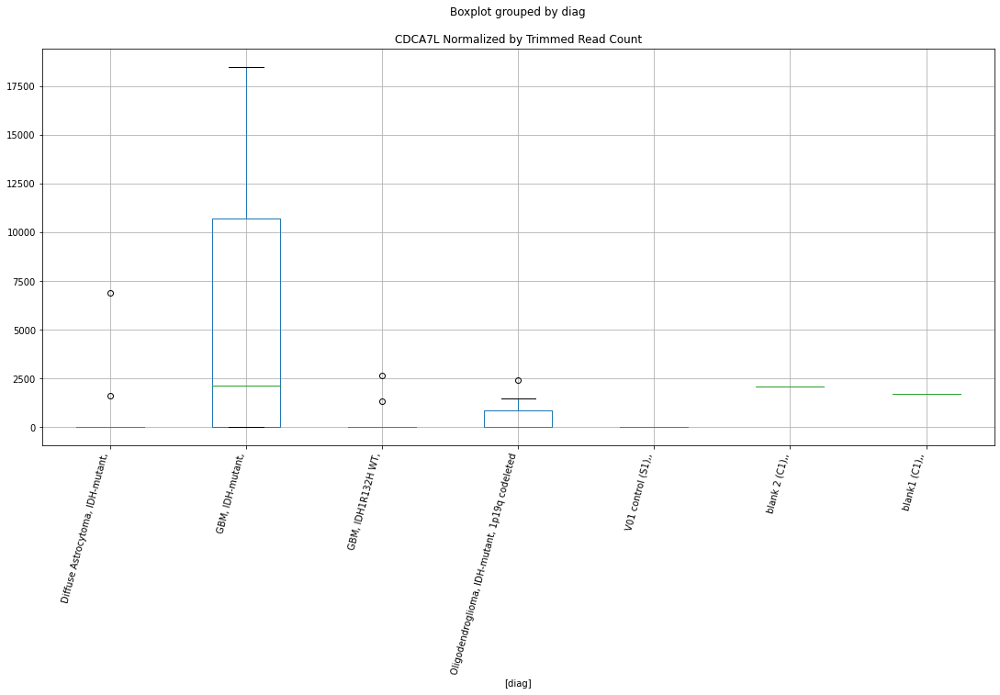

 p : 0.03746126573372257  ( t : 2.2464502921936087 ) :  D-plex  :  cutadapt2  :  C8orf74
Control and blanks
76        0.0
340    2642.2
Name: C8orf74, dtype: float64
208    529.08
Name: C8orf74, dtype: float64
472    1733.87
Name: C8orf74, dtype: float64


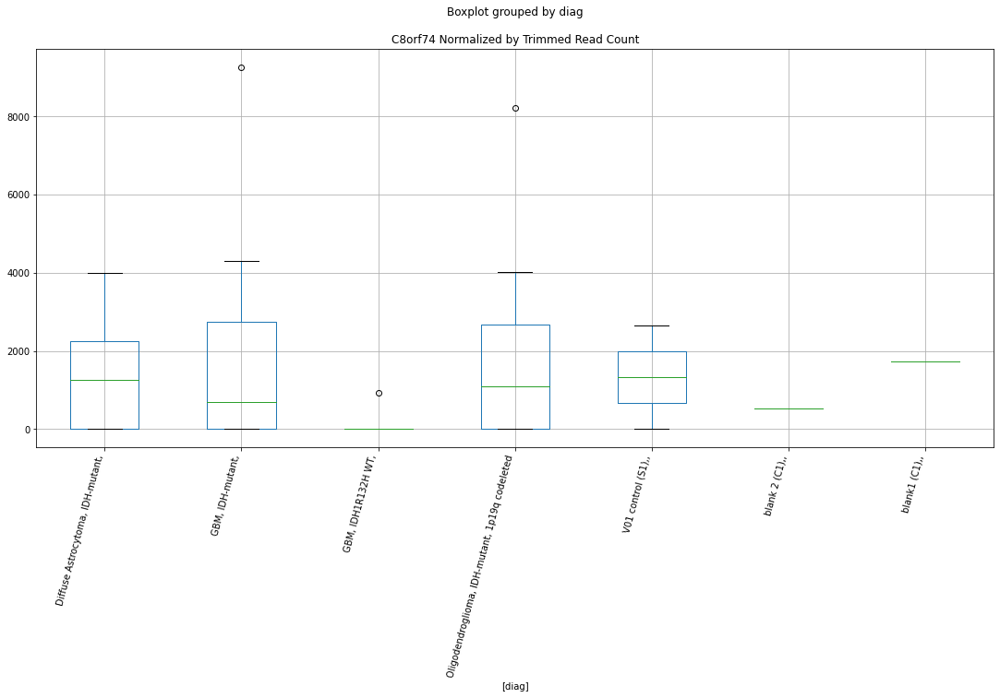

 p : 0.037478542897498954  ( t : 2.2462206063287007 ) :  D-plex  :  bbduk2  :  CYB5B
Control and blanks
73         0.00
337    30265.35
Name: CYB5B, dtype: float64
205    1253.64
Name: CYB5B, dtype: float64
469    2366.11
Name: CYB5B, dtype: float64


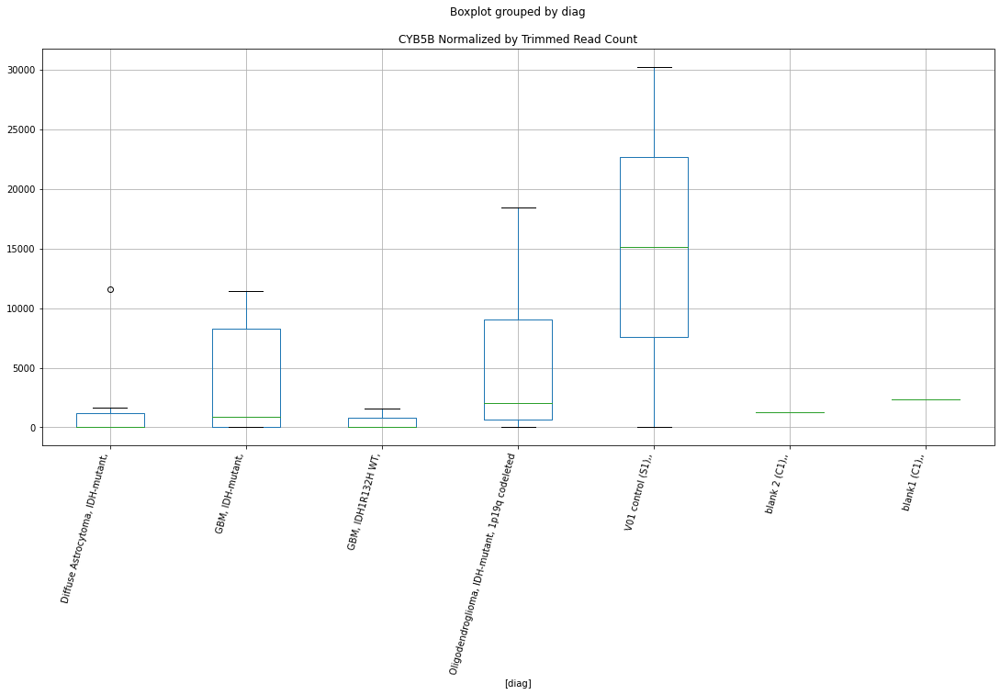

 p : 0.037493561321973914  ( t : 2.246021027912796 ) :  D-plex  :  cutadapt2  :  B3GAT2
Control and blanks
76     0.0
340    0.0
Name: B3GAT2, dtype: float64
208    705.44
Name: B3GAT2, dtype: float64
472    2311.82
Name: B3GAT2, dtype: float64


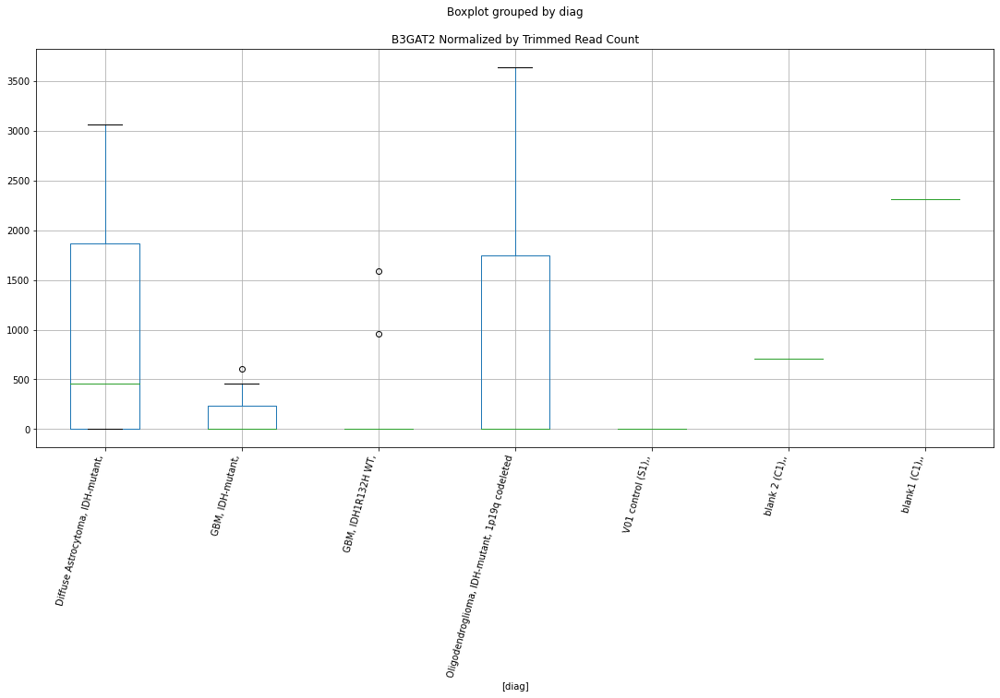

 p : 0.037513294551459665  ( t : 2.2457589069799475 ) :  D-plex  :  cutadapt2  :  CDC27P10
Control and blanks
76      3030.46
340    31706.36
Name: CDC27P10, dtype: float64
208    23632.27
Name: CDC27P10, dtype: float64
472    26008.01
Name: CDC27P10, dtype: float64


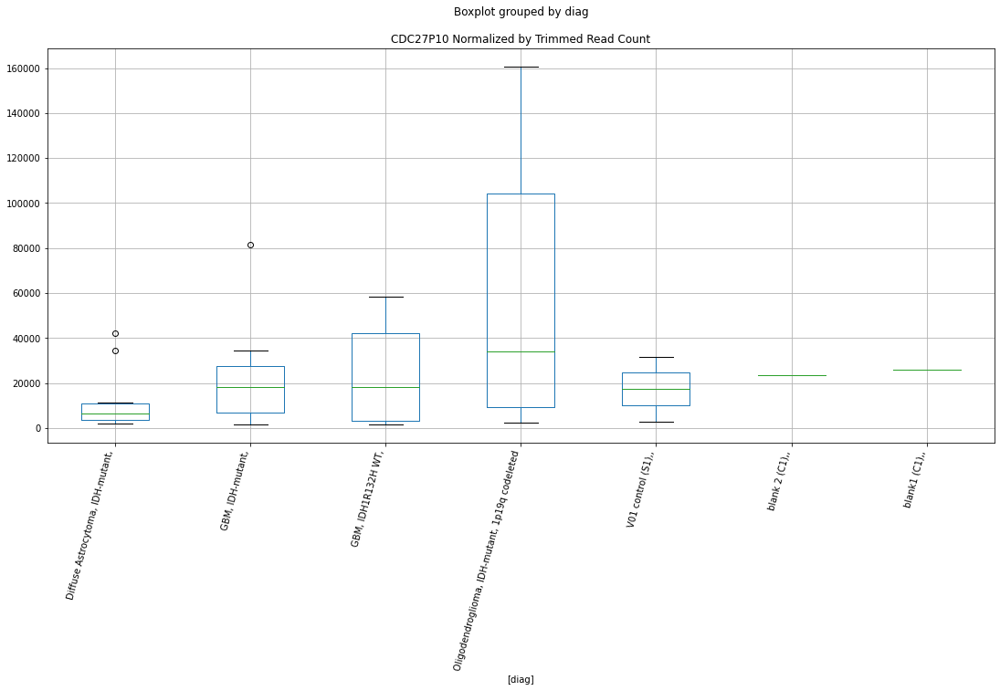

 p : 0.03761171558501451  ( t : 2.244453454382381 ) :  D-plex  :  bbduk2  :  DDX51
Control and blanks
73     0.0
337    0.0
Name: DDX51, dtype: float64
205    179.09
Name: DDX51, dtype: float64
469    591.53
Name: DDX51, dtype: float64


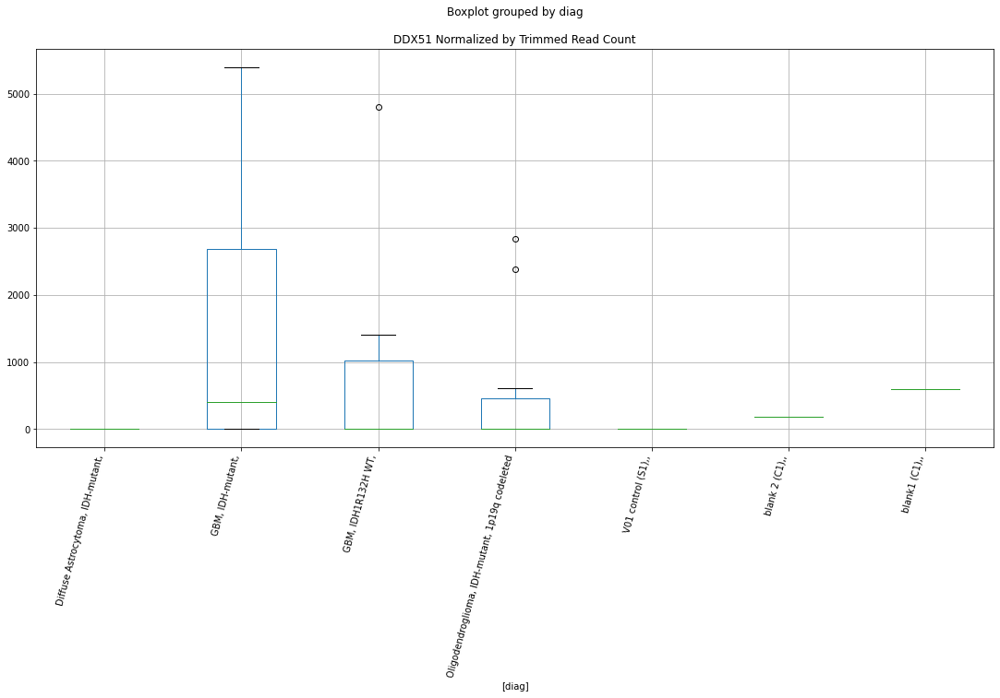

 p : 0.037628829505905986  ( t : 2.2442267776731195 ) :  D-plex  :  bbduk2  :  CNOT10
Control and blanks
73     394234.28
337    261706.24
Name: CNOT10, dtype: float64
205    964046.6
Name: CNOT10, dtype: float64
469    4.21e+06
Name: CNOT10, dtype: float64


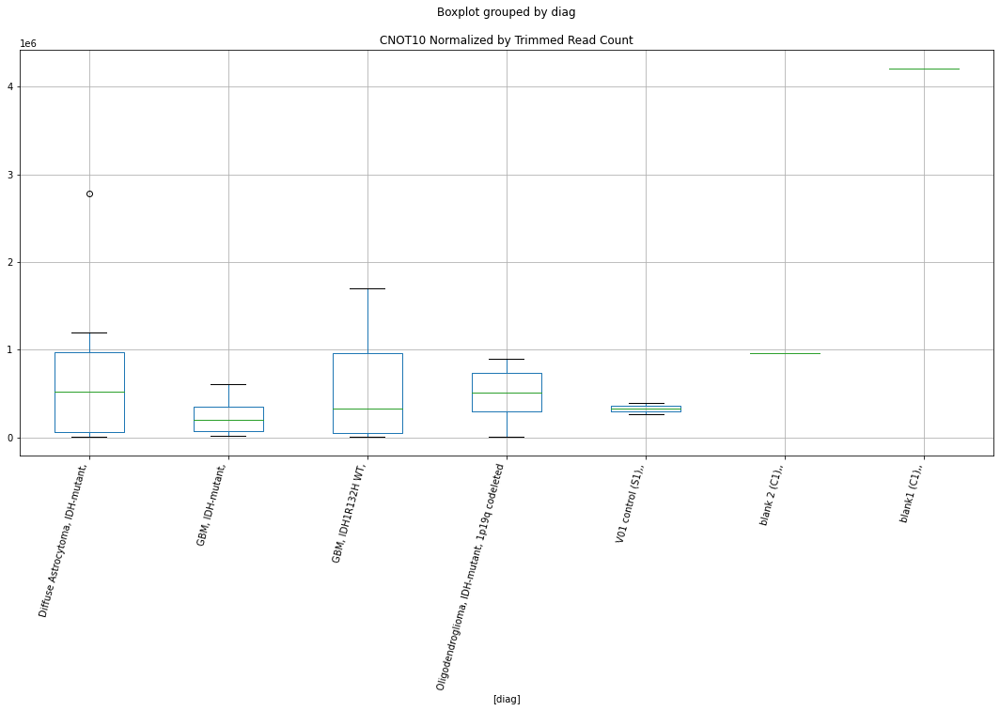

 p : 0.0376399127343476  ( t : 2.2440800292066316 ) :  D-plex  :  cutadapt2  :  COL5A3
Control and blanks
76     0.0
340    0.0
Name: COL5A3, dtype: float64
208    705.44
Name: COL5A3, dtype: float64
472    1733.87
Name: COL5A3, dtype: float64


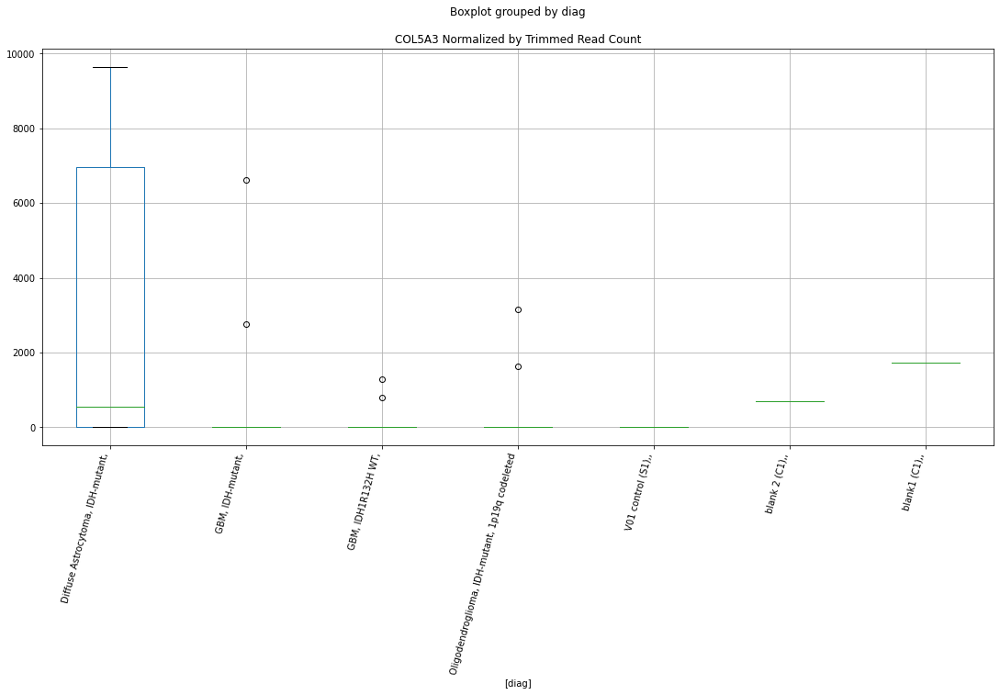

 p : 0.03764883745061378  ( t : 2.243961889676068 ) :  D-plex  :  cutadapt2  :  COL24A1
Control and blanks
76     259861.67
340     24660.50
Name: COL24A1, dtype: float64
208    165425.88
Name: COL24A1, dtype: float64
472    190147.47
Name: COL24A1, dtype: float64


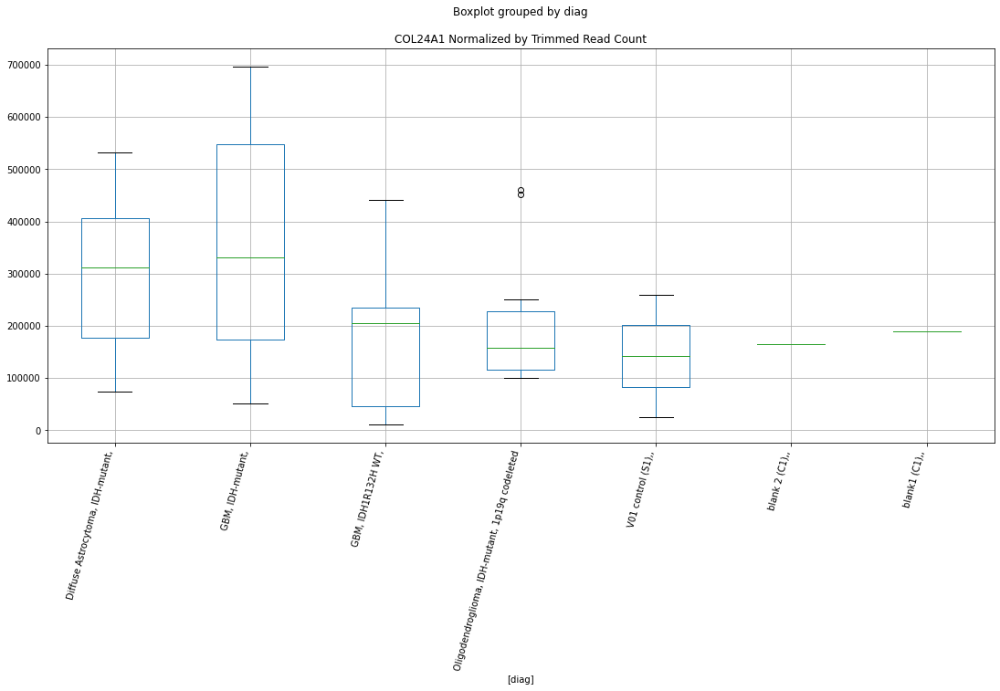

 p : 0.03764973005332872  ( t : 2.243950075408647 ) :  Lexogen  :  cutadapt2  :  C1R
Control and blanks
82       0.00
346    841.74
Name: C1R, dtype: float64
214    2712.26
Name: C1R, dtype: float64
478    474.92
Name: C1R, dtype: float64


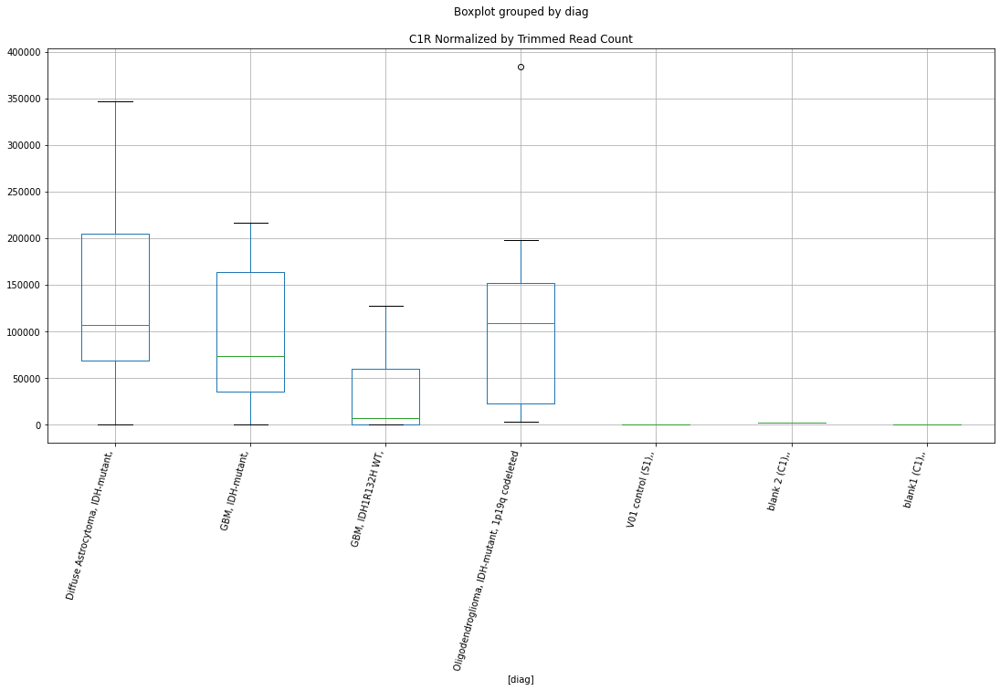

 p : 0.03769972755233675  ( t : 2.243288733088888 ) :  Lexogen  :  cutadapt2  :  ANKRD60
Control and blanks
82     0.0
346    0.0
Name: ANKRD60, dtype: float64
214    0.0
Name: ANKRD60, dtype: float64
478    0.0
Name: ANKRD60, dtype: float64


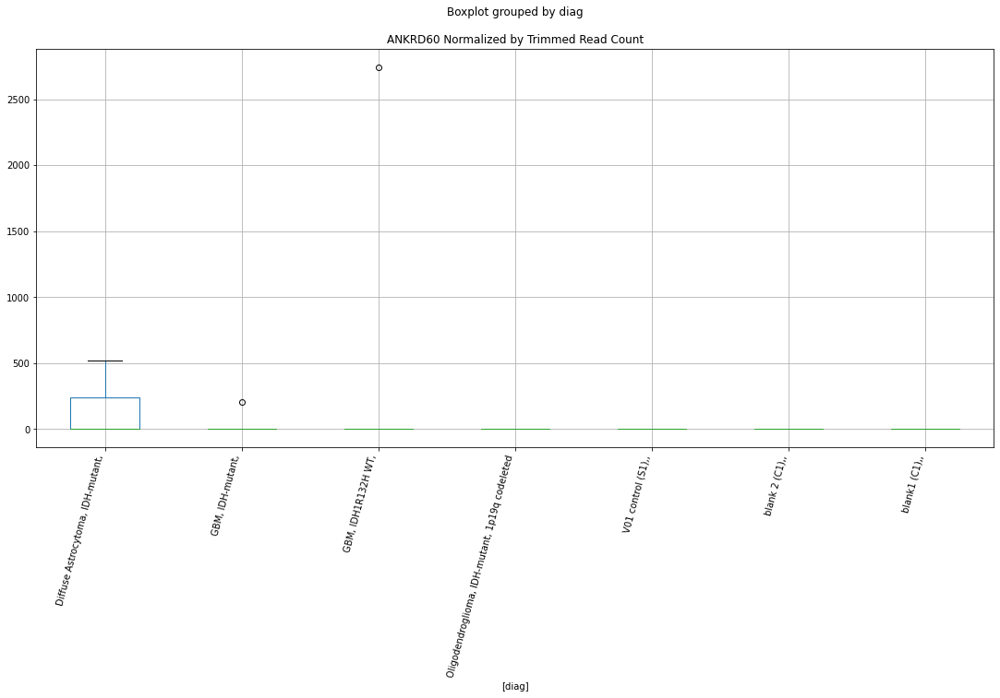

 p : 0.03776283934167251  ( t : 2.2424550753870722 ) :  Lexogen  :  bbduk2  :  C1R
Control and blanks
79       0.00
343    849.26
Name: C1R, dtype: float64
211    2733.06
Name: C1R, dtype: float64
475    479.03
Name: C1R, dtype: float64


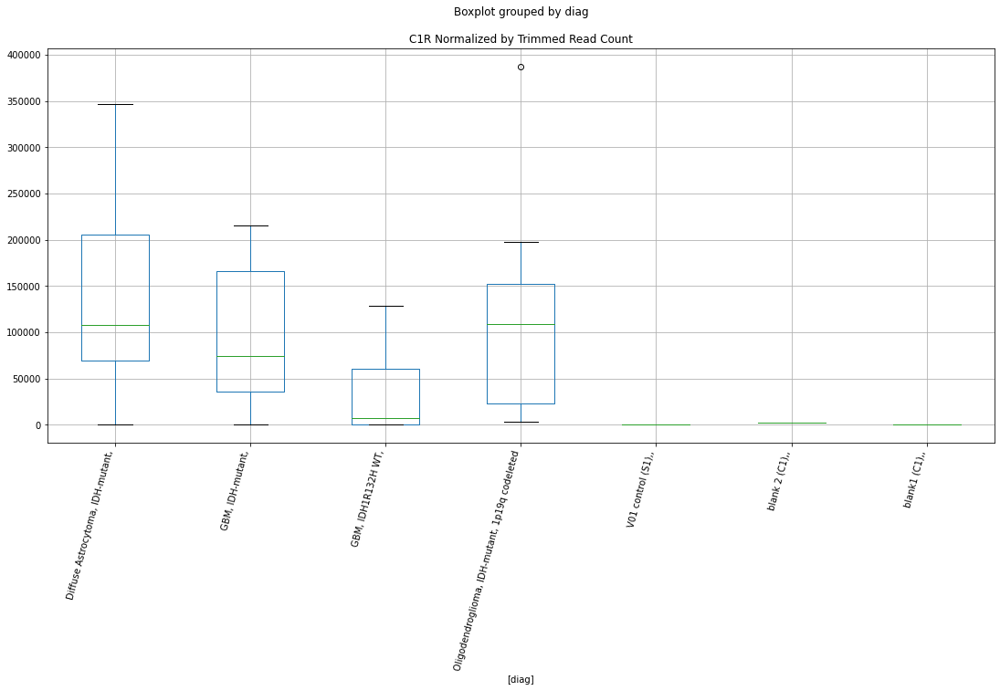

 p : 0.03777443044567815  ( t : 2.2423021055831205 ) :  Lexogen  :  bbduk2  :  CDH3
Control and blanks
79     4291.8
343       0.0
Name: CDH3, dtype: float64
211    0.0
Name: CDH3, dtype: float64
475    0.0
Name: CDH3, dtype: float64


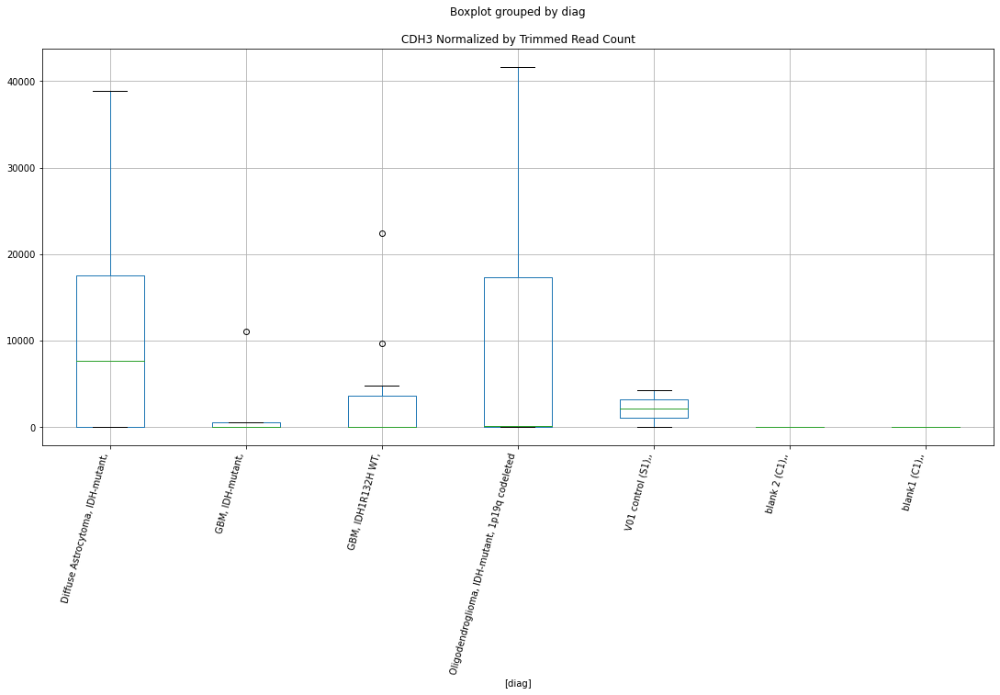

 p : 0.03778205407356915  ( t : 2.2422015188429607 ) :  D-plex  :  bbduk2  :  CACTIN
Control and blanks
73     0.0
337    0.0
Name: CACTIN, dtype: float64
205    3581.82
Name: CACTIN, dtype: float64
469    4732.22
Name: CACTIN, dtype: float64


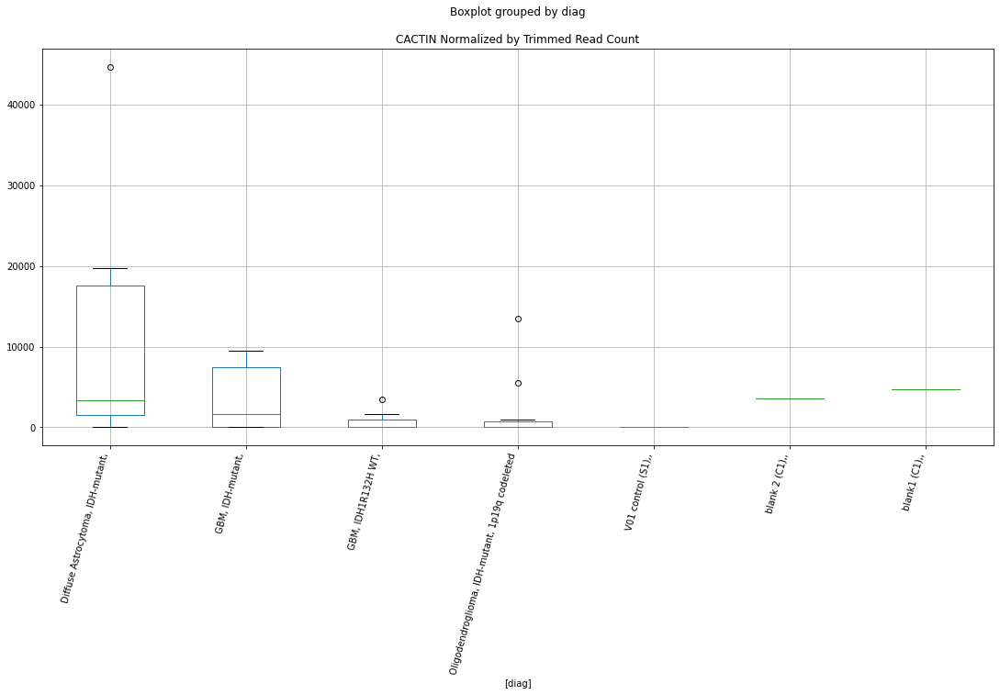

 p : 0.03784008661154387  ( t : 2.241436445926461 ) :  Lexogen  :  cutadapt2  :  CERS3
Control and blanks
82     0.0
346    0.0
Name: CERS3, dtype: float64
214    0.0
Name: CERS3, dtype: float64
478    0.0
Name: CERS3, dtype: float64


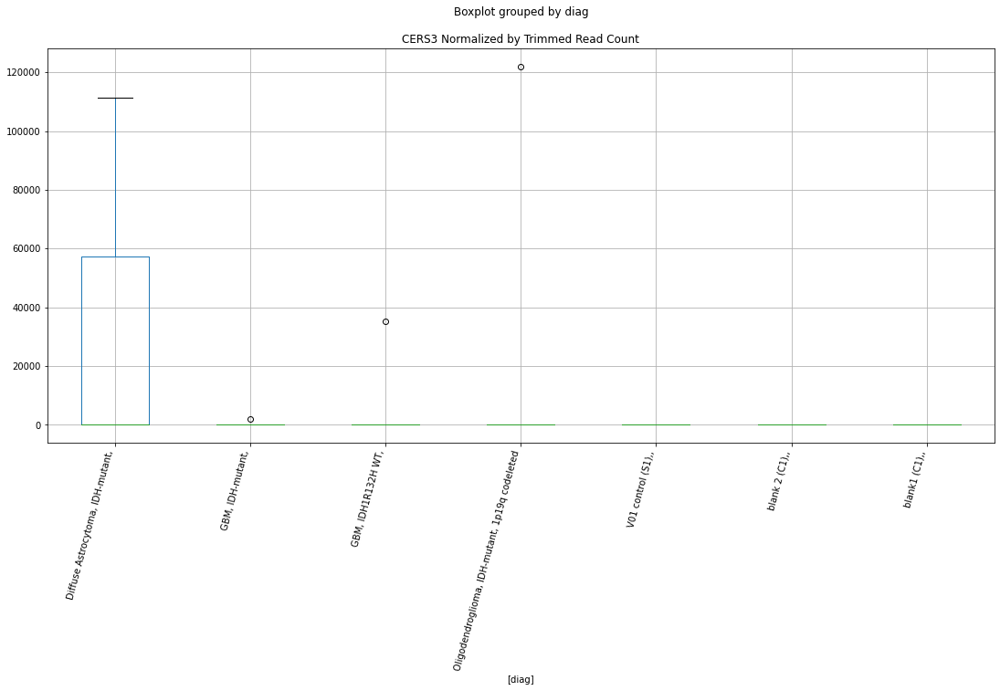

 p : 0.03784302954320524  ( t : 2.241397676570119 ) :  Lexogen  :  bbduk2  :  CERS3
Control and blanks
79     0.0
343    0.0
Name: CERS3, dtype: float64
211    0.0
Name: CERS3, dtype: float64
475    0.0
Name: CERS3, dtype: float64


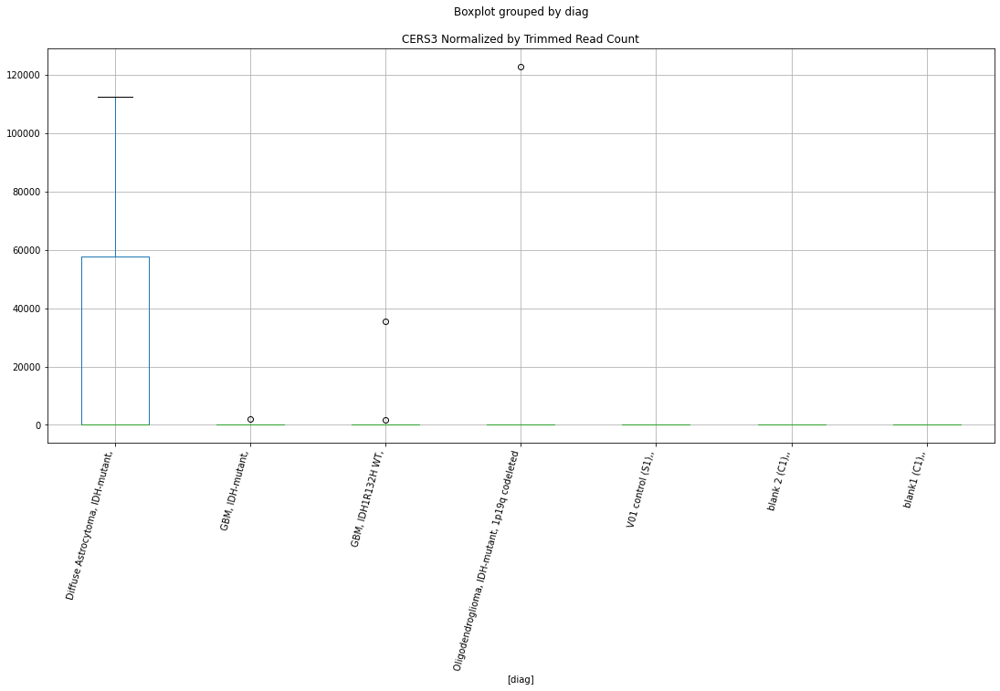

 p : 0.037854861598087326  ( t : 2.241241832449901 ) :  D-plex  :  cutadapt2  :  CA4
Control and blanks
76     0.0
340    0.0
Name: CA4, dtype: float64
208    6701.69
Name: CA4, dtype: float64
472    2889.78
Name: CA4, dtype: float64


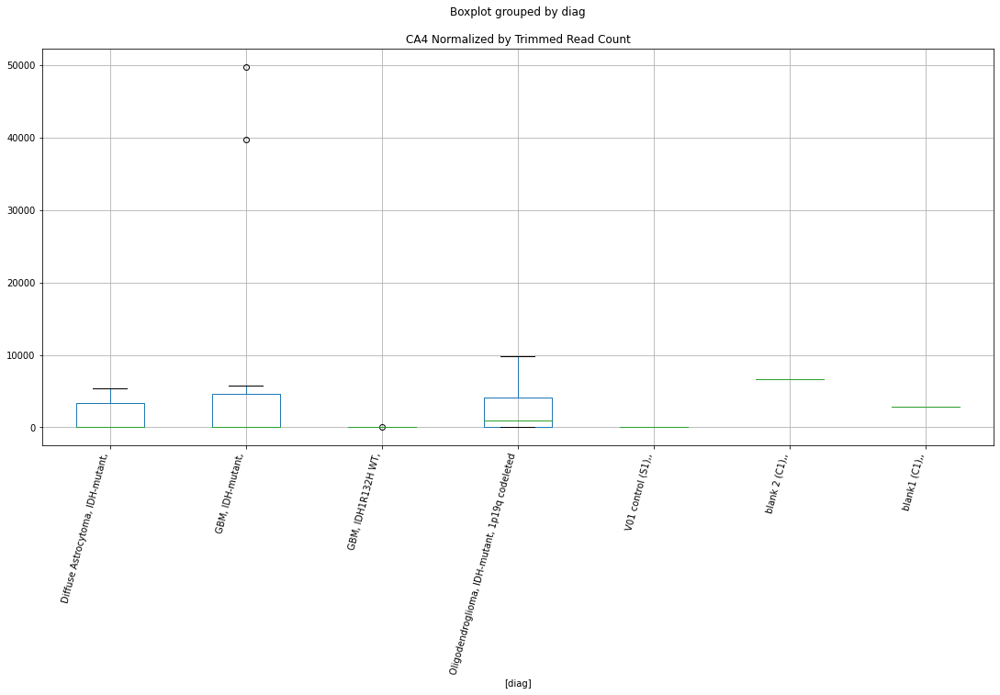

 p : 0.03789495621253653  ( t : 2.2407140660728935 ) :  D-plex  :  cutadapt2  :  CDC25B
Control and blanks
76        0.00
340    3522.93
Name: CDC25B, dtype: float64
208    41444.65
Name: CDC25B, dtype: float64
472    4045.69
Name: CDC25B, dtype: float64


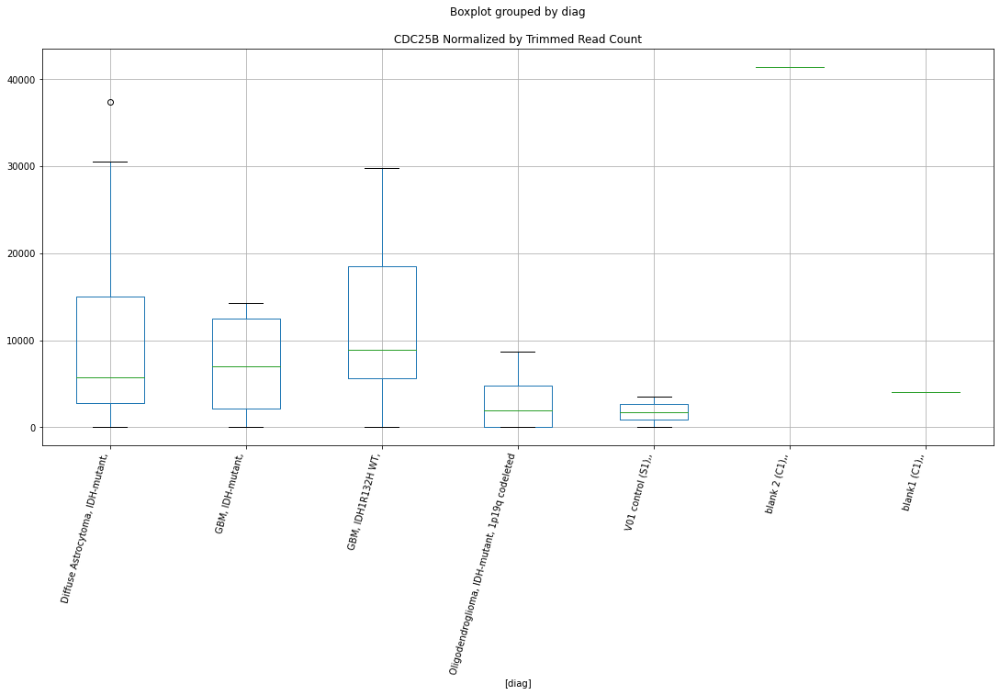

 p : 0.03791687114132273  ( t : 2.2404258169135702 ) :  D-plex  :  bbduk2  :  C8orf74
Control and blanks
73        0.00
337    2670.47
Name: C8orf74, dtype: float64
205    537.27
Name: C8orf74, dtype: float64
469    0.0
Name: C8orf74, dtype: float64


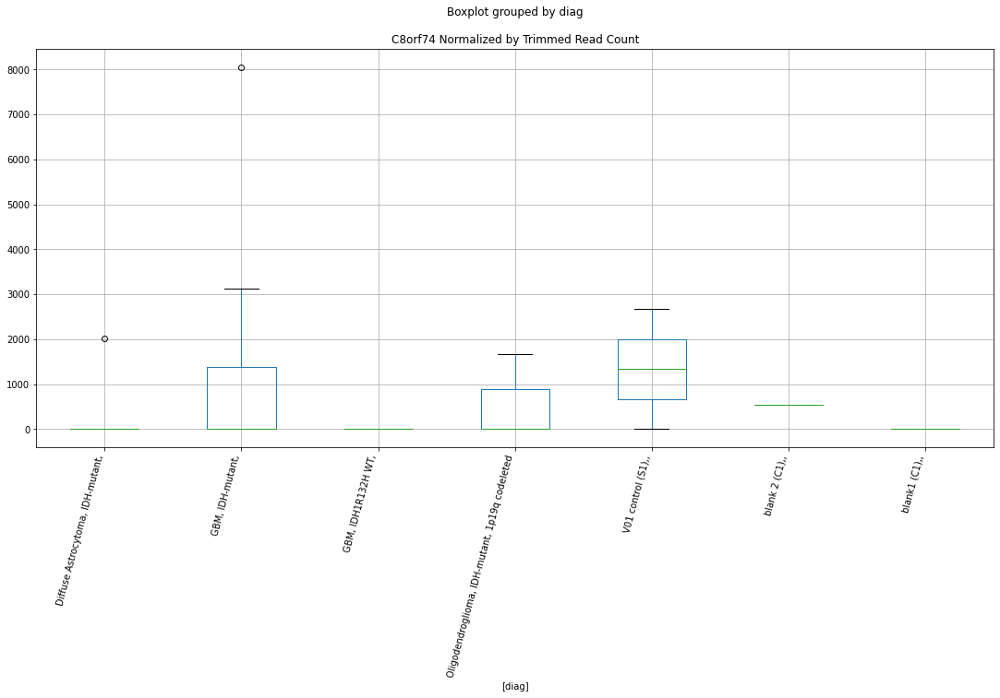

 p : 0.0379589769100898  ( t : 2.2398724265174064 ) :  D-plex  :  bbduk2  :  DENND2D
Control and blanks
73     0.0
337    0.0
Name: DENND2D, dtype: float64
205    2865.46
Name: DENND2D, dtype: float64
469    0.0
Name: DENND2D, dtype: float64


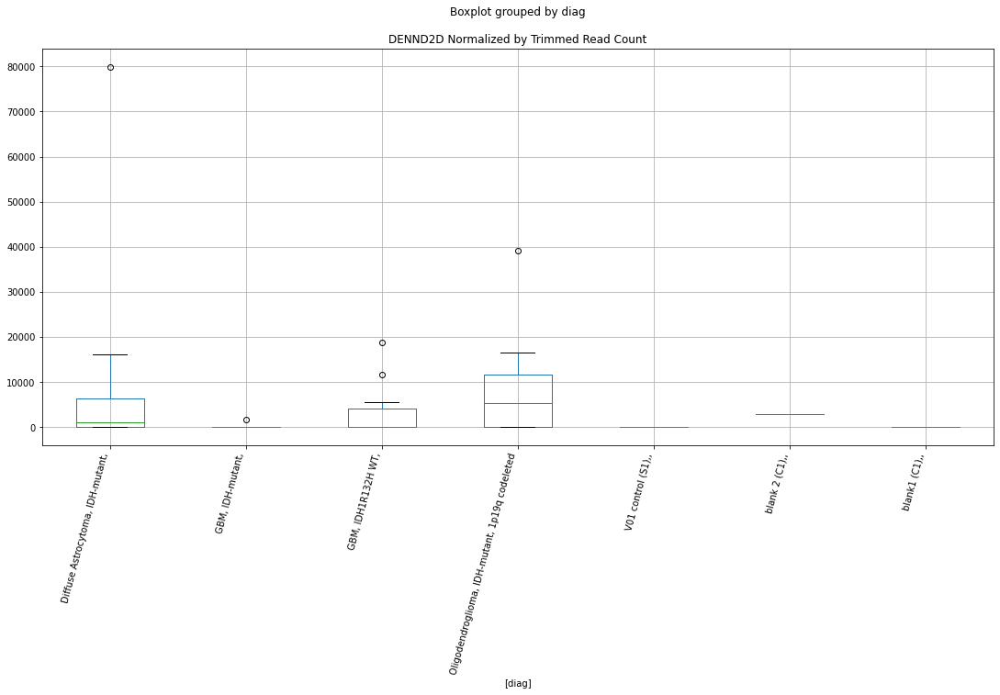

 p : 0.03798008740386239  ( t : 2.239595187136932 ) :  Lexogen  :  bbduk2  :  ADRA1A
Control and blanks
79          0.00
343    192993.71
Name: ADRA1A, dtype: float64
211    546.61
Name: ADRA1A, dtype: float64
475    239.52
Name: ADRA1A, dtype: float64


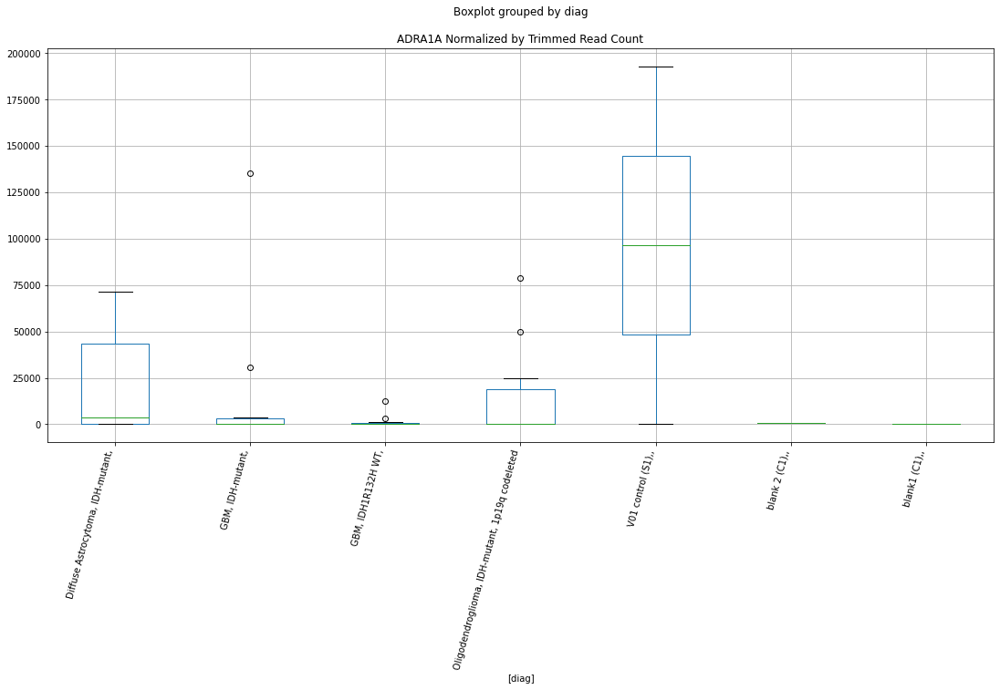

 p : 0.03807597494164119  ( t : 2.238337703016786 ) :  D-plex  :  bbduk2  :  C15orf40
Control and blanks
73     2319.03
337    8901.57
Name: C15orf40, dtype: float64
205    14685.46
Name: C15orf40, dtype: float64
469    11830.55
Name: C15orf40, dtype: float64


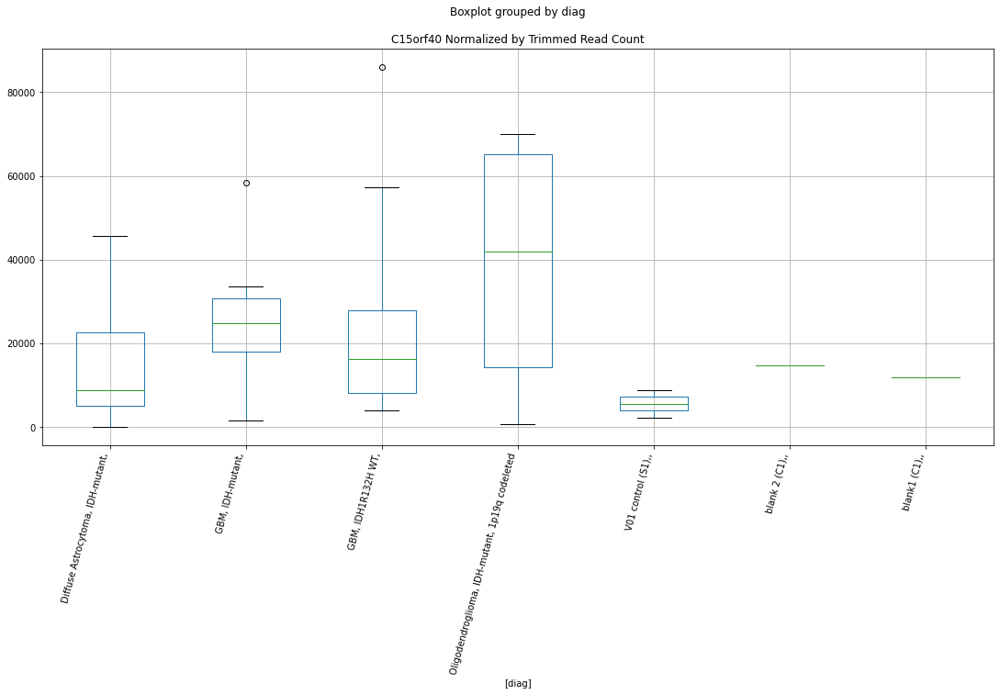

 p : 0.038108424042509734  ( t : 2.2379128214926354 ) :  Lexogen  :  bbduk2  :  ASXL2
Control and blanks
79        0.0
343    7431.0
Name: ASXL2, dtype: float64
211    0.0
Name: ASXL2, dtype: float64
475    718.55
Name: ASXL2, dtype: float64


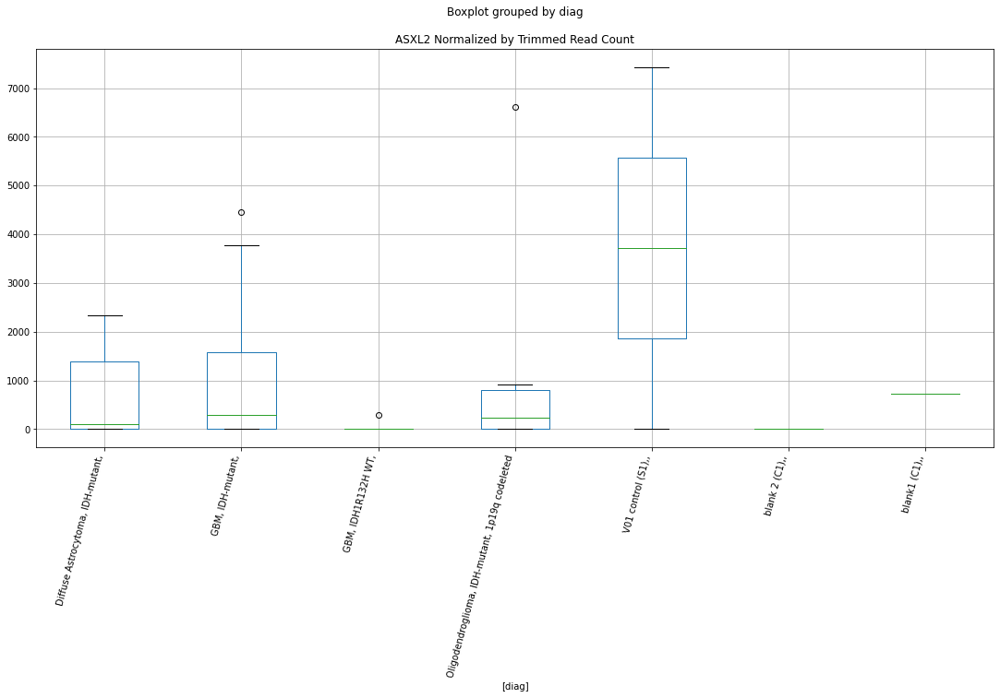

 p : 0.03812782237083961  ( t : 2.237658983211219 ) :  D-plex  :  bbduk2  :  DDX41
Control and blanks
73     0.0
337    0.0
Name: DDX41, dtype: float64
205    2149.09
Name: DDX41, dtype: float64
469    0.0
Name: DDX41, dtype: float64


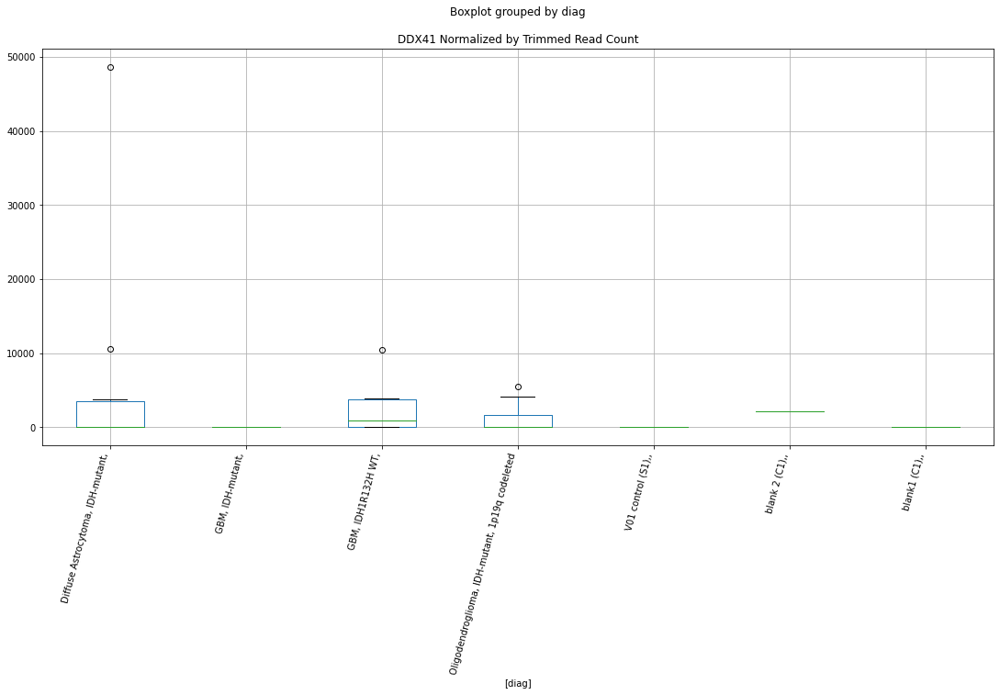

 p : 0.038215706639486834  ( t : 2.236510456262166 ) :  D-plex  :  bbduk2  :  CYP4F3
Control and blanks
73     4638.05
337       0.00
Name: CYP4F3, dtype: float64
205    2507.27
Name: CYP4F3, dtype: float64
469    3549.16
Name: CYP4F3, dtype: float64


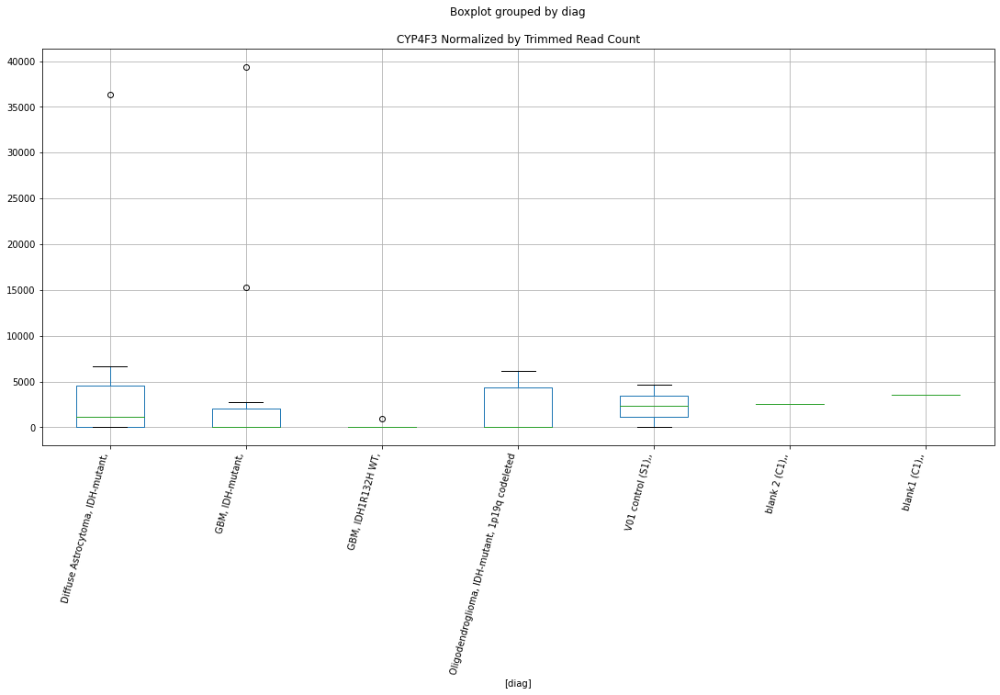

 p : 0.03822619538411982  ( t : 2.2363735453910505 ) :  D-plex  :  bbduk2  :  ACOX1
Control and blanks
73     0.0
337    0.0
Name: ACOX1, dtype: float64
205    1790.91
Name: ACOX1, dtype: float64
469    2957.64
Name: ACOX1, dtype: float64


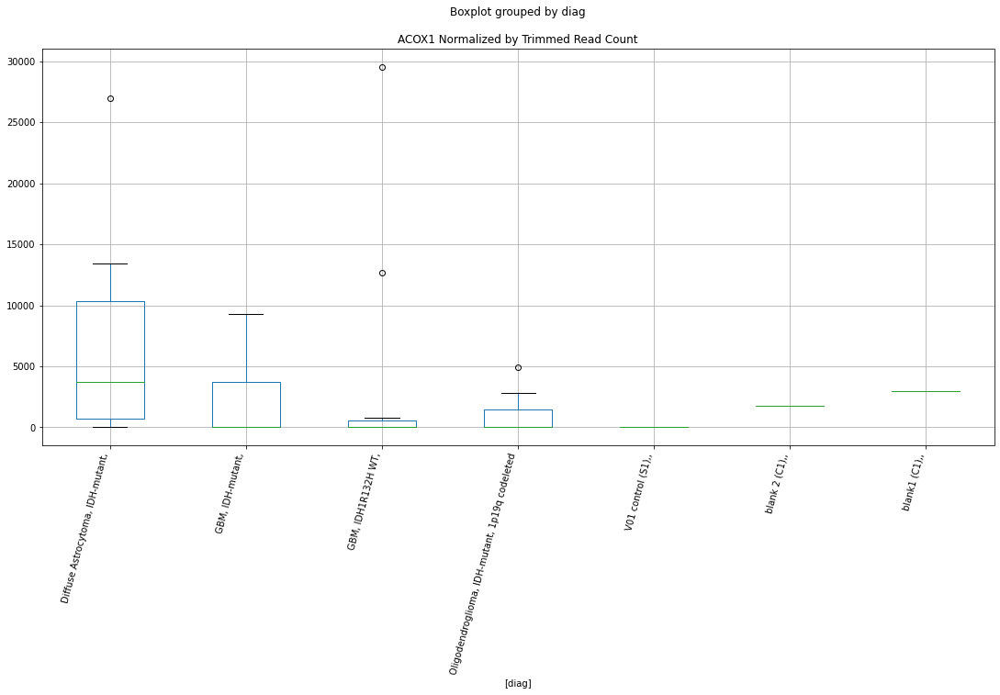

 p : 0.03823988495028511  ( t : 2.2361949058780946 ) :  D-plex  :  cutadapt2  :  ACOX1
Control and blanks
76     0.0
340    0.0
Name: ACOX1, dtype: float64
208    1763.6
Name: ACOX1, dtype: float64
472    2889.78
Name: ACOX1, dtype: float64


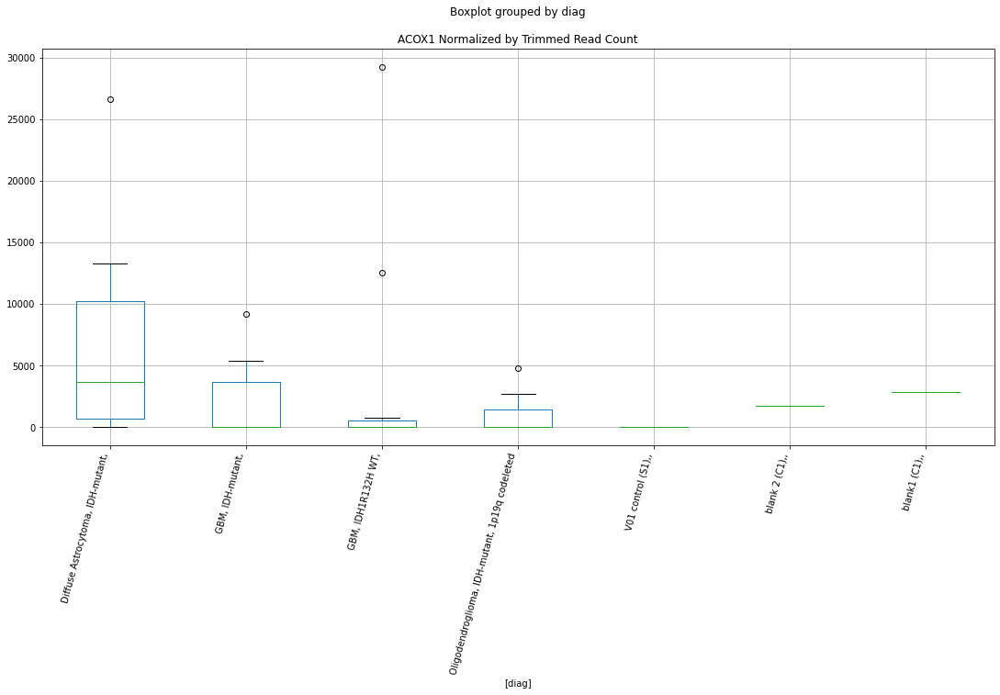

 p : 0.03825391035848193  ( t : 2.23601194497136 ) :  D-plex  :  cutadapt2  :  C9orf47
Control and blanks
76     0.0
340    0.0
Name: C9orf47, dtype: float64
208    2469.04
Name: C9orf47, dtype: float64
472    2311.82
Name: C9orf47, dtype: float64


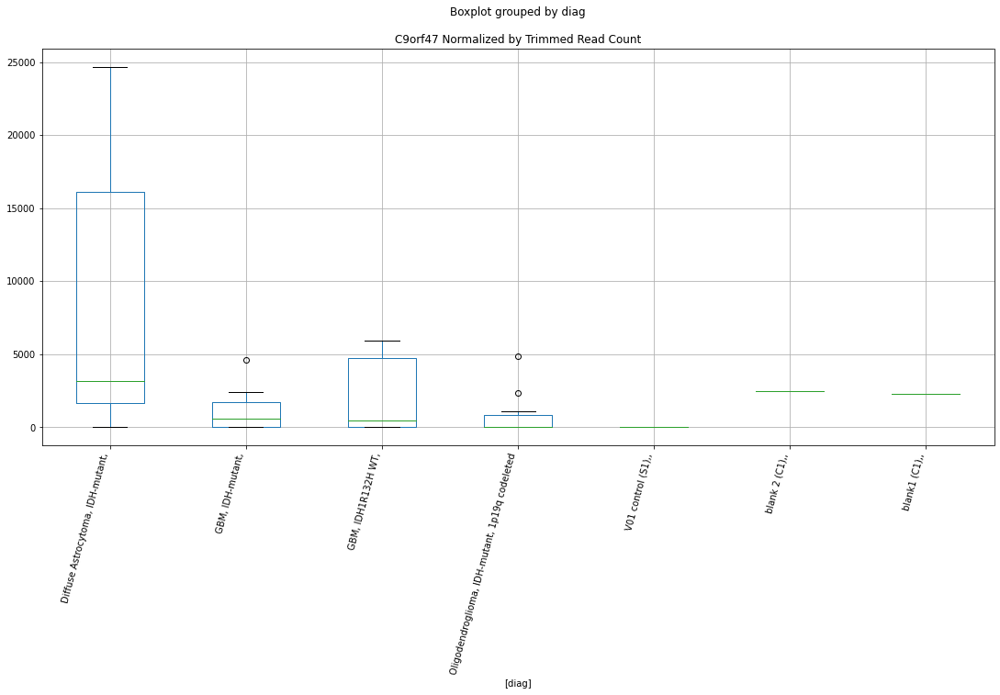

 p : 0.038286132503848255  ( t : 2.2355918423897236 ) :  D-plex  :  bbduk2  :  AHSA1
Control and blanks
73     0.0
337    0.0
Name: AHSA1, dtype: float64
205    0.0
Name: AHSA1, dtype: float64
469    0.0
Name: AHSA1, dtype: float64


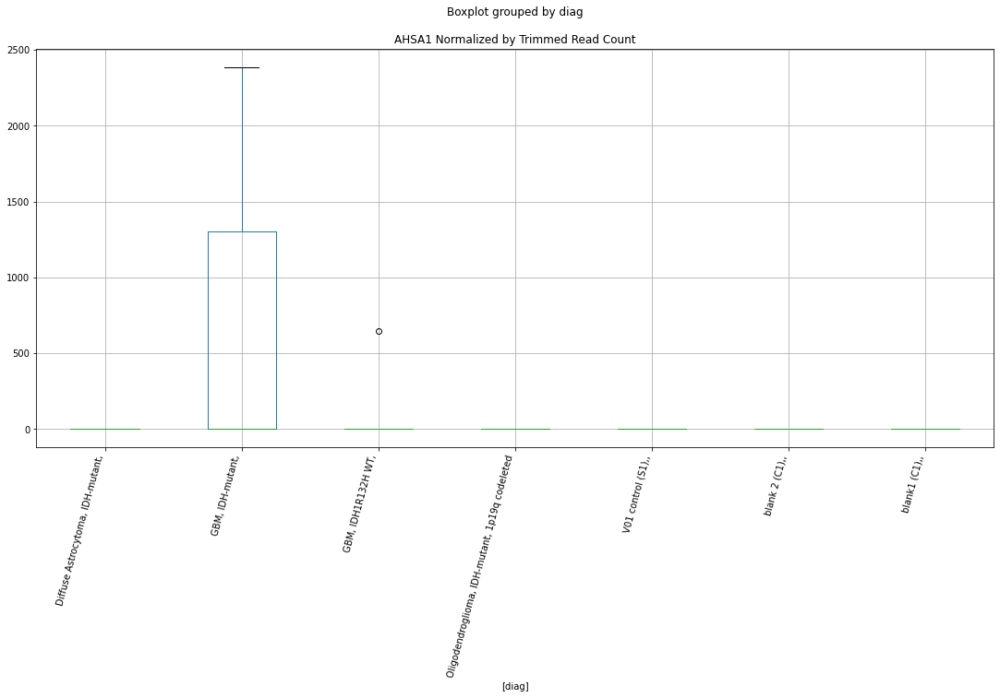

 p : 0.03831694400759308  ( t : 2.235190435968396 ) :  Lexogen  :  bbduk2  :  CD53
Control and blanks
79     0.0
343    0.0
Name: CD53, dtype: float64
211    0.0
Name: CD53, dtype: float64
475    239.52
Name: CD53, dtype: float64


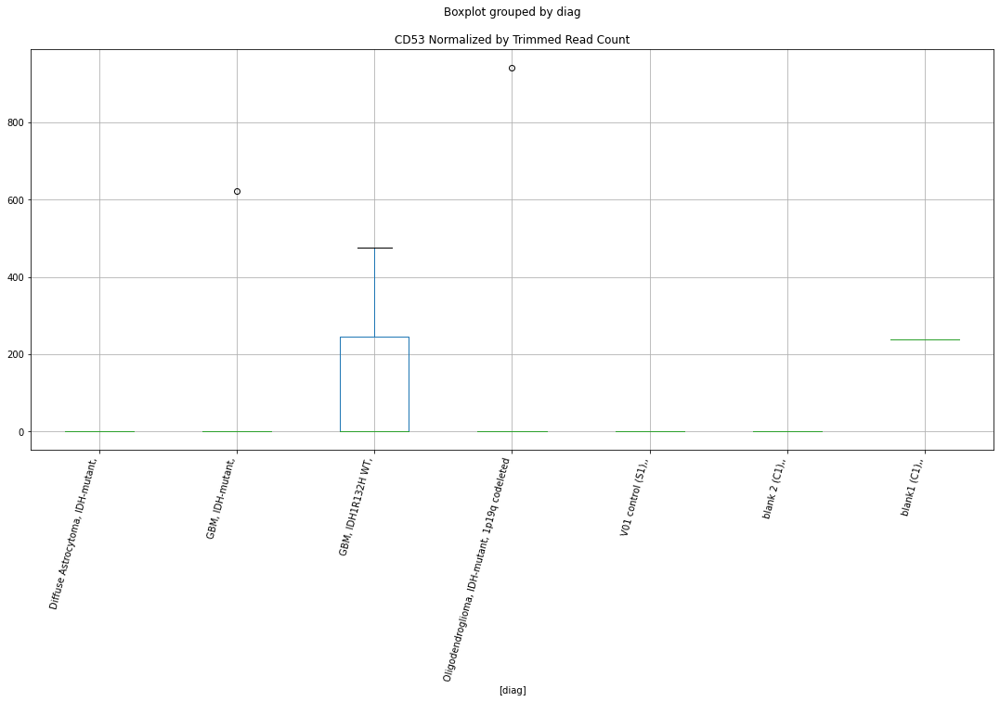

 p : 0.03835205453847851  ( t : 2.2347333850821 ) :  D-plex  :  cutadapt2  :  COL13A1
Control and blanks
76     0.0
340    0.0
Name: COL13A1, dtype: float64
208    1234.52
Name: COL13A1, dtype: float64
472    0.0
Name: COL13A1, dtype: float64


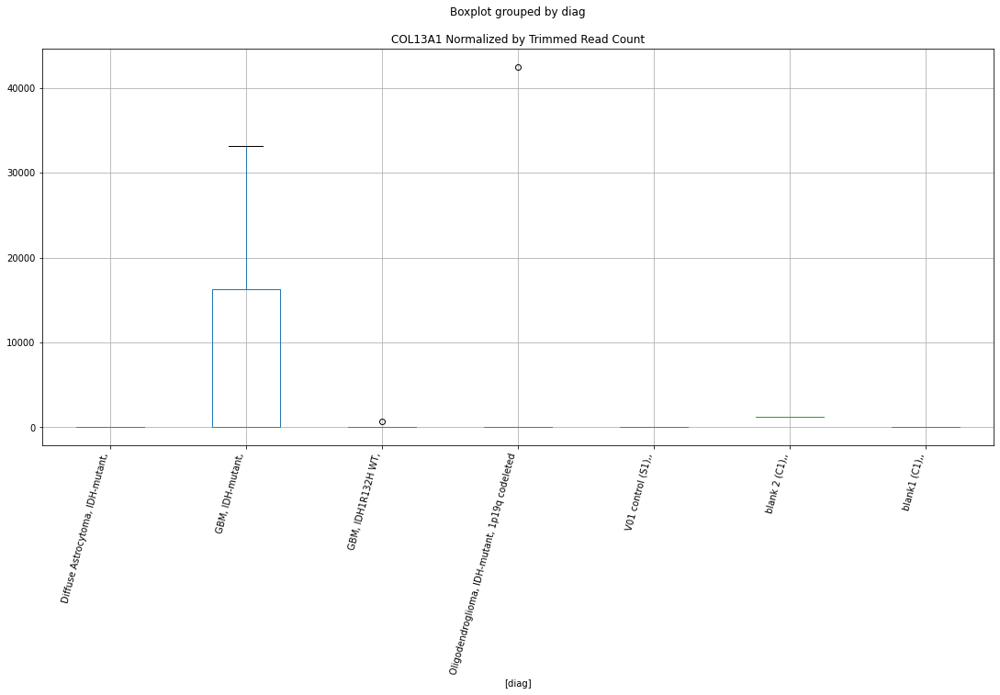

 p : 0.03837518741582941  ( t : 2.2344324638100055 ) :  D-plex  :  bbduk2  :  BTBD11
Control and blanks
73     1546.02
337       0.00
Name: BTBD11, dtype: float64
205    7880.0
Name: BTBD11, dtype: float64
469    5323.75
Name: BTBD11, dtype: float64


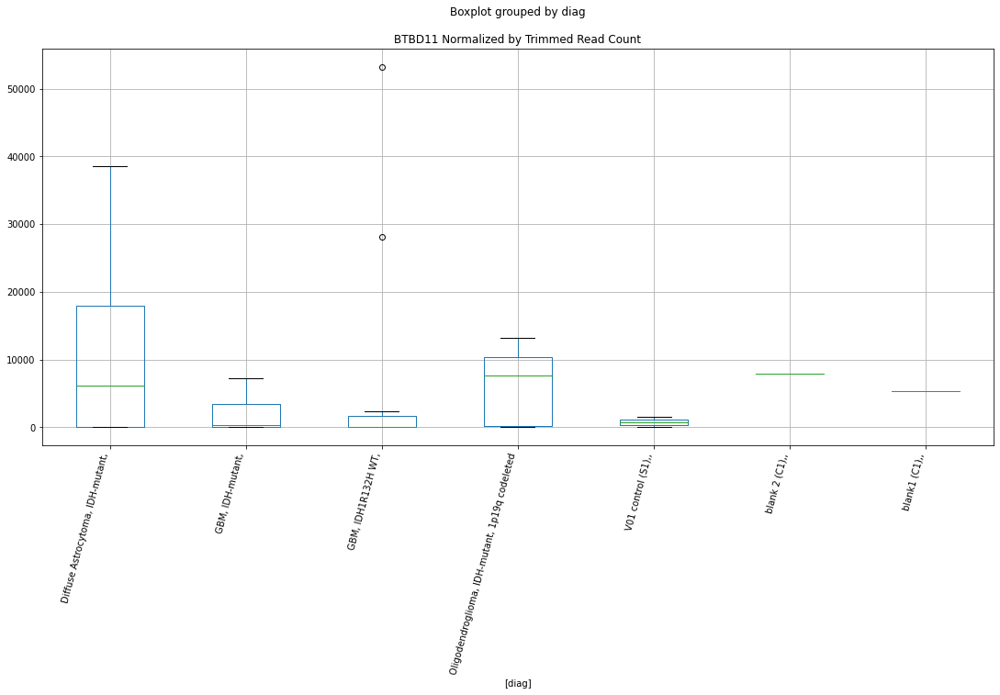

 p : 0.038377536936587554  ( t : 2.2344019097013215 ) :  D-plex  :  bbduk2  :  CYBB
Control and blanks
73     0.0
337    0.0
Name: CYBB, dtype: float64
205    1790.91
Name: CYBB, dtype: float64
469    4140.69
Name: CYBB, dtype: float64


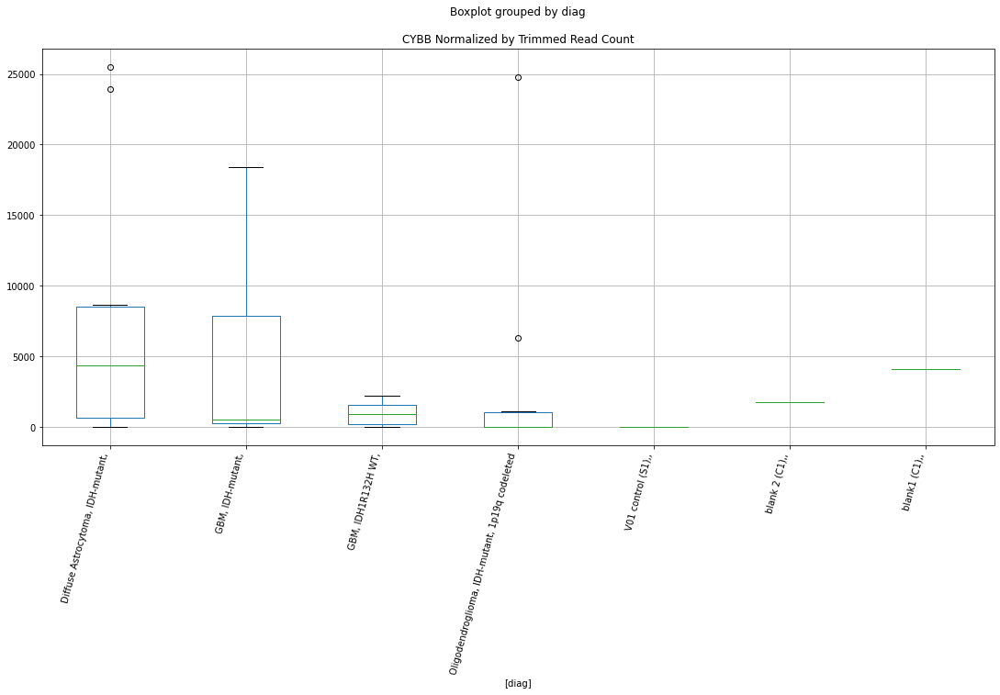

 p : 0.03846098738644878  ( t : 2.233317802904171 ) :  D-plex  :  cutadapt2  :  DDX41
Control and blanks
76     0.0
340    0.0
Name: DDX41, dtype: float64
208    1410.88
Name: DDX41, dtype: float64
472    0.0
Name: DDX41, dtype: float64


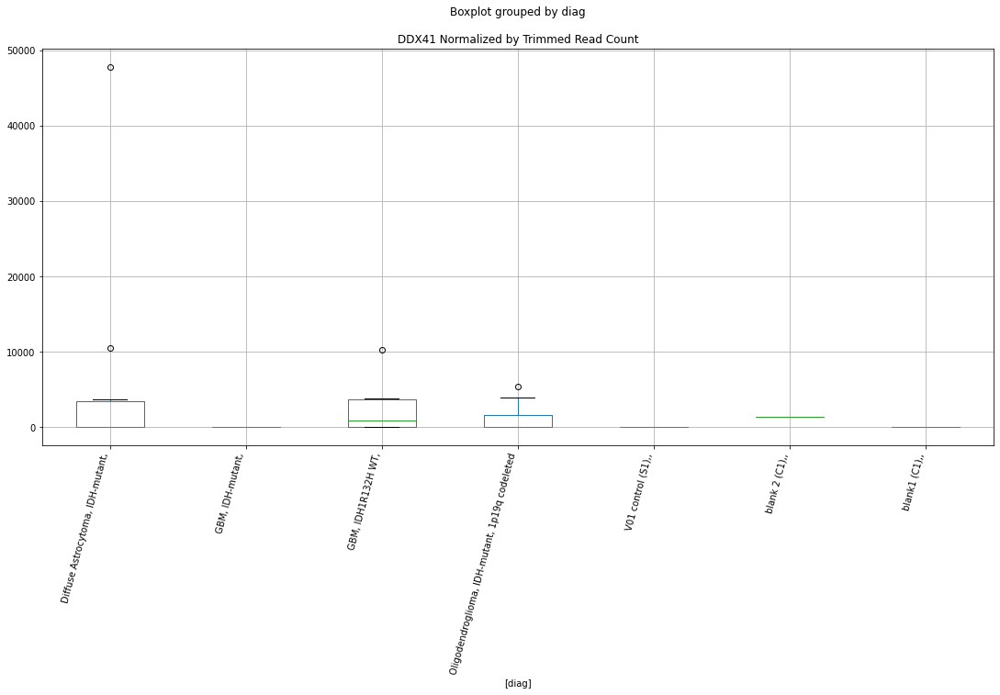

 p : 0.03849417574649372  ( t : 2.2328872544019305 ) :  D-plex  :  bbduk2  :  CSDE1
Control and blanks
73     0.0
337    0.0
Name: CSDE1, dtype: float64
205    4298.18
Name: CSDE1, dtype: float64
469    0.0
Name: CSDE1, dtype: float64


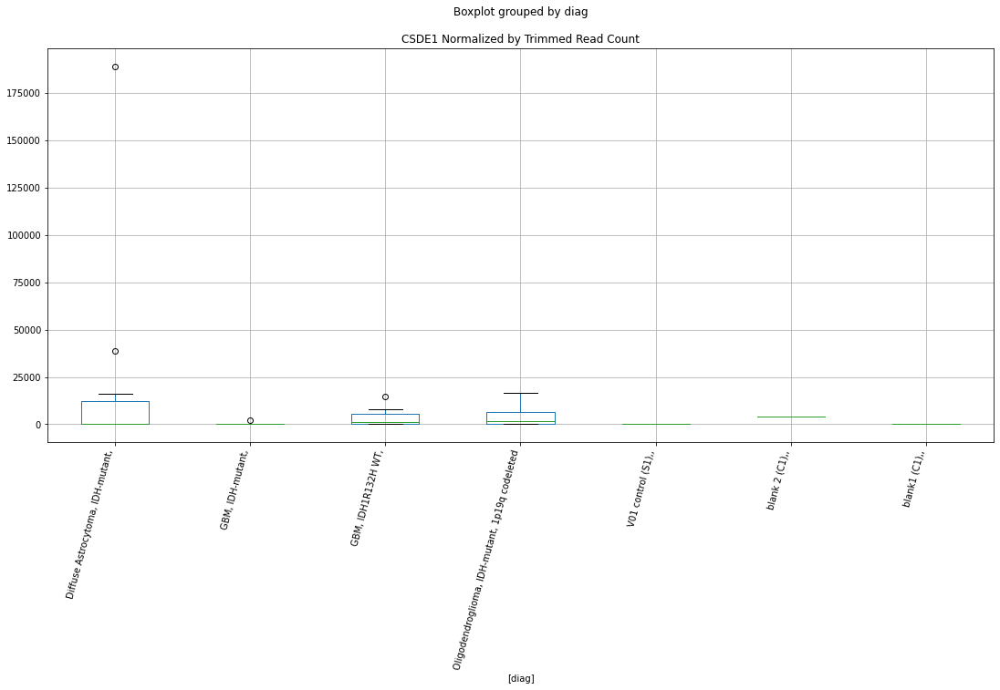

 p : 0.03856999508196614  ( t : 2.2319049411949807 ) :  D-plex  :  bbduk2  :  ARHGAP12
Control and blanks
73     0.0
337    0.0
Name: ARHGAP12, dtype: float64
205    9491.82
Name: ARHGAP12, dtype: float64
469    5323.75
Name: ARHGAP12, dtype: float64


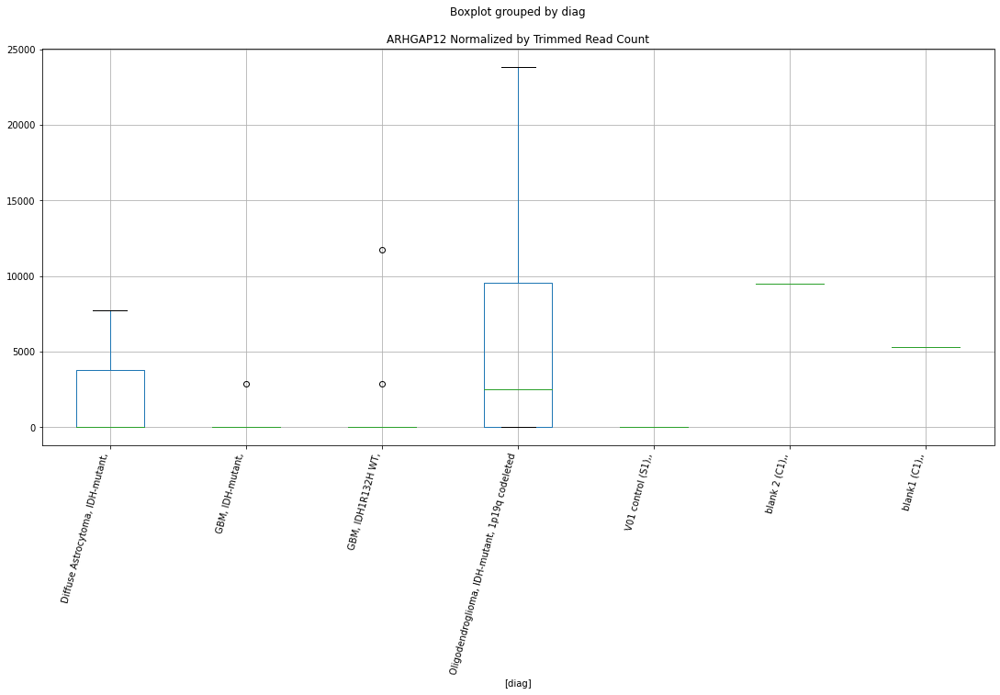

 p : 0.038629045684340016  ( t : 2.231141114744061 ) :  D-plex  :  cutadapt2  :  CDC27P9
Control and blanks
76      3030.46
340    52843.93
Name: CDC27P9, dtype: float64
208    23808.63
Name: CDC27P9, dtype: float64
472    26585.97
Name: CDC27P9, dtype: float64


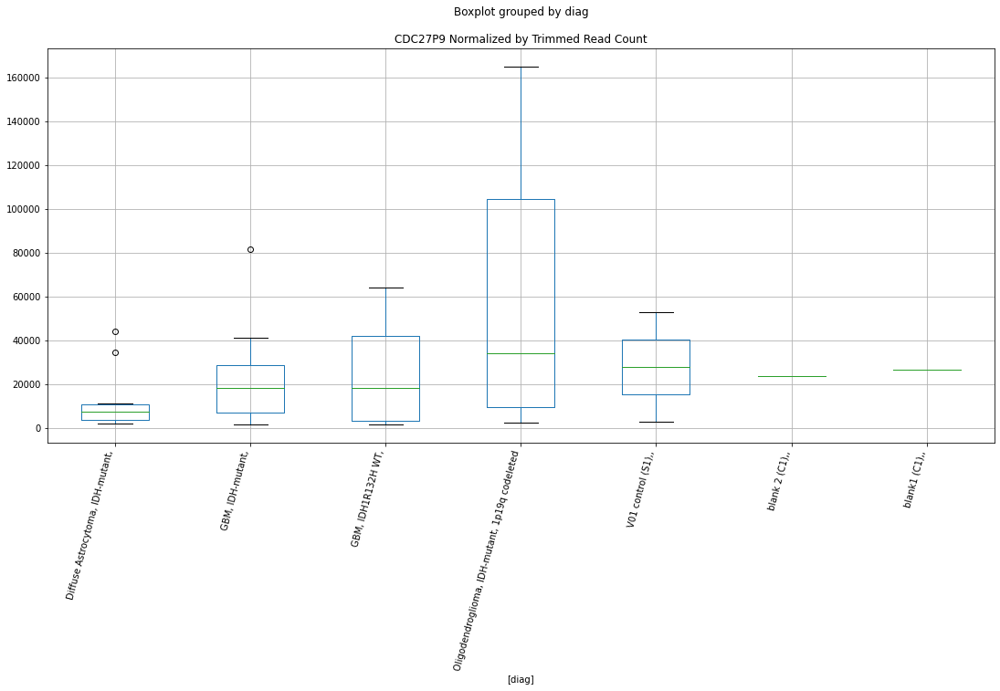

 p : 0.03866550103652437  ( t : 2.2306700973150217 ) :  D-plex  :  cutadapt2  :  APBB2
Control and blanks
76         0.0
340    27302.7
Name: APBB2, dtype: float64
208    5643.53
Name: APBB2, dtype: float64
472    10403.21
Name: APBB2, dtype: float64


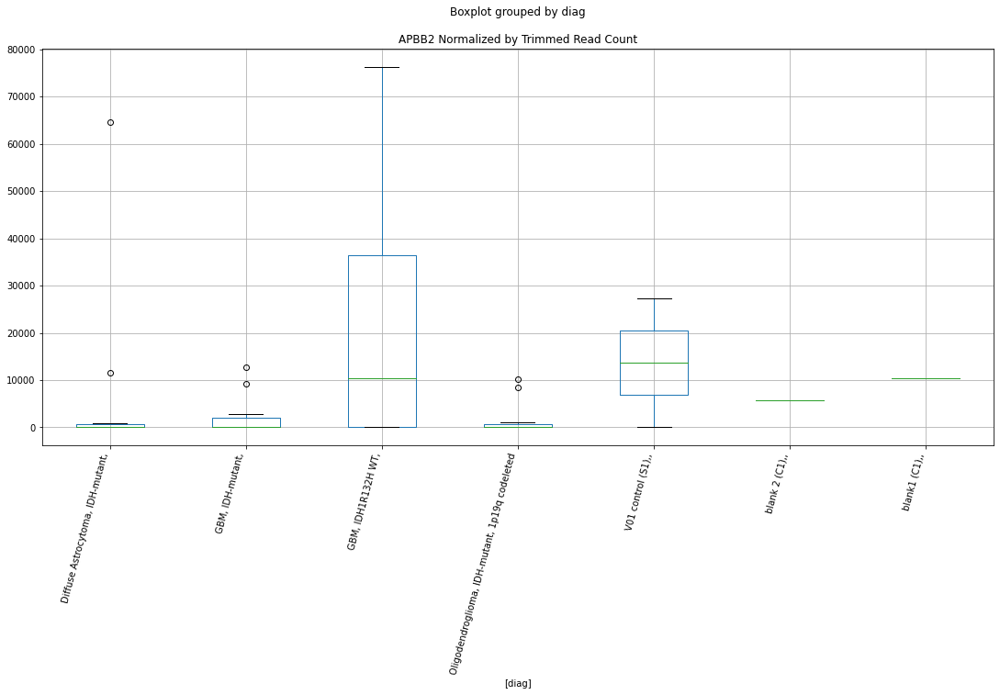

 p : 0.03869241918576935  ( t : 2.23032256675611 ) :  Lexogen  :  bbduk2  :  CNTNAP2-AS1
Control and blanks
79     0.0
343    0.0
Name: CNTNAP2-AS1, dtype: float64
211    0.0
Name: CNTNAP2-AS1, dtype: float64
475    0.0
Name: CNTNAP2-AS1, dtype: float64


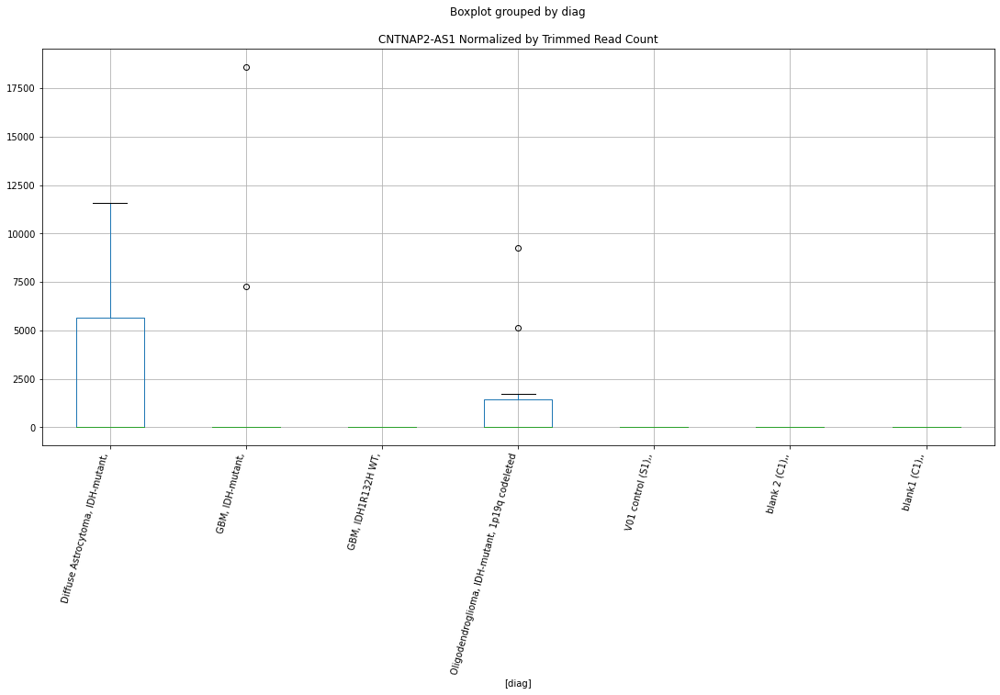

 p : 0.03872532703249503  ( t : 2.2298980077841173 ) :  Lexogen  :  cutadapt2  :  CNTNAP2-AS1
Control and blanks
82     0.0
346    0.0
Name: CNTNAP2-AS1, dtype: float64
214    0.0
Name: CNTNAP2-AS1, dtype: float64
478    0.0
Name: CNTNAP2-AS1, dtype: float64


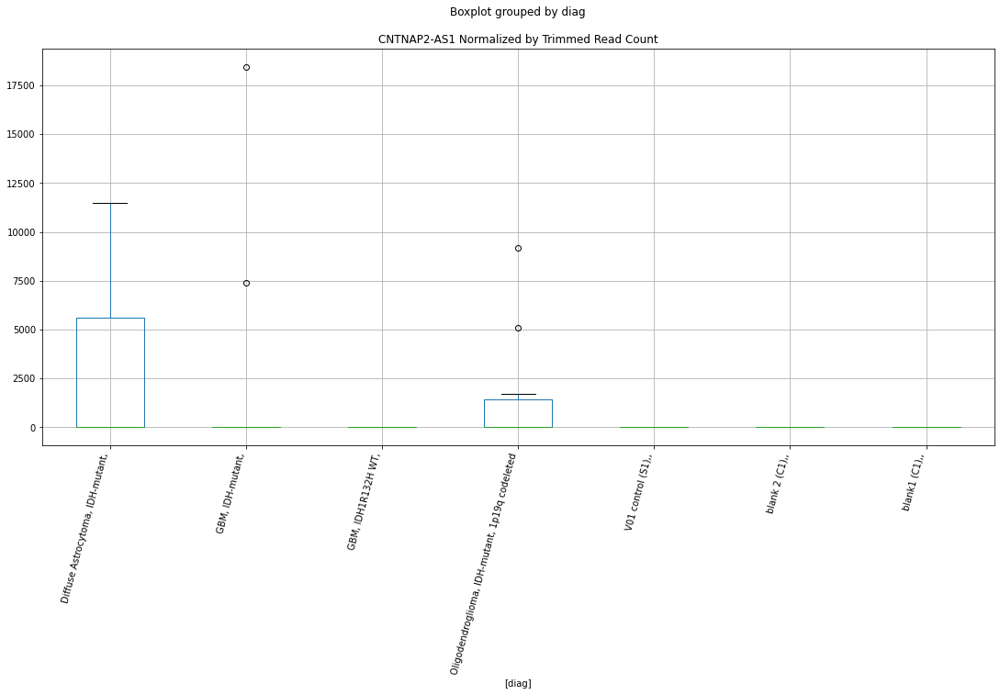

 p : 0.03882232964606774  ( t : 2.2286484639302406 ) :  Lexogen  :  bbduk2  :  CDH4
Control and blanks
79        0.00
343    1273.89
Name: CDH4, dtype: float64
211    0.0
Name: CDH4, dtype: float64
475    0.0
Name: CDH4, dtype: float64


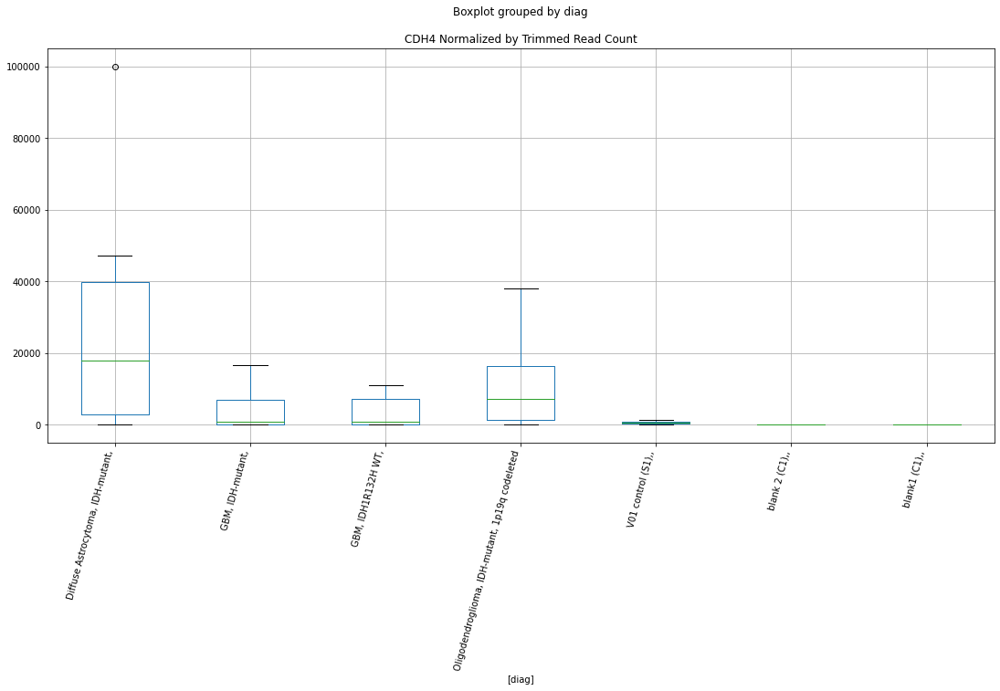

 p : 0.038826449846895254  ( t : 2.2285954530509686 ) :  D-plex  :  cutadapt2  :  ADGRV1
Control and blanks
76     0.0
340    0.0
Name: ADGRV1, dtype: float64
208    24514.07
Name: ADGRV1, dtype: float64
472    27741.88
Name: ADGRV1, dtype: float64


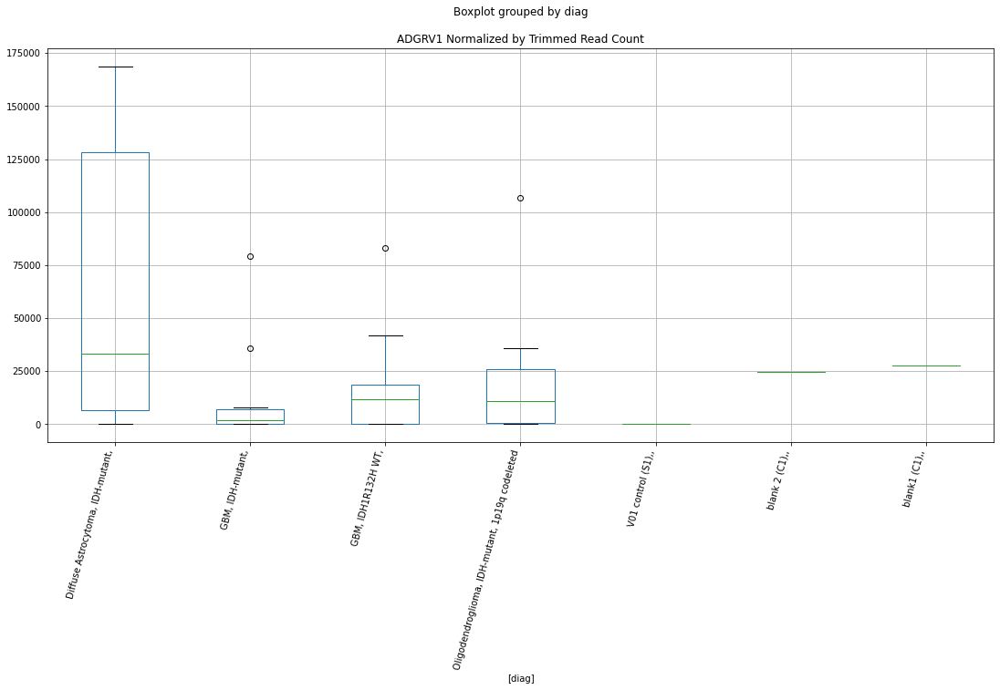

 p : 0.03883190376139258  ( t : 2.228525290457289 ) :  Lexogen  :  cutadapt2  :  CDH4
Control and blanks
82     0.0
346    0.0
Name: CDH4, dtype: float64
214    0.0
Name: CDH4, dtype: float64
478    0.0
Name: CDH4, dtype: float64


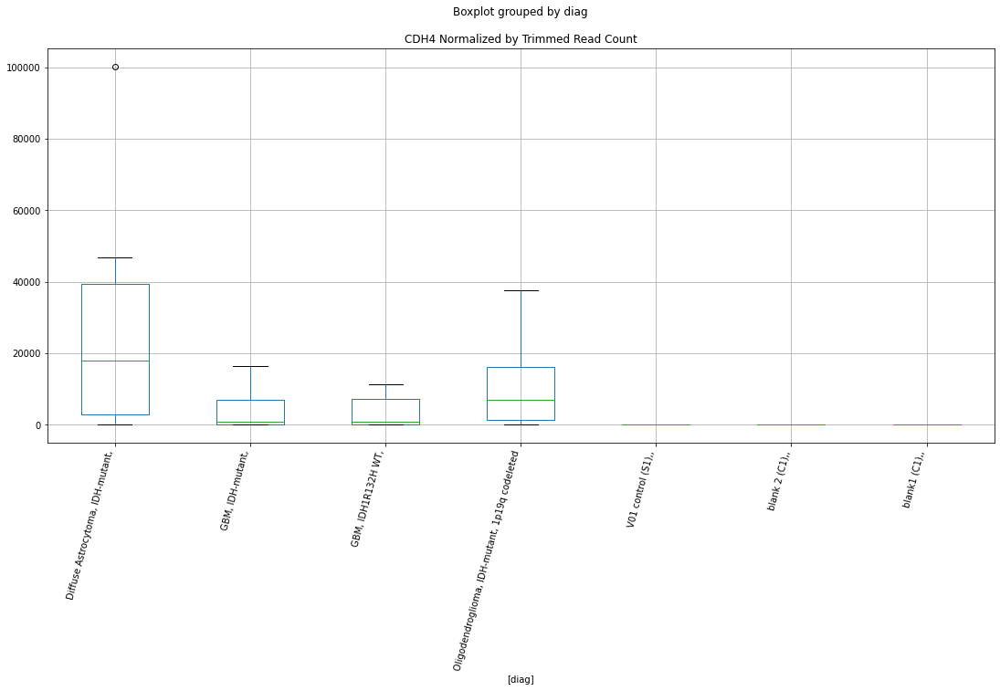

 p : 0.03896829547908  ( t : 2.2267736060745276 ) :  D-plex  :  cutadapt2  :  ARHGAP12
Control and blanks
76     0.0
340    0.0
Name: ARHGAP12, dtype: float64
208    9347.09
Name: ARHGAP12, dtype: float64
472    5201.6
Name: ARHGAP12, dtype: float64


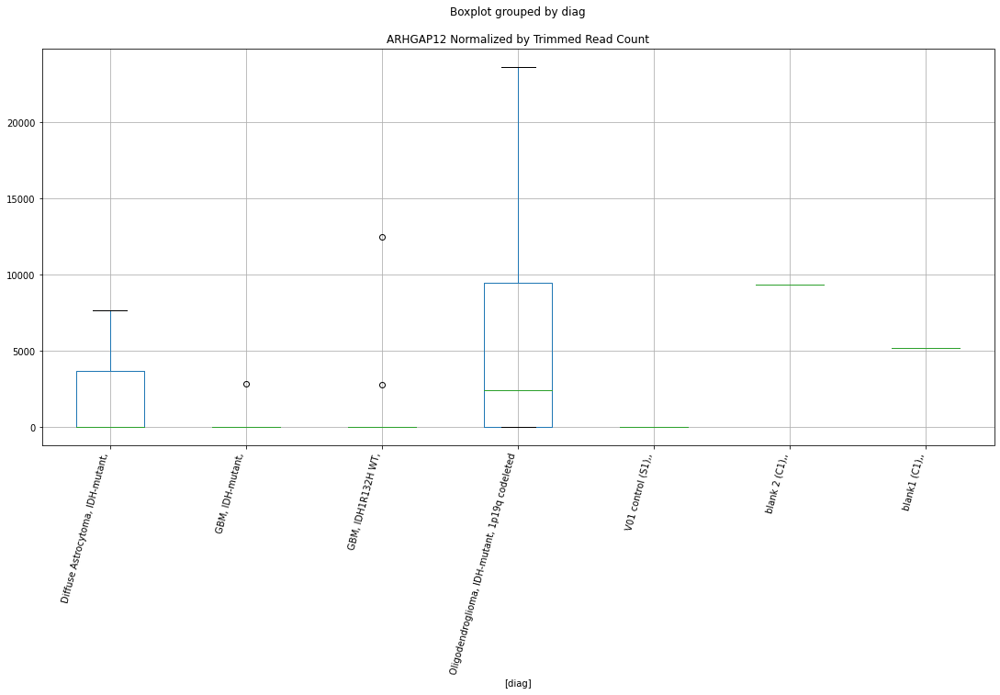

 p : 0.039090786250234474  ( t : 2.225205257184956 ) :  D-plex  :  bbduk2  :  DKK3
Control and blanks
73     0.0
337    0.0
Name: DKK3, dtype: float64
205    5014.55
Name: DKK3, dtype: float64
469    4732.22
Name: DKK3, dtype: float64


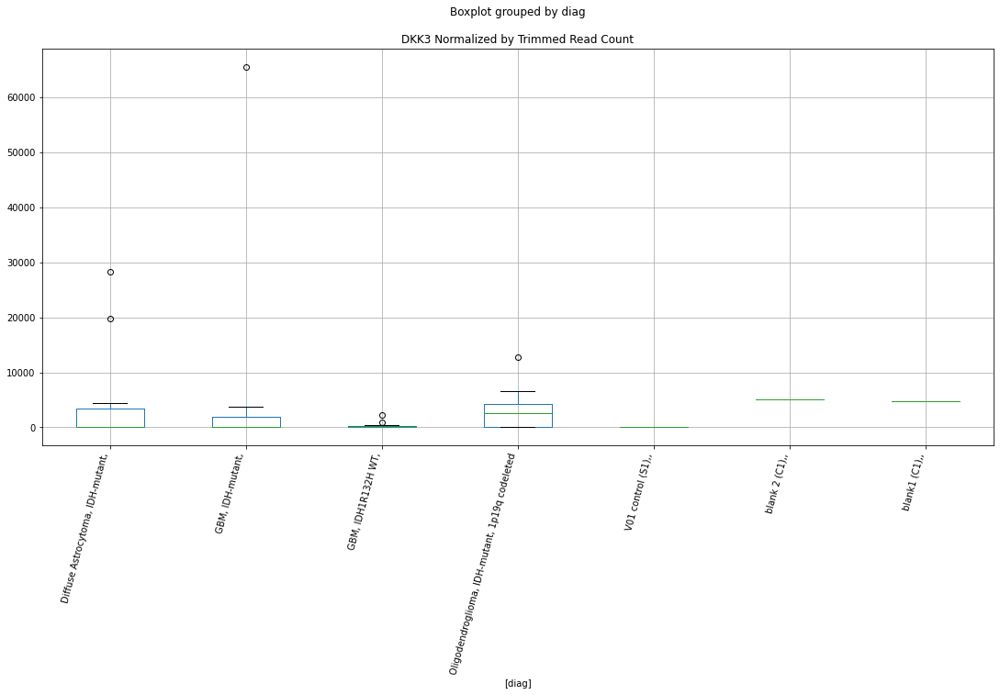

 p : 0.039177557151459985  ( t : 2.224096994288007 ) :  D-plex  :  cutadapt2  :  DENND2D
Control and blanks
76     0.0
340    0.0
Name: DENND2D, dtype: float64
208    2821.76
Name: DENND2D, dtype: float64
472    0.0
Name: DENND2D, dtype: float64


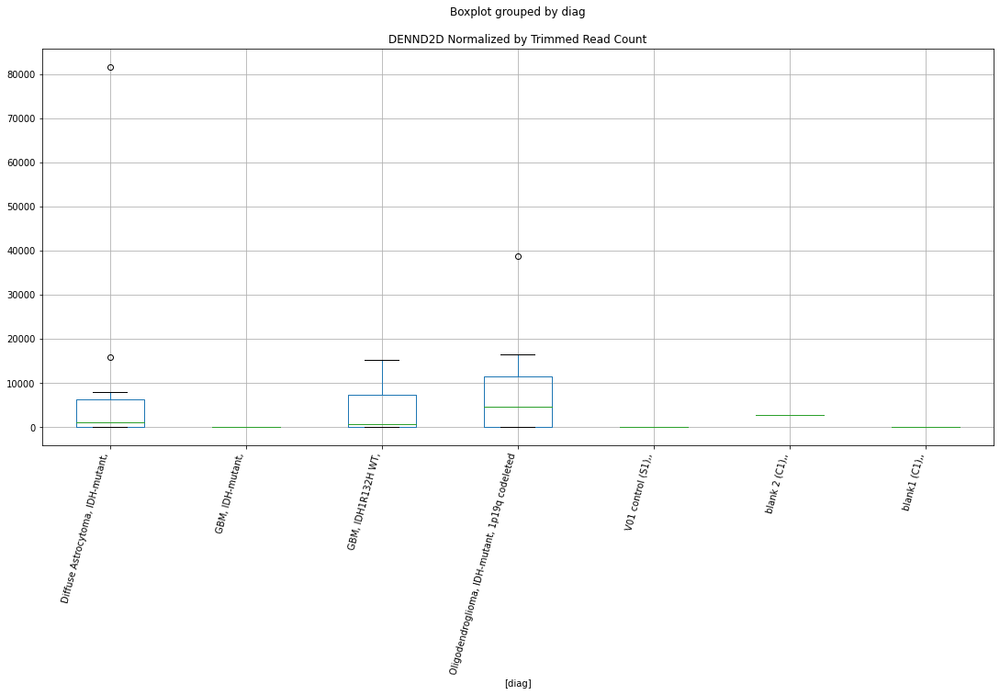

 p : 0.03919566237090816  ( t : 2.223866034184309 ) :  Lexogen  :  bbduk2  :  ALDH2
Control and blanks
79     0.0
343    0.0
Name: ALDH2, dtype: float64
211    0.0
Name: ALDH2, dtype: float64
475    0.0
Name: ALDH2, dtype: float64


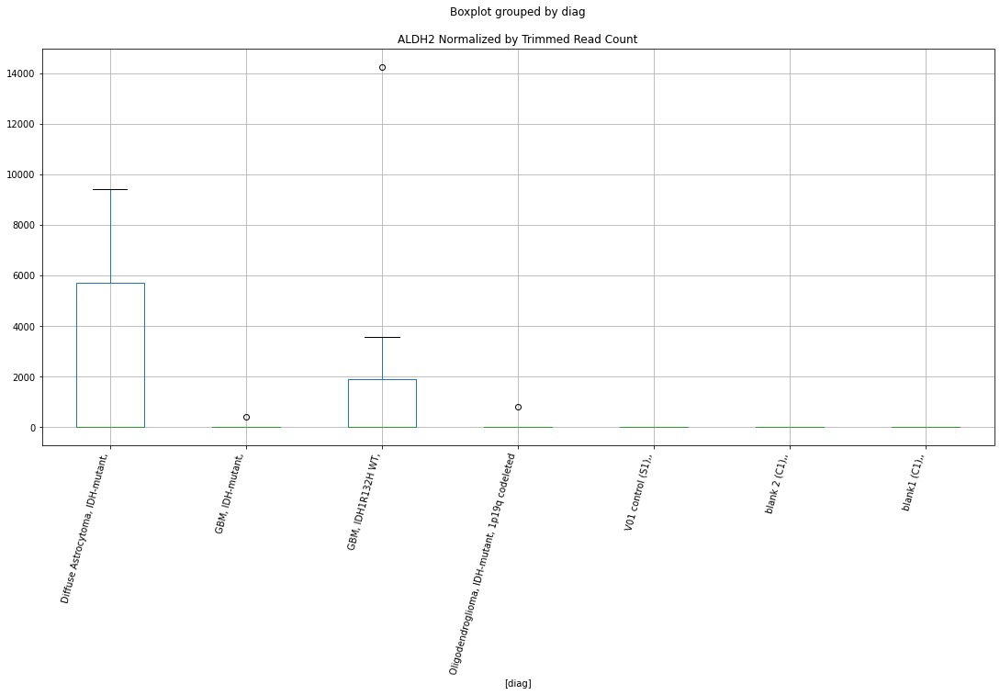

 p : 0.039201593552244625  ( t : 2.2237903941397006 ) :  D-plex  :  cutadapt2  :  C21orf59-TCP10L
Control and blanks
76        0.0
340    2642.2
Name: C21orf59-TCP10L, dtype: float64
208    2292.68
Name: C21orf59-TCP10L, dtype: float64
472    2889.78
Name: C21orf59-TCP10L, dtype: float64


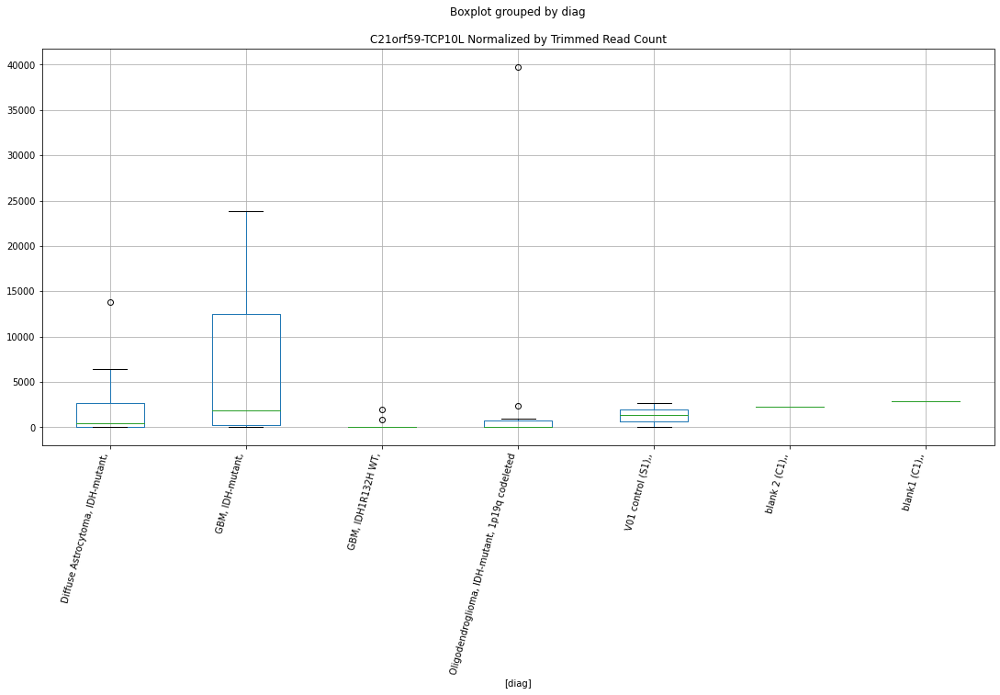

 p : 0.03934571228129701  ( t : 2.221955685811348 ) :  Lexogen  :  bbduk2  :  CRHBP
Control and blanks
79     2861.2
343       0.0
Name: CRHBP, dtype: float64
211    546.61
Name: CRHBP, dtype: float64
475    2395.16
Name: CRHBP, dtype: float64


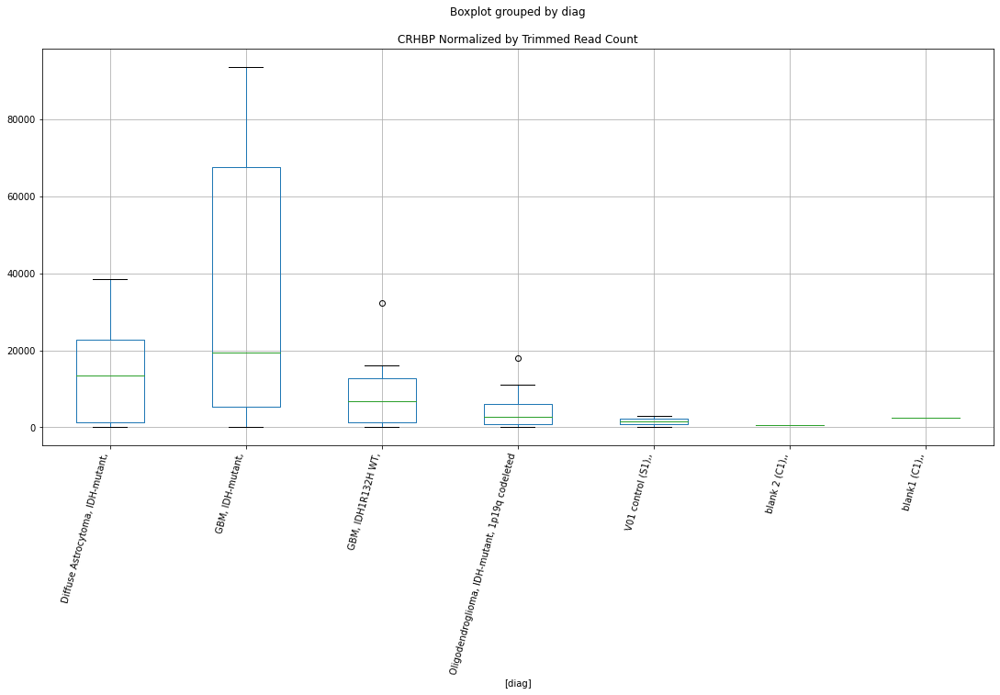

 p : 0.03936077869775584  ( t : 2.2217642395597705 ) :  Lexogen  :  cutadapt2  :  BANP
Control and blanks
82     0.0
346    0.0
Name: BANP, dtype: float64
214    0.0
Name: BANP, dtype: float64
478    0.0
Name: BANP, dtype: float64


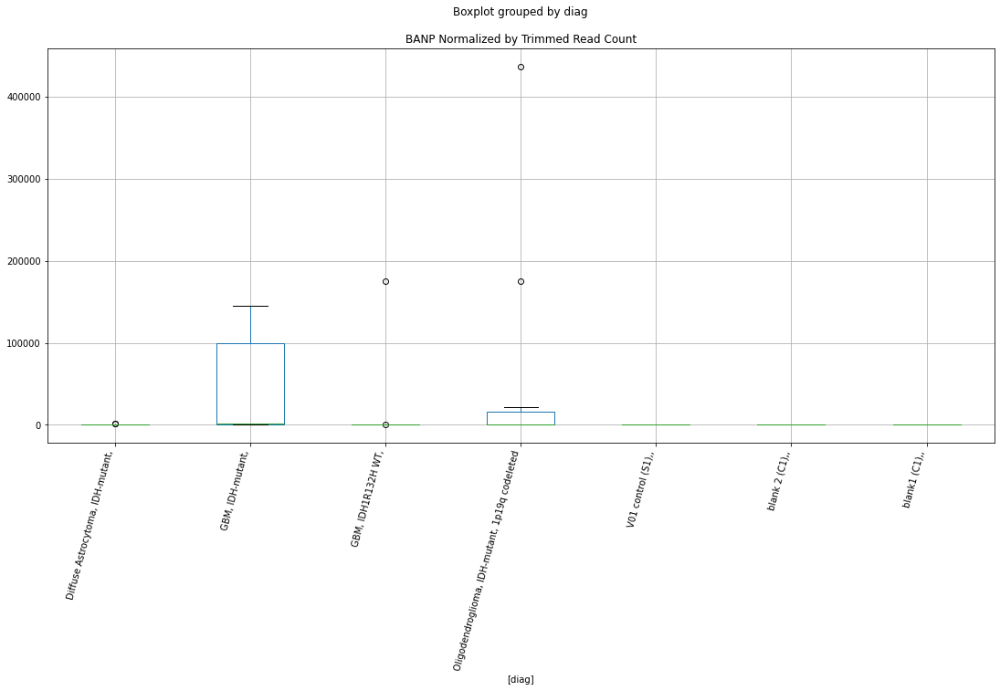

 p : 0.03939071322739071  ( t : 2.221384066896185 ) :  D-plex  :  bbduk2  :  ATXN7L3
Control and blanks
73     3092.03
337       0.00
Name: ATXN7L3, dtype: float64
205    716.36
Name: ATXN7L3, dtype: float64
469    0.0
Name: ATXN7L3, dtype: float64


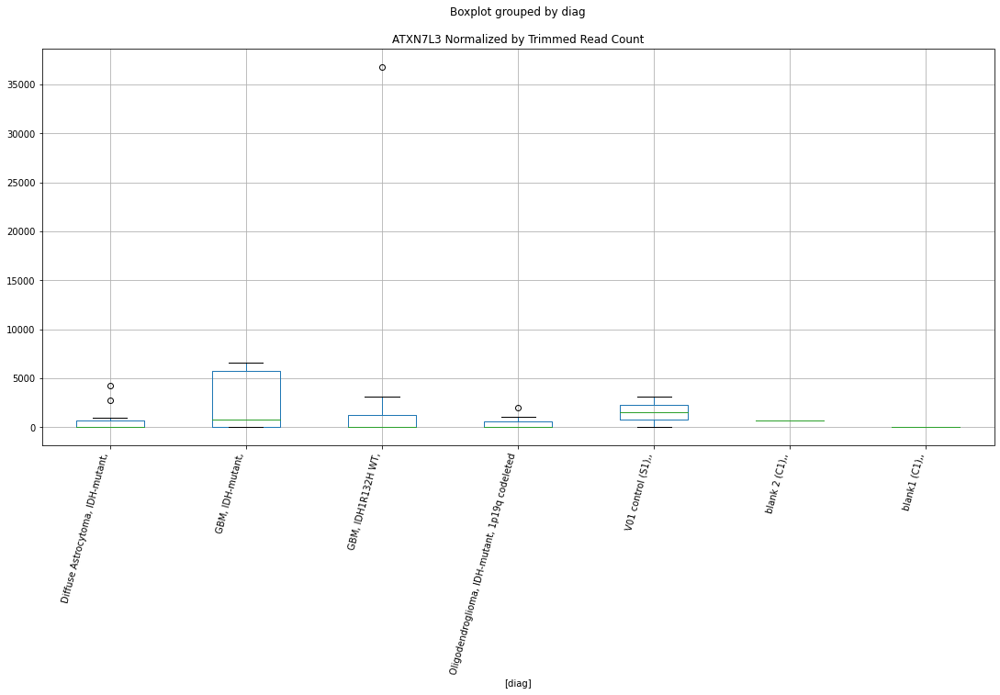

 p : 0.039469055720970925  ( t : 2.2203903634544693 ) :  Lexogen  :  cutadapt2  :  ARSK
Control and blanks
82     0.0
346    0.0
Name: ARSK, dtype: float64
214    0.0
Name: ARSK, dtype: float64
478    0.0
Name: ARSK, dtype: float64


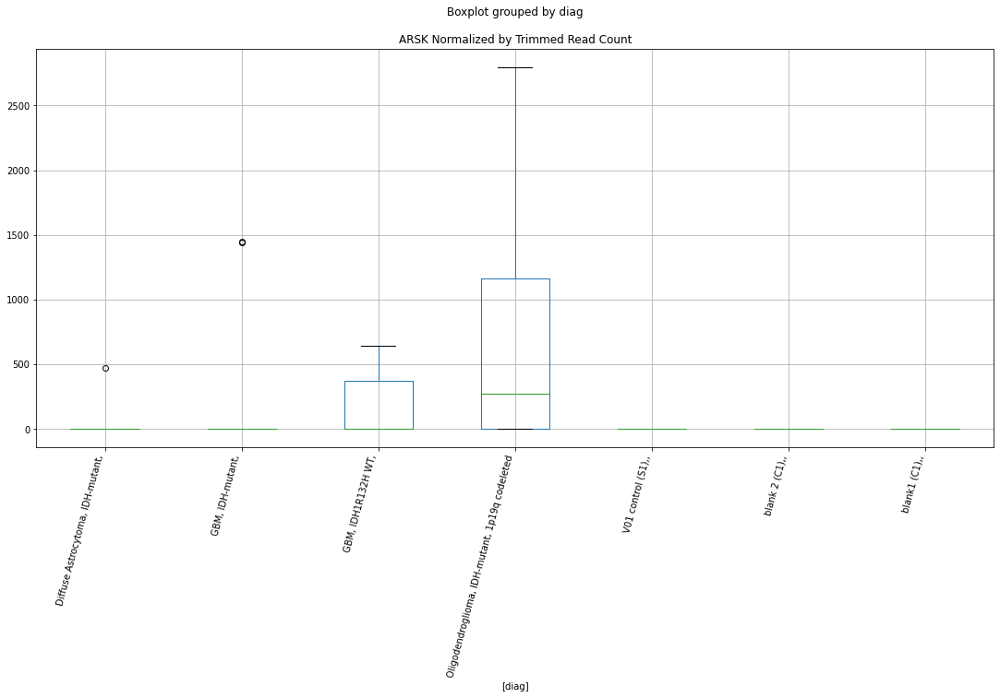

 p : 0.03948409840156651  ( t : 2.2201997684467702 ) :  D-plex  :  cutadapt2  :  CNGA4
Control and blanks
76     0.0
340    0.0
Name: CNGA4, dtype: float64
208    6525.33
Name: CNGA4, dtype: float64
472    5779.56
Name: CNGA4, dtype: float64


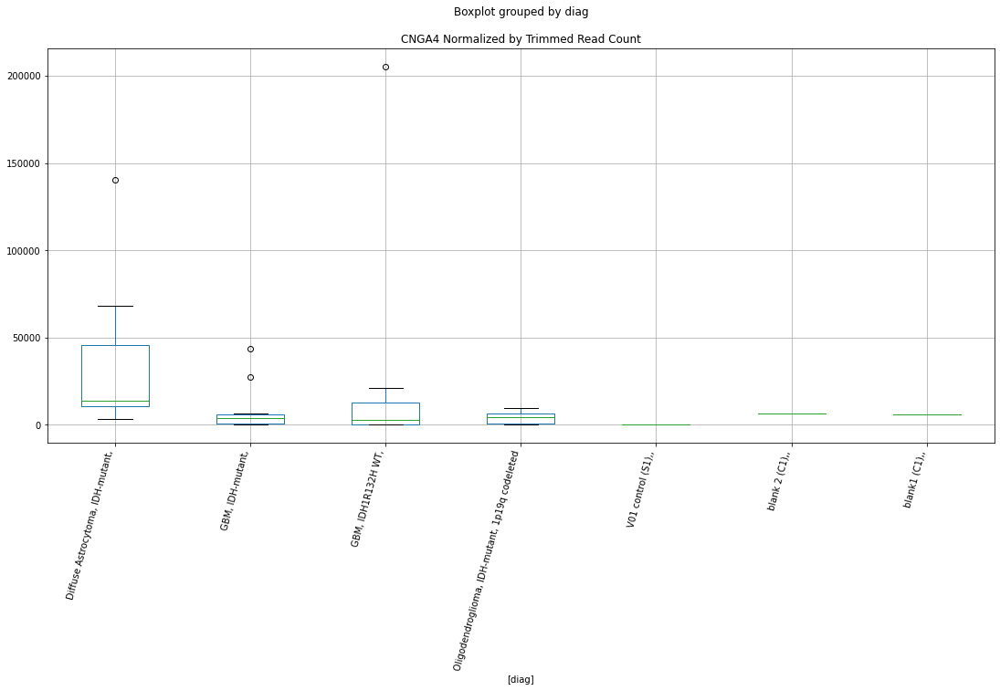

 p : 0.03950190748416395  ( t : 2.219974208707717 ) :  D-plex  :  bbduk2  :  CCDC25
Control and blanks
73     0.0
337    0.0
Name: CCDC25, dtype: float64
205    6089.09
Name: CCDC25, dtype: float64
469    15971.24
Name: CCDC25, dtype: float64


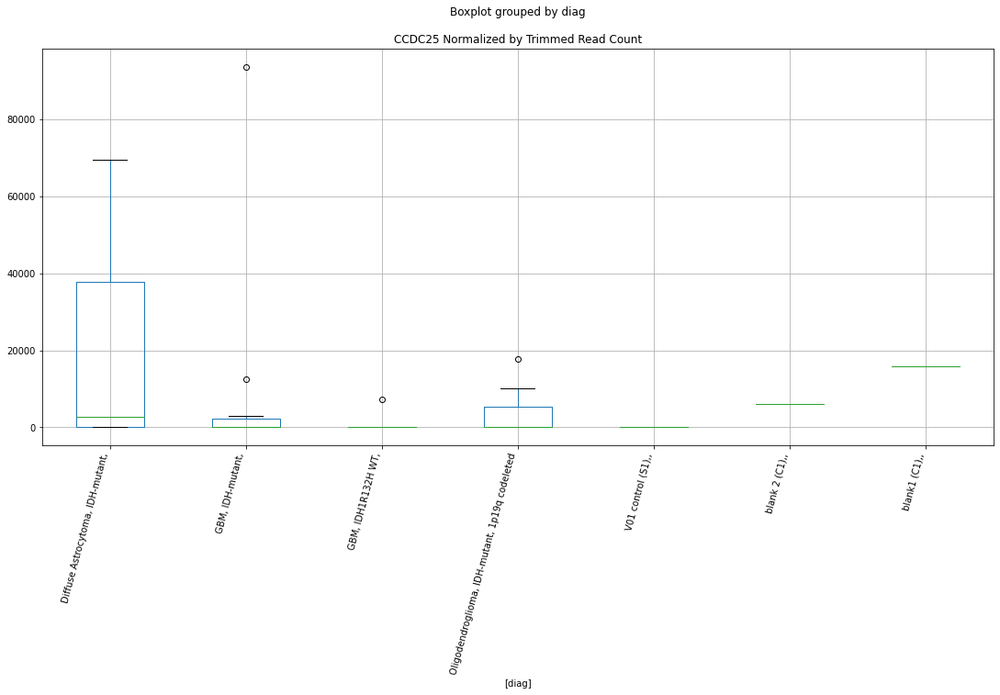

 p : 0.039513240688742644  ( t : 2.2198307174838683 ) :  D-plex  :  cutadapt2  :  CNOT10
Control and blanks
76     386383.25
340    258935.25
Name: CNOT10, dtype: float64
208    954637.86
Name: CNOT10, dtype: float64
472    4.13e+06
Name: CNOT10, dtype: float64


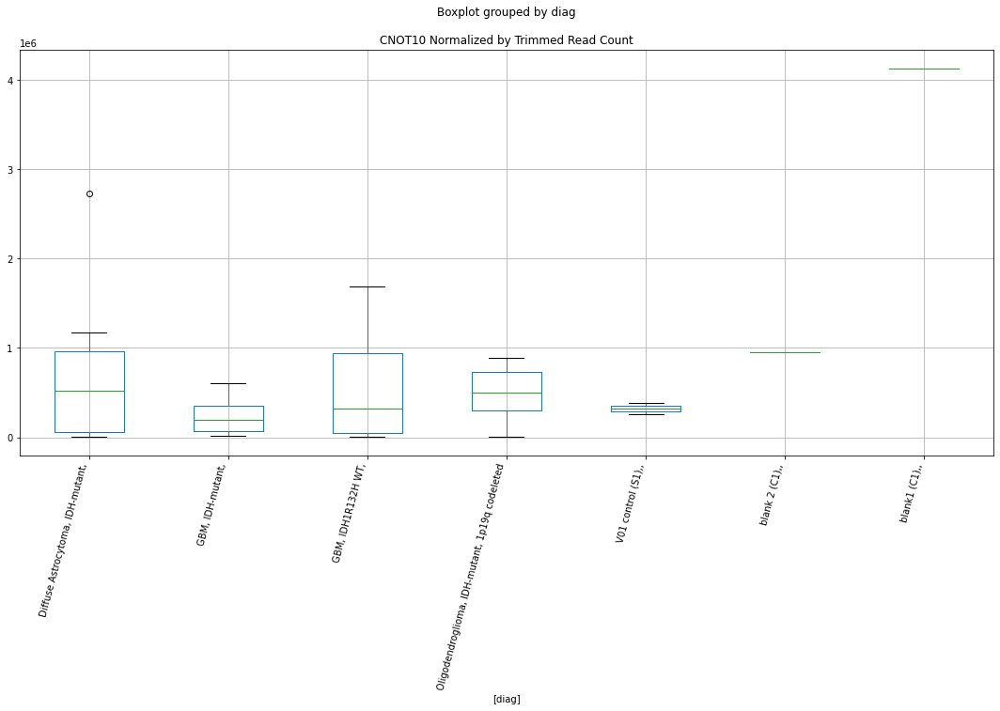

 p : 0.03953135705829961  ( t : 2.2196014223330605 ) :  Lexogen  :  bbduk2  :  ALLC
Control and blanks
79     0.0
343    0.0
Name: ALLC, dtype: float64
211    0.0
Name: ALLC, dtype: float64
475    0.0
Name: ALLC, dtype: float64


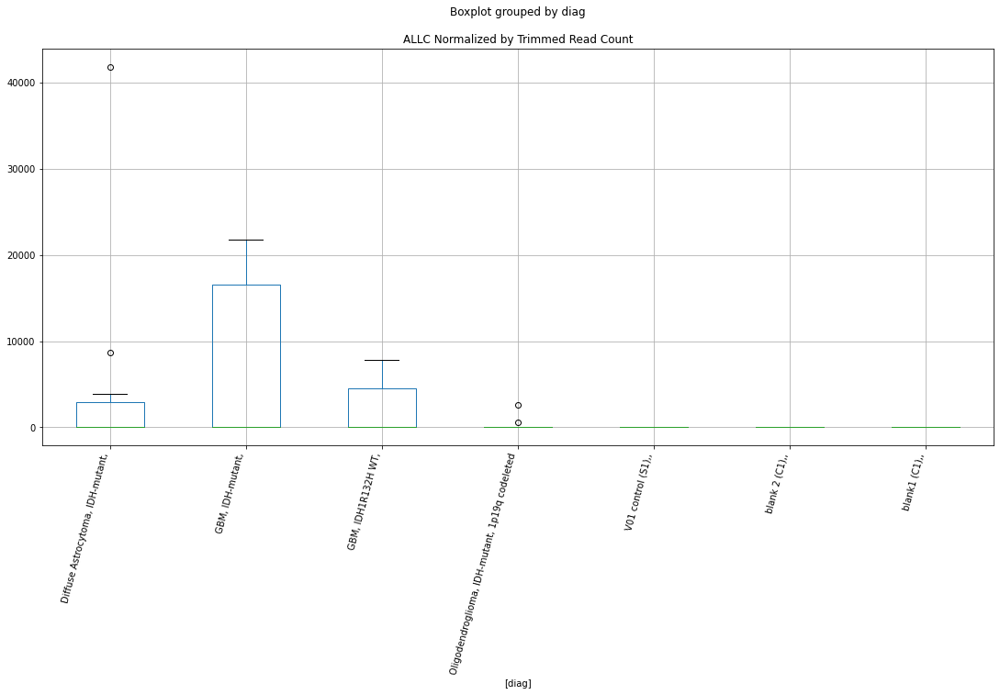

 p : 0.03957135135487509  ( t : 2.2190955649267874 ) :  Lexogen  :  cutadapt2  :  CIT
Control and blanks
82        0.00
346    6313.04
Name: CIT, dtype: float64
214    20341.98
Name: CIT, dtype: float64
478    0.0
Name: CIT, dtype: float64


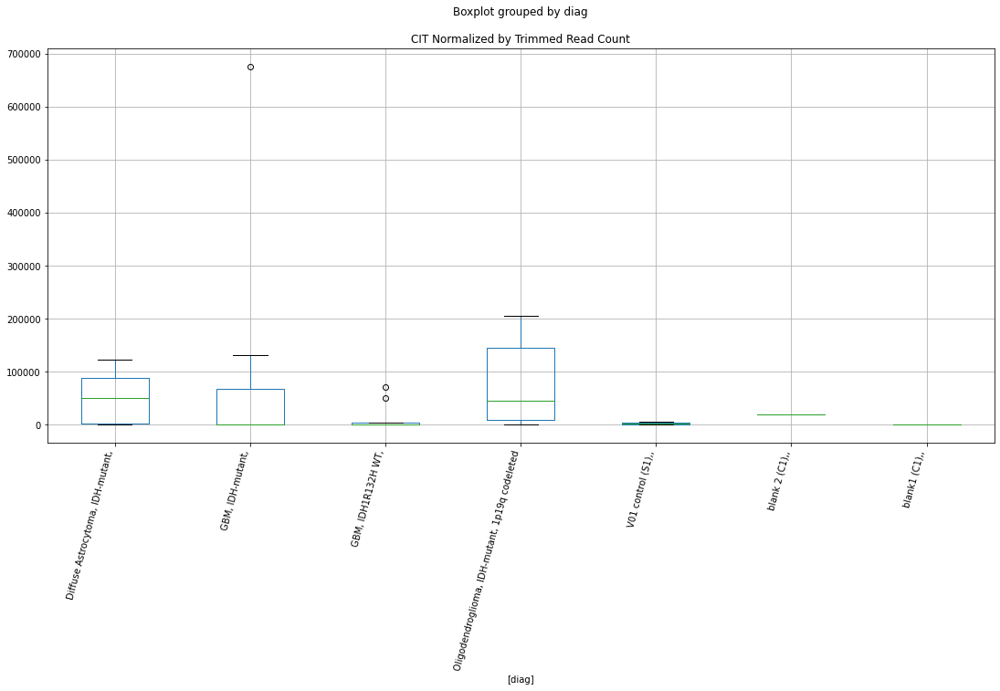

 p : 0.039581391128655635  ( t : 2.2189686533416193 ) :  D-plex  :  cutadapt2  :  BTBD11
Control and blanks
76     1515.23
340       0.00
Name: BTBD11, dtype: float64
208    7936.21
Name: BTBD11, dtype: float64
472    9825.25
Name: BTBD11, dtype: float64


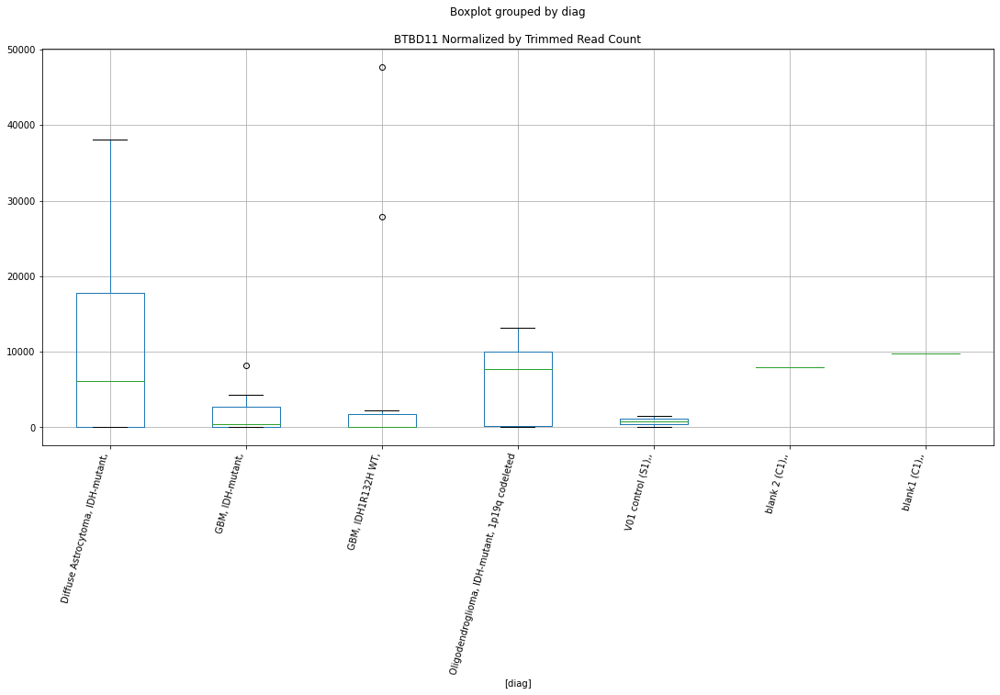

 p : 0.039636410229312684  ( t : 2.2182736888973107 ) :  Lexogen  :  bbduk2  :  BANP
Control and blanks
79     0.0
343    0.0
Name: BANP, dtype: float64
211    0.0
Name: BANP, dtype: float64
475    1197.58
Name: BANP, dtype: float64


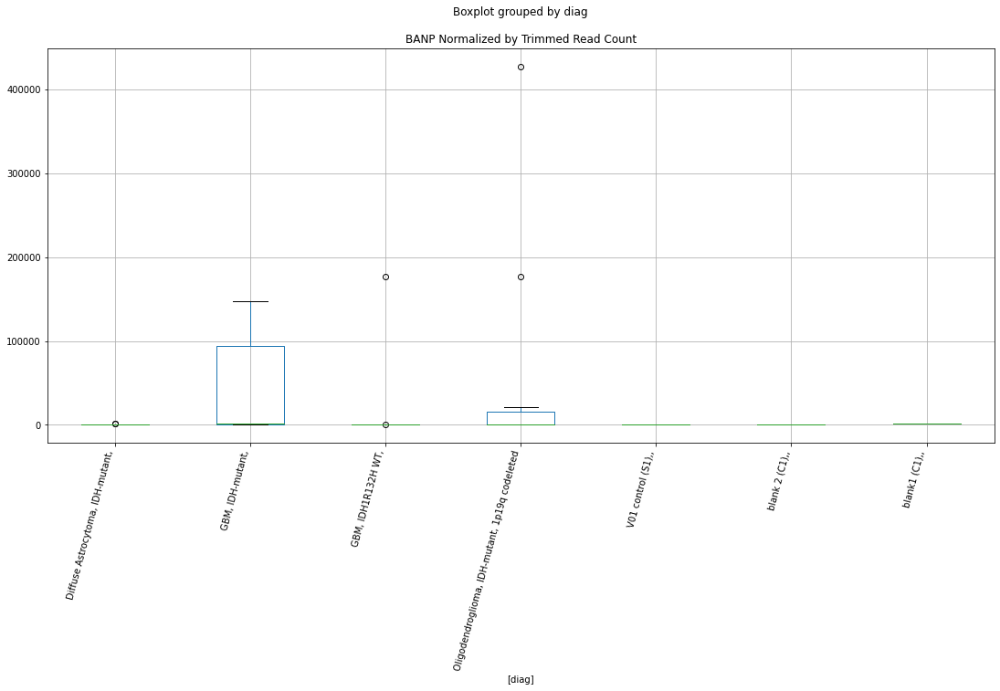

 p : 0.039647410016900315  ( t : 2.2181348534137073 ) :  D-plex  :  cutadapt2  :  ASB4
Control and blanks
76     0.0
340    0.0
Name: ASB4, dtype: float64
208    3174.48
Name: ASB4, dtype: float64
472    577.96
Name: ASB4, dtype: float64


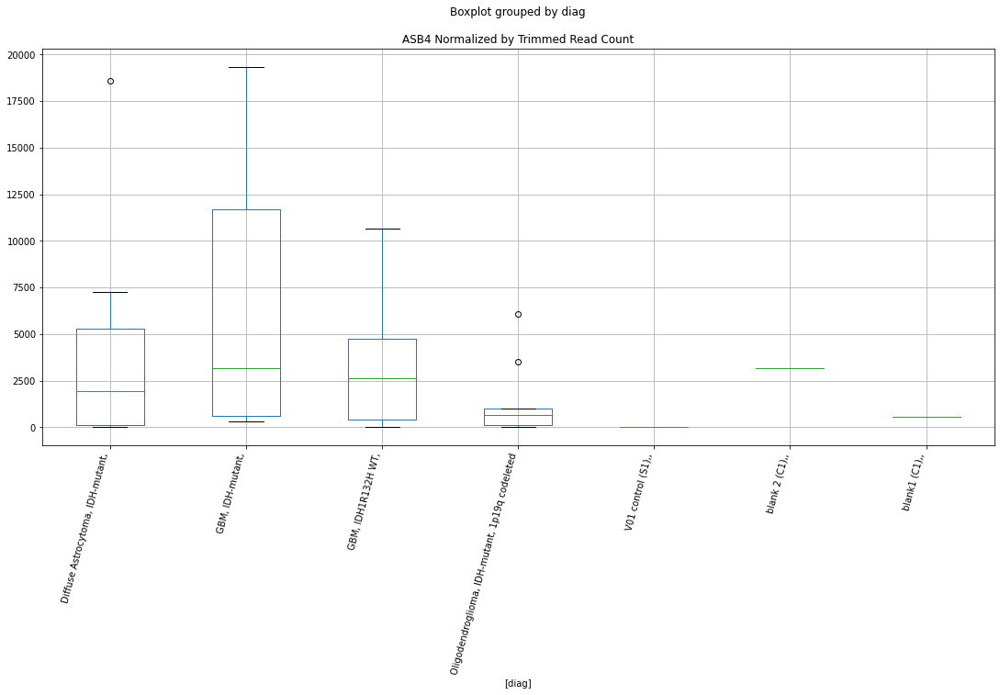

 p : 0.039671321742767  ( t : 2.217833170156118 ) :  Lexogen  :  cutadapt2  :  AP1AR
Control and blanks
82     0.0
346    0.0
Name: AP1AR, dtype: float64
214    7323.11
Name: AP1AR, dtype: float64
478    0.0
Name: AP1AR, dtype: float64


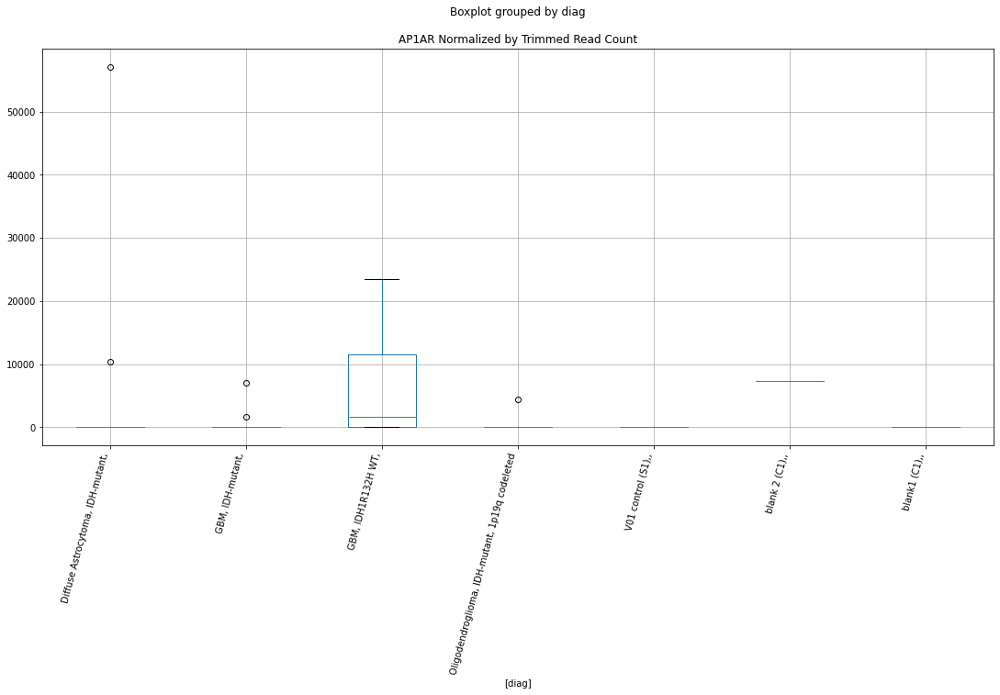

 p : 0.039672074363365645  ( t : 2.217823677403754 ) :  D-plex  :  cutadapt2  :  CNIH3
Control and blanks
76     0.0
340    0.0
Name: CNIH3, dtype: float64
208    2645.4
Name: CNIH3, dtype: float64
472    0.0
Name: CNIH3, dtype: float64


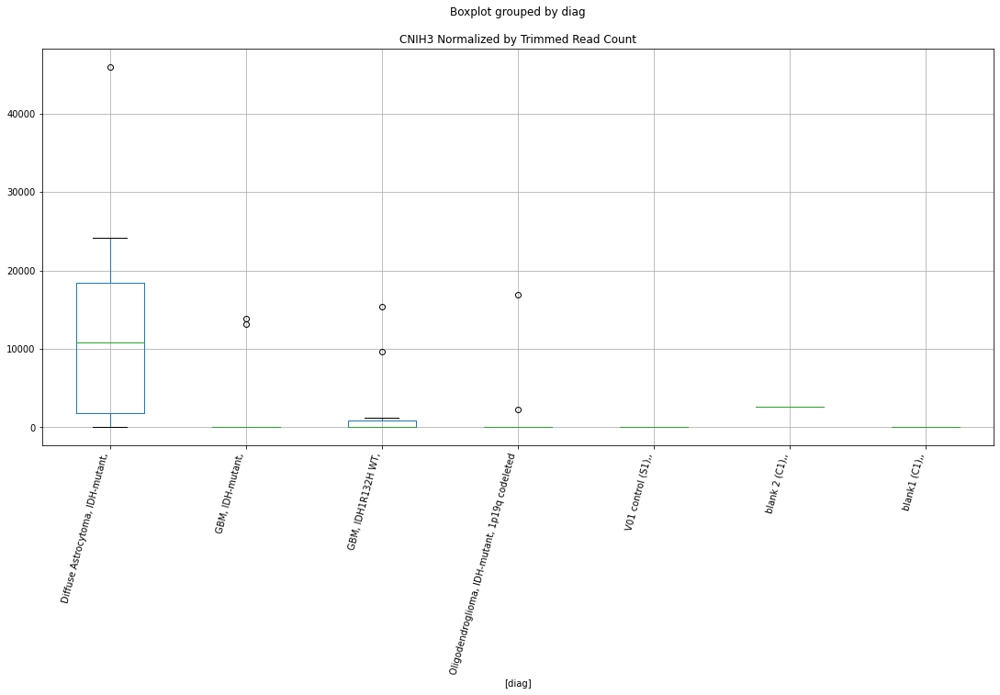

 p : 0.039699760260035355  ( t : 2.217474592169257 ) :  D-plex  :  bbduk2  :  BARD1
Control and blanks
73     0.0
337    0.0
Name: BARD1, dtype: float64
205    3581.82
Name: BARD1, dtype: float64
469    5323.75
Name: BARD1, dtype: float64


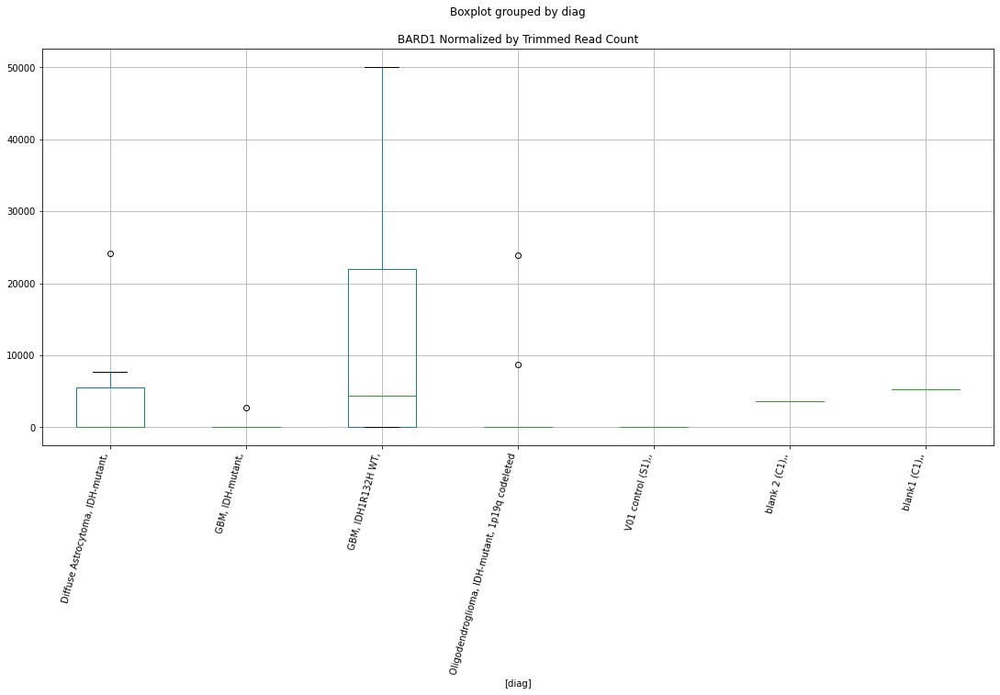

 p : 0.03971340932485396  ( t : 2.2173025766011385 ) :  D-plex  :  cutadapt2  :  DENND6A
Control and blanks
76     0.0
340    0.0
Name: DENND6A, dtype: float64
208    4938.09
Name: DENND6A, dtype: float64
472    4623.65
Name: DENND6A, dtype: float64


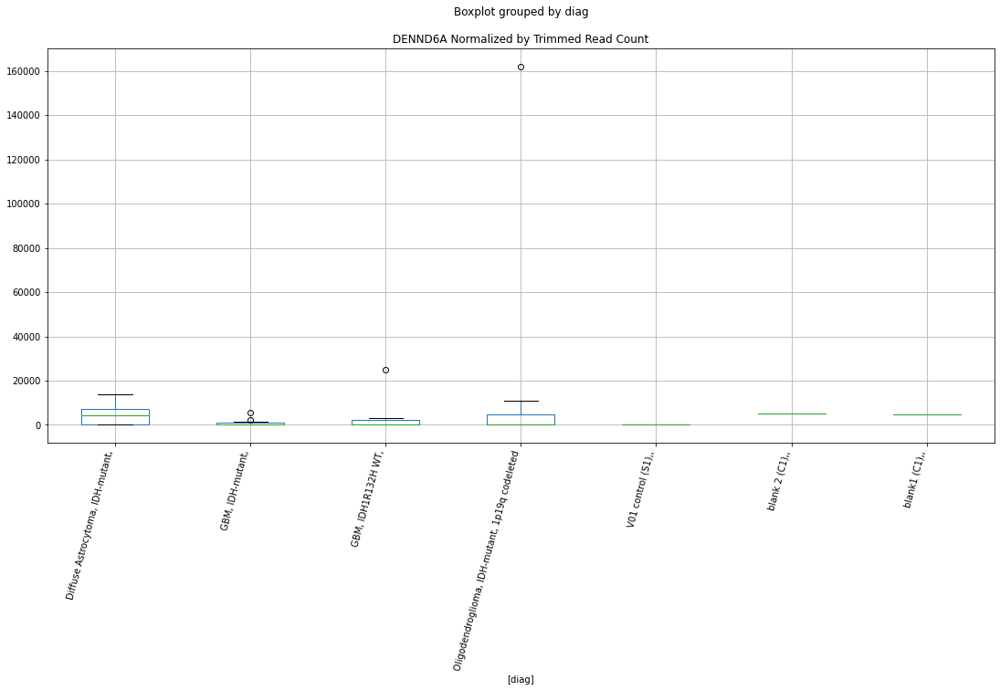

 p : 0.039788594256931153  ( t : 2.2163560144936865 ) :  Lexogen  :  cutadapt2  :  ALDH2
Control and blanks
82     0.0
346    0.0
Name: ALDH2, dtype: float64
214    0.0
Name: ALDH2, dtype: float64
478    0.0
Name: ALDH2, dtype: float64


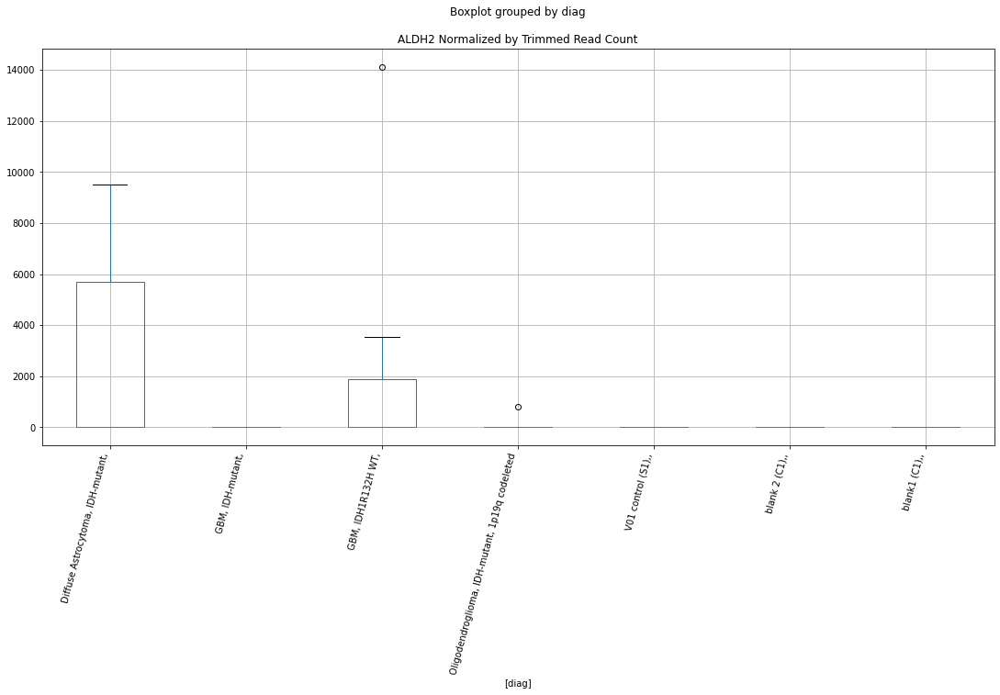

 p : 0.03986078046981534  ( t : 2.2154487525276685 ) :  D-plex  :  bbduk2  :  BACE2
Control and blanks
73     0.0
337    0.0
Name: BACE2, dtype: float64
205    2686.36
Name: BACE2, dtype: float64
469    4140.69
Name: BACE2, dtype: float64


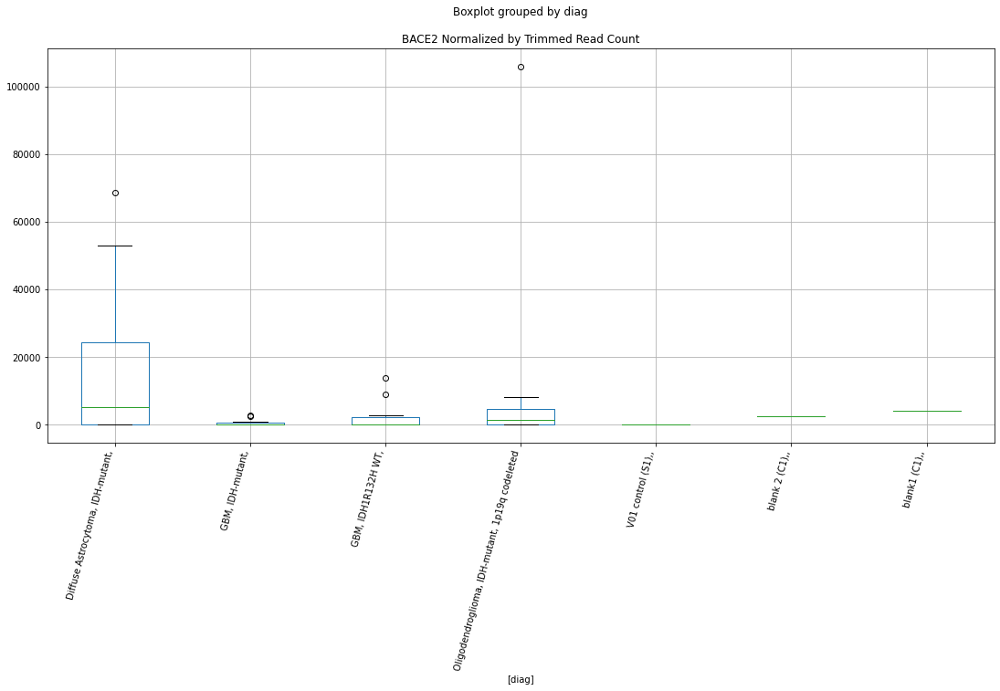

 p : 0.03986512433254024  ( t : 2.2153942055371636 ) :  D-plex  :  cutadapt2  :  APLF
Control and blanks
76     0.0
340    0.0
Name: APLF, dtype: float64
208    705.44
Name: APLF, dtype: float64
472    0.0
Name: APLF, dtype: float64


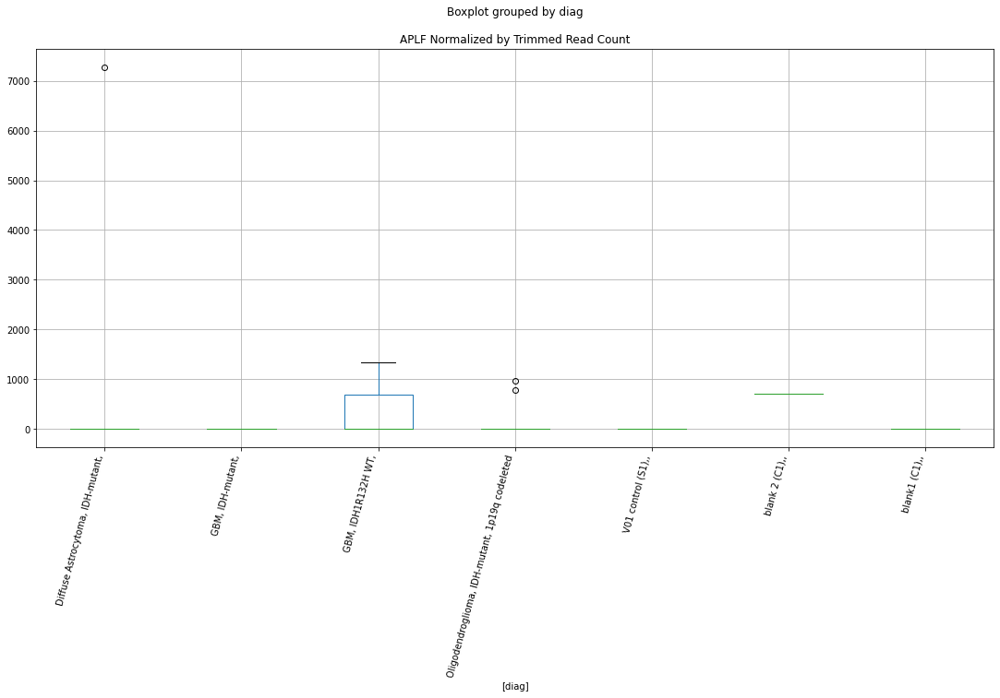

 p : 0.0398883550584392  ( t : 2.215102584157921 ) :  D-plex  :  bbduk2  :  CNOT7
Control and blanks
73         0.00
337    56079.91
Name: CNOT7, dtype: float64
205    7700.91
Name: CNOT7, dtype: float64
469    1774.58
Name: CNOT7, dtype: float64


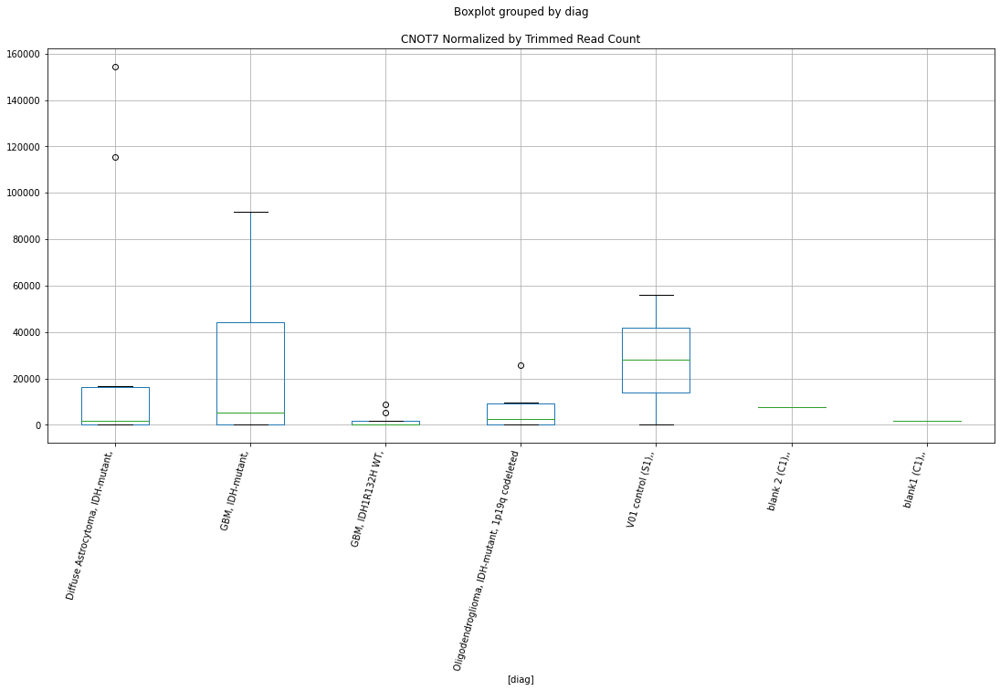

 p : 0.03990614494739889  ( t : 2.2148793686247137 ) :  D-plex  :  bbduk2  :  CLCA4-AS1
Control and blanks
73     0.0
337    0.0
Name: CLCA4-AS1, dtype: float64
205    2865.46
Name: CLCA4-AS1, dtype: float64
469    2366.11
Name: CLCA4-AS1, dtype: float64


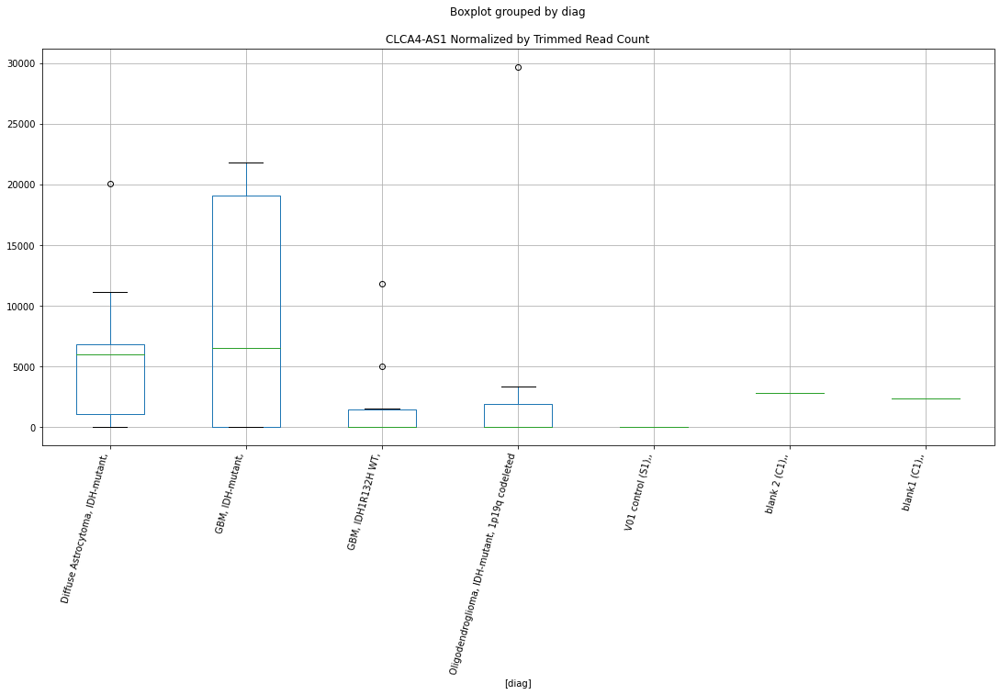

 p : 0.03993875850811992  ( t : 2.214470393230524 ) :  Lexogen  :  bbduk2  :  AP1AR
Control and blanks
79     0.0
343    0.0
Name: AP1AR, dtype: float64
211    7379.27
Name: AP1AR, dtype: float64
475    0.0
Name: AP1AR, dtype: float64


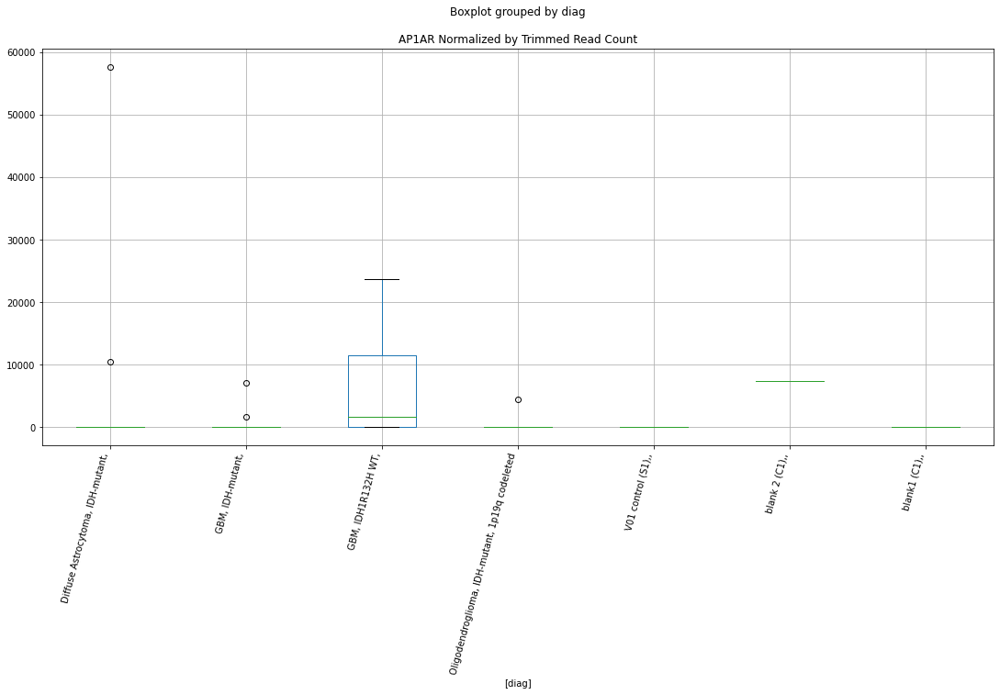

 p : 0.03997286969135526  ( t : 2.214042966083715 ) :  D-plex  :  bbduk2  :  C9orf47
Control and blanks
73     0.0
337    0.0
Name: C9orf47, dtype: float64
205    2149.09
Name: C9orf47, dtype: float64
469    2366.11
Name: C9orf47, dtype: float64


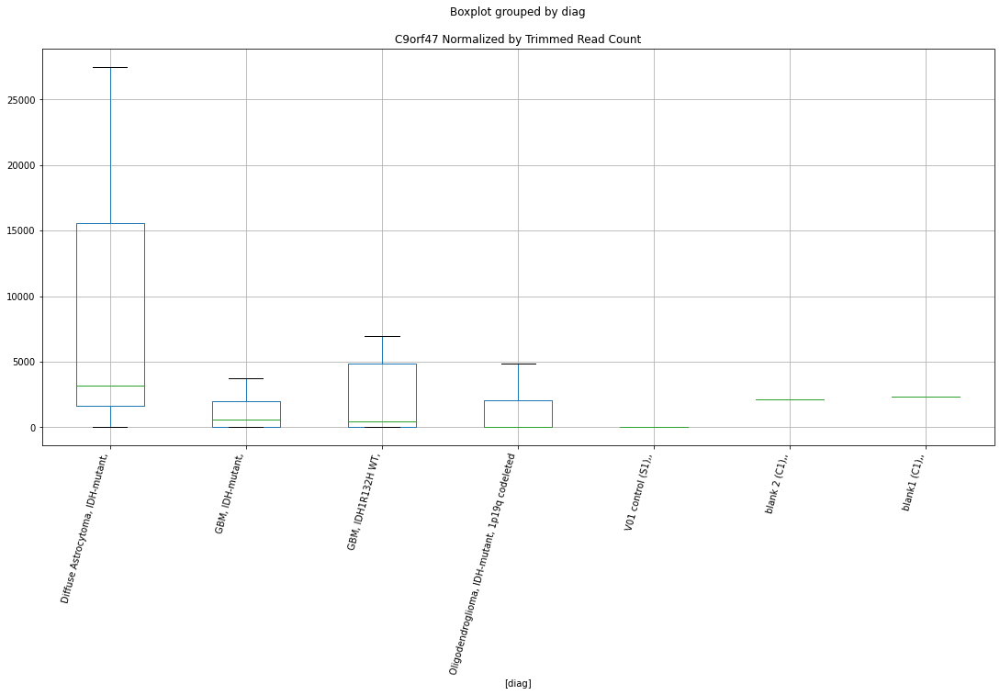

 p : 0.039973702385720594  ( t : 2.2140325362759383 ) :  Lexogen  :  cutadapt2  :  DIDO1
Control and blanks
82     0.0
346    0.0
Name: DIDO1, dtype: float64
214    7594.34
Name: DIDO1, dtype: float64
478    474.92
Name: DIDO1, dtype: float64


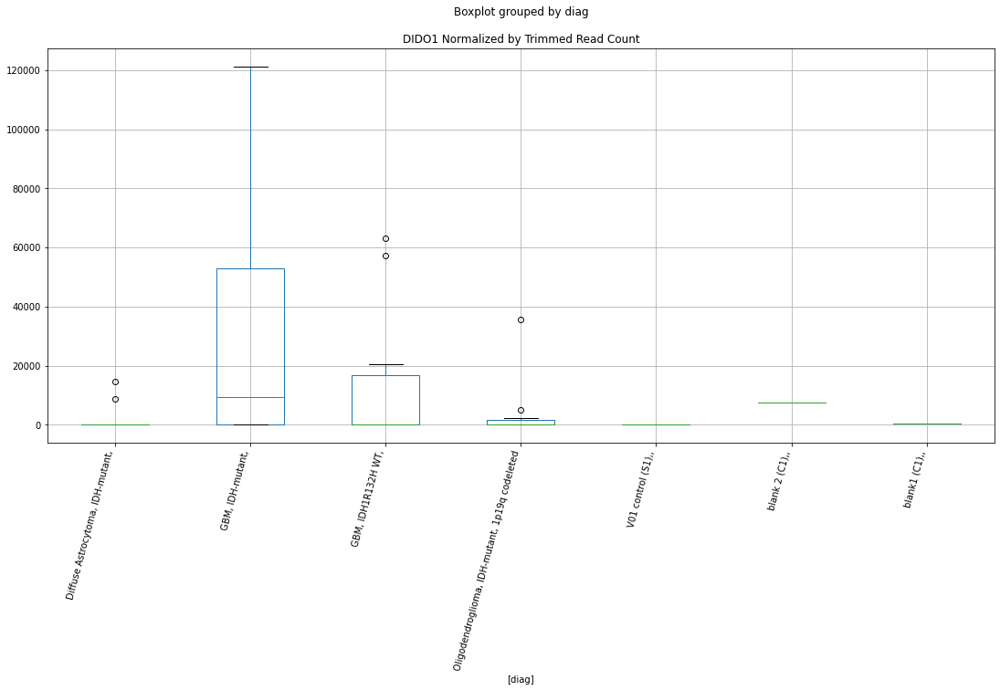

 p : 0.04003087480867133  ( t : 2.2133169077107757 ) :  Lexogen  :  cutadapt2  :  DGKZ
Control and blanks
82     0.0
346    0.0
Name: DGKZ, dtype: float64
214    8136.79
Name: DGKZ, dtype: float64
478    0.0
Name: DGKZ, dtype: float64


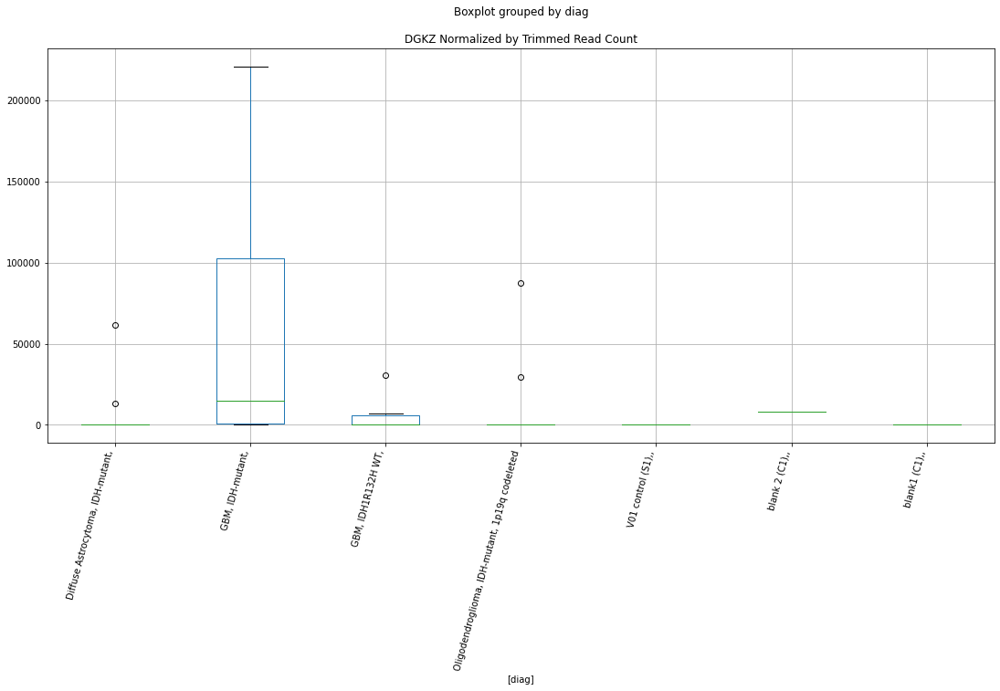

 p : 0.04005740215312098  ( t : 2.2129851834858716 ) :  D-plex  :  bbduk2  :  CLIP4
Control and blanks
73     773.01
337      0.00
Name: CLIP4, dtype: float64
205    1074.55
Name: CLIP4, dtype: float64
469    8281.38
Name: CLIP4, dtype: float64


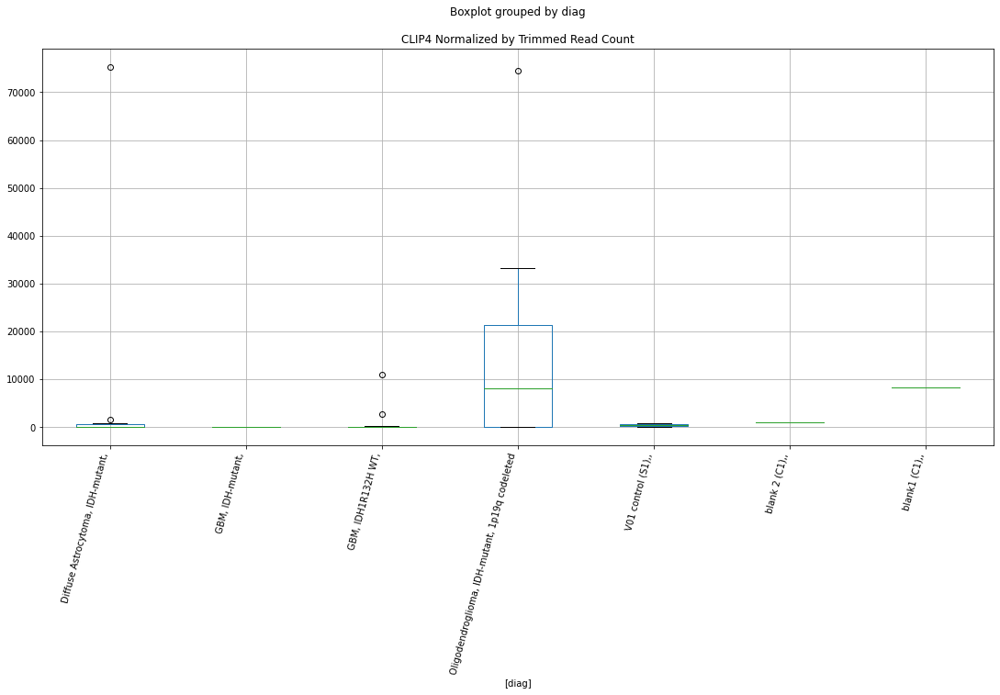

 p : 0.040065407466724136  ( t : 2.2128851167838377 ) :  D-plex  :  bbduk2  :  BRINP2
Control and blanks
73     0.0
337    0.0
Name: BRINP2, dtype: float64
205    3402.73
Name: BRINP2, dtype: float64
469    0.0
Name: BRINP2, dtype: float64


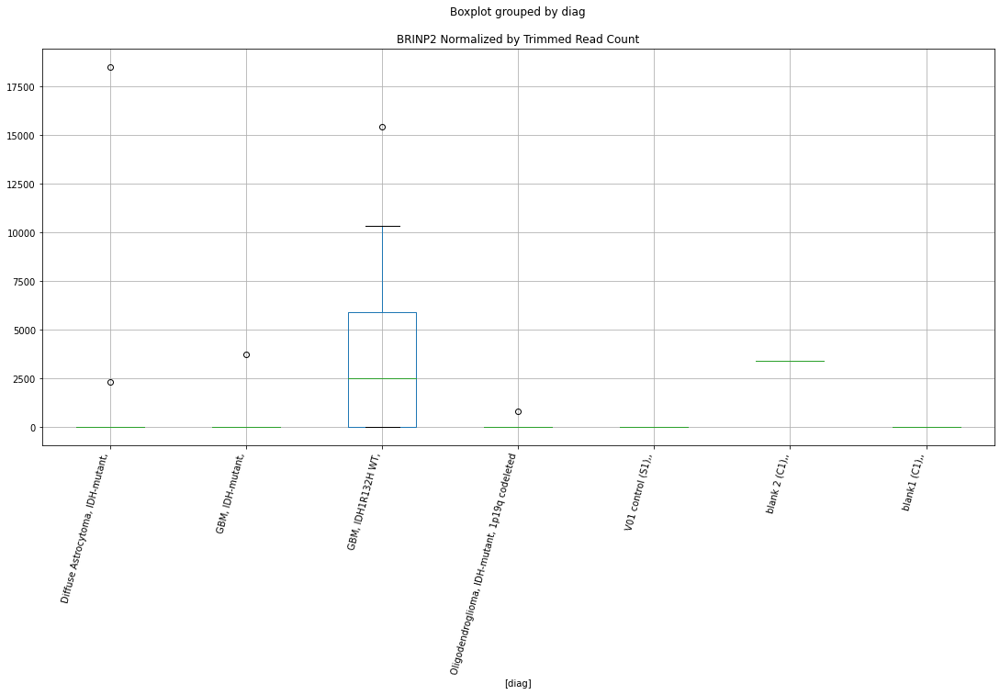

 p : 0.04012590893157468  ( t : 2.2121294403270237 ) :  D-plex  :  cutadapt2  :  CYB5B
Control and blanks
76         0.00
340    29944.89
Name: CYB5B, dtype: float64
208    1058.16
Name: CYB5B, dtype: float64
472    1733.87
Name: CYB5B, dtype: float64


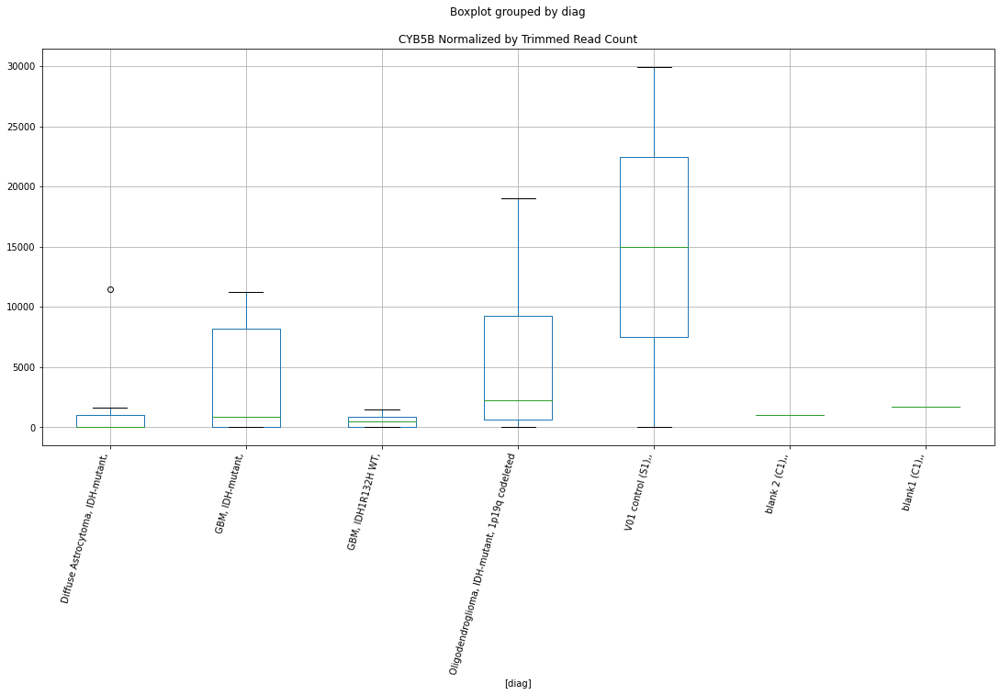

 p : 0.04020770594696651  ( t : 2.2111094417846586 ) :  D-plex  :  bbduk2  :  CREB5
Control and blanks
73        0.00
337    9791.73
Name: CREB5, dtype: float64
205    60353.65
Name: CREB5, dtype: float64
469    3.19e+06
Name: CREB5, dtype: float64


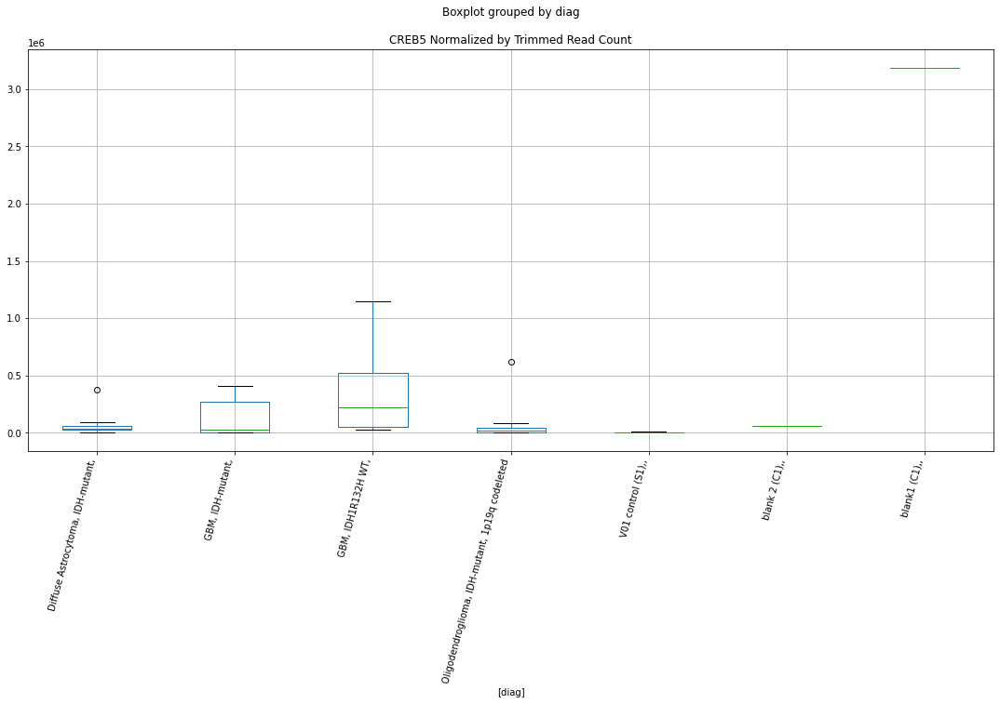

 p : 0.040222174885179394  ( t : 2.210929214548266 ) :  D-plex  :  cutadapt2  :  AEBP1
Control and blanks
76     1515.23
340    1761.46
Name: AEBP1, dtype: float64
208    7759.85
Name: AEBP1, dtype: float64
472    4623.65
Name: AEBP1, dtype: float64


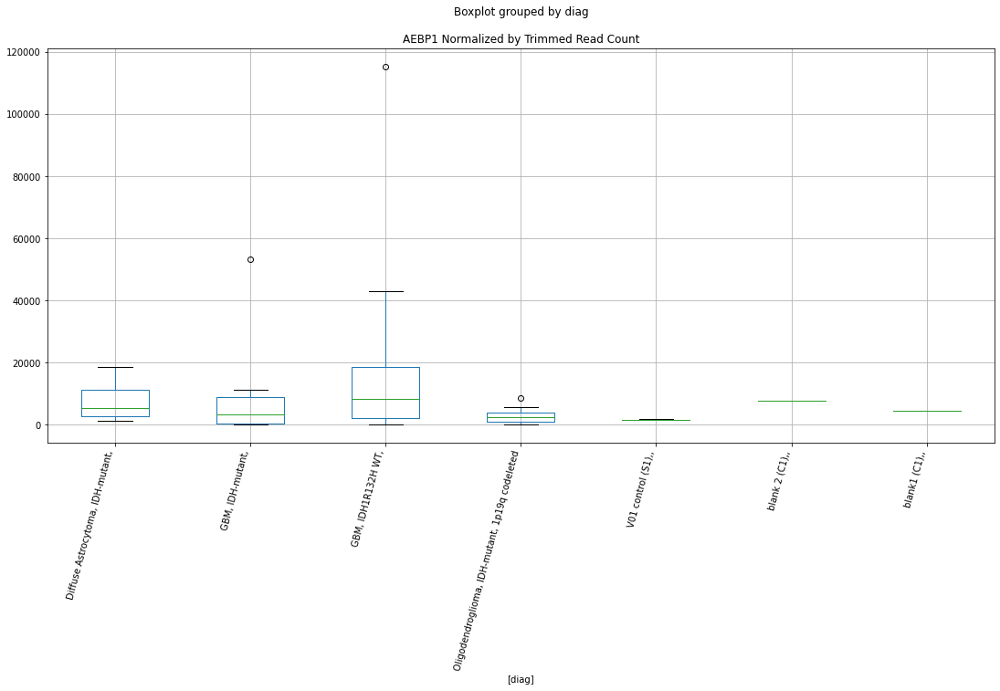

 p : 0.040230343106926934  ( t : 2.2108274962900736 ) :  D-plex  :  cutadapt2  :  CACTIN
Control and blanks
76     0.0
340    0.0
Name: CACTIN, dtype: float64
208    3527.2
Name: CACTIN, dtype: float64
472    4623.65
Name: CACTIN, dtype: float64


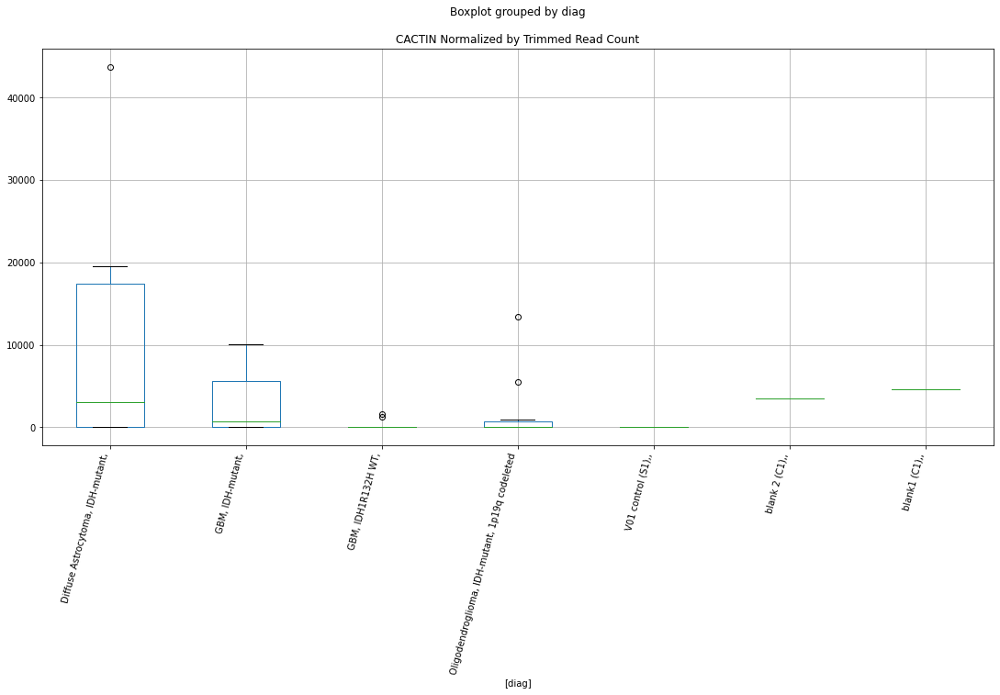

 p : 0.040294560469450895  ( t : 2.2100284630100306 ) :  Lexogen  :  cutadapt2  :  CDH3
Control and blanks
82     4260.15
346       0.00
Name: CDH3, dtype: float64
214    0.0
Name: CDH3, dtype: float64
478    0.0
Name: CDH3, dtype: float64


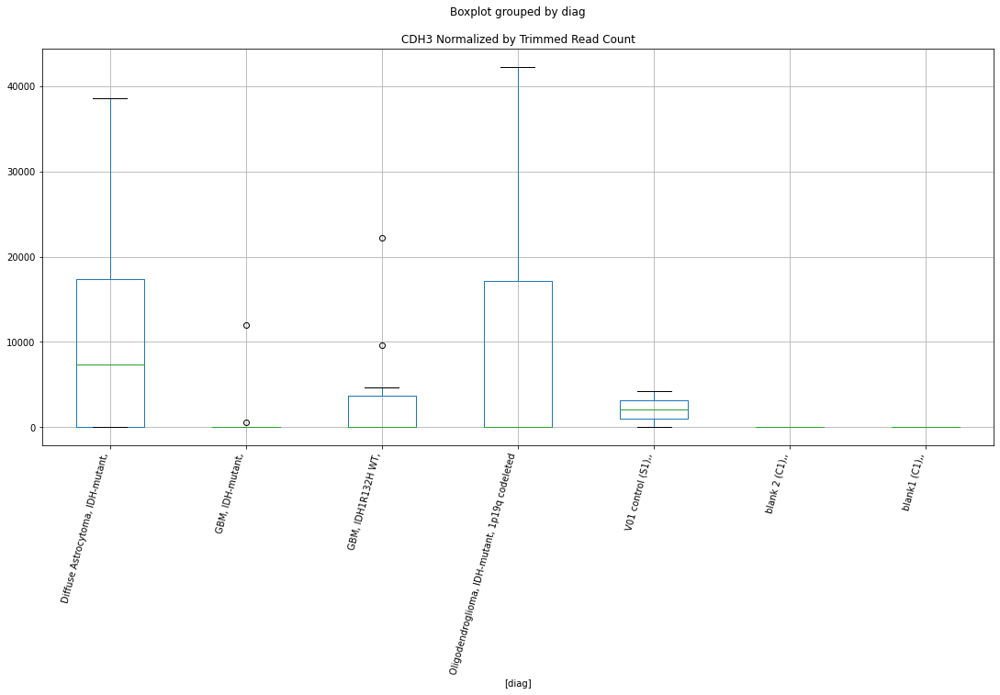

 p : 0.04029566845208208  ( t : 2.2100146870614763 ) :  D-plex  :  bbduk2  :  CTTNBP2
Control and blanks
73         0.0
337    12462.2
Name: CTTNBP2, dtype: float64
205    17192.73
Name: CTTNBP2, dtype: float64
469    15971.24
Name: CTTNBP2, dtype: float64


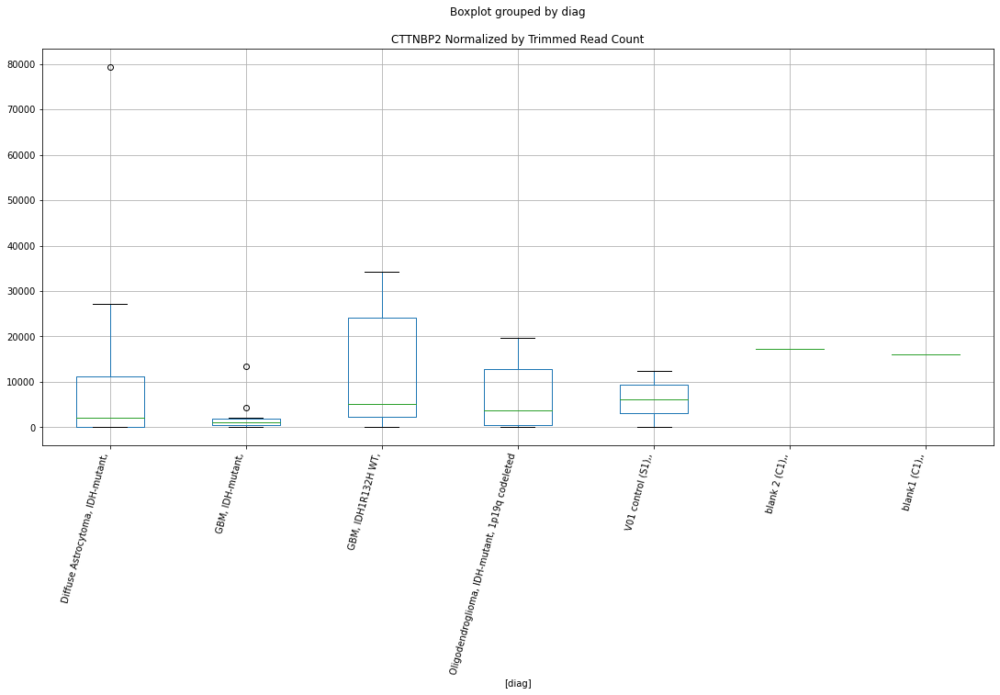

 p : 0.04033005908264932  ( t : 2.209587268968316 ) :  Lexogen  :  cutadapt2  :  CASTOR2
Control and blanks
82     0.0
346    0.0
Name: CASTOR2, dtype: float64
214    0.0
Name: CASTOR2, dtype: float64
478    0.0
Name: CASTOR2, dtype: float64


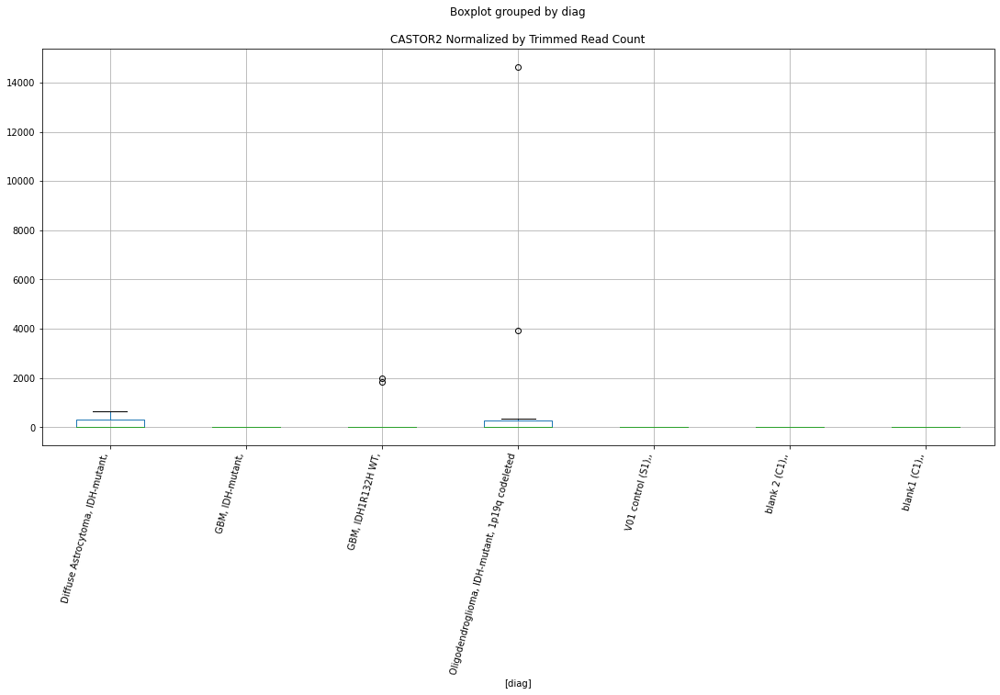

 p : 0.04035027826114151  ( t : 2.2093361347235327 ) :  Lexogen  :  cutadapt2  :  BMS1P1
Control and blanks
82         0.00
346    13046.94
Name: BMS1P1, dtype: float64
214    0.0
Name: BMS1P1, dtype: float64
478    0.0
Name: BMS1P1, dtype: float64


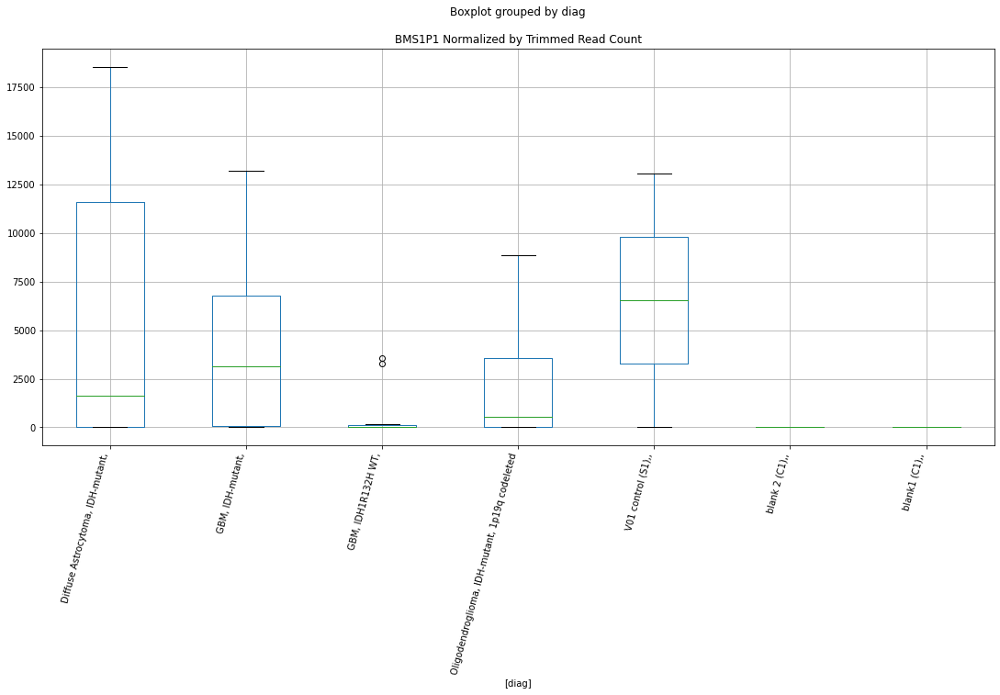

 p : 0.04035027826114151  ( t : 2.2093361347235327 ) :  Lexogen  :  cutadapt2  :  BMS1
Control and blanks
82         0.0
346    65234.7
Name: BMS1, dtype: float64
214    0.0
Name: BMS1, dtype: float64
478    0.0
Name: BMS1, dtype: float64


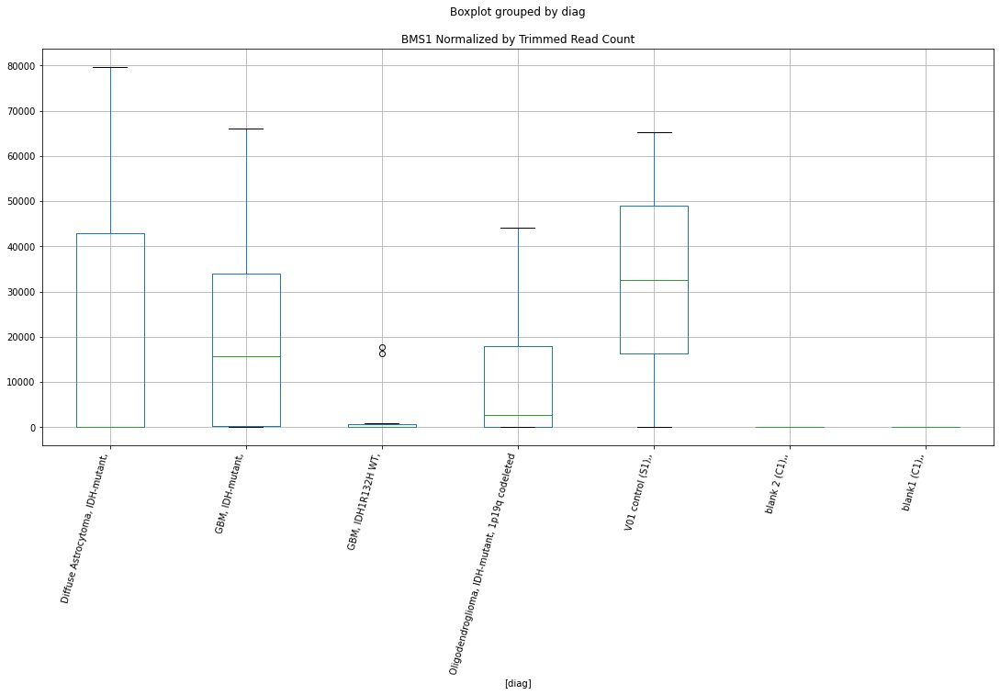

 p : 0.04036124999948359  ( t : 2.2091999076085274 ) :  Lexogen  :  bbduk2  :  BMS1
Control and blanks
79         0.00
343    65817.44
Name: BMS1, dtype: float64
211    0.0
Name: BMS1, dtype: float64
475    0.0
Name: BMS1, dtype: float64


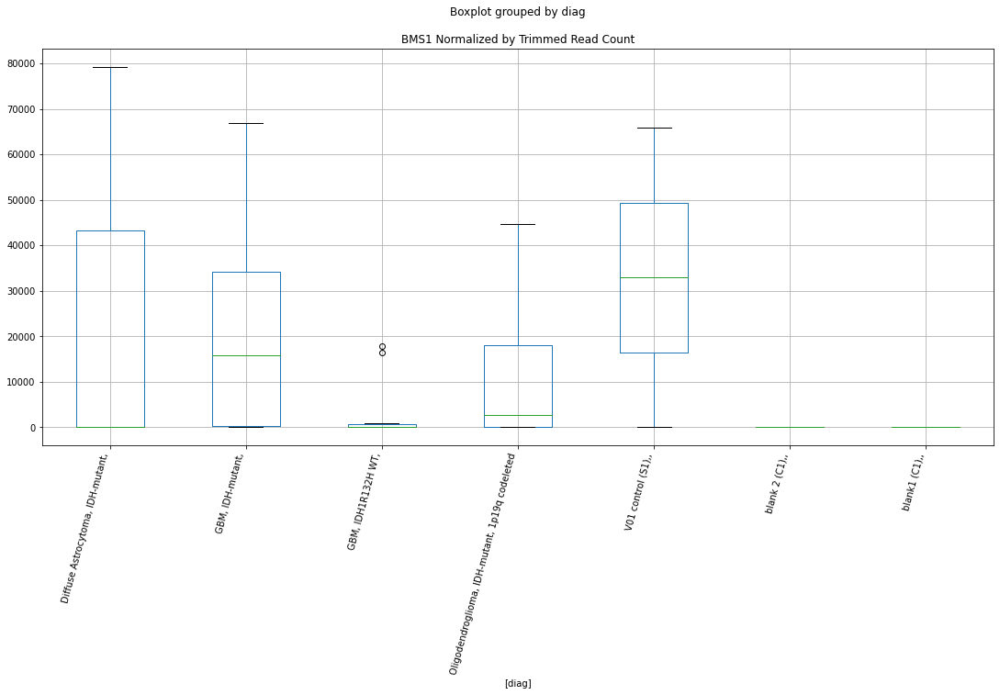

 p : 0.04036124999948359  ( t : 2.2091999076085274 ) :  Lexogen  :  bbduk2  :  BMS1P1
Control and blanks
79         0.00
343    13163.49
Name: BMS1P1, dtype: float64
211    0.0
Name: BMS1P1, dtype: float64
475    0.0
Name: BMS1P1, dtype: float64


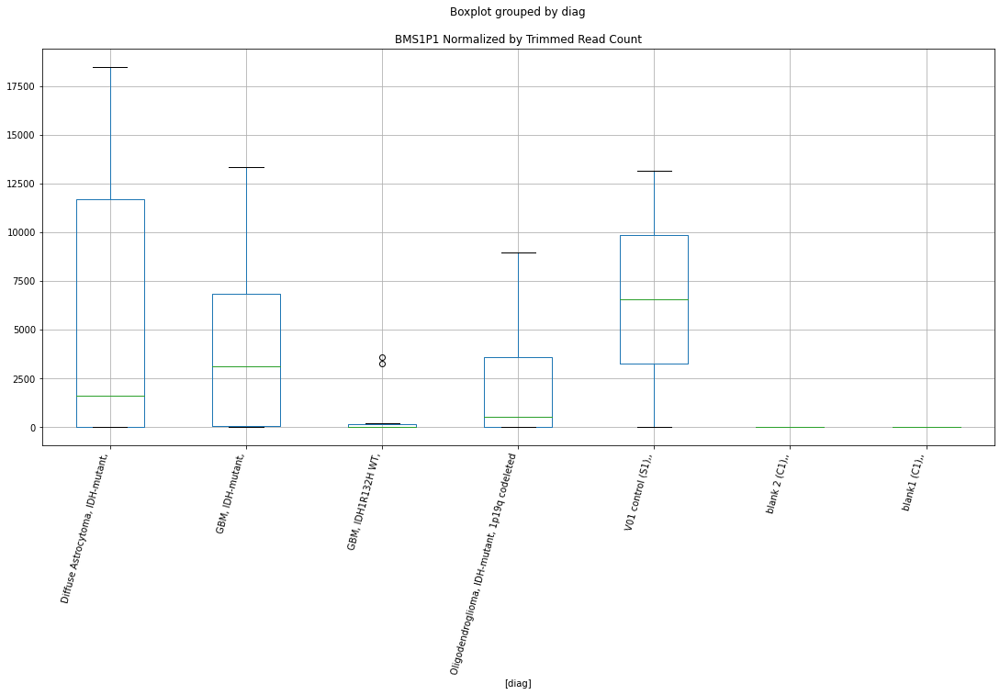

 p : 0.04036845984756424  ( t : 2.2091104073457073 ) :  Lexogen  :  bbduk2  :  CASTOR2
Control and blanks
79     0.0
343    0.0
Name: CASTOR2, dtype: float64
211    0.0
Name: CASTOR2, dtype: float64
475    0.0
Name: CASTOR2, dtype: float64


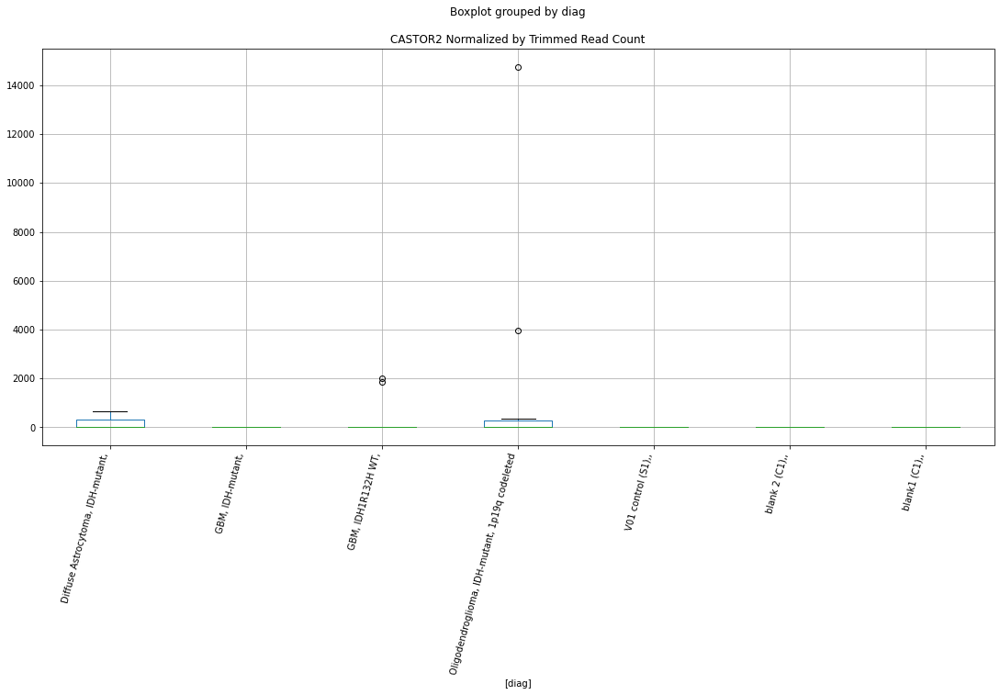

 p : 0.04036847052980651  ( t : 2.209110274751389 ) :  D-plex  :  cutadapt2  :  ARID5B
Control and blanks
76      757.61
340    7926.59
Name: ARID5B, dtype: float64
208    5290.81
Name: ARID5B, dtype: float64
472    2889.78
Name: ARID5B, dtype: float64


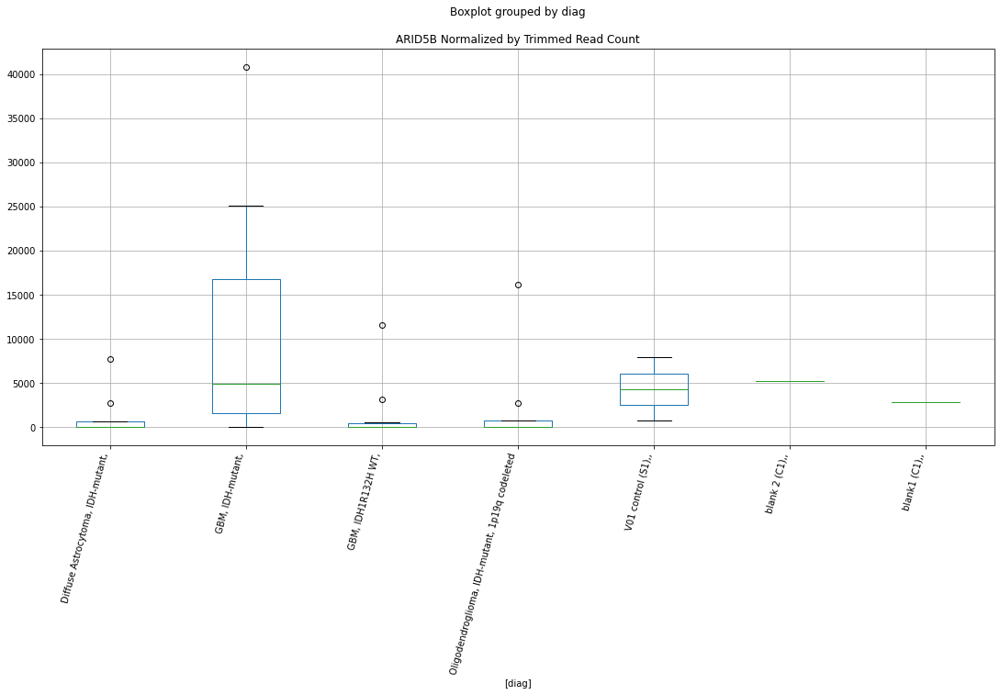

 p : 0.04047727289333468  ( t : 2.2077614255320657 ) :  D-plex  :  bbduk2  :  C9orf47
Control and blanks
73     0.0
337    0.0
Name: C9orf47, dtype: float64
205    2149.09
Name: C9orf47, dtype: float64
469    2366.11
Name: C9orf47, dtype: float64


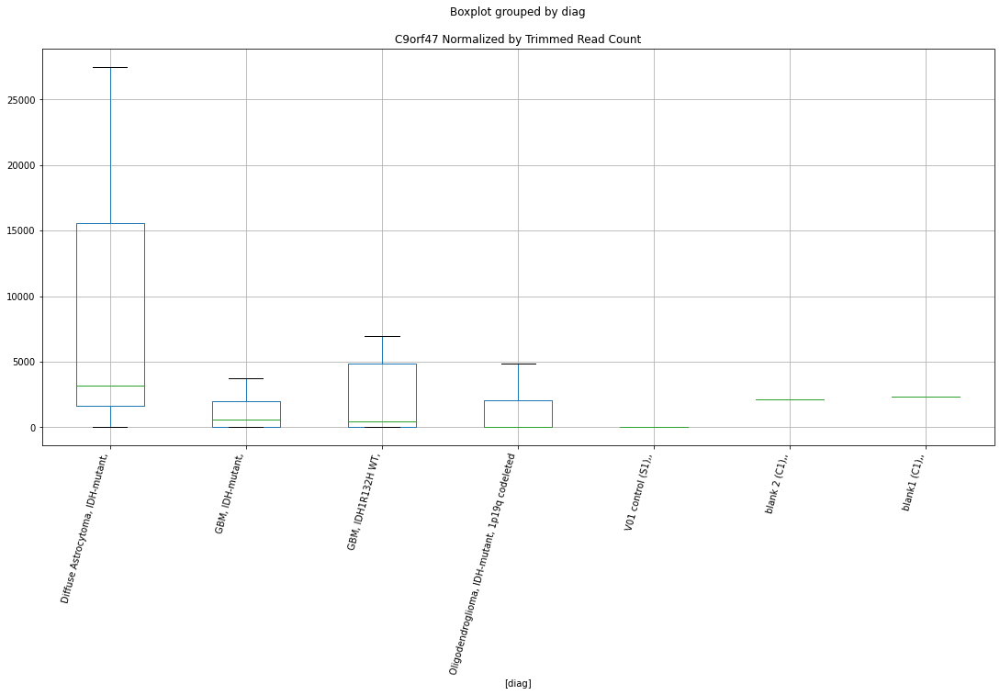

 p : 0.040504700600992344  ( t : 2.207421923552491 ) :  Lexogen  :  cutadapt2  :  ALLC
Control and blanks
82     0.0
346    0.0
Name: ALLC, dtype: float64
214    0.0
Name: ALLC, dtype: float64
478    0.0
Name: ALLC, dtype: float64


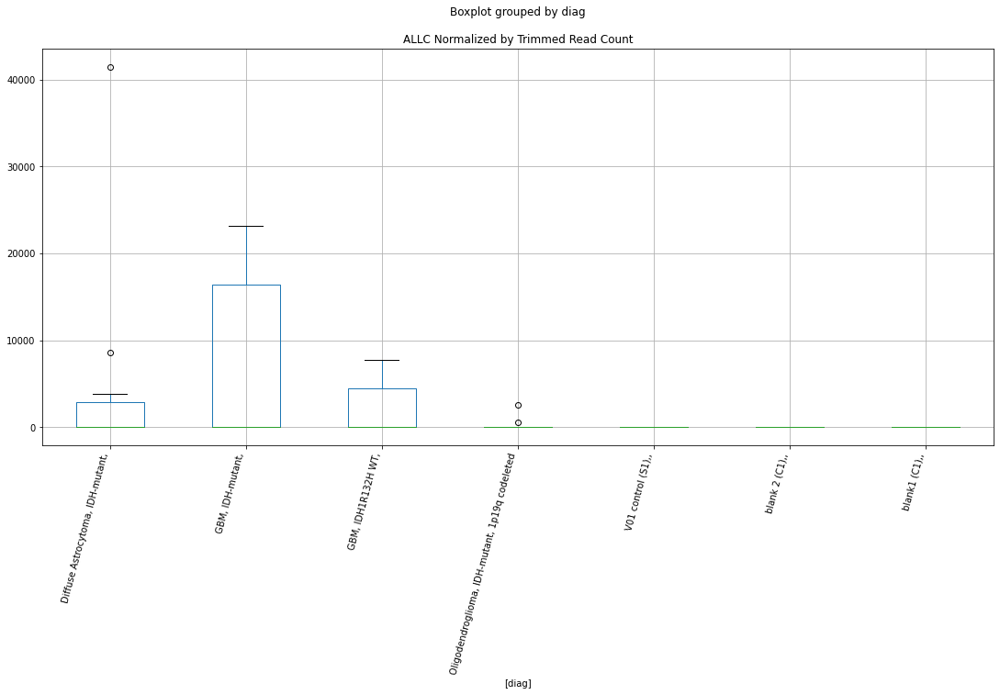

 p : 0.040505201145447554  ( t : 2.2074157297434875 ) :  D-plex  :  bbduk2  :  CDC25B
Control and blanks
73        0.00
337    3560.63
Name: CDC25B, dtype: float64
205    31878.19
Name: CDC25B, dtype: float64
469    2366.11
Name: CDC25B, dtype: float64


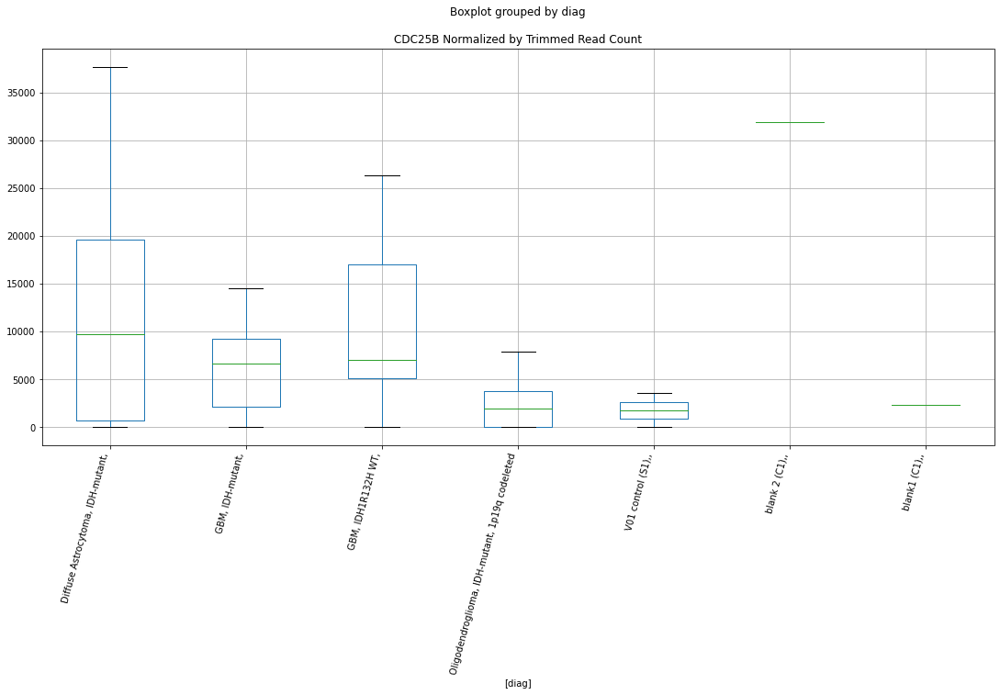

 p : 0.04053295584637648  ( t : 2.2070723991289647 ) :  D-plex  :  cutadapt2  :  DCTN1-AS1
Control and blanks
76     2272.84
340    2642.20
Name: DCTN1-AS1, dtype: float64
208    3879.92
Name: DCTN1-AS1, dtype: float64
472    7513.43
Name: DCTN1-AS1, dtype: float64


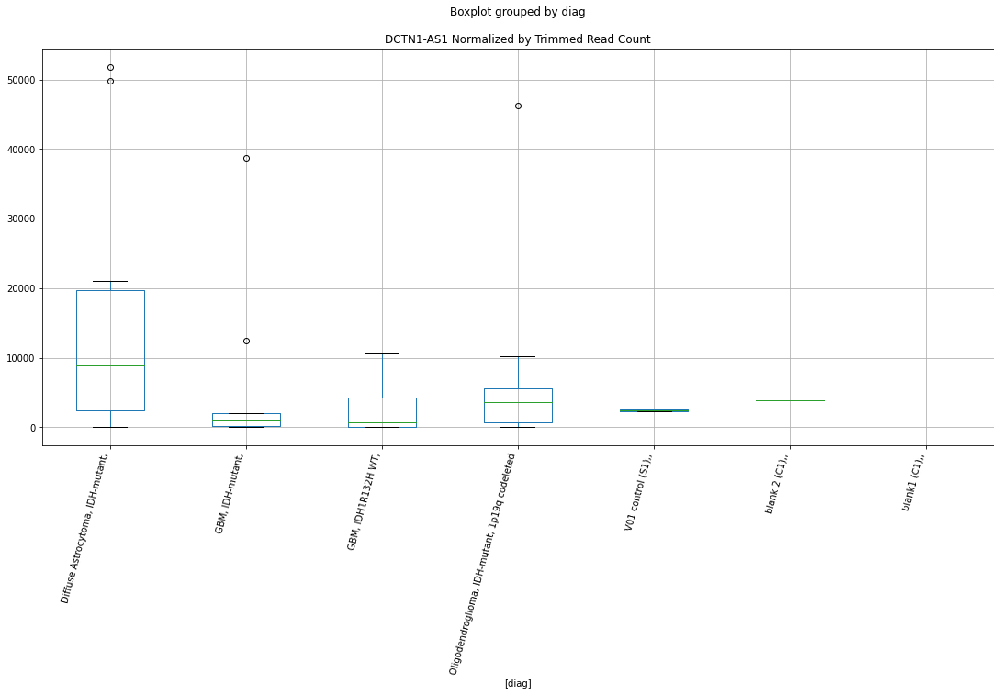

 p : 0.040545530499546456  ( t : 2.206916919534124 ) :  Lexogen  :  bbduk2  :  DGKZ
Control and blanks
79     0.0
343    0.0
Name: DGKZ, dtype: float64
211    8199.19
Name: DGKZ, dtype: float64
475    0.0
Name: DGKZ, dtype: float64


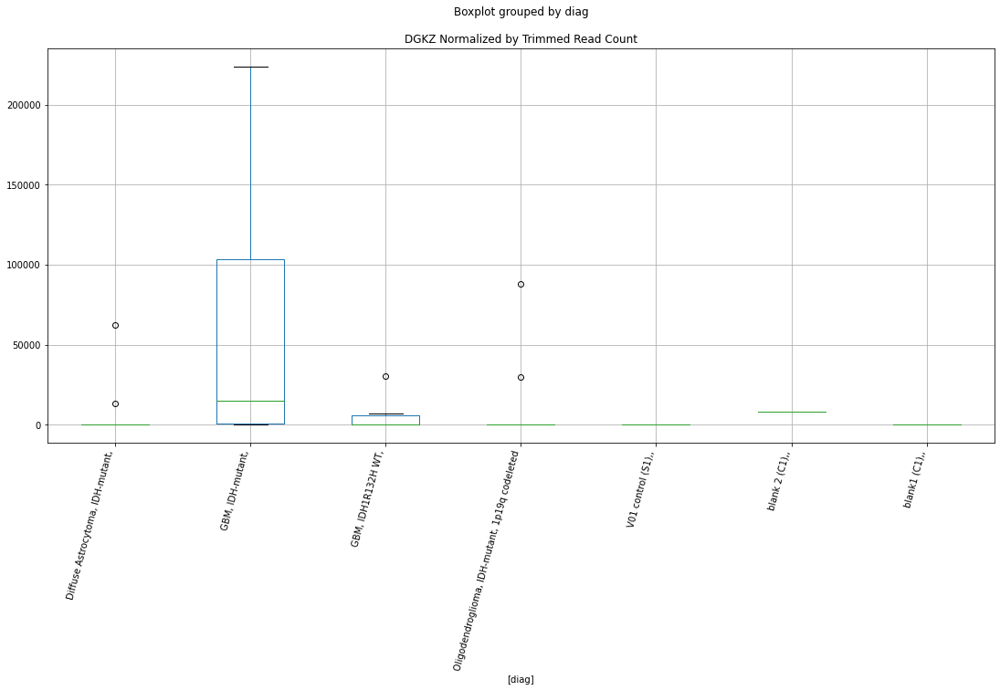

 p : 0.04058284117698831  ( t : 2.2064558514593124 ) :  D-plex  :  bbduk2  :  ARIH2
Control and blanks
73     4638.05
337       0.00
Name: ARIH2, dtype: float64
205    76471.84
Name: ARIH2, dtype: float64
469    34308.58
Name: ARIH2, dtype: float64


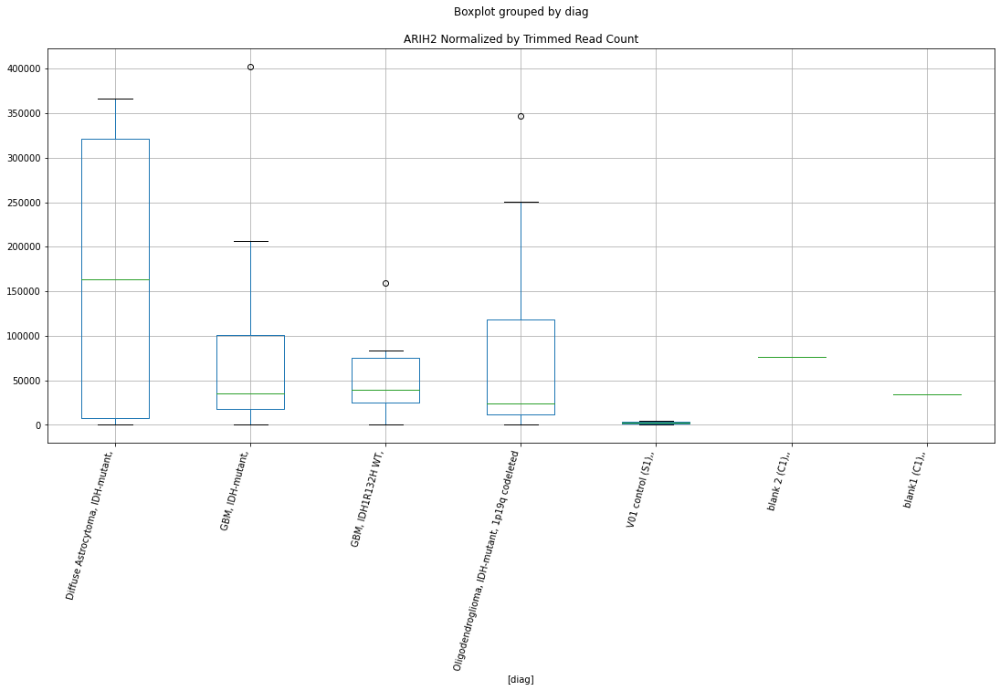

 p : 0.04066381244147146  ( t : 2.2054565845792053 ) :  D-plex  :  cutadapt2  :  CDCA7L
Control and blanks
76     0.0
340    0.0
Name: CDCA7L, dtype: float64
208    2116.32
Name: CDCA7L, dtype: float64
472    1733.87
Name: CDCA7L, dtype: float64


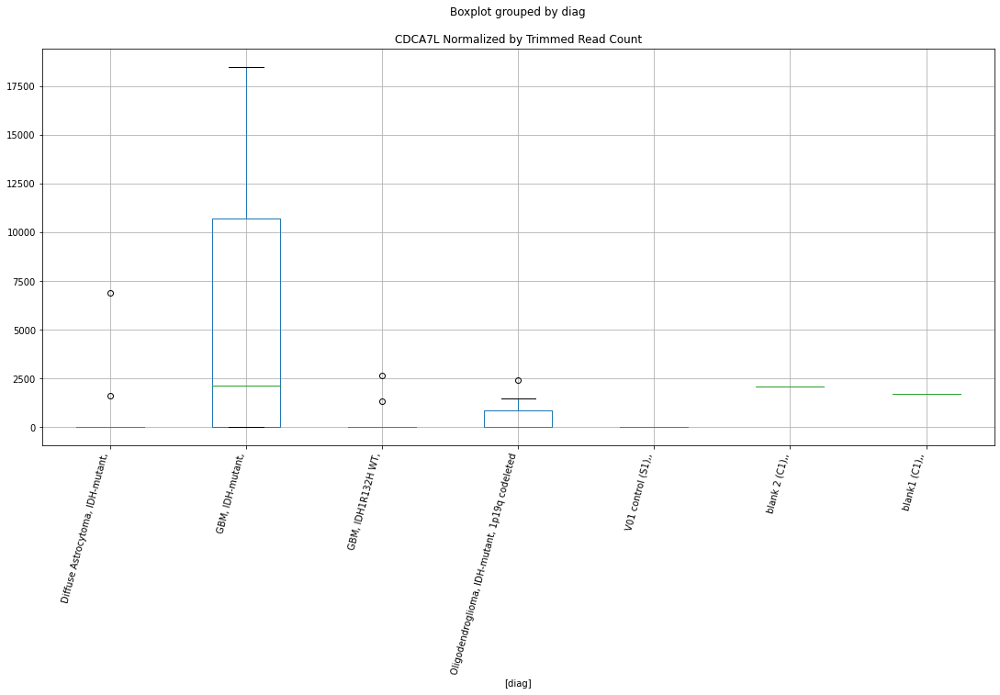

 p : 0.04066978729191642  ( t : 2.2053829213692375 ) :  D-plex  :  bbduk2  :  CACTIN
Control and blanks
73     0.0
337    0.0
Name: CACTIN, dtype: float64
205    3581.82
Name: CACTIN, dtype: float64
469    4732.22
Name: CACTIN, dtype: float64


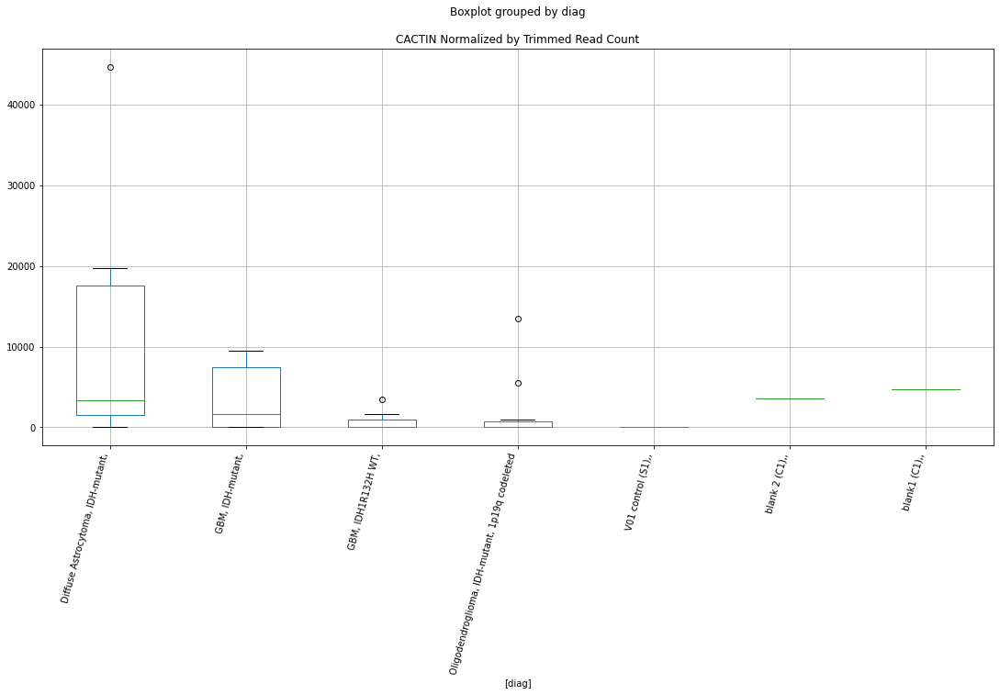

 p : 0.04067953989120821  ( t : 2.2052627041097326 ) :  Lexogen  :  bbduk2  :  BMS1P1
Control and blanks
79         0.00
343    13163.49
Name: BMS1P1, dtype: float64
211    0.0
Name: BMS1P1, dtype: float64
475    0.0
Name: BMS1P1, dtype: float64


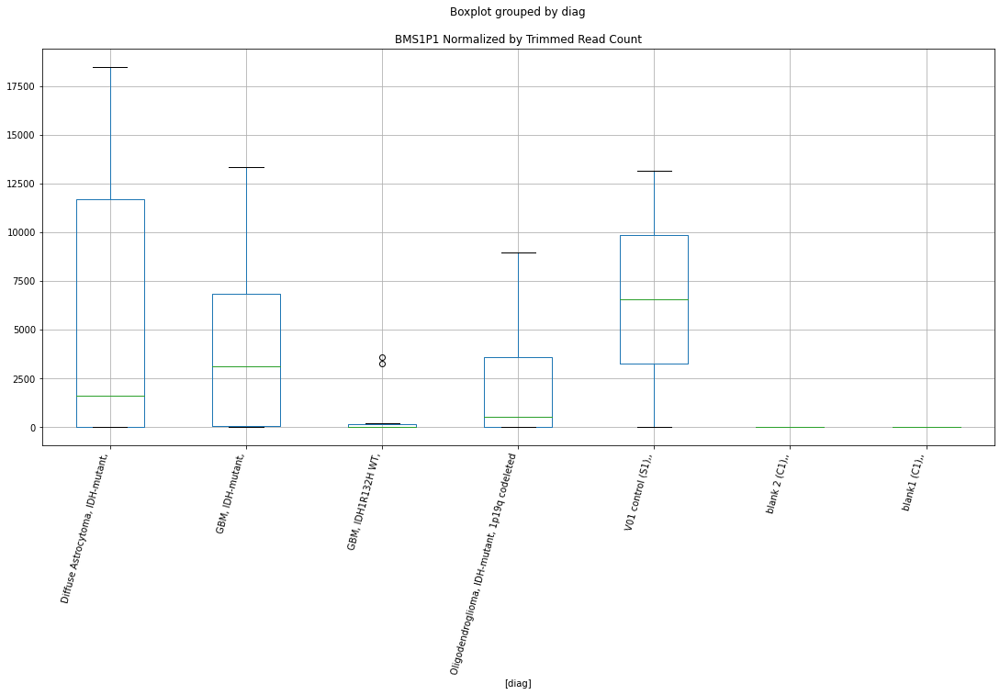

 p : 0.0406976769779926  ( t : 2.2050392042834708 ) :  D-plex  :  bbduk2  :  AHCYL2
Control and blanks
73     0.0
337    0.0
Name: AHCYL2, dtype: float64
205    2507.27
Name: AHCYL2, dtype: float64
469    0.0
Name: AHCYL2, dtype: float64


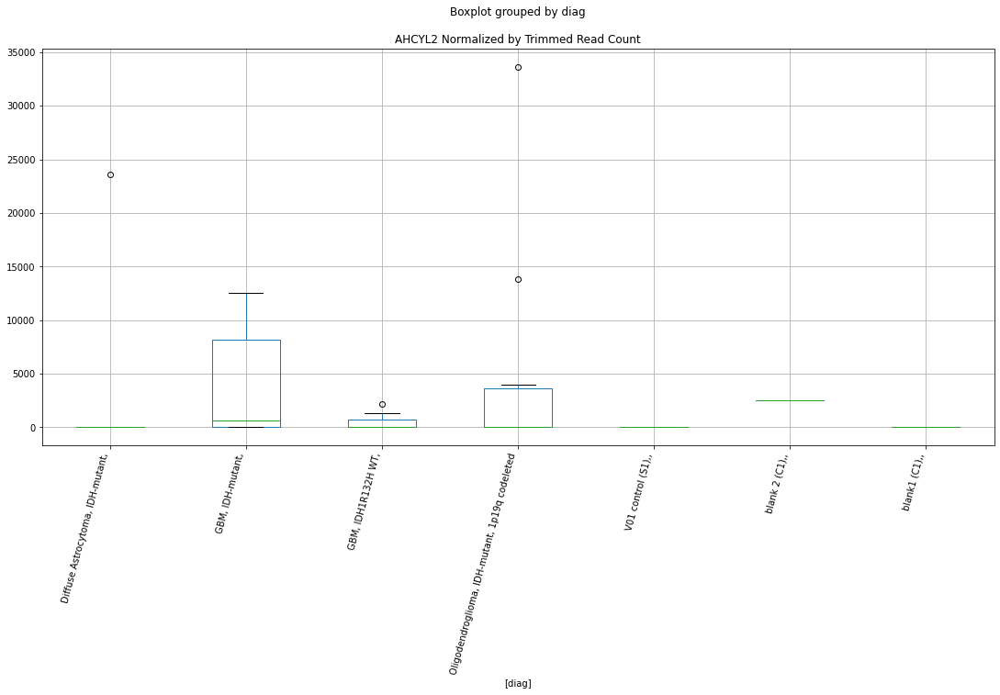

 p : 0.040724956060376974  ( t : 2.2047032216885913 ) :  D-plex  :  bbduk2  :  CD226
Control and blanks
73     0.0
337    0.0
Name: CD226, dtype: float64
205    3940.0
Name: CD226, dtype: float64
469    4732.22
Name: CD226, dtype: float64


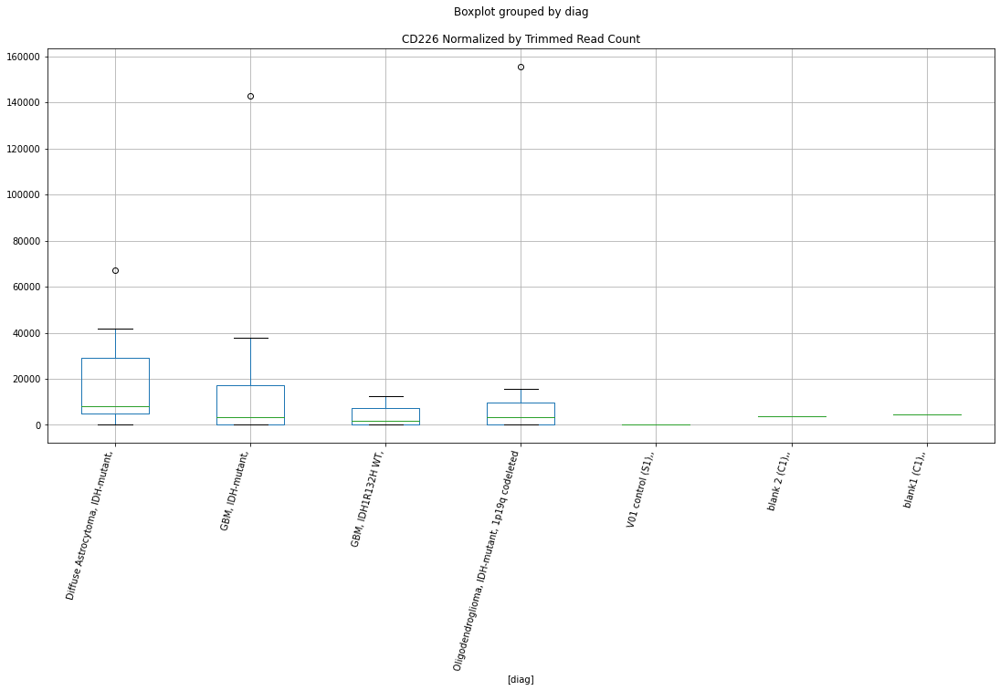

 p : 0.040728986386867554  ( t : 2.204653599738854 ) :  D-plex  :  cutadapt2  :  AACSP1
Control and blanks
76     0.0
340    0.0
Name: AACSP1, dtype: float64
208    0.0
Name: AACSP1, dtype: float64
472    577.96
Name: AACSP1, dtype: float64


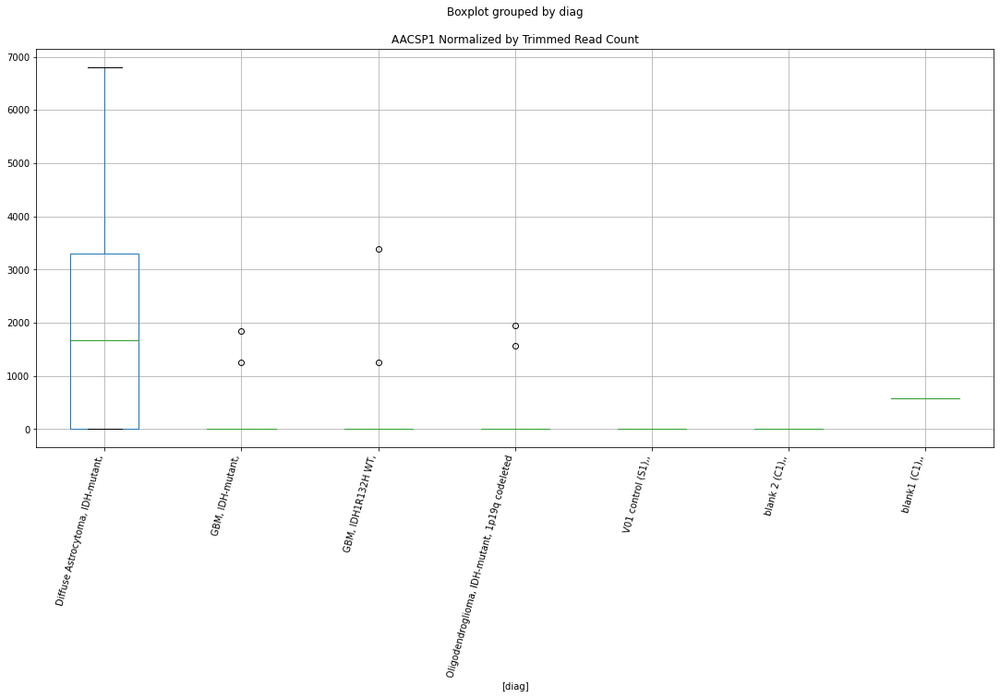

 p : 0.04077240753528876  ( t : 2.204119278363074 ) :  D-plex  :  cutadapt2  :  DDX19B
Control and blanks
76     0.0
340    0.0
Name: DDX19B, dtype: float64
208    2116.32
Name: DDX19B, dtype: float64
472    0.0
Name: DDX19B, dtype: float64


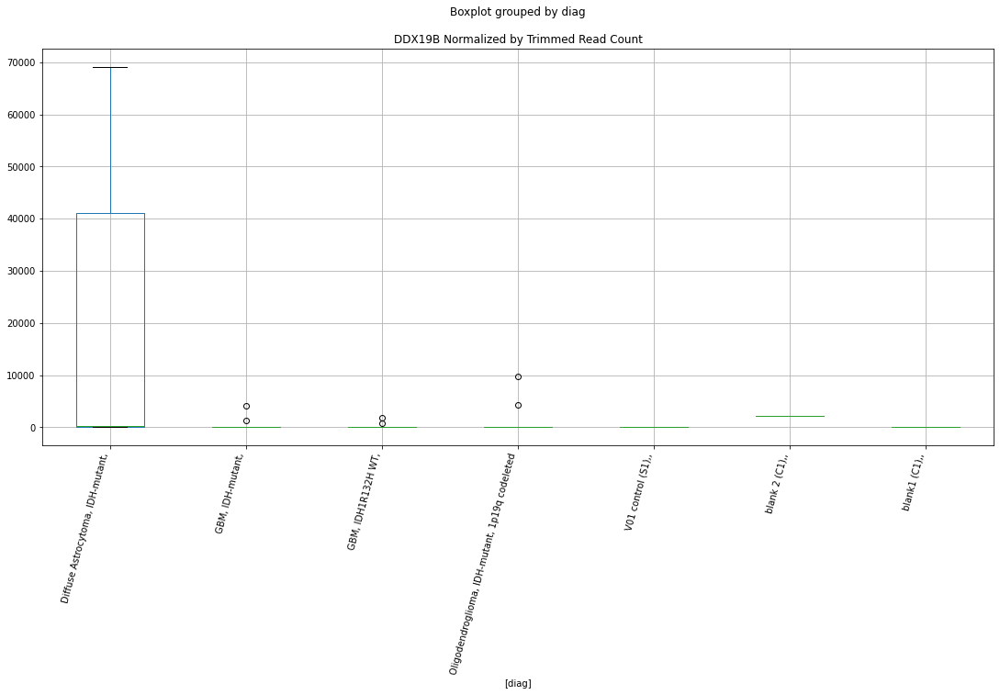

 p : 0.04079062179328105  ( t : 2.203895297427509 ) :  D-plex  :  cutadapt2  :  ANKS3
Control and blanks
76     0.0
340    0.0
Name: ANKS3, dtype: float64
208    8641.65
Name: ANKS3, dtype: float64
472    0.0
Name: ANKS3, dtype: float64


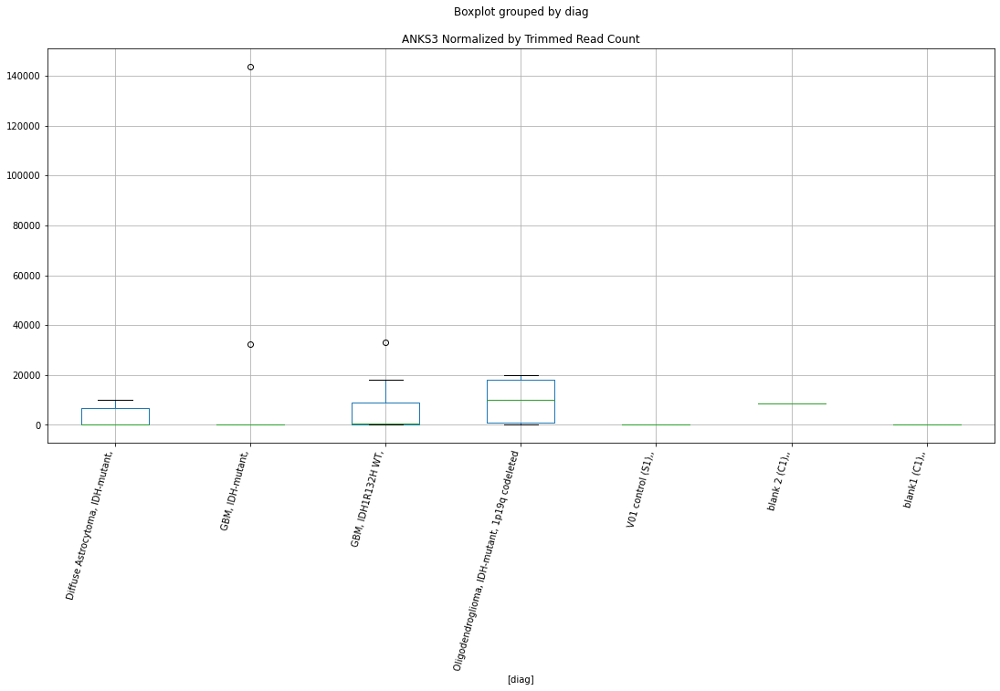

 p : 0.04083206889584174  ( t : 2.2033859641868605 ) :  D-plex  :  bbduk2  :  ACOX2
Control and blanks
73     80392.87
337        0.00
Name: ACOX2, dtype: float64
205    38683.65
Name: ACOX2, dtype: float64
469    70983.28
Name: ACOX2, dtype: float64


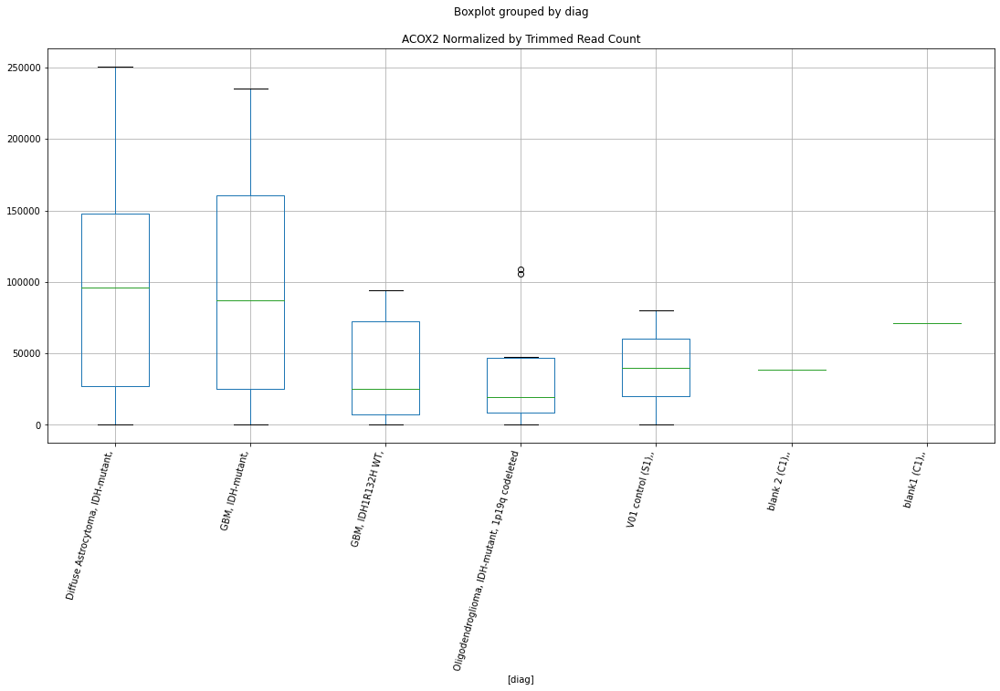

 p : 0.04087535889690558  ( t : 2.202854490886876 ) :  D-plex  :  cutadapt2  :  CLTC
Control and blanks
76     1515.23
340       0.00
Name: CLTC, dtype: float64
208    3527.2
Name: CLTC, dtype: float64
472    0.0
Name: CLTC, dtype: float64


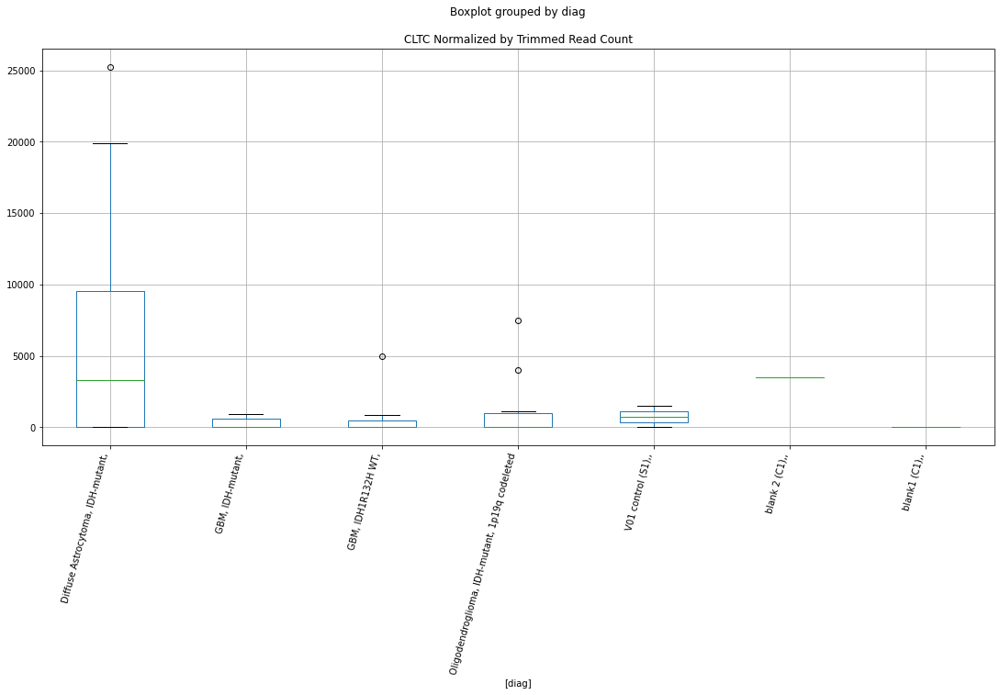

 p : 0.04087538033357914  ( t : 2.202854227835981 ) :  Lexogen  :  bbduk2  :  CPT1C
Control and blanks
79     0.0
343    0.0
Name: CPT1C, dtype: float64
211    4099.6
Name: CPT1C, dtype: float64
475    3592.74
Name: CPT1C, dtype: float64


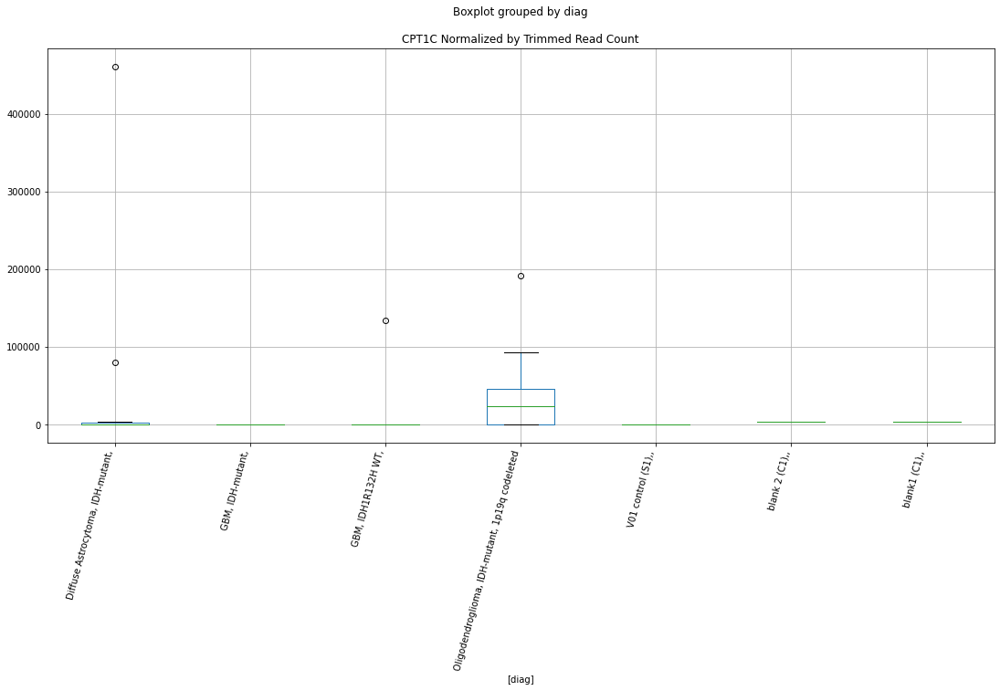

 p : 0.04087550764656238  ( t : 2.2028526655722223 ) :  D-plex  :  bbduk2  :  C21orf59-TCP10L
Control and blanks
73        0.00
337    2670.47
Name: C21orf59-TCP10L, dtype: float64
205    2328.18
Name: C21orf59-TCP10L, dtype: float64
469    2957.64
Name: C21orf59-TCP10L, dtype: float64


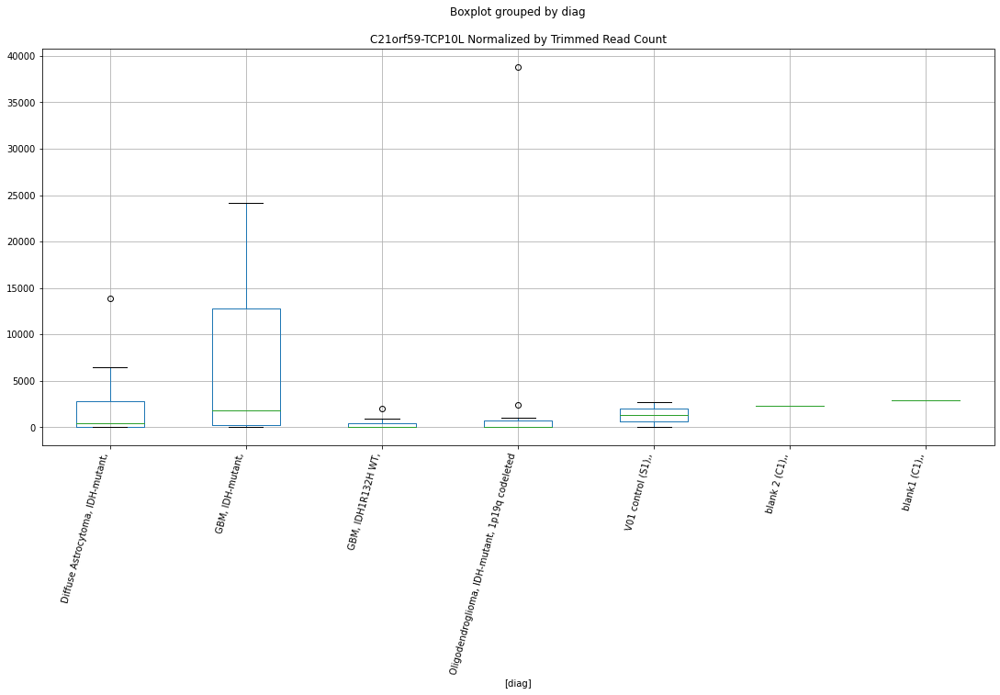

 p : 0.04090385146129809  ( t : 2.202504968479423 ) :  D-plex  :  bbduk2  :  C5orf52
Control and blanks
73     1546.02
337       0.00
Name: C5orf52, dtype: float64
205    537.27
Name: C5orf52, dtype: float64
469    591.53
Name: C5orf52, dtype: float64


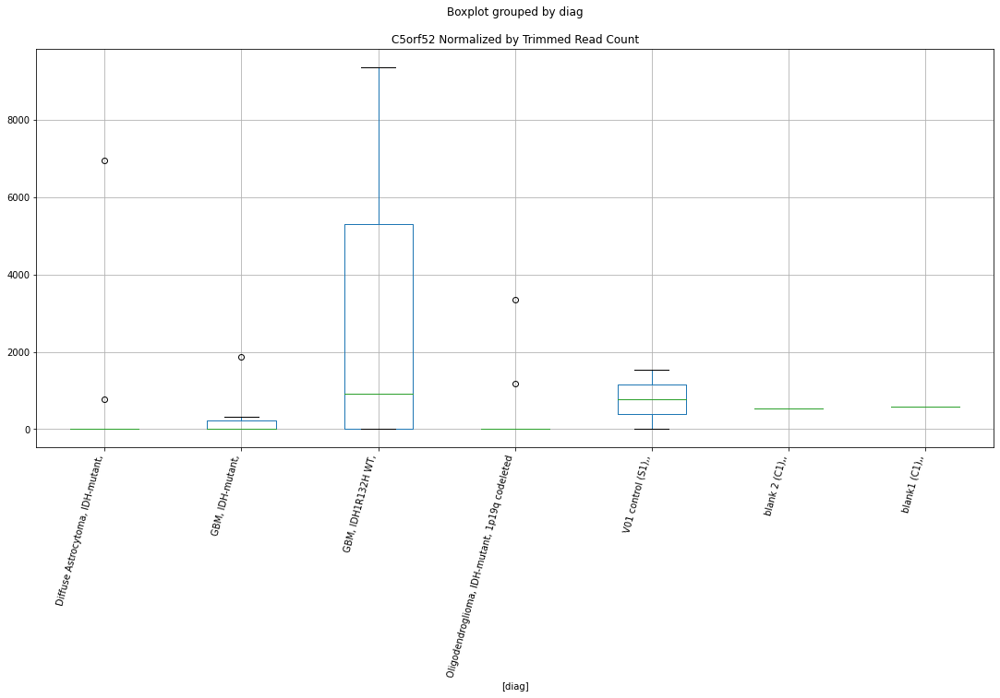

 p : 0.040916683332930866  ( t : 2.202347631092768 ) :  Lexogen  :  cutadapt2  :  CPT1C
Control and blanks
82     0.0
346    0.0
Name: CPT1C, dtype: float64
214    0.0
Name: CPT1C, dtype: float64
478    0.0
Name: CPT1C, dtype: float64


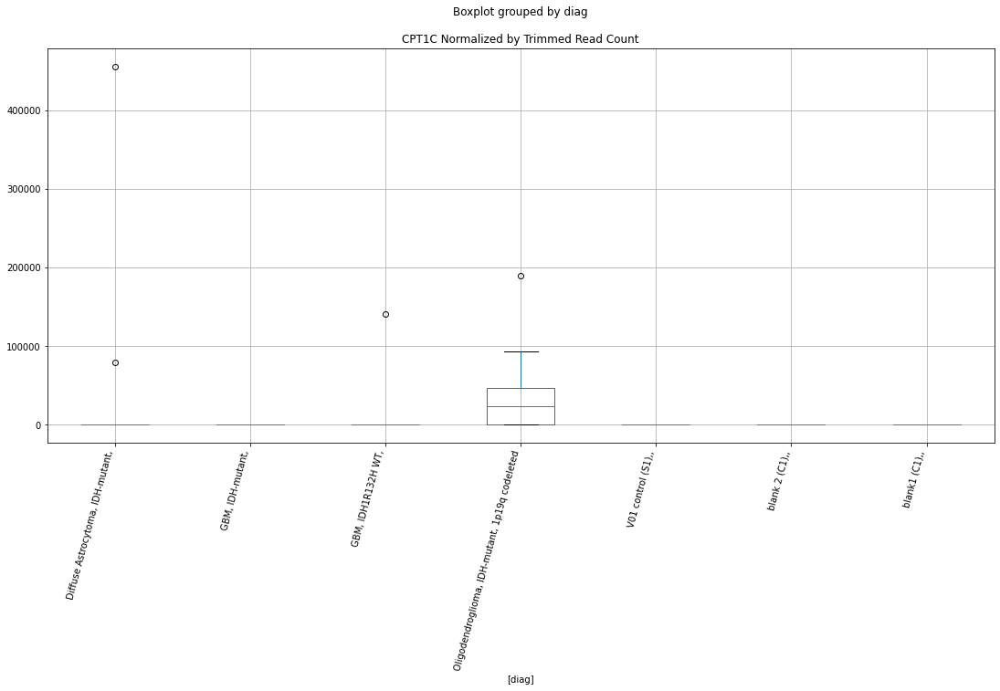

 p : 0.04094001407144839  ( t : 2.2020616784356783 ) :  D-plex  :  bbduk2  :  ACOX2
Control and blanks
73     80392.87
337        0.00
Name: ACOX2, dtype: float64
205    38683.65
Name: ACOX2, dtype: float64
469    70983.28
Name: ACOX2, dtype: float64


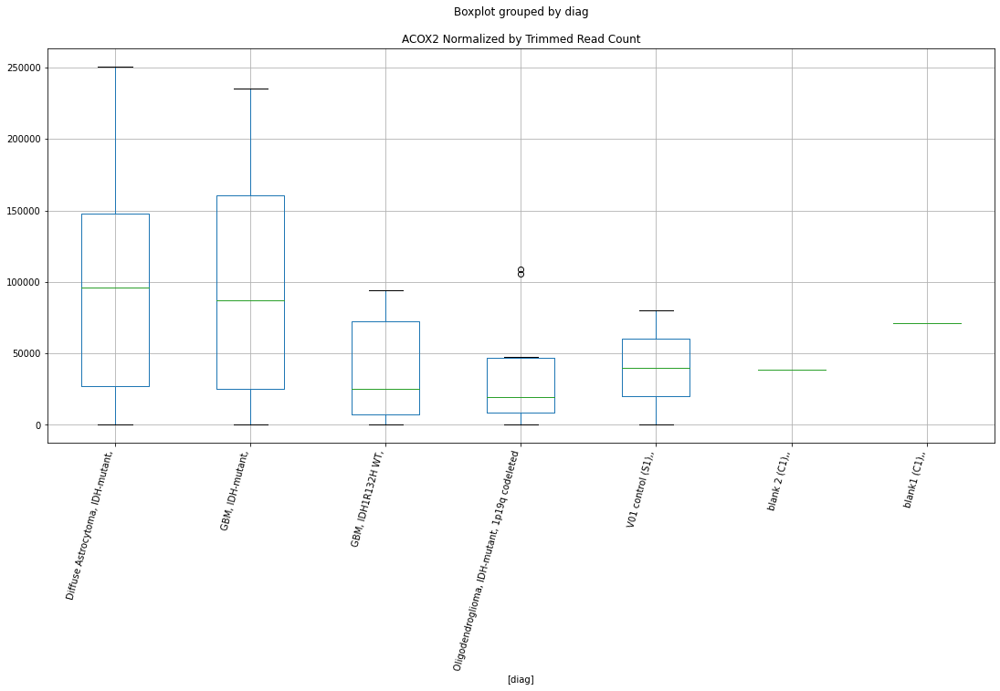

 p : 0.040999417444389744  ( t : 2.2013342775702993 ) :  Lexogen  :  cutadapt2  :  BMS1P1
Control and blanks
82         0.00
346    13046.94
Name: BMS1P1, dtype: float64
214    0.0
Name: BMS1P1, dtype: float64
478    0.0
Name: BMS1P1, dtype: float64


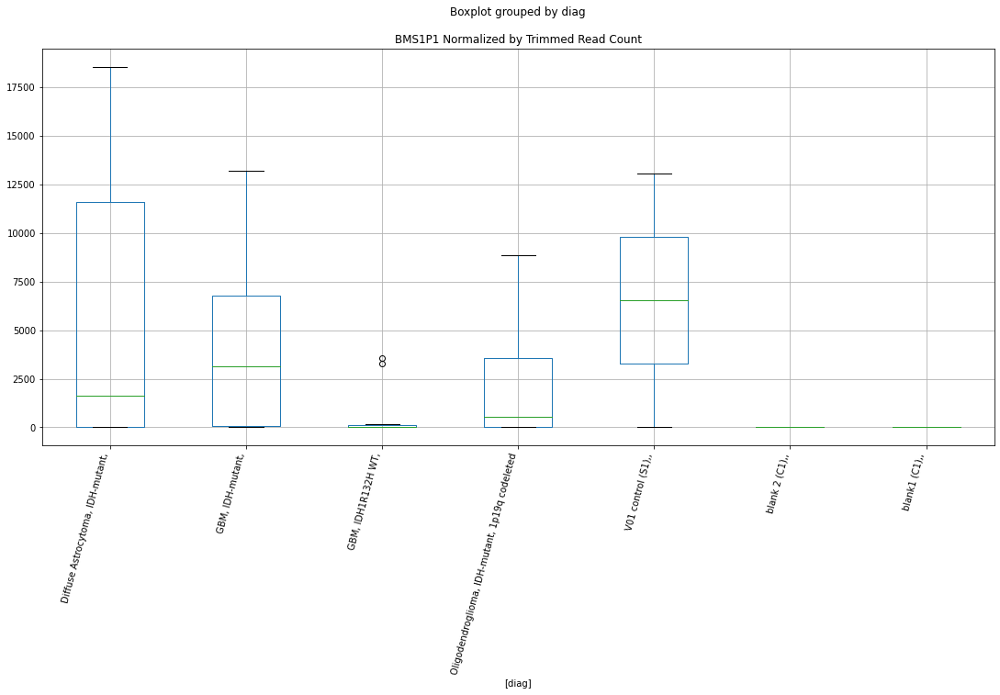

 p : 0.04100572462869741  ( t : 2.2012571022591914 ) :  D-plex  :  cutadapt2  :  ACOX2
Control and blanks
76     78791.88
340        0.00
Name: ACOX2, dtype: float64
208    38093.81
Name: ACOX2, dtype: float64
472    69354.7
Name: ACOX2, dtype: float64


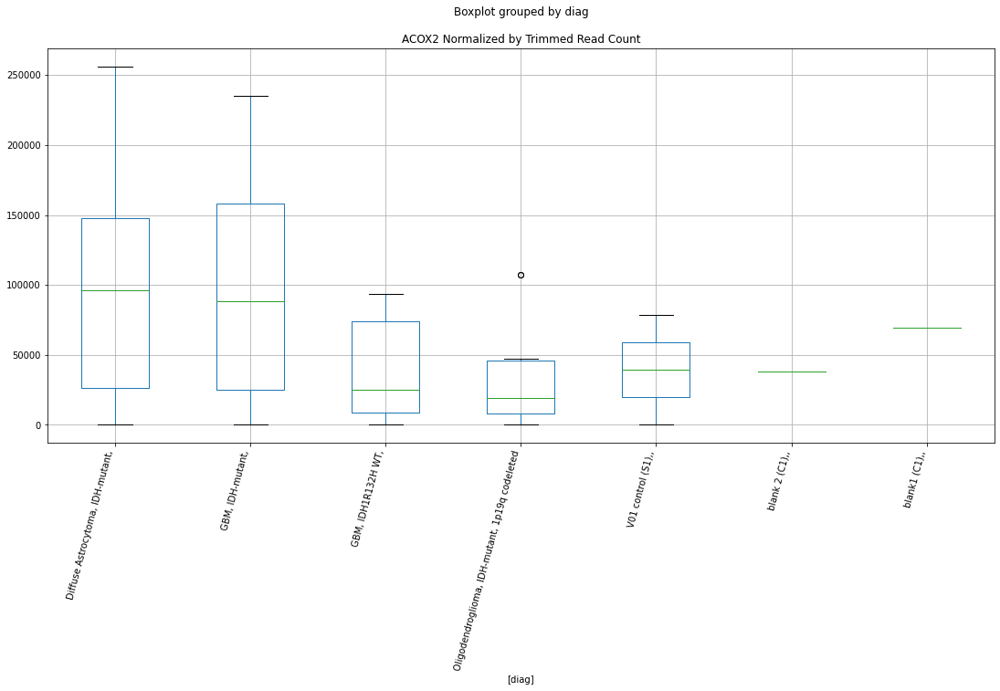

 p : 0.04108341355458743  ( t : 2.2003073863056253 ) :  D-plex  :  bbduk2  :  DDX19B
Control and blanks
73     0.0
337    0.0
Name: DDX19B, dtype: float64
205    2149.09
Name: DDX19B, dtype: float64
469    0.0
Name: DDX19B, dtype: float64


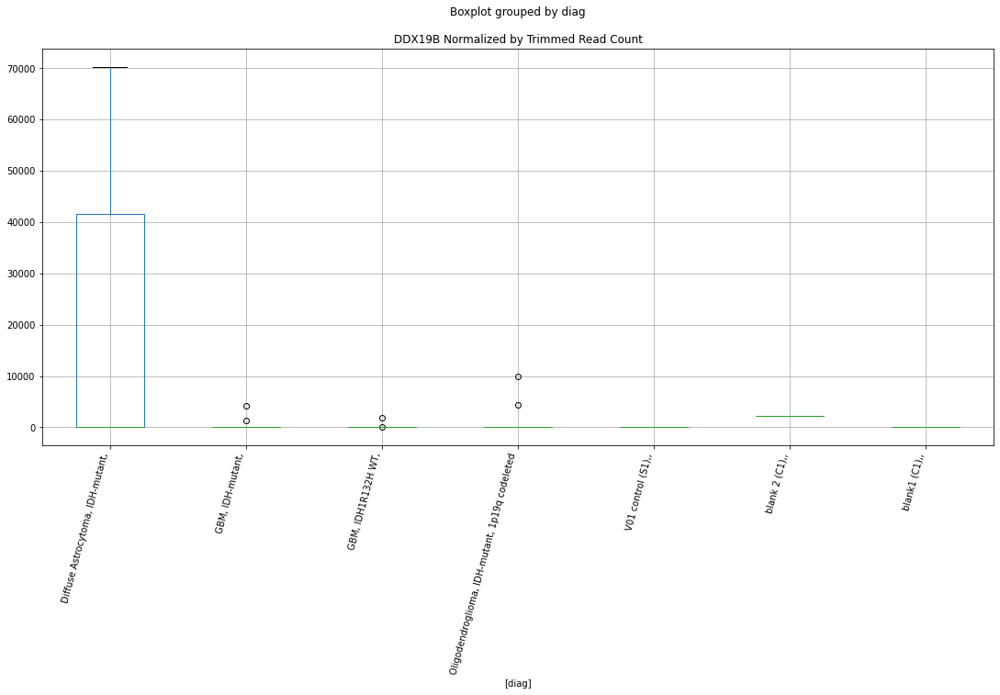

 p : 0.041090327328744854  ( t : 2.2002229481348543 ) :  D-plex  :  bbduk2  :  CDC42
Control and blanks
73     0.0
337    0.0
Name: CDC42, dtype: float64
205    1970.0
Name: CDC42, dtype: float64
469    2366.11
Name: CDC42, dtype: float64


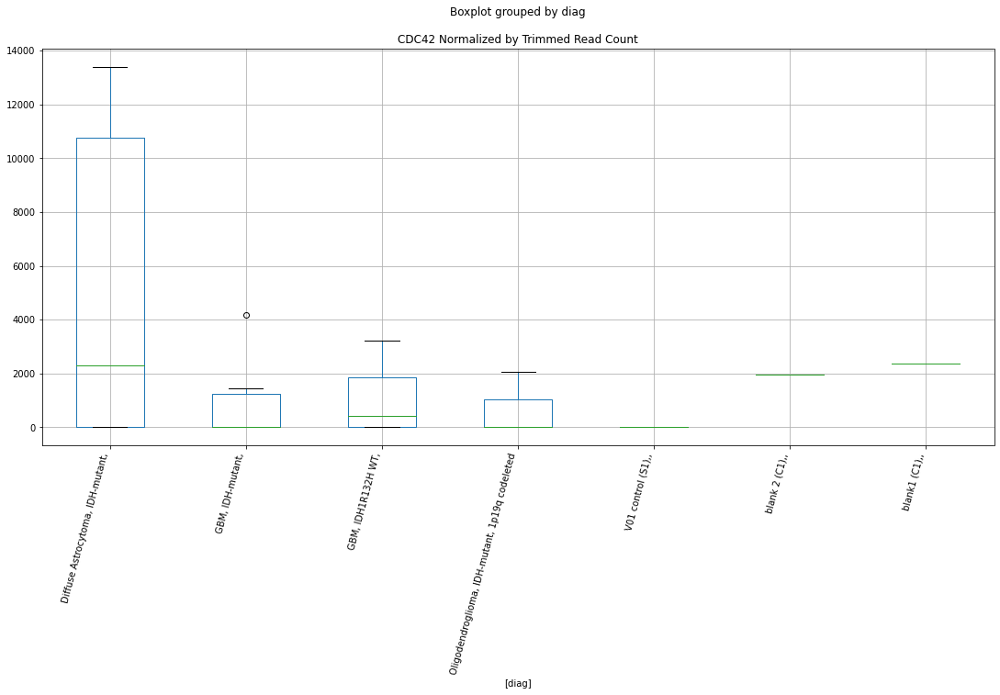

 p : 0.041118744181017006  ( t : 2.199876029075572 ) :  D-plex  :  cutadapt2  :  COMMD3
Control and blanks
76     0.0
340    0.0
Name: COMMD3, dtype: float64
208    176.36
Name: COMMD3, dtype: float64
472    0.0
Name: COMMD3, dtype: float64


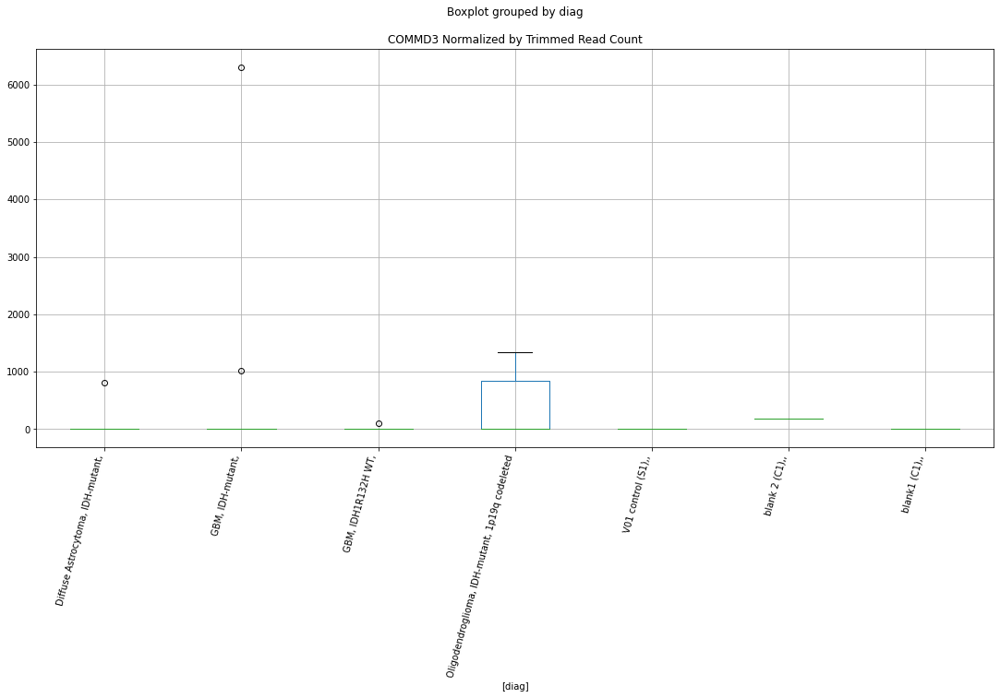

 p : 0.04112861289752796  ( t : 2.1997556011663972 ) :  D-plex  :  bbduk2  :  APBA1
Control and blanks
73     0.0
337    0.0
Name: APBA1, dtype: float64
205    1970.0
Name: APBA1, dtype: float64
469    591.53
Name: APBA1, dtype: float64


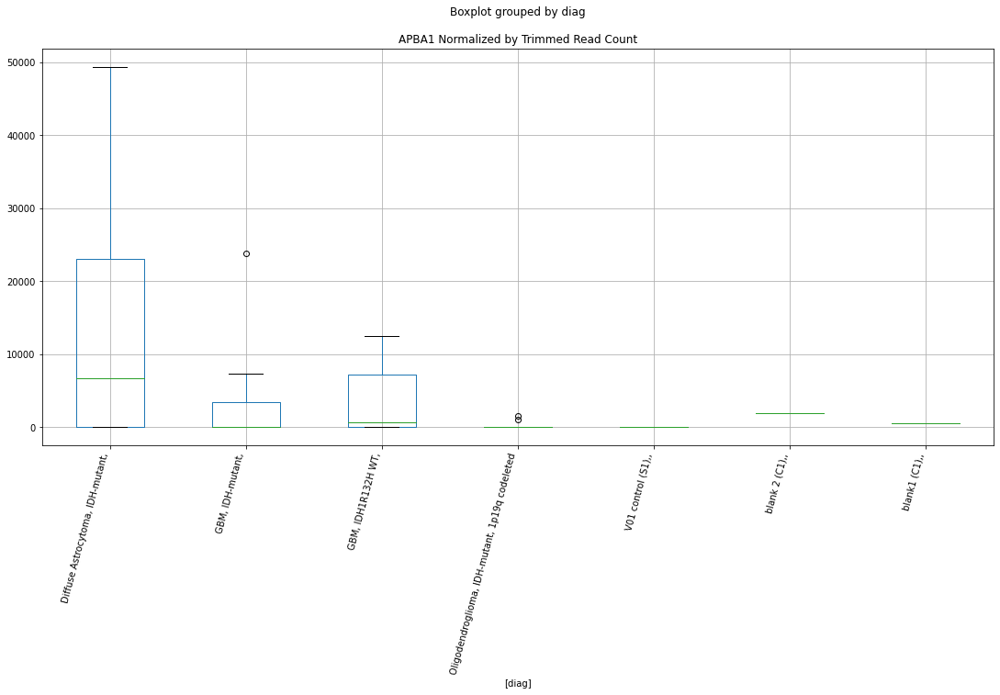

 p : 0.041167439341260804  ( t : 2.1992820596625613 ) :  D-plex  :  bbduk2  :  CHEK1
Control and blanks
73      8503.09
337    14242.52
Name: CHEK1, dtype: float64
205    30087.28
Name: CHEK1, dtype: float64
469    1.60e+06
Name: CHEK1, dtype: float64


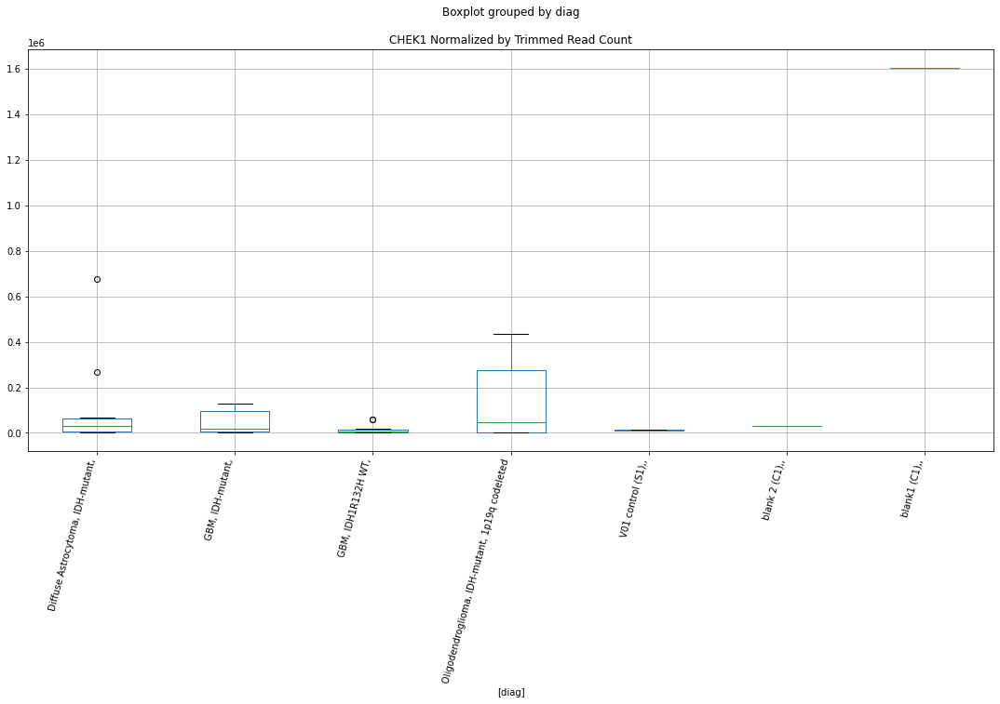

 p : 0.04124014533472592  ( t : 2.198396412805268 ) :  D-plex  :  cutadapt2  :  C5orf52
Control and blanks
76     1515.23
340       0.00
Name: C5orf52, dtype: float64
208    529.08
Name: C5orf52, dtype: float64
472    577.96
Name: C5orf52, dtype: float64


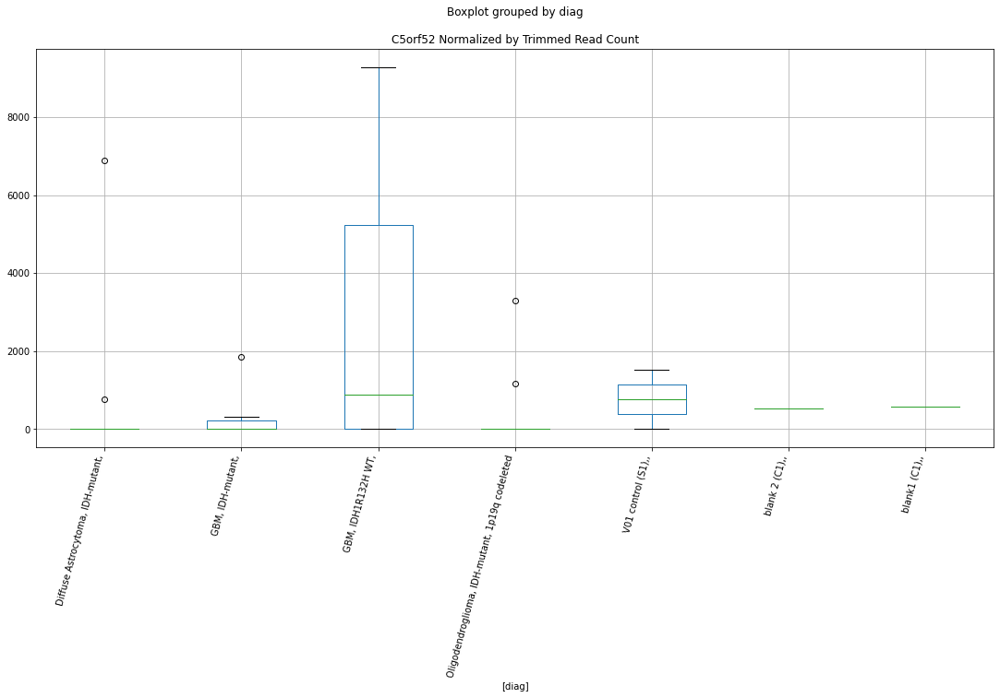

 p : 0.04125891186938346  ( t : 2.1981680465410864 ) :  Lexogen  :  cutadapt2  :  CYP1B1
Control and blanks
82     0.0
346    0.0
Name: CYP1B1, dtype: float64
214    0.0
Name: CYP1B1, dtype: float64
478    6411.43
Name: CYP1B1, dtype: float64


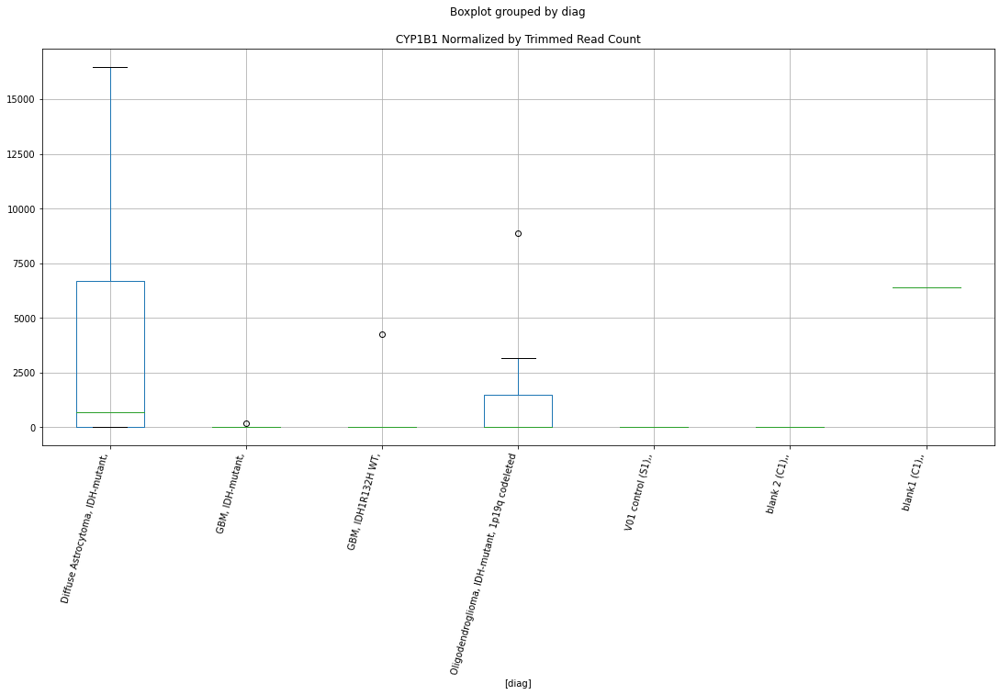

 p : 0.04130151914644929  ( t : 2.1976499208598397 ) :  D-plex  :  cutadapt2  :  ACSBG1
Control and blanks
76      1515.23
340    17614.64
Name: ACSBG1, dtype: float64
208    2821.76
Name: ACSBG1, dtype: float64
472    9247.29
Name: ACSBG1, dtype: float64


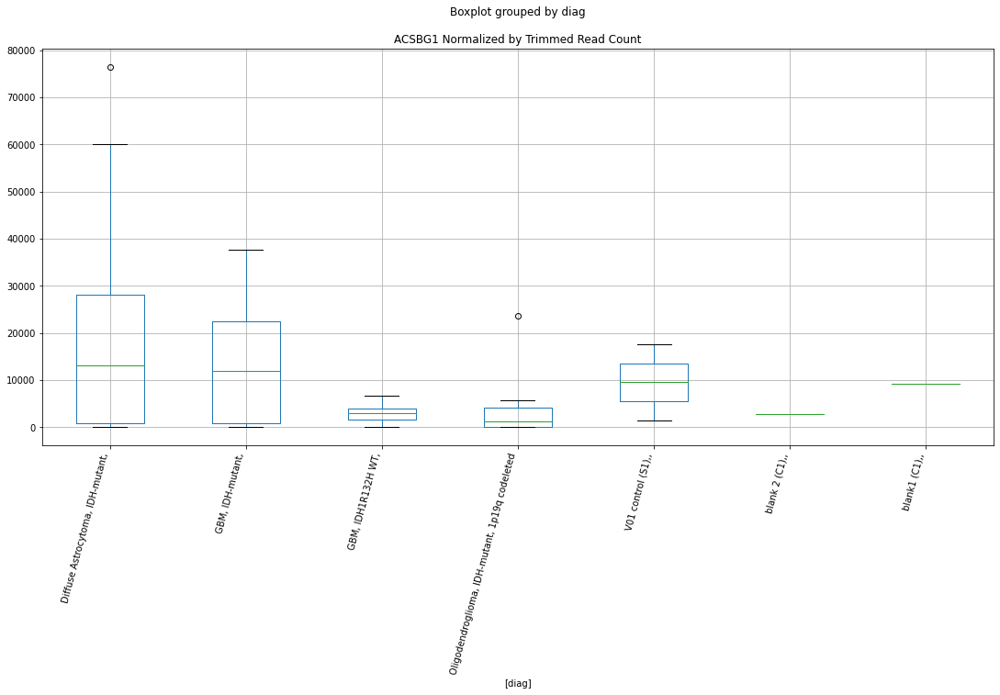

 p : 0.041309372586296515  ( t : 2.197554472695782 ) :  Lexogen  :  bbduk2  :  ADAMTS18
Control and blanks
79     0.0
343    0.0
Name: ADAMTS18, dtype: float64
211    0.0
Name: ADAMTS18, dtype: float64
475    0.0
Name: ADAMTS18, dtype: float64


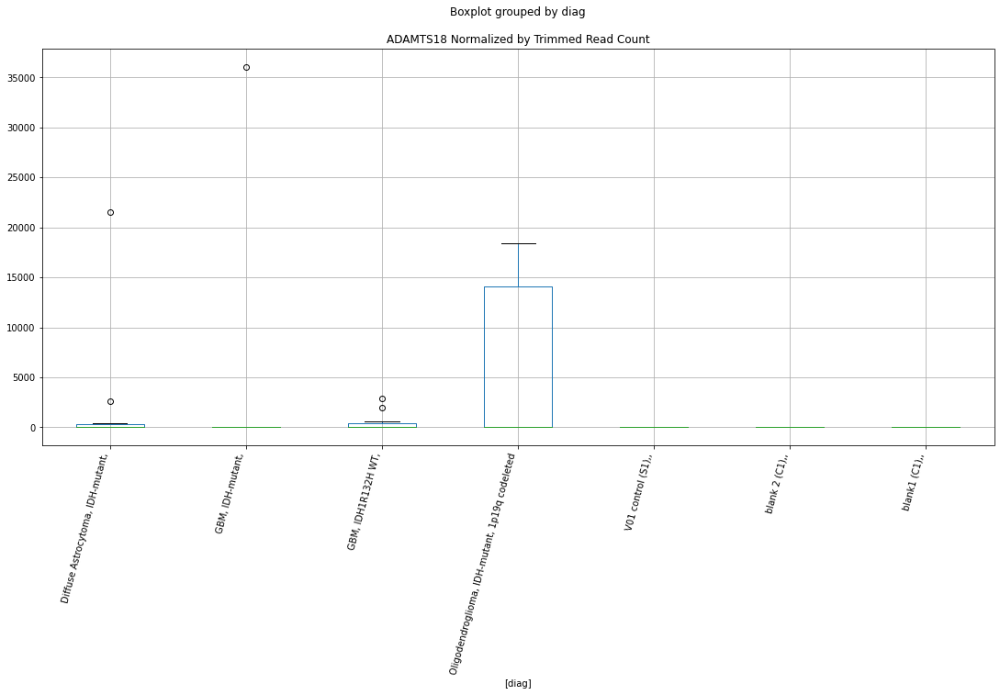

 p : 0.041356502940322254  ( t : 2.1969820154037745 ) :  Lexogen  :  bbduk2  :  CYP1B1
Control and blanks
79     0.0
343    0.0
Name: CYP1B1, dtype: float64
211    0.0
Name: CYP1B1, dtype: float64
475    6466.92
Name: CYP1B1, dtype: float64


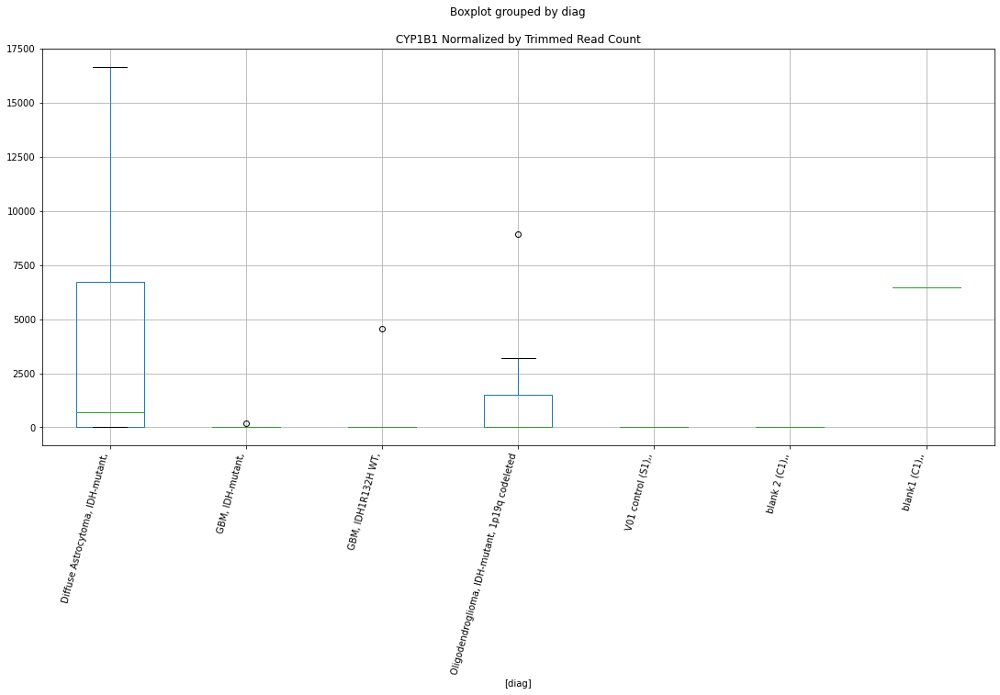

 p : 0.041361602712114455  ( t : 2.196920108192656 ) :  D-plex  :  cutadapt2  :  ARHGAP32
Control and blanks
76         0.00
340    35229.29
Name: ARHGAP32, dtype: float64
208    17283.3
Name: ARHGAP32, dtype: float64
472    29475.75
Name: ARHGAP32, dtype: float64


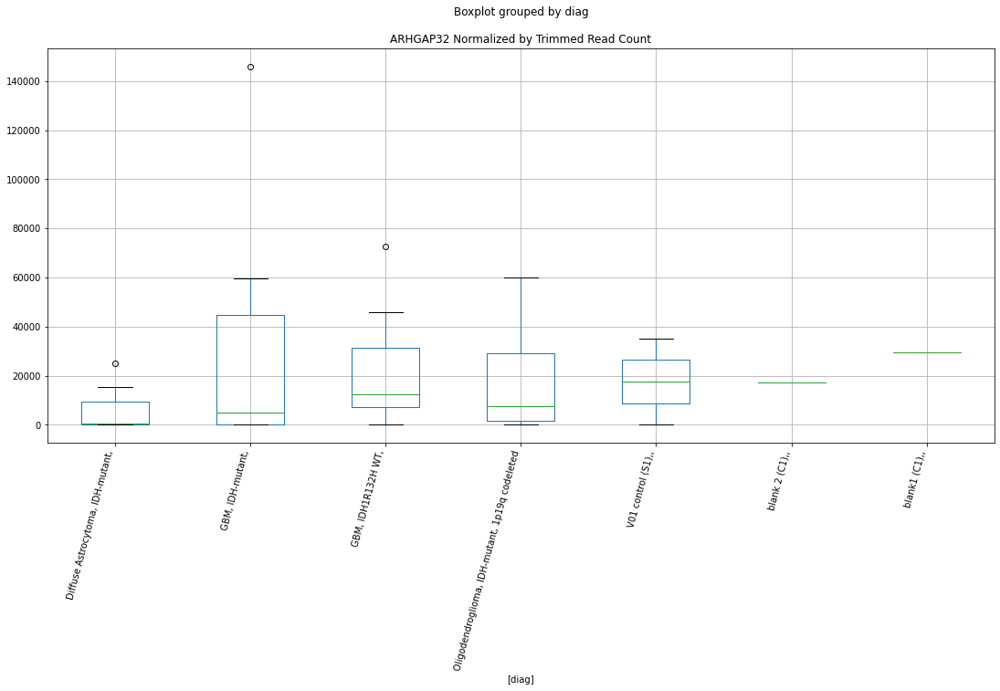

 p : 0.04141124403231707  ( t : 2.1963178675126667 ) :  Lexogen  :  cutadapt2  :  AXIN1
Control and blanks
82     0.0
346    0.0
Name: AXIN1, dtype: float64
214    9764.15
Name: AXIN1, dtype: float64
478    0.0
Name: AXIN1, dtype: float64


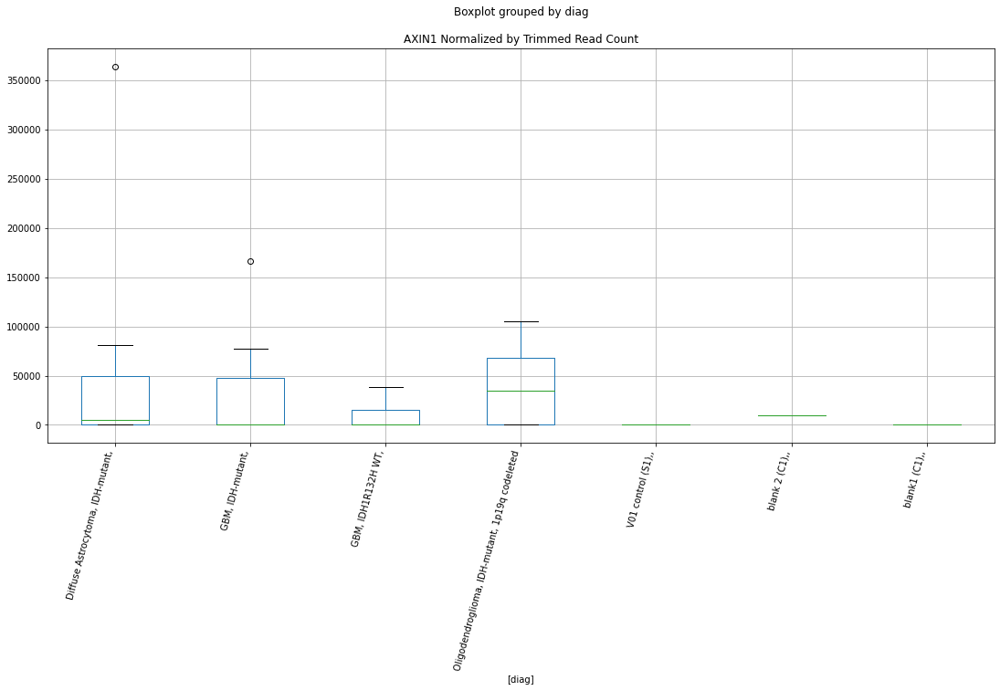

 p : 0.04141976378616673  ( t : 2.19621457384259 ) :  D-plex  :  bbduk2  :  CHMP7
Control and blanks
73     0.0
337    0.0
Name: CHMP7, dtype: float64
205    5730.91
Name: CHMP7, dtype: float64
469    0.0
Name: CHMP7, dtype: float64


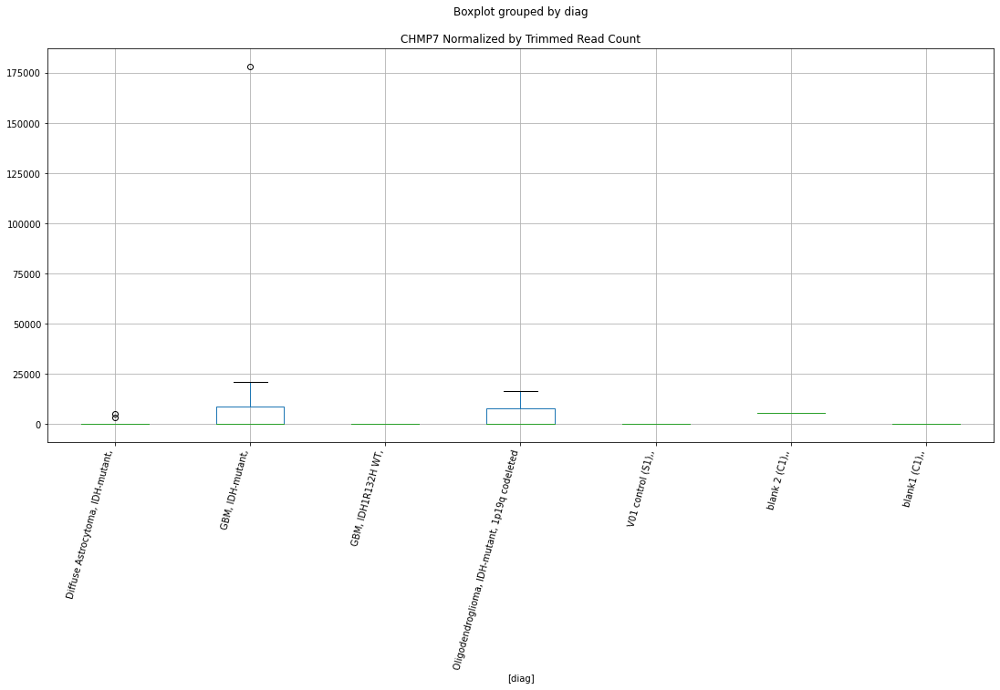

 p : 0.0414333752857284  ( t : 2.1960495882108373 ) :  D-plex  :  bbduk2  :  ANKRD52
Control and blanks
73     0.0
337    0.0
Name: ANKRD52, dtype: float64
205    3581.82
Name: ANKRD52, dtype: float64
469    591.53
Name: ANKRD52, dtype: float64


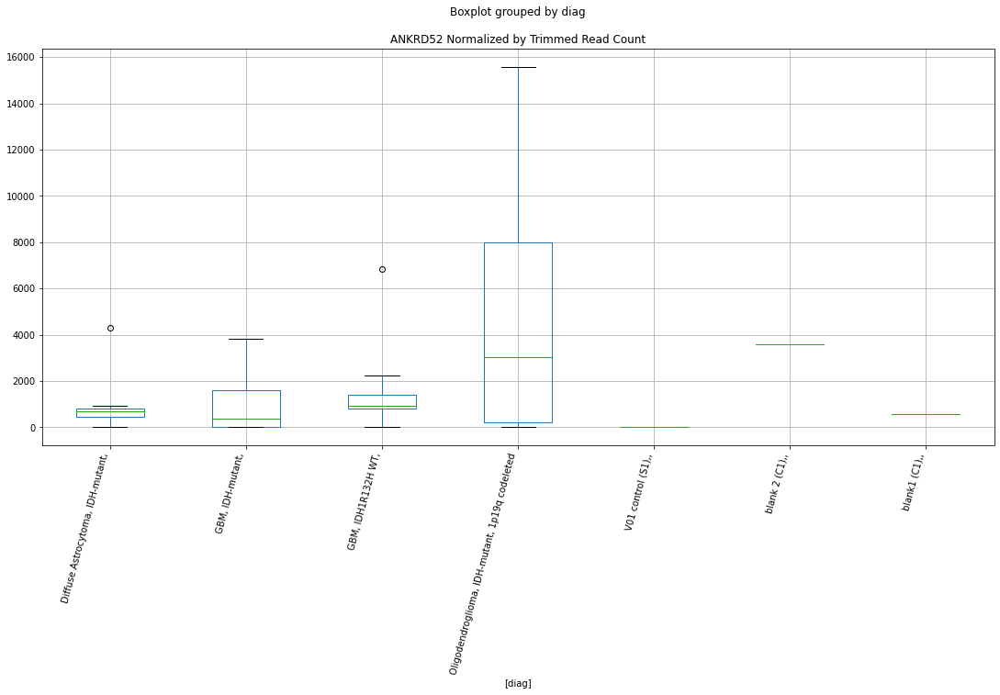

 p : 0.04144157639241136  ( t : 2.1959502062274145 ) :  Lexogen  :  bbduk2  :  ADAMTS14
Control and blanks
79        0.00
343    1698.51
Name: ADAMTS14, dtype: float64
211    72152.87
Name: ADAMTS14, dtype: float64
475    0.0
Name: ADAMTS14, dtype: float64


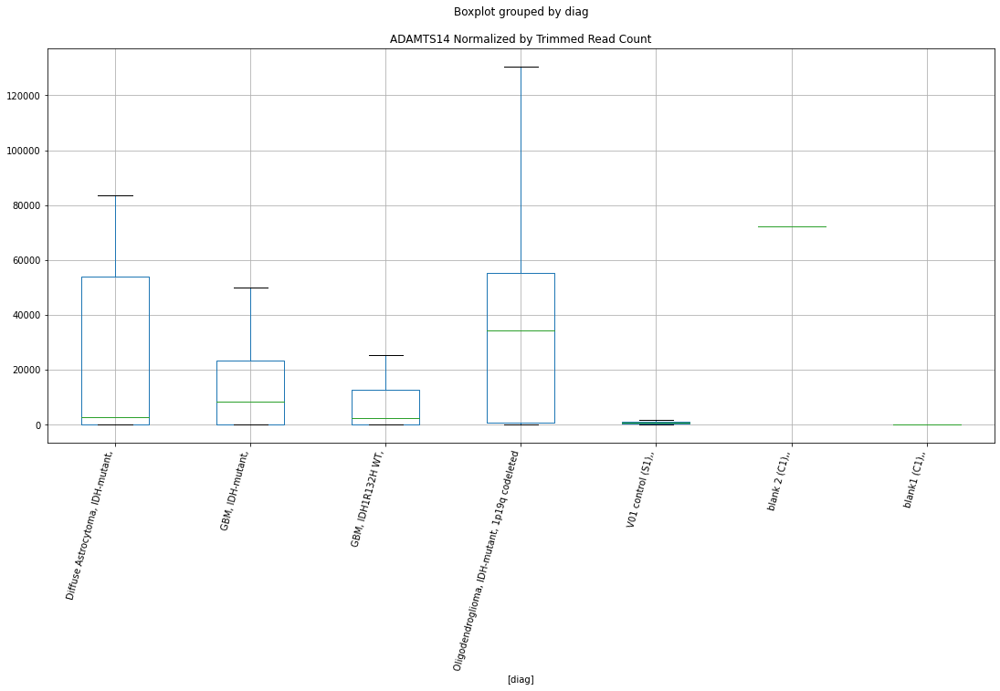

 p : 0.04154029902562239  ( t : 2.194755288300888 ) :  D-plex  :  cutadapt2  :  CREB5
Control and blanks
76        0.00
340    9688.05
Name: CREB5, dtype: float64
208    59433.39
Name: CREB5, dtype: float64
472    3.11e+06
Name: CREB5, dtype: float64


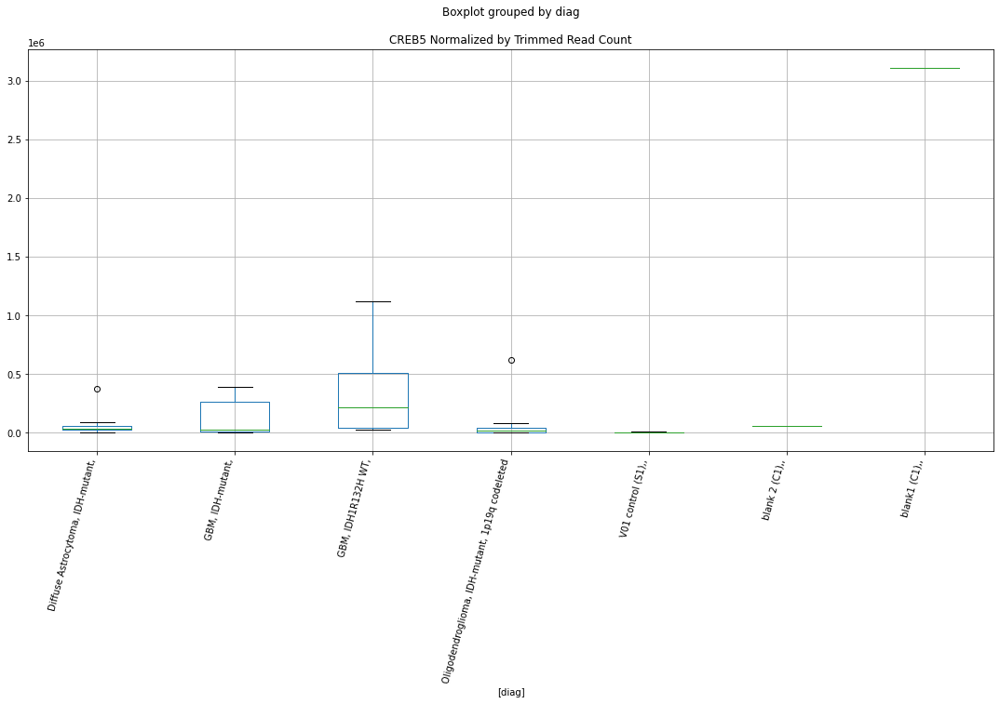

 p : 0.041570507014651696  ( t : 2.1943901780028745 ) :  D-plex  :  cutadapt2  :  DGKI
Control and blanks
76         0.00
340    19376.11
Name: DGKI, dtype: float64
208    9699.81
Name: DGKI, dtype: float64
472    10981.16
Name: DGKI, dtype: float64


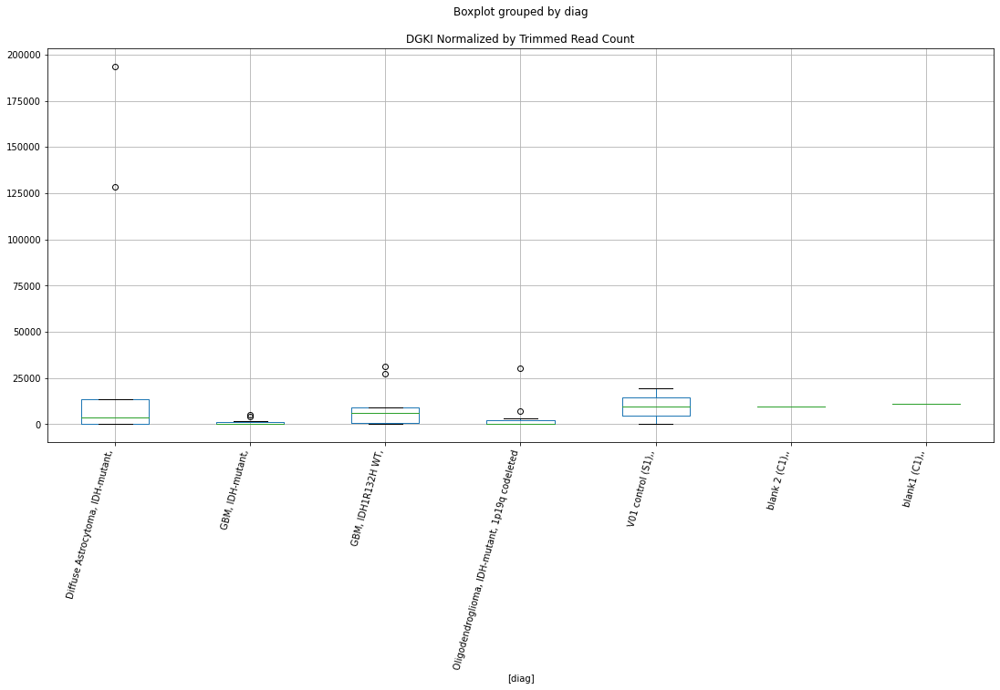

 p : 0.04161662463545902  ( t : 2.193833244593916 ) :  D-plex  :  cutadapt2  :  CHEK1
Control and blanks
76      8333.76
340    14091.71
Name: CHEK1, dtype: float64
208    29628.52
Name: CHEK1, dtype: float64
472    1.58e+06
Name: CHEK1, dtype: float64


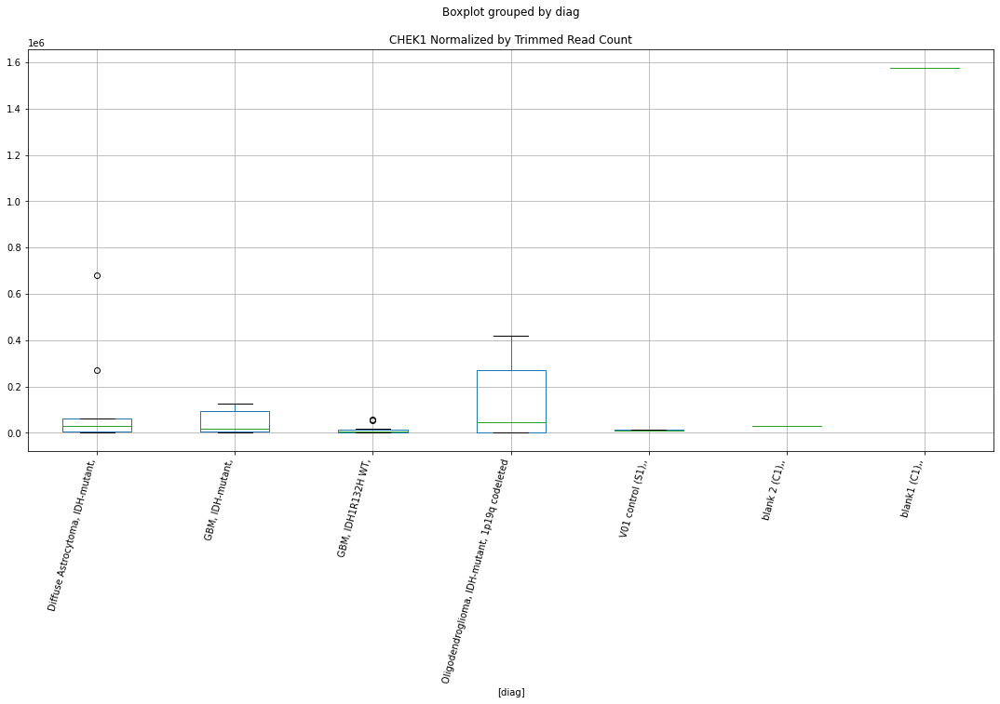

 p : 0.04167942110930022  ( t : 2.1930758012874496 ) :  D-plex  :  cutadapt2  :  CPO
Control and blanks
76     0.0
340    0.0
Name: CPO, dtype: float64
208    1587.24
Name: CPO, dtype: float64
472    2311.82
Name: CPO, dtype: float64


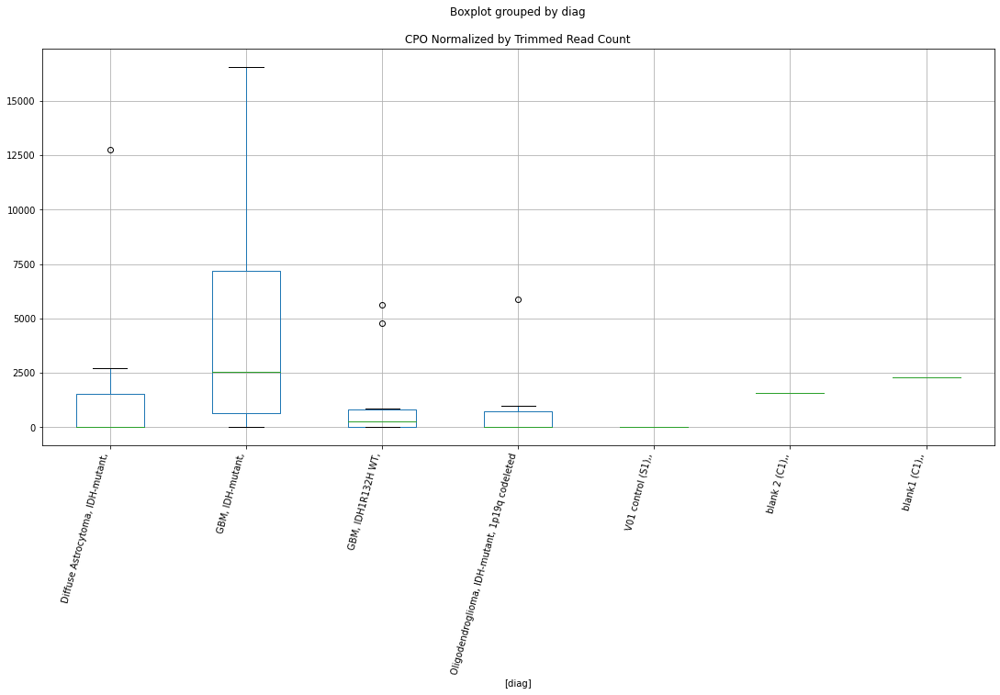

 p : 0.04173005160478644  ( t : 2.192465864764293 ) :  Lexogen  :  cutadapt2  :  BMP2
Control and blanks
82     0.0
346    0.0
Name: BMP2, dtype: float64
214    0.0
Name: BMP2, dtype: float64
478    0.0
Name: BMP2, dtype: float64


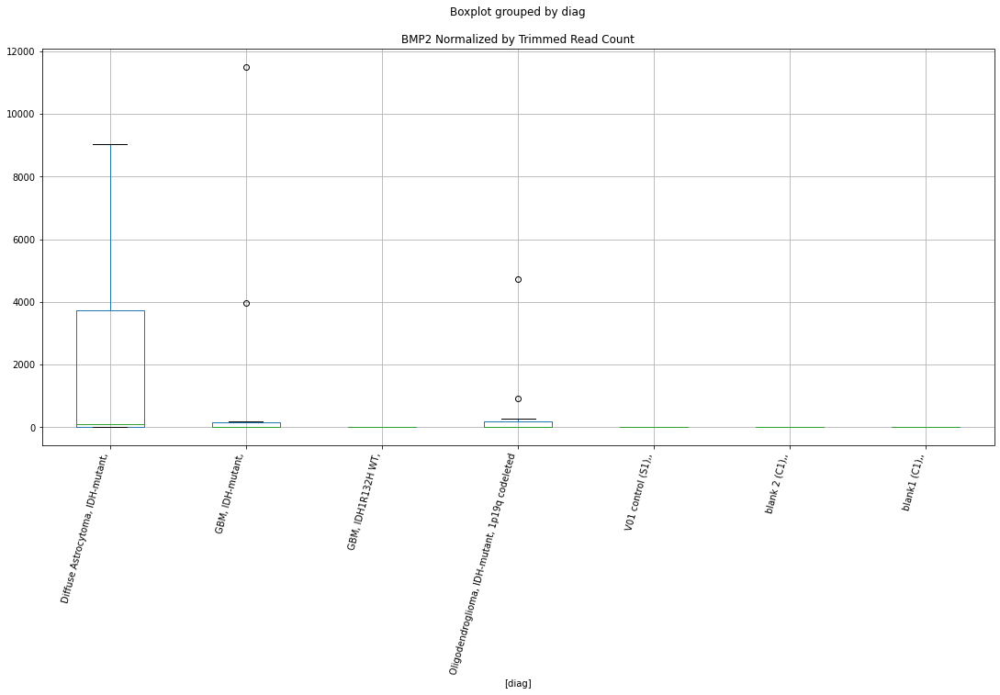

 p : 0.04174215259859333  ( t : 2.192320186815352 ) :  D-plex  :  cutadapt2  :  ATOH1
Control and blanks
76     0.0
340    0.0
Name: ATOH1, dtype: float64
208    0.0
Name: ATOH1, dtype: float64
472    0.0
Name: ATOH1, dtype: float64


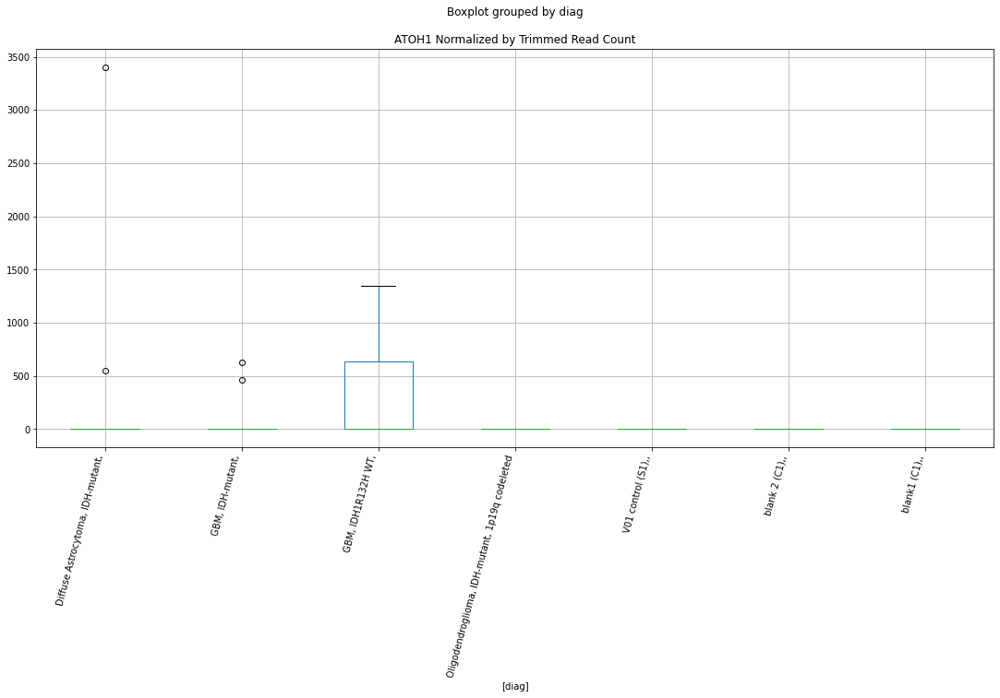

 p : 0.04175306944246888  ( t : 2.19218879751715 ) :  Lexogen  :  bbduk2  :  BMP2
Control and blanks
79     0.0
343    0.0
Name: BMP2, dtype: float64
211    0.0
Name: BMP2, dtype: float64
475    0.0
Name: BMP2, dtype: float64


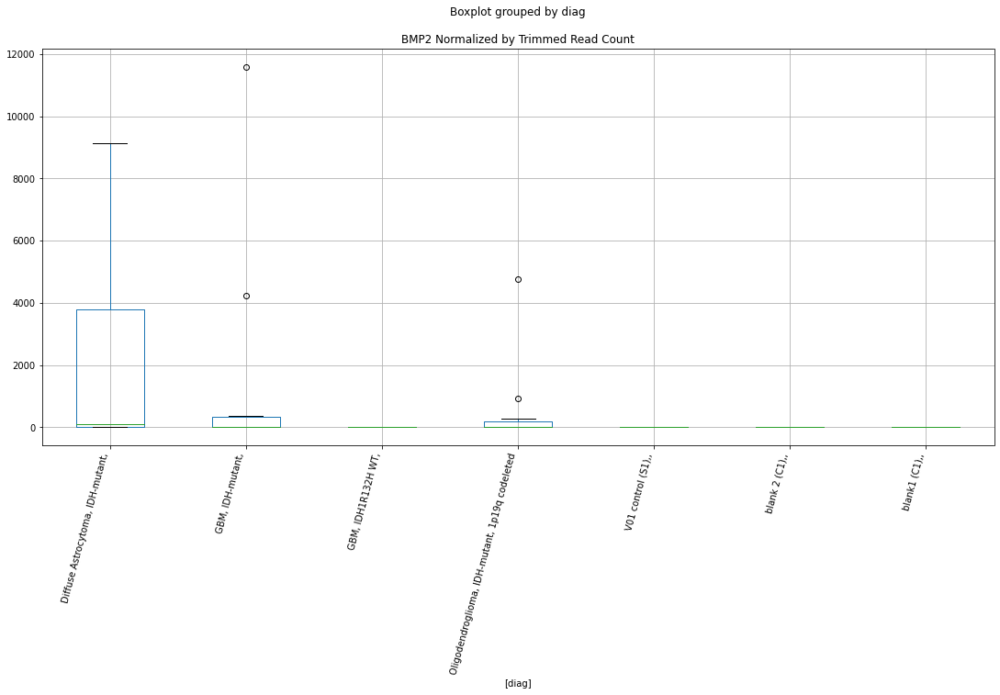

 p : 0.04175388608223207  ( t : 2.192178970144805 ) :  D-plex  :  cutadapt2  :  APOB
Control and blanks
76     0.0
340    0.0
Name: APOB, dtype: float64
208    176.36
Name: APOB, dtype: float64
472    2311.82
Name: APOB, dtype: float64


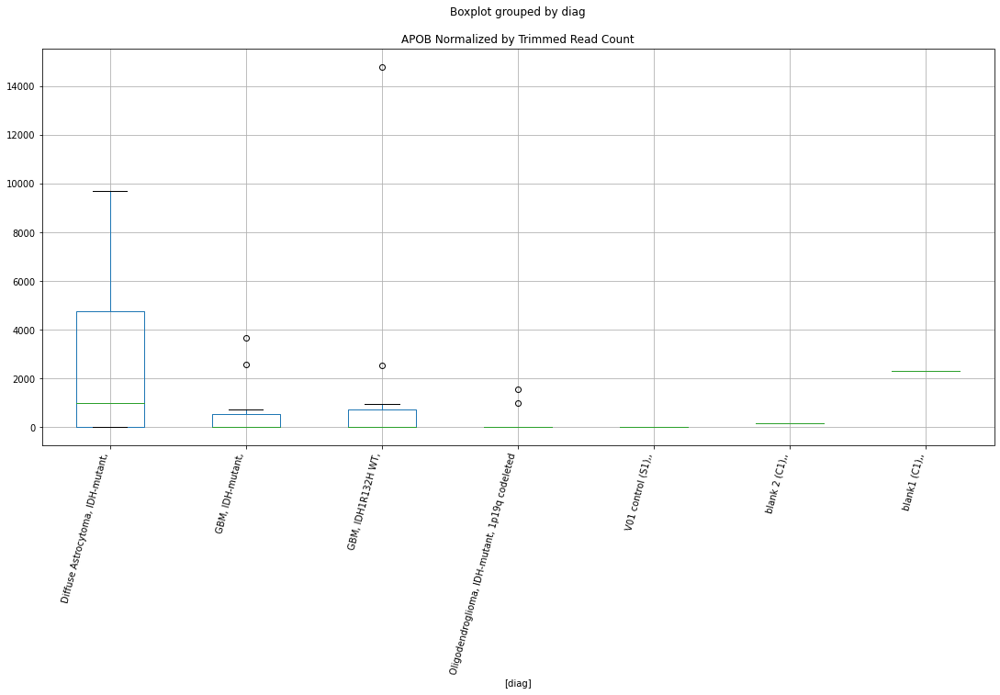

 p : 0.04175977258714669  ( t : 2.192108137670837 ) :  D-plex  :  bbduk2  :  C11orf96
Control and blanks
73     0.0
337    0.0
Name: C11orf96, dtype: float64
205    26505.46
Name: C11orf96, dtype: float64
469    591.53
Name: C11orf96, dtype: float64


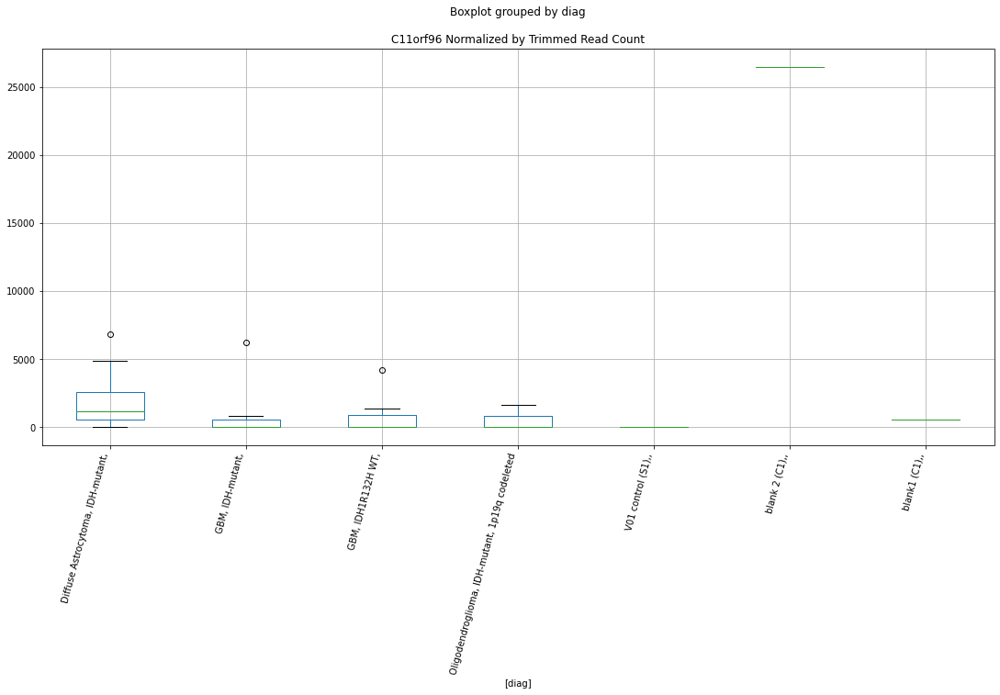

 p : 0.04178457672737817  ( t : 2.1918097693864724 ) :  Lexogen  :  bbduk2  :  ASNS
Control and blanks
79     0.0
343    0.0
Name: ASNS, dtype: float64
211    0.0
Name: ASNS, dtype: float64
475    0.0
Name: ASNS, dtype: float64


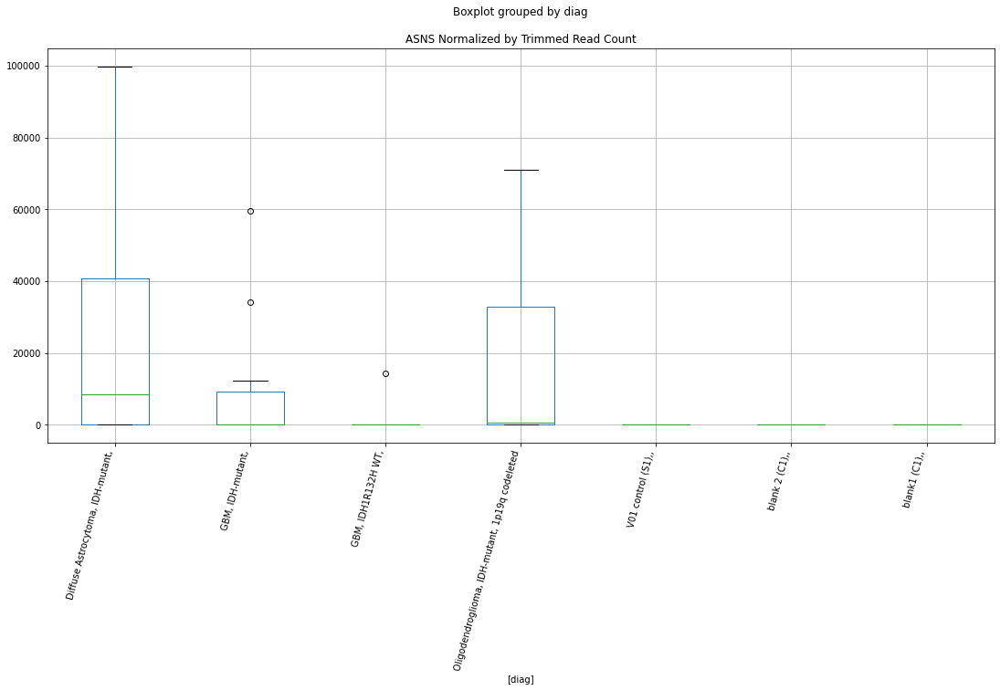

 p : 0.041784576727378224  ( t : 2.191809769386472 ) :  Lexogen  :  bbduk2  :  CZ1P-ASNS
Control and blanks
79     0.0
343    0.0
Name: CZ1P-ASNS, dtype: float64
211    0.0
Name: CZ1P-ASNS, dtype: float64
475    0.0
Name: CZ1P-ASNS, dtype: float64


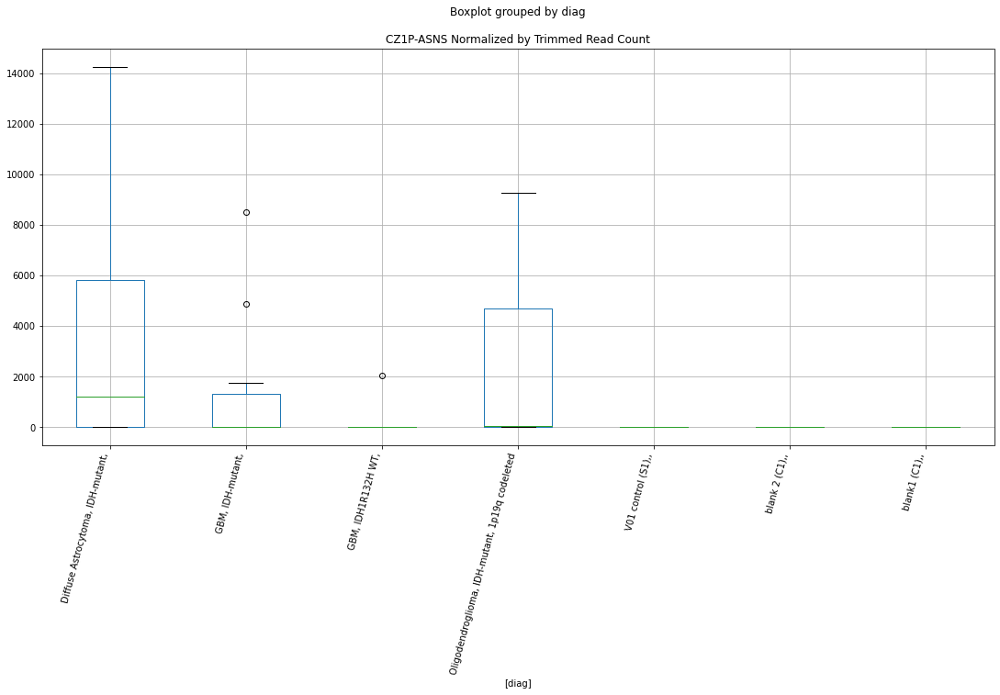

 p : 0.041787095967834684  ( t : 2.1917794746086594 ) :  D-plex  :  bbduk2  :  ADSL
Control and blanks
73     0.0
337    0.0
Name: ADSL, dtype: float64
205    5014.55
Name: ADSL, dtype: float64
469    0.0
Name: ADSL, dtype: float64


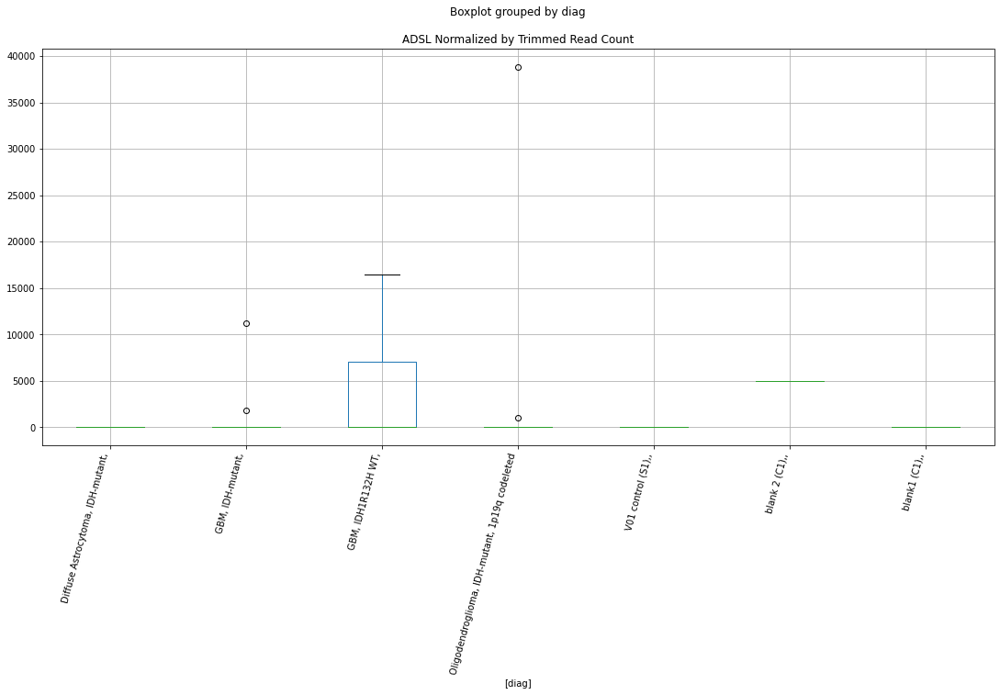

 p : 0.04182669186021713  ( t : 2.191303539728079 ) :  D-plex  :  cutadapt2  :  DKK1
Control and blanks
76     0.0
340    0.0
Name: DKK1, dtype: float64
208    529.08
Name: DKK1, dtype: float64
472    0.0
Name: DKK1, dtype: float64


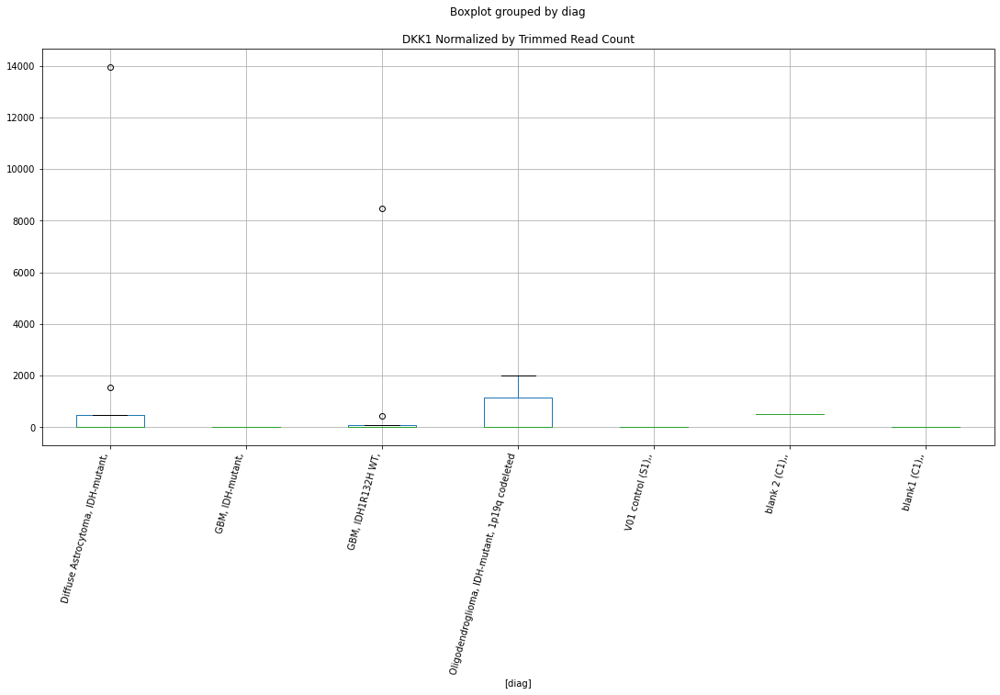

 p : 0.04190250863994822  ( t : 2.1903933893826957 ) :  D-plex  :  cutadapt2  :  CASD1
Control and blanks
76     0.0
340    0.0
Name: CASD1, dtype: float64
208    2116.32
Name: CASD1, dtype: float64
472    0.0
Name: CASD1, dtype: float64


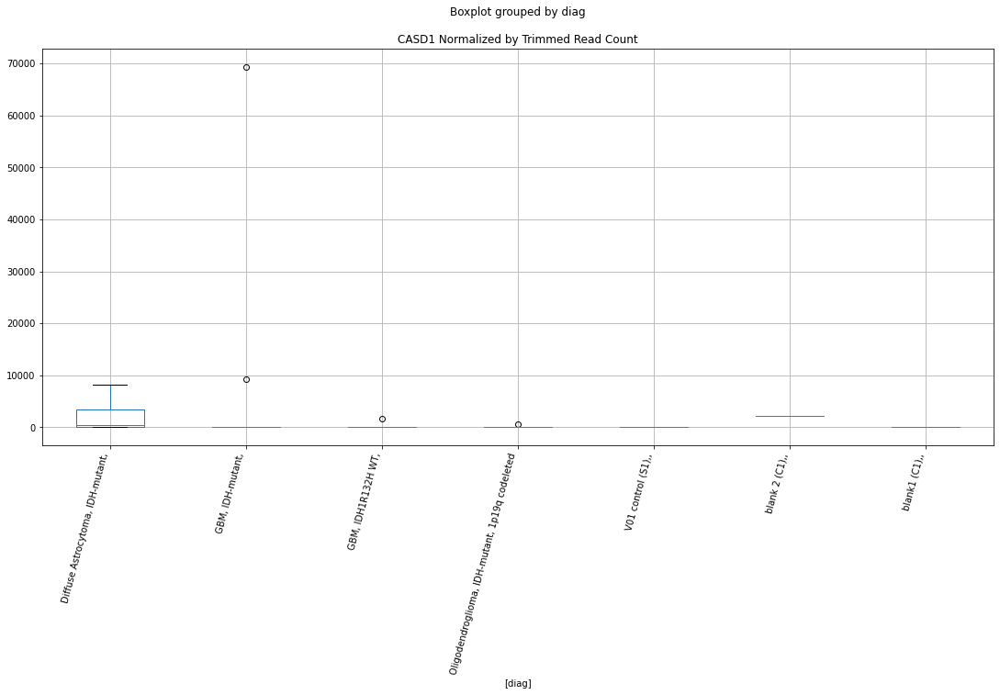

 p : 0.04193790194400502  ( t : 2.1899690240268344 ) :  Lexogen  :  bbduk2  :  ARAF
Control and blanks
79     0.0
343    0.0
Name: ARAF, dtype: float64
211    0.0
Name: ARAF, dtype: float64
475    0.0
Name: ARAF, dtype: float64


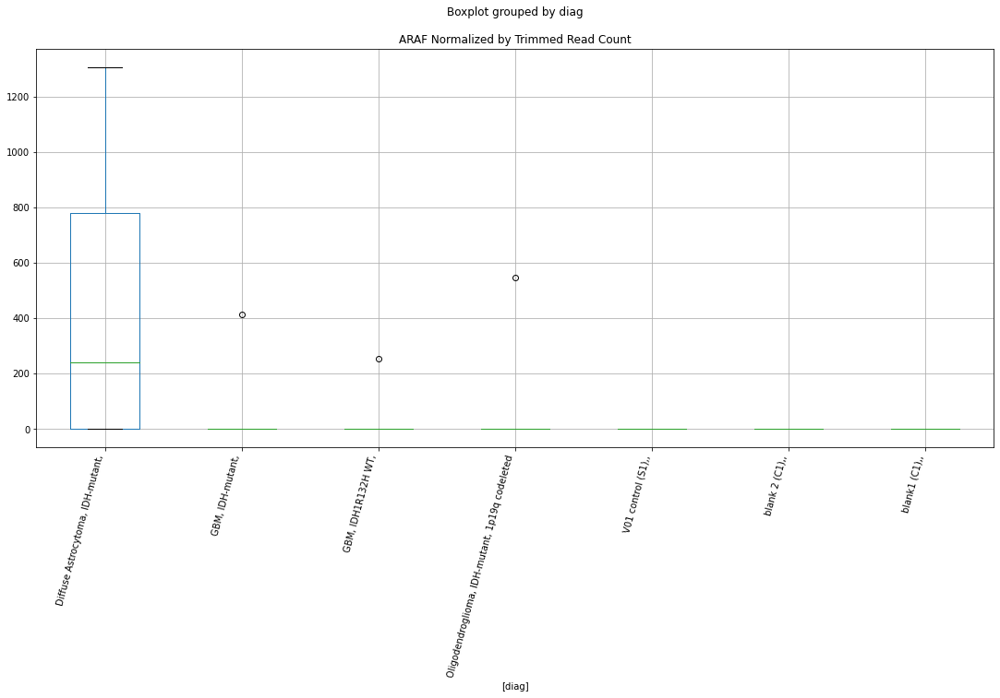

 p : 0.041948100166952294  ( t : 2.1898468084169846 ) :  D-plex  :  cutadapt2  :  CDC42
Control and blanks
76     0.0
340    0.0
Name: CDC42, dtype: float64
208    1234.52
Name: CDC42, dtype: float64
472    2311.82
Name: CDC42, dtype: float64


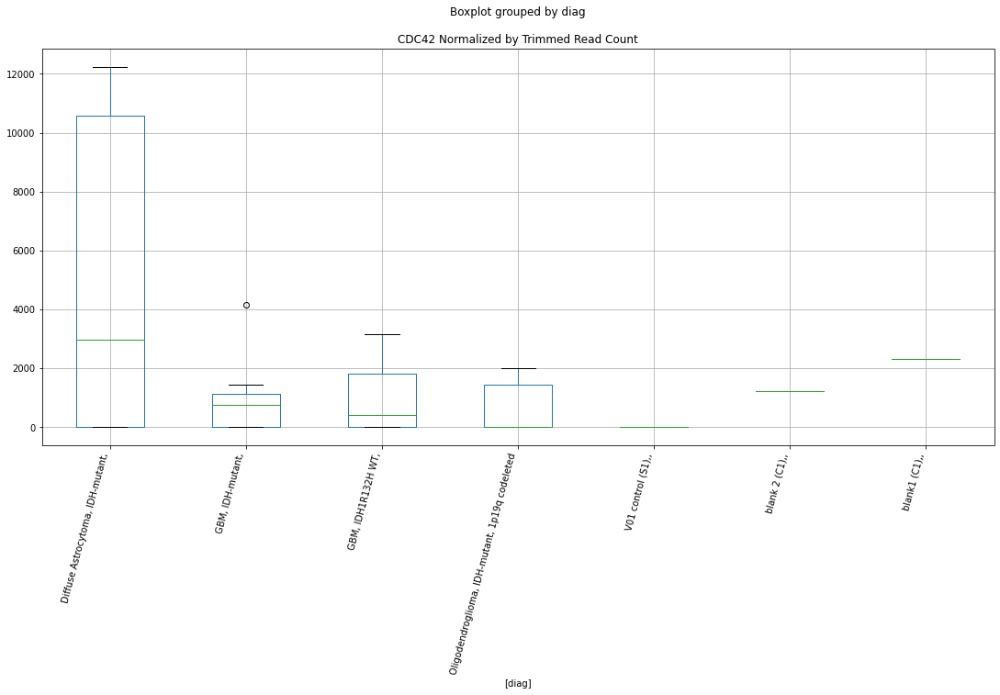

 p : 0.04200354488699539  ( t : 2.189182834898057 ) :  D-plex  :  cutadapt2  :  ARL17B
Control and blanks
76     0.0
340    0.0
Name: ARL17B, dtype: float64
208    0.0
Name: ARL17B, dtype: float64
472    577.96
Name: ARL17B, dtype: float64


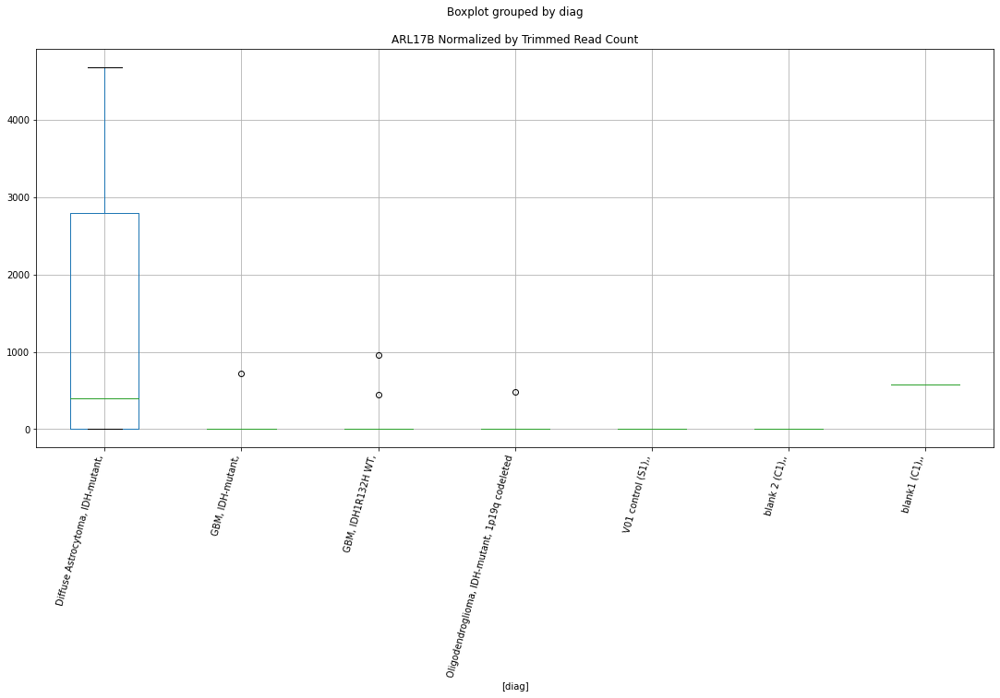

 p : 0.04201256749406796  ( t : 2.1890748615133946 ) :  D-plex  :  bbduk2  :  DLEU2
Control and blanks
73     0.0
337    0.0
Name: DLEU2, dtype: float64
205    3402.73
Name: DLEU2, dtype: float64
469    1183.05
Name: DLEU2, dtype: float64


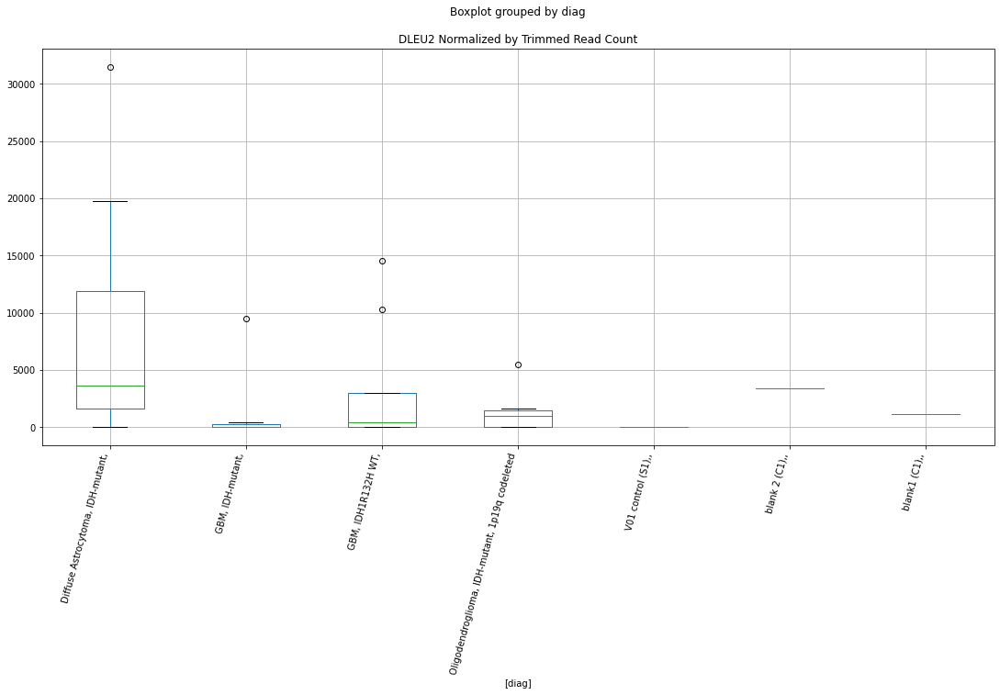

 p : 0.042079221942655454  ( t : 2.1882778672625927 ) :  D-plex  :  bbduk2  :  DKK1
Control and blanks
73     0.0
337    0.0
Name: DKK1, dtype: float64
205    537.27
Name: DKK1, dtype: float64
469    0.0
Name: DKK1, dtype: float64


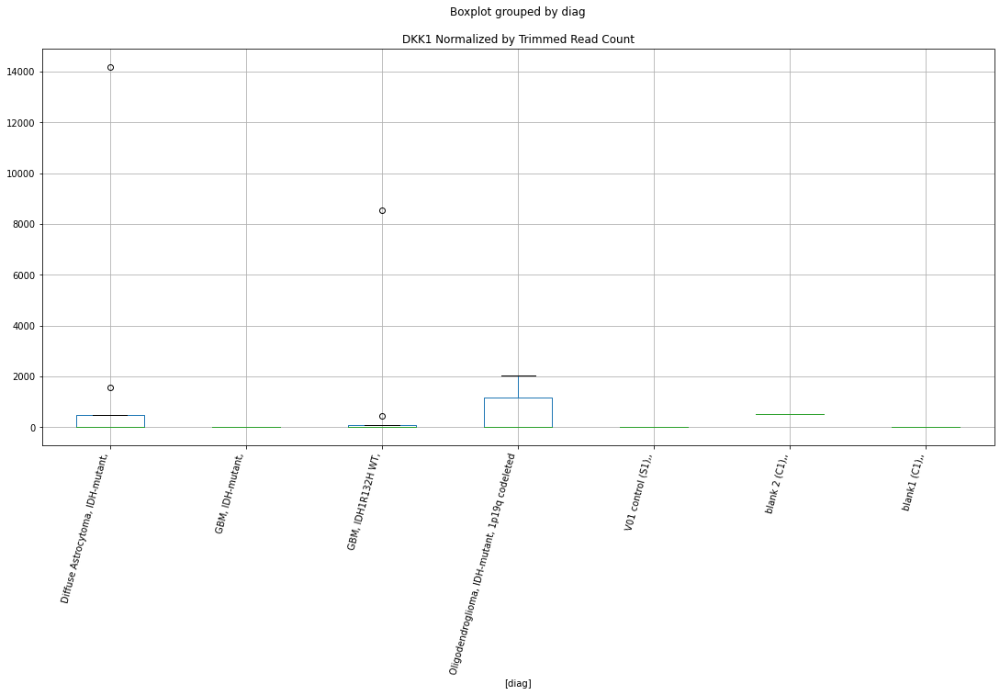

 p : 0.04211223467041363  ( t : 2.187883559342834 ) :  D-plex  :  bbduk2  :  AGAP1-IT1
Control and blanks
73     0.0
337    0.0
Name: AGAP1-IT1, dtype: float64
205    358.18
Name: AGAP1-IT1, dtype: float64
469    591.53
Name: AGAP1-IT1, dtype: float64


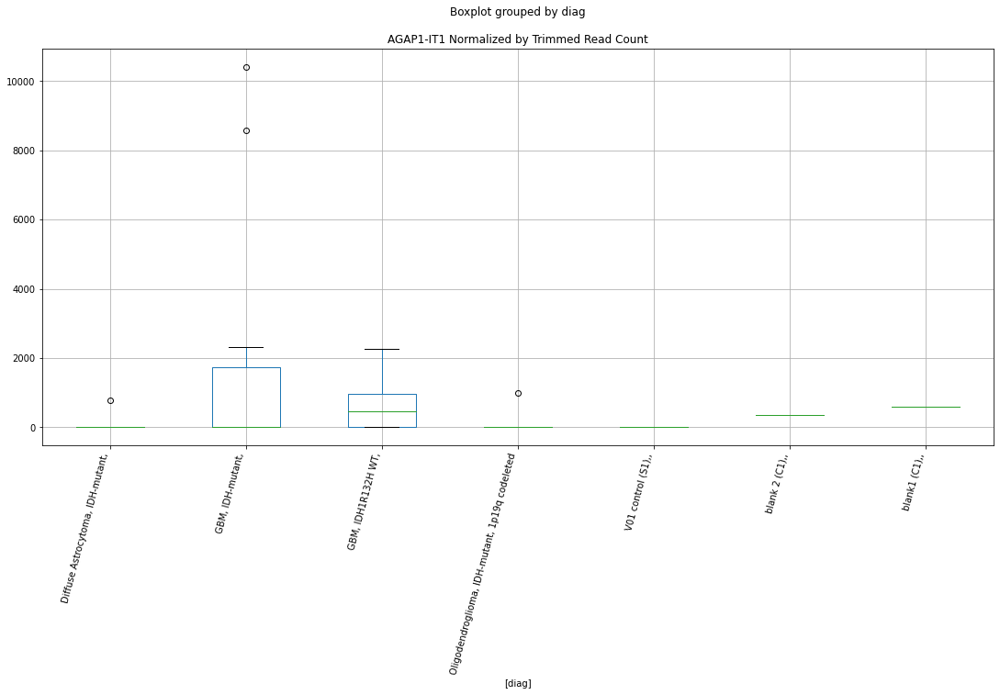

 p : 0.042139850792510425  ( t : 2.1875539268585436 ) :  D-plex  :  bbduk2  :  CCDC88C
Control and blanks
73     4638.05
337    6231.10
Name: CCDC88C, dtype: float64
205    5193.64
Name: CCDC88C, dtype: float64
469    0.0
Name: CCDC88C, dtype: float64


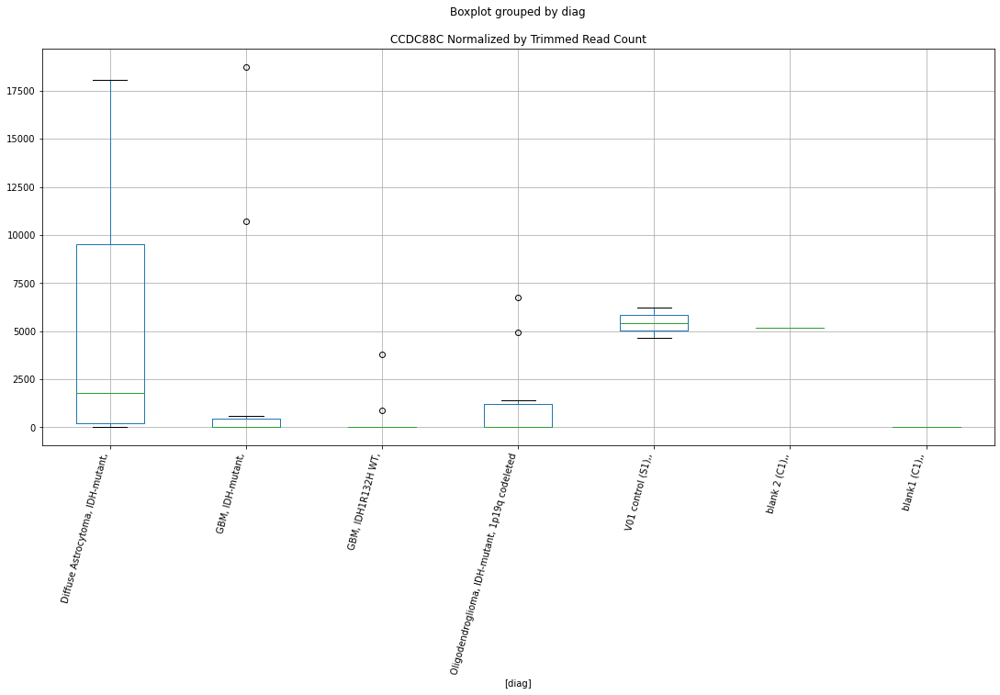

 p : 0.042143131955562976  ( t : 2.187514775300687 ) :  D-plex  :  bbduk2  :  CPO
Control and blanks
73       0.00
337    890.16
Name: CPO, dtype: float64
205    1253.64
Name: CPO, dtype: float64
469    2366.11
Name: CPO, dtype: float64


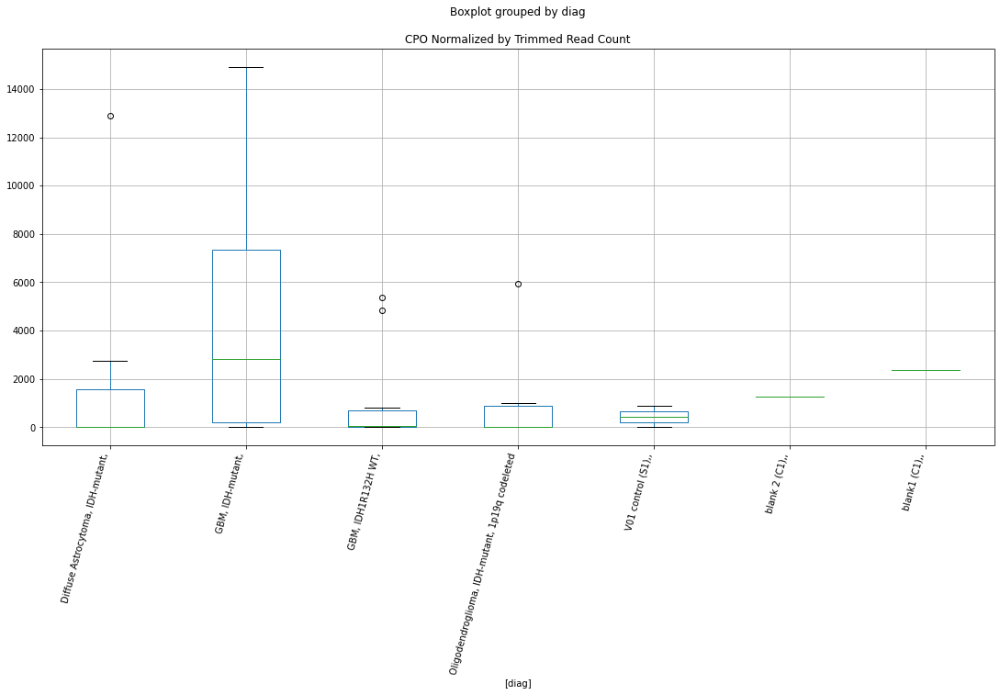

 p : 0.042163329547297165  ( t : 2.1872738347613625 ) :  Lexogen  :  cutadapt2  :  CTSG
Control and blanks
82        0.00
346    2525.21
Name: CTSG, dtype: float64
214    0.0
Name: CTSG, dtype: float64
478    0.0
Name: CTSG, dtype: float64


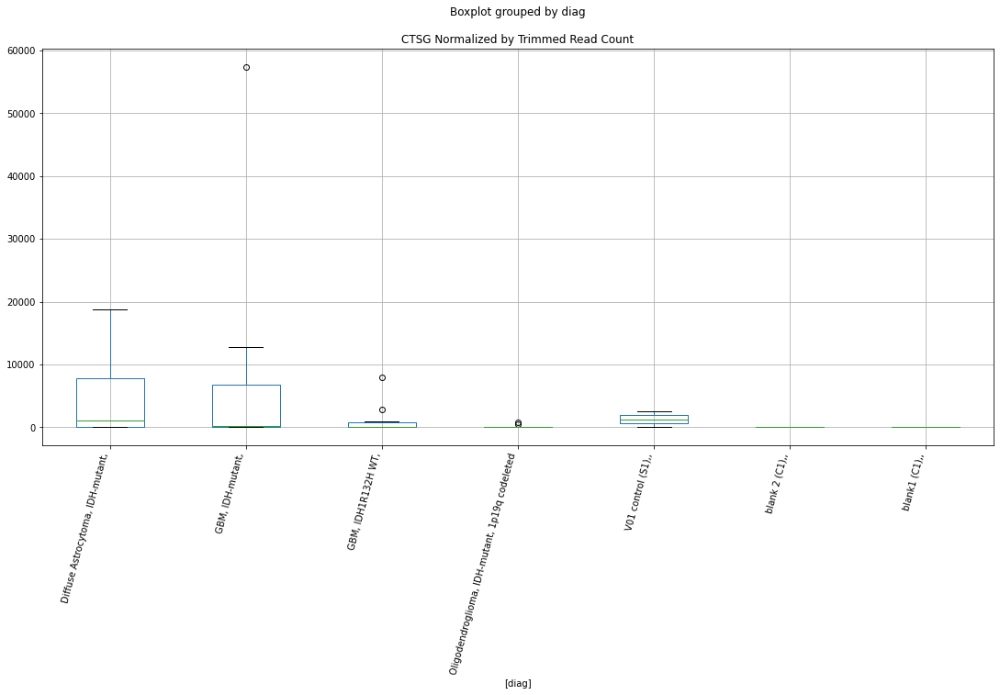

 p : 0.042169073708949595  ( t : 2.187205331005977 ) :  D-plex  :  cutadapt2  :  DLEU2
Control and blanks
76     0.0
340    0.0
Name: DLEU2, dtype: float64
208    3350.84
Name: DLEU2, dtype: float64
472    1155.91
Name: DLEU2, dtype: float64


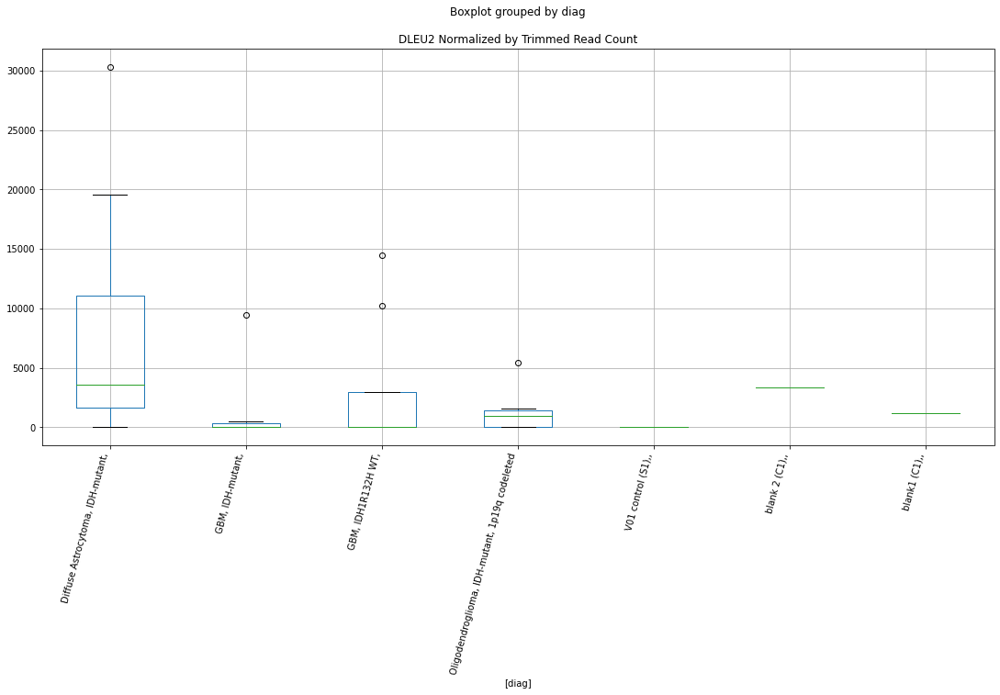

 p : 0.04218531828873544  ( t : 2.18701164762235 ) :  D-plex  :  cutadapt2  :  DEF8
Control and blanks
76     21213.2
340        0.0
Name: DEF8, dtype: float64
208    16401.5
Name: DEF8, dtype: float64
472    62997.19
Name: DEF8, dtype: float64


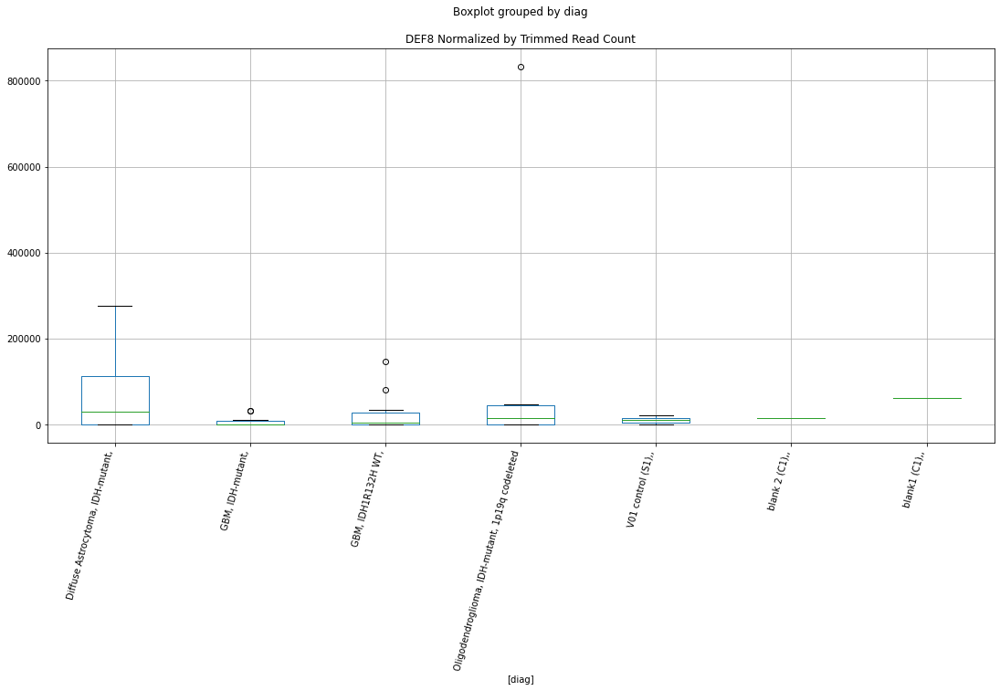

 p : 0.04219785175521426  ( t : 2.186862258418383 ) :  Lexogen  :  bbduk2  :  BRIP1
Control and blanks
79     0.0
343    0.0
Name: BRIP1, dtype: float64
211    0.0
Name: BRIP1, dtype: float64
475    0.0
Name: BRIP1, dtype: float64


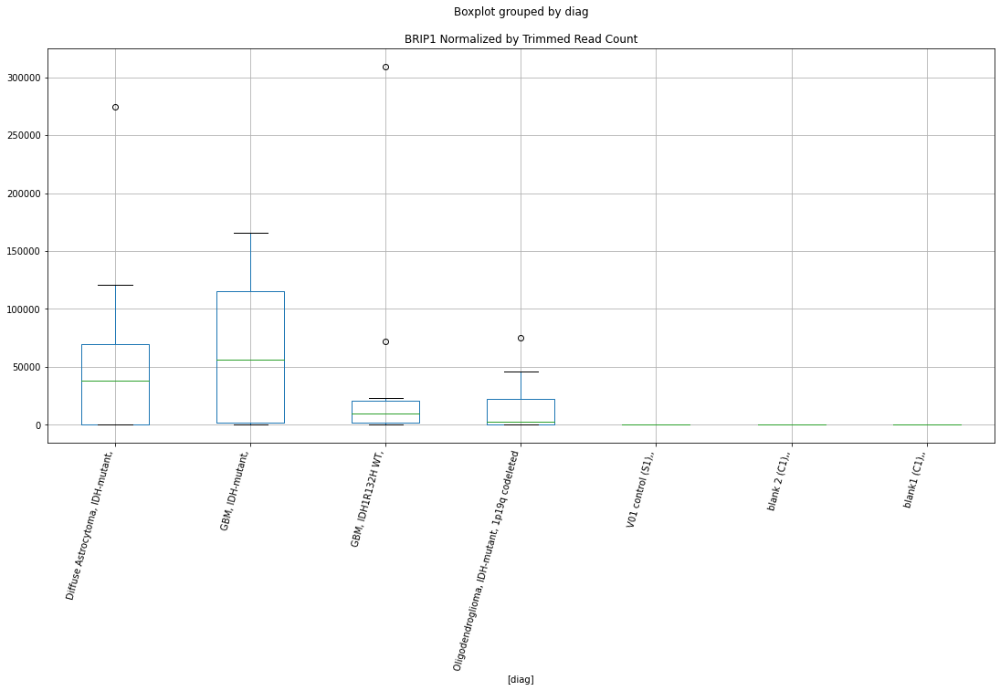

 p : 0.04221673111654362  ( t : 2.186637307869909 ) :  D-plex  :  cutadapt2  :  CNIH3
Control and blanks
76     0.0
340    0.0
Name: CNIH3, dtype: float64
208    2645.4
Name: CNIH3, dtype: float64
472    0.0
Name: CNIH3, dtype: float64


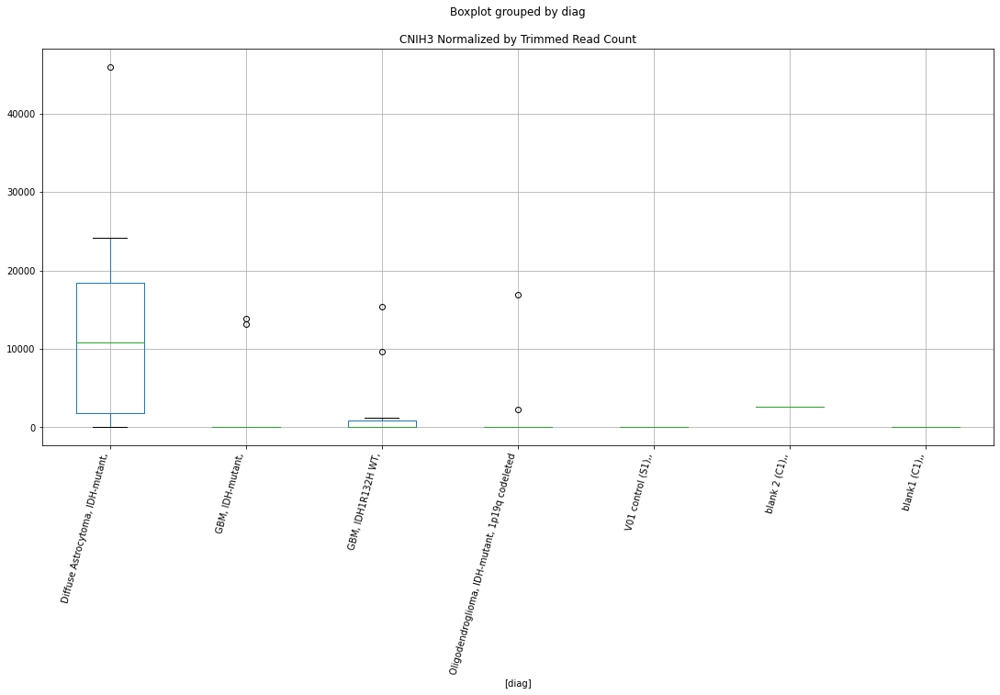

 p : 0.042227238612368524  ( t : 2.186512149373024 ) :  Lexogen  :  bbduk2  :  AAMP
Control and blanks
79       0.00
343    636.94
Name: AAMP, dtype: float64
211    0.0
Name: AAMP, dtype: float64
475    0.0
Name: AAMP, dtype: float64


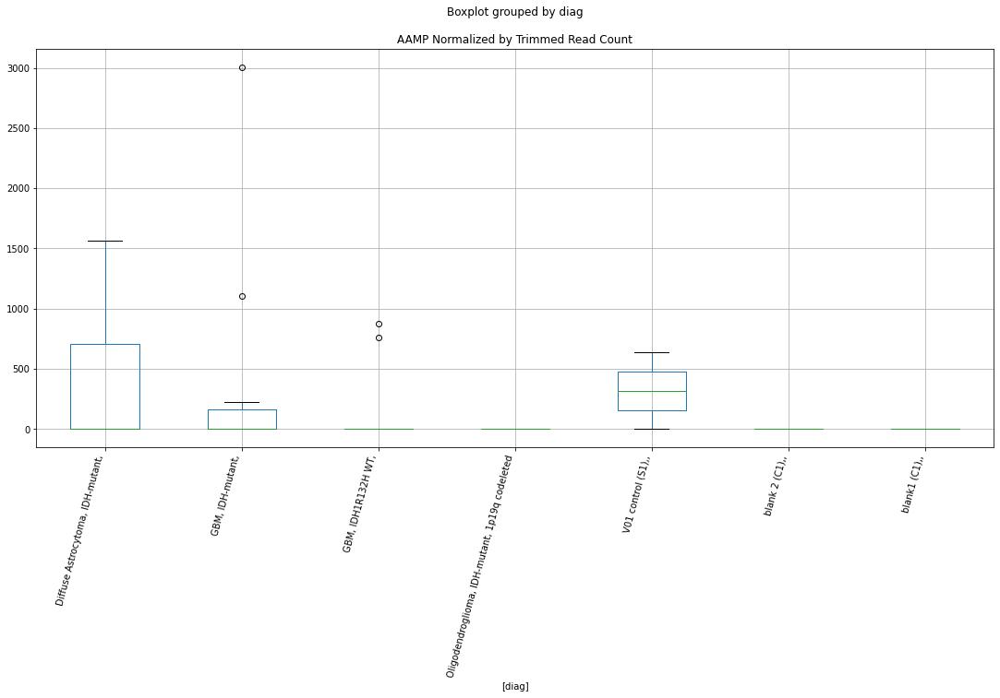

 p : 0.04226180149022531  ( t : 2.186100660121706 ) :  D-plex  :  bbduk2  :  CDS1
Control and blanks
73     0.0
337    0.0
Name: CDS1, dtype: float64
205    3223.64
Name: CDS1, dtype: float64
469    0.0
Name: CDS1, dtype: float64


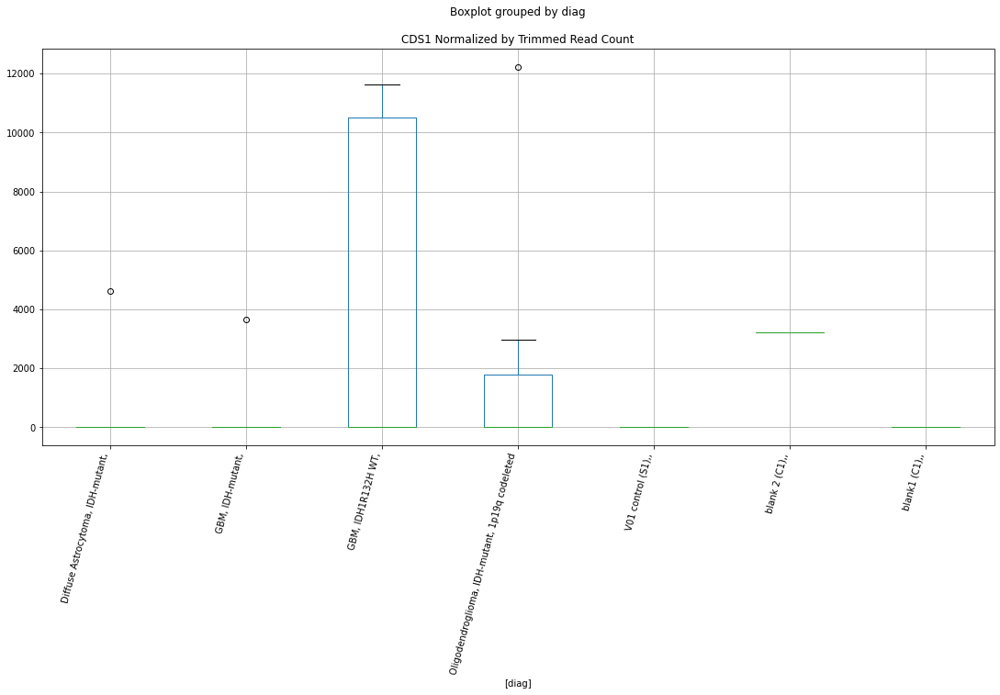

 p : 0.04233294573084422  ( t : 2.185254621065485 ) :  D-plex  :  bbduk2  :  COL5A2
Control and blanks
73     0.0
337    0.0
Name: COL5A2, dtype: float64
205    358.18
Name: COL5A2, dtype: float64
469    0.0
Name: COL5A2, dtype: float64


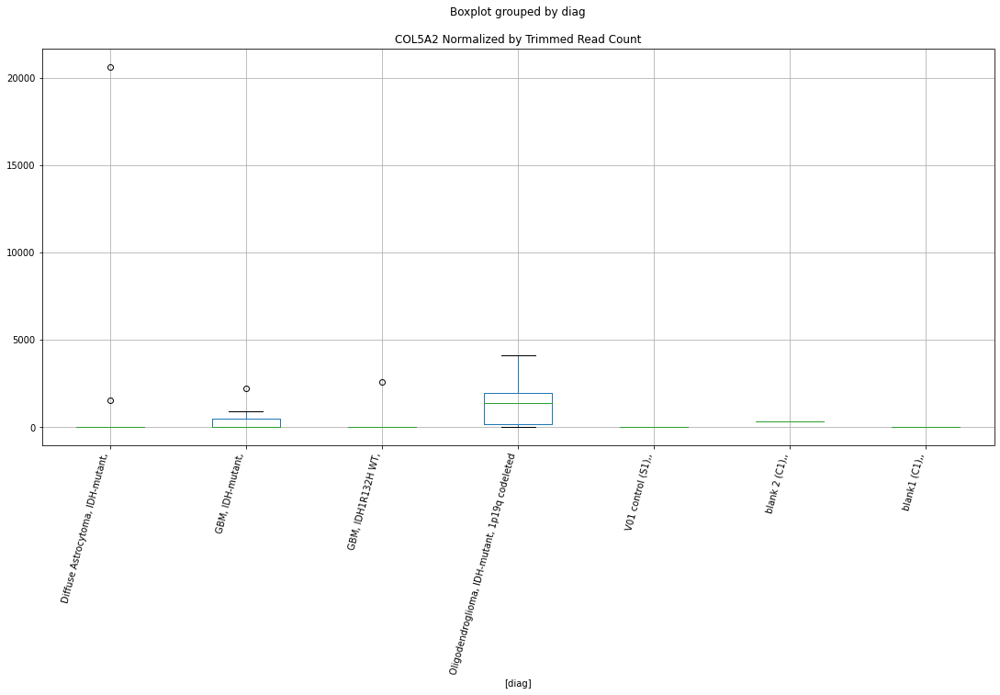

 p : 0.042353065047398636  ( t : 2.1850156009954493 ) :  D-plex  :  bbduk2  :  ARID5B
Control and blanks
73      773.01
337    8011.42
Name: ARID5B, dtype: float64
205    5730.91
Name: ARID5B, dtype: float64
469    2957.64
Name: ARID5B, dtype: float64


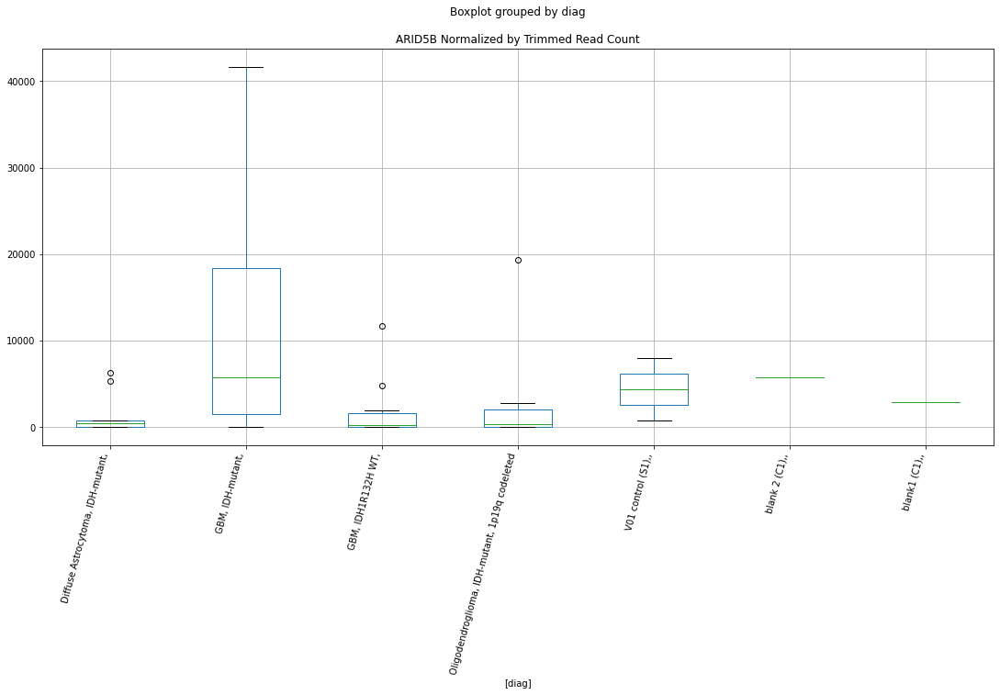

 p : 0.04242104057684639  ( t : 2.184208812384871 ) :  Lexogen  :  bbduk2  :  CIT
Control and blanks
79        0.00
343    6369.43
Name: CIT, dtype: float64
211    20497.98
Name: CIT, dtype: float64
475    0.0
Name: CIT, dtype: float64


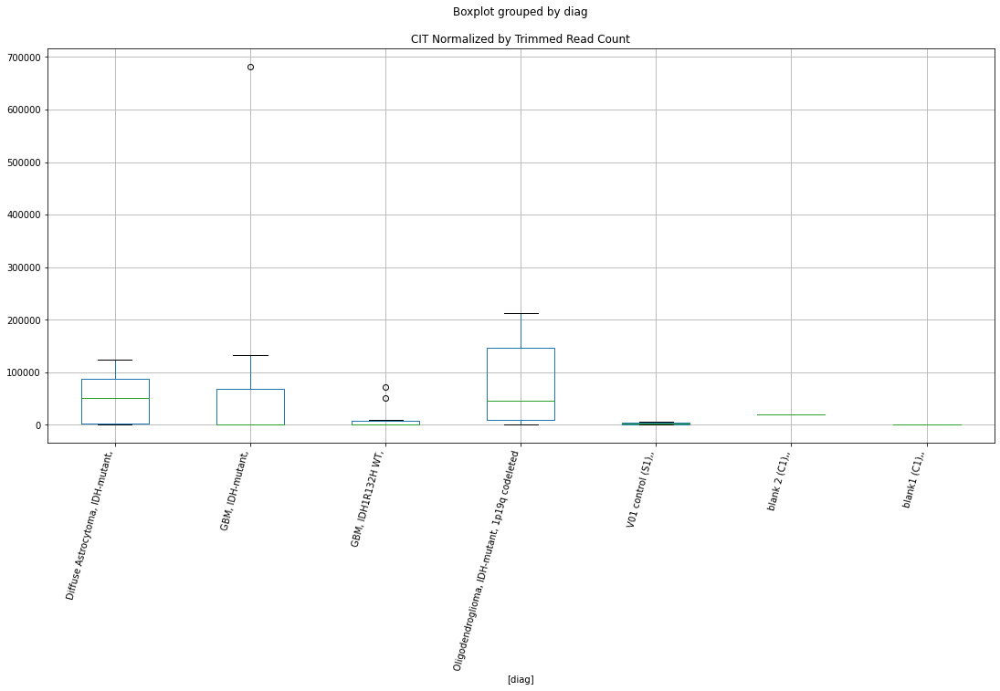

 p : 0.04243749635829349  ( t : 2.184013680080857 ) :  D-plex  :  bbduk2  :  DKFZP434H168
Control and blanks
73     0.0
337    0.0
Name: DKFZP434H168, dtype: float64
205    1970.0
Name: DKFZP434H168, dtype: float64
469    2957.64
Name: DKFZP434H168, dtype: float64


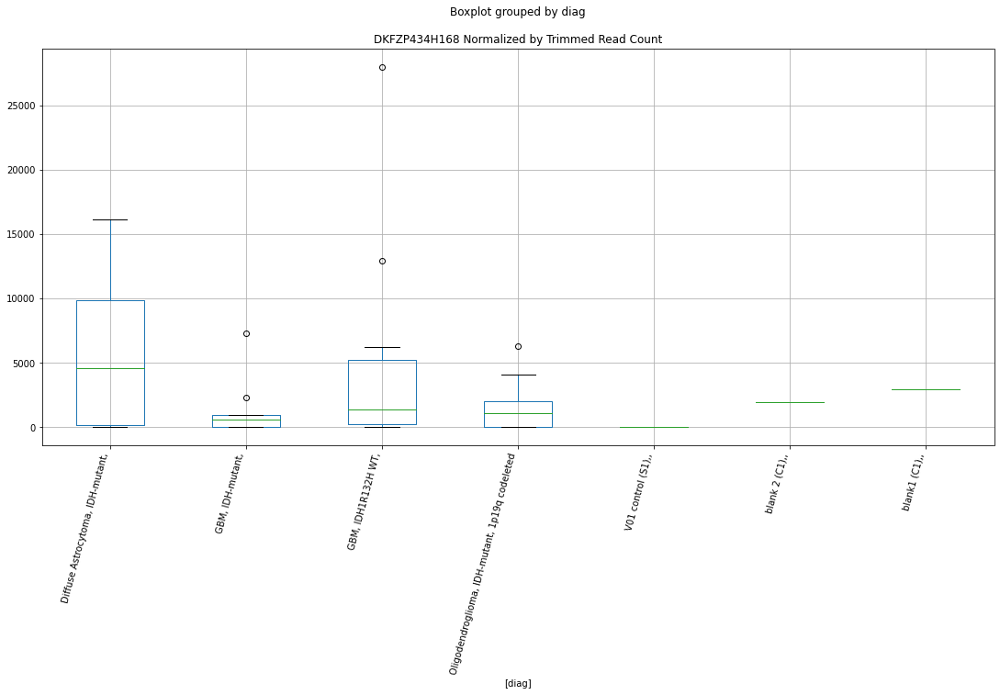

 p : 0.04248803579494274  ( t : 2.183414817964355 ) :  D-plex  :  cutadapt2  :  COX4I1
Control and blanks
76     757.61
340      0.00
Name: COX4I1, dtype: float64
208    881.8
Name: COX4I1, dtype: float64
472    5201.6
Name: COX4I1, dtype: float64


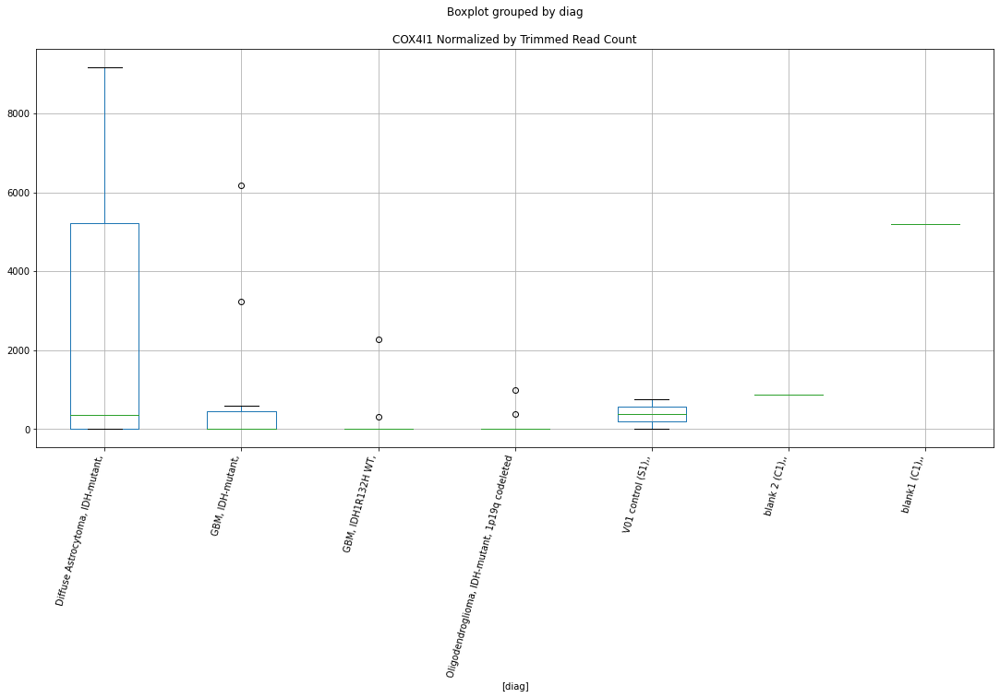

 p : 0.042508099724757574  ( t : 2.18317725348623 ) :  D-plex  :  bbduk2  :  DENND4B
Control and blanks
73     0.0
337    0.0
Name: DENND4B, dtype: float64
205    1253.64
Name: DENND4B, dtype: float64
469    4732.22
Name: DENND4B, dtype: float64


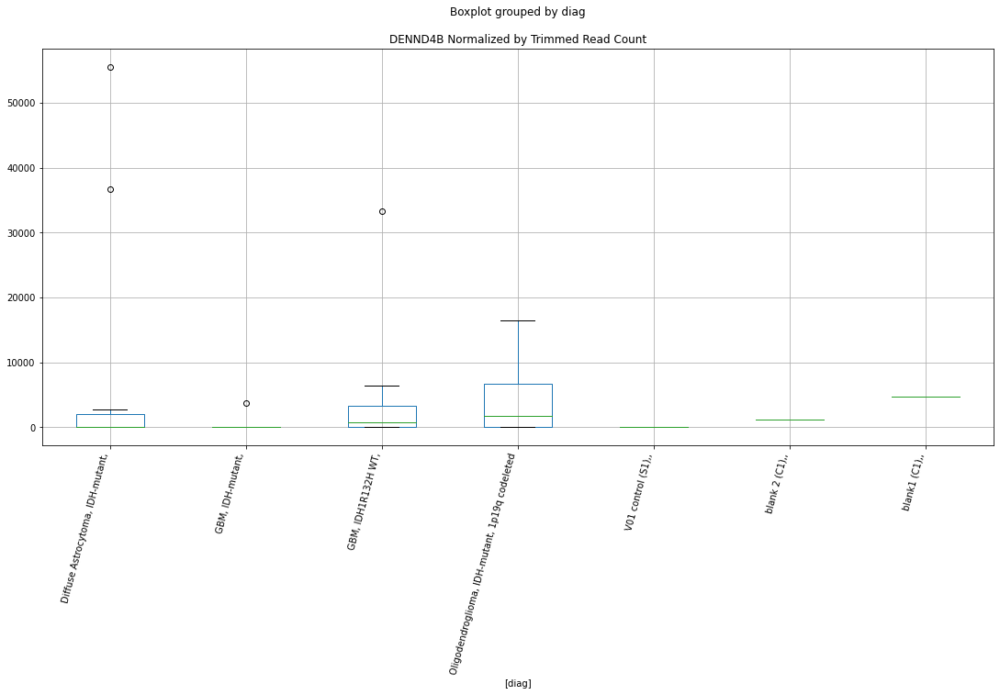

 p : 0.04254050165859044  ( t : 2.182793819382987 ) :  D-plex  :  cutadapt2  :  CPSF1
Control and blanks
76     0.0
340    0.0
Name: CPSF1, dtype: float64
208    4409.01
Name: CPSF1, dtype: float64
472    0.0
Name: CPSF1, dtype: float64


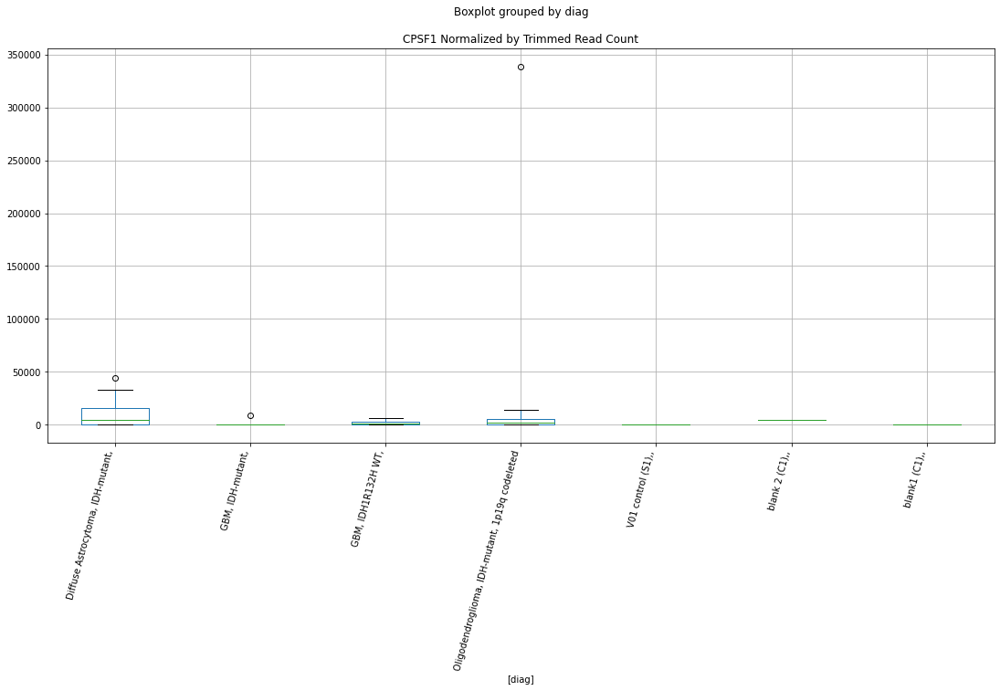

 p : 0.042634914296651664  ( t : 2.181678095220207 ) :  D-plex  :  bbduk2  :  ASB4
Control and blanks
73     0.0
337    0.0
Name: ASB4, dtype: float64
205    3402.73
Name: ASB4, dtype: float64
469    591.53
Name: ASB4, dtype: float64


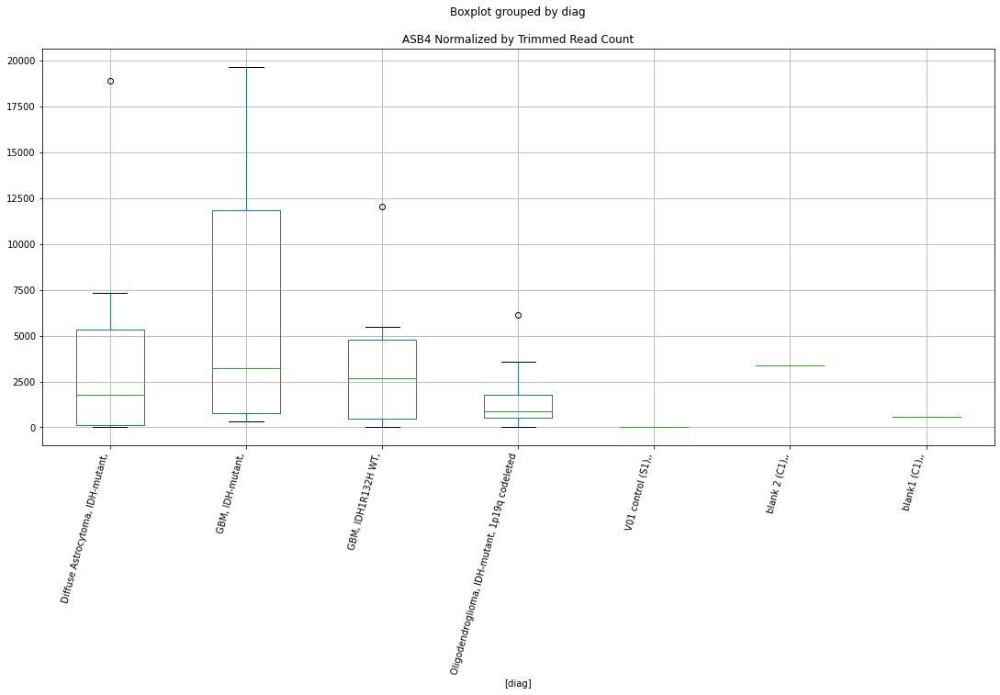

 p : 0.04263929994663764  ( t : 2.1816263227394184 ) :  D-plex  :  cutadapt2  :  CLEC3B
Control and blanks
76     0.0
340    0.0
Name: CLEC3B, dtype: float64
208    881.8
Name: CLEC3B, dtype: float64
472    0.0
Name: CLEC3B, dtype: float64


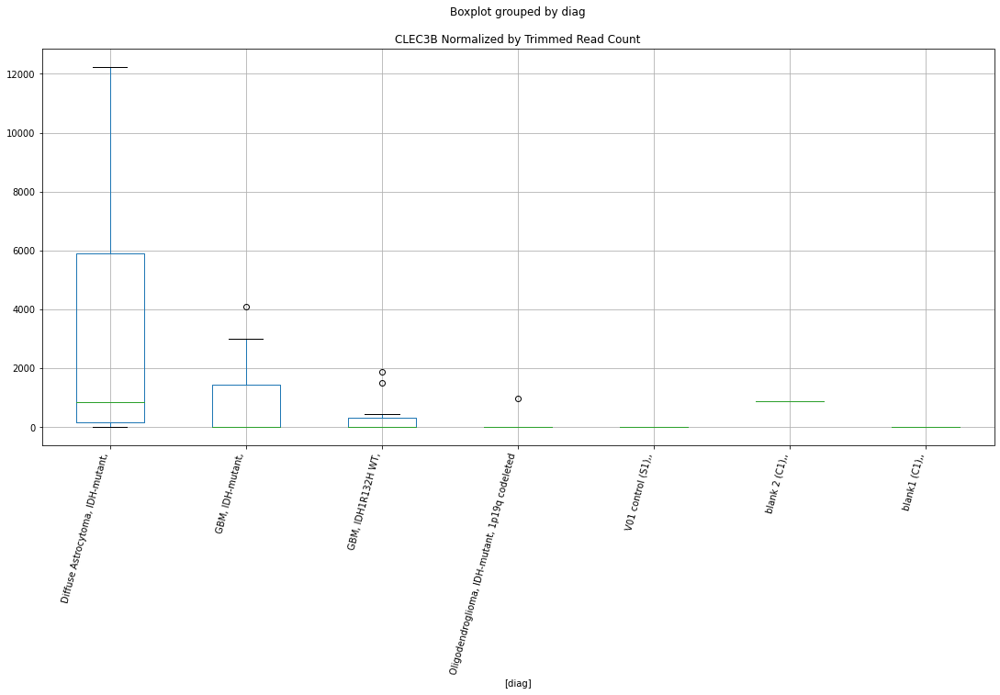

 p : 0.042701496280894084  ( t : 2.180892621685113 ) :  D-plex  :  cutadapt2  :  ACOX2
Control and blanks
76     78791.88
340        0.00
Name: ACOX2, dtype: float64
208    38093.81
Name: ACOX2, dtype: float64
472    69354.7
Name: ACOX2, dtype: float64


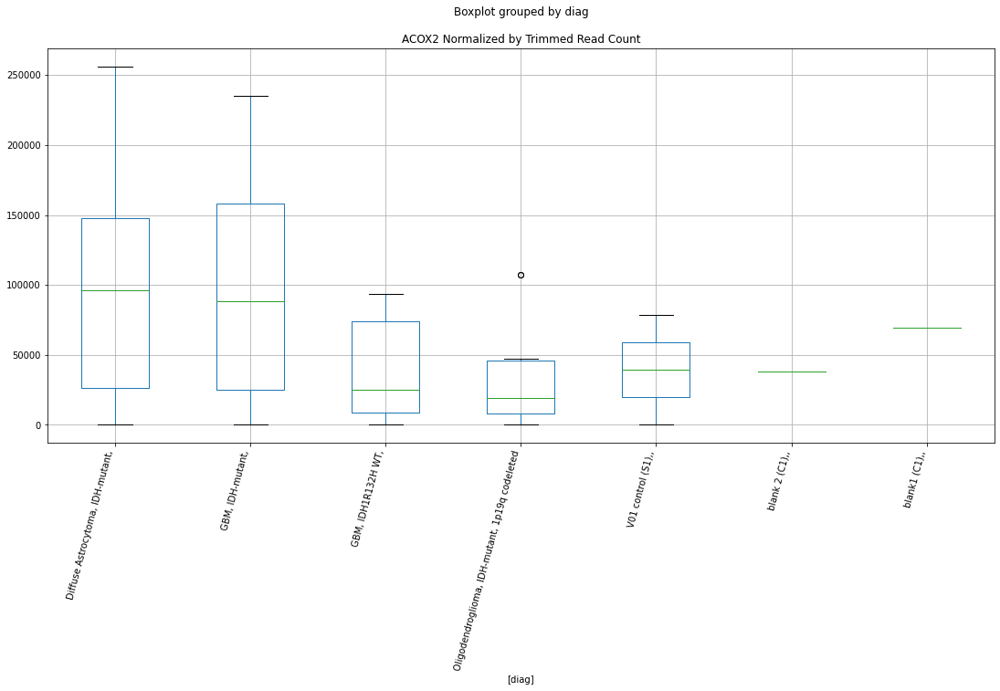

 p : 0.0427263563776725  ( t : 2.1805996327471644 ) :  D-plex  :  cutadapt2  :  CAV1
Control and blanks
76     0.0
340    0.0
Name: CAV1, dtype: float64
208    4232.65
Name: CAV1, dtype: float64
472    6935.47
Name: CAV1, dtype: float64


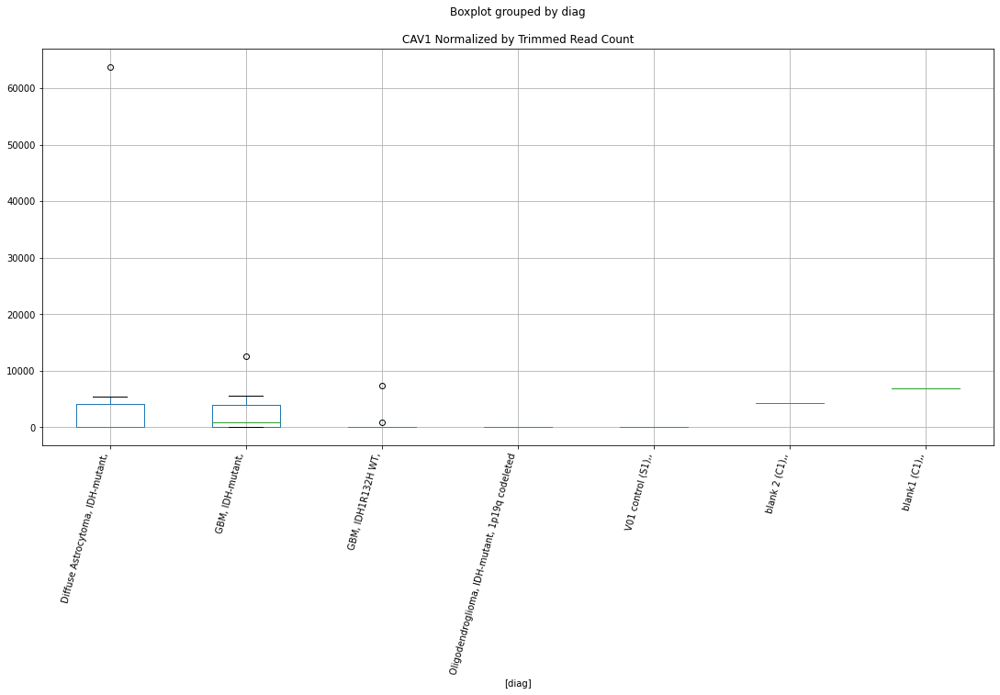

 p : 0.04277562560528053  ( t : 2.1800194311493546 ) :  Lexogen  :  cutadapt2  :  ATP10A
Control and blanks
82     0.0
346    0.0
Name: ATP10A, dtype: float64
214    6509.43
Name: ATP10A, dtype: float64
478    1899.68
Name: ATP10A, dtype: float64


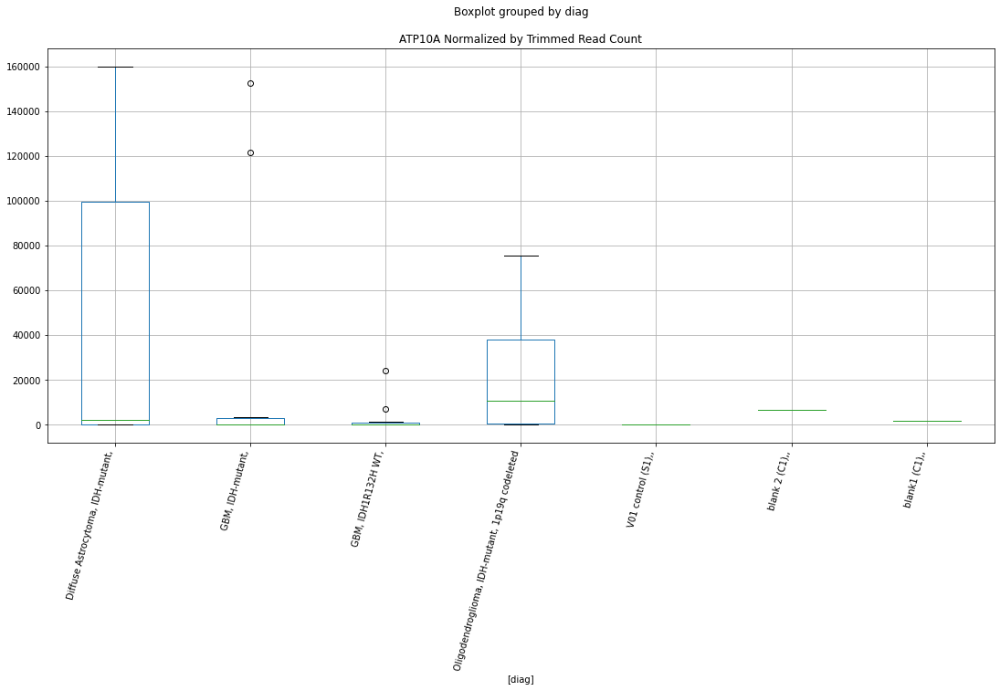

 p : 0.0429263832384503  ( t : 2.178247883922408 ) :  D-plex  :  bbduk2  :  ASB6
Control and blanks
73     0.0
337    0.0
Name: ASB6, dtype: float64
205    1611.82
Name: ASB6, dtype: float64
469    1774.58
Name: ASB6, dtype: float64


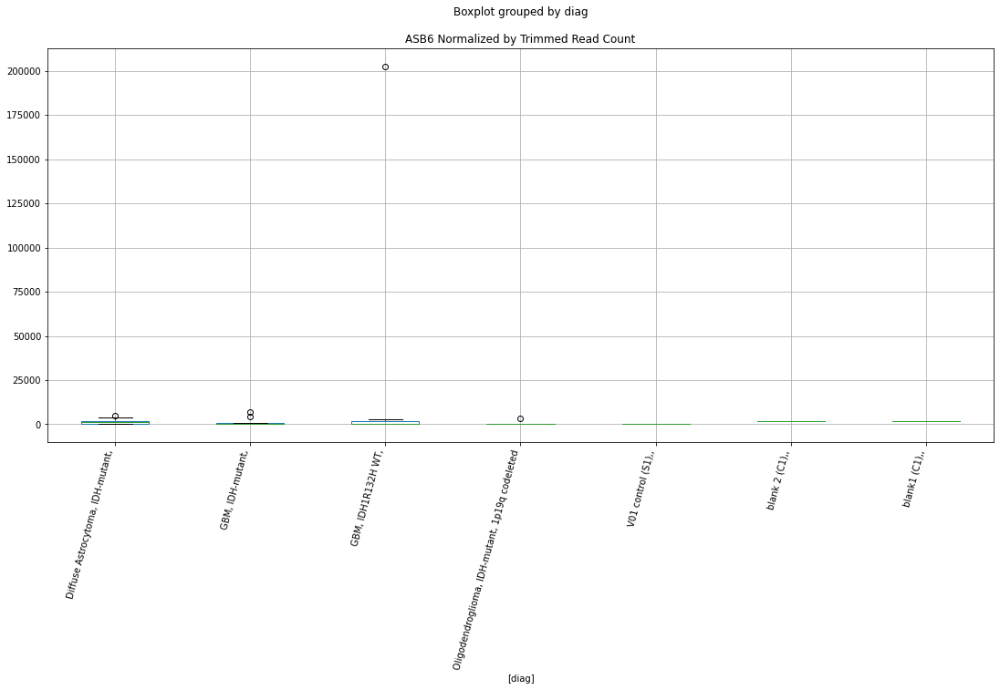

 p : 0.04300685815276878  ( t : 2.177304559039308 ) :  D-plex  :  cutadapt2  :  AIRN
Control and blanks
76     757.61
340      0.00
Name: AIRN, dtype: float64
208    176.36
Name: AIRN, dtype: float64
472    577.96
Name: AIRN, dtype: float64


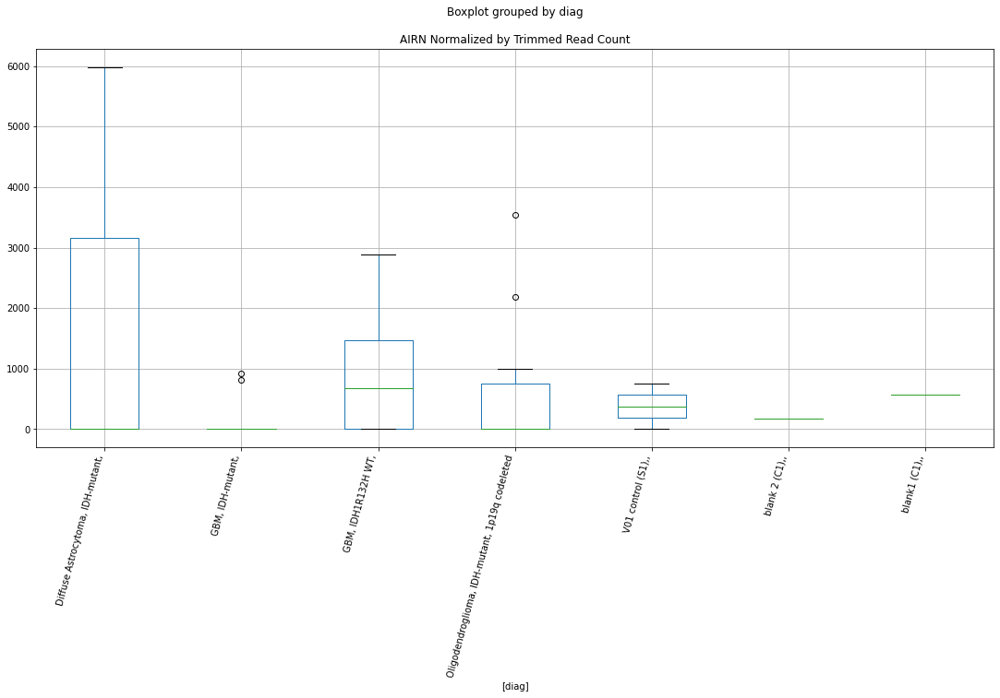

 p : 0.04303964579689542  ( t : 2.1769206867851585 ) :  D-plex  :  bbduk2  :  CD1B
Control and blanks
73     162331.76
337         0.00
Name: CD1B, dtype: float64
205    5372.73
Name: CD1B, dtype: float64
469    606907.03
Name: CD1B, dtype: float64


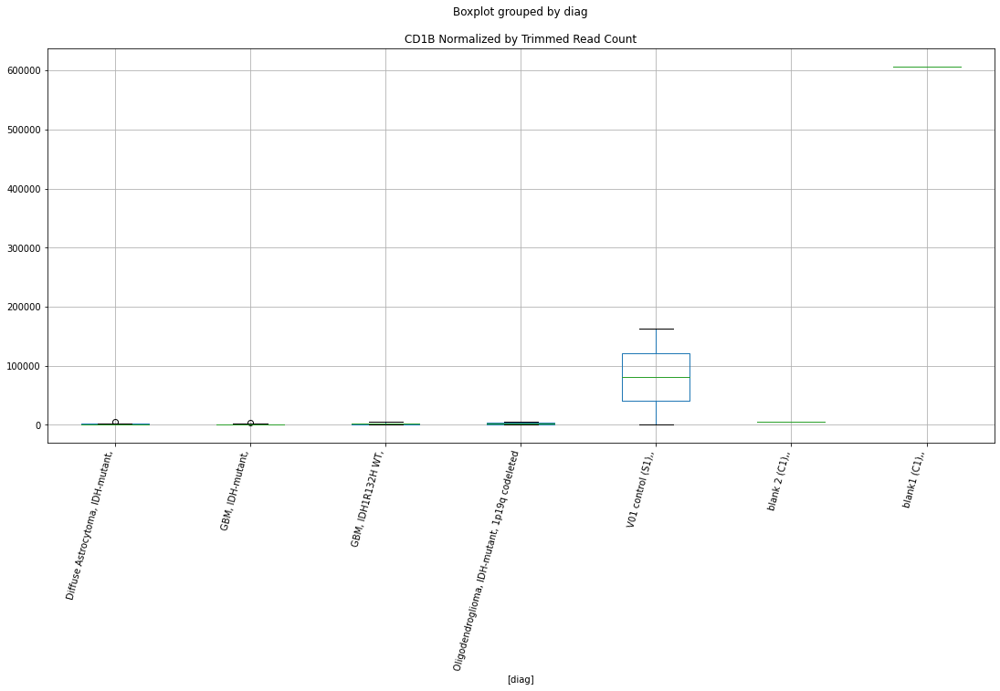

 p : 0.04311839412080896  ( t : 2.1759998080247183 ) :  D-plex  :  cutadapt2  :  C12orf76
Control and blanks
76     4545.69
340       0.00
Name: C12orf76, dtype: float64
208    705.44
Name: C12orf76, dtype: float64
472    0.0
Name: C12orf76, dtype: float64


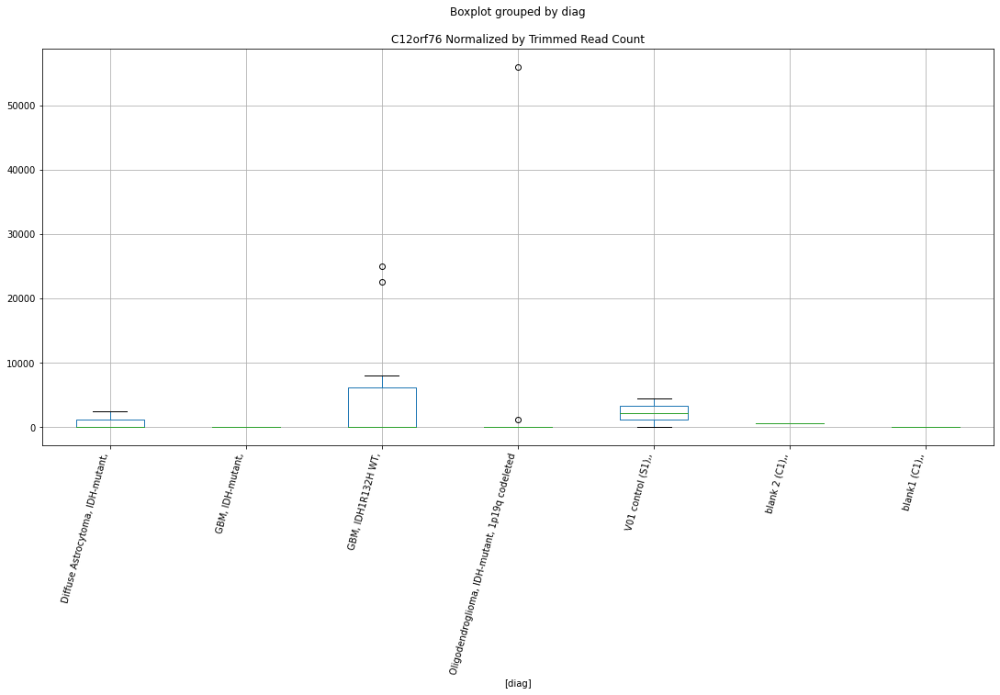

 p : 0.04311927935836378  ( t : 2.175989464864285 ) :  D-plex  :  cutadapt2  :  BORCS8-MEF2B
Control and blanks
76     0.0
340    0.0
Name: BORCS8-MEF2B, dtype: float64
208    0.0
Name: BORCS8-MEF2B, dtype: float64
472    0.0
Name: BORCS8-MEF2B, dtype: float64


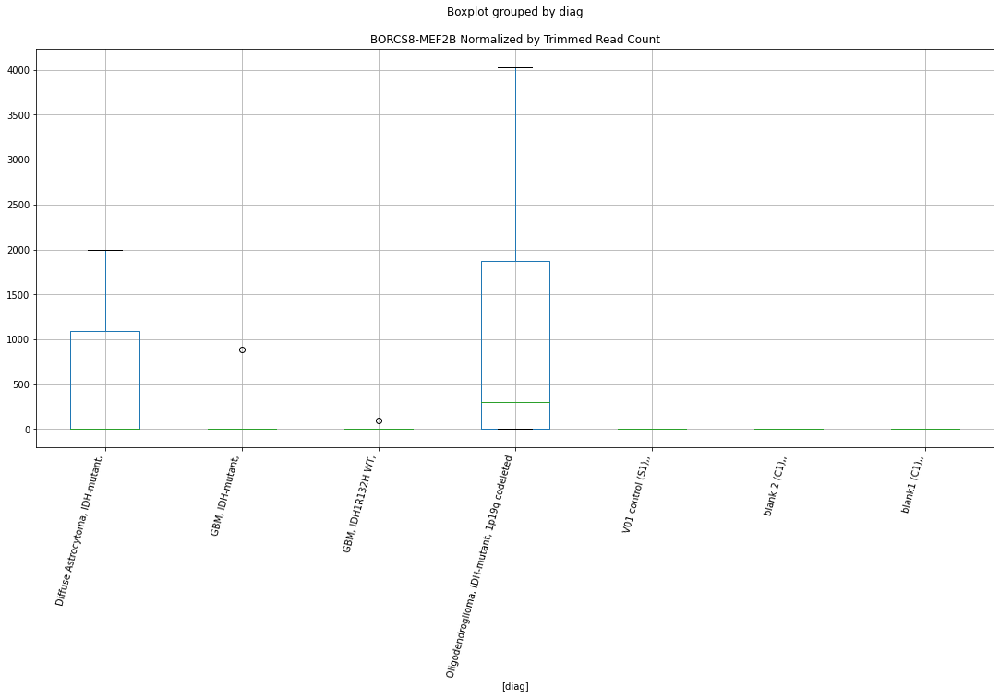

 p : 0.0431439354698832  ( t : 2.175701459748933 ) :  D-plex  :  cutadapt2  :  BAHCC1
Control and blanks
76     0.0
340    0.0
Name: BAHCC1, dtype: float64
208    3174.48
Name: BAHCC1, dtype: float64
472    0.0
Name: BAHCC1, dtype: float64


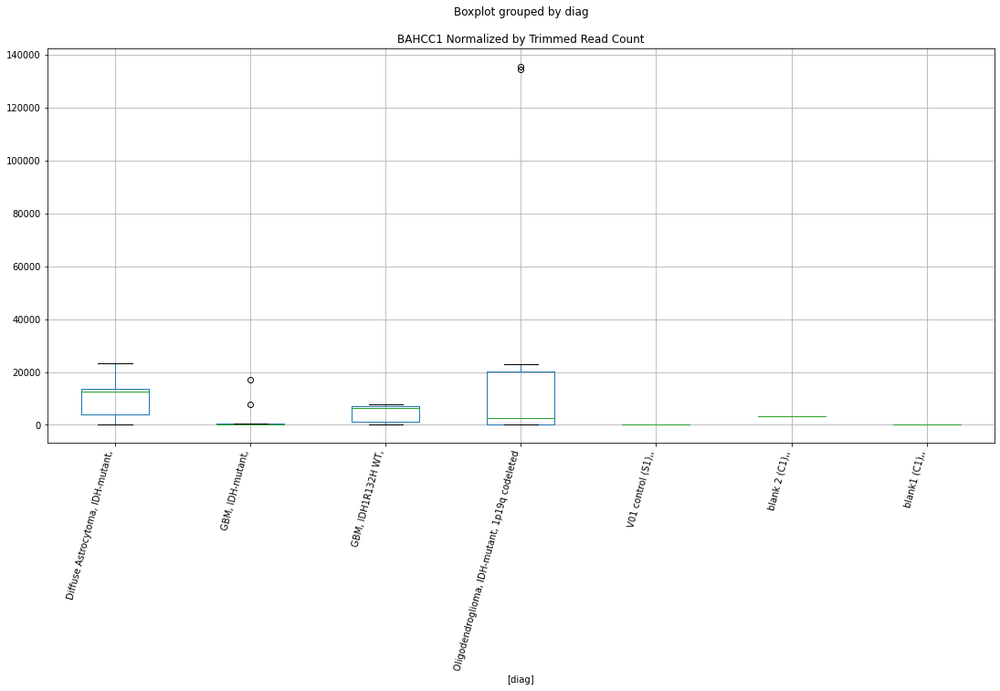

 p : 0.04317373831746497  ( t : 2.1753535374394266 ) :  D-plex  :  cutadapt2  :  CCL22
Control and blanks
76     757.61
340      0.00
Name: CCL22, dtype: float64
208    0.0
Name: CCL22, dtype: float64
472    0.0
Name: CCL22, dtype: float64


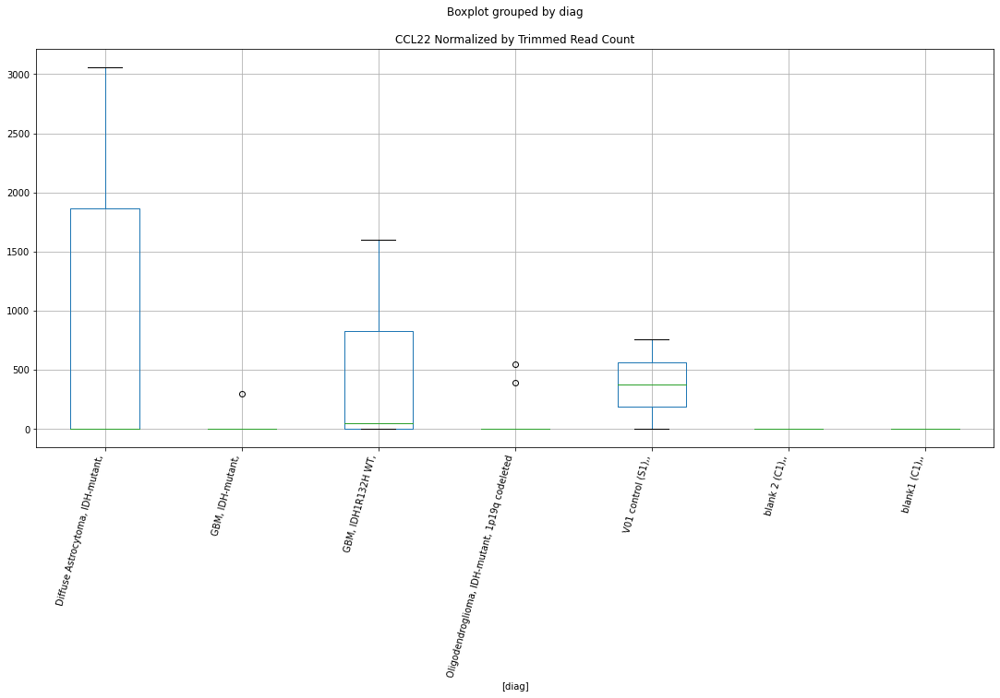

 p : 0.043241276835891414  ( t : 2.1745658975681765 ) :  D-plex  :  bbduk2  :  ATG16L1
Control and blanks
73     0.0
337    0.0
Name: ATG16L1, dtype: float64
205    6447.27
Name: ATG16L1, dtype: float64
469    0.0
Name: ATG16L1, dtype: float64


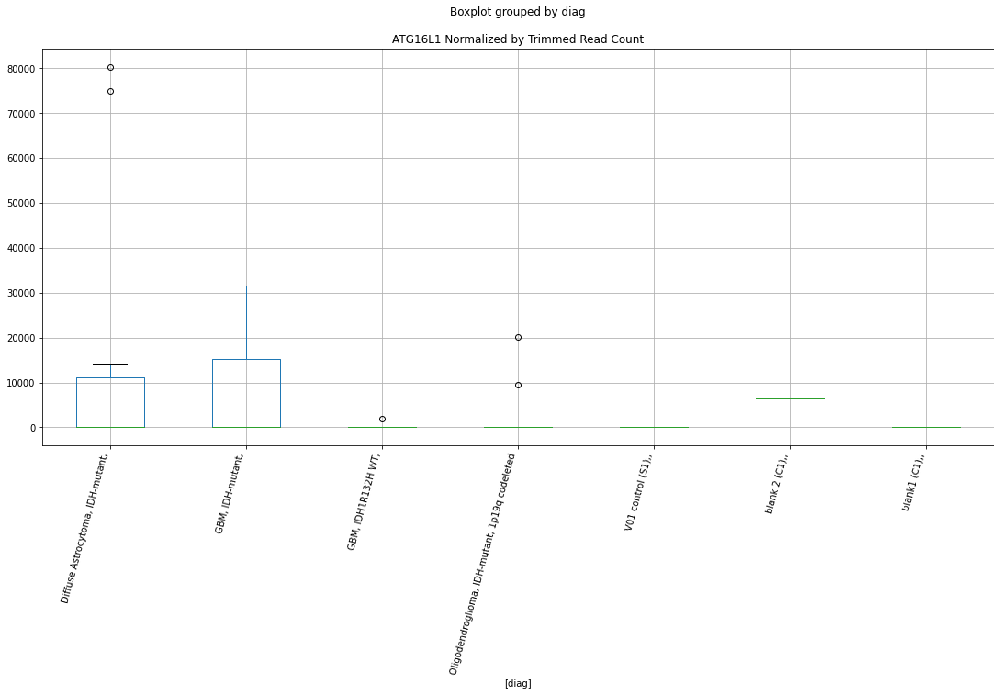

 p : 0.043280467727686456  ( t : 2.174109366642769 ) :  D-plex  :  cutadapt2  :  CROCCP3
Control and blanks
76     0.0
340    0.0
Name: CROCCP3, dtype: float64
208    529.08
Name: CROCCP3, dtype: float64
472    0.0
Name: CROCCP3, dtype: float64


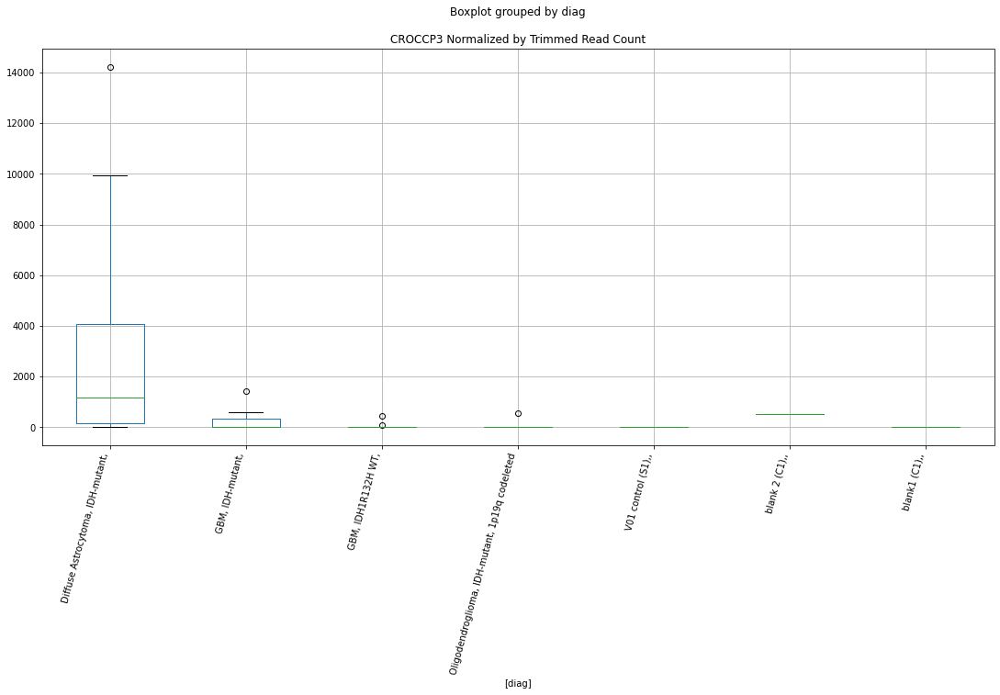

 p : 0.04329148657438129  ( t : 2.17398107735887 ) :  D-plex  :  bbduk2  :  CLTC
Control and blanks
73     1546.02
337       0.00
Name: CLTC, dtype: float64
205    3581.82
Name: CLTC, dtype: float64
469    0.0
Name: CLTC, dtype: float64


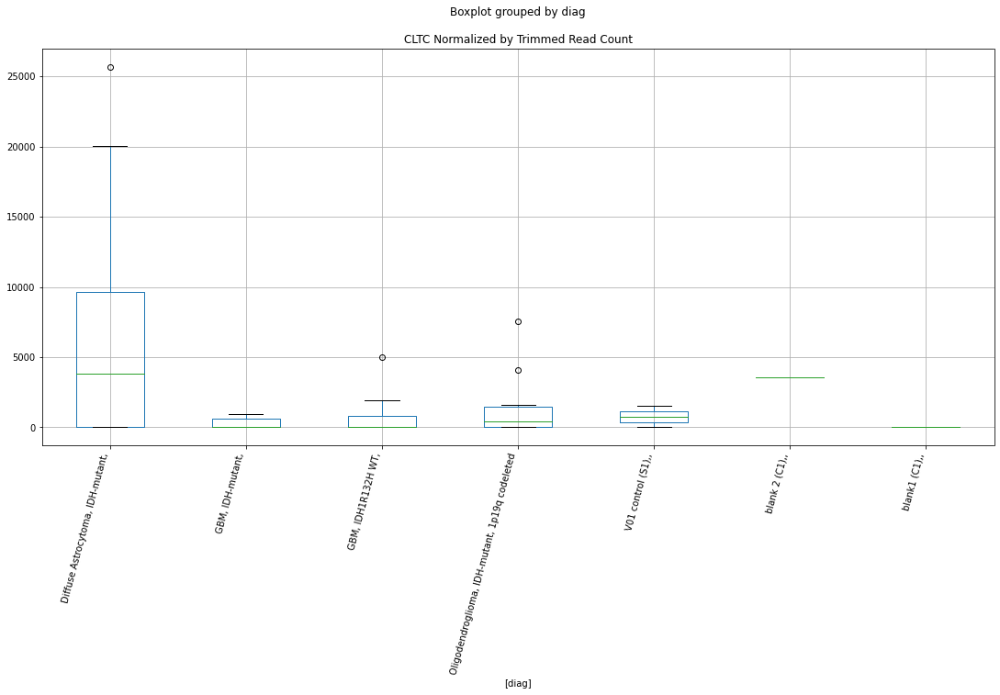

 p : 0.04331781417736638  ( t : 2.173674673664659 ) :  D-plex  :  cutadapt2  :  CROCCP3
Control and blanks
76     0.0
340    0.0
Name: CROCCP3, dtype: float64
208    529.08
Name: CROCCP3, dtype: float64
472    0.0
Name: CROCCP3, dtype: float64


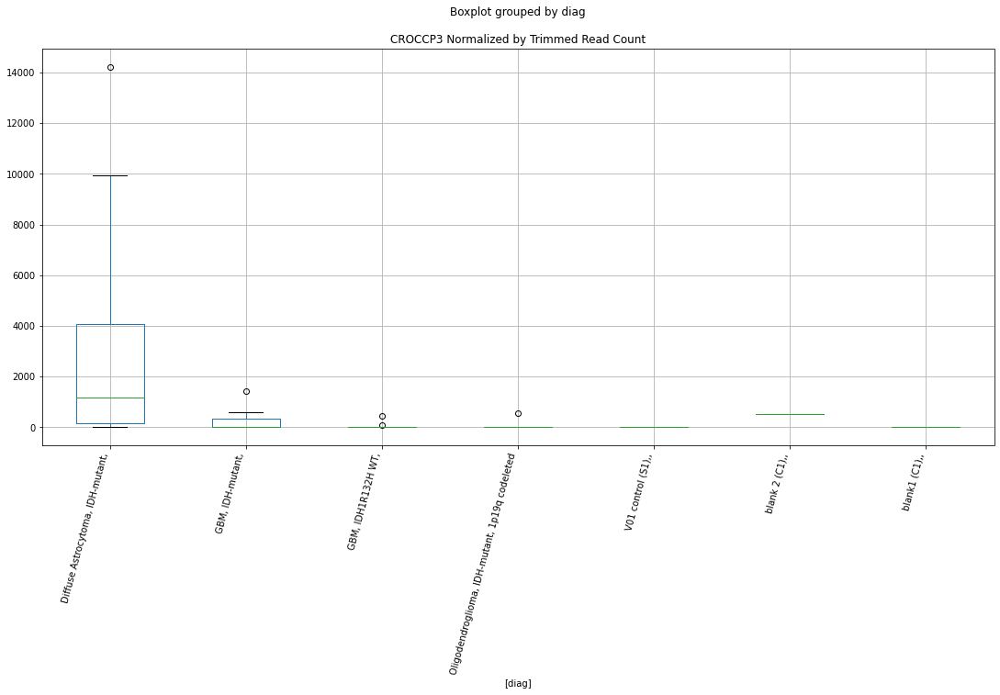

 p : 0.04337405309737073  ( t : 2.1730207295298 ) :  D-plex  :  cutadapt2  :  ATP6V0A1
Control and blanks
76         0.00
340    50201.73
Name: ATP6V0A1, dtype: float64
208    9699.81
Name: ATP6V0A1, dtype: float64
472    12137.07
Name: ATP6V0A1, dtype: float64


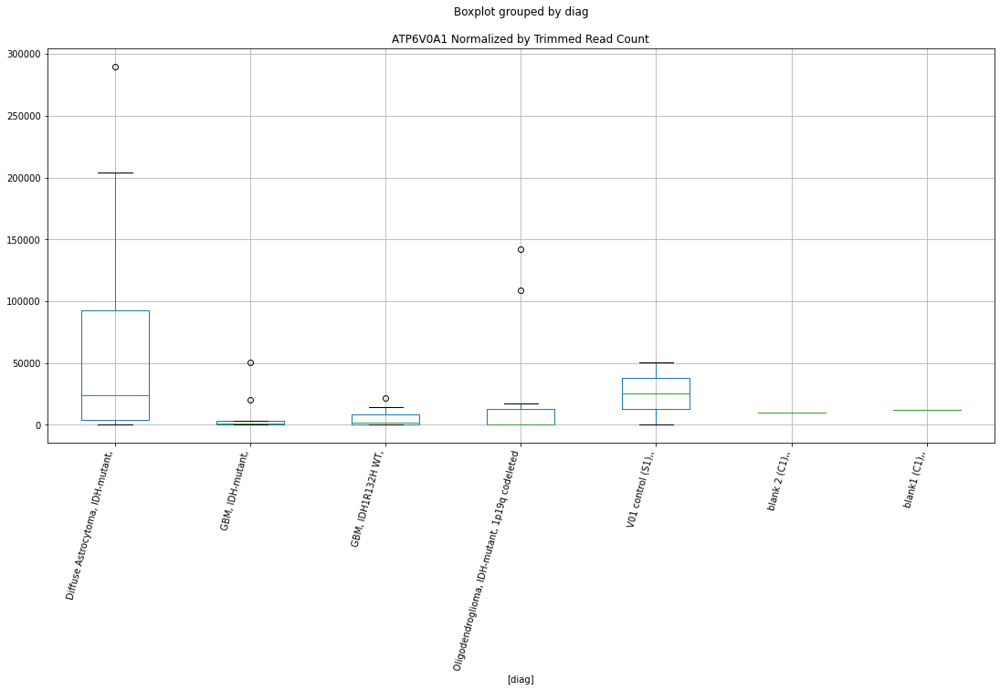

 p : 0.04337428650093266  ( t : 2.1730180171402065 ) :  Lexogen  :  cutadapt2  :  CACNG8
Control and blanks
82       0.00
346    420.87
Name: CACNG8, dtype: float64
214    0.0
Name: CACNG8, dtype: float64
478    0.0
Name: CACNG8, dtype: float64


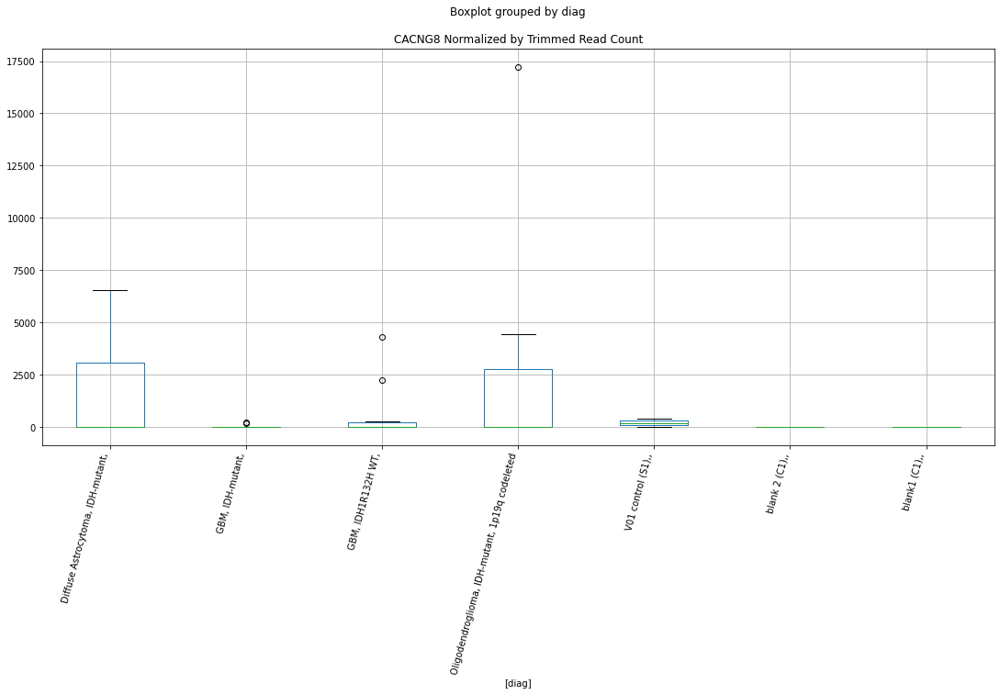

 p : 0.043404502656138606  ( t : 2.1726669871570254 ) :  Lexogen  :  bbduk2  :  CTSG
Control and blanks
79        0.00
343    2547.77
Name: CTSG, dtype: float64
211    0.0
Name: CTSG, dtype: float64
475    0.0
Name: CTSG, dtype: float64


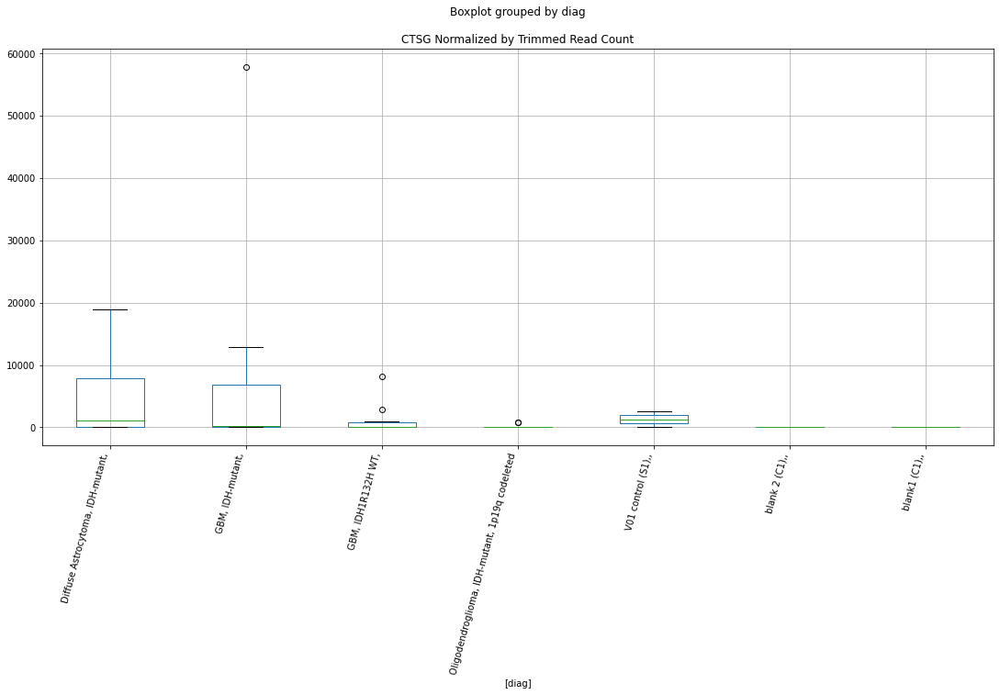

 p : 0.04342739209653866  ( t : 2.1724012227350395 ) :  Lexogen  :  cutadapt2  :  BRIP1
Control and blanks
82     0.0
346    0.0
Name: BRIP1, dtype: float64
214    0.0
Name: BRIP1, dtype: float64
478    0.0
Name: BRIP1, dtype: float64


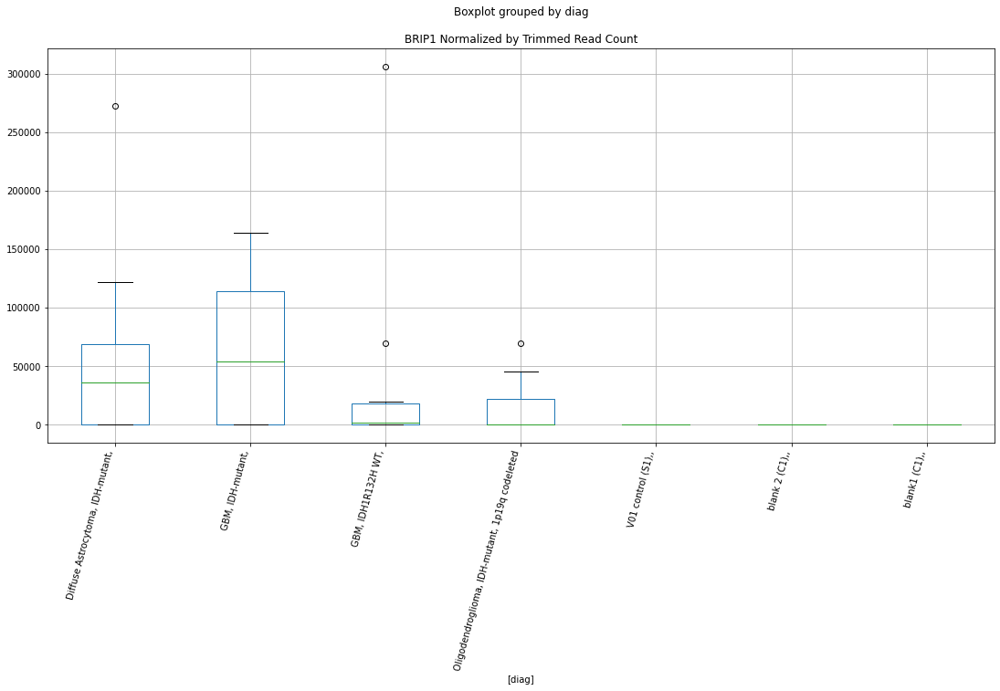

 p : 0.04343705323286491  ( t : 2.172289087836425 ) :  Lexogen  :  bbduk2  :  CACNG8
Control and blanks
79       0.00
343    424.63
Name: CACNG8, dtype: float64
211    0.0
Name: CACNG8, dtype: float64
475    0.0
Name: CACNG8, dtype: float64


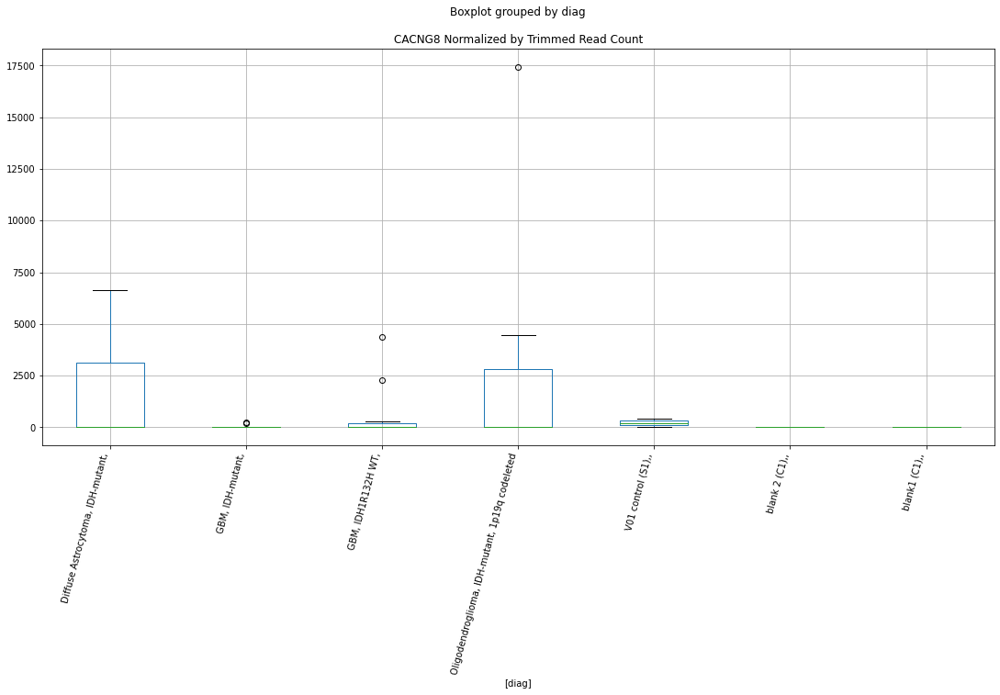

 p : 0.04345363015967976  ( t : 2.1720967359340246 ) :  D-plex  :  cutadapt2  :  ASB3
Control and blanks
76        0.0
340    2642.2
Name: ASB3, dtype: float64
208    529.08
Name: ASB3, dtype: float64
472    1733.87
Name: ASB3, dtype: float64


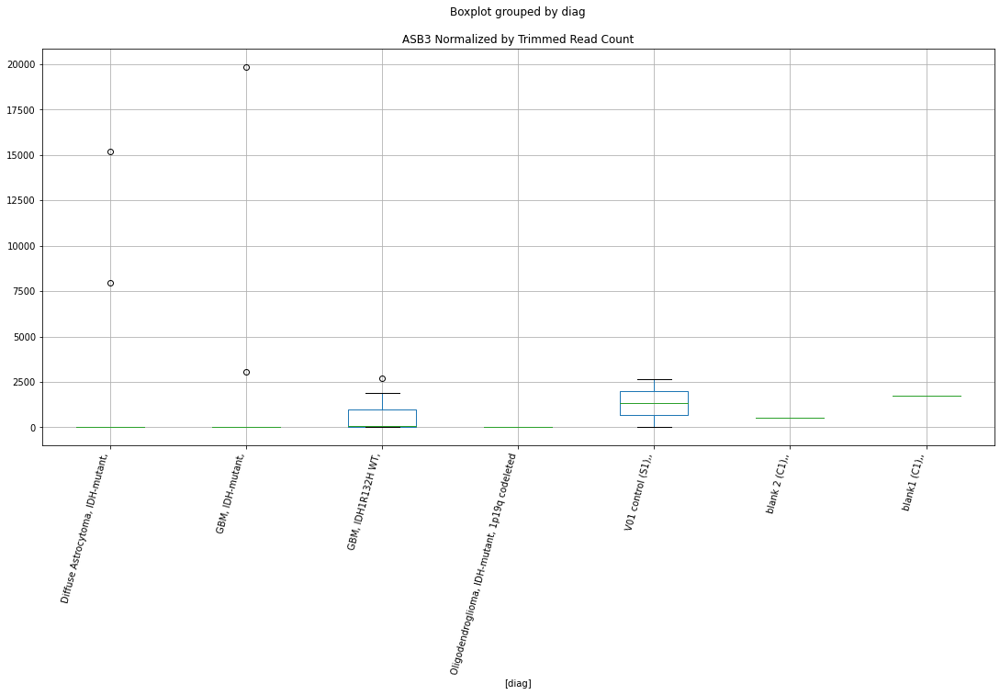

 p : 0.04348896832744889  ( t : 2.171686910461439 ) :  D-plex  :  bbduk2  :  C21orf58
Control and blanks
73     0.0
337    0.0
Name: C21orf58, dtype: float64
205    3223.64
Name: C21orf58, dtype: float64
469    10055.96
Name: C21orf58, dtype: float64


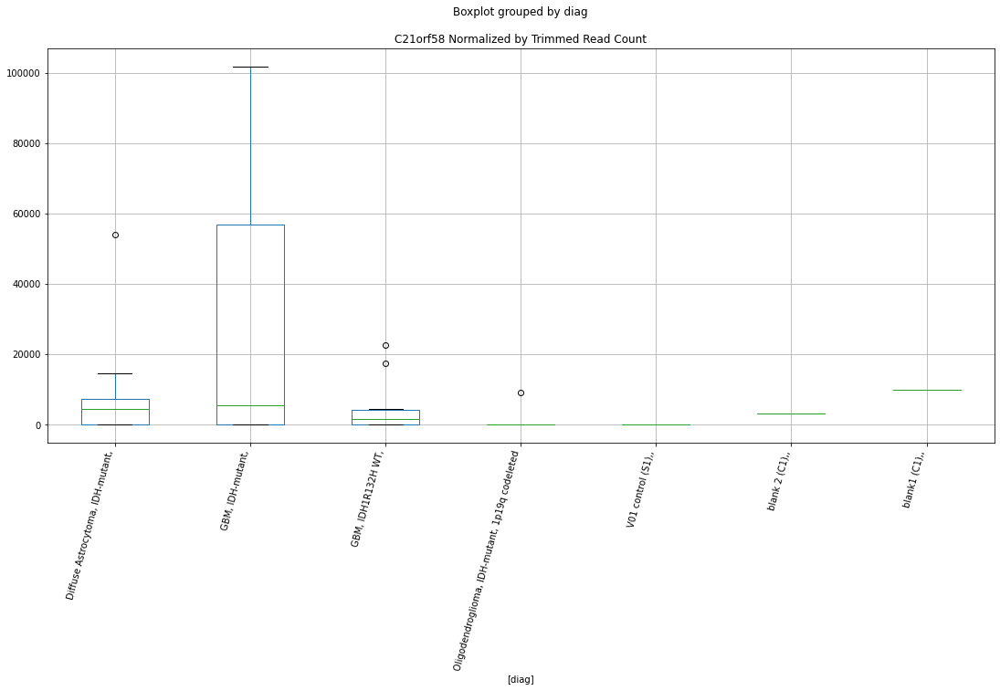

 p : 0.04355386769997884  ( t : 2.170935050071462 ) :  Lexogen  :  cutadapt2  :  CZ1P-ASNS
Control and blanks
82     0.0
346    0.0
Name: CZ1P-ASNS, dtype: float64
214    0.0
Name: CZ1P-ASNS, dtype: float64
478    0.0
Name: CZ1P-ASNS, dtype: float64


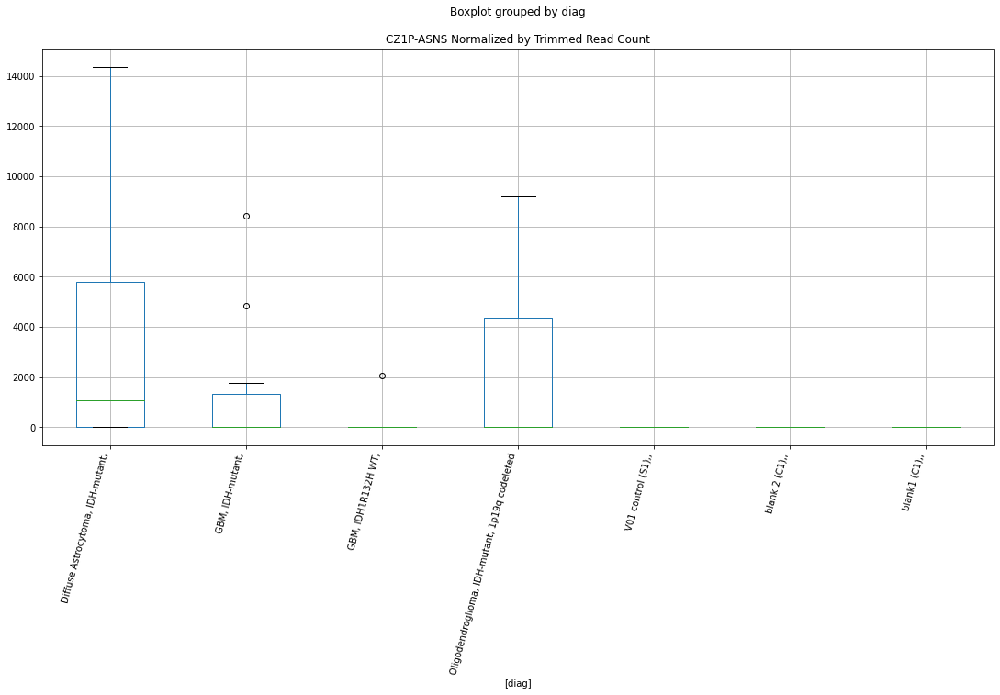

 p : 0.04355386769997895  ( t : 2.1709350500714613 ) :  Lexogen  :  cutadapt2  :  ASNS
Control and blanks
82     0.0
346    0.0
Name: ASNS, dtype: float64
214    0.0
Name: ASNS, dtype: float64
478    0.0
Name: ASNS, dtype: float64


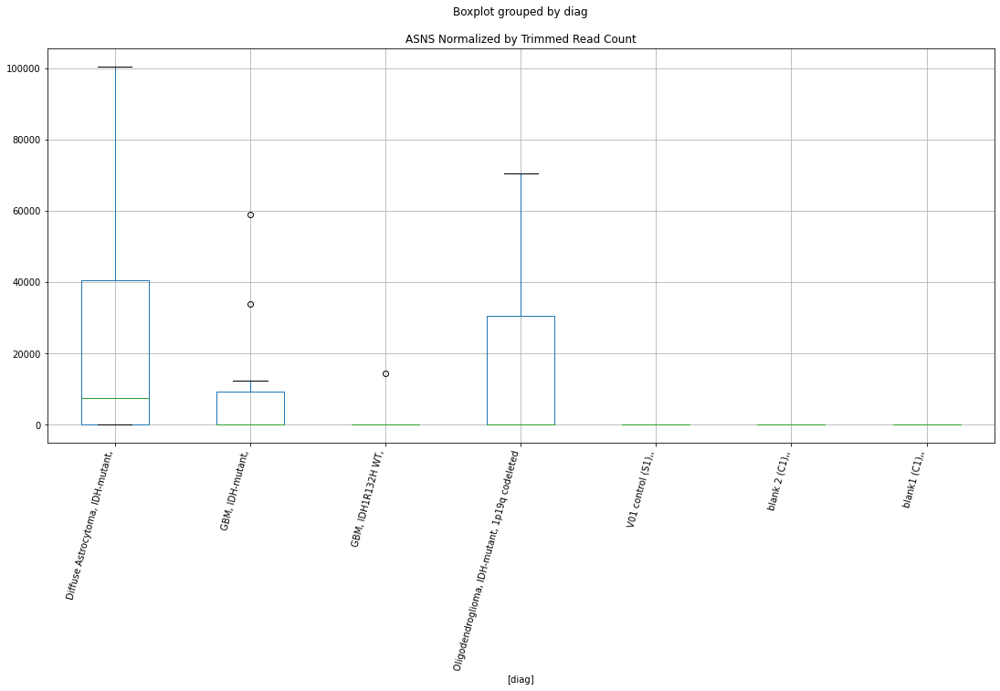

 p : 0.04355841562575624  ( t : 2.1708824007435163 ) :  D-plex  :  cutadapt2  :  C11orf96
Control and blanks
76     0.0
340    0.0
Name: C11orf96, dtype: float64
208    26806.75
Name: C11orf96, dtype: float64
472    577.96
Name: C11orf96, dtype: float64


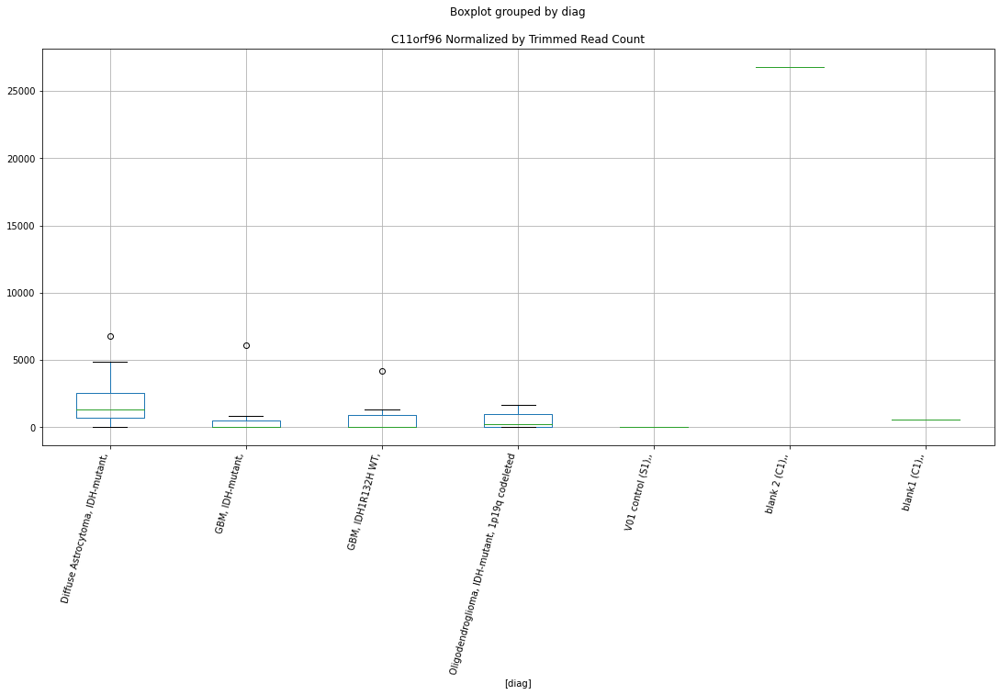

 p : 0.04362680402619397  ( t : 2.1700913047795476 ) :  Lexogen  :  cutadapt2  :  ADAM29
Control and blanks
82     0.0
346    0.0
Name: ADAM29, dtype: float64
214    271.23
Name: ADAM29, dtype: float64
478    0.0
Name: ADAM29, dtype: float64


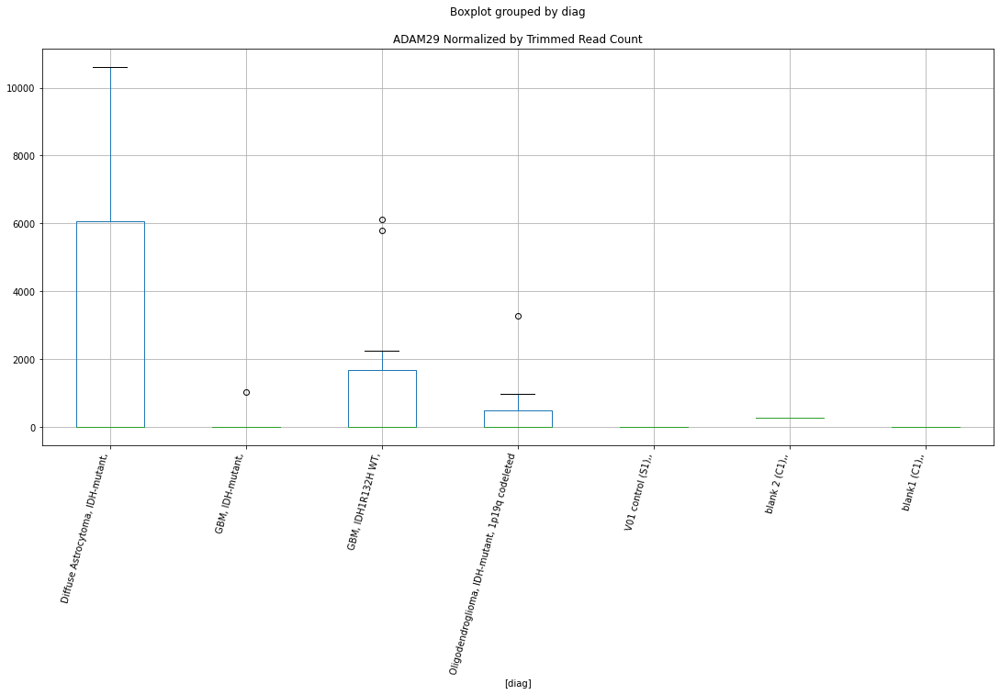

 p : 0.04363725186926944  ( t : 2.1699705473467548 ) :  D-plex  :  cutadapt2  :  ARIH2
Control and blanks
76     4545.69
340       0.00
Name: ARIH2, dtype: float64
208    70544.09
Name: ARIH2, dtype: float64
472    35255.31
Name: ARIH2, dtype: float64


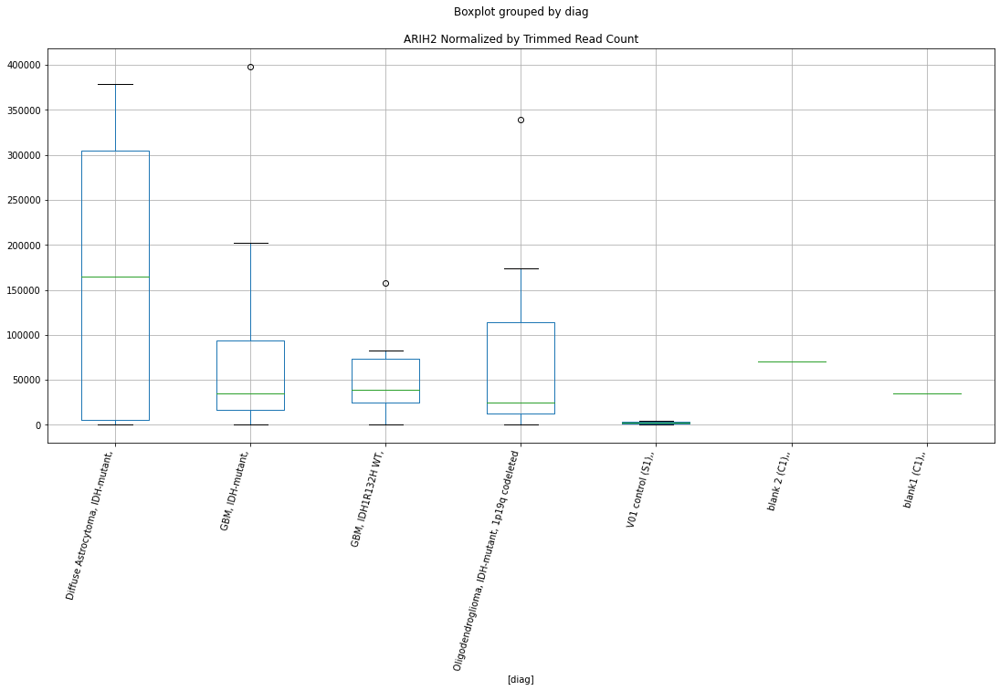

 p : 0.04366244221198717  ( t : 2.1696795031435565 ) :  D-plex  :  cutadapt2  :  DDX19B
Control and blanks
76     0.0
340    0.0
Name: DDX19B, dtype: float64
208    2116.32
Name: DDX19B, dtype: float64
472    0.0
Name: DDX19B, dtype: float64


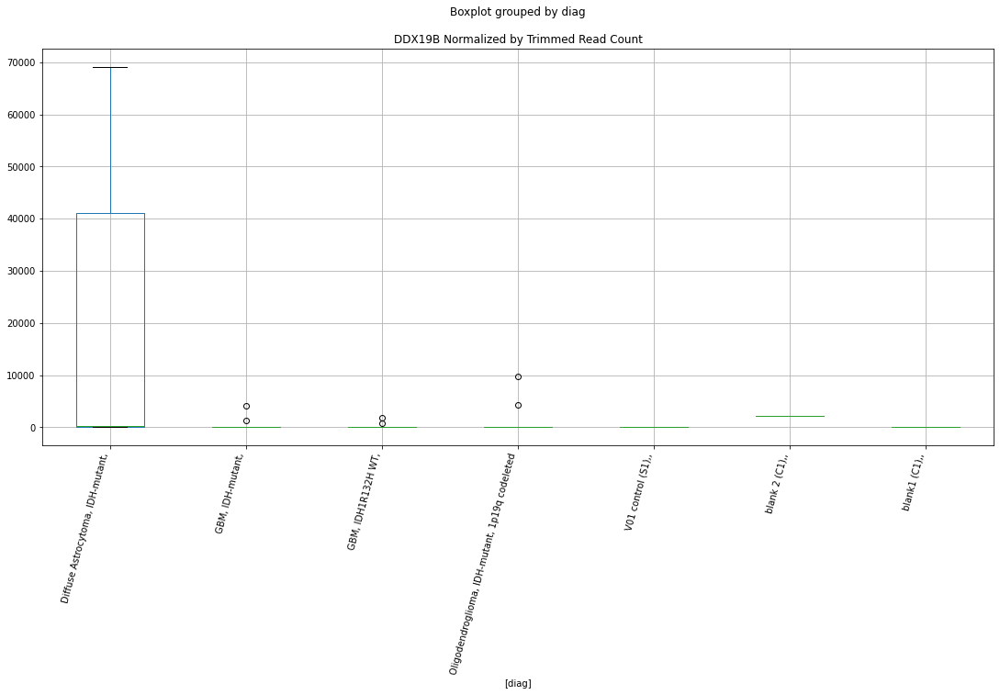

 p : 0.04366989768304355  ( t : 2.1695933935998277 ) :  D-plex  :  bbduk2  :  ADRA1D
Control and blanks
73     0.0
337    0.0
Name: ADRA1D, dtype: float64
205    0.0
Name: ADRA1D, dtype: float64
469    591.53
Name: ADRA1D, dtype: float64


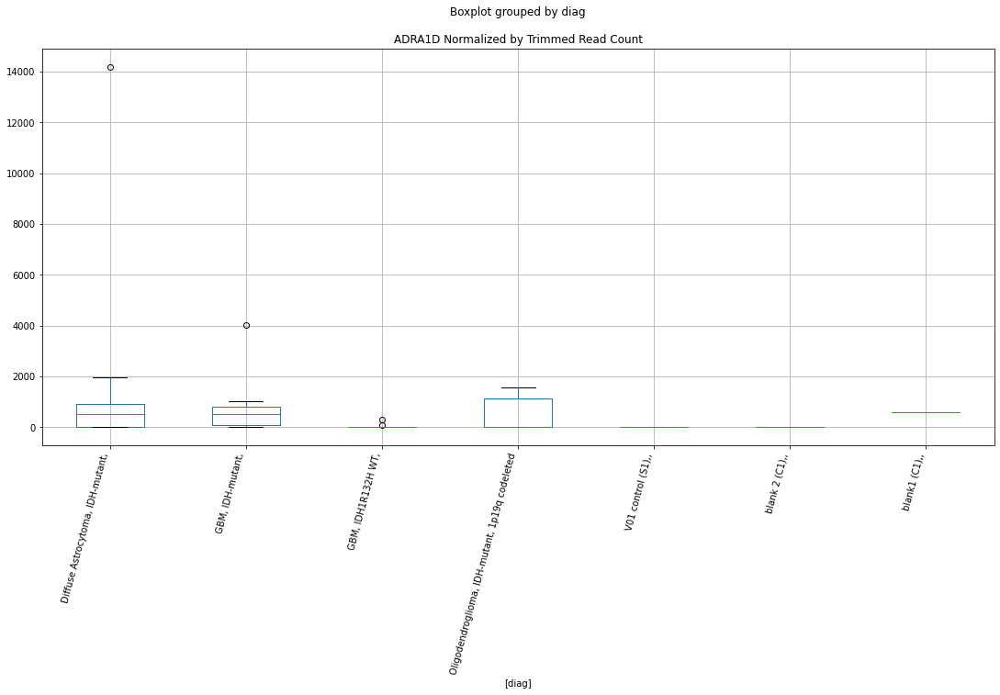

 p : 0.04367761909544246  ( t : 2.1695042266618714 ) :  D-plex  :  bbduk2  :  CACNA1I
Control and blanks
73     2319.03
337    2670.47
Name: CACNA1I, dtype: float64
205    30803.64
Name: CACNA1I, dtype: float64
469    8872.91
Name: CACNA1I, dtype: float64


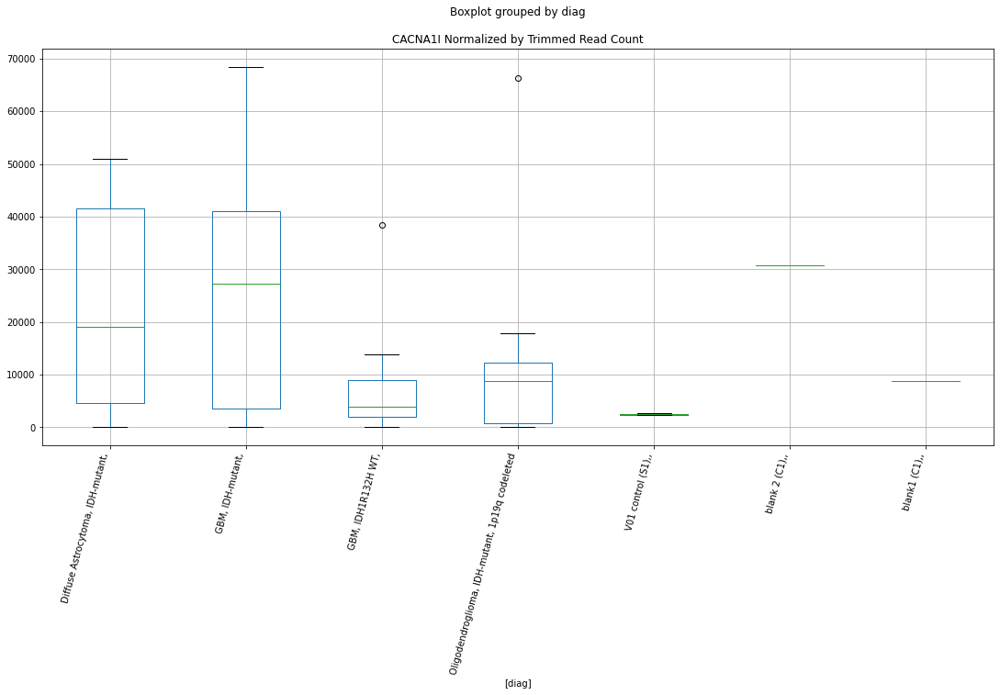

 p : 0.04371449670381325  ( t : 2.169078562680119 ) :  D-plex  :  bbduk2  :  DBET
Control and blanks
73     0.0
337    0.0
Name: DBET, dtype: float64
205    716.36
Name: DBET, dtype: float64
469    2366.11
Name: DBET, dtype: float64


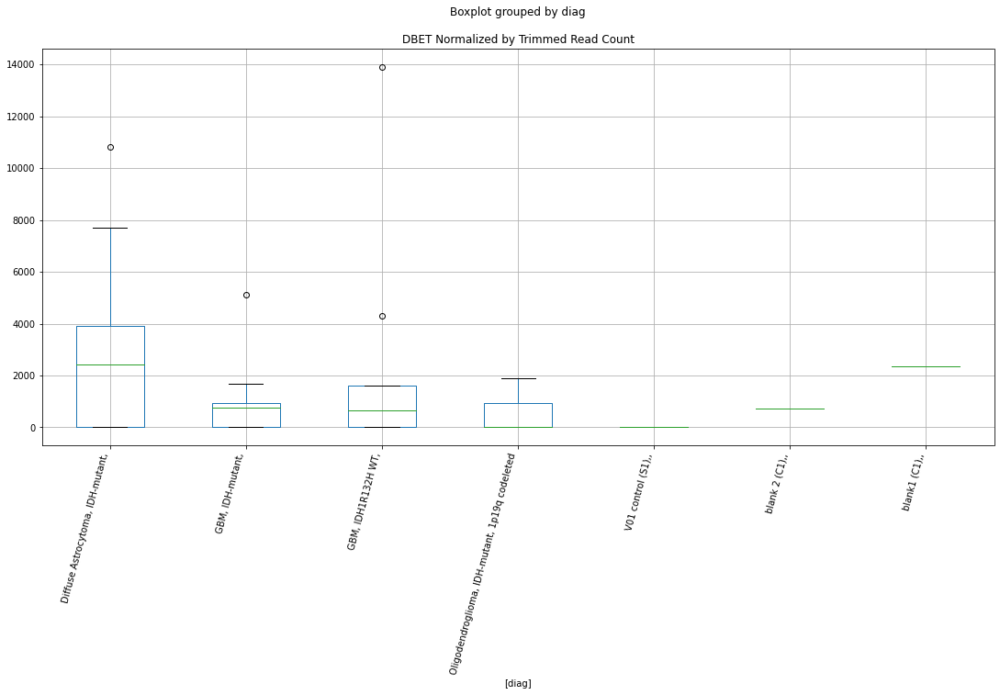

 p : 0.043720080252302444  ( t : 2.169014142596525 ) :  D-plex  :  bbduk2  :  CEP131
Control and blanks
73     9276.1
337       0.0
Name: CEP131, dtype: float64
205    4298.18
Name: CEP131, dtype: float64
469    0.0
Name: CEP131, dtype: float64


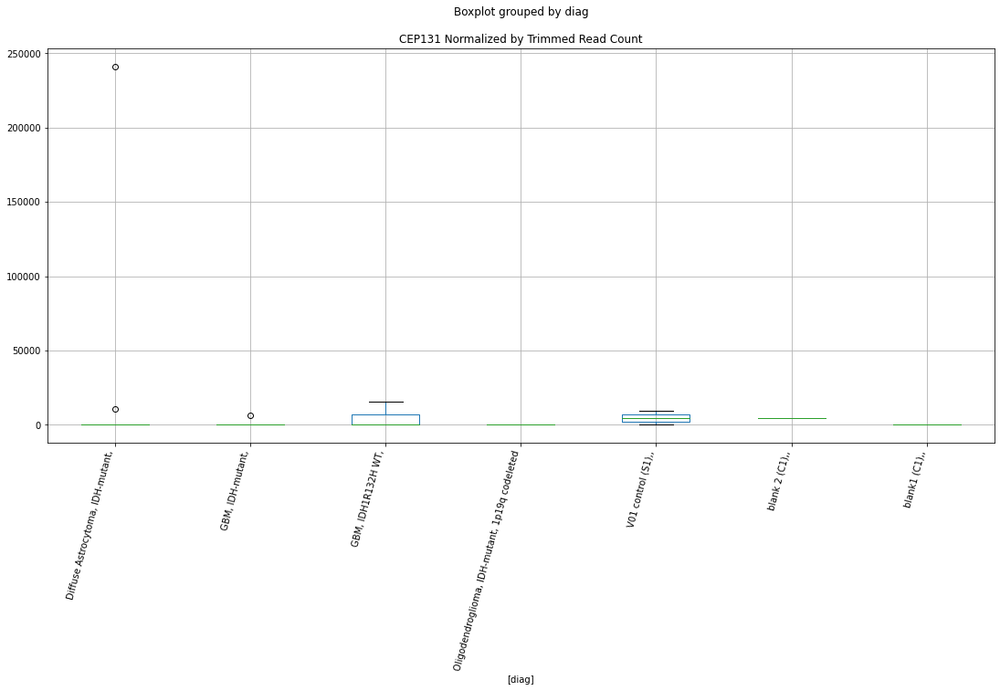

 p : 0.04378652823702821  ( t : 2.1682480778792477 ) :  D-plex  :  cutadapt2  :  CEP131
Control and blanks
76     9091.37
340       0.00
Name: CEP131, dtype: float64
208    2116.32
Name: CEP131, dtype: float64
472    0.0
Name: CEP131, dtype: float64


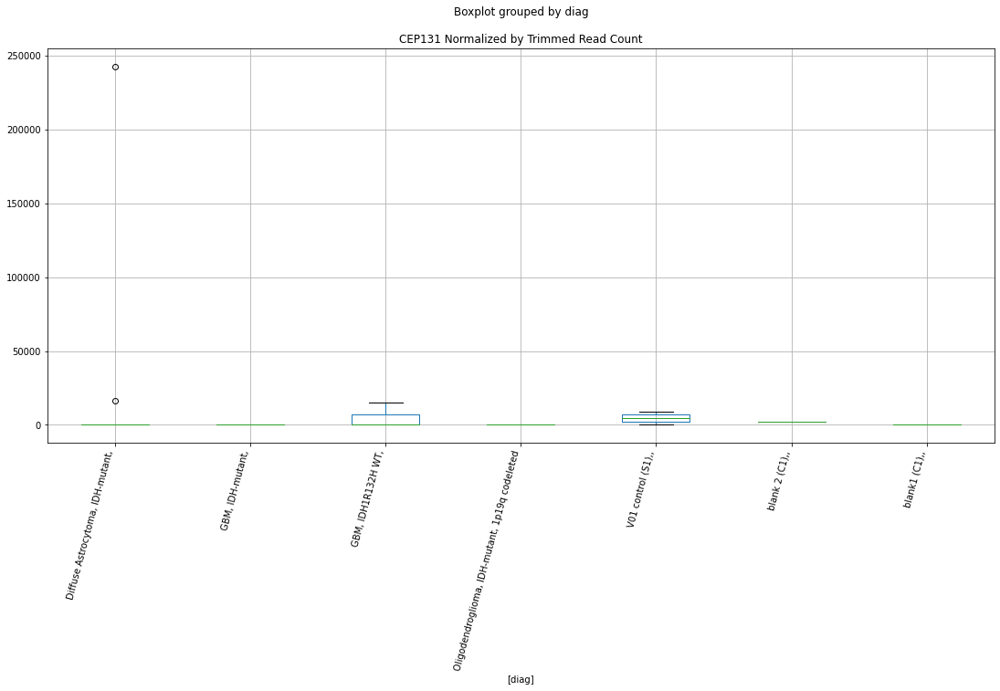

 p : 0.04380573788260755  ( t : 2.16802681225831 ) :  D-plex  :  bbduk2  :  DLEU2
Control and blanks
73     0.0
337    0.0
Name: DLEU2, dtype: float64
205    3402.73
Name: DLEU2, dtype: float64
469    1183.05
Name: DLEU2, dtype: float64


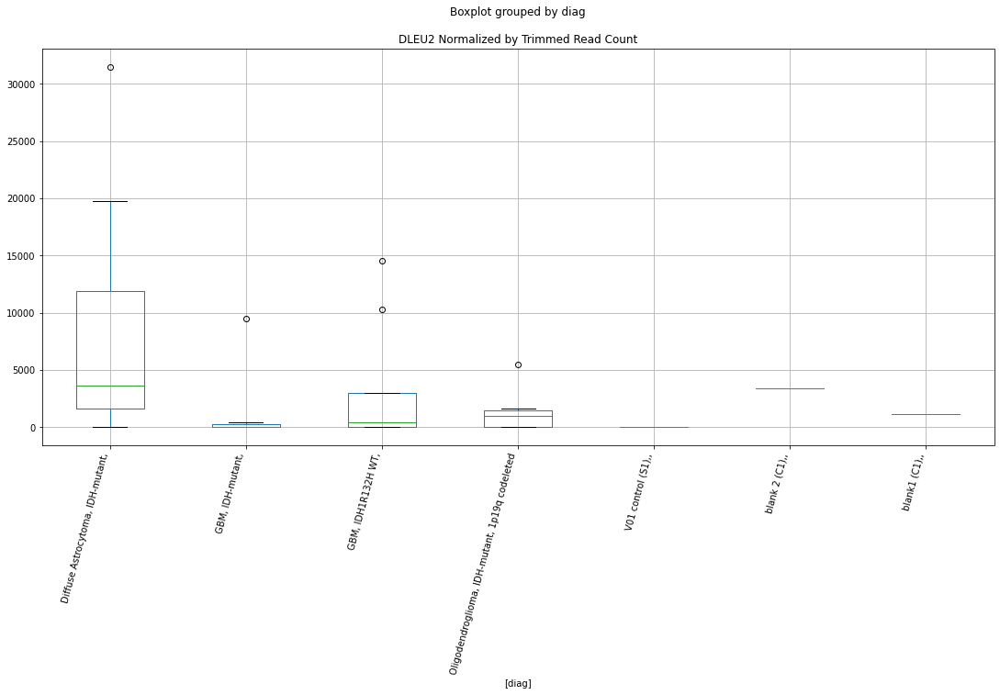

 p : 0.04381075392787615  ( t : 2.167969049744041 ) :  Lexogen  :  bbduk2  :  CSMD1
Control and blanks
79        0.00
343    8067.94
Name: CSMD1, dtype: float64
211    0.0
Name: CSMD1, dtype: float64
475    0.0
Name: CSMD1, dtype: float64


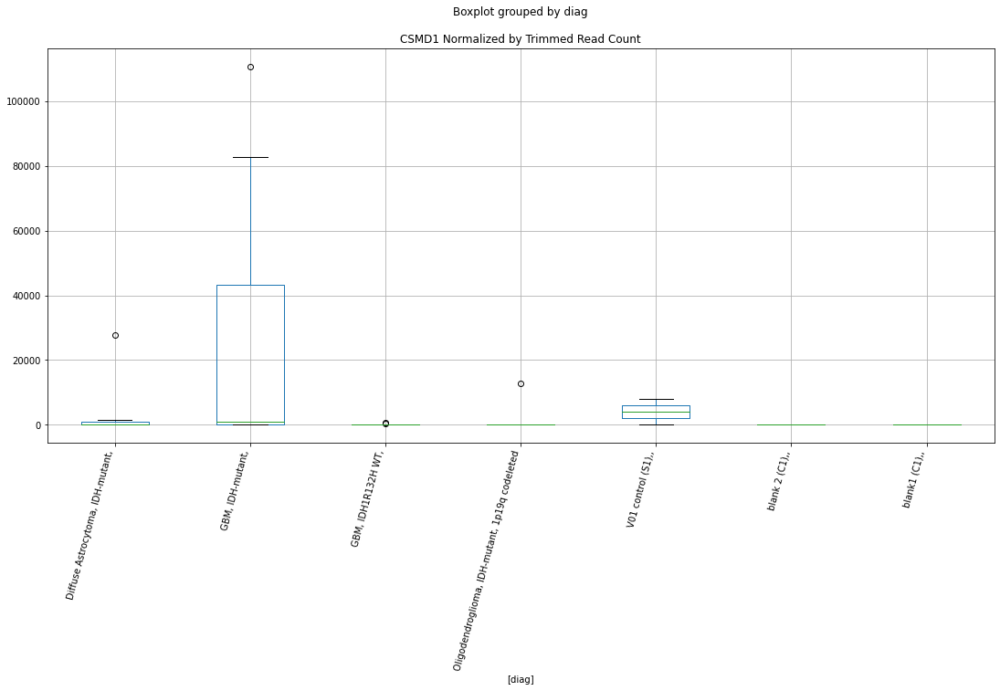

 p : 0.04381487331116968  ( t : 2.1679216173118436 ) :  D-plex  :  bbduk2  :  CDC27P10
Control and blanks
73      3092.03
337    32045.66
Name: CDC27P10, dtype: float64
205    25251.82
Name: CDC27P10, dtype: float64
469    27210.26
Name: CDC27P10, dtype: float64


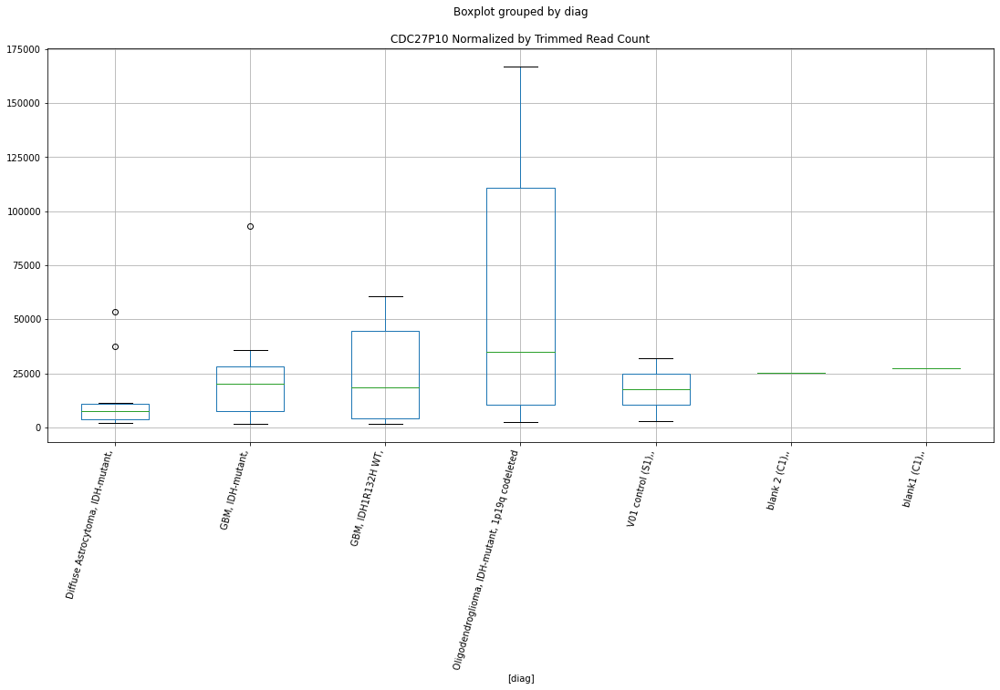

 p : 0.04388916027728092  ( t : 2.1670669436118173 ) :  Lexogen  :  bbduk2  :  ALK
Control and blanks
79     0.0
343    0.0
Name: ALK, dtype: float64
211    0.0
Name: ALK, dtype: float64
475    0.0
Name: ALK, dtype: float64


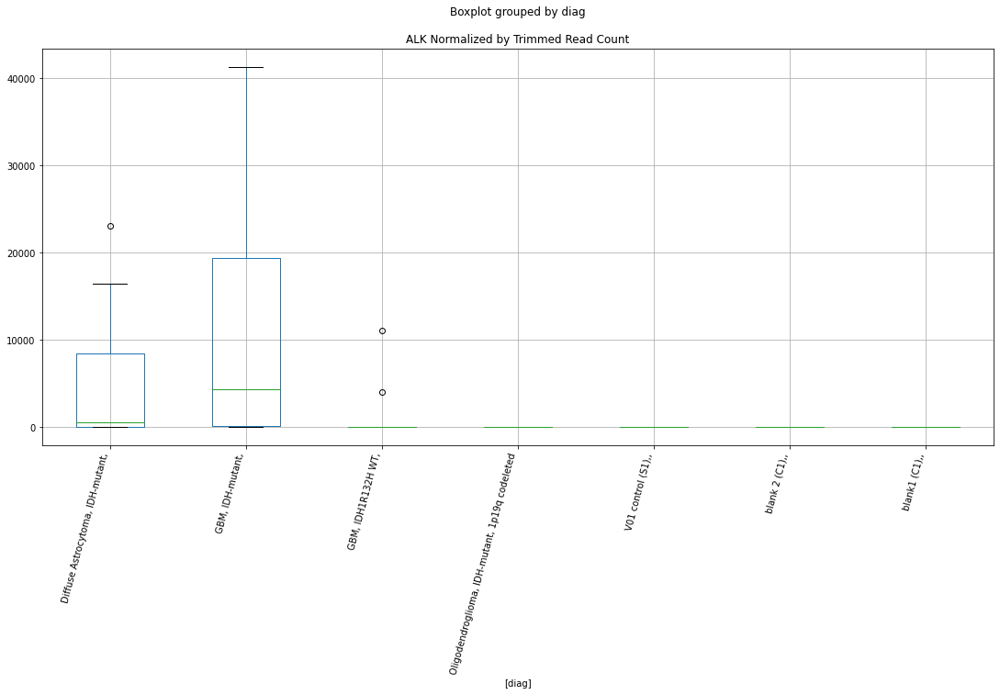

 p : 0.04392312152881221  ( t : 2.1666766594005478 ) :  Lexogen  :  cutadapt2  :  ART5
Control and blanks
82     0.0
346    0.0
Name: ART5, dtype: float64
214    0.0
Name: ART5, dtype: float64
478    0.0
Name: ART5, dtype: float64


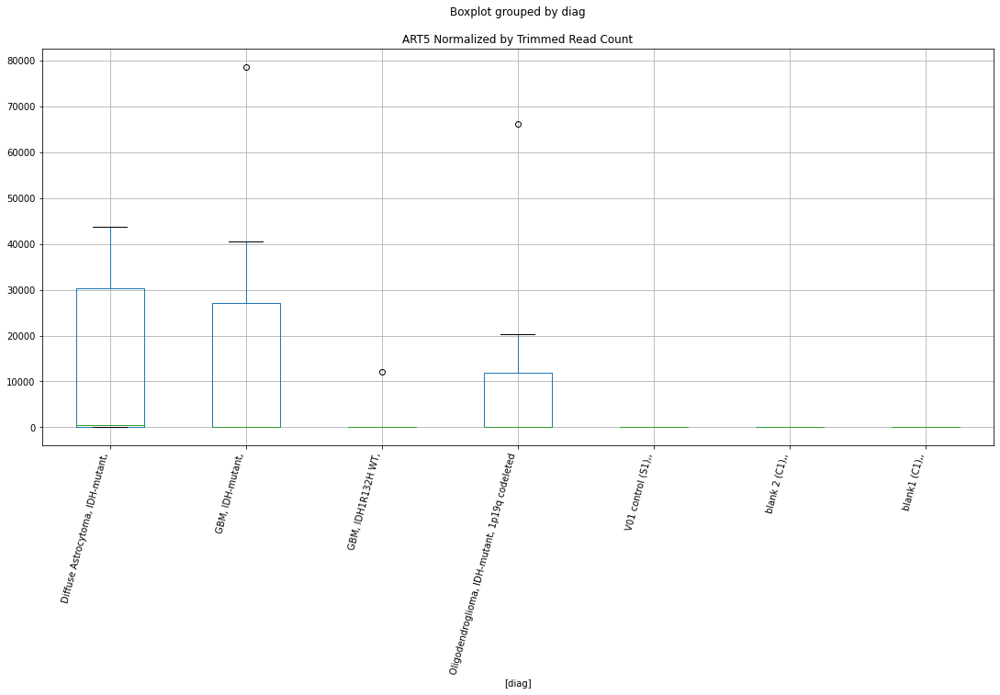

 p : 0.04393291840935893  ( t : 2.166564124546048 ) :  Lexogen  :  bbduk2  :  ART5
Control and blanks
79     0.0
343    0.0
Name: ART5, dtype: float64
211    0.0
Name: ART5, dtype: float64
475    0.0
Name: ART5, dtype: float64


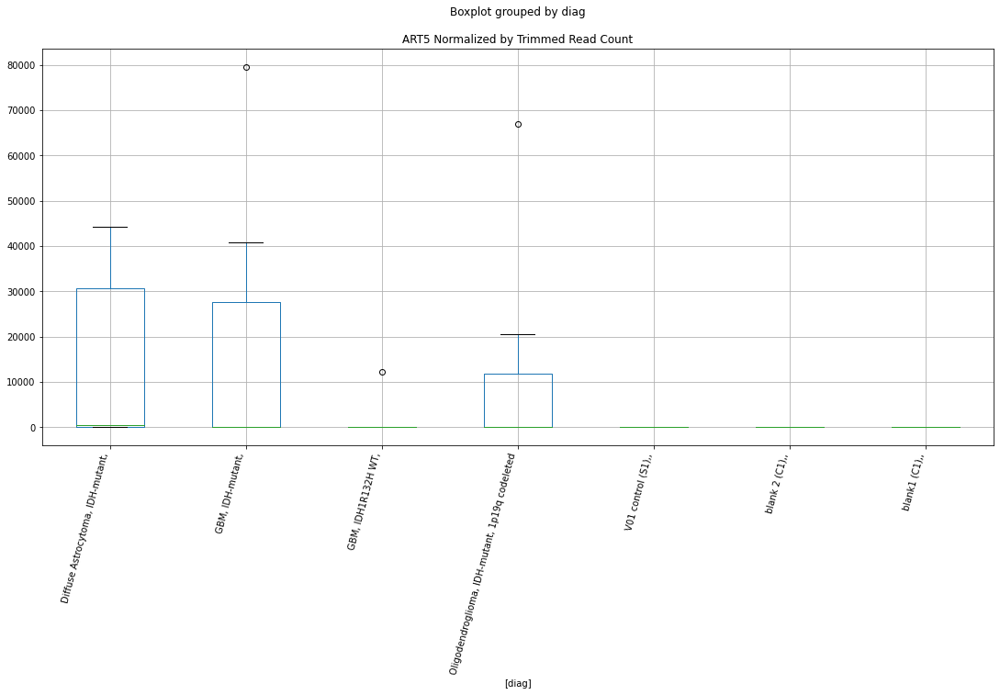

 p : 0.04393444291074118  ( t : 2.166546614961512 ) :  Lexogen  :  bbduk2  :  ADAM29
Control and blanks
79     0.0
343    0.0
Name: ADAM29, dtype: float64
211    273.31
Name: ADAM29, dtype: float64
475    0.0
Name: ADAM29, dtype: float64


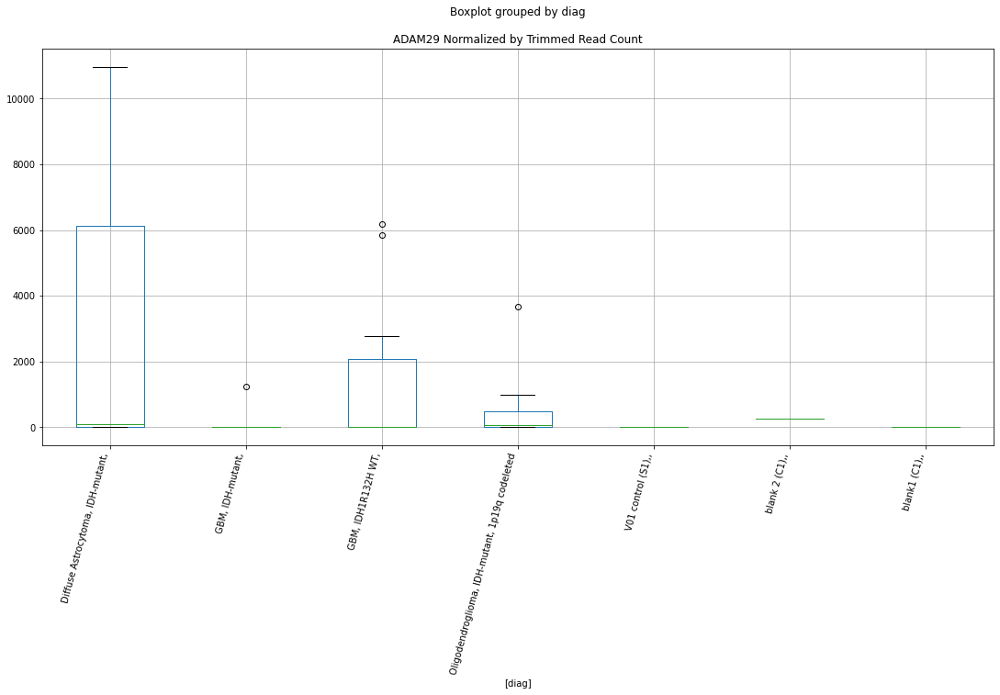

 p : 0.04398192452869445  ( t : 2.1660015453989074 ) :  D-plex  :  cutadapt2  :  ATG16L1
Control and blanks
76     0.0
340    0.0
Name: ATG16L1, dtype: float64
208    12345.22
Name: ATG16L1, dtype: float64
472    0.0
Name: ATG16L1, dtype: float64


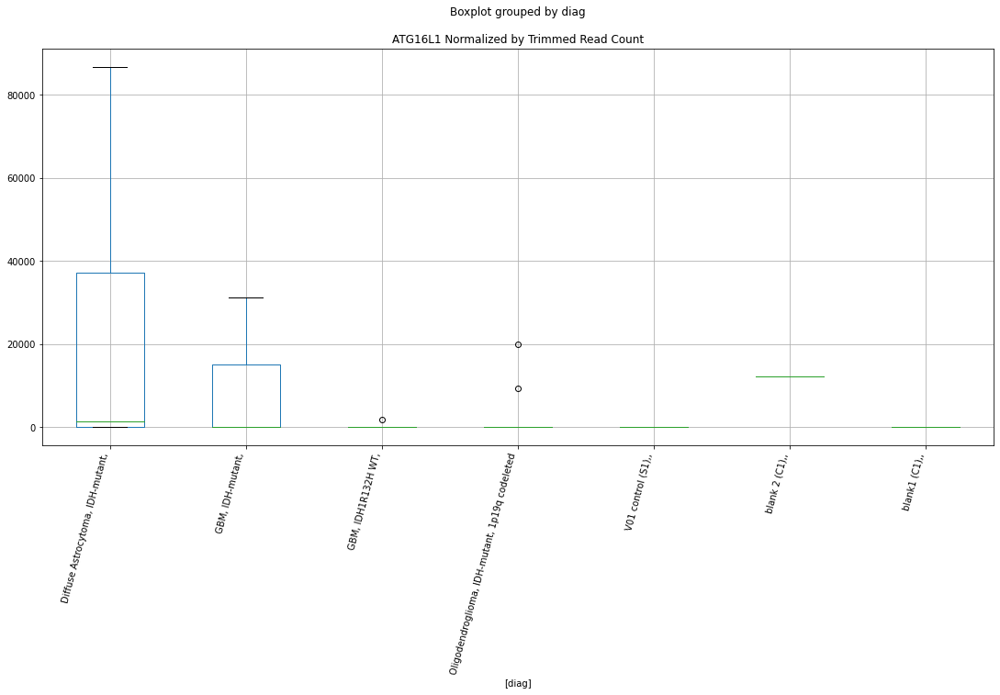

 p : 0.04400673772075362  ( t : 2.165716914327195 ) :  D-plex  :  cutadapt2  :  DAZ3
Control and blanks
76     0.0
340    0.0
Name: DAZ3, dtype: float64
208    1939.96
Name: DAZ3, dtype: float64
472    577.96
Name: DAZ3, dtype: float64


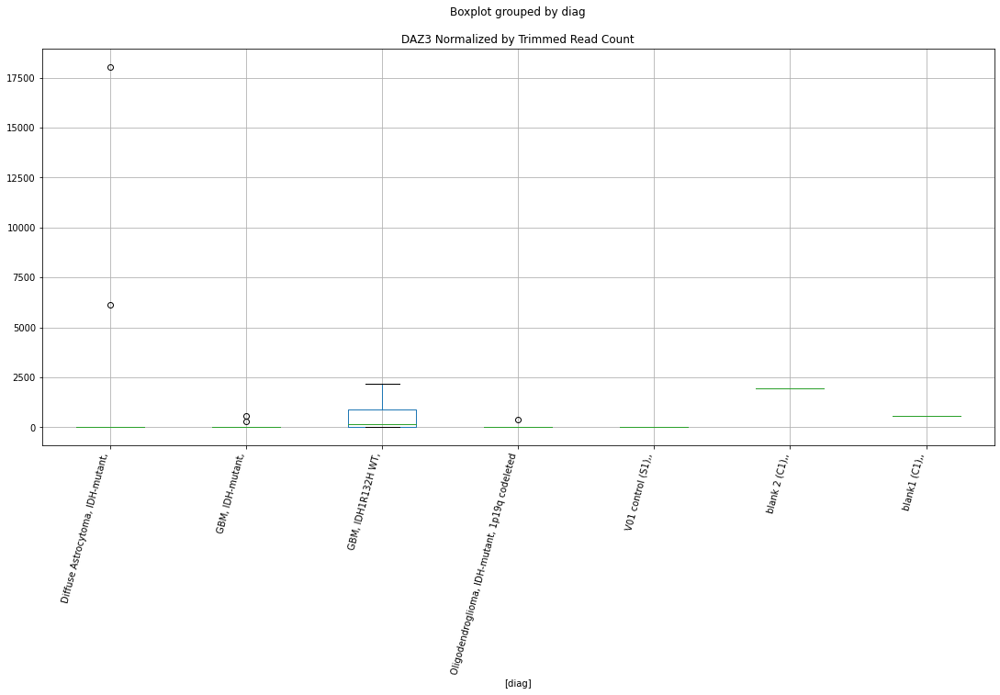

 p : 0.044006737720753634  ( t : 2.1657169143271946 ) :  D-plex  :  cutadapt2  :  DAZ2
Control and blanks
76     0.0
340    0.0
Name: DAZ2, dtype: float64
208    5819.89
Name: DAZ2, dtype: float64
472    1733.87
Name: DAZ2, dtype: float64


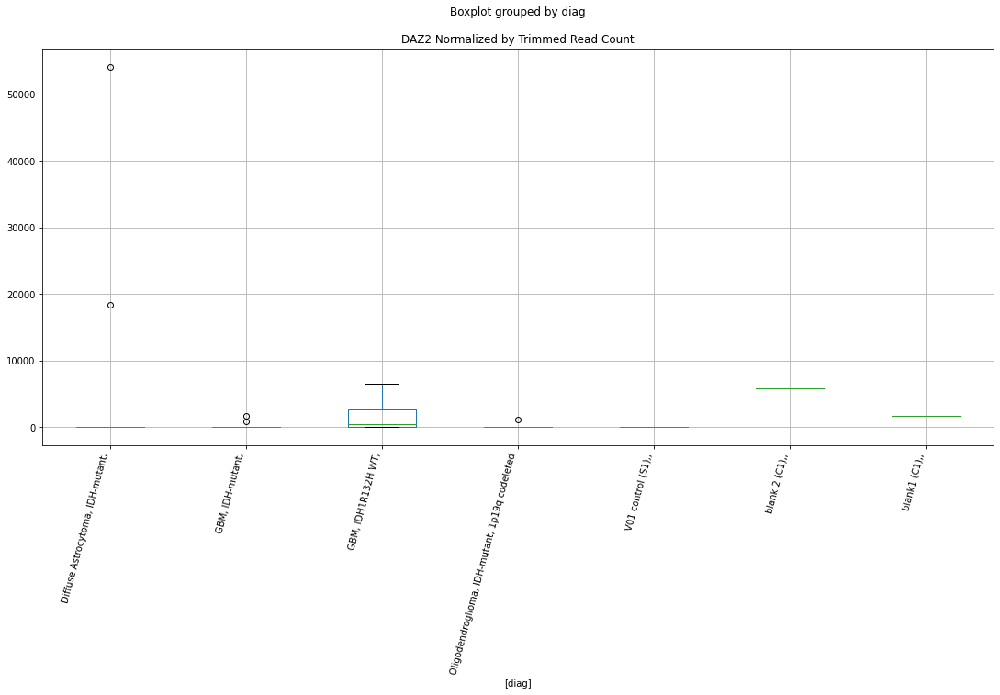

 p : 0.04404891408607688  ( t : 2.165233447872818 ) :  Lexogen  :  bbduk2  :  ADRB1
Control and blanks
79      1430.60
343    23566.89
Name: ADRB1, dtype: float64
211    23231.04
Name: ADRB1, dtype: float64
475    23233.03
Name: ADRB1, dtype: float64


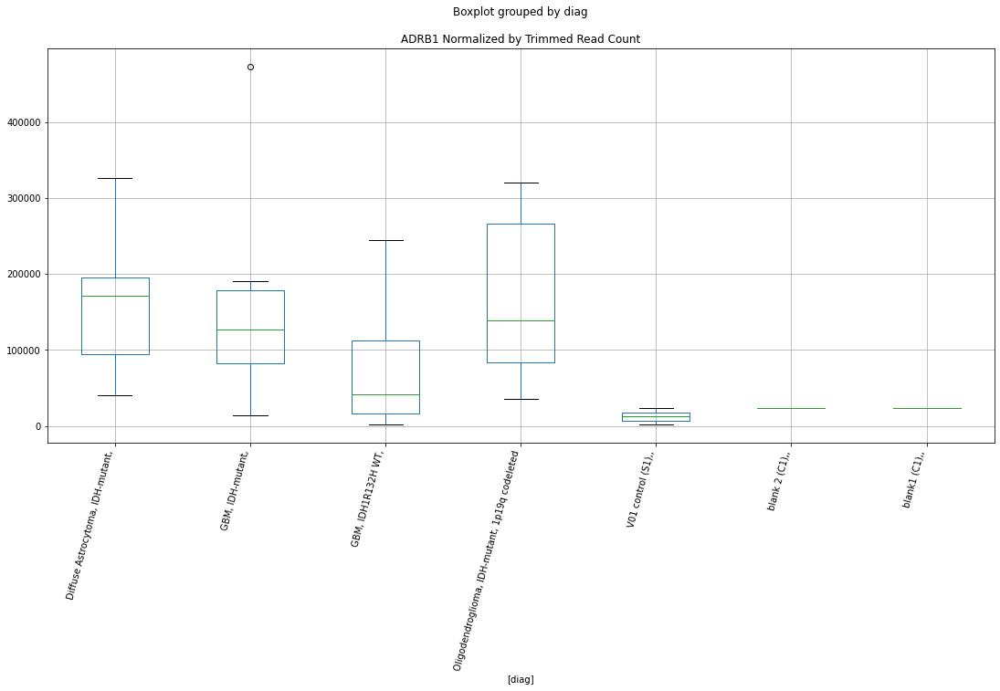

 p : 0.04420502360804293  ( t : 2.1634476470761492 ) :  Lexogen  :  bbduk2  :  ANKRD50
Control and blanks
79       0.00
343    636.94
Name: ANKRD50, dtype: float64
211    2459.76
Name: ANKRD50, dtype: float64
475    22274.96
Name: ANKRD50, dtype: float64


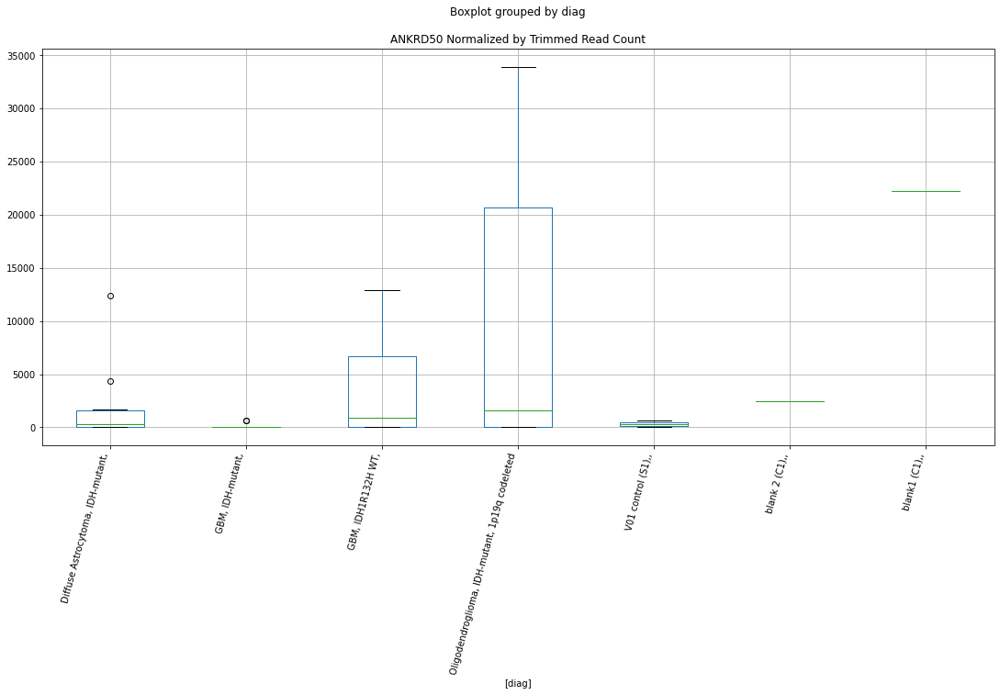

 p : 0.04422012116908654  ( t : 2.163275246054578 ) :  D-plex  :  cutadapt2  :  DAZ4
Control and blanks
76     0.0
340    0.0
Name: DAZ4, dtype: float64
208    9699.81
Name: DAZ4, dtype: float64
472    2889.78
Name: DAZ4, dtype: float64


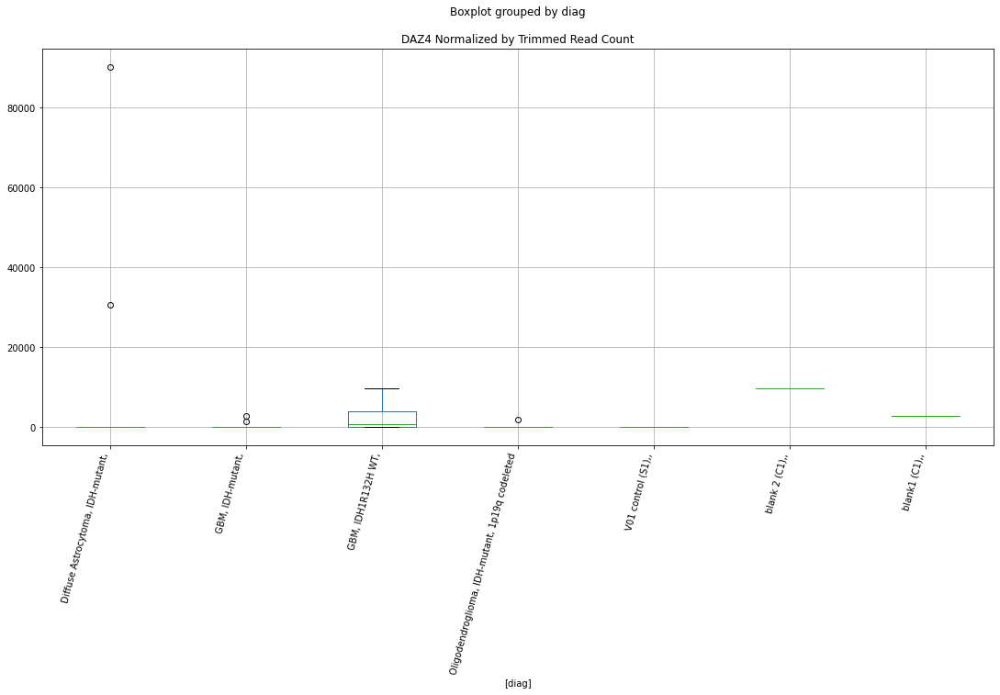

 p : 0.04422329718394301  ( t : 2.163238985582708 ) :  D-plex  :  cutadapt2  :  CTDSPL2
Control and blanks
76      1515.23
340    19376.11
Name: CTDSPL2, dtype: float64
208    18165.1
Name: CTDSPL2, dtype: float64
472    4623.65
Name: CTDSPL2, dtype: float64


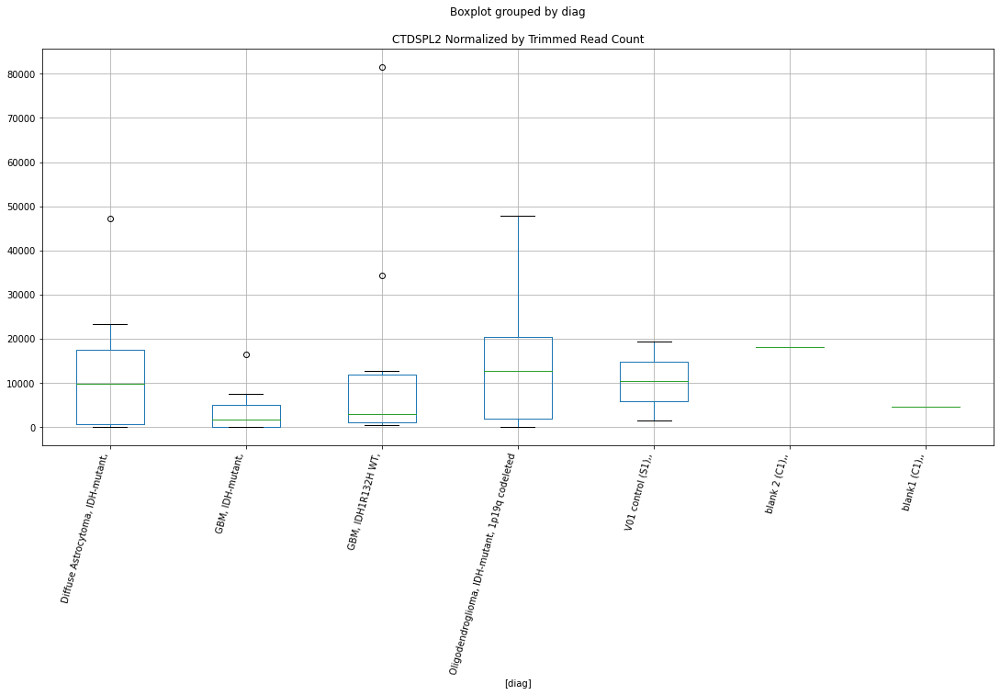

 p : 0.044287997669026545  ( t : 2.162500820172356 ) :  D-plex  :  cutadapt2  :  DLEU2
Control and blanks
76     0.0
340    0.0
Name: DLEU2, dtype: float64
208    3350.84
Name: DLEU2, dtype: float64
472    1155.91
Name: DLEU2, dtype: float64


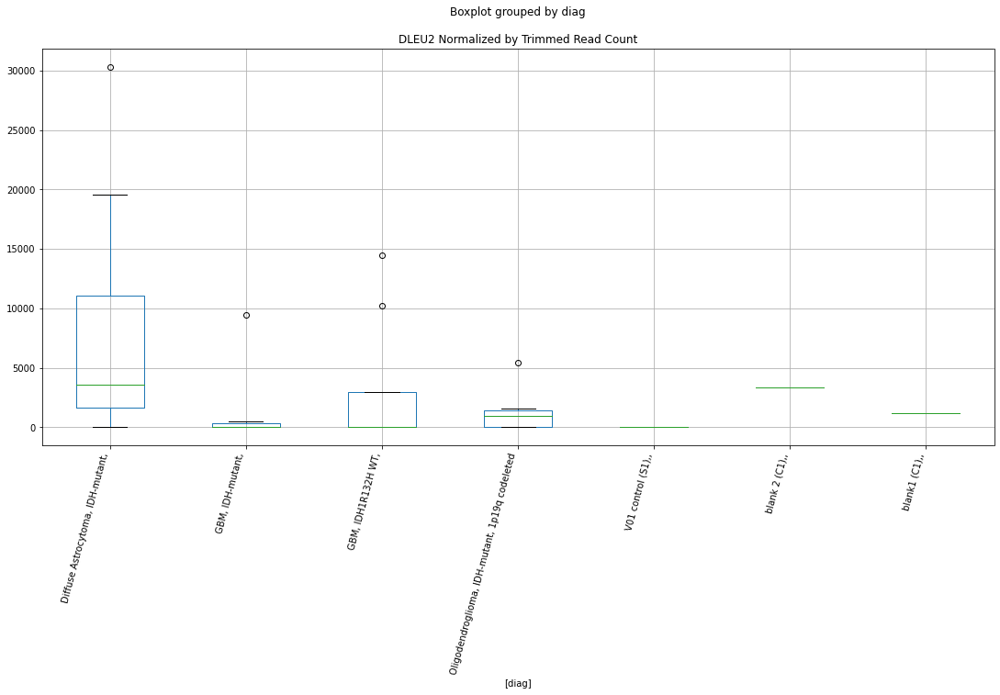

 p : 0.04432265595418551  ( t : 2.1621058108129807 ) :  D-plex  :  bbduk2  :  BHLHE22
Control and blanks
73     0.0
337    0.0
Name: BHLHE22, dtype: float64
205    358.18
Name: BHLHE22, dtype: float64
469    2366.11
Name: BHLHE22, dtype: float64


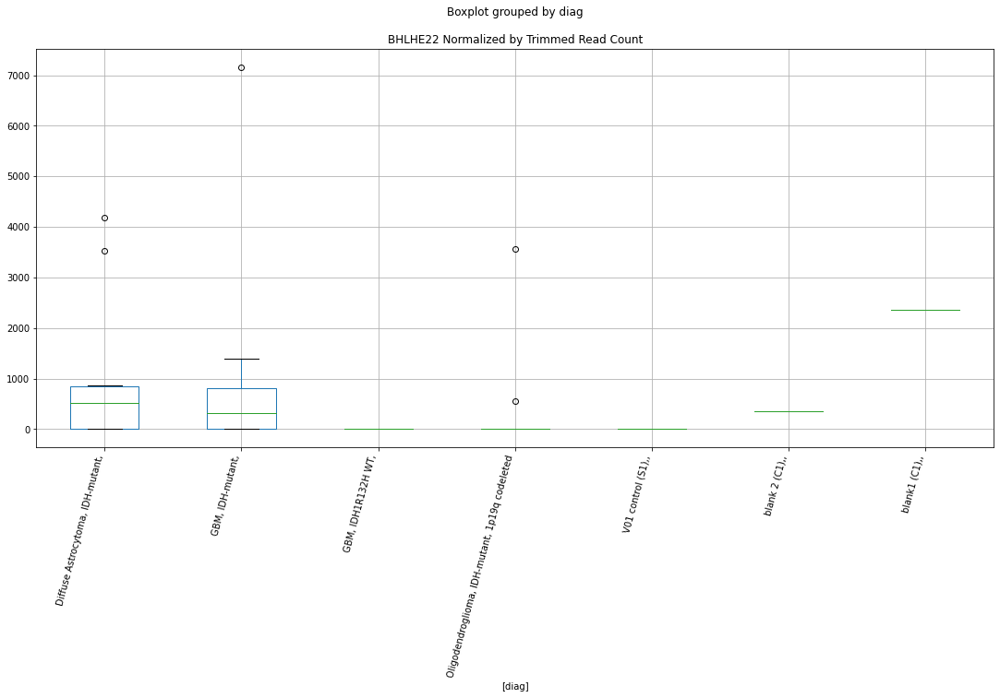

 p : 0.04432853084782268  ( t : 2.1620388811564006 ) :  Lexogen  :  bbduk2  :  AXIN1
Control and blanks
79       0.00
343    424.63
Name: AXIN1, dtype: float64
211    9839.03
Name: AXIN1, dtype: float64
475    0.0
Name: AXIN1, dtype: float64


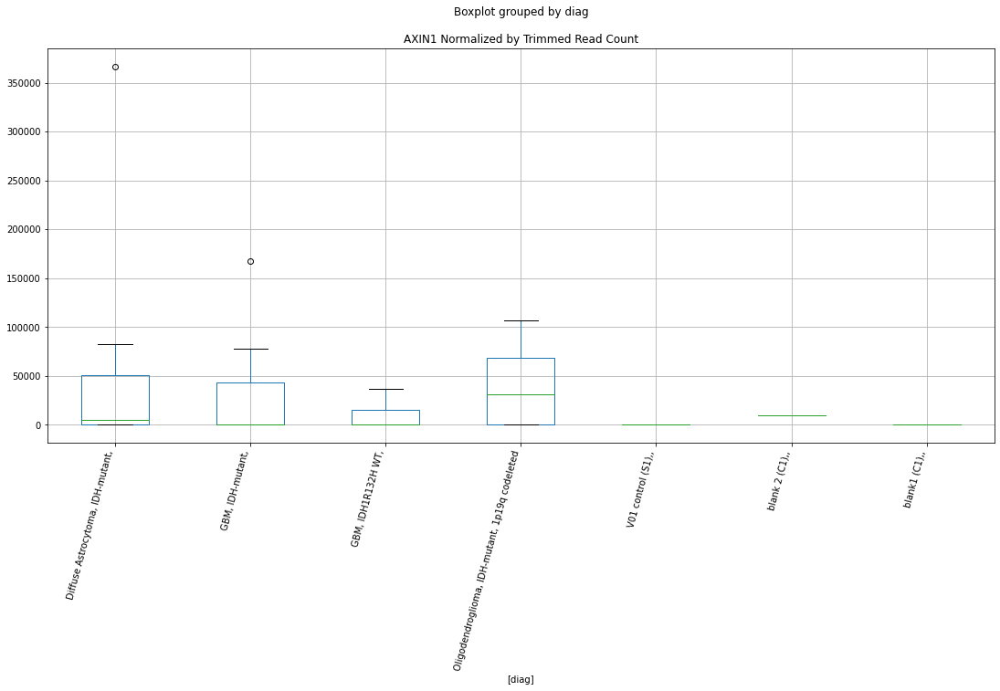

 p : 0.04434679824578348  ( t : 2.1618308218738225 ) :  D-plex  :  bbduk2  :  CCDC136
Control and blanks
73     45607.50
337    16022.83
Name: CCDC136, dtype: float64
205    28654.55
Name: CCDC136, dtype: float64
469    39632.33
Name: CCDC136, dtype: float64


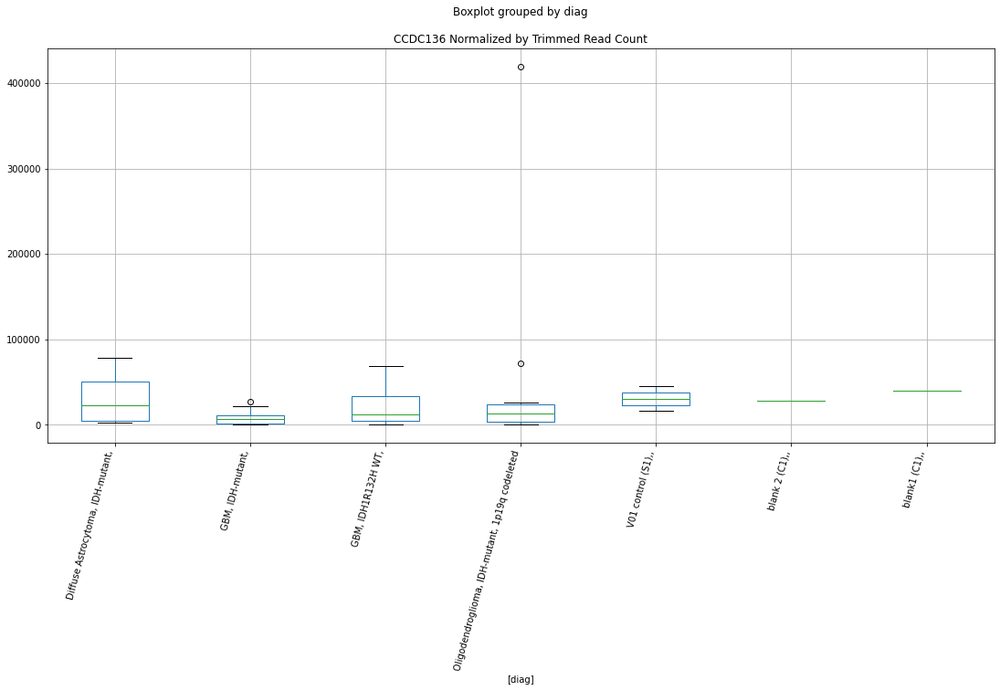

 p : 0.04435391463724361  ( t : 2.1617497898818883 ) :  Lexogen  :  cutadapt2  :  ATG4B
Control and blanks
82         0.00
346    45664.29
Name: ATG4B, dtype: float64
214    1356.13
Name: ATG4B, dtype: float64
478    0.0
Name: ATG4B, dtype: float64


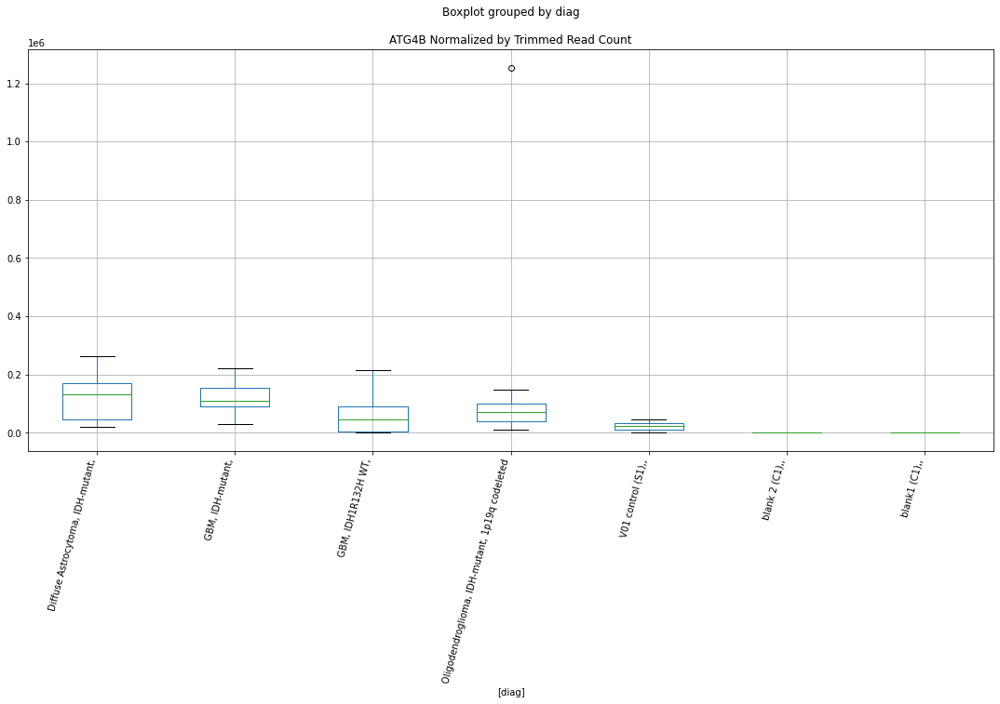

 p : 0.04438651687280646  ( t : 2.1613787110198404 ) :  D-plex  :  bbduk2  :  CCDC57
Control and blanks
73     34785.38
337        0.00
Name: CCDC57, dtype: float64
205    127870.94
Name: CCDC57, dtype: float64
469    23661.09
Name: CCDC57, dtype: float64


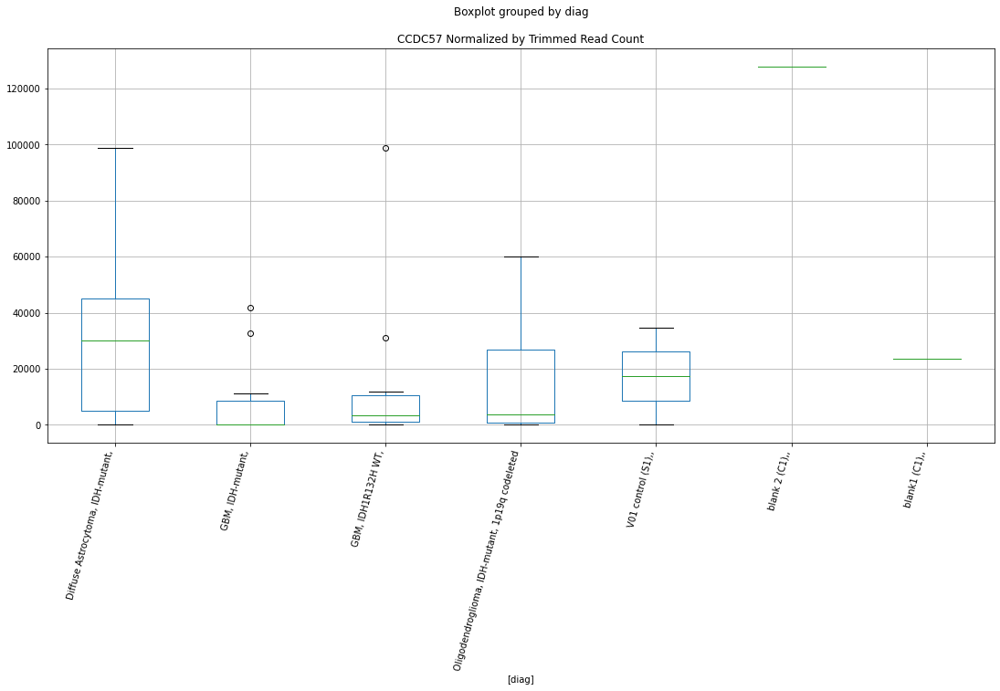

 p : 0.04440630698637855  ( t : 2.161153581410962 ) :  D-plex  :  bbduk2  :  BLOC1S5
Control and blanks
73     129865.41
337         0.00
Name: BLOC1S5, dtype: float64
205    2686.36
Name: BLOC1S5, dtype: float64
469    1774.58
Name: BLOC1S5, dtype: float64


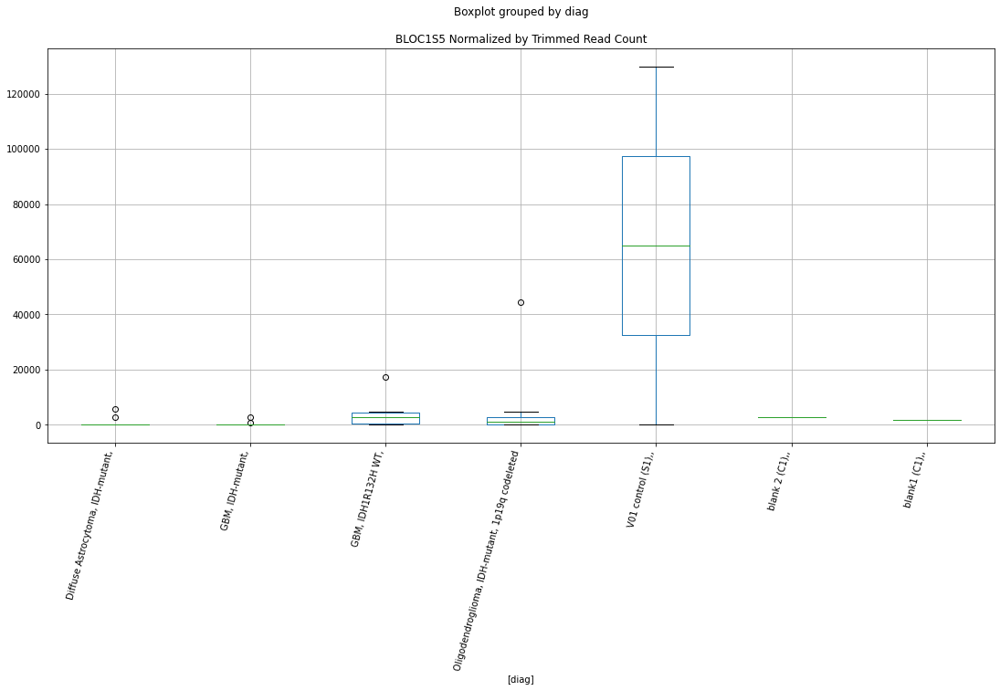

 p : 0.04443386624461881  ( t : 2.1608402239330027 ) :  D-plex  :  bbduk2  :  CLYBL
Control and blanks
73     115951.26
337    110379.50
Name: CLYBL, dtype: float64
205    77188.2
Name: CLYBL, dtype: float64
469    10647.49
Name: CLYBL, dtype: float64


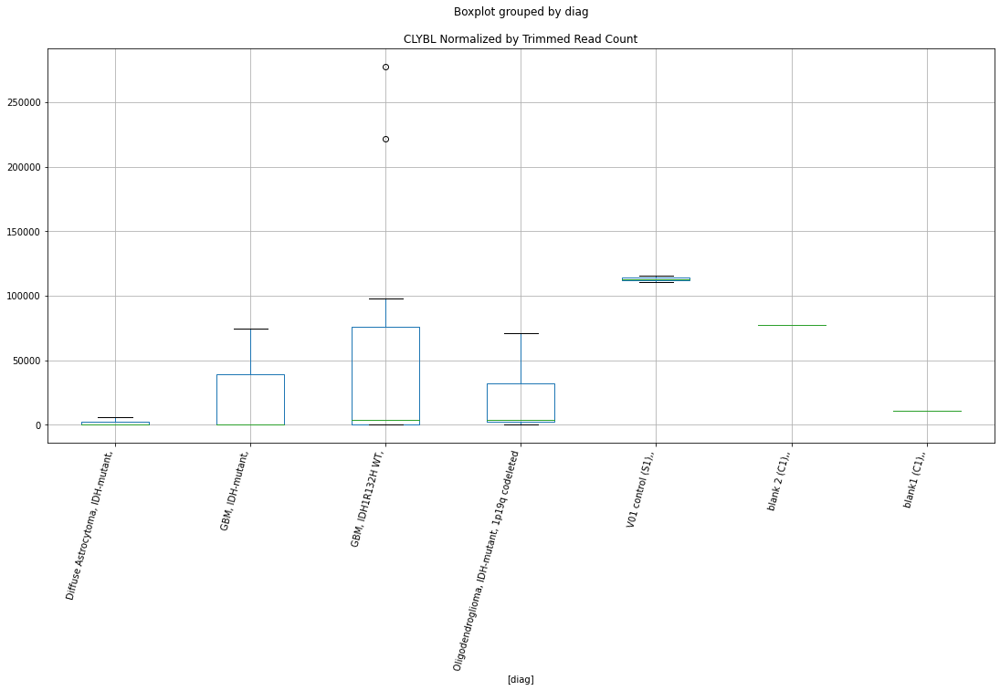

 p : 0.044462227138465885  ( t : 2.1605179371677528 ) :  D-plex  :  bbduk2  :  DLX4
Control and blanks
73         0.00
337    32045.66
Name: DLX4, dtype: float64
205    2149.09
Name: DLX4, dtype: float64
469    591.53
Name: DLX4, dtype: float64


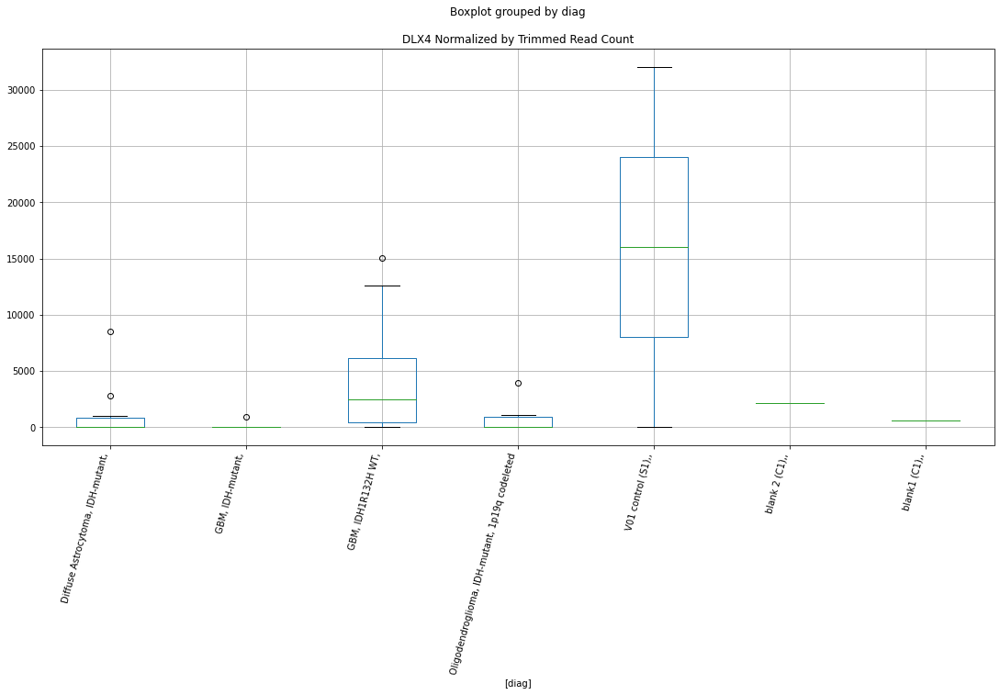

 p : 0.04447294028774627  ( t : 2.1603962442998603 ) :  Lexogen  :  cutadapt2  :  CYGB
Control and blanks
82     0.0
346    0.0
Name: CYGB, dtype: float64
214    0.0
Name: CYGB, dtype: float64
478    0.0
Name: CYGB, dtype: float64


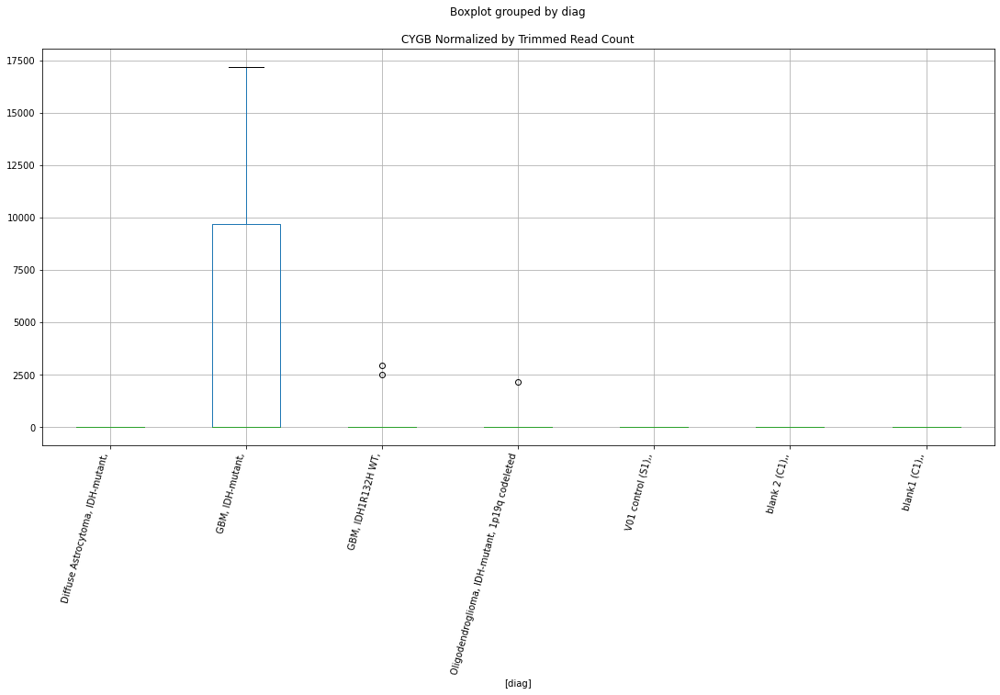

 p : 0.04448697940230495  ( t : 2.160236811695089 ) :  Lexogen  :  bbduk2  :  C1orf100
Control and blanks
79     0.0
343    0.0
Name: C1orf100, dtype: float64
211    32796.76
Name: C1orf100, dtype: float64
475    0.0
Name: C1orf100, dtype: float64


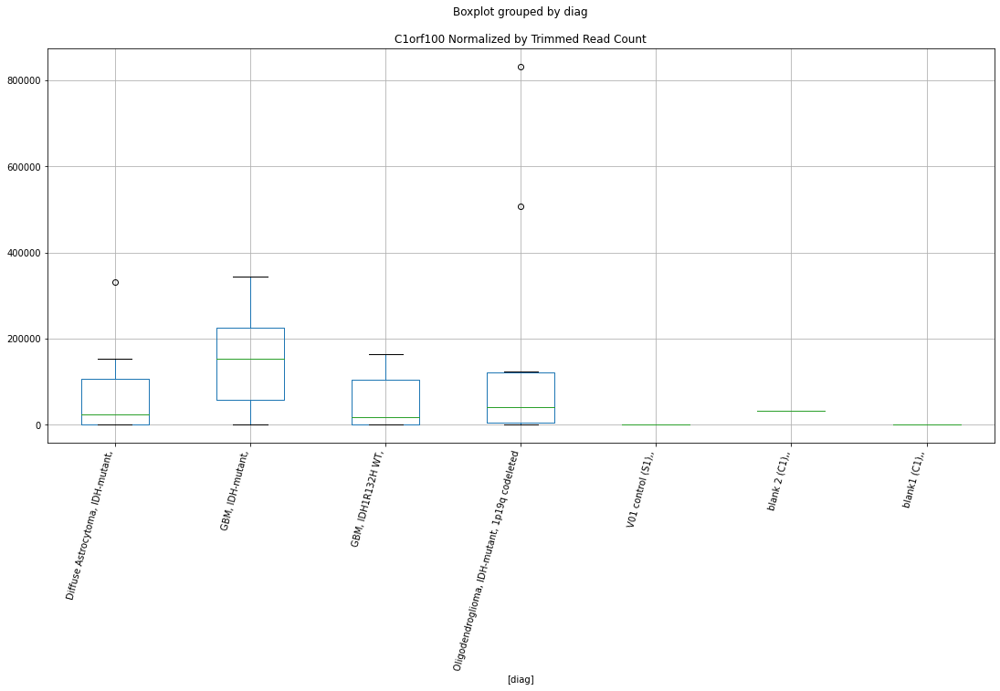

 p : 0.044507941273208784  ( t : 2.1599988477252796 ) :  Lexogen  :  bbduk2  :  ANKRD60
Control and blanks
79     0.0
343    0.0
Name: ANKRD60, dtype: float64
211    0.0
Name: ANKRD60, dtype: float64
475    0.0
Name: ANKRD60, dtype: float64


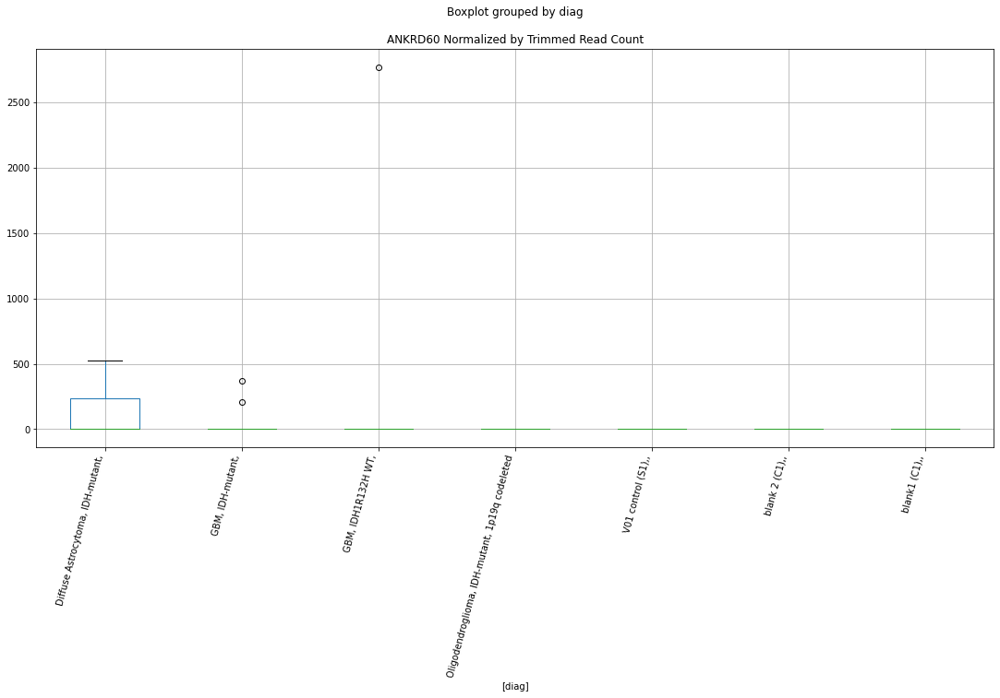

 p : 0.044556408746579027  ( t : 2.159449026129021 ) :  Lexogen  :  cutadapt2  :  ADRB1
Control and blanks
82      1420.05
346    23358.23
Name: ADRB1, dtype: float64
214    22783.02
Name: ADRB1, dtype: float64
478    23033.67
Name: ADRB1, dtype: float64


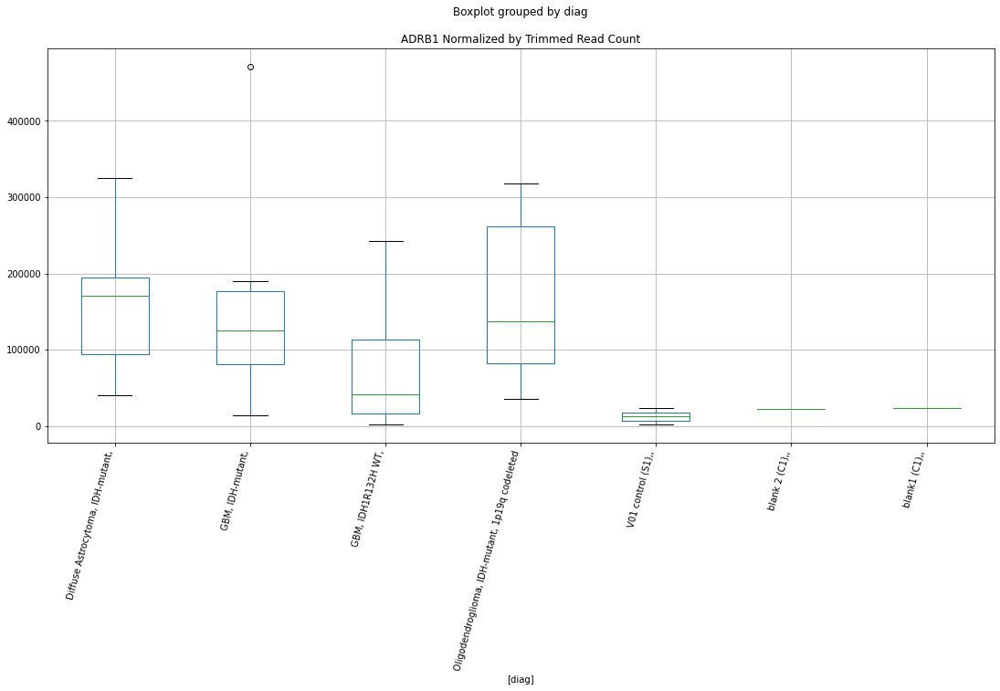

 p : 0.044558755293212286  ( t : 2.1594224204710746 ) :  D-plex  :  cutadapt2  :  COL11A1
Control and blanks
76     18182.74
340    21137.57
Name: COL11A1, dtype: float64
208    55200.75
Name: COL11A1, dtype: float64
472    78601.99
Name: COL11A1, dtype: float64


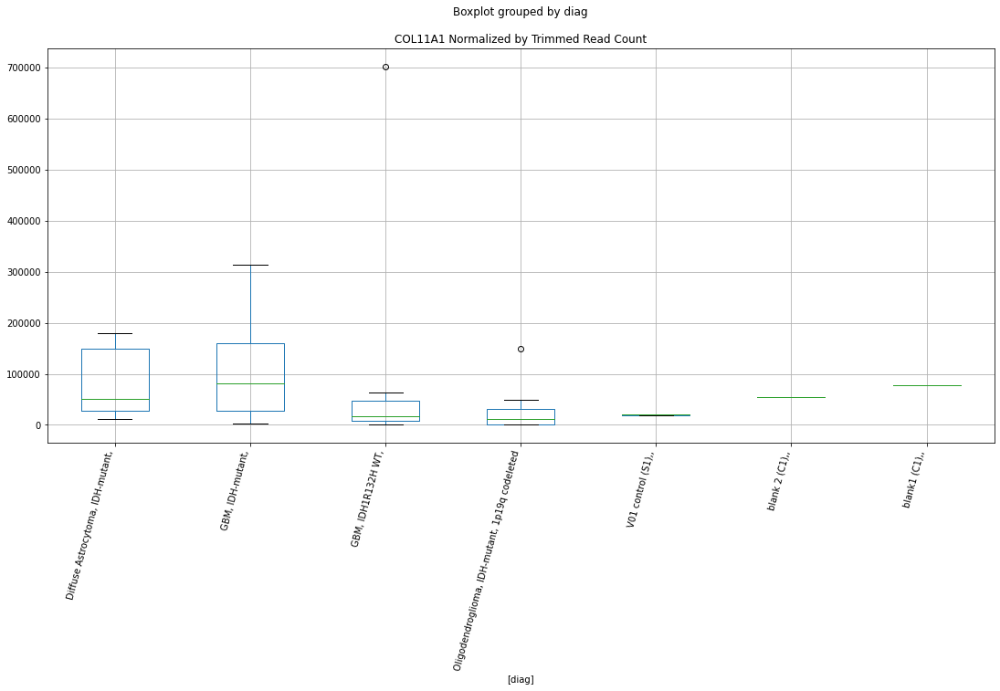

 p : 0.044575685825960845  ( t : 2.159230496364072 ) :  Lexogen  :  bbduk2  :  C10orf82
Control and blanks
79        0.00
343    2760.09
Name: C10orf82, dtype: float64
211    0.0
Name: C10orf82, dtype: float64
475    0.0
Name: C10orf82, dtype: float64


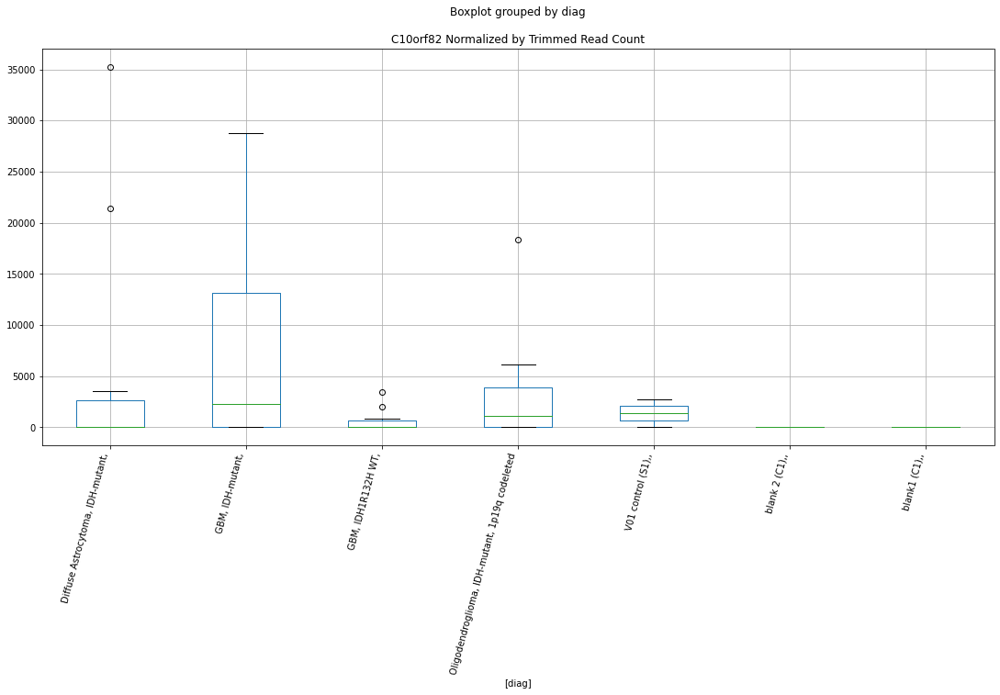

 p : 0.04457569748305775  ( t : 2.159230364242475 ) :  D-plex  :  bbduk2  :  CHDH
Control and blanks
73     347853.78
337         0.00
Name: CHDH, dtype: float64
205    57130.01
Name: CHDH, dtype: float64
469    14196.66
Name: CHDH, dtype: float64


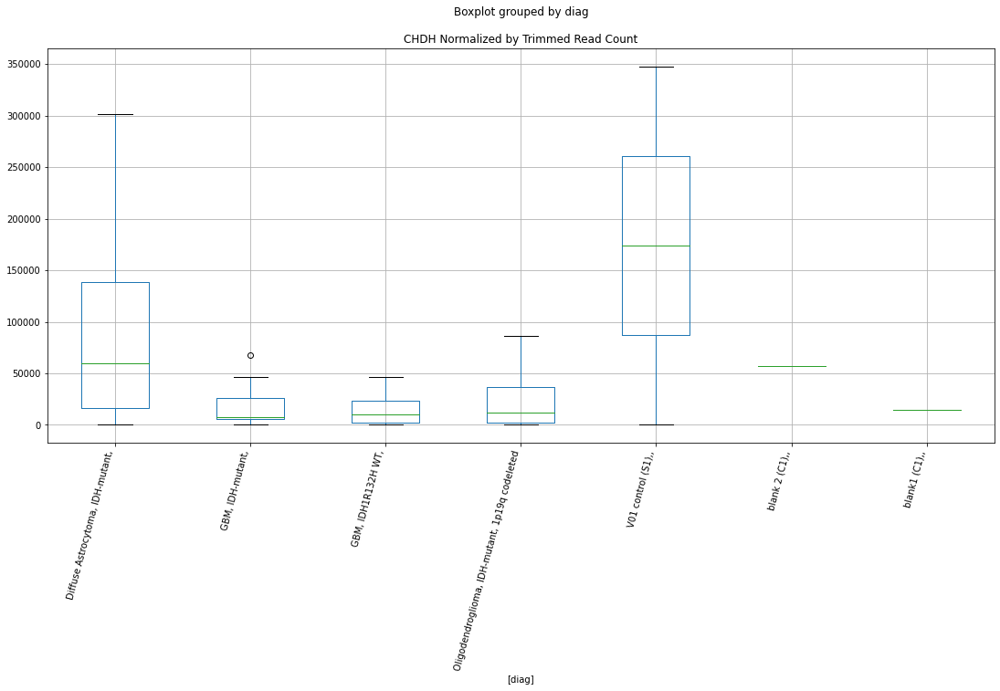

 p : 0.04463545154658961  ( t : 2.158553526256526 ) :  Lexogen  :  bbduk2  :  CYGB
Control and blanks
79     0.0
343    0.0
Name: CYGB, dtype: float64
211    0.0
Name: CYGB, dtype: float64
475    0.0
Name: CYGB, dtype: float64


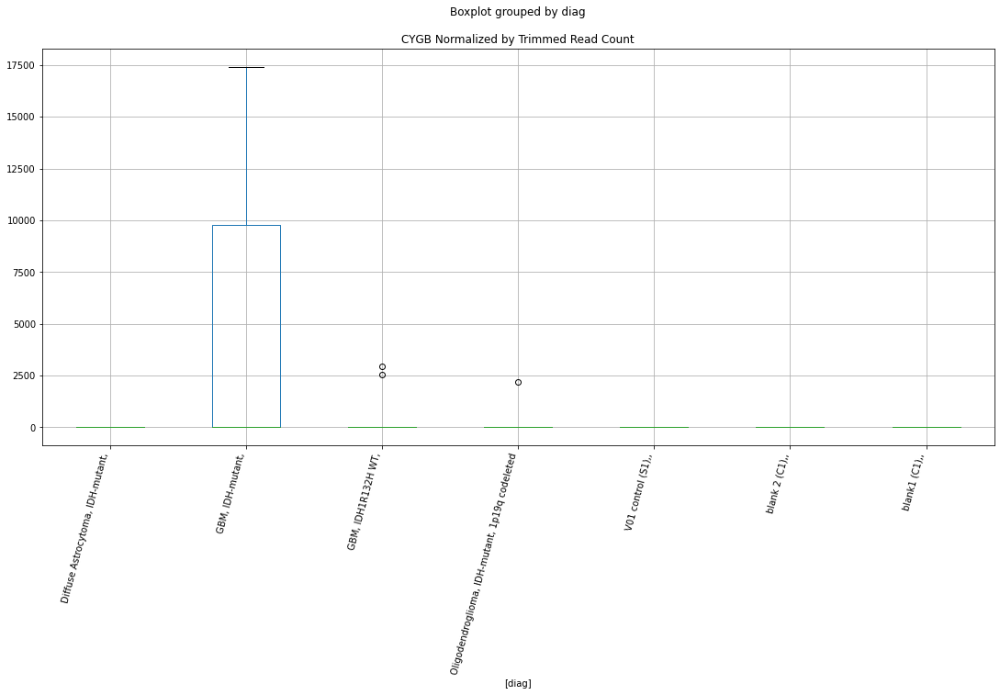

 p : 0.04468318378566897  ( t : 2.1580134553132435 ) :  D-plex  :  bbduk2  :  CACNA1H
Control and blanks
73     81165.88
337      890.16
Name: CACNA1H, dtype: float64
205    18804.55
Name: CACNA1H, dtype: float64
469    21886.51
Name: CACNA1H, dtype: float64


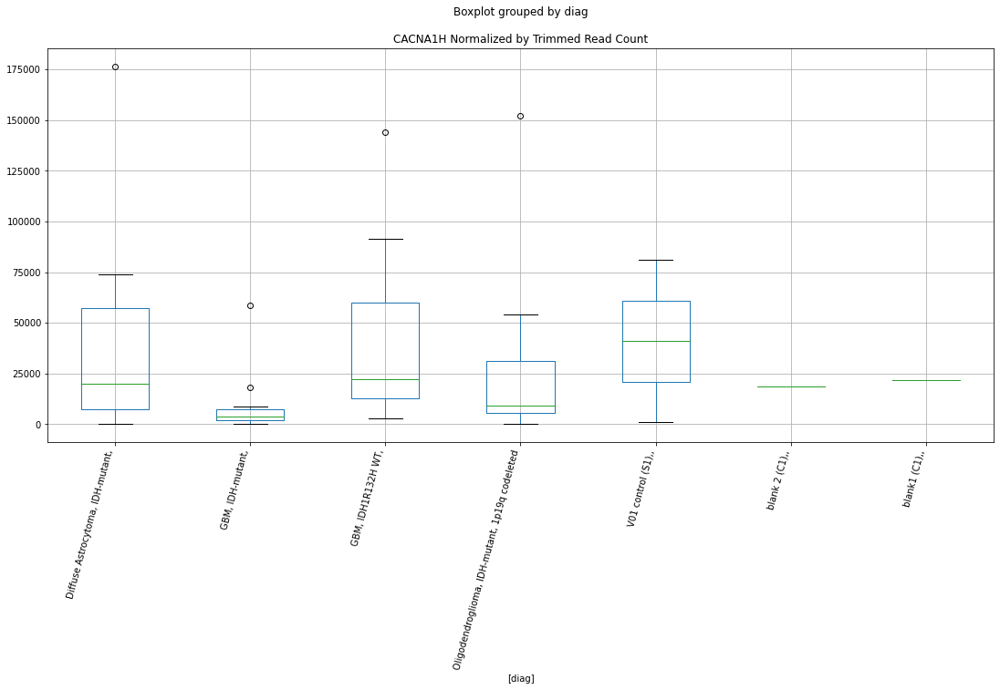

 p : 0.04468534378905087  ( t : 2.157989028230014 ) :  D-plex  :  bbduk2  :  C18orf25
Control and blanks
73      3092.03
337    37386.61
Name: C18orf25, dtype: float64
205    3581.82
Name: C18orf25, dtype: float64
469    5915.27
Name: C18orf25, dtype: float64


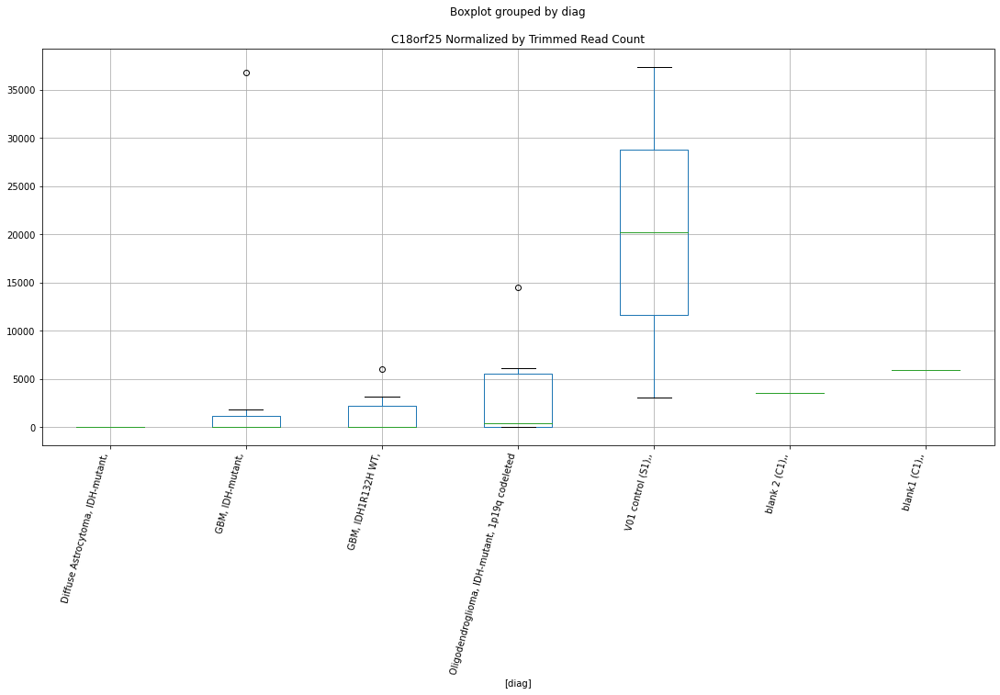

 p : 0.04469753651530014  ( t : 2.1578511631655393 ) :  D-plex  :  bbduk2  :  DDX19B
Control and blanks
73     0.0
337    0.0
Name: DDX19B, dtype: float64
205    2149.09
Name: DDX19B, dtype: float64
469    0.0
Name: DDX19B, dtype: float64


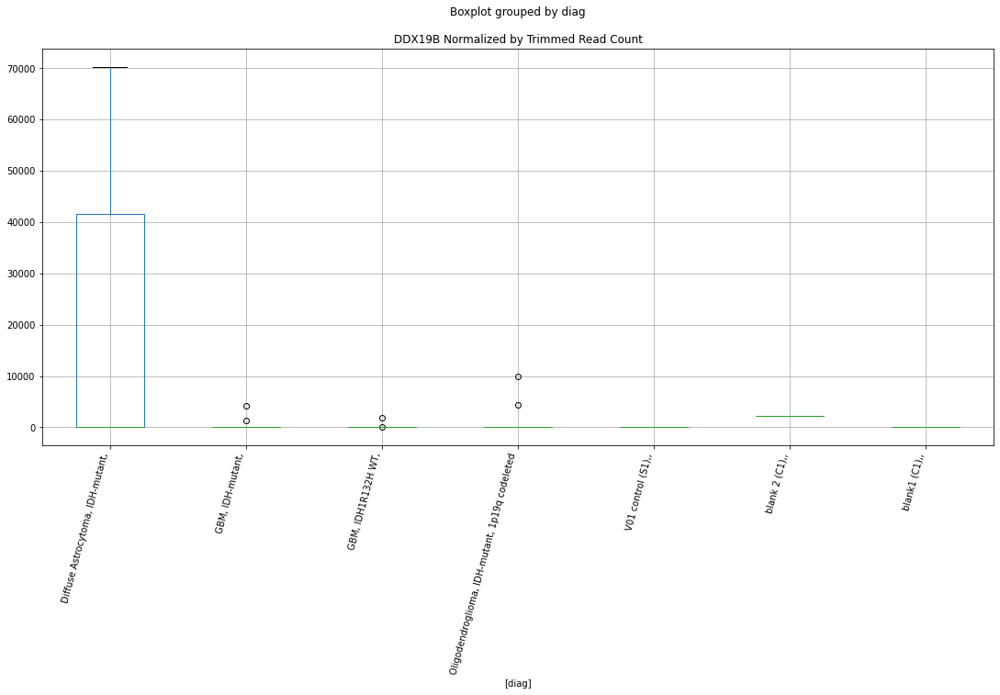

 p : 0.04470429861706676  ( t : 2.1577747178471056 ) :  Lexogen  :  cutadapt2  :  C1orf100
Control and blanks
82     0.0
346    0.0
Name: C1orf100, dtype: float64
214    32547.17
Name: C1orf100, dtype: float64
478    0.0
Name: C1orf100, dtype: float64


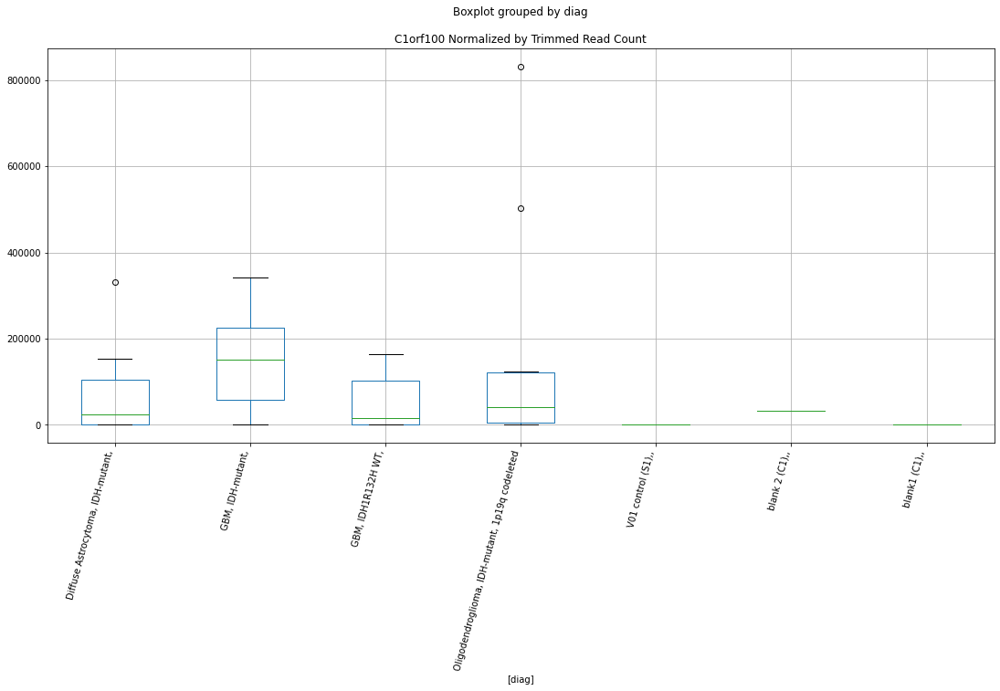

 p : 0.0447256105199508  ( t : 2.1575338567084463 ) :  D-plex  :  cutadapt2  :  B4GALT6
Control and blanks
76         0.00
340    10568.79
Name: B4GALT6, dtype: float64
208    1939.96
Name: B4GALT6, dtype: float64
472    4045.69
Name: B4GALT6, dtype: float64


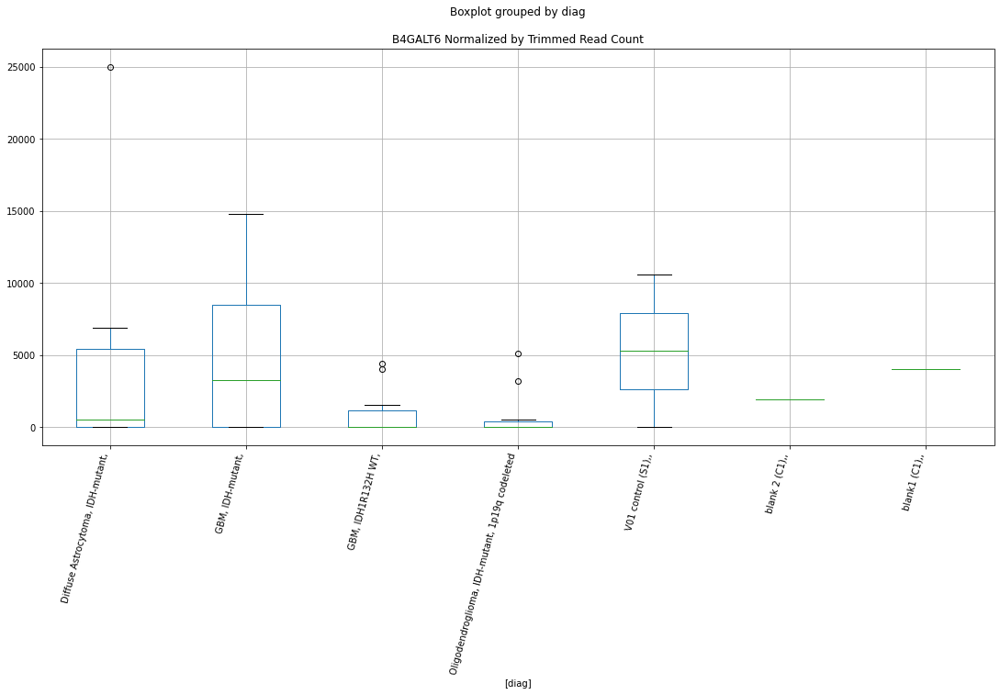

 p : 0.044792100435265866  ( t : 2.1567830802575463 ) :  D-plex  :  bbduk2  :  COG6
Control and blanks
73        0.00
337    3560.63
Name: COG6, dtype: float64
205    6984.55
Name: COG6, dtype: float64
469    10055.96
Name: COG6, dtype: float64


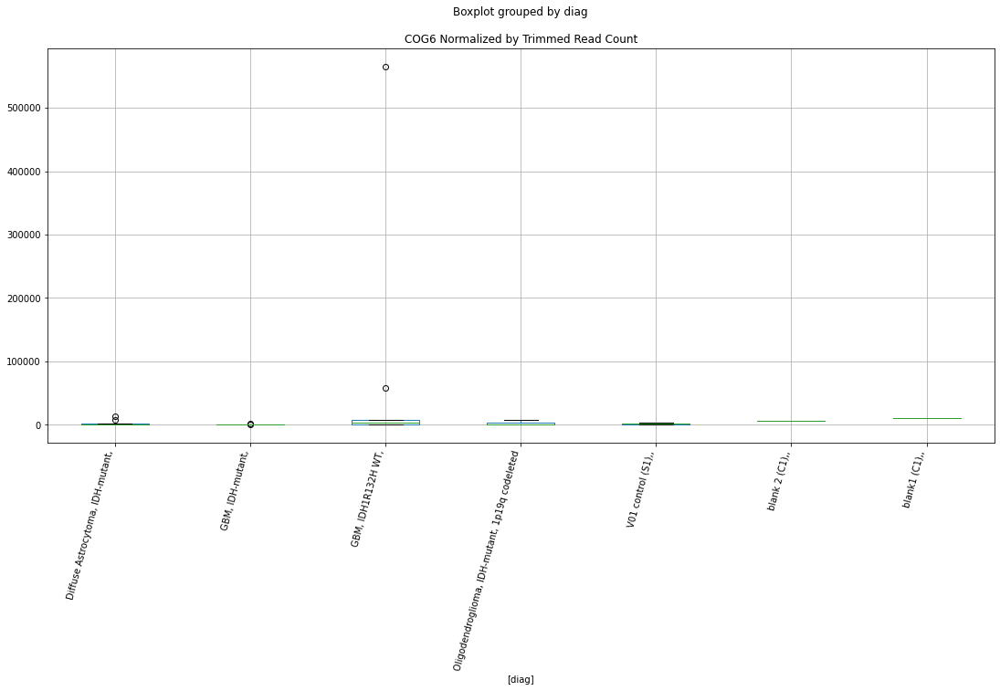

 p : 0.04493423029702791  ( t : 2.155181620236338 ) :  D-plex  :  cutadapt2  :  ADSL
Control and blanks
76     10606.6
340        0.0
Name: ADSL, dtype: float64
208    4938.09
Name: ADSL, dtype: float64
472    0.0
Name: ADSL, dtype: float64


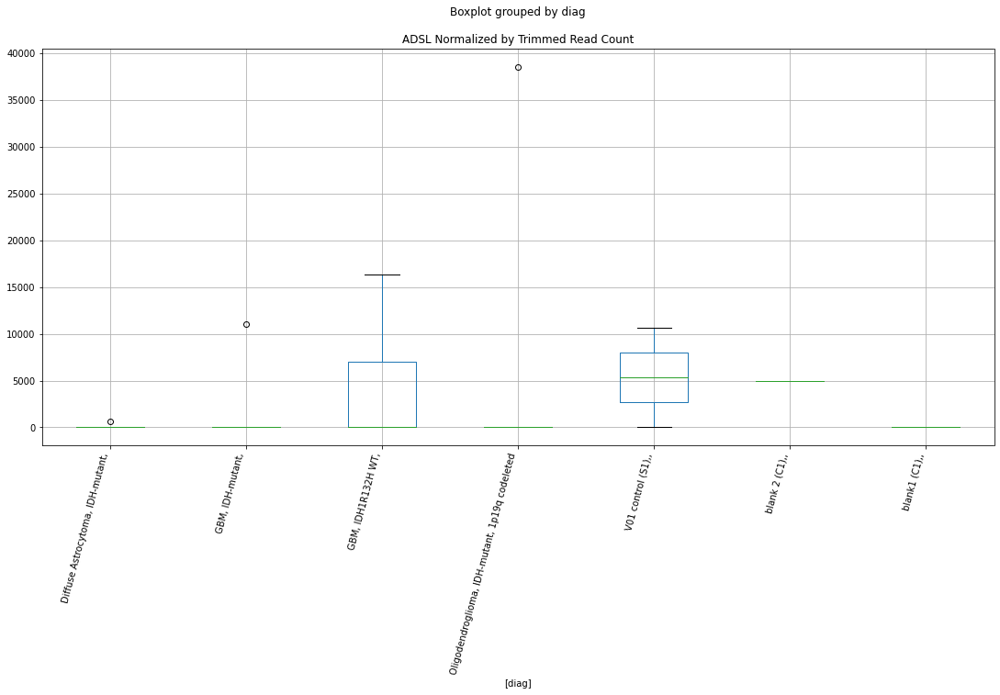

 p : 0.04496705037939049  ( t : 2.154812475481485 ) :  Lexogen  :  bbduk2  :  COMMD10
Control and blanks
79     0.0
343    0.0
Name: COMMD10, dtype: float64
211    819.92
Name: COMMD10, dtype: float64
475    0.0
Name: COMMD10, dtype: float64


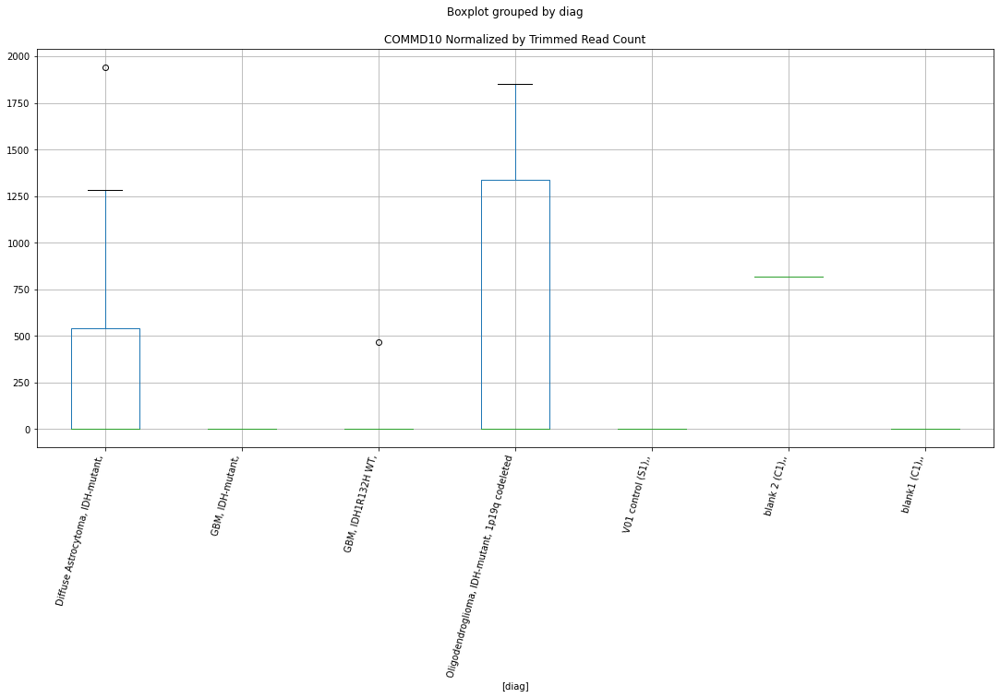

 p : 0.04497861208443013  ( t : 2.1546824935597795 ) :  Lexogen  :  bbduk2  :  CELF4
Control and blanks
79     0.0
343    0.0
Name: CELF4, dtype: float64
211    0.0
Name: CELF4, dtype: float64
475    0.0
Name: CELF4, dtype: float64


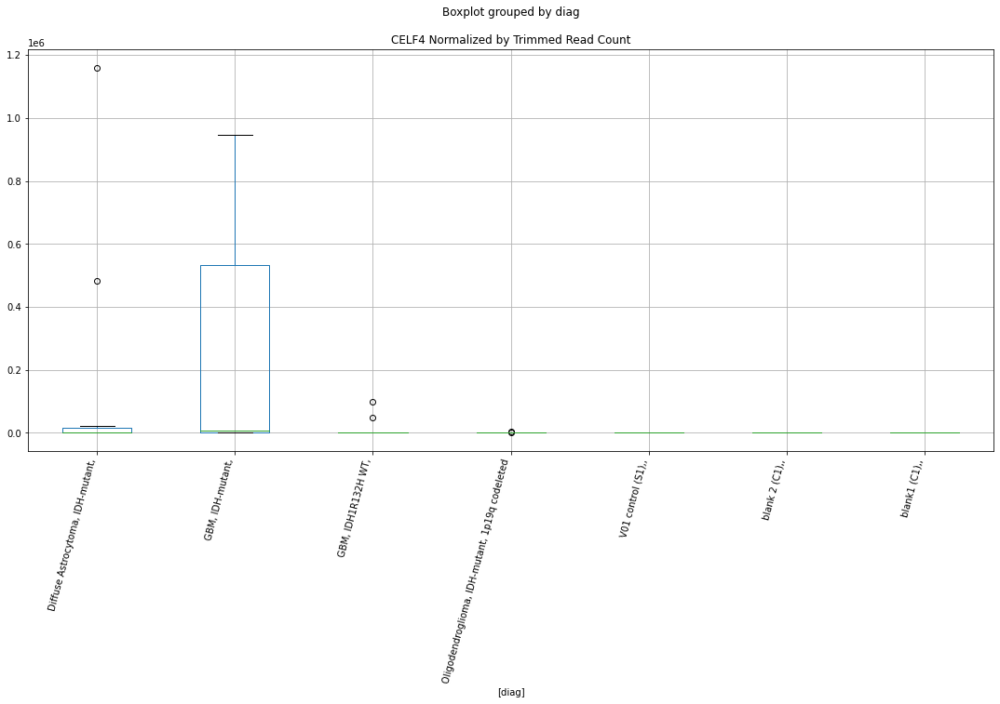

 p : 0.04498574539933824  ( t : 2.154602312839624 ) :  D-plex  :  cutadapt2  :  ADGRB1
Control and blanks
76     13637.06
340        0.00
Name: ADGRB1, dtype: float64
208    2645.4
Name: ADGRB1, dtype: float64
472    20806.41
Name: ADGRB1, dtype: float64


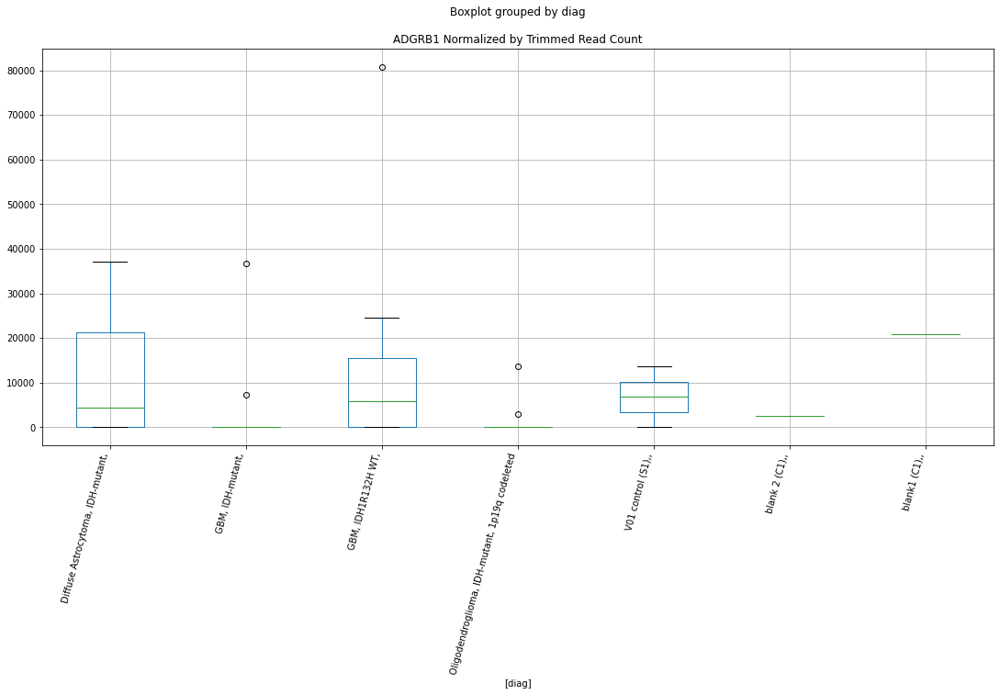

 p : 0.0450278501644531  ( t : 2.15412927856946 ) :  D-plex  :  bbduk2  :  AK1
Control and blanks
73     15460.17
337     2670.47
Name: AK1, dtype: float64
205    1970.0
Name: AK1, dtype: float64
469    6506.8
Name: AK1, dtype: float64


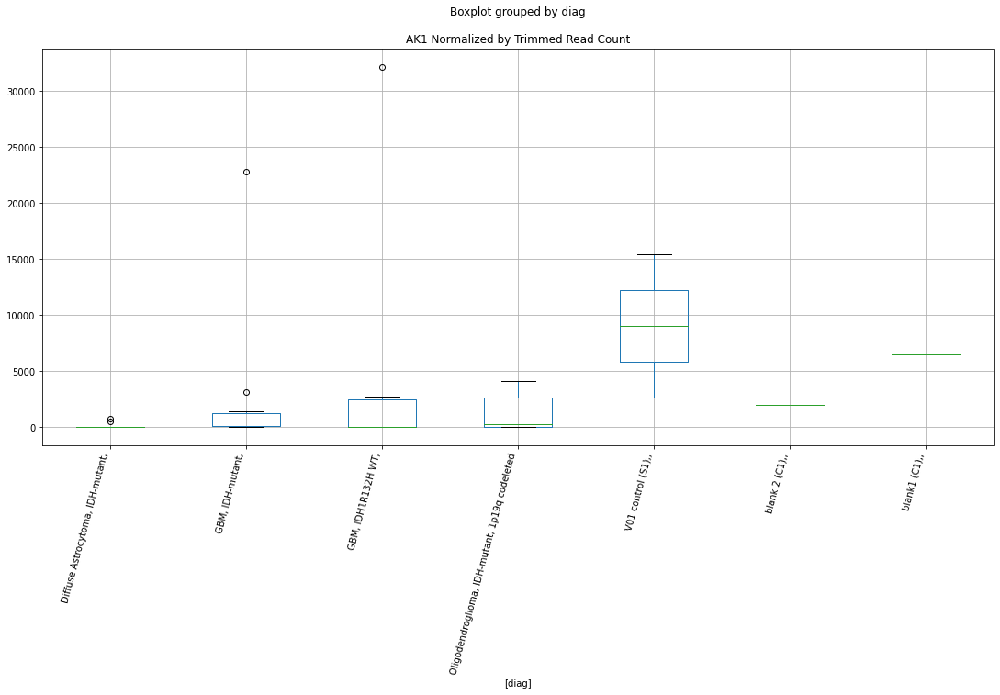

 p : 0.045033795738332986  ( t : 2.154062514432052 ) :  Lexogen  :  bbduk2  :  CYP7B1
Control and blanks
79        0.00
343    3821.66
Name: CYP7B1, dtype: float64
211    0.0
Name: CYP7B1, dtype: float64
475    718.55
Name: CYP7B1, dtype: float64


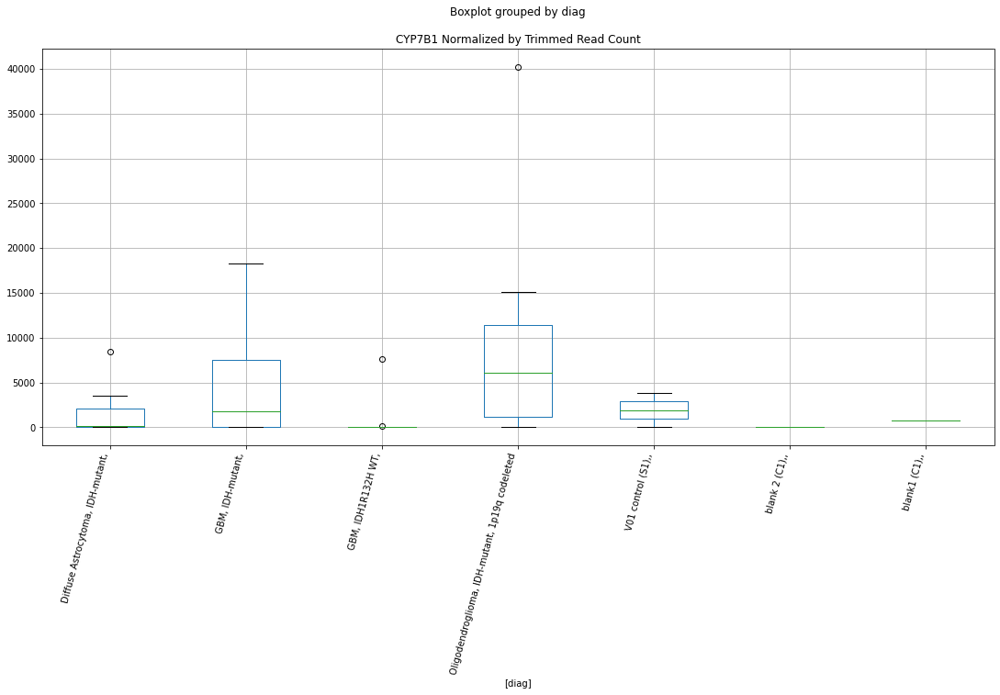

 p : 0.04505278689520883  ( t : 2.1538493125750247 ) :  D-plex  :  bbduk2  :  CDC27P9
Control and blanks
73      3092.03
337    53409.44
Name: CDC27P9, dtype: float64
205    25789.1
Name: CDC27P9, dtype: float64
469    27210.26
Name: CDC27P9, dtype: float64


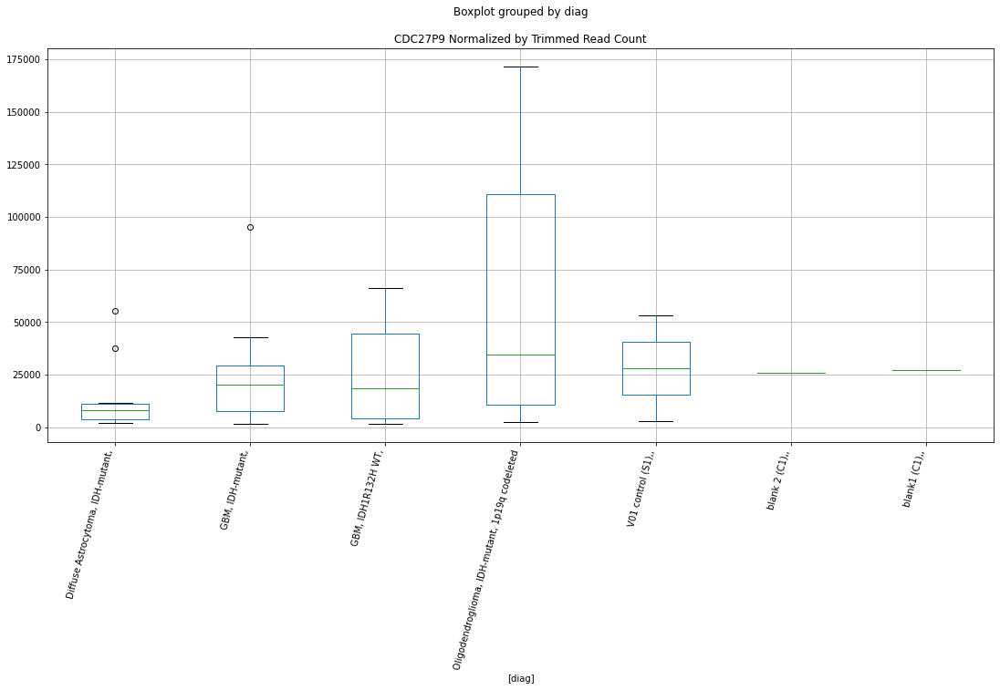

 p : 0.04507775846541042  ( t : 2.1535690973455153 ) :  D-plex  :  bbduk2  :  CSE1L-AS1
Control and blanks
73     0.0
337    0.0
Name: CSE1L-AS1, dtype: float64
205    2507.27
Name: CSE1L-AS1, dtype: float64
469    1183.05
Name: CSE1L-AS1, dtype: float64


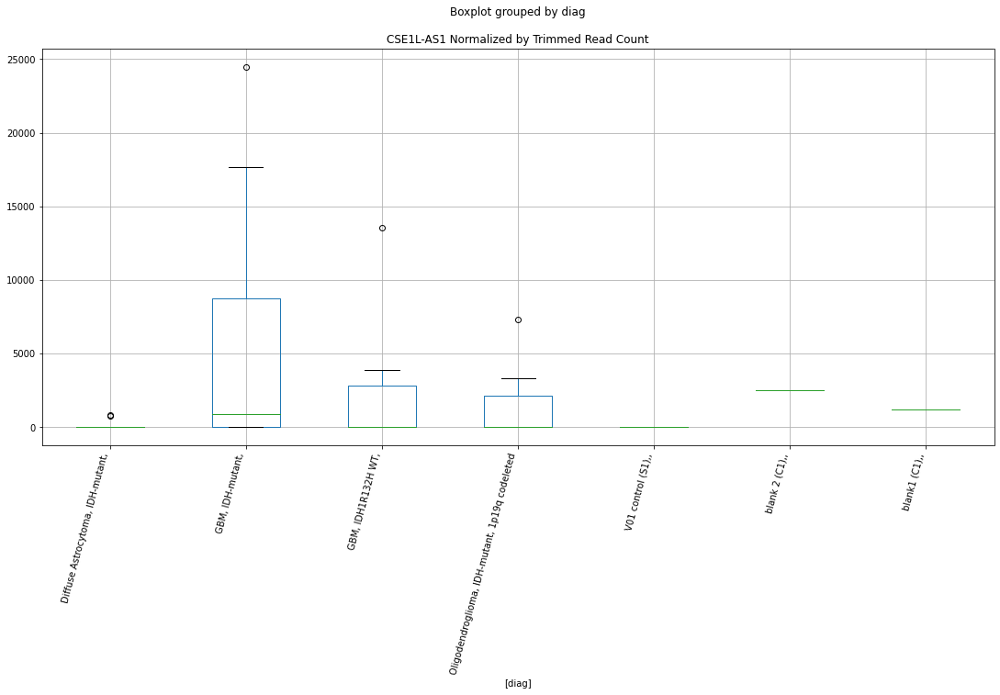

 p : 0.04510640594214396  ( t : 2.153247808111937 ) :  Lexogen  :  bbduk2  :  CDC25B
Control and blanks
79     0.0
343    0.0
Name: CDC25B, dtype: float64
211    0.0
Name: CDC25B, dtype: float64
475    0.0
Name: CDC25B, dtype: float64


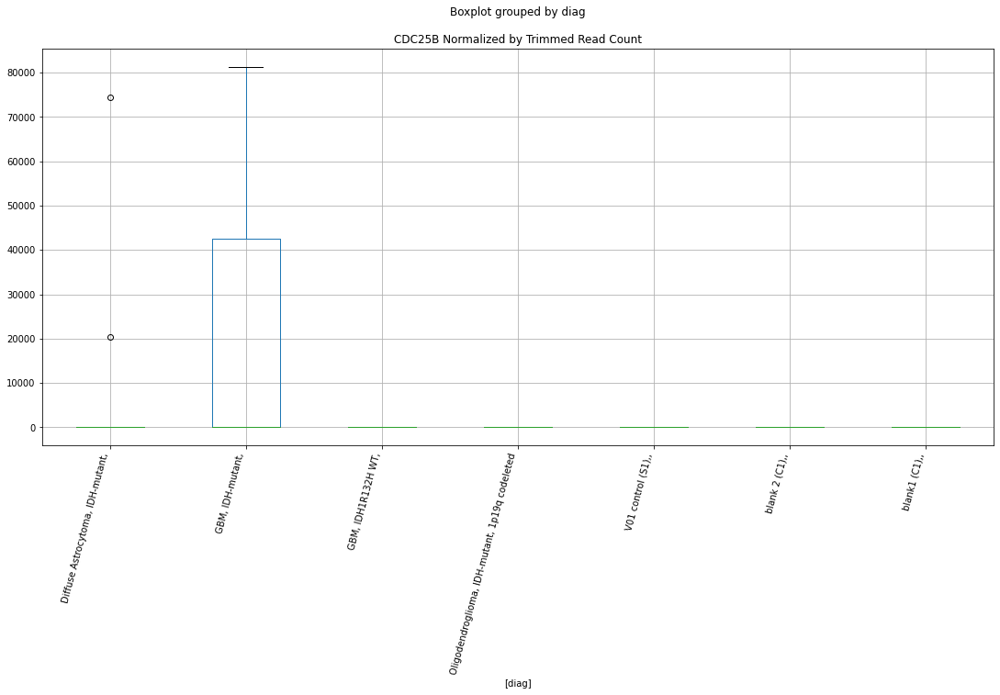

 p : 0.0451137882611468  ( t : 2.153165043623848 ) :  Lexogen  :  cutadapt2  :  ABCC5
Control and blanks
82     0.0
346    0.0
Name: ABCC5, dtype: float64
214    0.0
Name: ABCC5, dtype: float64
478    0.0
Name: ABCC5, dtype: float64


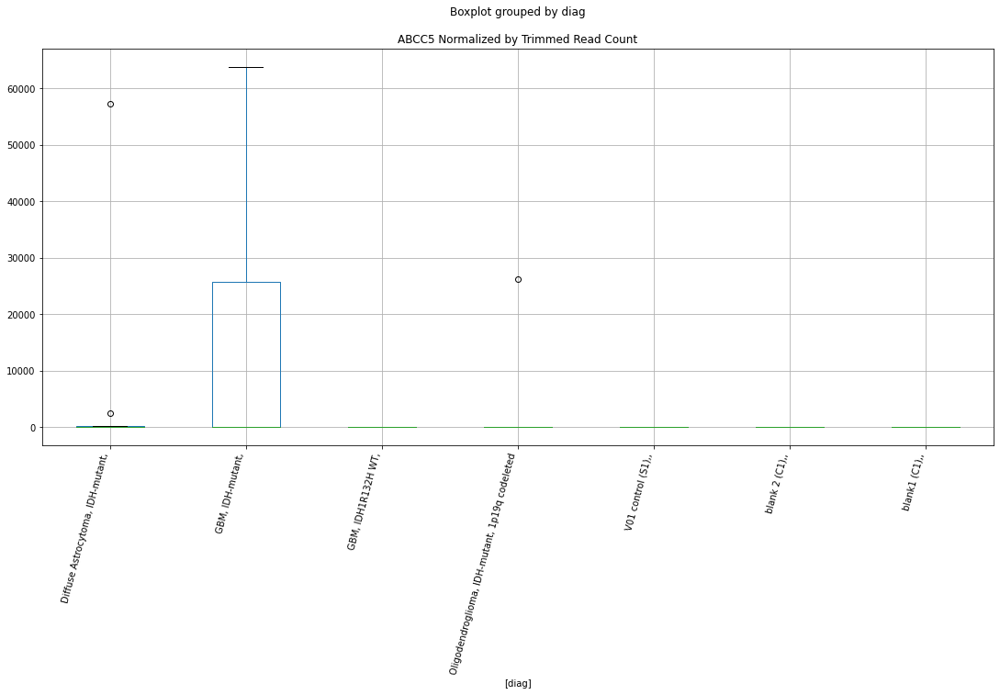

 p : 0.045133284261646416  ( t : 2.1529465300020507 ) :  D-plex  :  bbduk2  :  CCDC157
Control and blanks
73     28601.31
337        0.00
Name: CCDC157, dtype: float64
205    10924.55
Name: CCDC157, dtype: float64
469    35491.64
Name: CCDC157, dtype: float64


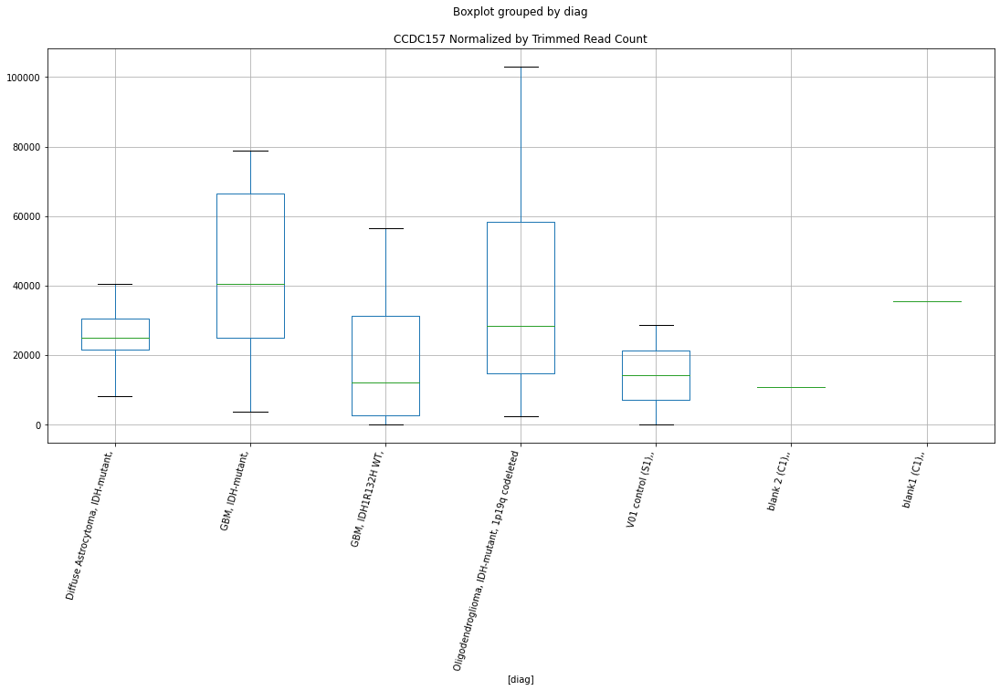

 p : 0.04514256176705547  ( t : 2.1528425768503574 ) :  Lexogen  :  bbduk2  :  CEACAM21
Control and blanks
79     0.0
343    0.0
Name: CEACAM21, dtype: float64
211    0.0
Name: CEACAM21, dtype: float64
475    0.0
Name: CEACAM21, dtype: float64


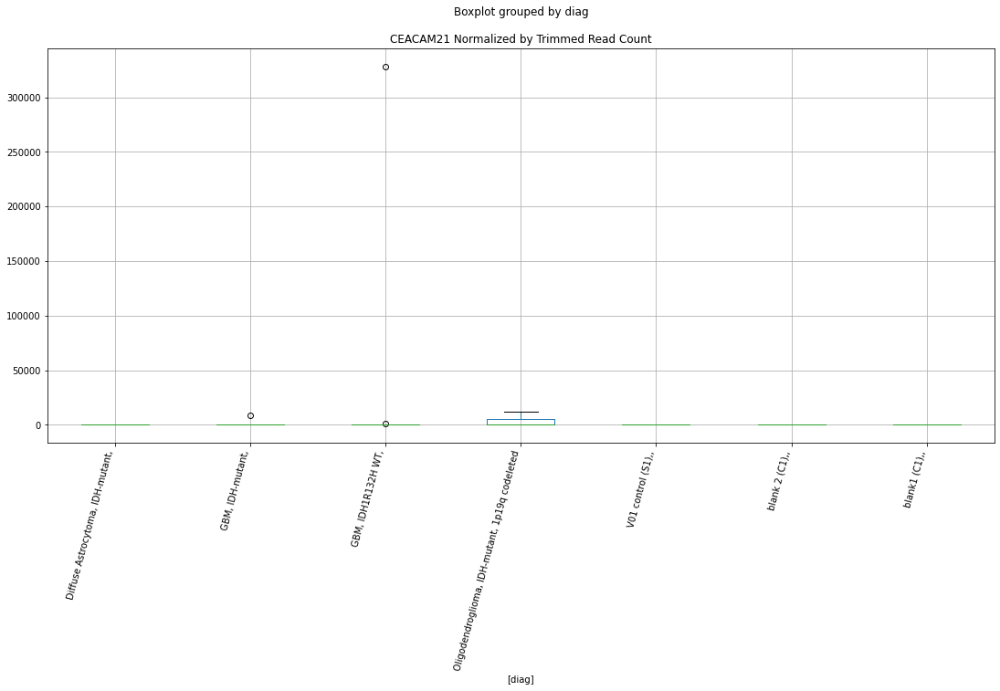

 p : 0.04520587862677298  ( t : 2.15213364120796 ) :  D-plex  :  cutadapt2  :  CDKN2AIPNL
Control and blanks
76     0.0
340    0.0
Name: CDKN2AIPNL, dtype: float64
208    0.0
Name: CDKN2AIPNL, dtype: float64
472    2311.82
Name: CDKN2AIPNL, dtype: float64


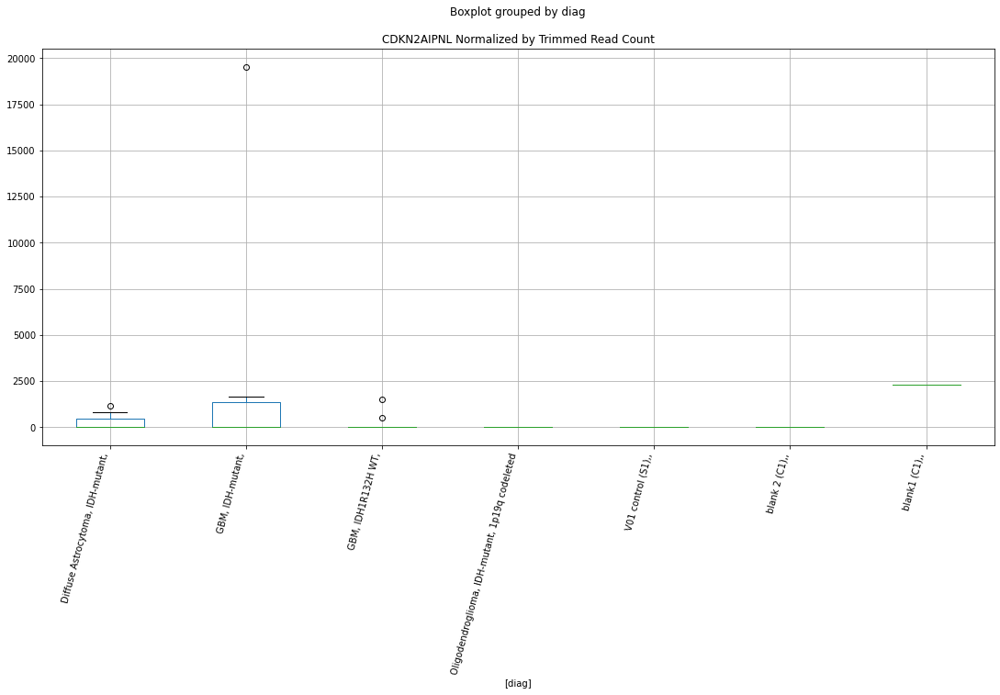

 p : 0.04520751580189482  ( t : 2.152115322397767 ) :  Lexogen  :  cutadapt2  :  CDC25B
Control and blanks
82     0.0
346    0.0
Name: CDC25B, dtype: float64
214    0.0
Name: CDC25B, dtype: float64
478    0.0
Name: CDC25B, dtype: float64


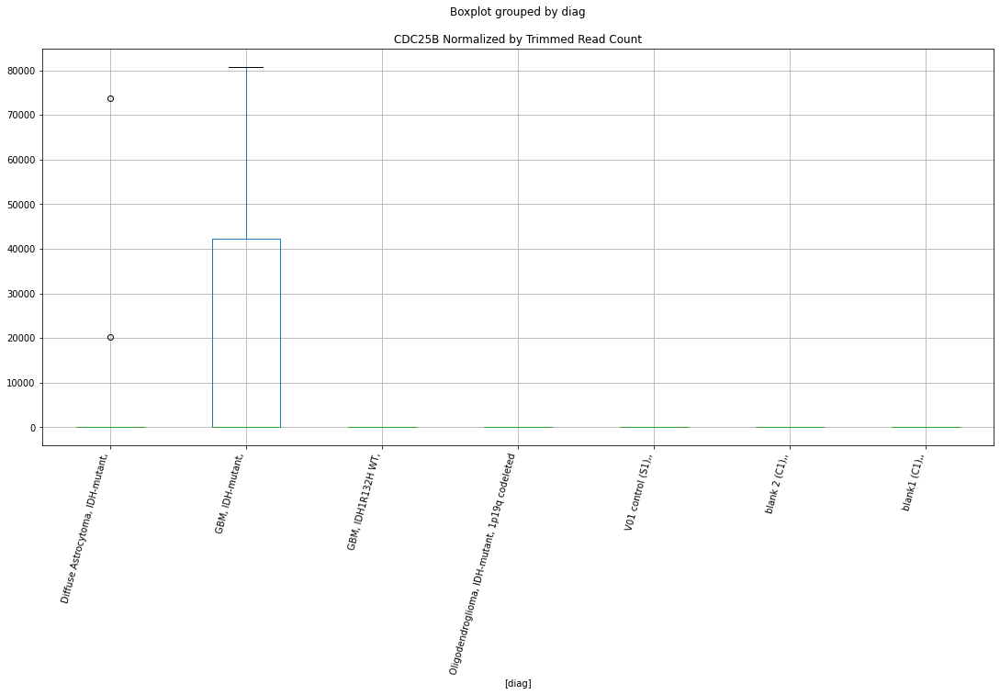

 p : 0.045212563461346826  ( t : 2.1520588465409602 ) :  Lexogen  :  bbduk2  :  CDK4
Control and blanks
79       0.00
343    212.31
Name: CDK4, dtype: float64
211    5192.82
Name: CDK4, dtype: float64
475    239.52
Name: CDK4, dtype: float64


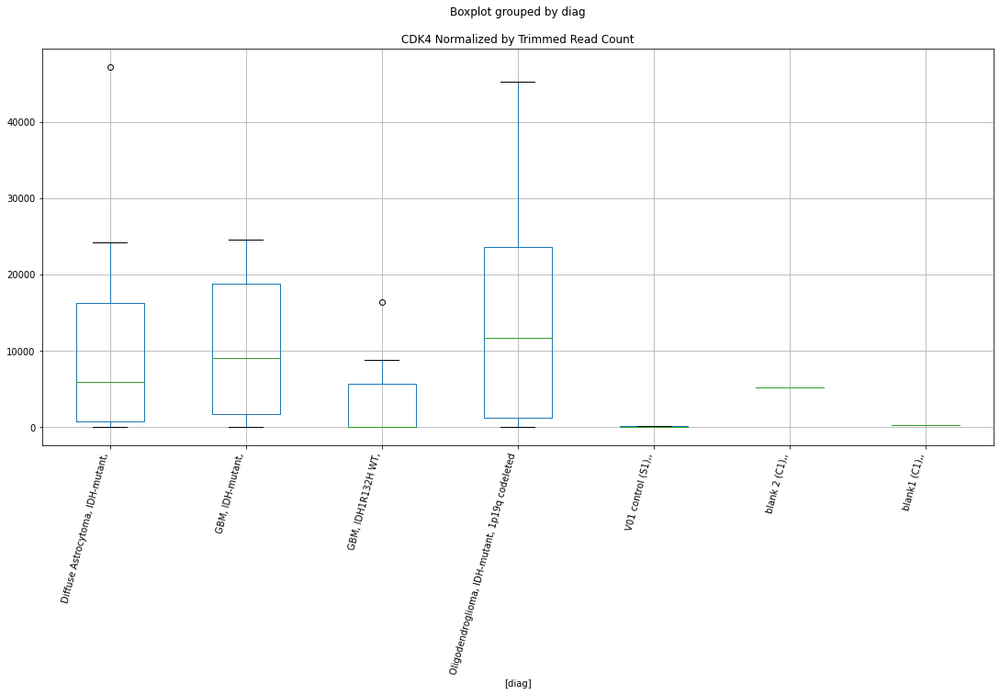

 p : 0.04522450357314549  ( t : 2.1519252772520163 ) :  D-plex  :  bbduk2  :  AP2S1
Control and blanks
73     0.0
337    0.0
Name: AP2S1, dtype: float64
205    1790.91
Name: AP2S1, dtype: float64
469    5915.27
Name: AP2S1, dtype: float64


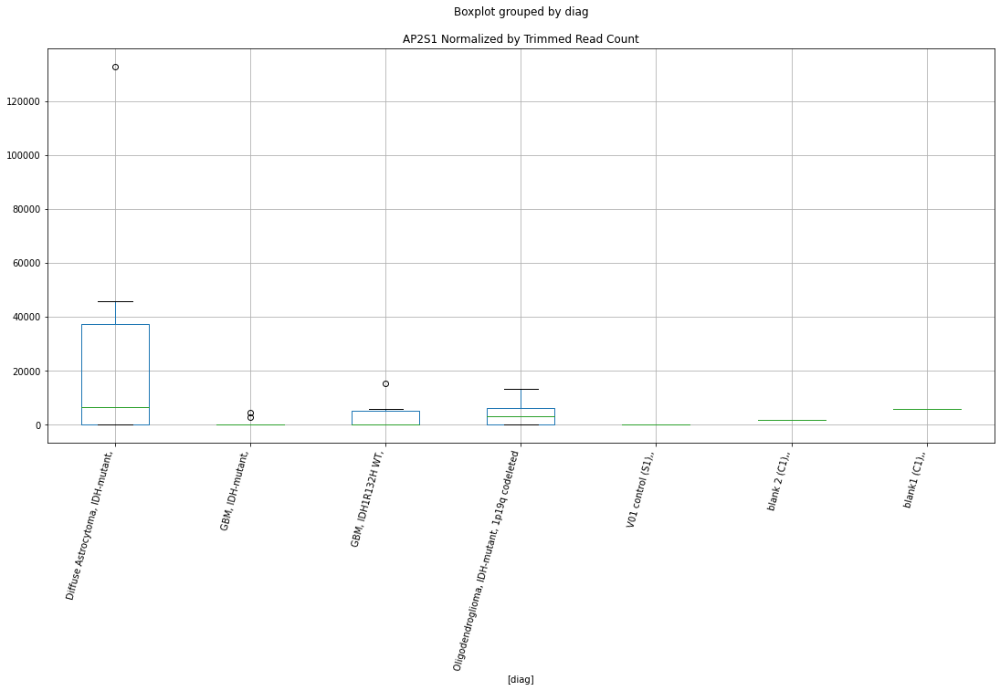

 p : 0.045283550589019506  ( t : 2.1512652151300644 ) :  D-plex  :  cutadapt2  :  ARL10
Control and blanks
76     757.61
340      0.00
Name: ARL10, dtype: float64
208    705.44
Name: ARL10, dtype: float64
472    1733.87
Name: ARL10, dtype: float64


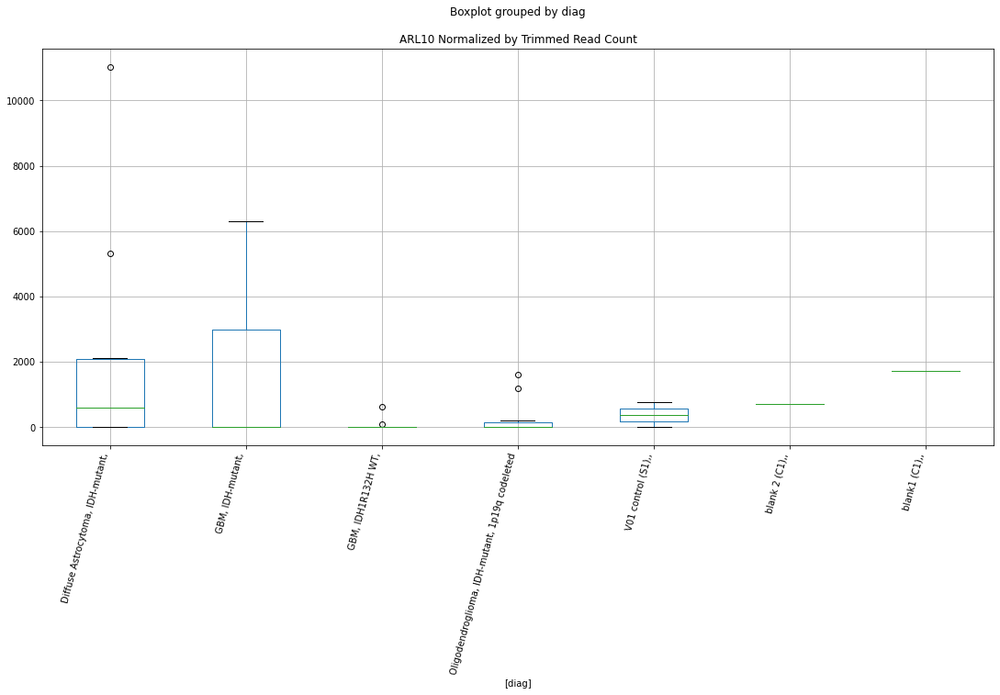

 p : 0.045285893776999354  ( t : 2.151239037831616 ) :  D-plex  :  cutadapt2  :  BCCIP
Control and blanks
76     0.0
340    0.0
Name: BCCIP, dtype: float64
208    176.36
Name: BCCIP, dtype: float64
472    0.0
Name: BCCIP, dtype: float64


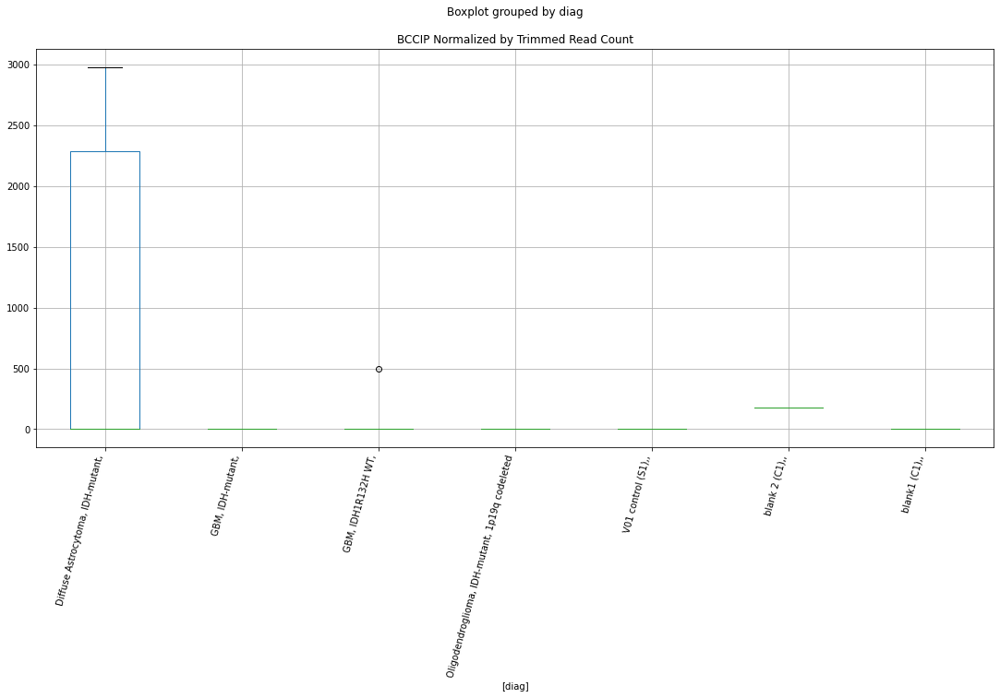

 p : 0.04530193223161805  ( t : 2.1510598948998574 ) :  D-plex  :  bbduk2  :  BCCIP
Control and blanks
73     0.0
337    0.0
Name: BCCIP, dtype: float64
205    0.0
Name: BCCIP, dtype: float64
469    0.0
Name: BCCIP, dtype: float64


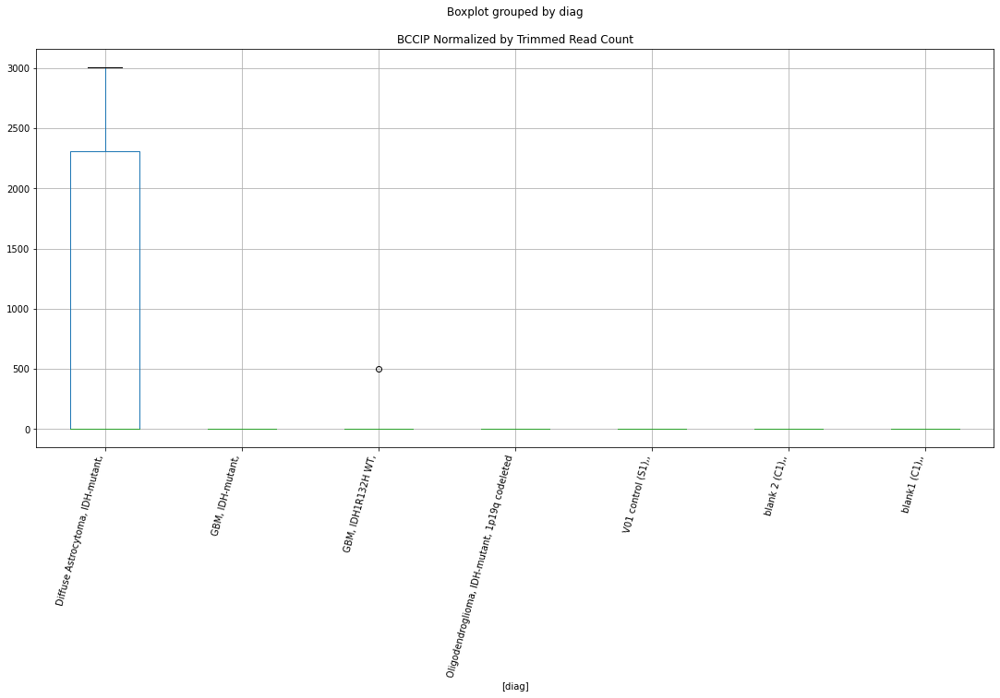

 p : 0.04537034882093641  ( t : 2.1502963601175207 ) :  D-plex  :  cutadapt2  :  CLYBL
Control and blanks
76     114399.75
340    109210.78
Name: CLYBL, dtype: float64
208    76363.97
Name: CLYBL, dtype: float64
472    10403.21
Name: CLYBL, dtype: float64


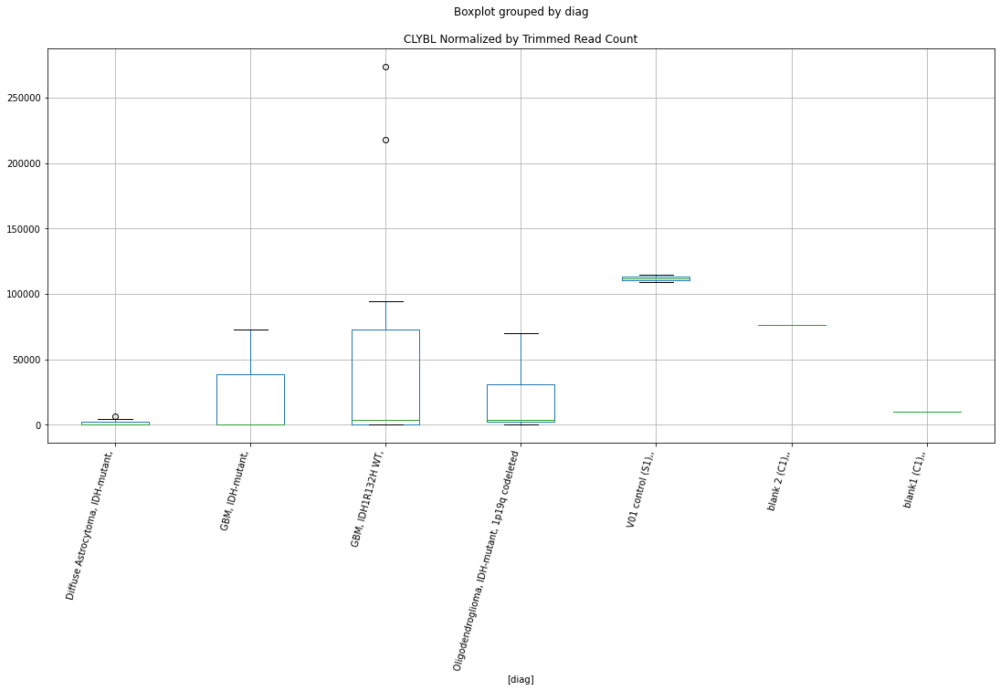

 p : 0.04538877956036096  ( t : 2.150090851434281 ) :  D-plex  :  cutadapt2  :  CTTNBP2
Control and blanks
76         0.0
340    73981.5
Name: CTTNBP2, dtype: float64
208    16930.58
Name: CTTNBP2, dtype: float64
472    15604.81
Name: CTTNBP2, dtype: float64


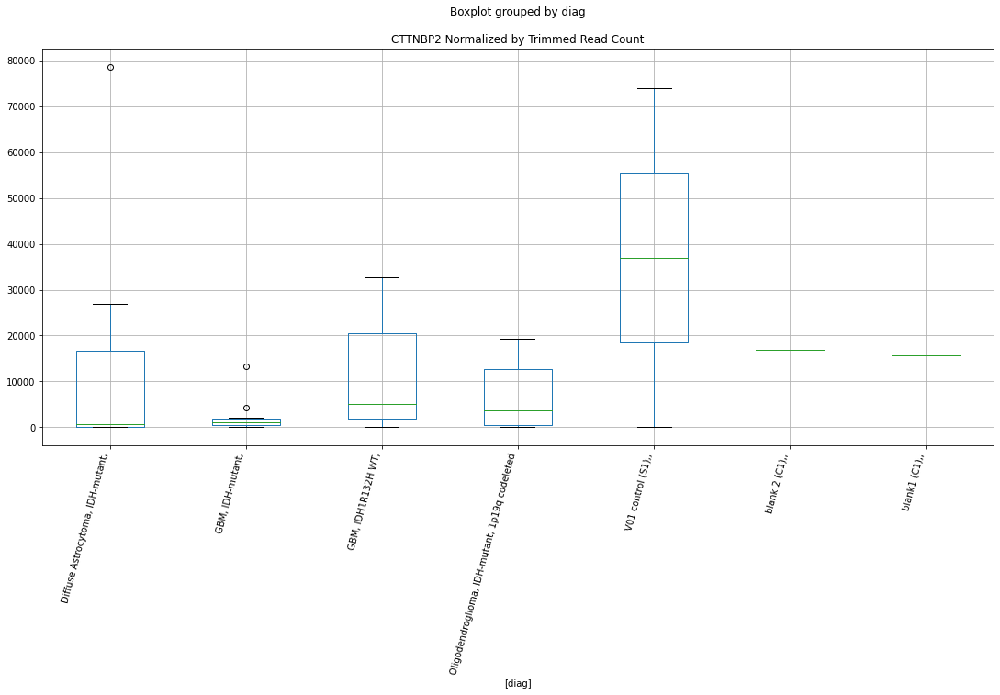

 p : 0.04540814137997848  ( t : 2.14987504301624 ) :  Lexogen  :  bbduk2  :  DIDO1
Control and blanks
79     0.0
343    0.0
Name: DIDO1, dtype: float64
211    9292.42
Name: DIDO1, dtype: float64
475    479.03
Name: DIDO1, dtype: float64


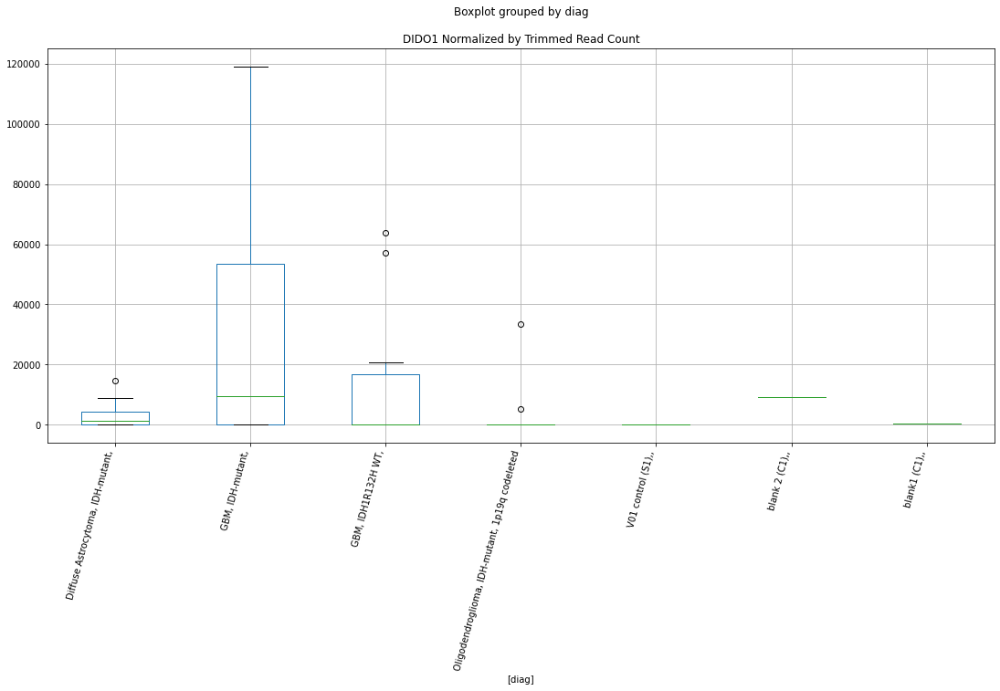

 p : 0.045416786602270796  ( t : 2.1497787098160184 ) :  D-plex  :  cutadapt2  :  DAZ1
Control and blanks
76     0.0
340    0.0
Name: DAZ1, dtype: float64
208    5819.89
Name: DAZ1, dtype: float64
472    1733.87
Name: DAZ1, dtype: float64


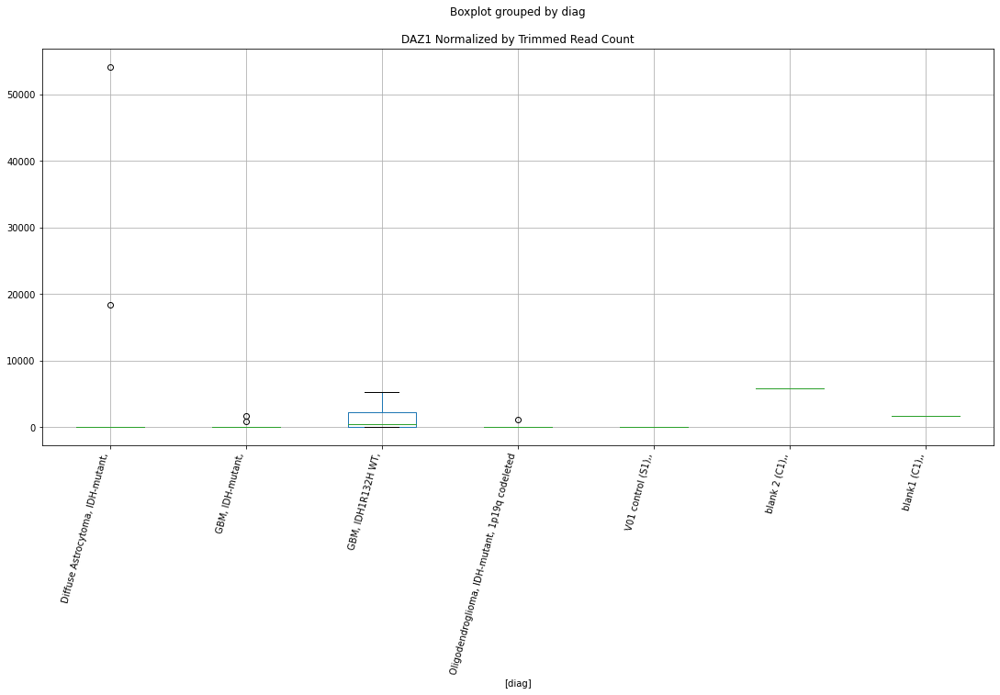

 p : 0.04543554913537618  ( t : 2.1495696976466276 ) :  Lexogen  :  cutadapt2  :  CCNL2
Control and blanks
82     0.0
346    0.0
Name: CCNL2, dtype: float64
214    0.0
Name: CCNL2, dtype: float64
478    7598.74
Name: CCNL2, dtype: float64


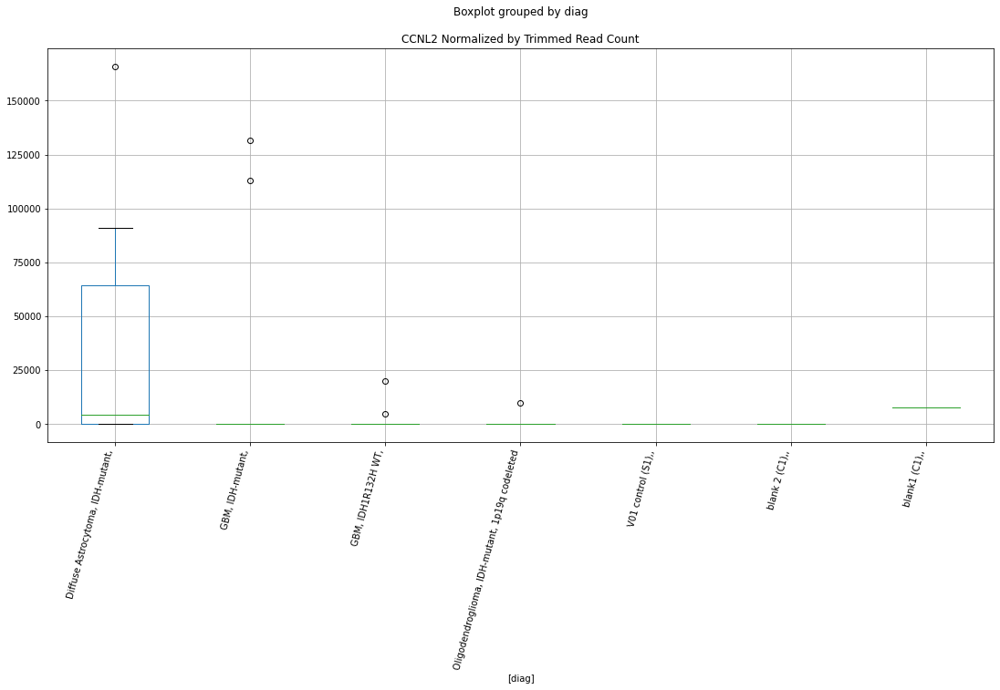

 p : 0.04548149694648657  ( t : 2.149058177868609 ) :  D-plex  :  bbduk2  :  AGAP9
Control and blanks
73        0.00
337    5340.94
Name: AGAP9, dtype: float64
205    7342.73
Name: AGAP9, dtype: float64
469    2957.64
Name: AGAP9, dtype: float64


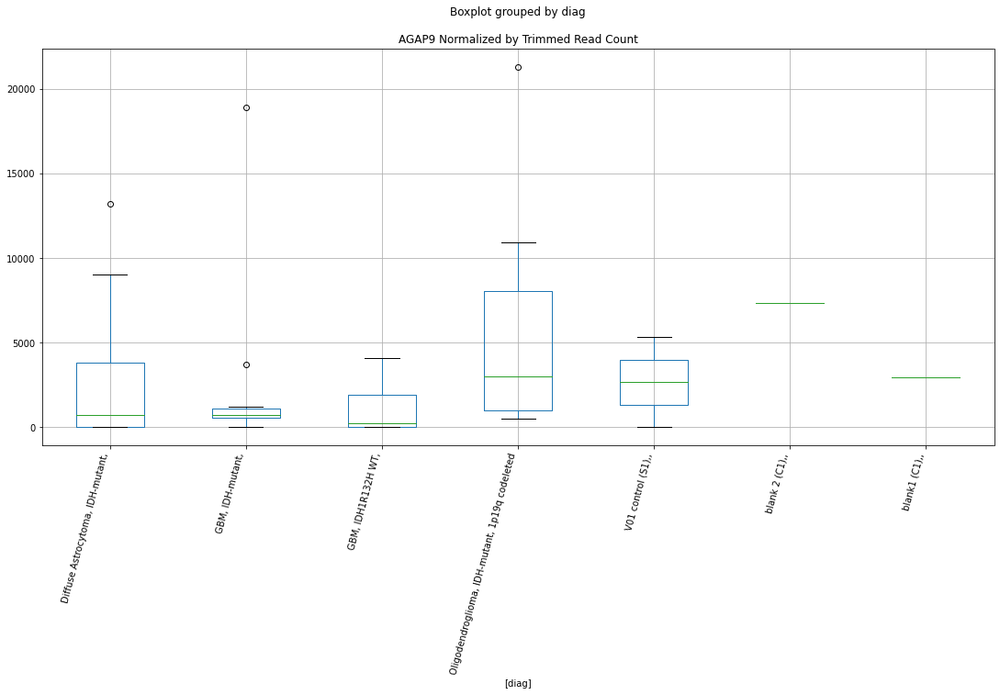

 p : 0.04554164123019382  ( t : 2.148389327080304 ) :  Lexogen  :  cutadapt2  :  C1R
Control and blanks
82       0.00
346    841.74
Name: C1R, dtype: float64
214    2712.26
Name: C1R, dtype: float64
478    474.92
Name: C1R, dtype: float64


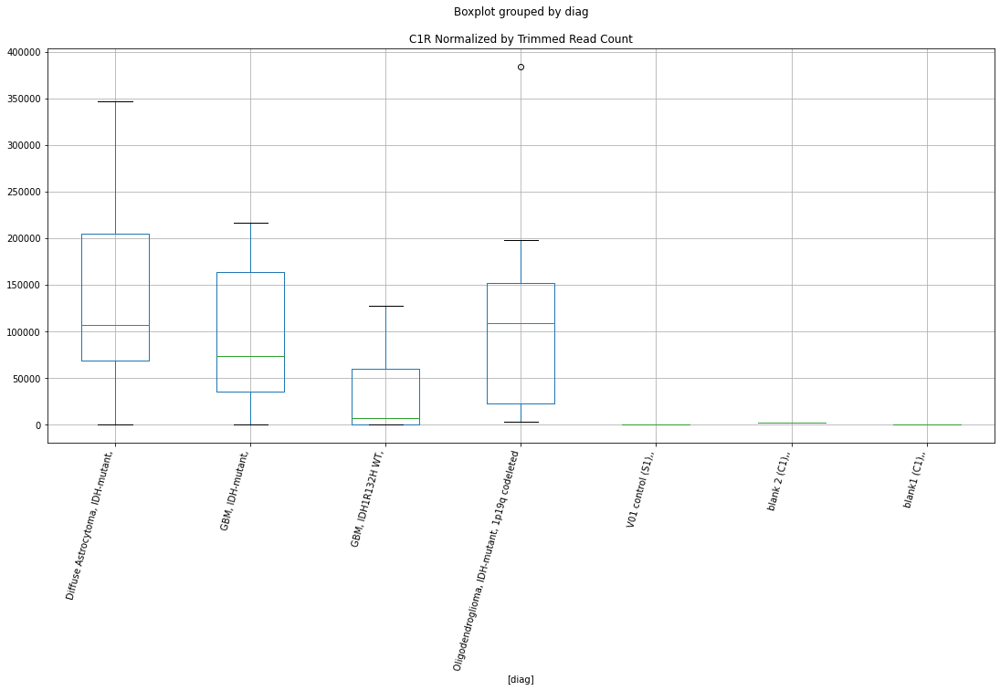

 p : 0.04554680165248943  ( t : 2.1483319768037714 ) :  D-plex  :  cutadapt2  :  ANKRD26P1
Control and blanks
76     0.0
340    0.0
Name: ANKRD26P1, dtype: float64
208    176.36
Name: ANKRD26P1, dtype: float64
472    577.96
Name: ANKRD26P1, dtype: float64


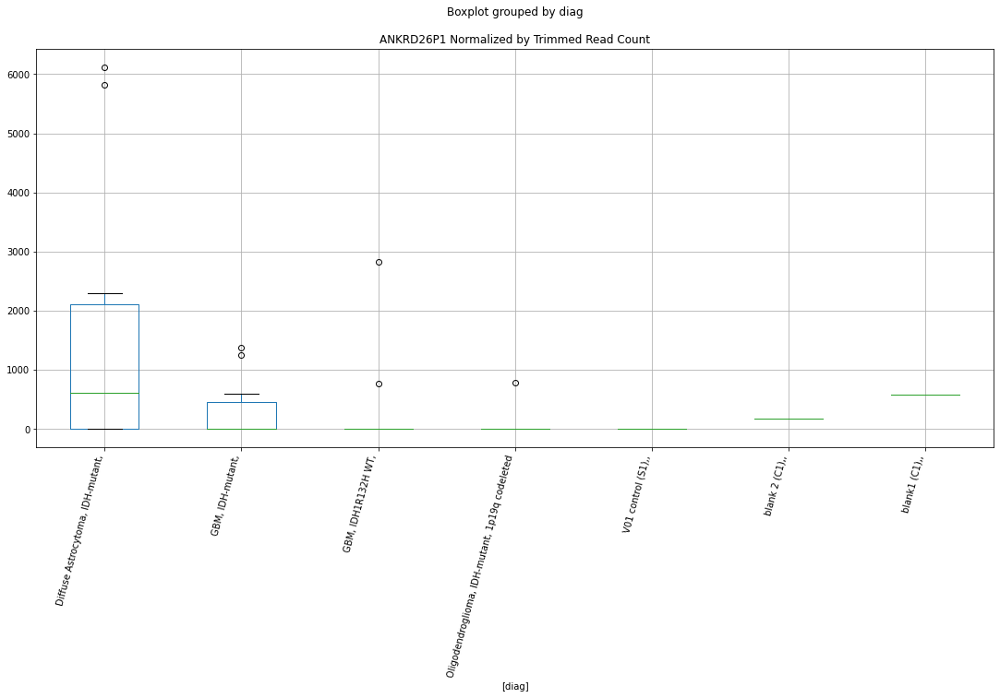

 p : 0.045560883229576965  ( t : 2.1481755116001593 ) :  D-plex  :  cutadapt2  :  CDK3
Control and blanks
76     0.0
340    0.0
Name: CDK3, dtype: float64
208    529.08
Name: CDK3, dtype: float64
472    0.0
Name: CDK3, dtype: float64


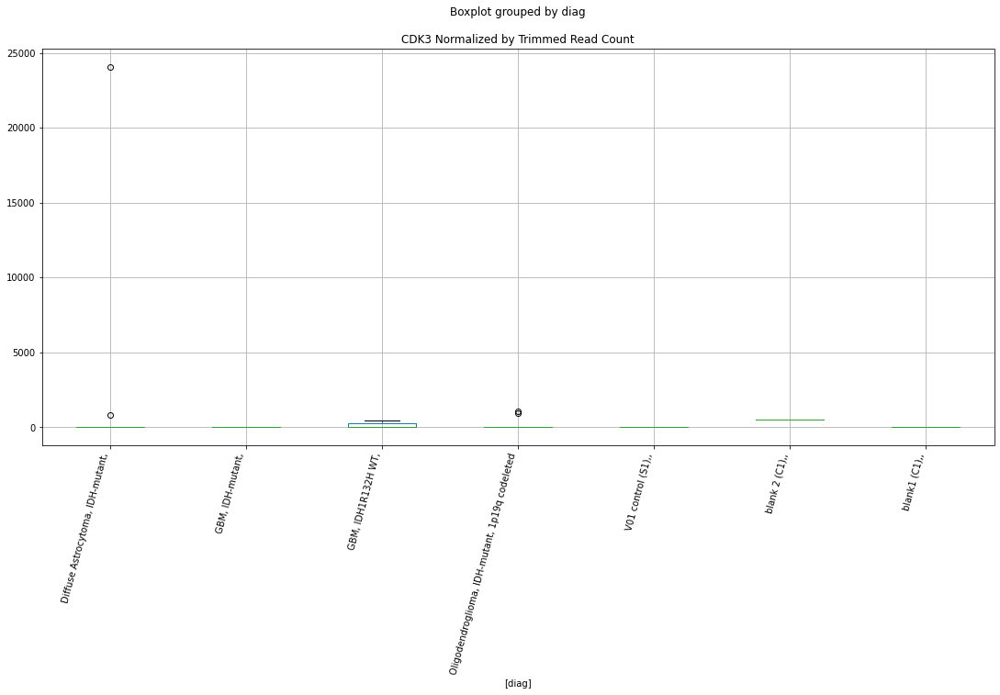

 p : 0.04557013189679416  ( t : 2.148072770540618 ) :  Lexogen  :  cutadapt2  :  CSMD1
Control and blanks
82        0.00
346    6313.04
Name: CSMD1, dtype: float64
214    0.0
Name: CSMD1, dtype: float64
478    0.0
Name: CSMD1, dtype: float64


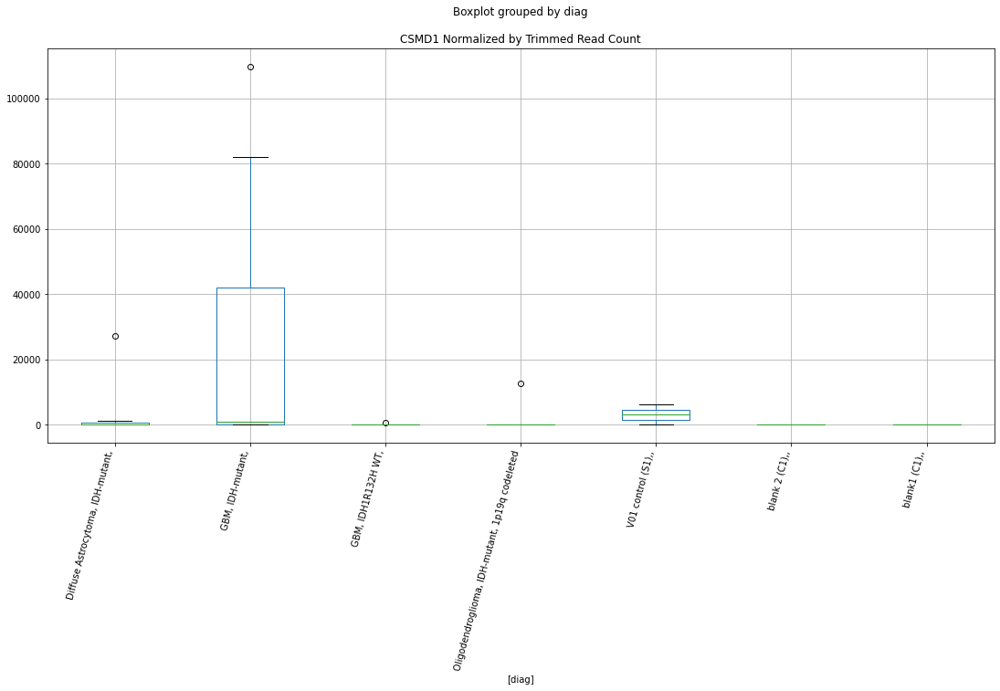

 p : 0.0456482237939423  ( t : 2.147206026423934 ) :  D-plex  :  cutadapt2  :  CACUL1
Control and blanks
76     0.0
340    0.0
Name: CACUL1, dtype: float64
208    529.08
Name: CACUL1, dtype: float64
472    1155.91
Name: CACUL1, dtype: float64


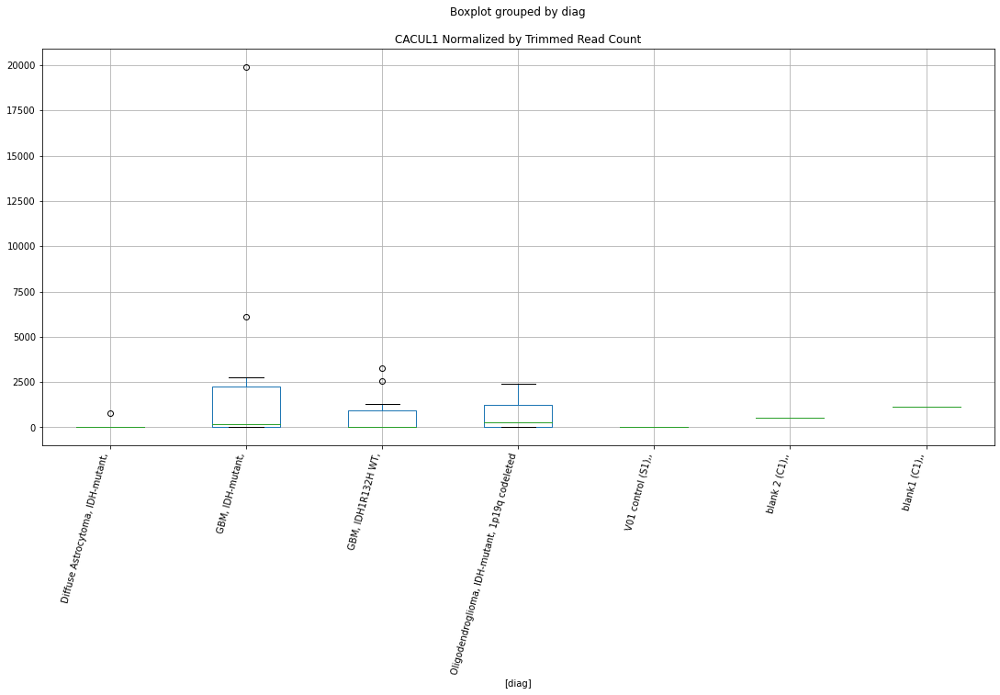

 p : 0.04564892408389738  ( t : 2.1471982600158976 ) :  Lexogen  :  cutadapt2  :  CYP7B1
Control and blanks
82        0.00
346    3787.82
Name: CYP7B1, dtype: float64
214    0.0
Name: CYP7B1, dtype: float64
478    712.38
Name: CYP7B1, dtype: float64


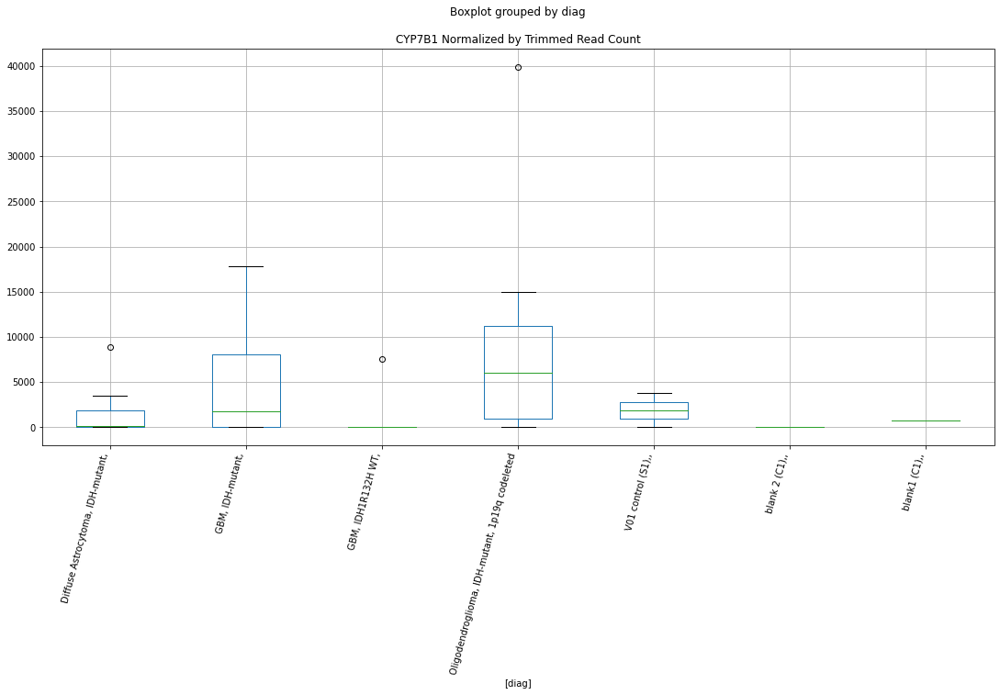

 p : 0.04576283743485049  ( t : 2.1459363759916443 ) :  Lexogen  :  cutadapt2  :  CELF4
Control and blanks
82     0.0
346    0.0
Name: CELF4, dtype: float64
214    0.0
Name: CELF4, dtype: float64
478    0.0
Name: CELF4, dtype: float64


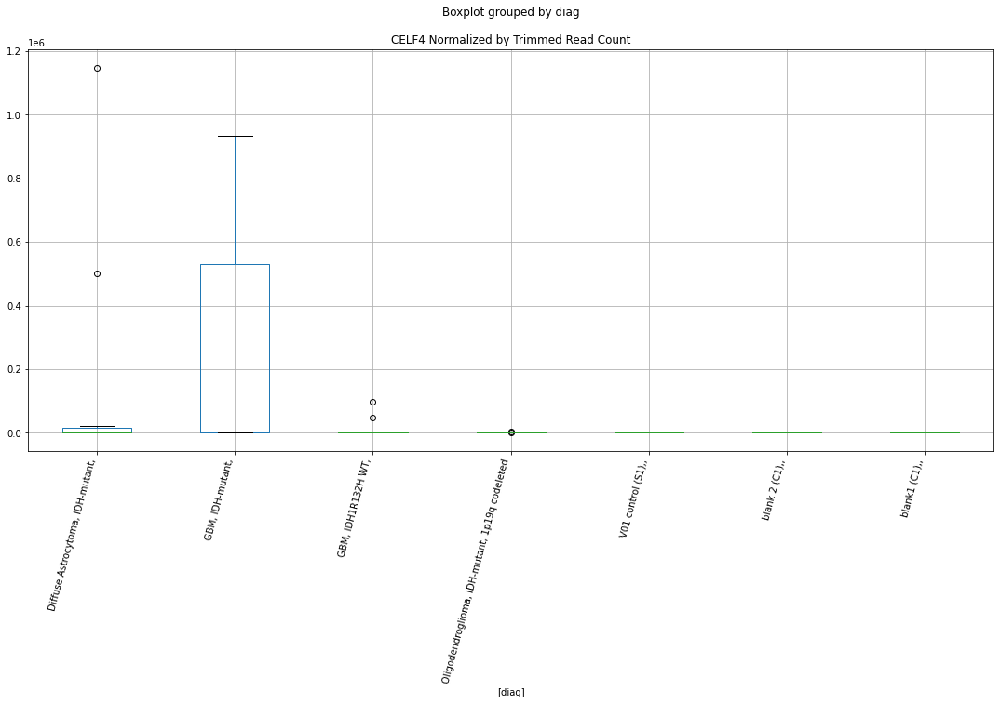

 p : 0.045825052974492235  ( t : 2.14524838934603 ) :  D-plex  :  bbduk2  :  DISP2
Control and blanks
73     2319.03
337       0.00
Name: DISP2, dtype: float64
205    8775.46
Name: DISP2, dtype: float64
469    5323.75
Name: DISP2, dtype: float64


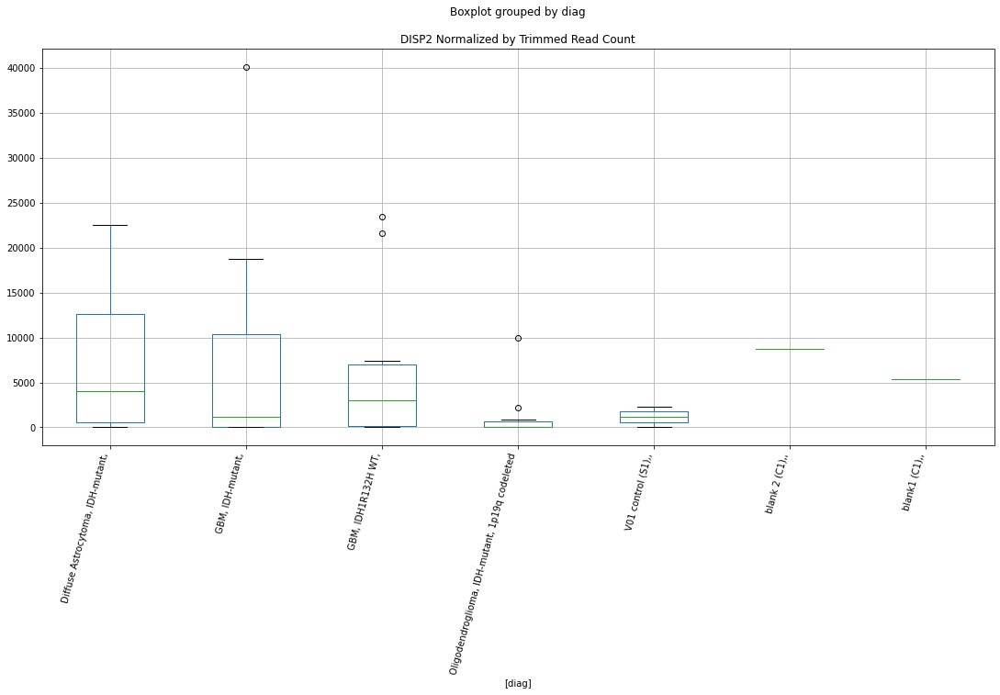

 p : 0.045838690731771645  ( t : 2.1450976954435066 ) :  D-plex  :  bbduk2  :  BTBD17
Control and blanks
73     2319.03
337       0.00
Name: BTBD17, dtype: float64
205    895.45
Name: BTBD17, dtype: float64
469    4732.22
Name: BTBD17, dtype: float64


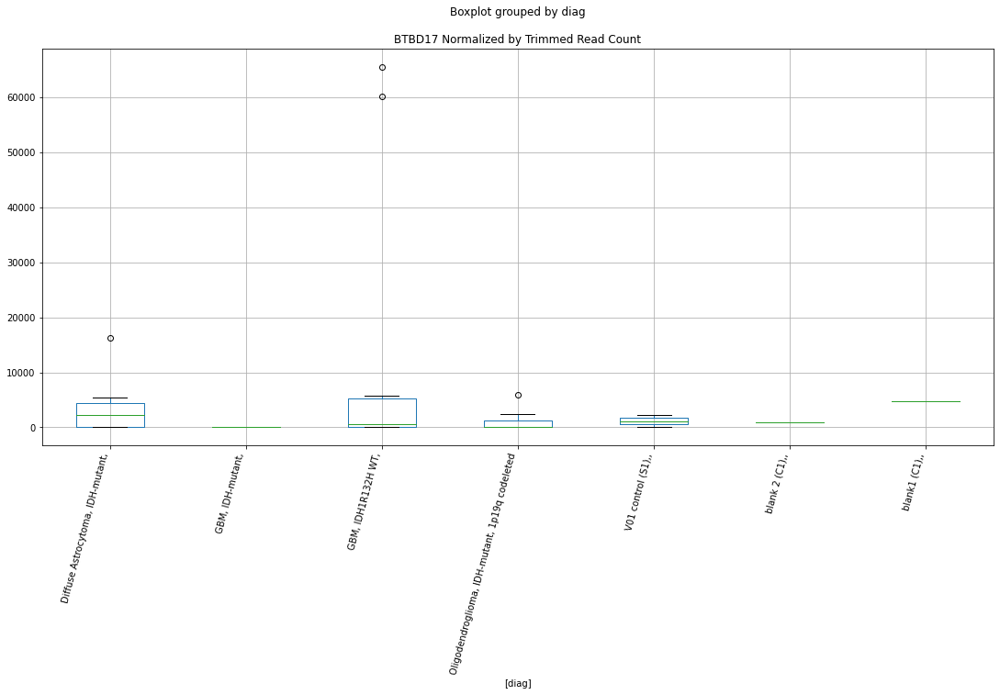

 p : 0.04586265842834956  ( t : 2.144832957405475 ) :  D-plex  :  cutadapt2  :  CPT1B
Control and blanks
76     0.0
340    0.0
Name: CPT1B, dtype: float64
208    0.0
Name: CPT1B, dtype: float64
472    0.0
Name: CPT1B, dtype: float64


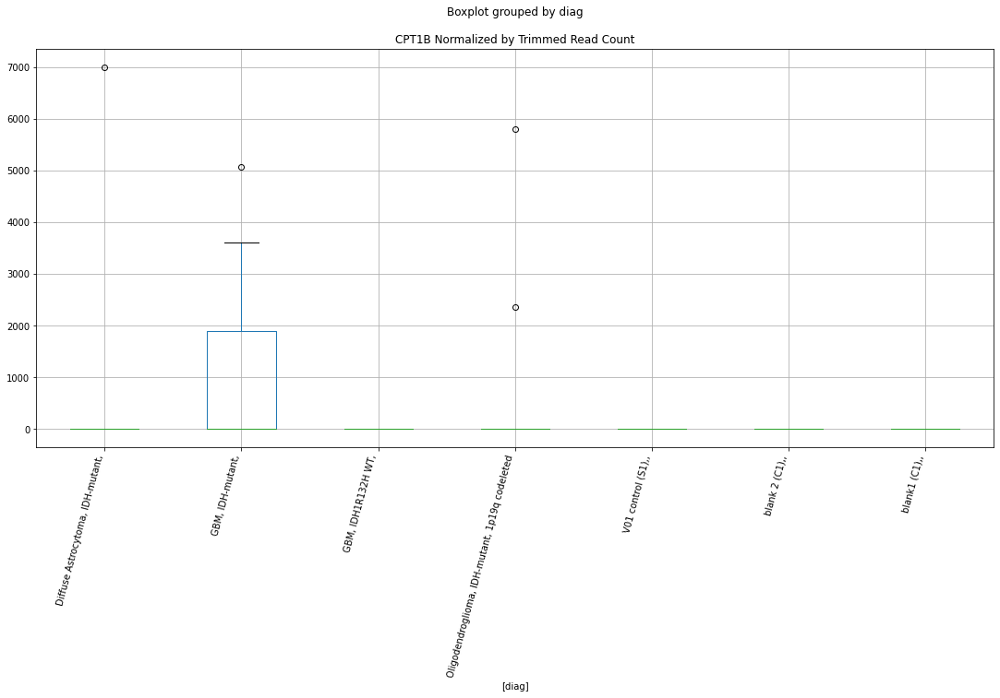

 p : 0.04589866458423024  ( t : 2.1444354845135023 ) :  D-plex  :  bbduk2  :  ANKS1A
Control and blanks
73     2319.03
337       0.00
Name: ANKS1A, dtype: float64
205    43877.28
Name: ANKS1A, dtype: float64
469    63884.95
Name: ANKS1A, dtype: float64


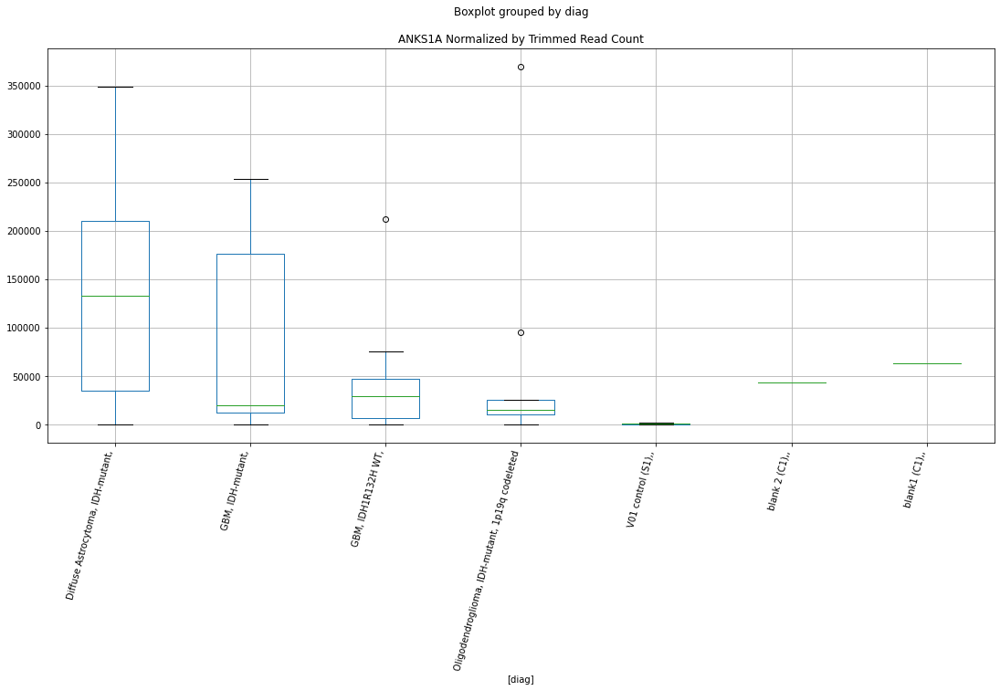

 p : 0.04589974938063773  ( t : 2.144423513836868 ) :  D-plex  :  cutadapt2  :  DGKZ
Control and blanks
76     4545.69
340       0.00
Name: DGKZ, dtype: float64
208    13932.46
Name: DGKZ, dtype: float64
472    0.0
Name: DGKZ, dtype: float64


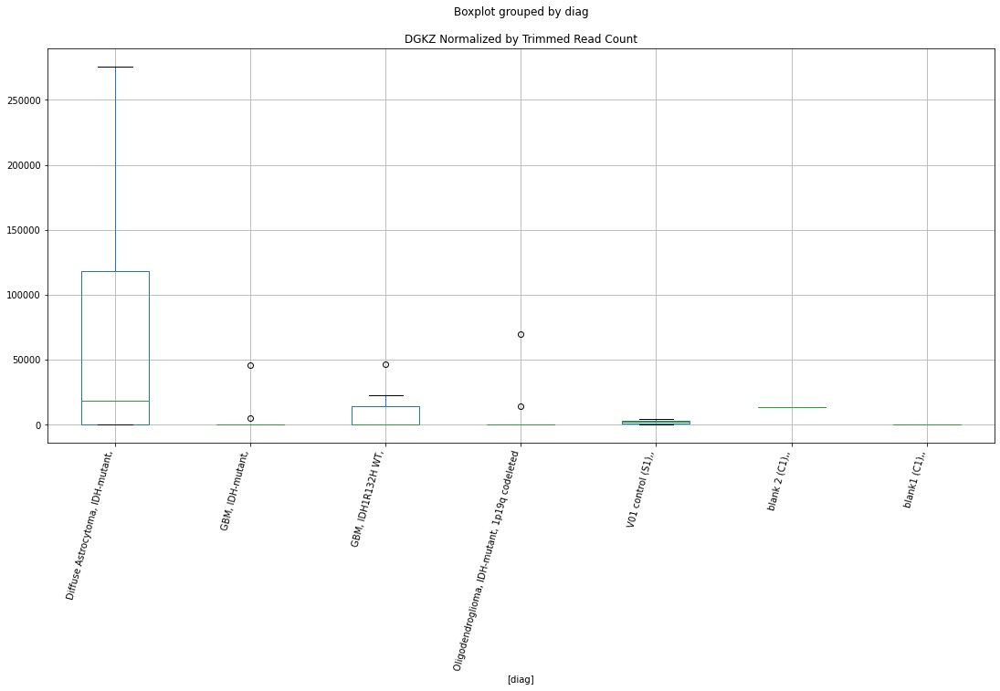

 p : 0.046016918438489866  ( t : 2.1431320772978206 ) :  D-plex  :  bbduk2  :  ARHGEF40
Control and blanks
73          0.00
337    106818.87
Name: ARHGEF40, dtype: float64
205    8059.09
Name: ARHGEF40, dtype: float64
469    16562.76
Name: ARHGEF40, dtype: float64


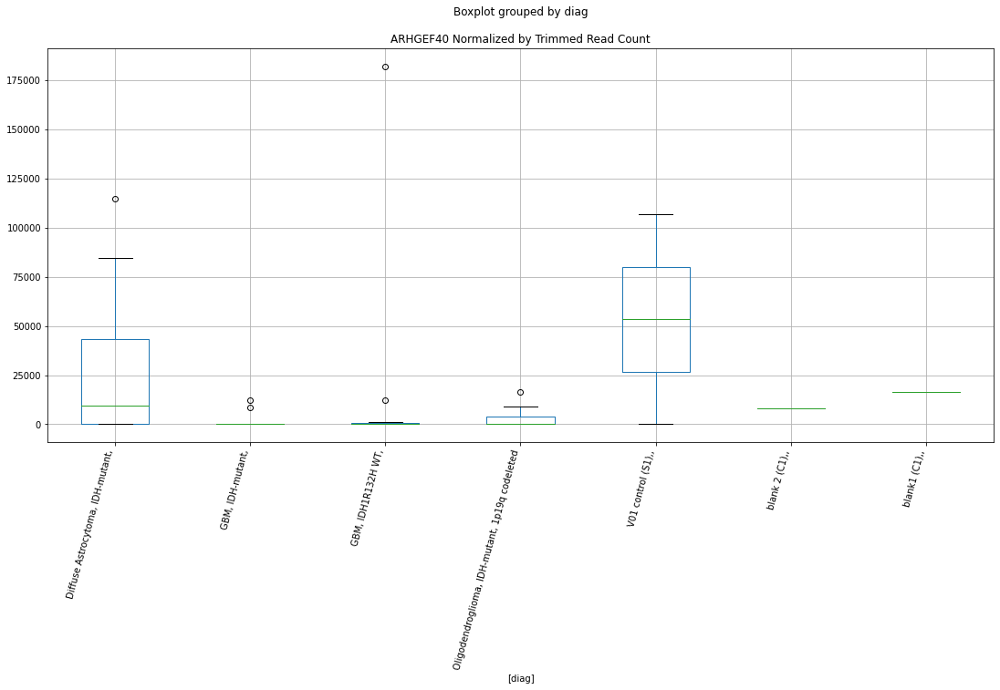

 p : 0.04603334253444548  ( t : 2.1429512910190693 ) :  Lexogen  :  cutadapt2  :  CPXM2
Control and blanks
82     0.0
346    0.0
Name: CPXM2, dtype: float64
214    0.0
Name: CPXM2, dtype: float64
478    0.0
Name: CPXM2, dtype: float64


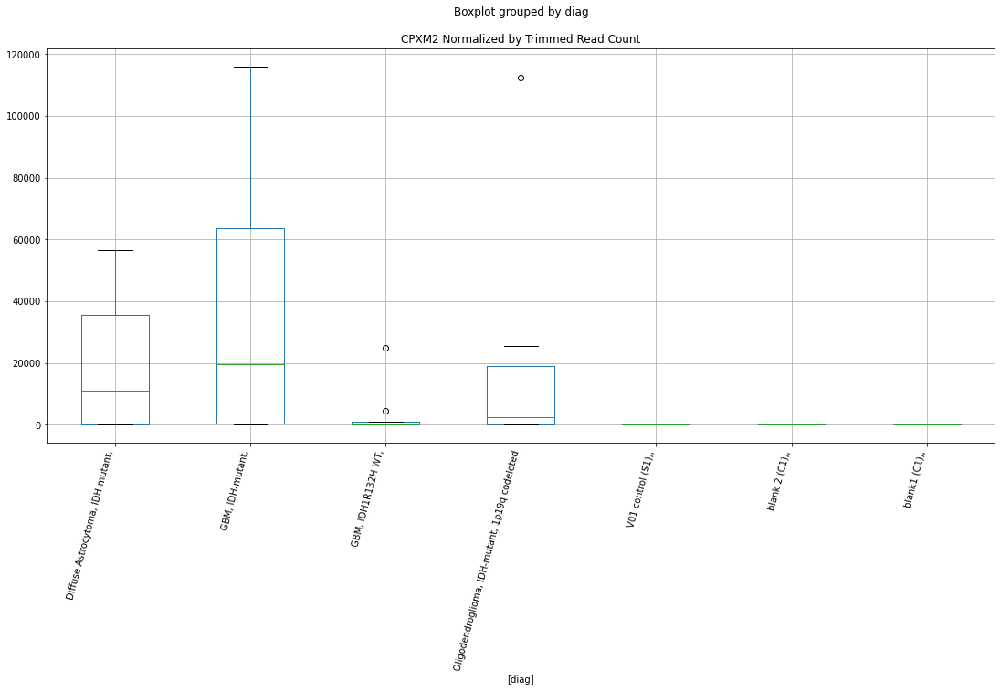

 p : 0.04603347037493014  ( t : 2.1429498840611756 ) :  D-plex  :  bbduk2  :  B4GALNT3
Control and blanks
73     0.0
337    0.0
Name: B4GALNT3, dtype: float64
205    179.09
Name: B4GALNT3, dtype: float64
469    0.0
Name: B4GALNT3, dtype: float64


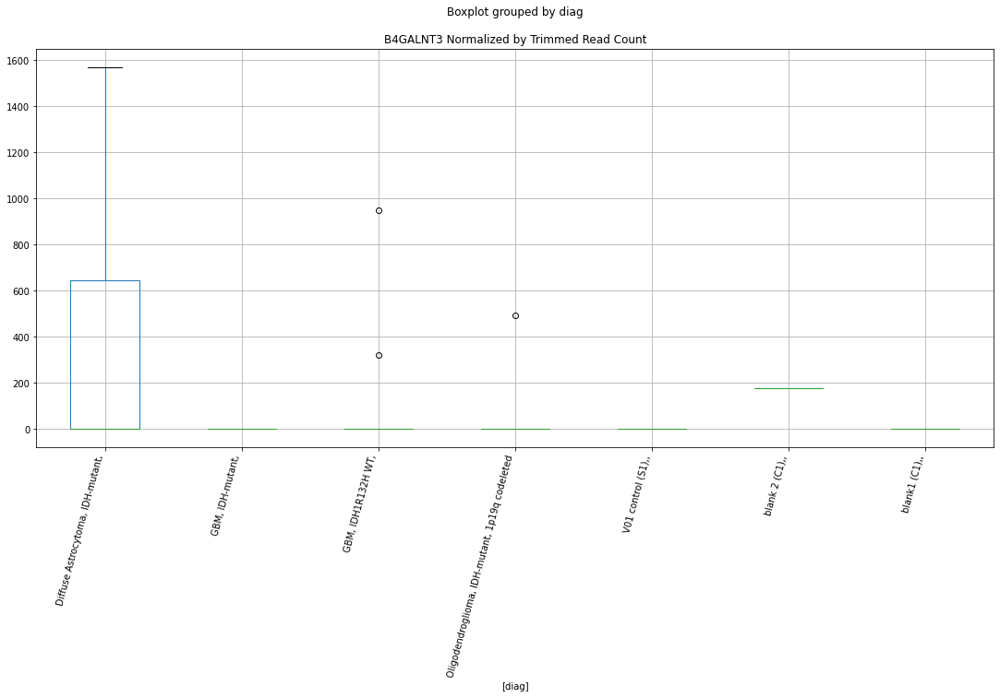

 p : 0.04604149228205312  ( t : 2.142861605504669 ) :  Lexogen  :  cutadapt2  :  ADAMTS14
Control and blanks
82        0.00
346    1683.48
Name: ADAMTS14, dtype: float64
214    71603.78
Name: ADAMTS14, dtype: float64
478    0.0
Name: ADAMTS14, dtype: float64


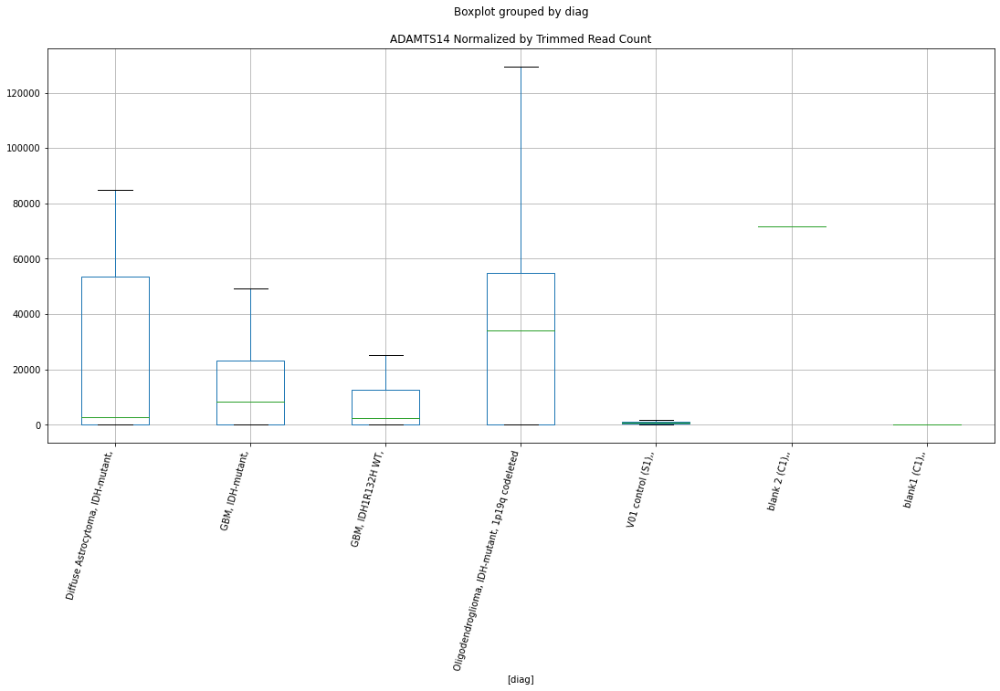

 p : 0.046086177582763455  ( t : 2.1423701147096286 ) :  Lexogen  :  bbduk2  :  CCNL2
Control and blanks
79     0.0
343    0.0
Name: CCNL2, dtype: float64
211    0.0
Name: CCNL2, dtype: float64
475    7664.5
Name: CCNL2, dtype: float64


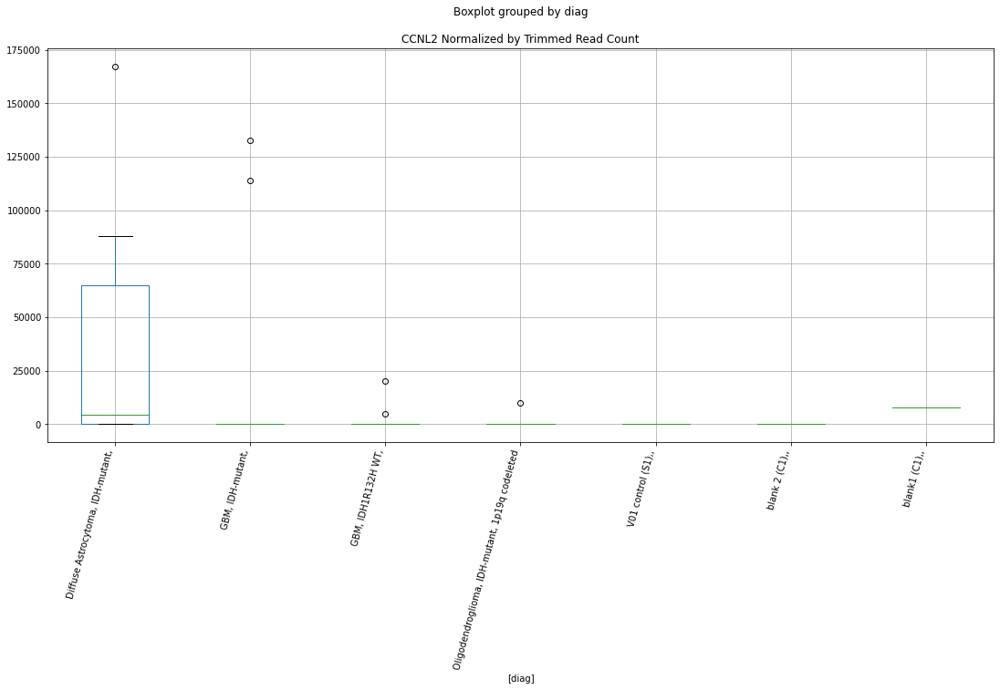

 p : 0.04611468192686505  ( t : 2.142056824472202 ) :  D-plex  :  cutadapt2  :  DISP2
Control and blanks
76     2272.84
340       0.00
Name: DISP2, dtype: float64
208    9170.73
Name: DISP2, dtype: float64
472    3467.74
Name: DISP2, dtype: float64


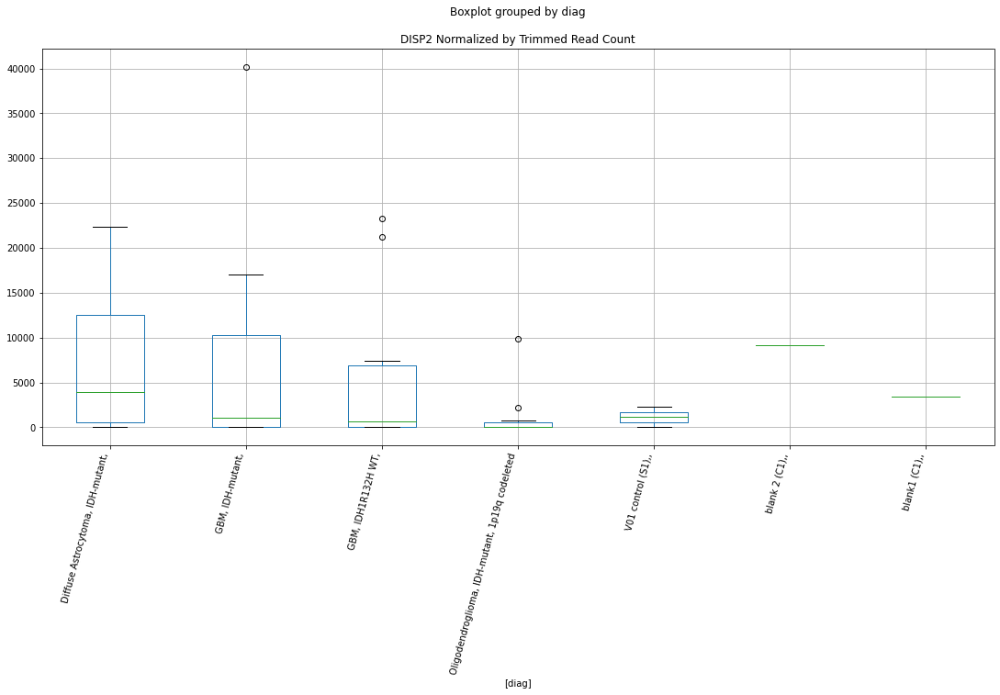

 p : 0.046133414817383395  ( t : 2.1418510281951875 ) :  Lexogen  :  bbduk2  :  C1R
Control and blanks
79       0.00
343    849.26
Name: C1R, dtype: float64
211    2733.06
Name: C1R, dtype: float64
475    479.03
Name: C1R, dtype: float64


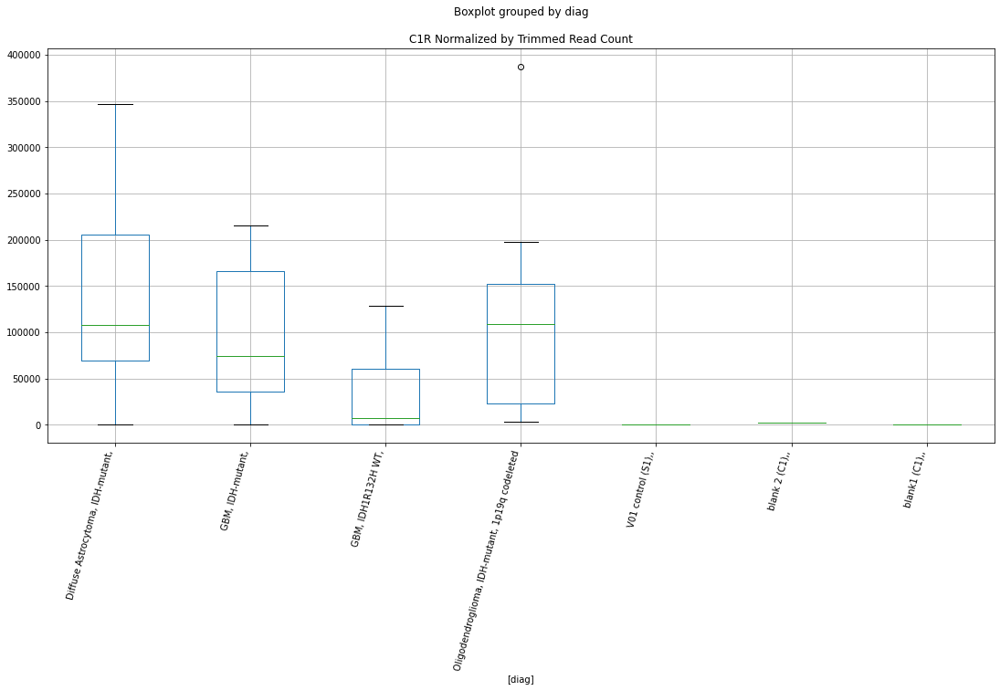

 p : 0.046182832852730574  ( t : 2.141308496115621 ) :  D-plex  :  cutadapt2  :  BTK
Control and blanks
76         0.00
340    14091.71
Name: BTK, dtype: float64
208    118514.07
Name: BTK, dtype: float64
472    4623.65
Name: BTK, dtype: float64


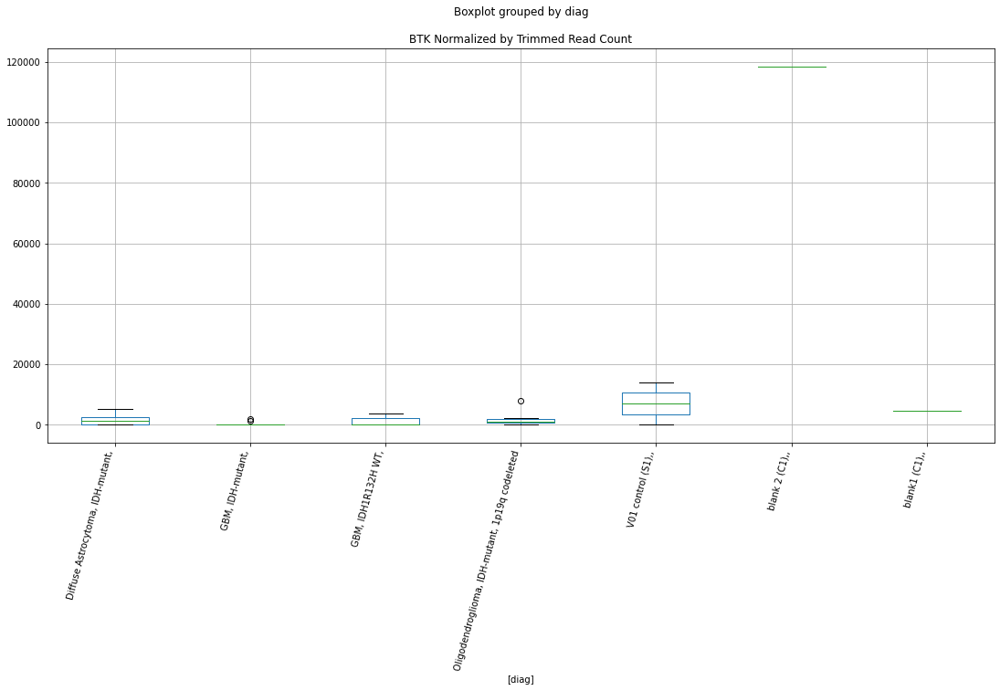

 p : 0.04632618897467286  ( t : 2.1397376651189712 ) :  D-plex  :  cutadapt2  :  AGAP9
Control and blanks
76        0.0
340    2642.2
Name: AGAP9, dtype: float64
208    1939.96
Name: AGAP9, dtype: float64
472    1733.87
Name: AGAP9, dtype: float64


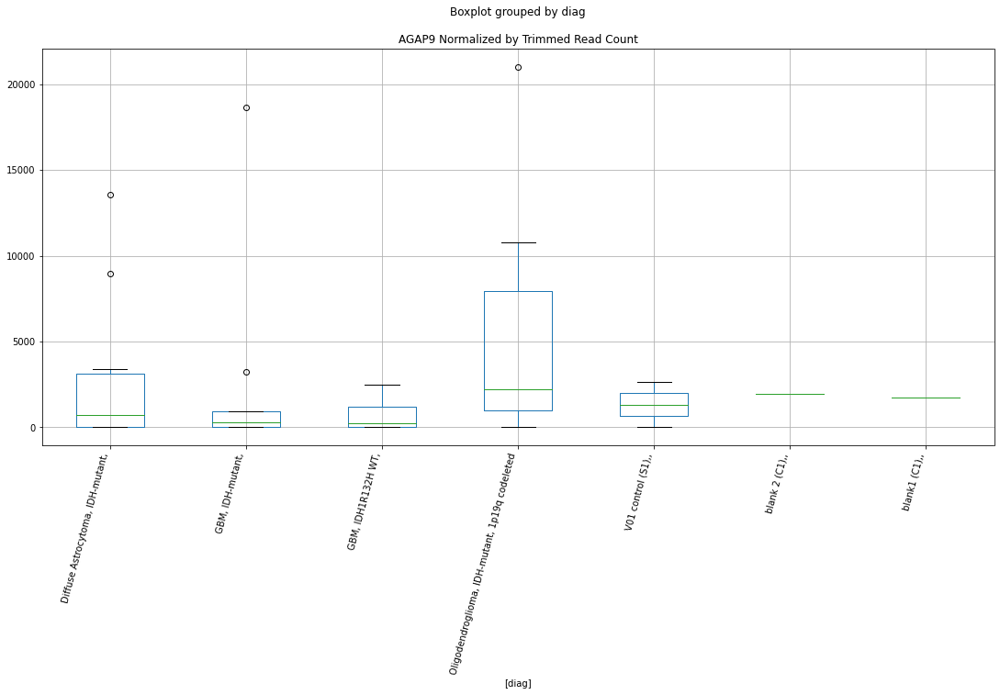

 p : 0.04636235095648741  ( t : 2.139342119438777 ) :  D-plex  :  cutadapt2  :  DDX51
Control and blanks
76     0.0
340    0.0
Name: DDX51, dtype: float64
208    176.36
Name: DDX51, dtype: float64
472    577.96
Name: DDX51, dtype: float64


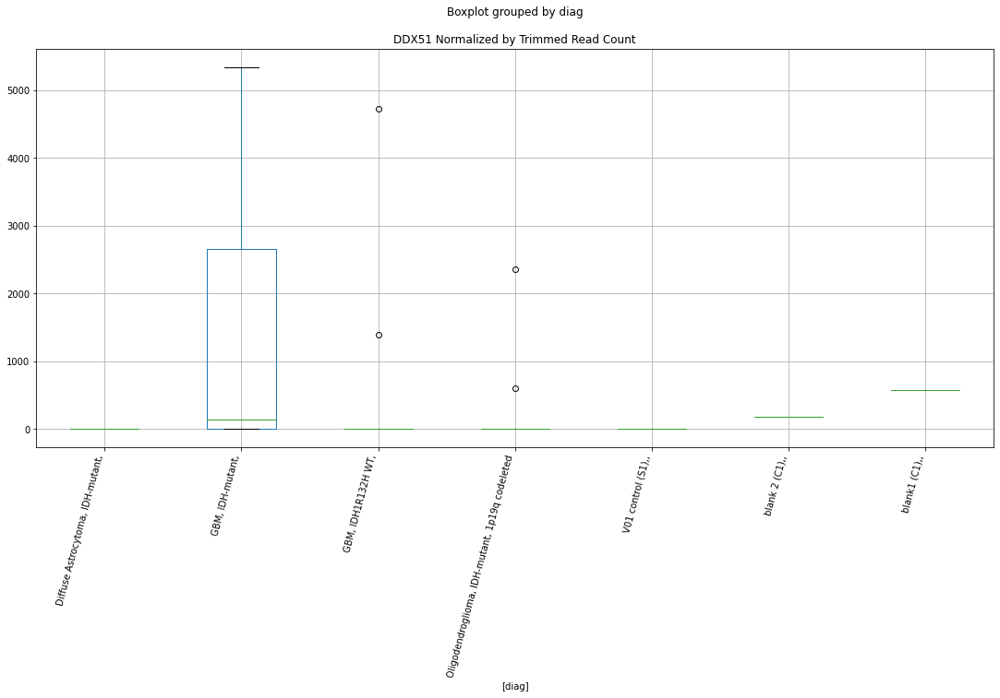

 p : 0.04638544803647568  ( t : 2.139089627132271 ) :  D-plex  :  cutadapt2  :  ANKH
Control and blanks
76     757.61
340      0.00
Name: ANKH, dtype: float64
208    529.08
Name: ANKH, dtype: float64
472    1155.91
Name: ANKH, dtype: float64


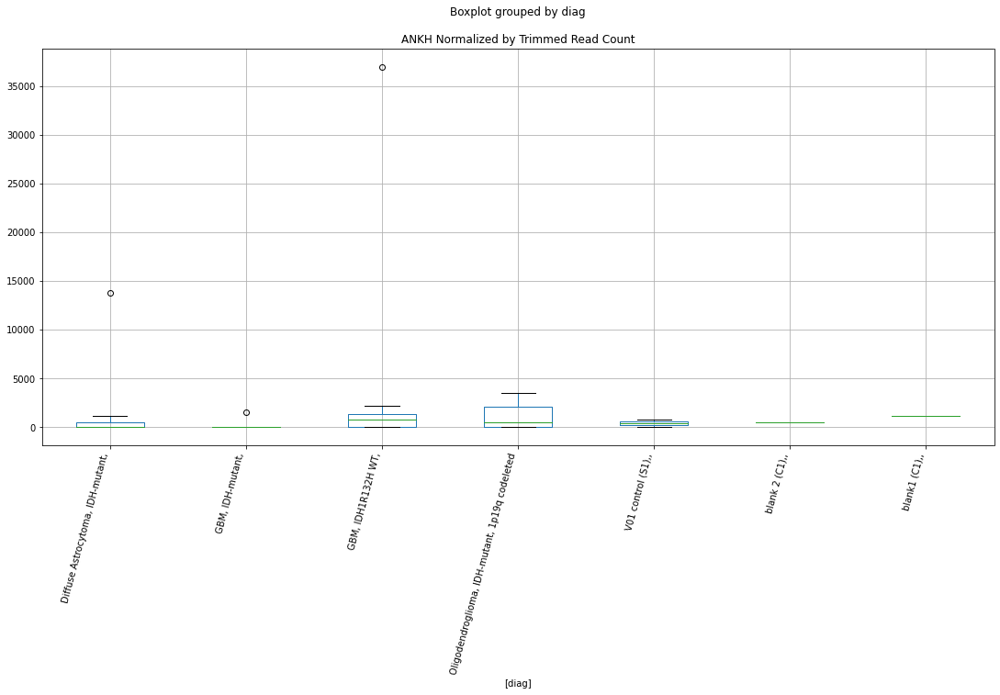

 p : 0.046406517499672215  ( t : 2.1388594003548835 ) :  Lexogen  :  bbduk2  :  ATG4B
Control and blanks
79         0.00
343    45435.26
Name: ATG4B, dtype: float64
211    1366.53
Name: ATG4B, dtype: float64
475    0.0
Name: ATG4B, dtype: float64


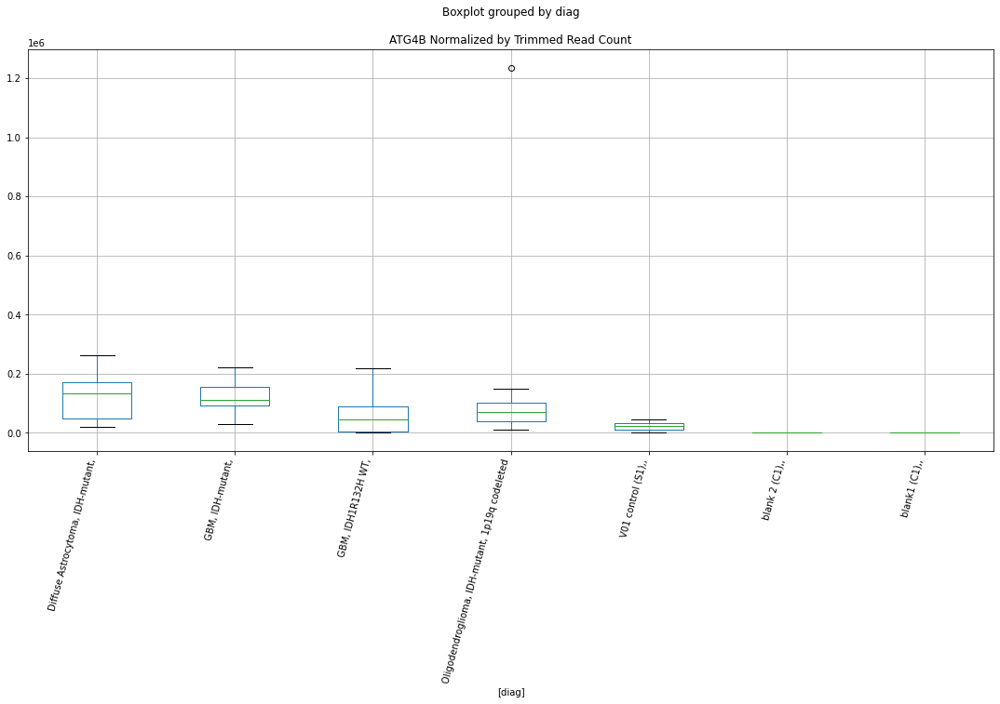

 p : 0.04641401894941577  ( t : 2.1387774547736704 ) :  Lexogen  :  cutadapt2  :  CDK4
Control and blanks
82       0.00
346    210.43
Name: CDK4, dtype: float64
214    5153.3
Name: CDK4, dtype: float64
478    237.46
Name: CDK4, dtype: float64


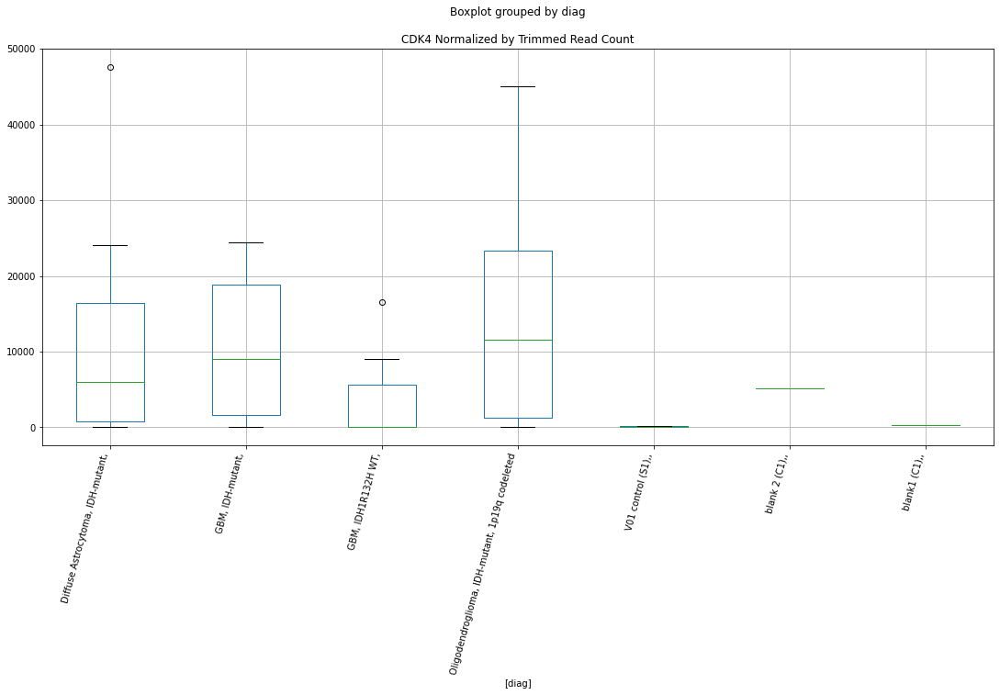

 p : 0.046582287824648426  ( t : 2.1369424604123592 ) :  D-plex  :  cutadapt2  :  ARSB
Control and blanks
76      1515.23
340    24660.50
Name: ARSB, dtype: float64
208    1587.24
Name: ARSB, dtype: float64
472    2889.78
Name: ARSB, dtype: float64


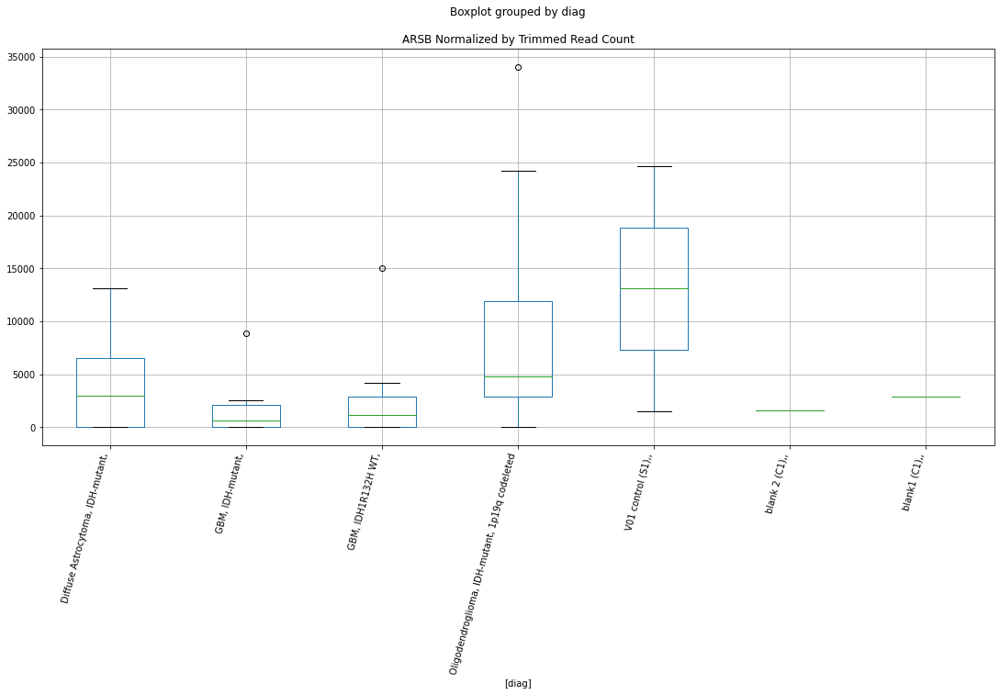

 p : 0.04663761461836724  ( t : 2.1363404356083997 ) :  D-plex  :  bbduk2  :  CDCA7L
Control and blanks
73     0.0
337    0.0
Name: CDCA7L, dtype: float64
205    2149.09
Name: CDCA7L, dtype: float64
469    1774.58
Name: CDCA7L, dtype: float64


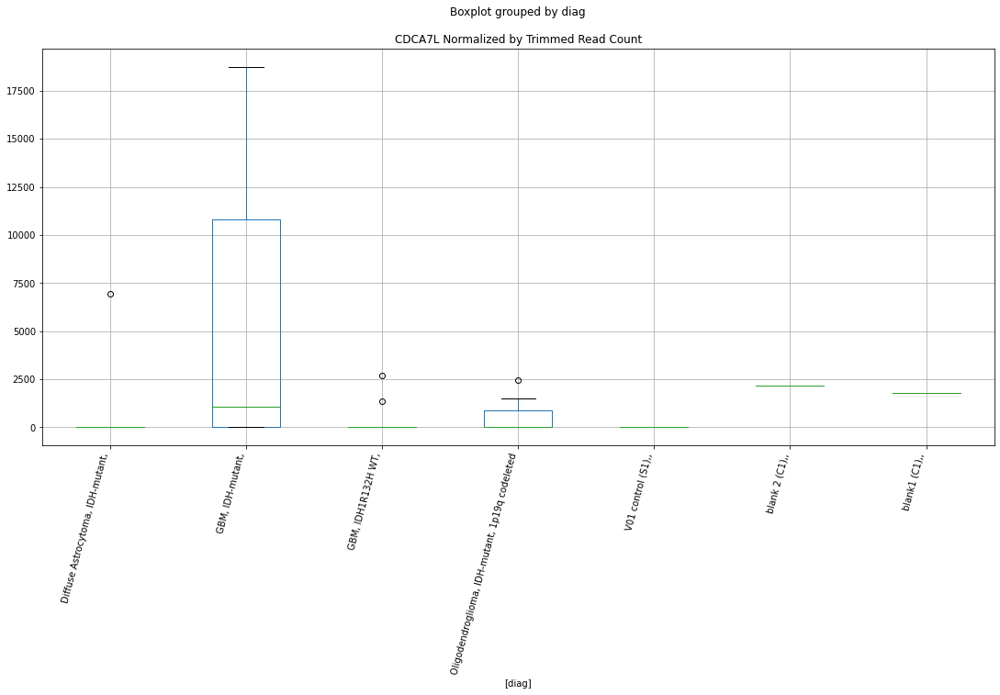

 p : 0.04667841929855084  ( t : 2.135896846965629 ) :  D-plex  :  bbduk2  :  B4GALT6
Control and blanks
73         0.00
337    10681.89
Name: B4GALT6, dtype: float64
205    1970.0
Name: B4GALT6, dtype: float64
469    4140.69
Name: B4GALT6, dtype: float64


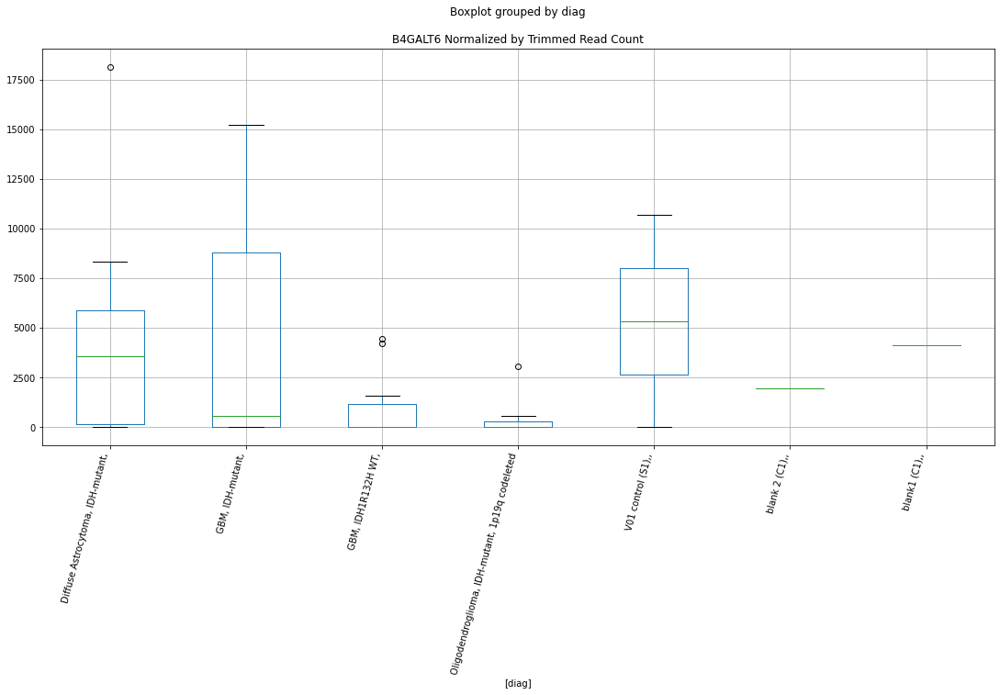

 p : 0.046694204721597875  ( t : 2.135725338159167 ) :  D-plex  :  bbduk2  :  ARSB
Control and blanks
73      1546.02
337    24924.40
Name: ARSB, dtype: float64
205    1611.82
Name: ARSB, dtype: float64
469    2957.64
Name: ARSB, dtype: float64


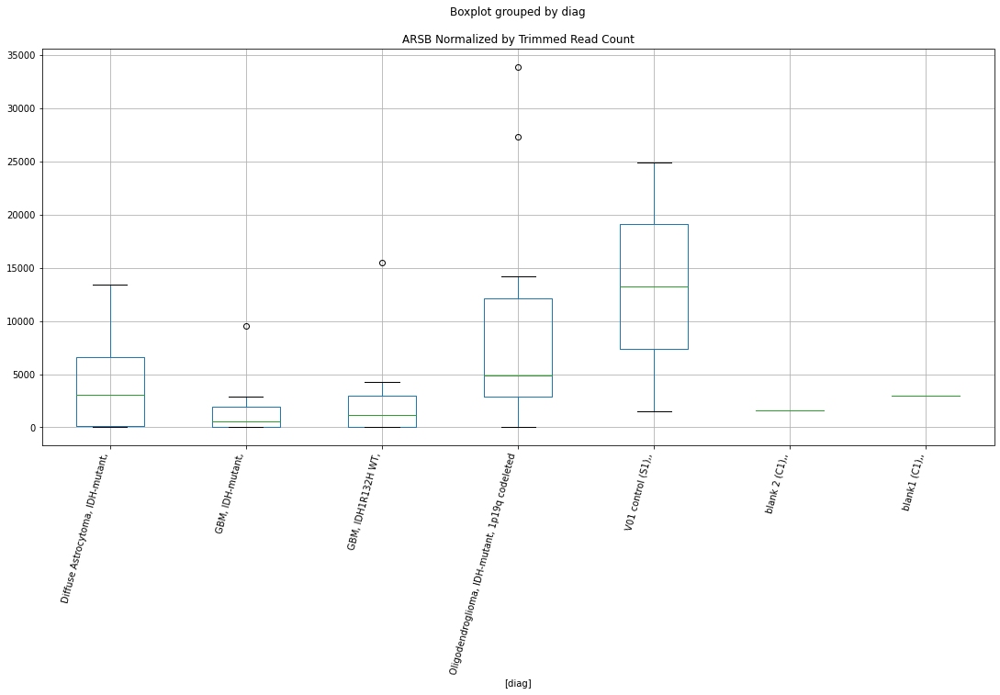

 p : 0.04671897251966174  ( t : 2.1354563423260875 ) :  D-plex  :  cutadapt2  :  CELSR2
Control and blanks
76     68185.28
340        0.00
Name: CELSR2, dtype: float64
208    5290.81
Name: CELSR2, dtype: float64
472    6935.47
Name: CELSR2, dtype: float64


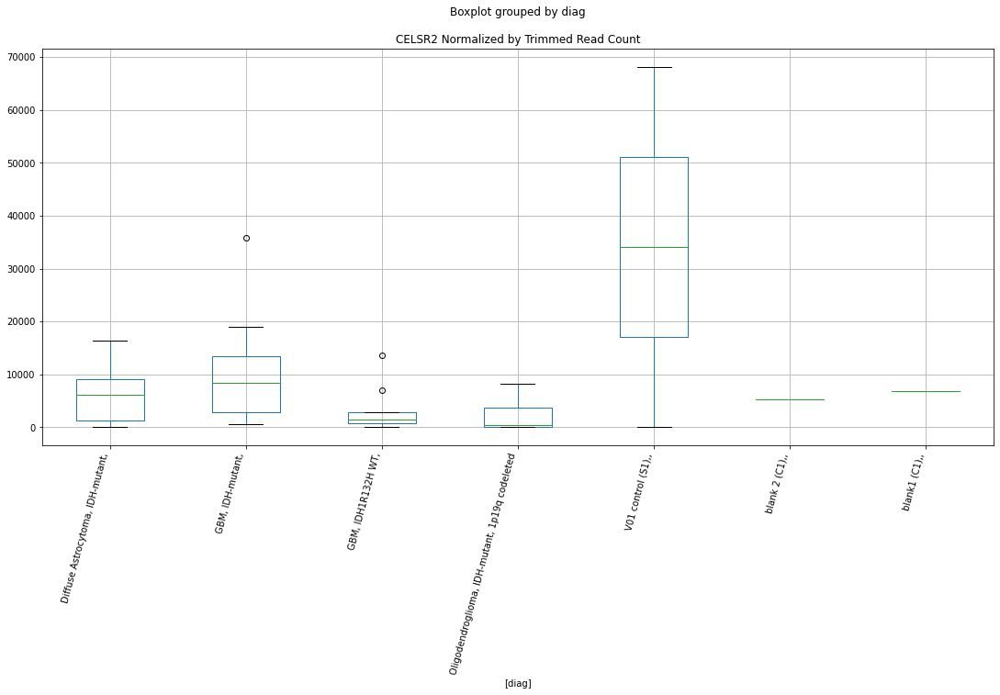

 p : 0.046724394929387986  ( t : 2.135397468475281 ) :  D-plex  :  bbduk2  :  CELSR2
Control and blanks
73     69570.76
337        0.00
Name: CELSR2, dtype: float64
205    5372.73
Name: CELSR2, dtype: float64
469    7098.33
Name: CELSR2, dtype: float64


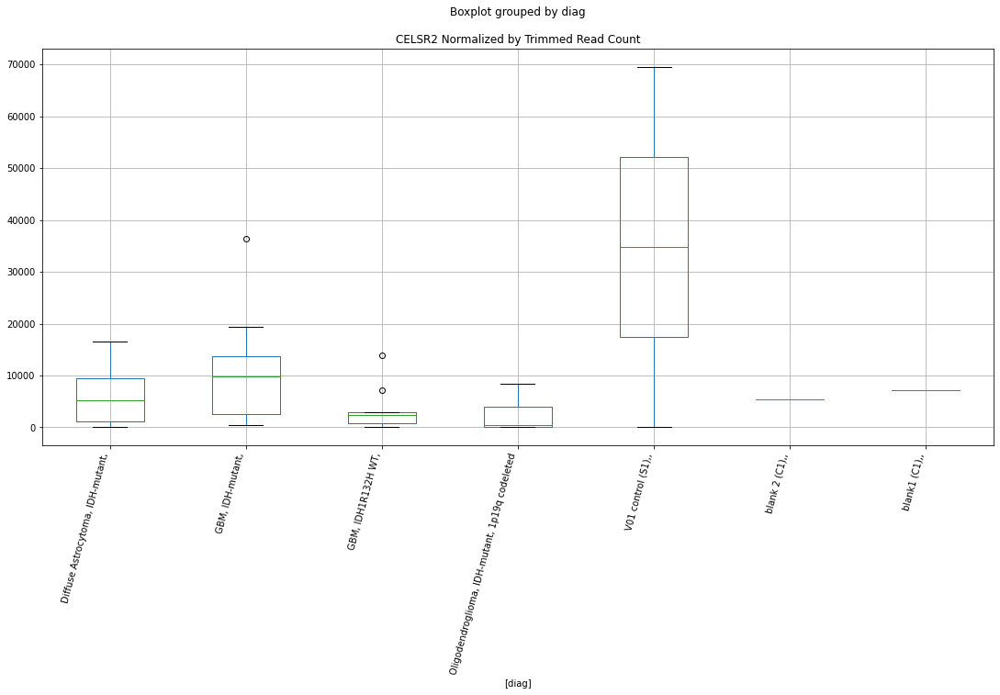

 p : 0.04676070357181685  ( t : 2.135003407672484 ) :  D-plex  :  bbduk2  :  BCAP29
Control and blanks
73     0.0
337    0.0
Name: BCAP29, dtype: float64
205    0.0
Name: BCAP29, dtype: float64
469    0.0
Name: BCAP29, dtype: float64


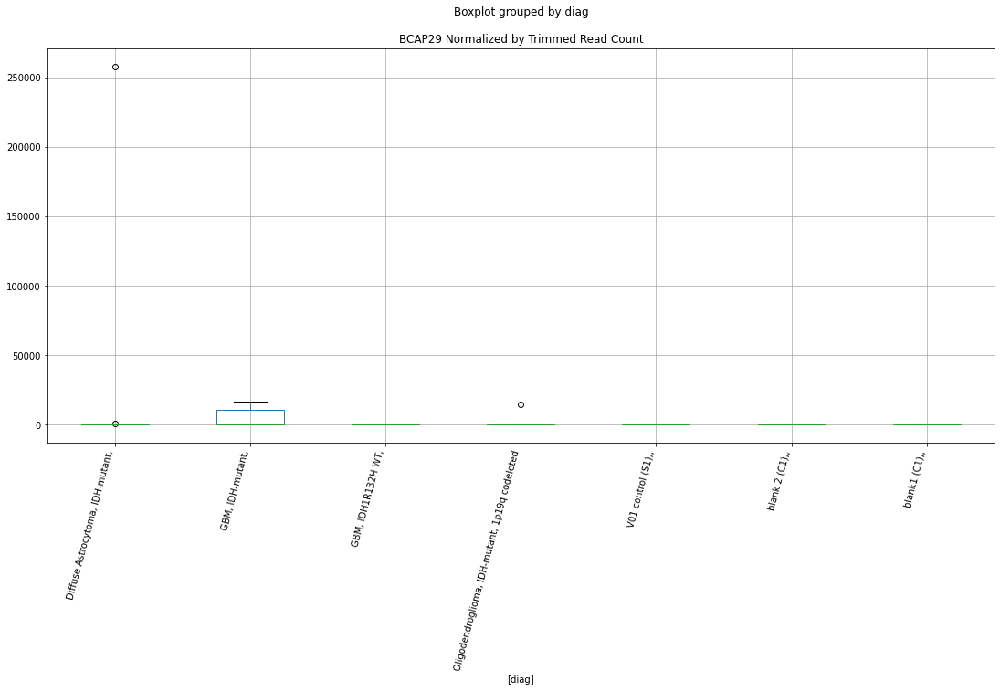

 p : 0.04678720255103329  ( t : 2.1347159881477613 ) :  Lexogen  :  cutadapt2  :  DHCR24-DT
Control and blanks
82     0.0
346    0.0
Name: DHCR24-DT, dtype: float64
214    0.0
Name: DHCR24-DT, dtype: float64
478    0.0
Name: DHCR24-DT, dtype: float64


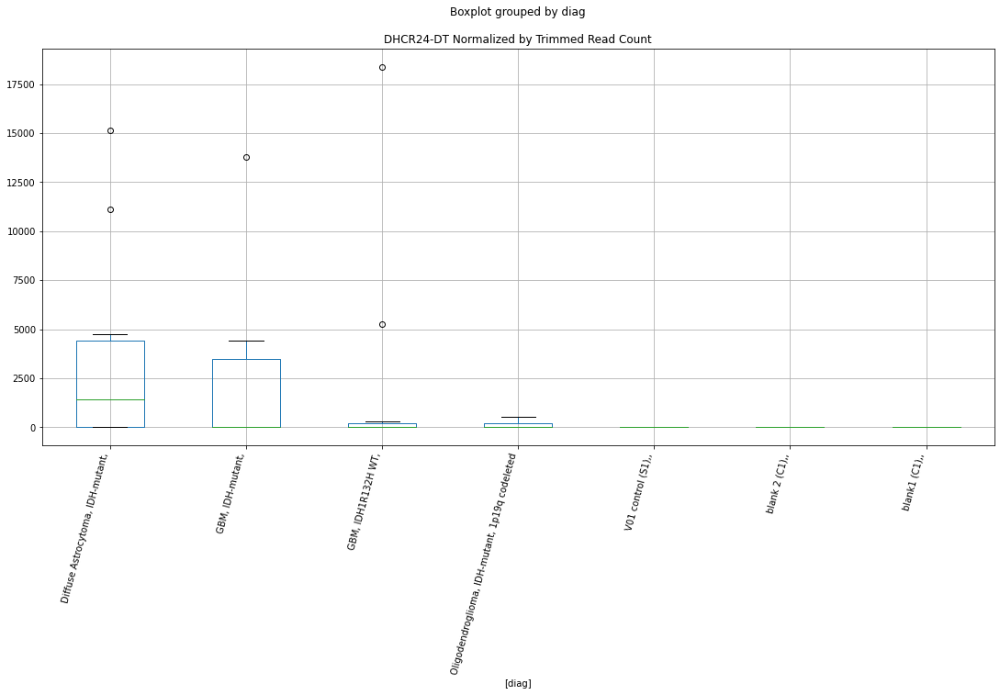

 p : 0.04684451496210182  ( t : 2.1340948602275303 ) :  D-plex  :  cutadapt2  :  ADRB2
Control and blanks
76     0.0
340    0.0
Name: ADRB2, dtype: float64
208    0.0
Name: ADRB2, dtype: float64
472    0.0
Name: ADRB2, dtype: float64


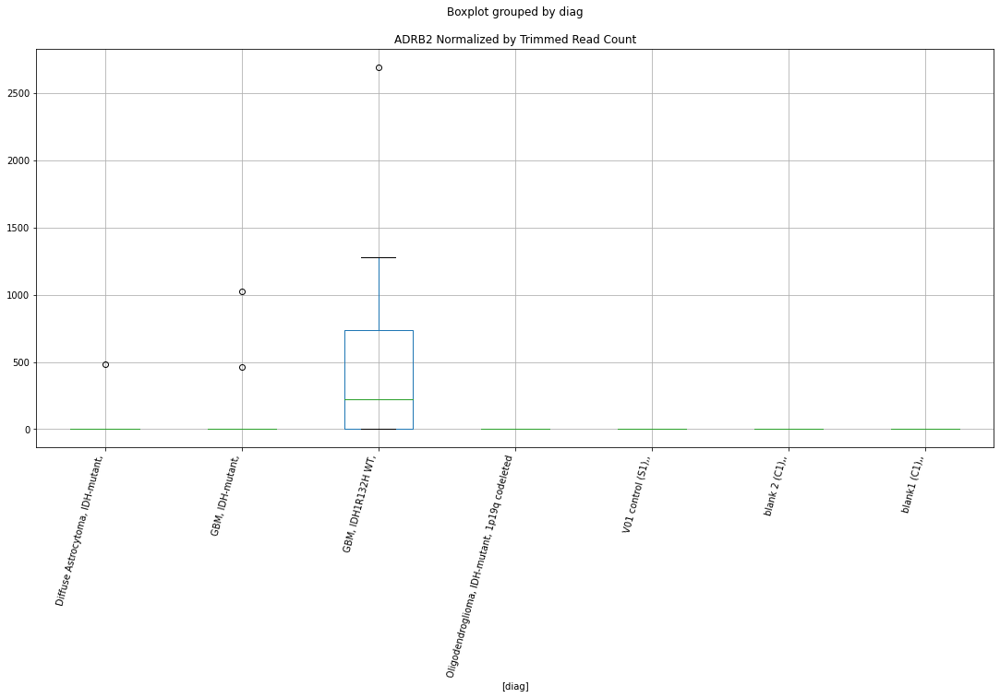

 p : 0.04691183800409023  ( t : 2.133366126052071 ) :  D-plex  :  cutadapt2  :  CCDC25
Control and blanks
76     0.0
340    0.0
Name: CCDC25, dtype: float64
208    5996.25
Name: CCDC25, dtype: float64
472    15604.81
Name: CCDC25, dtype: float64


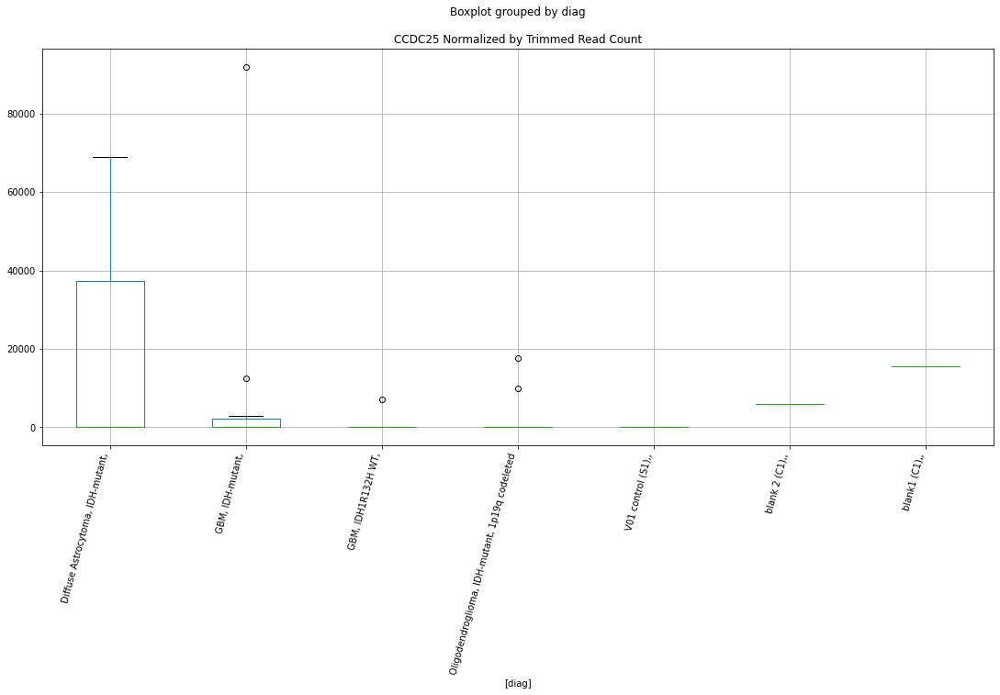

 p : 0.046956705285661156  ( t : 2.1328809924097962 ) :  D-plex  :  bbduk2  :  BAHCC1
Control and blanks
73     0.0
337    0.0
Name: BAHCC1, dtype: float64
205    3223.64
Name: BAHCC1, dtype: float64
469    0.0
Name: BAHCC1, dtype: float64


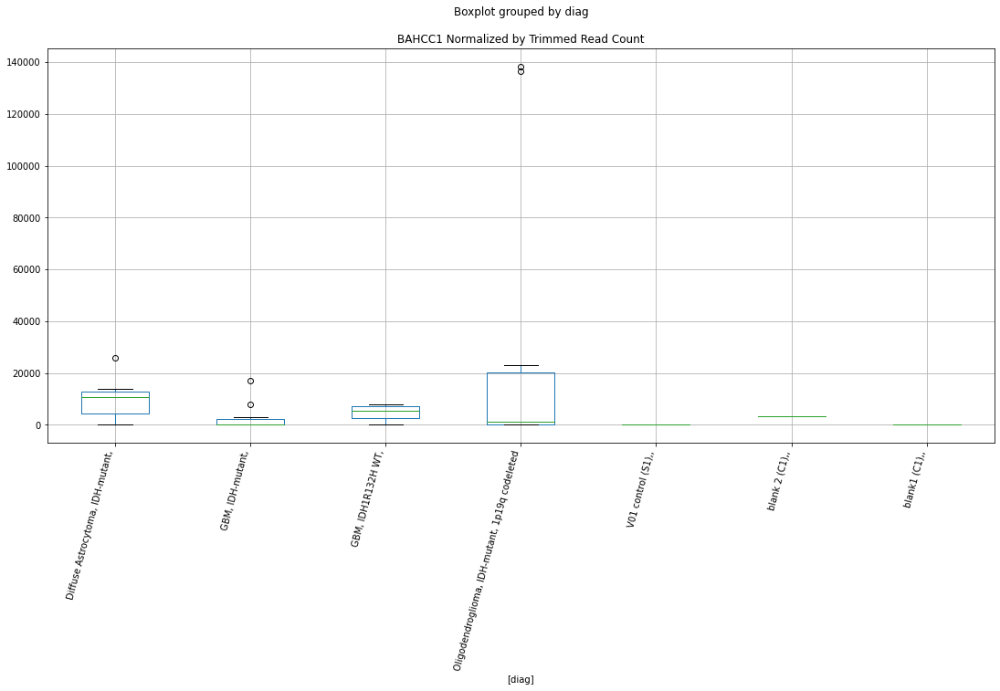

 p : 0.04698675970950517  ( t : 2.132556261226917 ) :  Lexogen  :  cutadapt2  :  CASKIN1
Control and blanks
82       0.00
346    420.87
Name: CASKIN1, dtype: float64
214    0.0
Name: CASKIN1, dtype: float64
478    0.0
Name: CASKIN1, dtype: float64


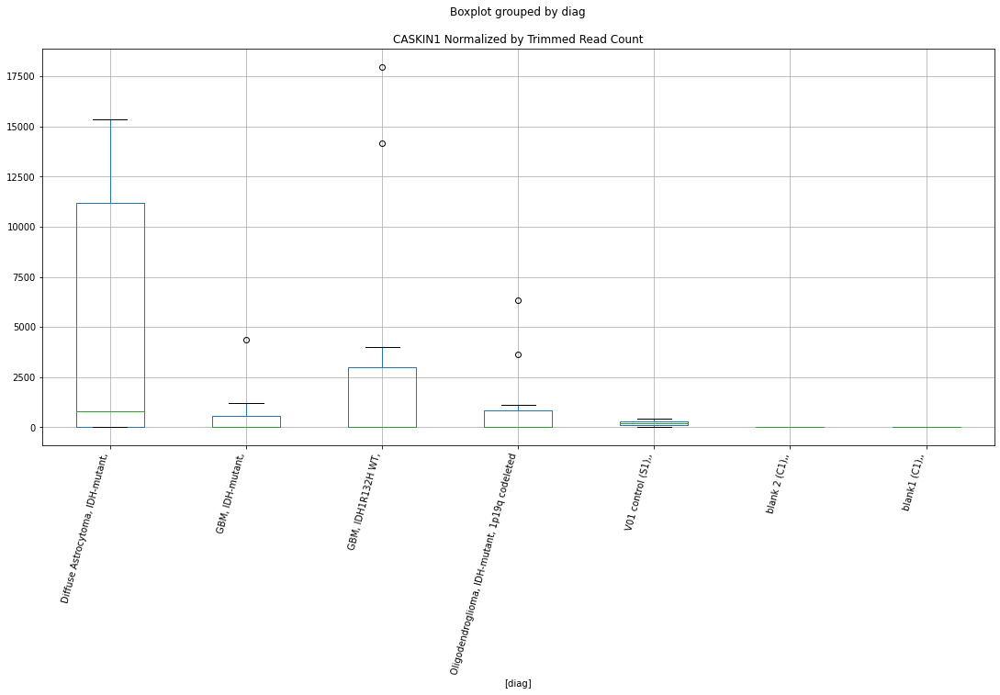

 p : 0.047027271491852166  ( t : 2.132118840323558 ) :  D-plex  :  cutadapt2  :  ADGRE1
Control and blanks
76     0.0
340    0.0
Name: ADGRE1, dtype: float64
208    5290.81
Name: ADGRE1, dtype: float64
472    6935.47
Name: ADGRE1, dtype: float64


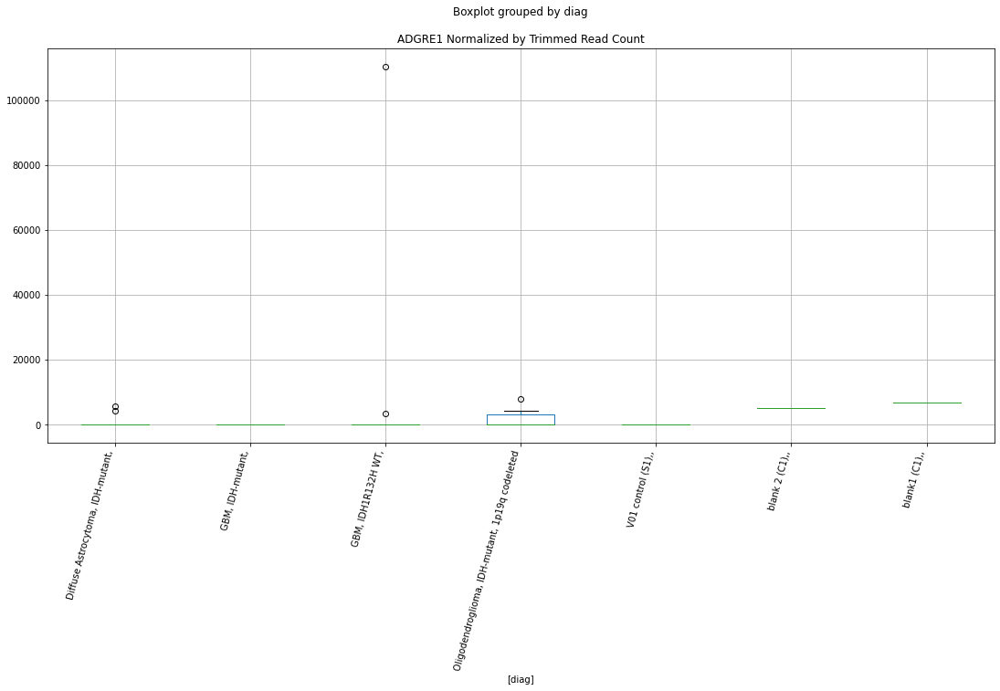

 p : 0.04714707585138704  ( t : 2.130827275591075 ) :  Lexogen  :  bbduk2  :  CASKIN1
Control and blanks
79     0.0
343    0.0
Name: CASKIN1, dtype: float64
211    0.0
Name: CASKIN1, dtype: float64
475    0.0
Name: CASKIN1, dtype: float64


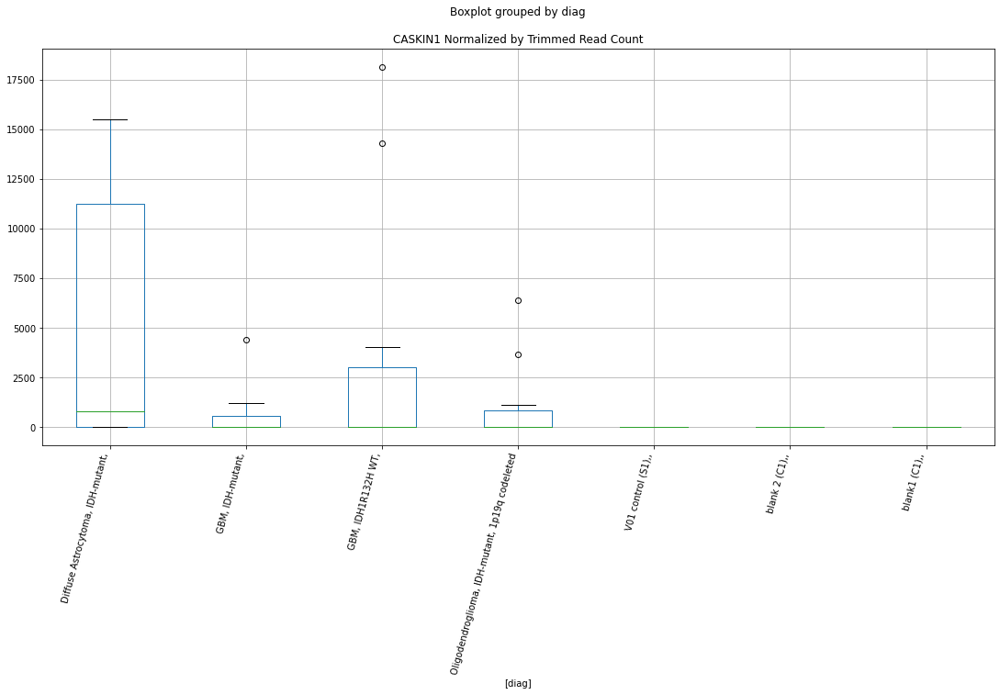

 p : 0.04714960126475488  ( t : 2.1308000823034057 ) :  D-plex  :  bbduk2  :  CCDC3
Control and blanks
73     0.0
337    0.0
Name: CCDC3, dtype: float64
205    1790.91
Name: CCDC3, dtype: float64
469    4140.69
Name: CCDC3, dtype: float64


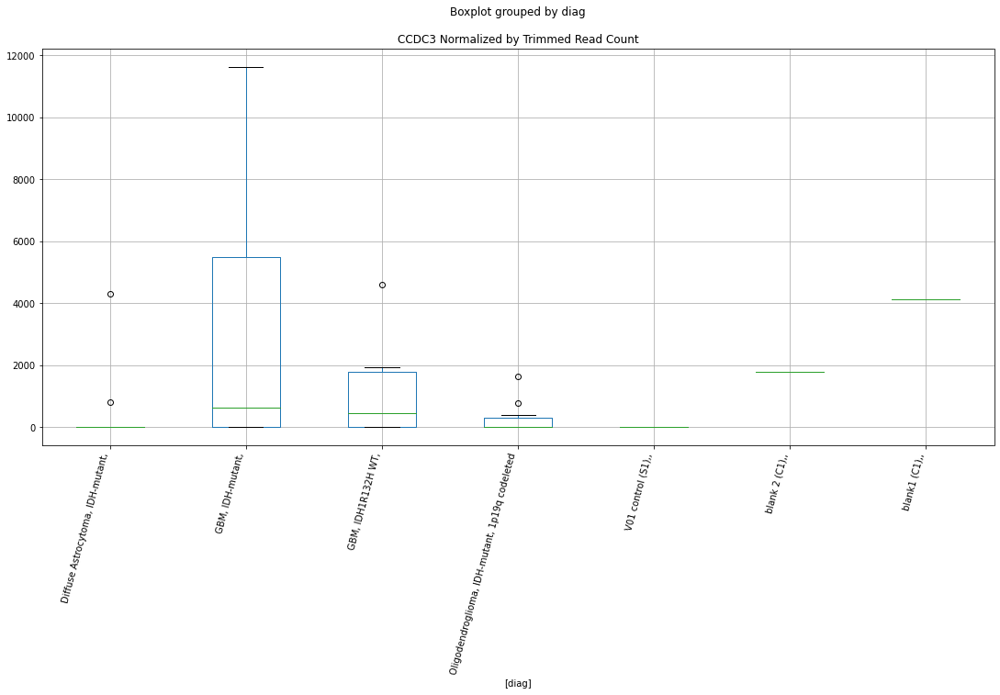

 p : 0.047250601108628935  ( t : 2.1297136177397333 ) :  D-plex  :  cutadapt2  :  C21orf58
Control and blanks
76     0.0
340    0.0
Name: C21orf58, dtype: float64
208    3174.48
Name: C21orf58, dtype: float64
472    9825.25
Name: C21orf58, dtype: float64


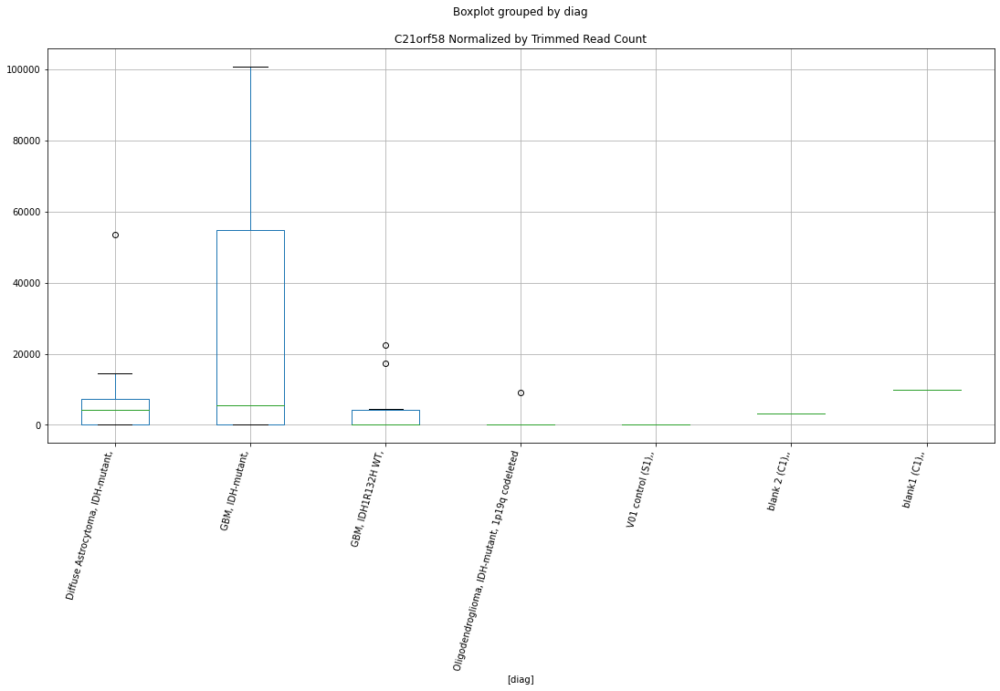

 p : 0.04727384846098594  ( t : 2.129463843652602 ) :  D-plex  :  bbduk2  :  COL4A2-AS2
Control and blanks
73     0.0
337    0.0
Name: COL4A2-AS2, dtype: float64
205    179.09
Name: COL4A2-AS2, dtype: float64
469    591.53
Name: COL4A2-AS2, dtype: float64


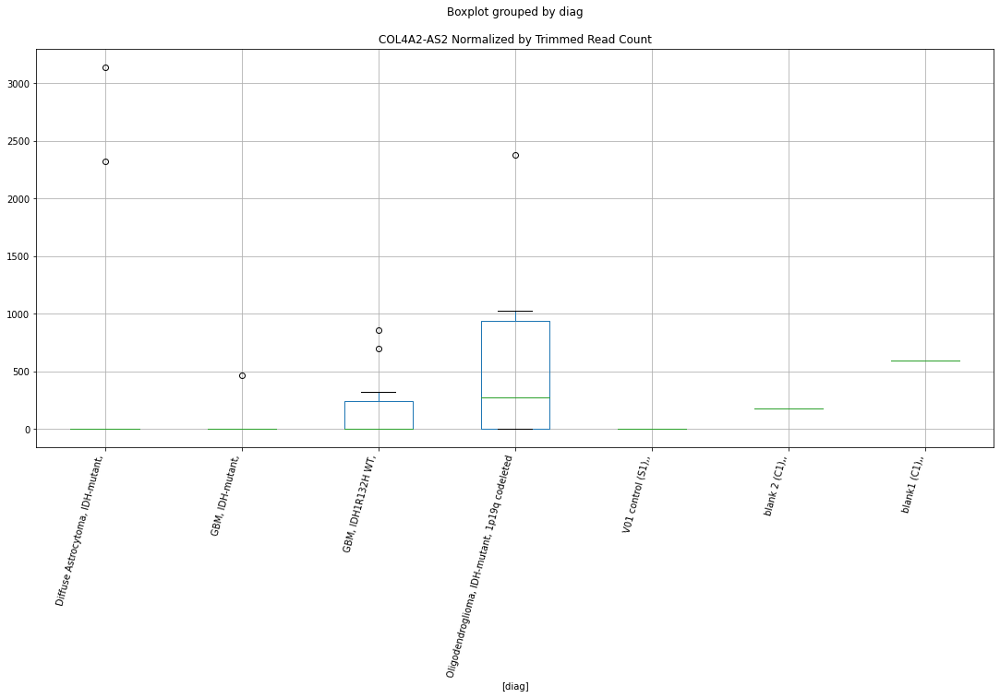

 p : 0.0473184491039233  ( t : 2.1289849590094905 ) :  D-plex  :  bbduk2  :  ACSBG1
Control and blanks
73      1546.02
337    17803.15
Name: ACSBG1, dtype: float64
205    3581.82
Name: ACSBG1, dtype: float64
469    9464.44
Name: ACSBG1, dtype: float64


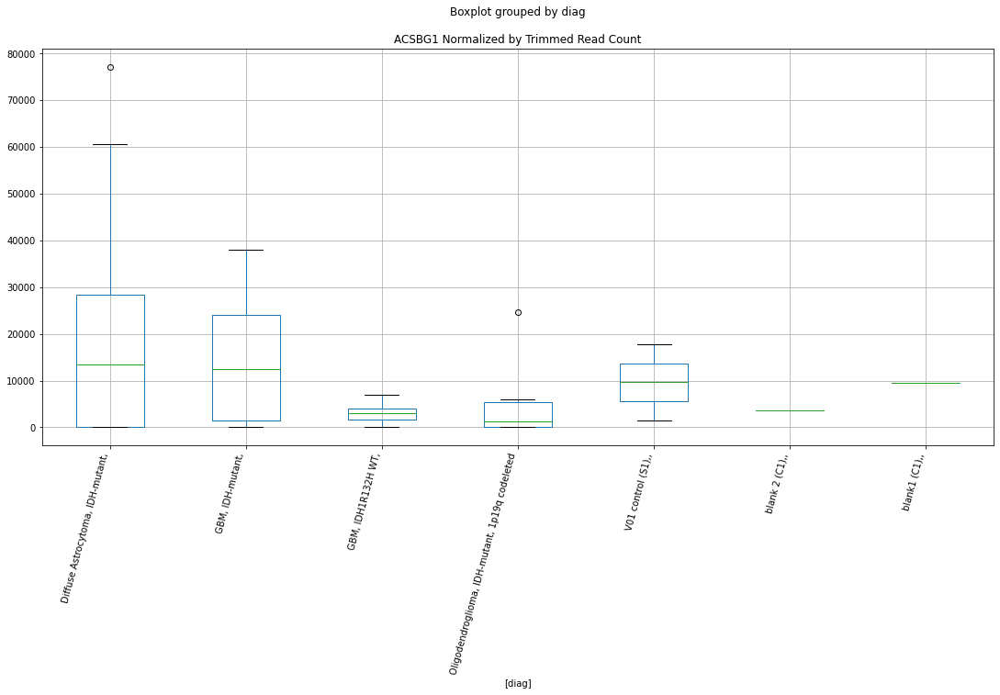

 p : 0.047464251976864345  ( t : 2.1274223152368736 ) :  D-plex  :  cutadapt2  :  BEND5
Control and blanks
76     0.0
340    0.0
Name: BEND5, dtype: float64
208    3527.2
Name: BEND5, dtype: float64
472    3467.74
Name: BEND5, dtype: float64


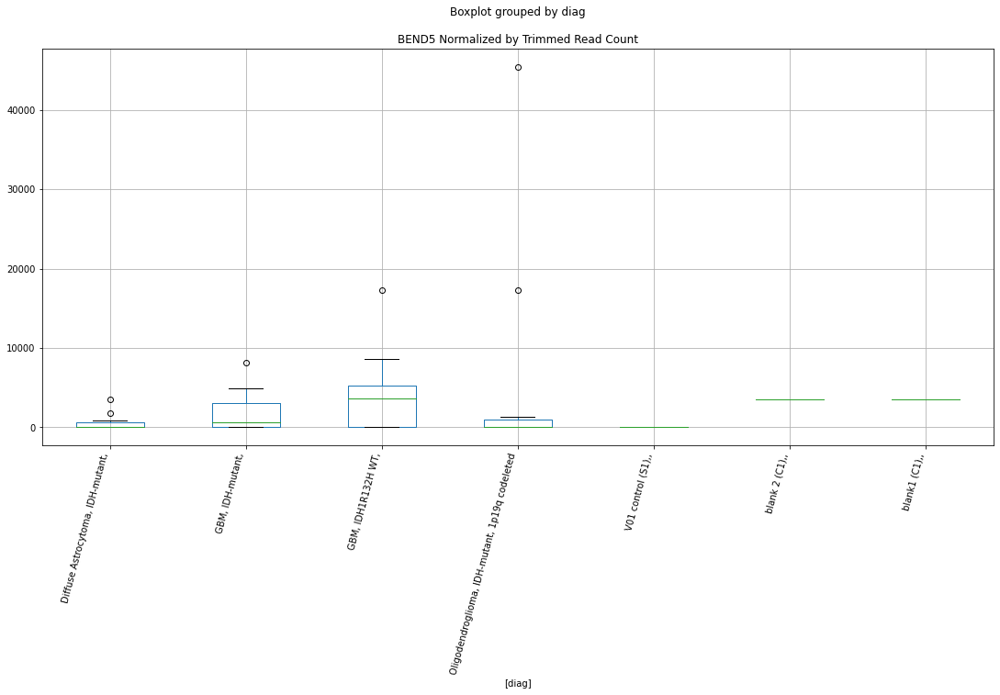

 p : 0.0475060873428505  ( t : 2.1269747521704807 ) :  D-plex  :  bbduk2  :  CYP1B1
Control and blanks
73     773.01
337      0.00
Name: CYP1B1, dtype: float64
205    1253.64
Name: CYP1B1, dtype: float64
469    1183.05
Name: CYP1B1, dtype: float64


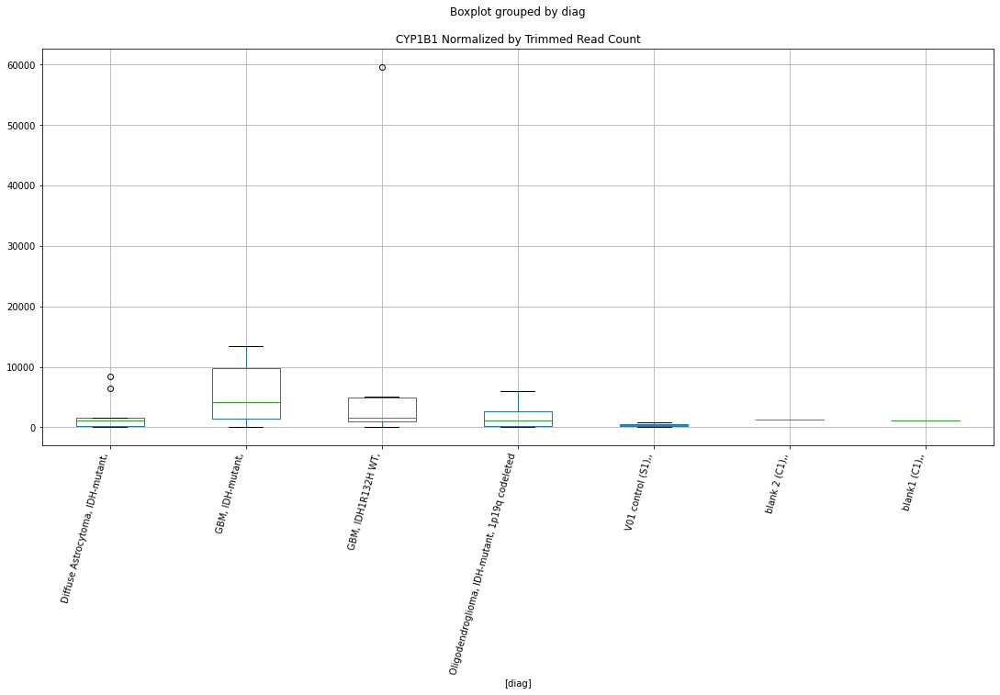

 p : 0.04753547905736923  ( t : 2.1266605285739404 ) :  Lexogen  :  cutadapt2  :  ARHGEF33
Control and blanks
82     0.0
346    0.0
Name: ARHGEF33, dtype: float64
214    0.0
Name: ARHGEF33, dtype: float64
478    0.0
Name: ARHGEF33, dtype: float64


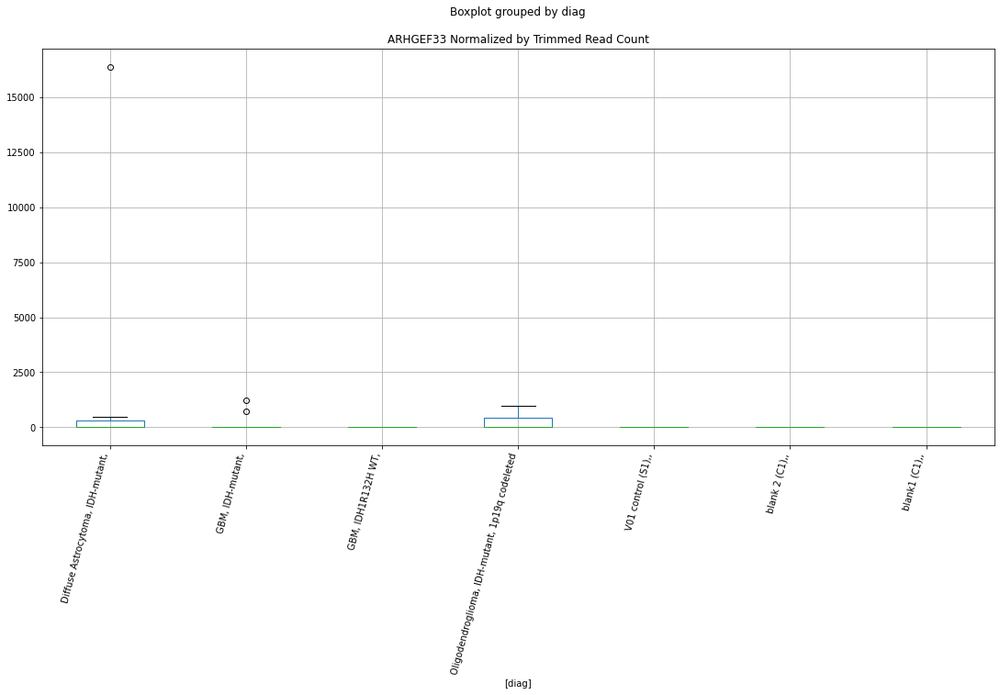

 p : 0.04754823669008262  ( t : 2.1265241932335943 ) :  D-plex  :  bbduk2  :  CLPX
Control and blanks
73     0.0
337    0.0
Name: CLPX, dtype: float64
205    1074.55
Name: CLPX, dtype: float64
469    0.0
Name: CLPX, dtype: float64


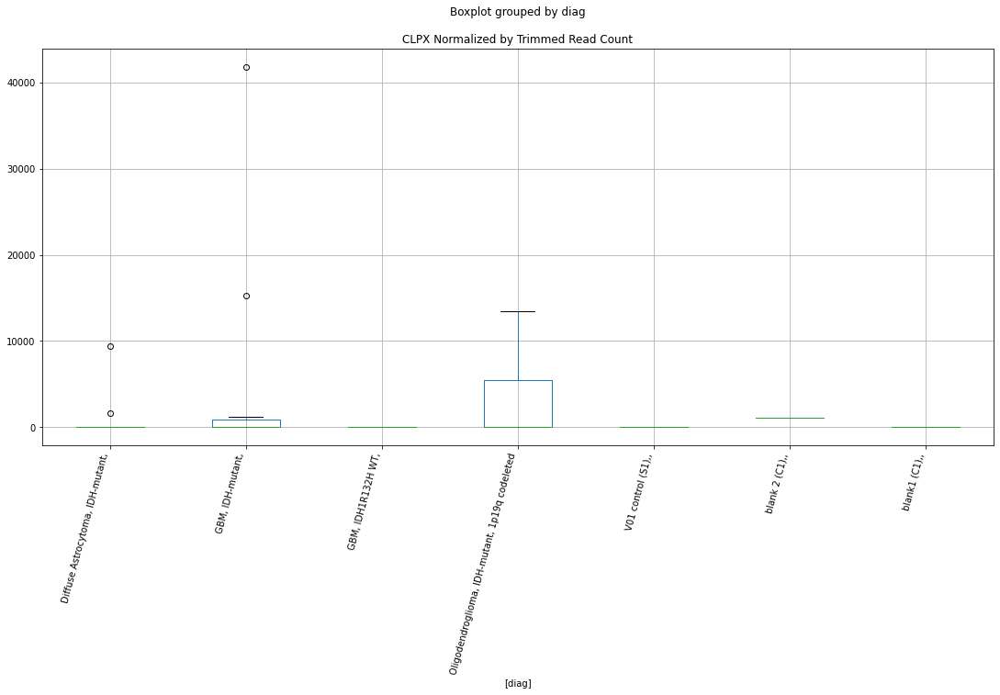

 p : 0.04756005344464246  ( t : 2.12639794239396 ) :  D-plex  :  cutadapt2  :  ANKS1A
Control and blanks
76     2272.84
340       0.00
Name: ANKS1A, dtype: float64
208    43031.89
Name: ANKS1A, dtype: float64
472    69354.7
Name: ANKS1A, dtype: float64


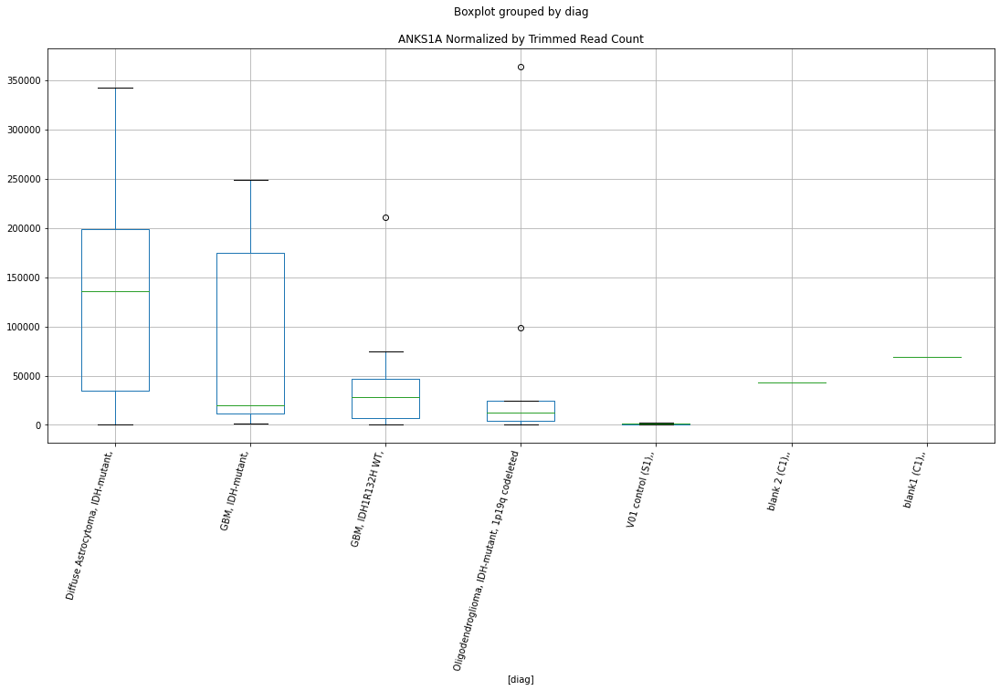

 p : 0.04759161989834742  ( t : 2.1260608248525656 ) :  Lexogen  :  cutadapt2  :  CRY2
Control and blanks
82     0.0
346    0.0
Name: CRY2, dtype: float64
214    0.0
Name: CRY2, dtype: float64
478    0.0
Name: CRY2, dtype: float64


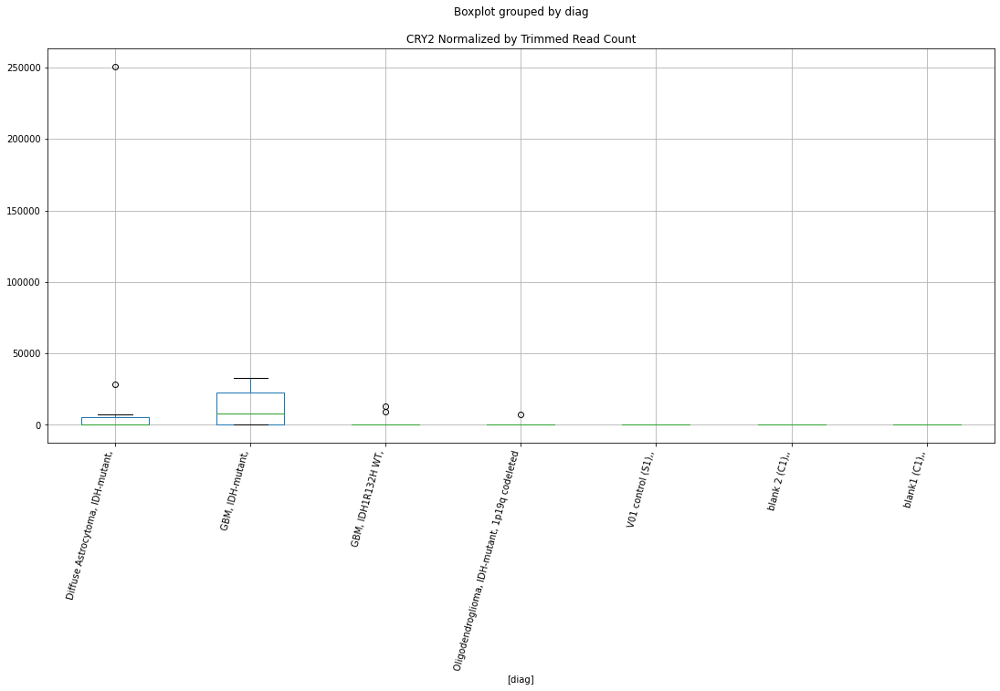

 p : 0.047604490918358035  ( t : 2.1259234258127457 ) :  Lexogen  :  bbduk2  :  CRY2
Control and blanks
79     0.0
343    0.0
Name: CRY2, dtype: float64
211    0.0
Name: CRY2, dtype: float64
475    0.0
Name: CRY2, dtype: float64


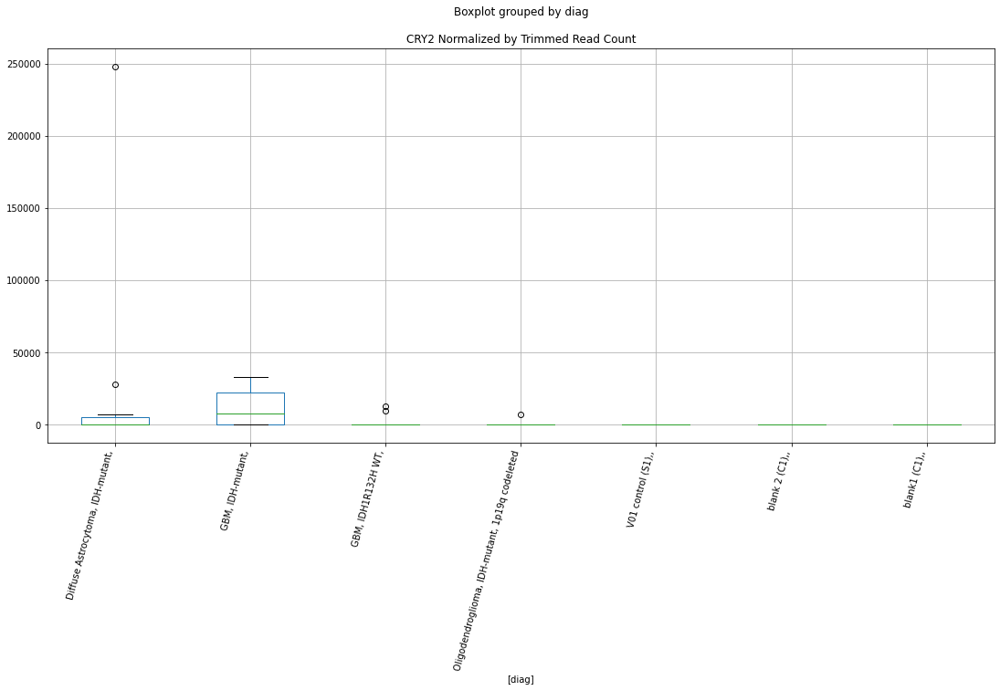

 p : 0.04764289882112695  ( t : 2.125513619926629 ) :  D-plex  :  cutadapt2  :  CD8B
Control and blanks
76     209101.52
340         0.00
Name: CD8B, dtype: float64
208    9523.45
Name: CD8B, dtype: float64
472    6935.47
Name: CD8B, dtype: float64


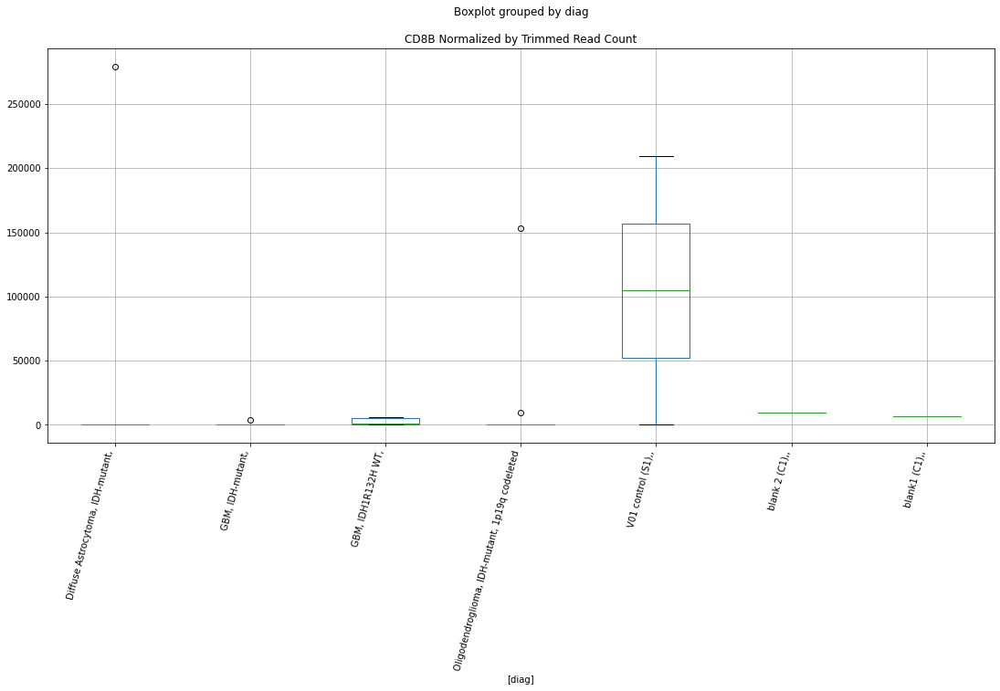

 p : 0.04773679627620221  ( t : 2.1245130161778523 ) :  D-plex  :  bbduk2  :  ADCYAP1
Control and blanks
73     2319.03
337       0.00
Name: ADCYAP1, dtype: float64
205    716.36
Name: ADCYAP1, dtype: float64
469    0.0
Name: ADCYAP1, dtype: float64


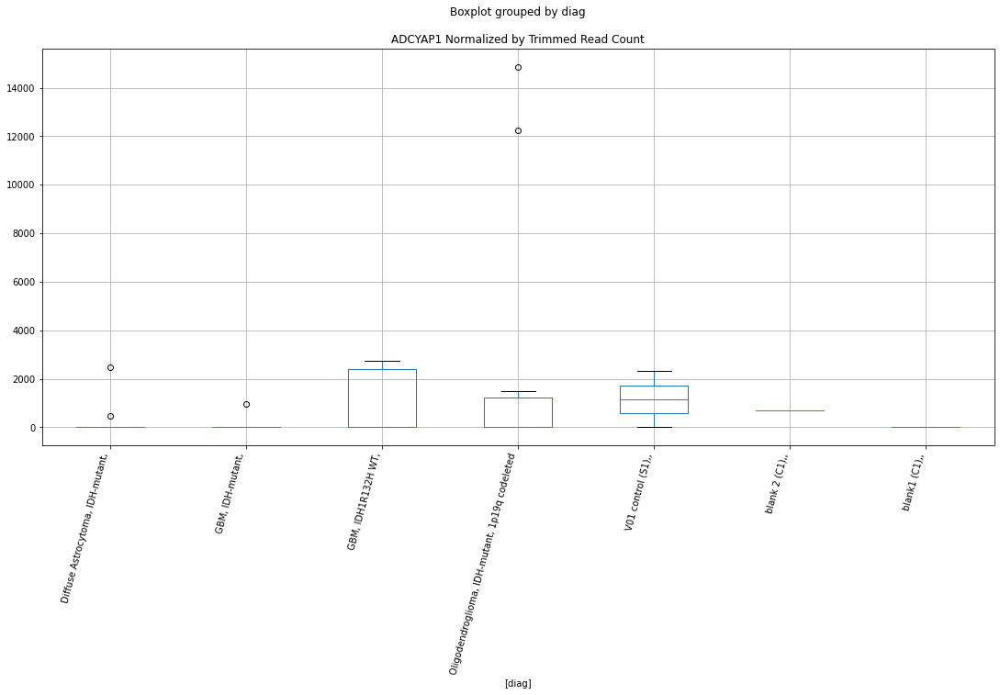

 p : 0.04775532592588691  ( t : 2.1243157697400306 ) :  D-plex  :  cutadapt2  :  CKB
Control and blanks
76     40911.17
340    79265.89
Name: CKB, dtype: float64
208    146378.98
Name: CKB, dtype: float64
472    13292.98
Name: CKB, dtype: float64


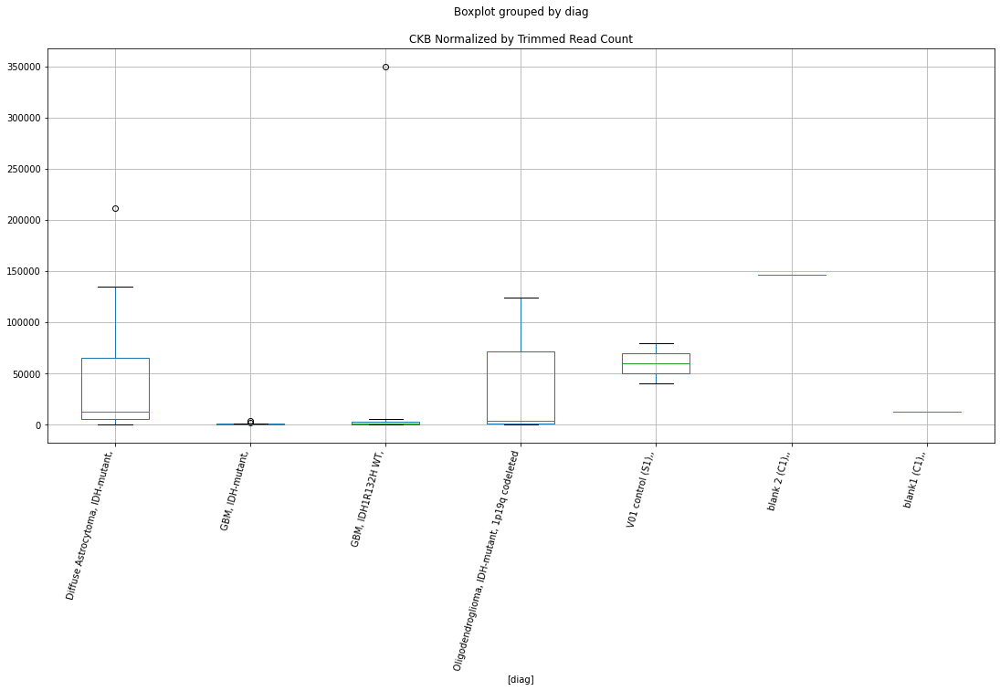

 p : 0.0477898376246252  ( t : 2.1239485816781207 ) :  D-plex  :  cutadapt2  :  ADCYAP1
Control and blanks
76     2272.84
340       0.00
Name: ADCYAP1, dtype: float64
208    1234.52
Name: ADCYAP1, dtype: float64
472    0.0
Name: ADCYAP1, dtype: float64


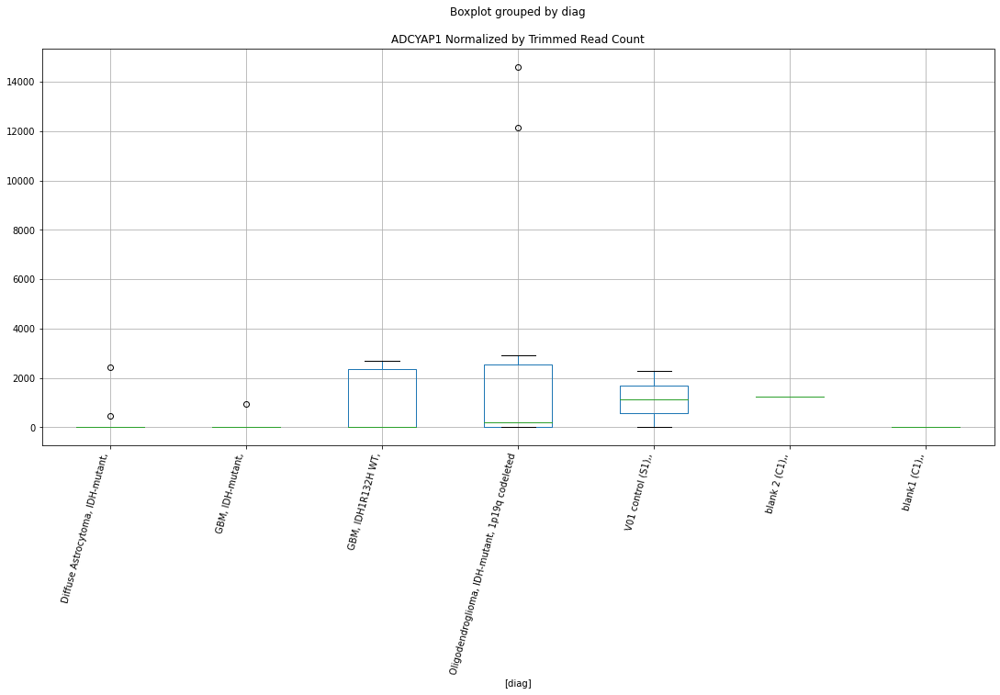

 p : 0.04781838053680134  ( t : 2.1236450811734913 ) :  Lexogen  :  cutadapt2  :  ATG16L2
Control and blanks
82     0.0
346    0.0
Name: ATG16L2, dtype: float64
214    0.0
Name: ATG16L2, dtype: float64
478    0.0
Name: ATG16L2, dtype: float64


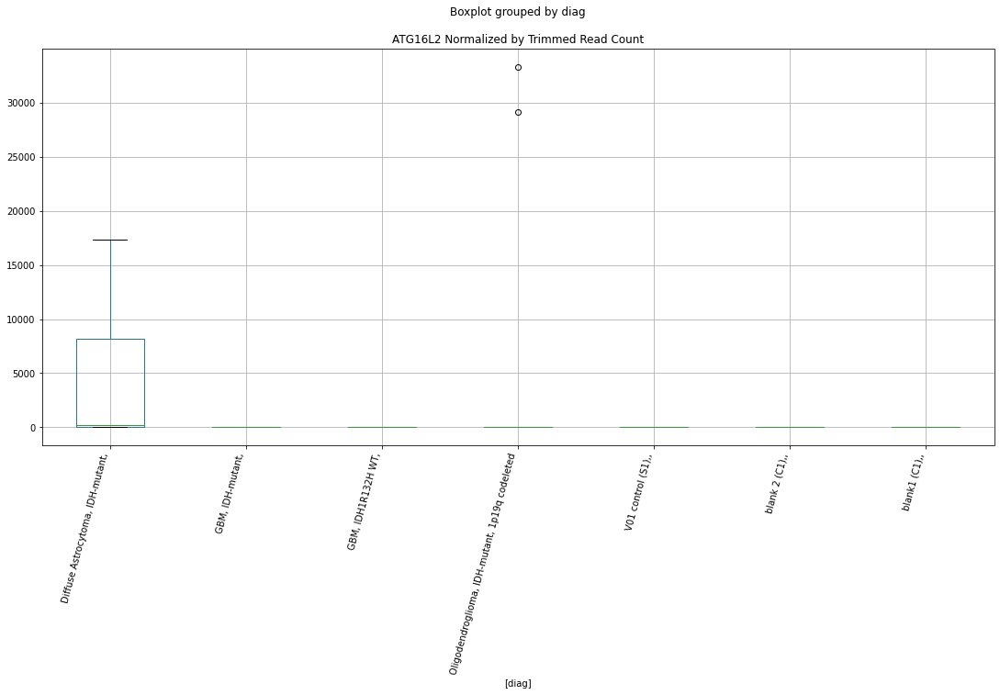

 p : 0.047876239952734004  ( t : 2.1230303605728604 ) :  D-plex  :  cutadapt2  :  CCR4
Control and blanks
76     0.0
340    0.0
Name: CCR4, dtype: float64
208    2469.04
Name: CCR4, dtype: float64
472    1155.91
Name: CCR4, dtype: float64


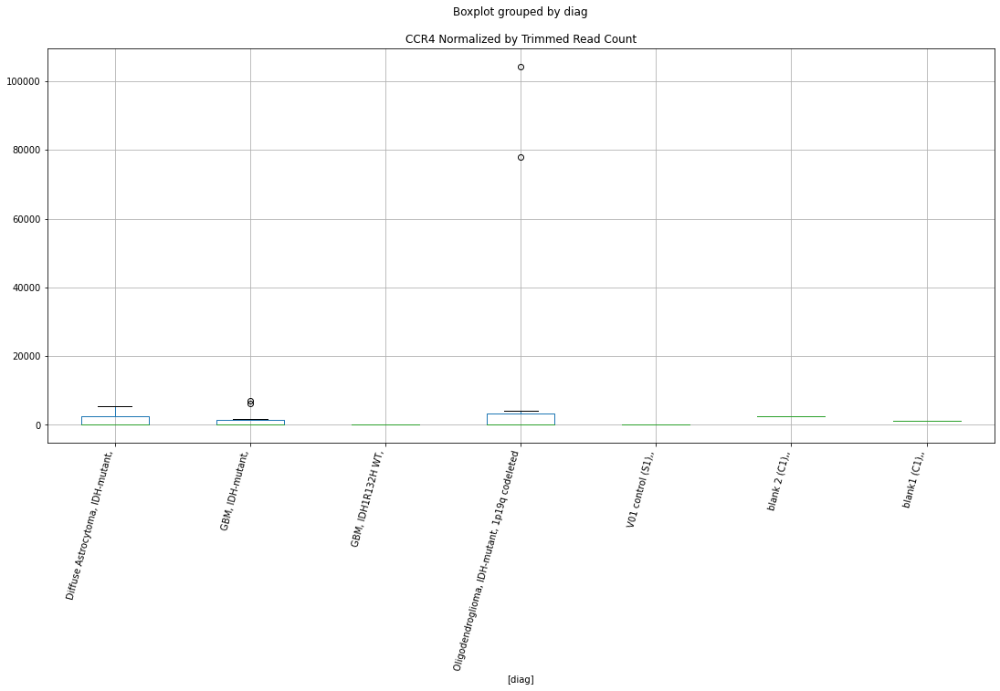

 p : 0.047899259980362874  ( t : 2.1227859751881724 ) :  D-plex  :  bbduk2  :  C3orf62
Control and blanks
73     0.0
337    0.0
Name: C3orf62, dtype: float64
205    358.18
Name: C3orf62, dtype: float64
469    591.53
Name: C3orf62, dtype: float64


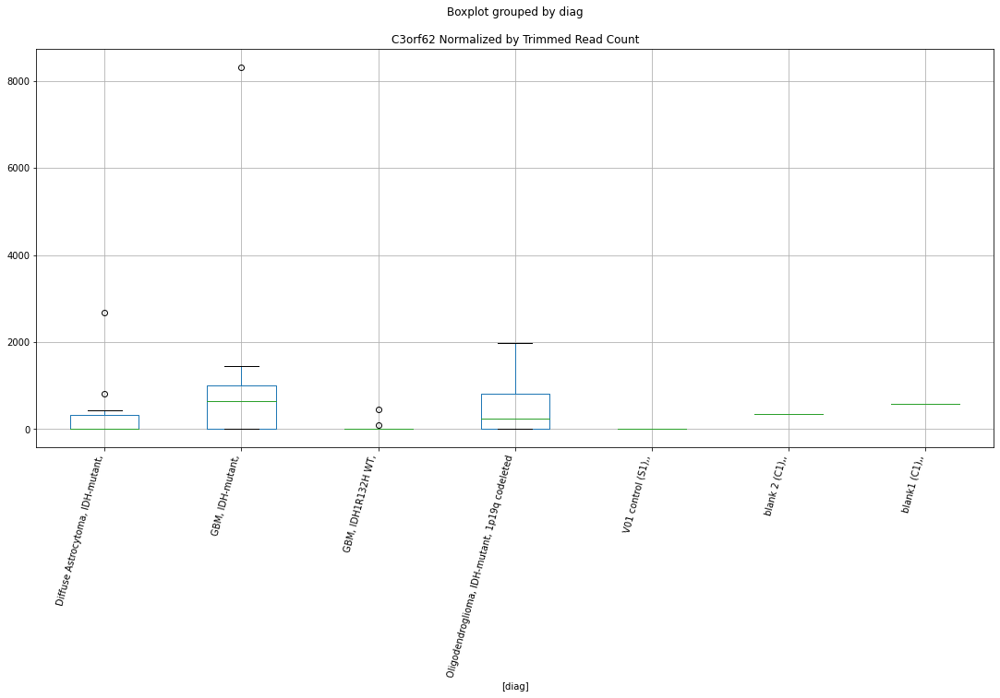

 p : 0.04794222460613753  ( t : 2.122330139911394 ) :  D-plex  :  bbduk2  :  CKB
Control and blanks
73     41742.45
337    80114.15
Name: CKB, dtype: float64
205    146854.58
Name: CKB, dtype: float64
469    13605.13
Name: CKB, dtype: float64


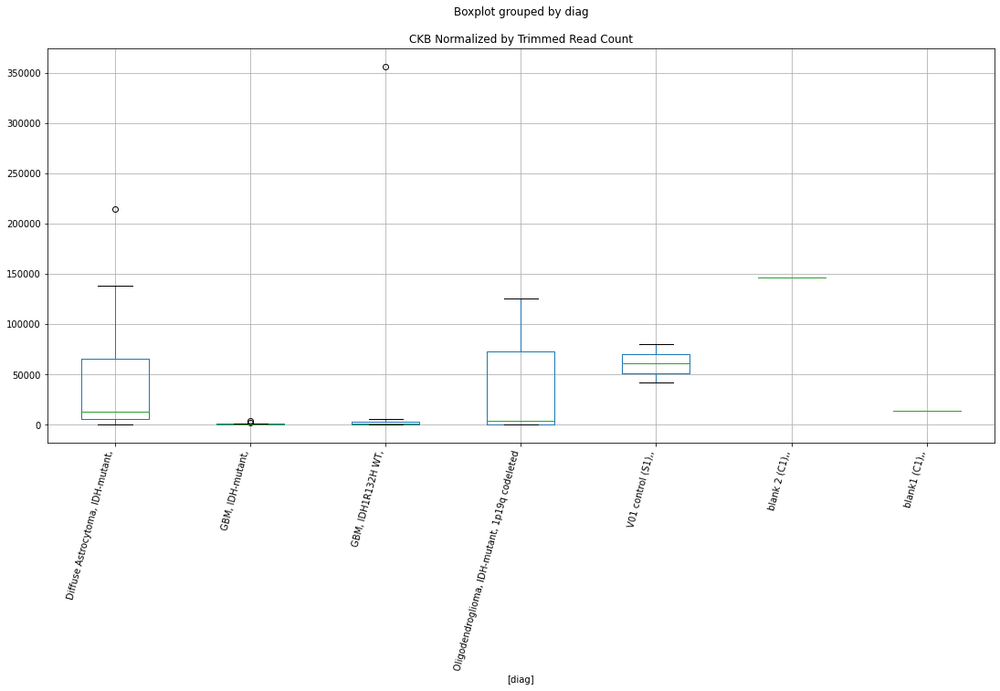

 p : 0.04795626067385343  ( t : 2.1221813042222113 ) :  D-plex  :  cutadapt2  :  CASP8
Control and blanks
76     0.0
340    0.0
Name: CASP8, dtype: float64
208    22221.39
Name: CASP8, dtype: float64
472    23118.23
Name: CASP8, dtype: float64


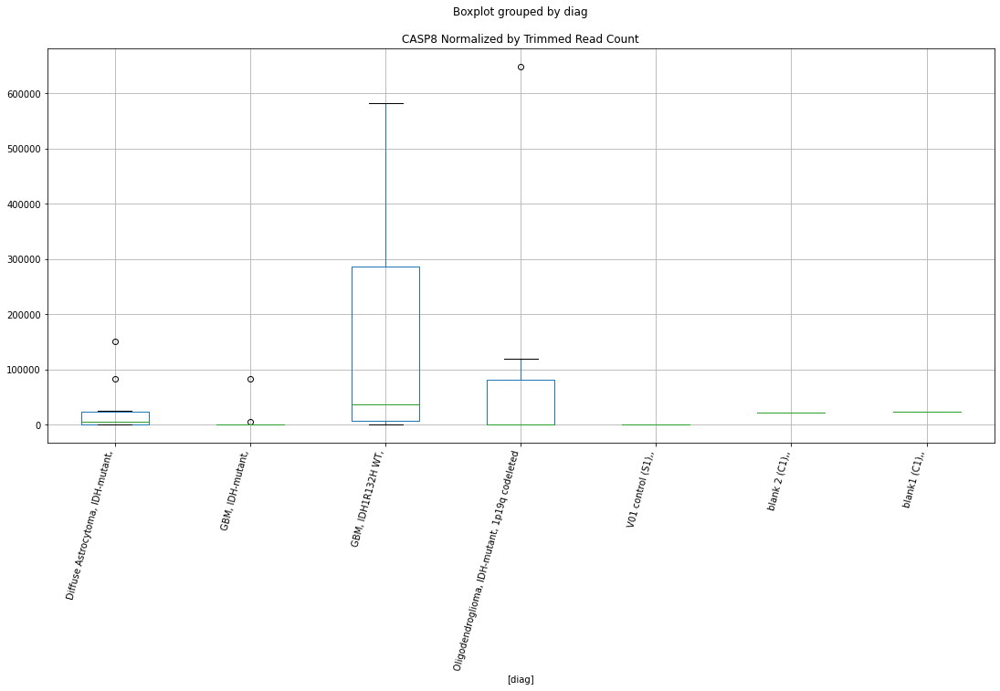

 p : 0.04800245001081953  ( t : 2.1216918016393236 ) :  D-plex  :  bbduk2  :  CCR4
Control and blanks
73     0.0
337    0.0
Name: CCR4, dtype: float64
205    2507.27
Name: CCR4, dtype: float64
469    1183.05
Name: CCR4, dtype: float64


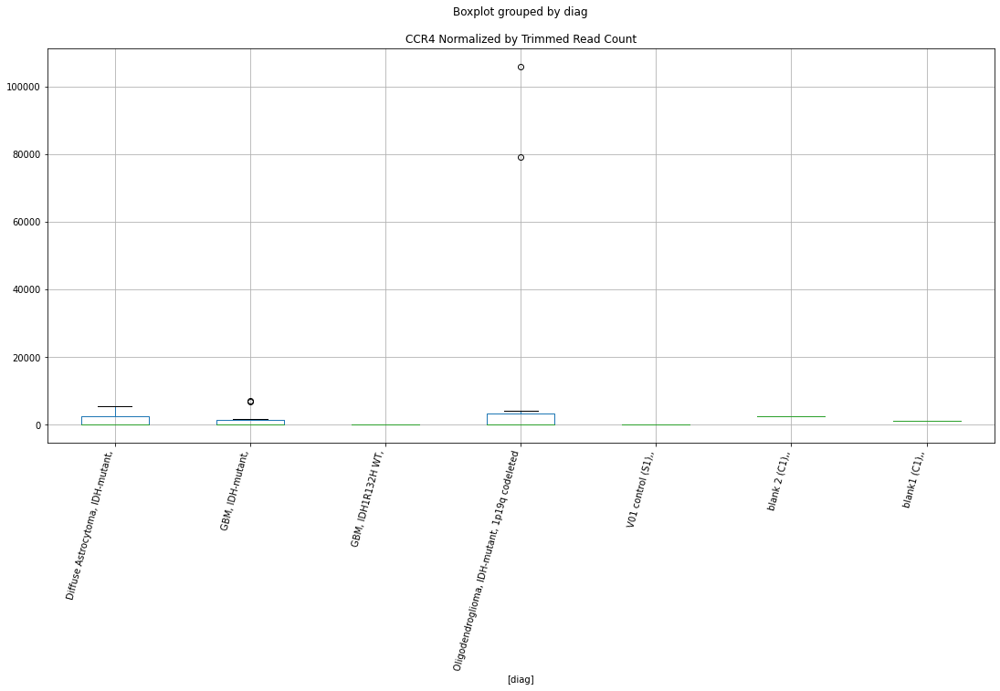

 p : 0.04802193645779988  ( t : 2.121485418028236 ) :  D-plex  :  bbduk2  :  C14orf93
Control and blanks
73     2319.03
337       0.00
Name: C14orf93, dtype: float64
205    40832.74
Name: C14orf93, dtype: float64
469    49096.77
Name: C14orf93, dtype: float64


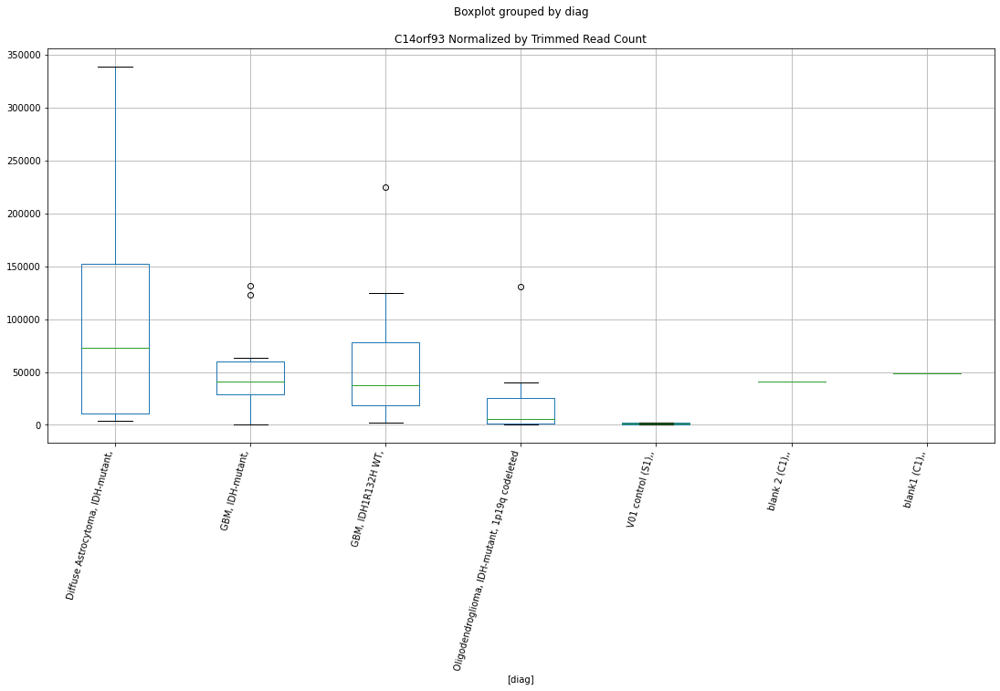

 p : 0.04812913664090866  ( t : 2.1203514086875885 ) :  D-plex  :  cutadapt2  :  CTSL
Control and blanks
76     1515.23
340       0.00
Name: CTSL, dtype: float64
208    2116.32
Name: CTSL, dtype: float64
472    4623.65
Name: CTSL, dtype: float64


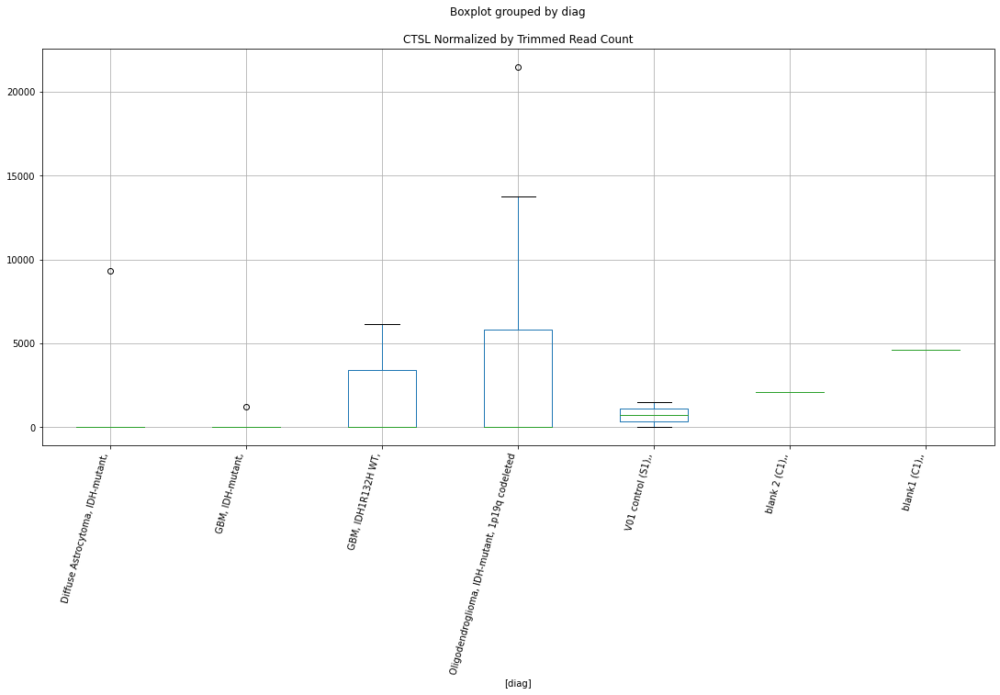

 p : 0.048194599542905996  ( t : 2.119660045056925 ) :  D-plex  :  bbduk2  :  CASP8
Control and blanks
73     0.0
337    0.0
Name: CASP8, dtype: float64
205    26684.55
Name: CASP8, dtype: float64
469    23661.09
Name: CASP8, dtype: float64


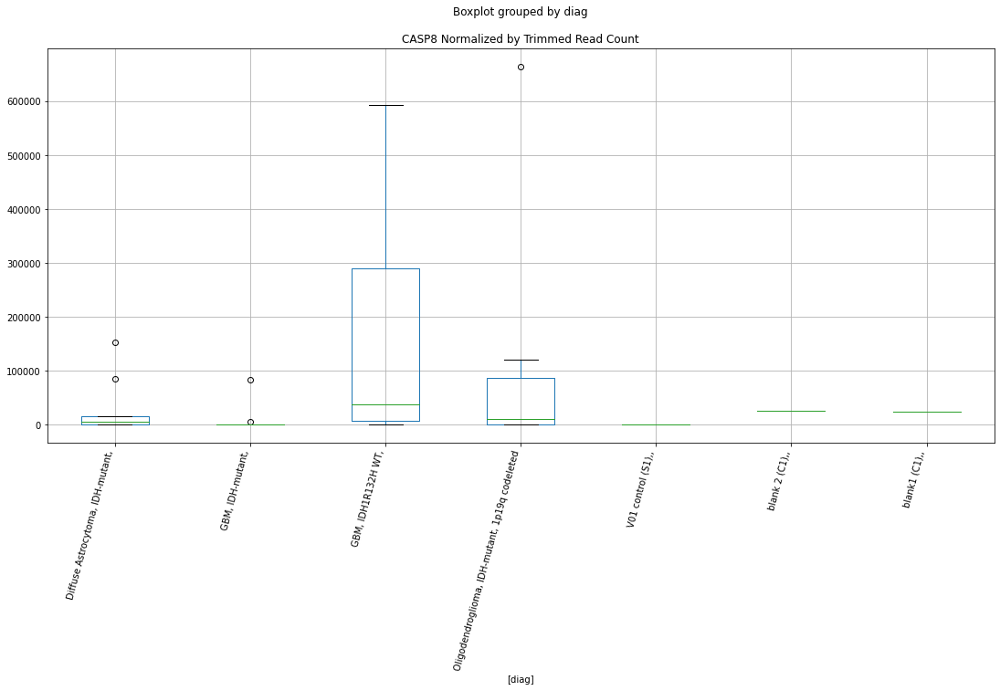

 p : 0.048272815609628913  ( t : 2.1188351138996855 ) :  D-plex  :  bbduk2  :  ASIC1
Control and blanks
73     0.0
337    0.0
Name: ASIC1, dtype: float64
205    8059.09
Name: ASIC1, dtype: float64
469    591.53
Name: ASIC1, dtype: float64


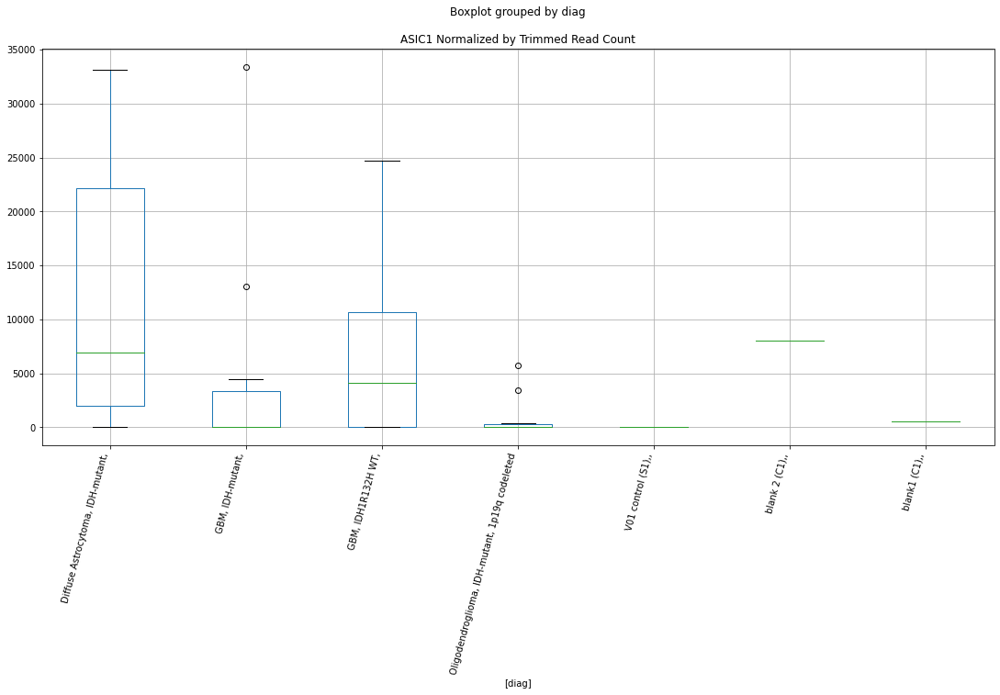

 p : 0.048303210106225195  ( t : 2.118514876859691 ) :  Lexogen  :  cutadapt2  :  ANKUB1
Control and blanks
82        0.00
346    1262.61
Name: ANKUB1, dtype: float64
214    0.0
Name: ANKUB1, dtype: float64
478    0.0
Name: ANKUB1, dtype: float64


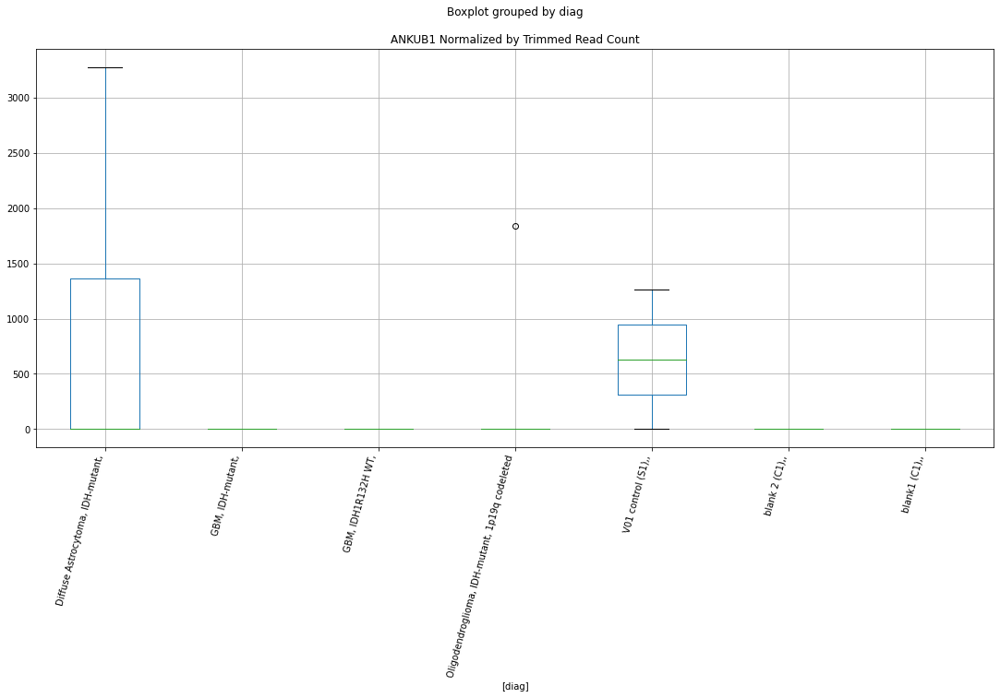

 p : 0.04832399314646388  ( t : 2.1182960119425003 ) :  Lexogen  :  cutadapt2  :  ANKRD50
Control and blanks
82       0.0
346    631.3
Name: ANKRD50, dtype: float64
214    2441.04
Name: ANKRD50, dtype: float64
478    22083.82
Name: ANKRD50, dtype: float64


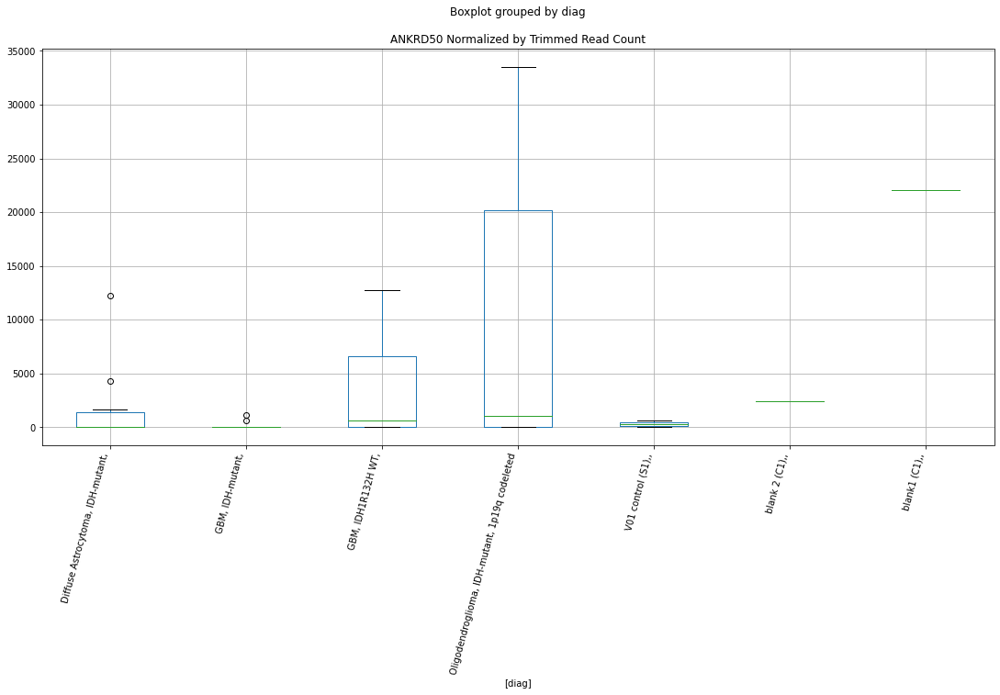

 p : 0.04832589432383149  ( t : 2.1182759950402317 ) :  D-plex  :  bbduk2  :  CSDE1
Control and blanks
73     0.0
337    0.0
Name: CSDE1, dtype: float64
205    4298.18
Name: CSDE1, dtype: float64
469    0.0
Name: CSDE1, dtype: float64


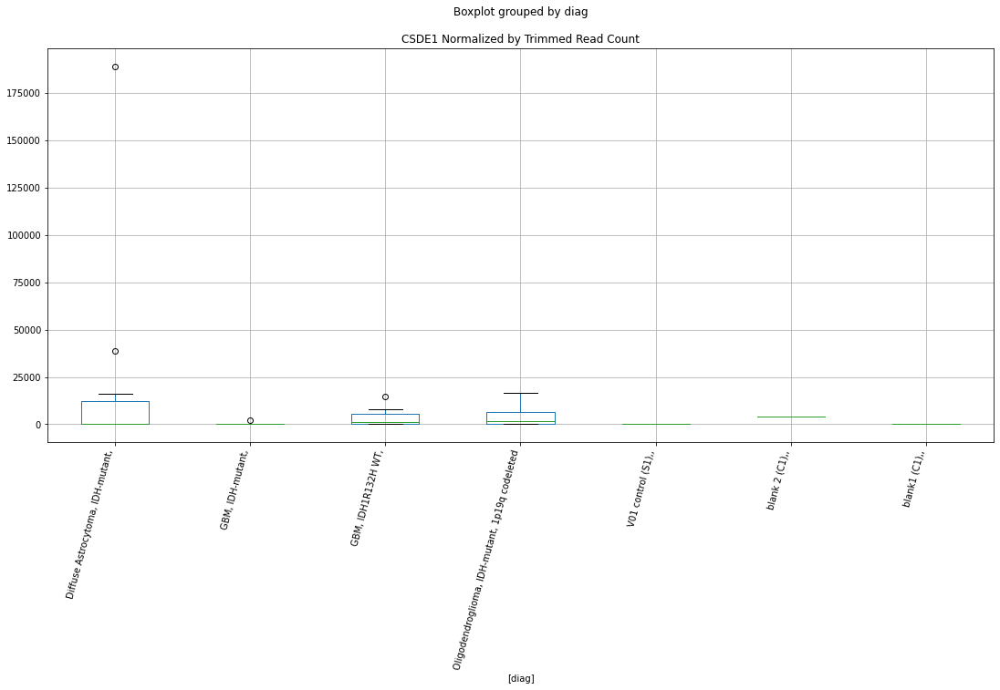

 p : 0.048366713559712685  ( t : 2.1178463949569934 ) :  D-plex  :  bbduk2  :  ABLIM2
Control and blanks
73     0.0
337    0.0
Name: ABLIM2, dtype: float64
205    47996.38
Name: ABLIM2, dtype: float64
469    90503.68
Name: ABLIM2, dtype: float64


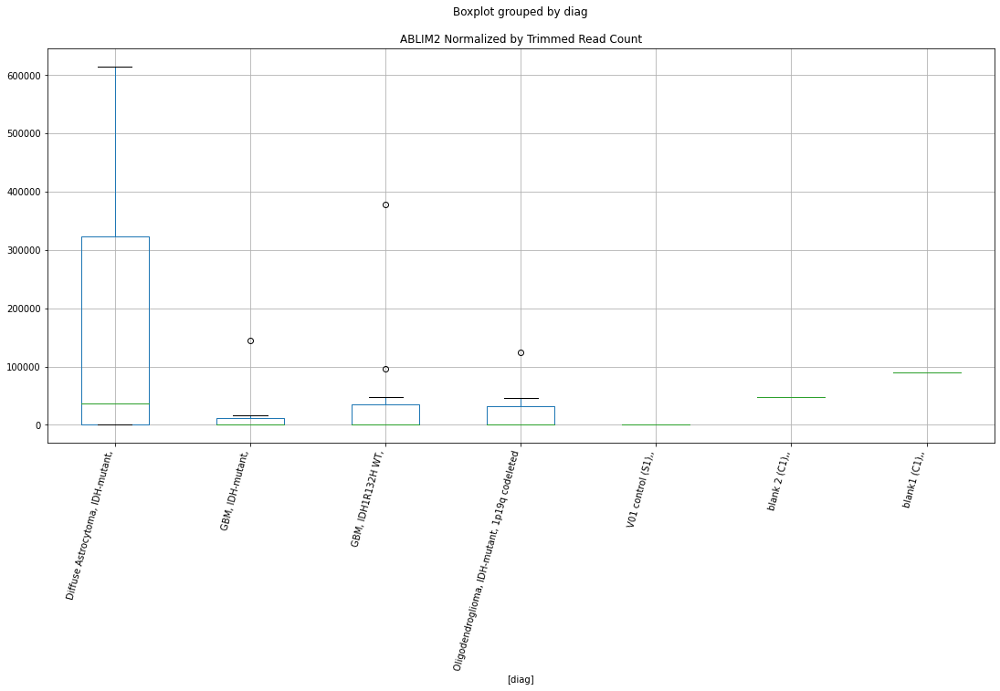

 p : 0.04844074518469978  ( t : 2.1170680943524958 ) :  Lexogen  :  bbduk2  :  ABCC5
Control and blanks
79        0.00
343    1698.51
Name: ABCC5, dtype: float64
211    0.0
Name: ABCC5, dtype: float64
475    0.0
Name: ABCC5, dtype: float64


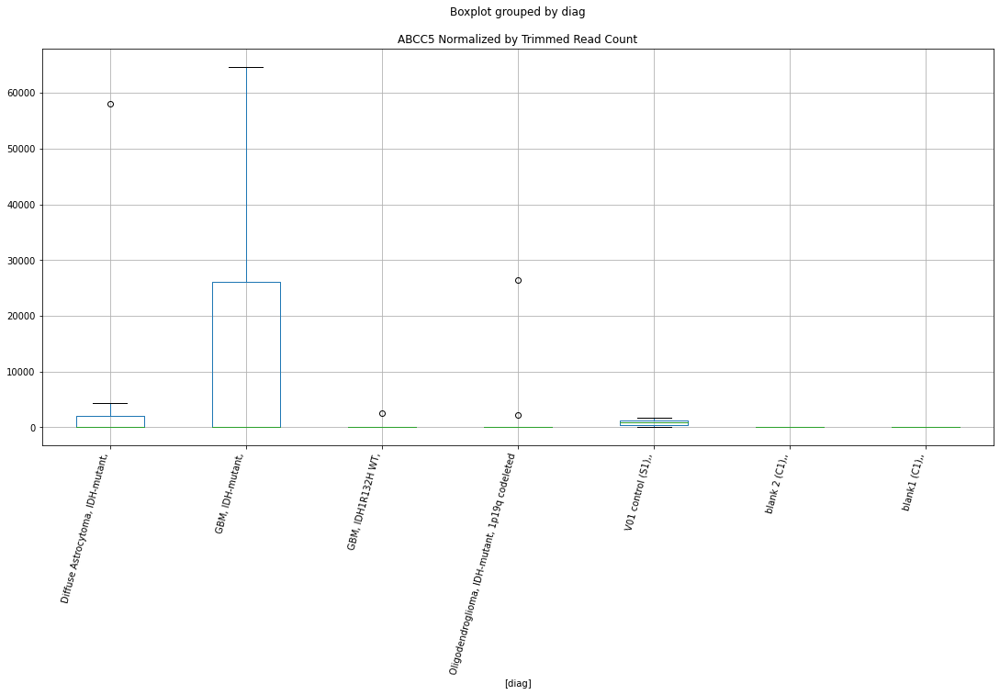

 p : 0.04844704250286594  ( t : 2.1170019401176363 ) :  D-plex  :  cutadapt2  :  DAZAP2
Control and blanks
76     9091.37
340       0.00
Name: DAZAP2, dtype: float64
208    2292.68
Name: DAZAP2, dtype: float64
472    4045.69
Name: DAZAP2, dtype: float64


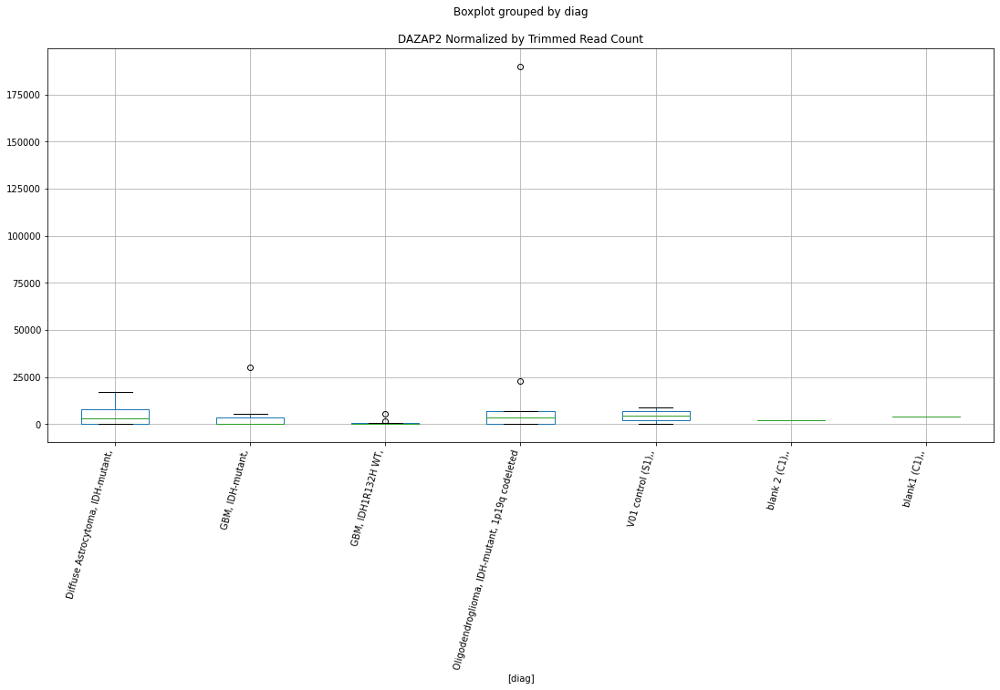

 p : 0.0484672462774675  ( t : 2.1167897493962844 ) :  Lexogen  :  bbduk2  :  ATG16L2
Control and blanks
79     0.0
343    0.0
Name: ATG16L2, dtype: float64
211    0.0
Name: ATG16L2, dtype: float64
475    0.0
Name: ATG16L2, dtype: float64


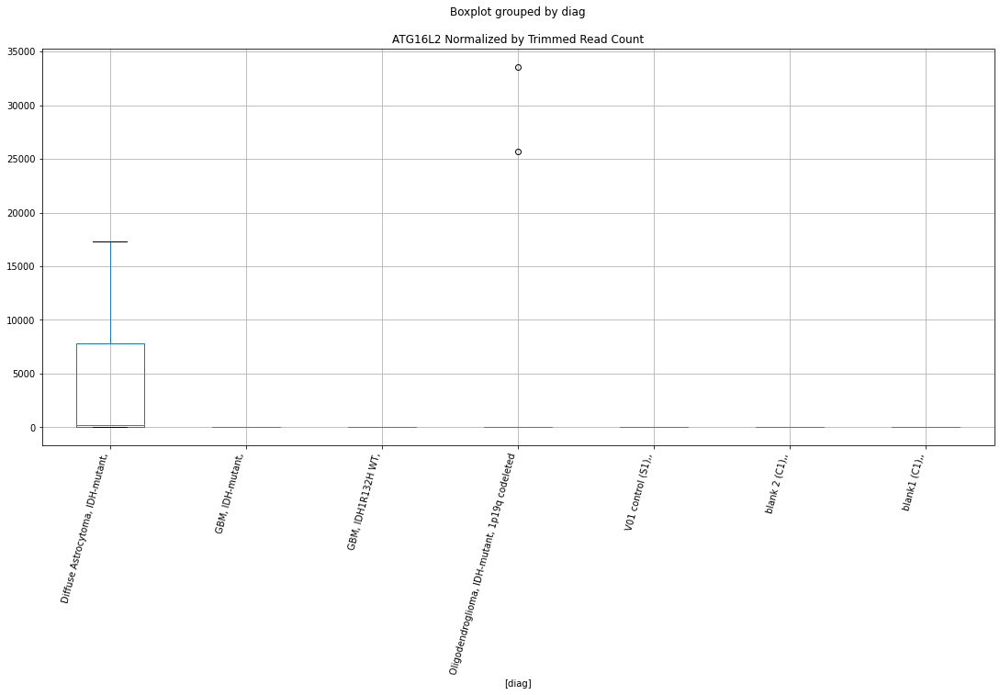

 p : 0.0485235381856954  ( t : 2.116198966523865 ) :  D-plex  :  bbduk2  :  ARHGAP32
Control and blanks
73         0.00
337    35606.29
Name: ARHGAP32, dtype: float64
205    14506.37
Name: ARHGAP32, dtype: float64
469    30167.89
Name: ARHGAP32, dtype: float64


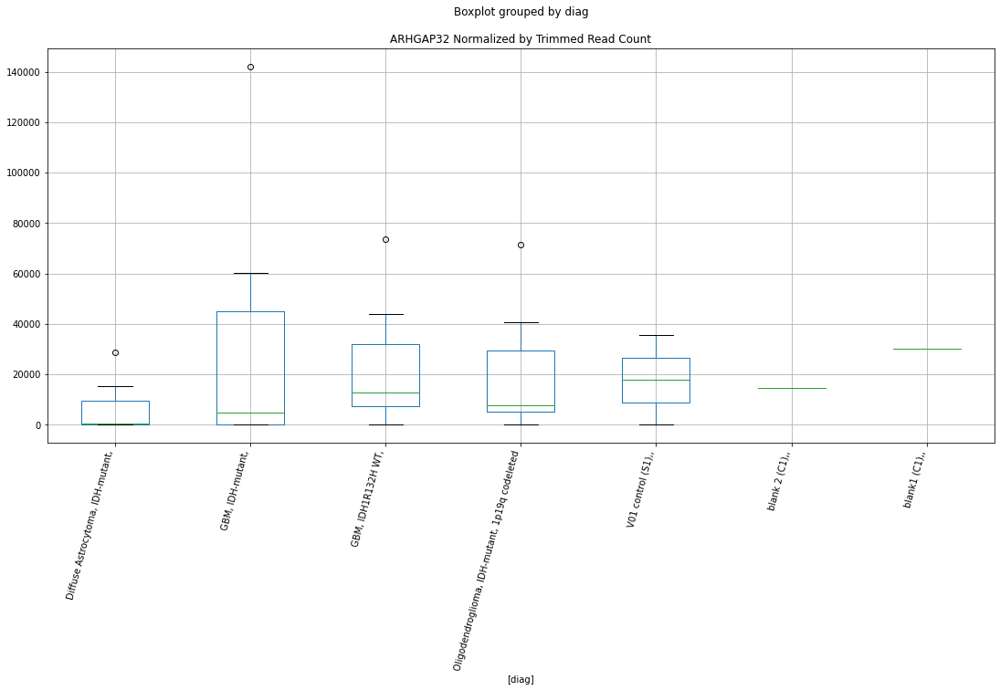

 p : 0.0486079159084825  ( t : 2.115314590956073 ) :  D-plex  :  bbduk2  :  C16orf54
Control and blanks
73        0.00
337    8011.42
Name: C16orf54, dtype: float64
205    537.27
Name: C16orf54, dtype: float64
469    2366.11
Name: C16orf54, dtype: float64


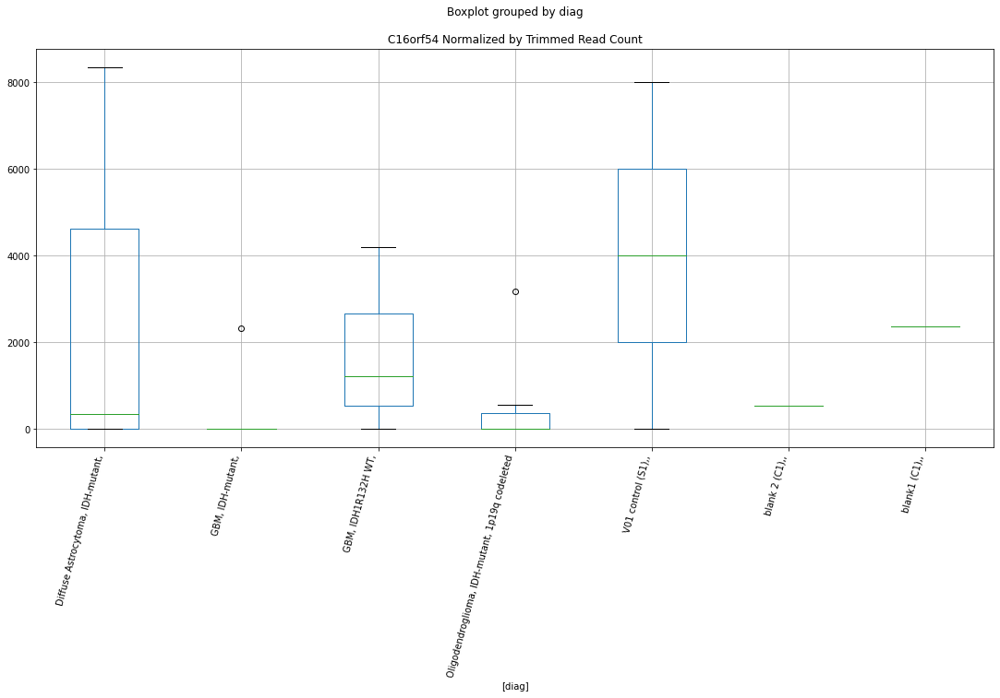

 p : 0.048626152986871826  ( t : 2.1151236290946693 ) :  D-plex  :  cutadapt2  :  ARHGAP4
Control and blanks
76     0.0
340    0.0
Name: ARHGAP4, dtype: float64
208    1410.88
Name: ARHGAP4, dtype: float64
472    0.0
Name: ARHGAP4, dtype: float64


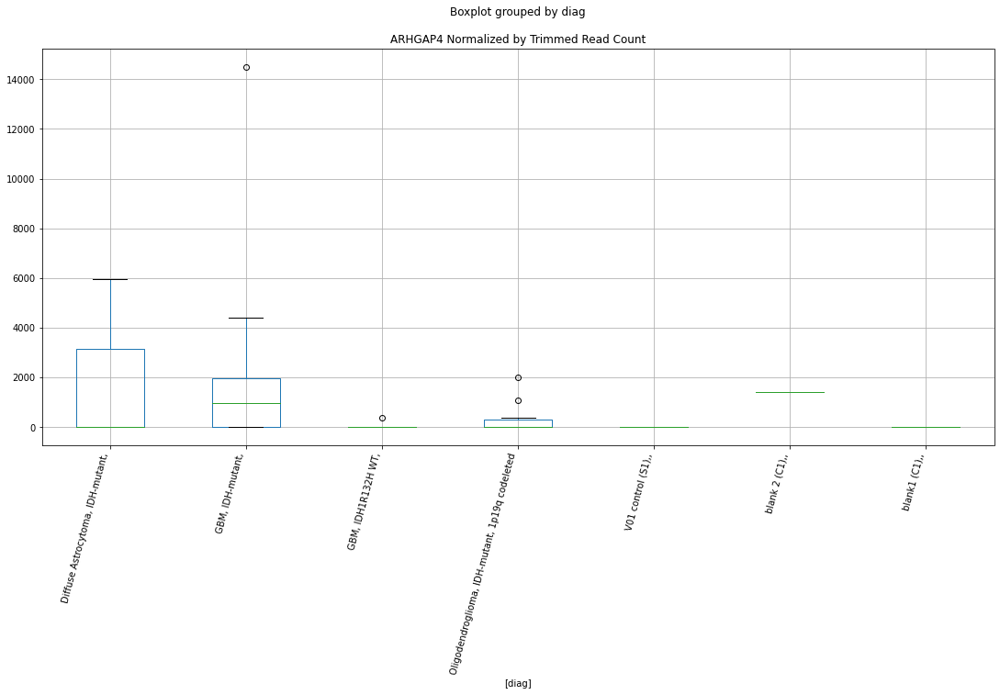

 p : 0.04863156291134801  ( t : 2.115066993895082 ) :  D-plex  :  cutadapt2  :  COL11A1
Control and blanks
76     18182.74
340    21137.57
Name: COL11A1, dtype: float64
208    55200.75
Name: COL11A1, dtype: float64
472    78601.99
Name: COL11A1, dtype: float64


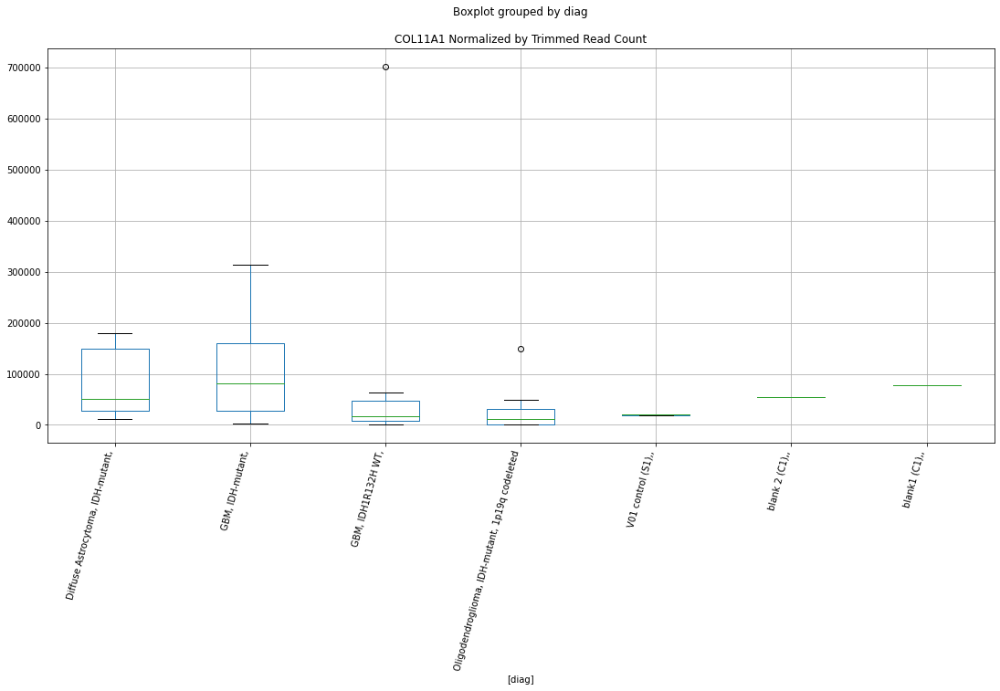

 p : 0.048711192434238965  ( t : 2.114234034353423 ) :  D-plex  :  bbduk2  :  CNTNAP3B
Control and blanks
73     0.0
337    0.0
Name: CNTNAP3B, dtype: float64
205    537.27
Name: CNTNAP3B, dtype: float64
469    1183.05
Name: CNTNAP3B, dtype: float64


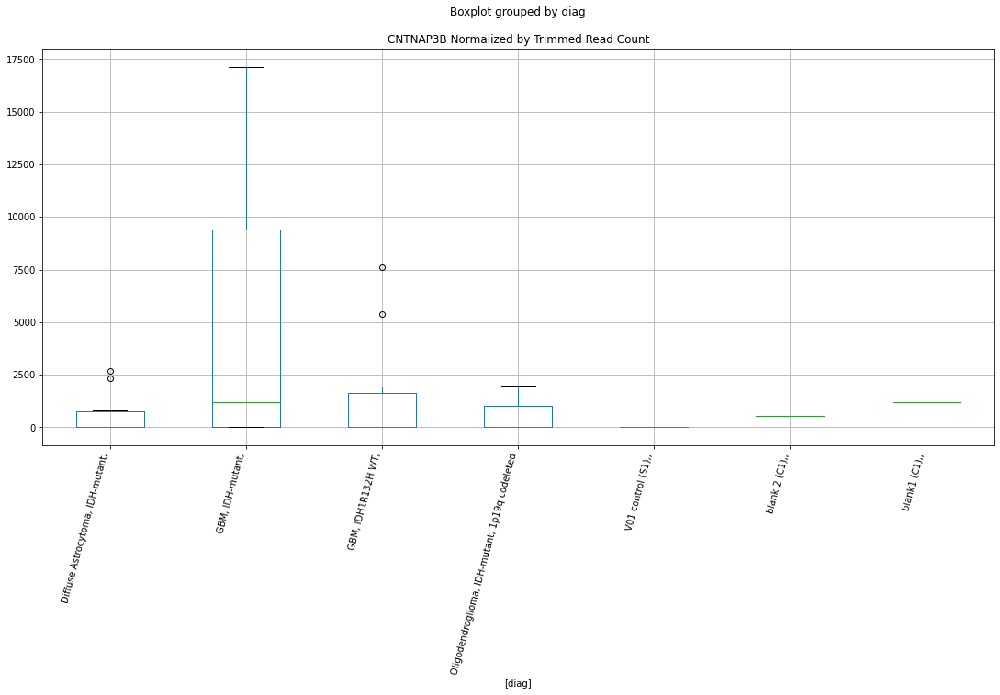

 p : 0.04872810401659274  ( t : 2.114057291409856 ) :  D-plex  :  bbduk2  :  ADGB
Control and blanks
73     773.01
337      0.00
Name: ADGB, dtype: float64
205    358.18
Name: ADGB, dtype: float64
469    0.0
Name: ADGB, dtype: float64


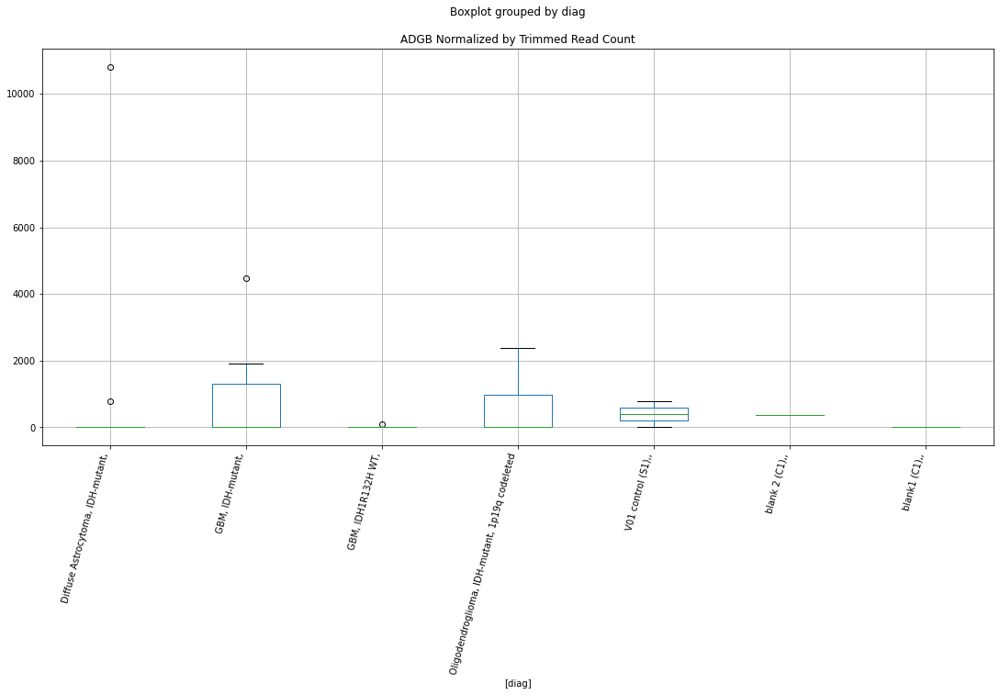

 p : 0.04876336197196018  ( t : 2.1136889899981837 ) :  Lexogen  :  bbduk2  :  ATP8B2
Control and blanks
79     5722.4
343       0.0
Name: ATP8B2, dtype: float64
211    0.0
Name: ATP8B2, dtype: float64
475    0.0
Name: ATP8B2, dtype: float64


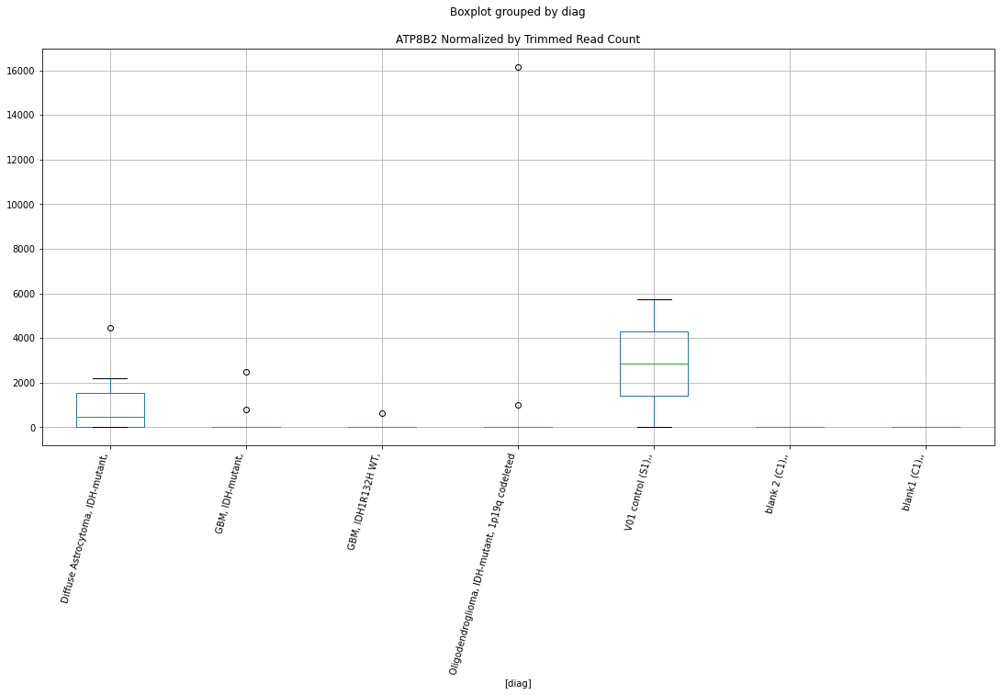

 p : 0.04878494474399739  ( t : 2.1134636578946036 ) :  D-plex  :  cutadapt2  :  ADGRF1
Control and blanks
76     0.0
340    0.0
Name: ADGRF1, dtype: float64
208    3527.2
Name: ADGRF1, dtype: float64
472    6935.47
Name: ADGRF1, dtype: float64


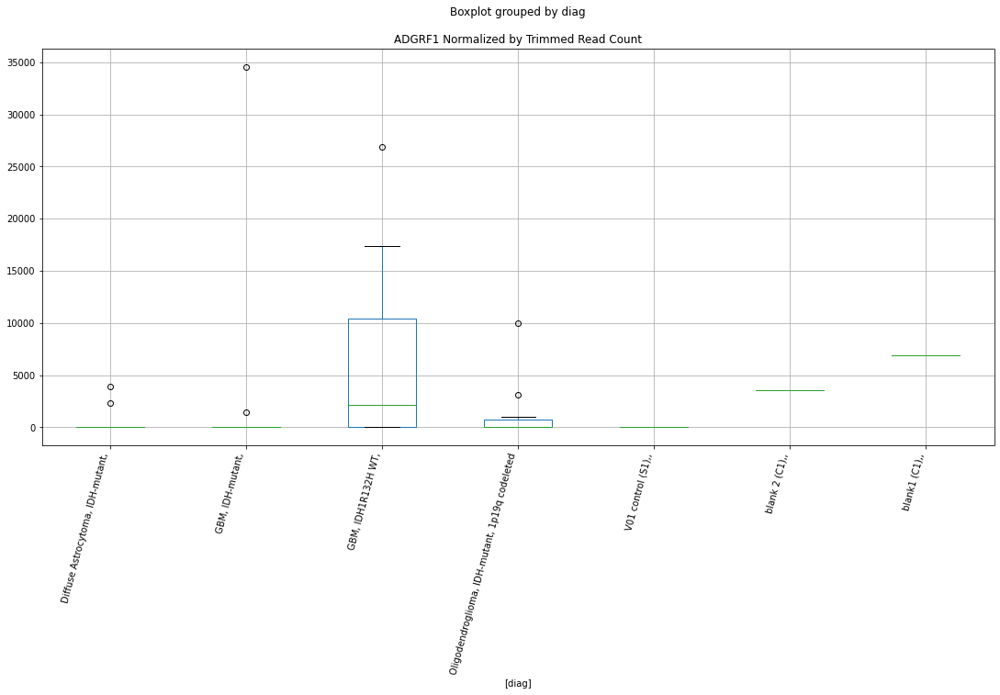

 p : 0.048811776272792984  ( t : 2.1131836533143873 ) :  D-plex  :  bbduk2  :  CNGA2
Control and blanks
73     0.0
337    0.0
Name: CNGA2, dtype: float64
205    0.0
Name: CNGA2, dtype: float64
469    0.0
Name: CNGA2, dtype: float64


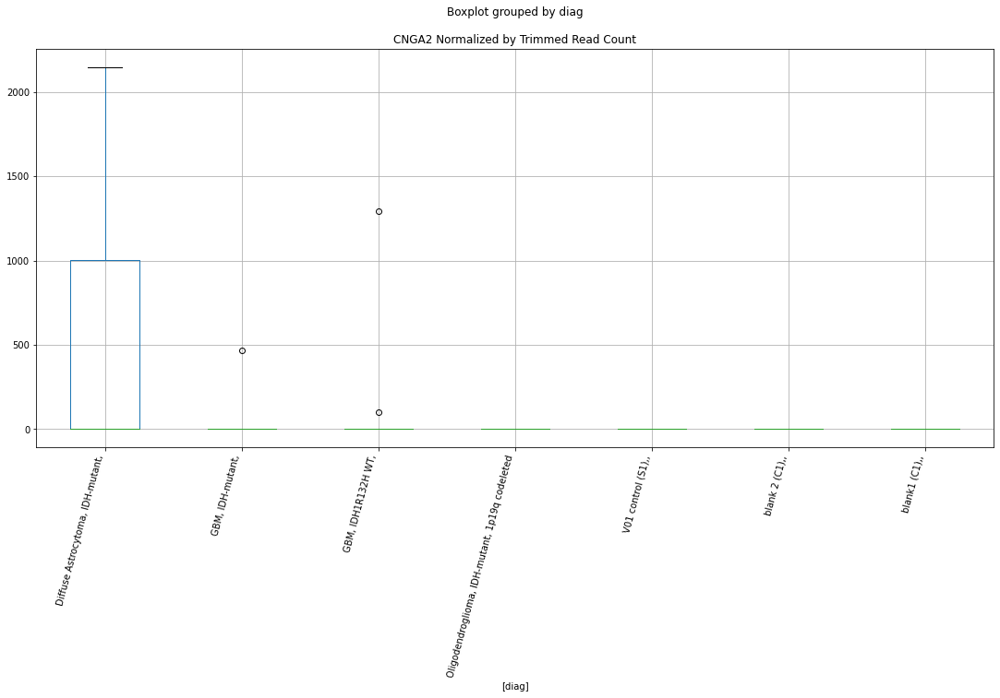

 p : 0.04888855020094094  ( t : 2.112383240243751 ) :  D-plex  :  bbduk2  :  DHCR7
Control and blanks
73     67251.73
337        0.00
Name: DHCR7, dtype: float64
205    96171.84
Name: DHCR7, dtype: float64
469    14196.66
Name: DHCR7, dtype: float64


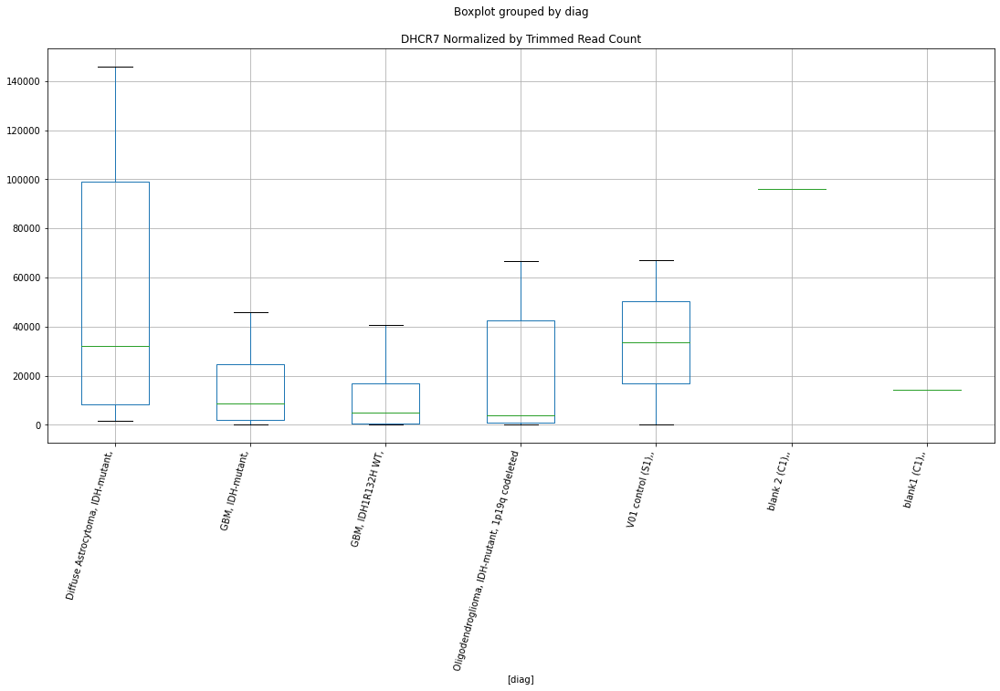

 p : 0.048941620893978986  ( t : 2.111830615660079 ) :  D-plex  :  bbduk2  :  CXCL12
Control and blanks
73        0.00
337    3560.63
Name: CXCL12, dtype: float64
205    5014.55
Name: CXCL12, dtype: float64
469    3549.16
Name: CXCL12, dtype: float64


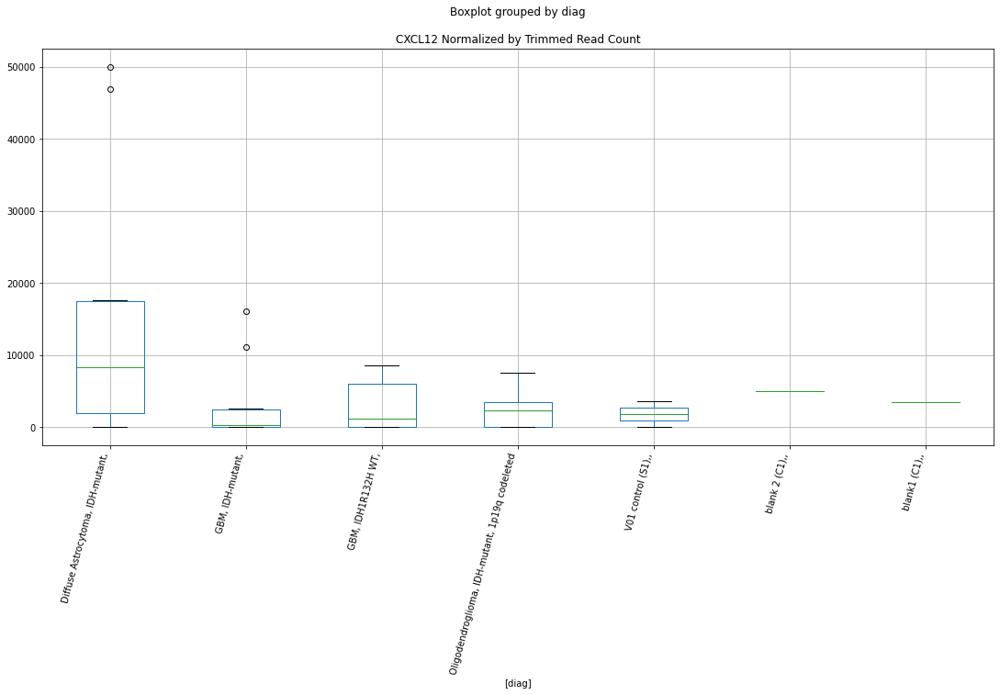

 p : 0.049000976731471205  ( t : 2.111213189577358 ) :  D-plex  :  bbduk2  :  ARL4C
Control and blanks
73     0.0
337    0.0
Name: ARL4C, dtype: float64
205    1074.55
Name: ARL4C, dtype: float64
469    1183.05
Name: ARL4C, dtype: float64


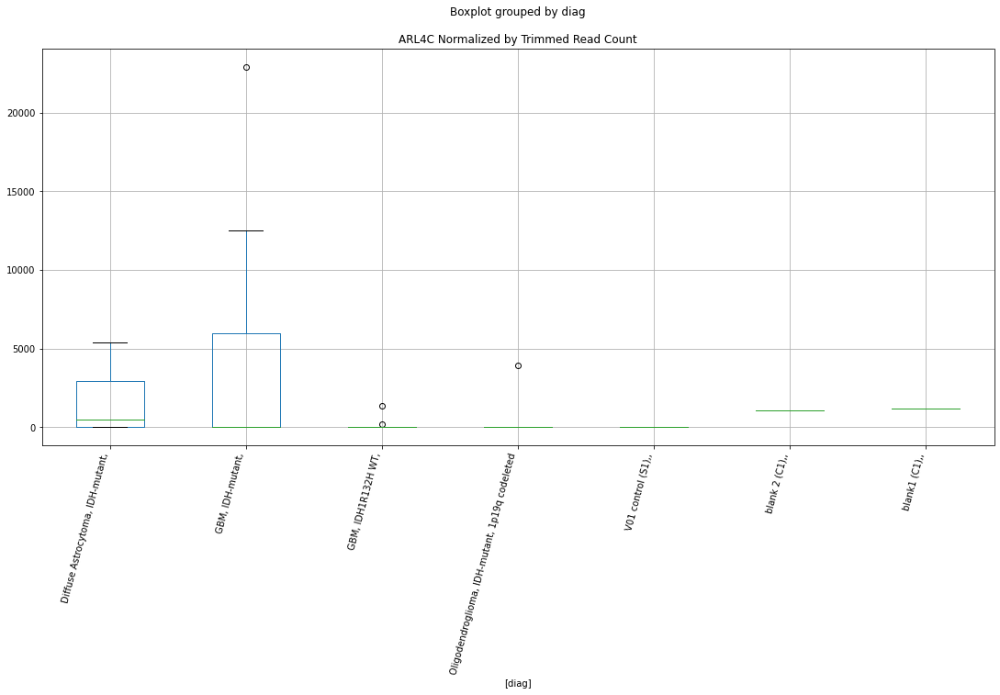

 p : 0.04905700177770382  ( t : 2.110631034780573 ) :  D-plex  :  cutadapt2  :  CARS1
Control and blanks
76     0.0
340    0.0
Name: CARS1, dtype: float64
208    23808.63
Name: CARS1, dtype: float64
472    64153.1
Name: CARS1, dtype: float64


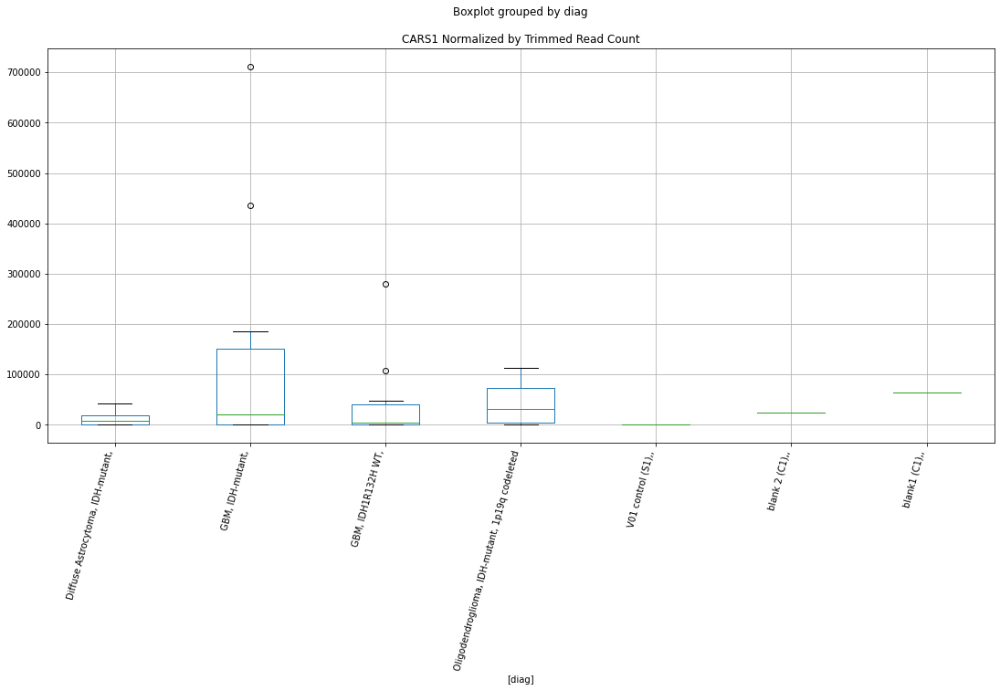

 p : 0.049164244148184696  ( t : 2.1095183673263085 ) :  D-plex  :  bbduk2  :  COL11A1
Control and blanks
73     18552.20
337    21363.77
Name: COL11A1, dtype: float64
205    56055.47
Name: COL11A1, dtype: float64
469    85179.93
Name: COL11A1, dtype: float64


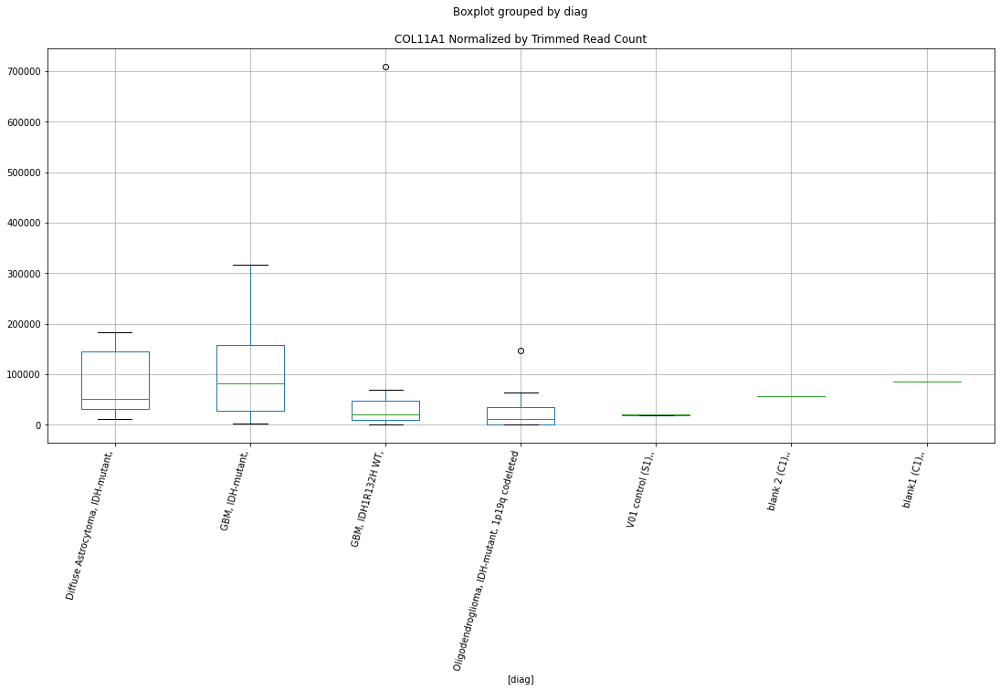

 p : 0.04917142505753996  ( t : 2.109443942430033 ) :  D-plex  :  bbduk2  :  AJM1
Control and blanks
73      6184.07
337    10681.89
Name: AJM1, dtype: float64
205    26863.64
Name: AJM1, dtype: float64
469    40815.38
Name: AJM1, dtype: float64


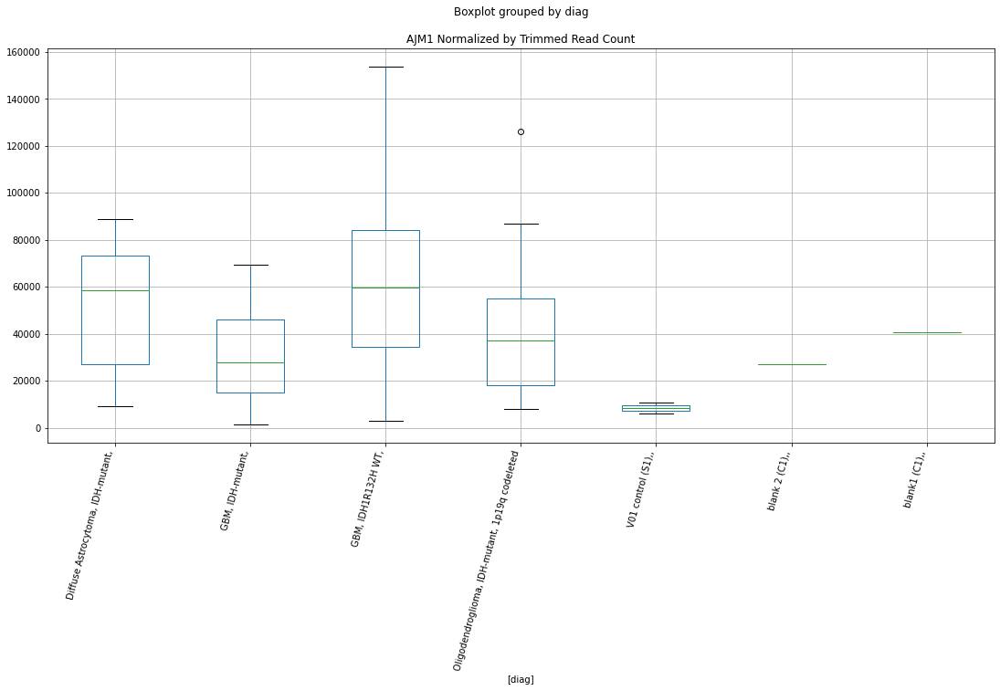

 p : 0.04919930520375055  ( t : 2.1091550787085924 ) :  D-plex  :  cutadapt2  :  C15orf40
Control and blanks
76     2272.84
340    8807.32
Name: C15orf40, dtype: float64
208    13932.46
Name: C15orf40, dtype: float64
472    11559.12
Name: C15orf40, dtype: float64


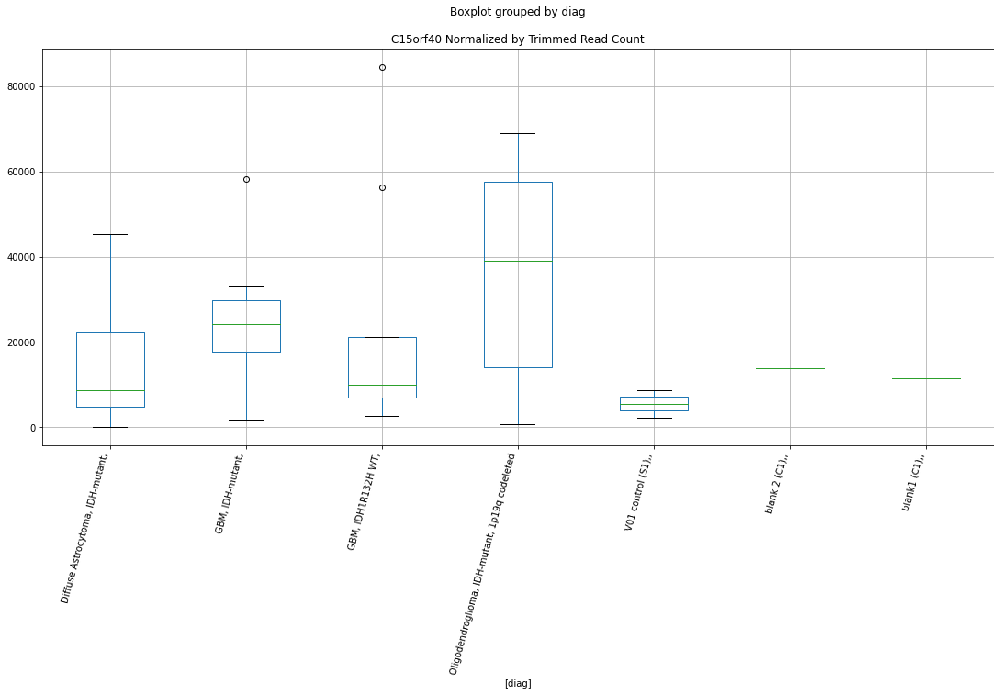

 p : 0.04921314973158188  ( t : 2.109011692114962 ) :  Lexogen  :  cutadapt2  :  ALK
Control and blanks
82     0.0
346    0.0
Name: ALK, dtype: float64
214    0.0
Name: ALK, dtype: float64
478    0.0
Name: ALK, dtype: float64


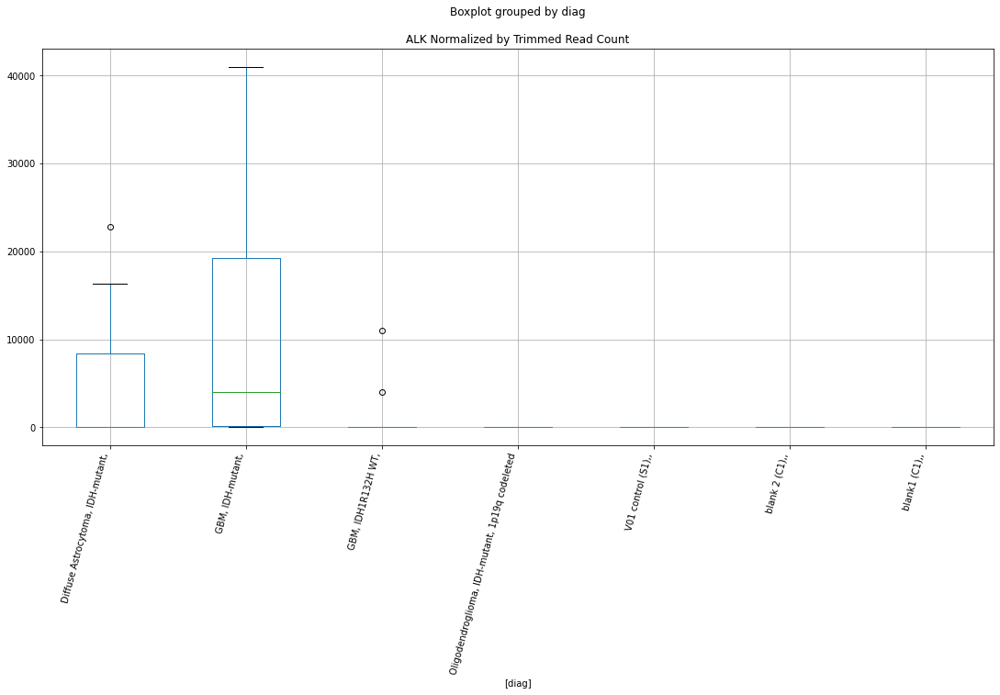

 p : 0.04930804061141185  ( t : 2.1080299018820403 ) :  D-plex  :  cutadapt2  :  CX3CL1
Control and blanks
76     0.0
340    0.0
Name: CX3CL1, dtype: float64
208    705.44
Name: CX3CL1, dtype: float64
472    2311.82
Name: CX3CL1, dtype: float64


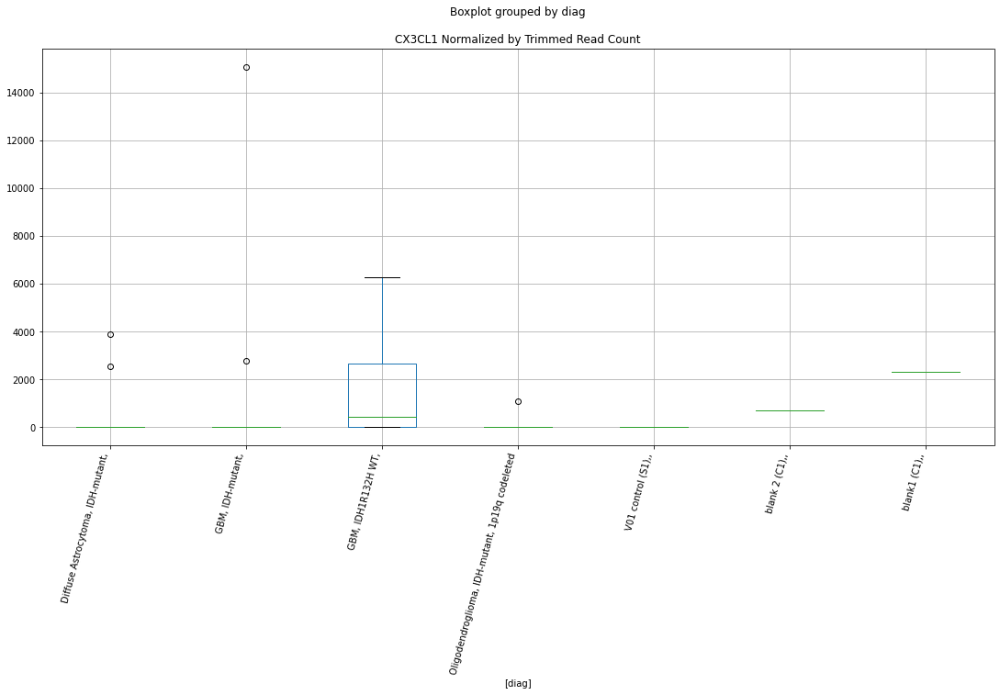

 p : 0.049401890405907055  ( t : 2.1070605722877227 ) :  D-plex  :  bbduk2  :  CDS1
Control and blanks
73     0.0
337    0.0
Name: CDS1, dtype: float64
205    3223.64
Name: CDS1, dtype: float64
469    0.0
Name: CDS1, dtype: float64


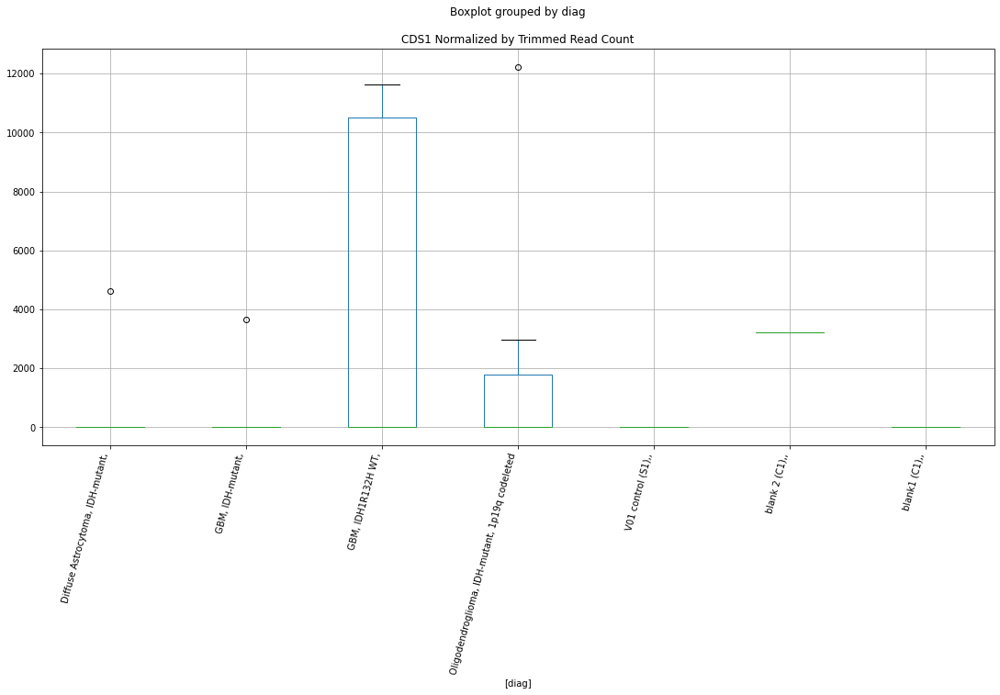

 p : 0.049440093235917436  ( t : 2.106666473139529 ) :  D-plex  :  cutadapt2  :  CBLL1
Control and blanks
76     272741.12
340         0.00
Name: CBLL1, dtype: float64
208    1939.96
Name: CBLL1, dtype: float64
472    0.0
Name: CBLL1, dtype: float64


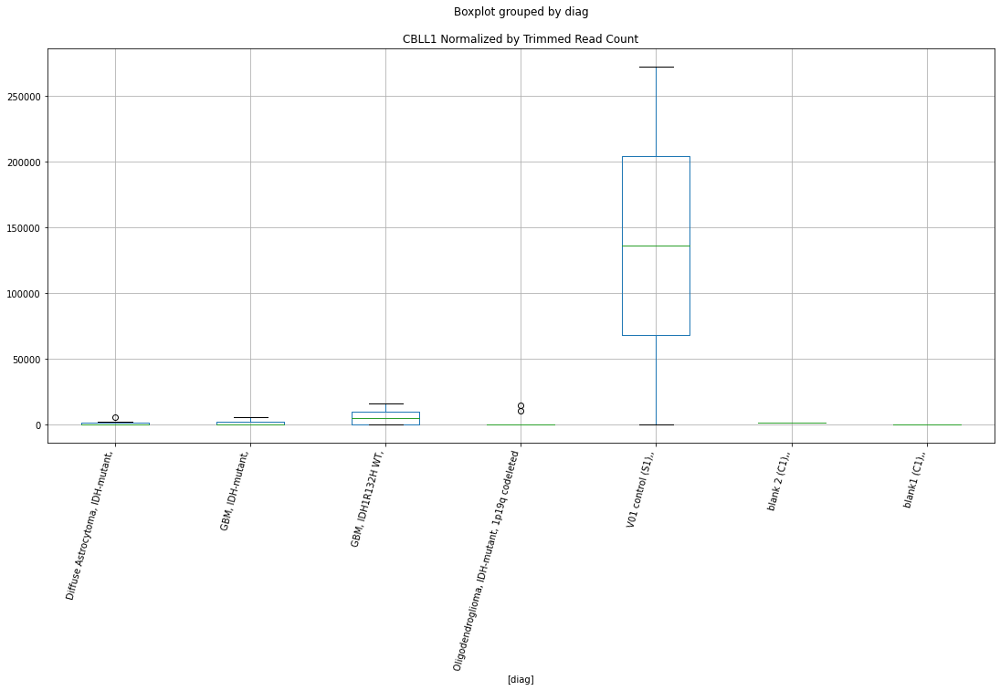

 p : 0.04947632859394456  ( t : 2.1062929262201244 ) :  Lexogen  :  bbduk2  :  AVPR1B
Control and blanks
79       0.00
343    212.31
Name: AVPR1B, dtype: float64
211    0.0
Name: AVPR1B, dtype: float64
475    0.0
Name: AVPR1B, dtype: float64


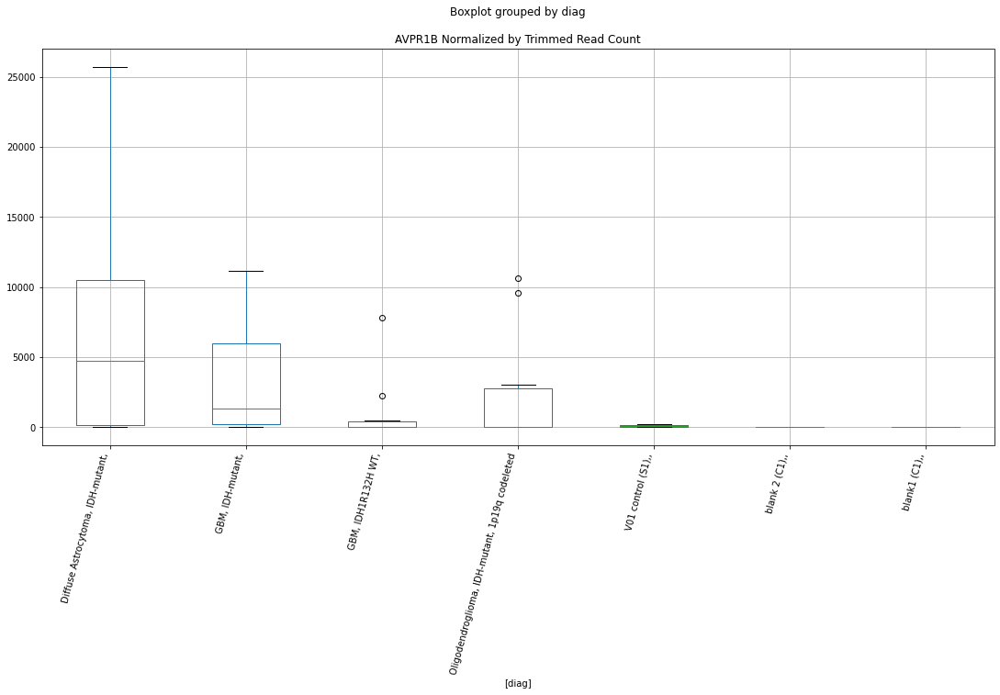

 p : 0.049518377262102384  ( t : 2.105859762186585 ) :  D-plex  :  bbduk2  :  BORCS8-MEF2B
Control and blanks
73     0.0
337    0.0
Name: BORCS8-MEF2B, dtype: float64
205    0.0
Name: BORCS8-MEF2B, dtype: float64
469    0.0
Name: BORCS8-MEF2B, dtype: float64


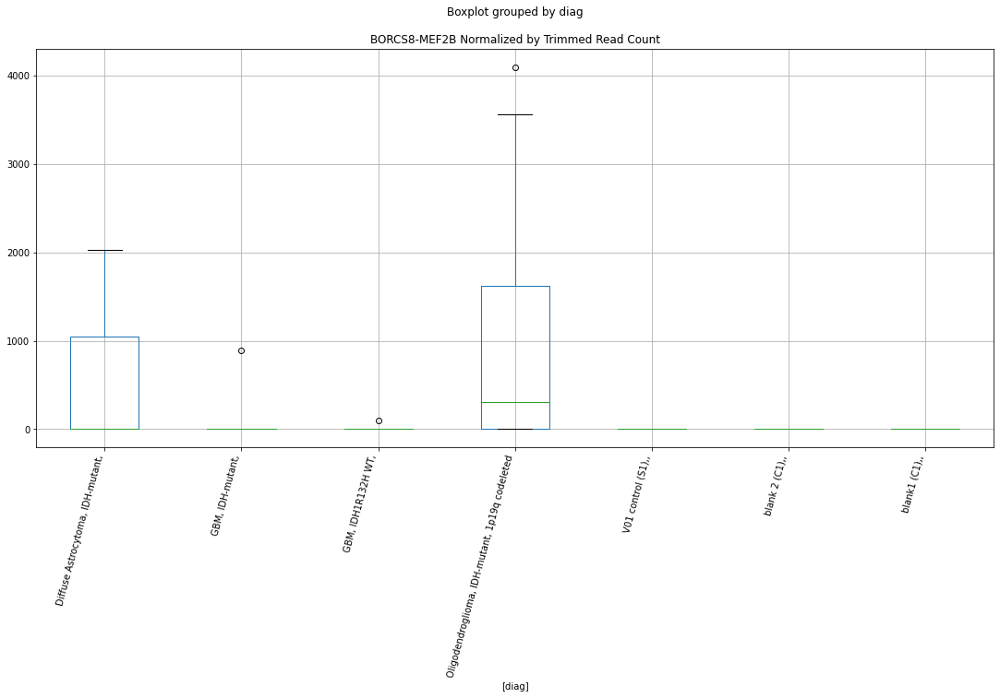

 p : 0.04952973257749338  ( t : 2.1057428428570253 ) :  Lexogen  :  cutadapt2  :  AVPR1B
Control and blanks
82       0.00
346    210.43
Name: AVPR1B, dtype: float64
214    0.0
Name: AVPR1B, dtype: float64
478    0.0
Name: AVPR1B, dtype: float64


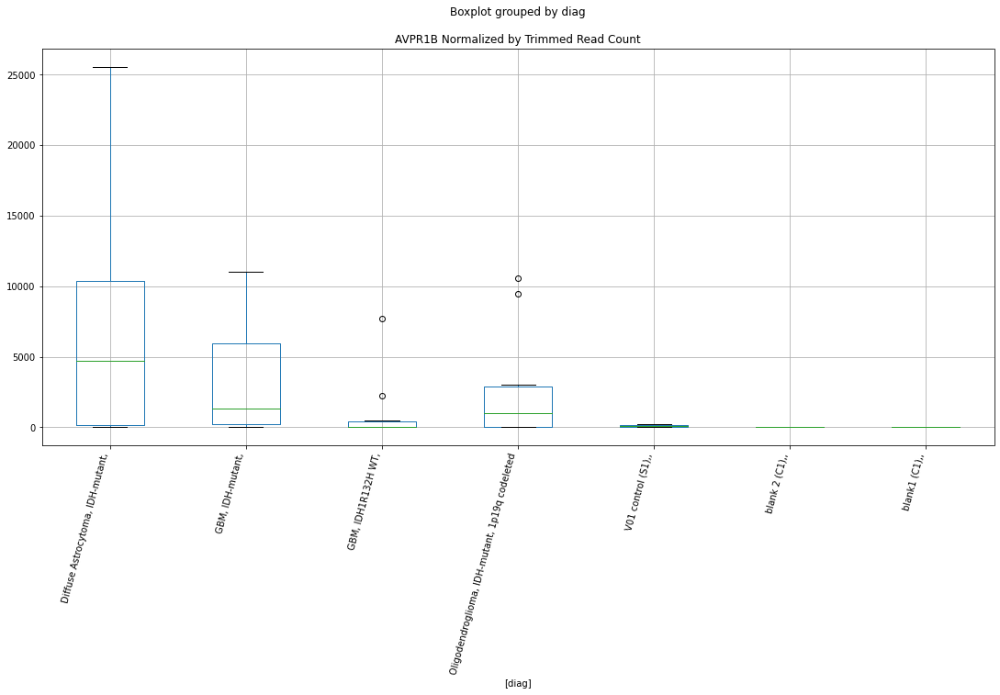

 p : 0.049545531566603955  ( t : 2.1055802100510577 ) :  D-plex  :  cutadapt2  :  CNTNAP3B
Control and blanks
76     0.0
340    0.0
Name: CNTNAP3B, dtype: float64
208    529.08
Name: CNTNAP3B, dtype: float64
472    577.96
Name: CNTNAP3B, dtype: float64


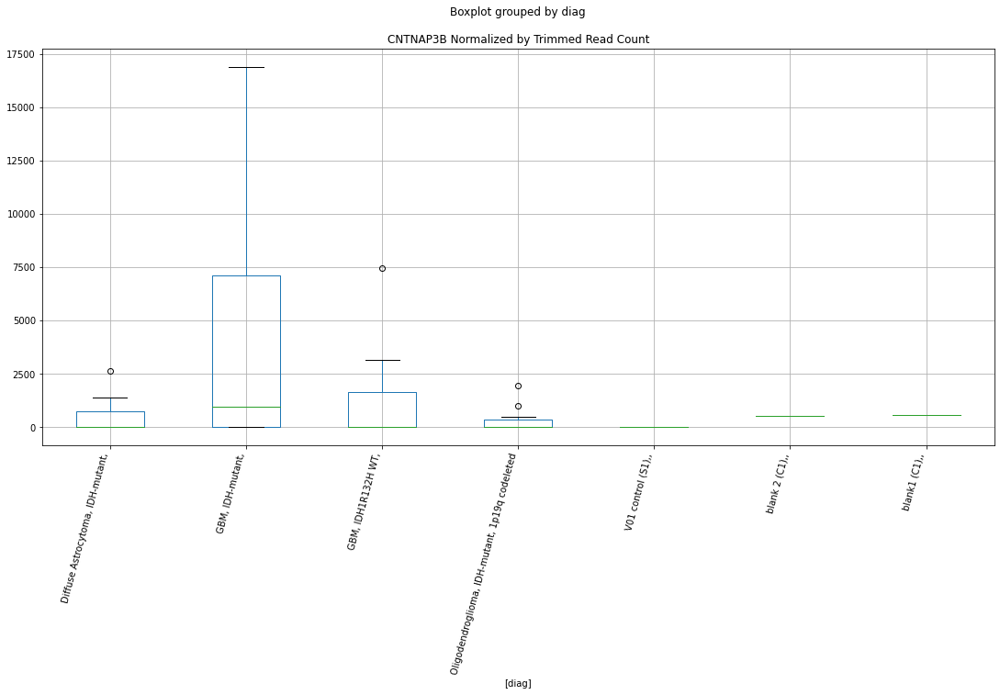

 p : 0.04956478400937354  ( t : 2.105382091566264 ) :  D-plex  :  cutadapt2  :  COG6
Control and blanks
76        0.00
340    3522.93
Name: COG6, dtype: float64
208    6878.05
Name: COG6, dtype: float64
472    9825.25
Name: COG6, dtype: float64


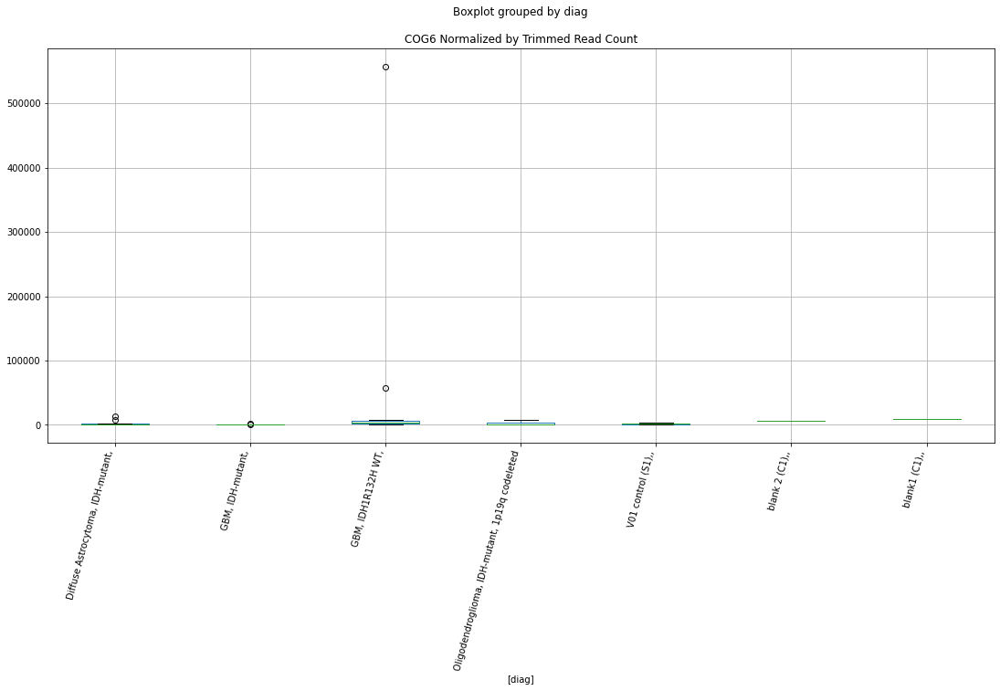

 p : 0.04957015384514331  ( t : 2.105326845411845 ) :  D-plex  :  cutadapt2  :  ARID1B
Control and blanks
76     13637.06
340        0.00
Name: ARID1B, dtype: float64
208    16225.14
Name: ARID1B, dtype: float64
472    12715.03
Name: ARID1B, dtype: float64


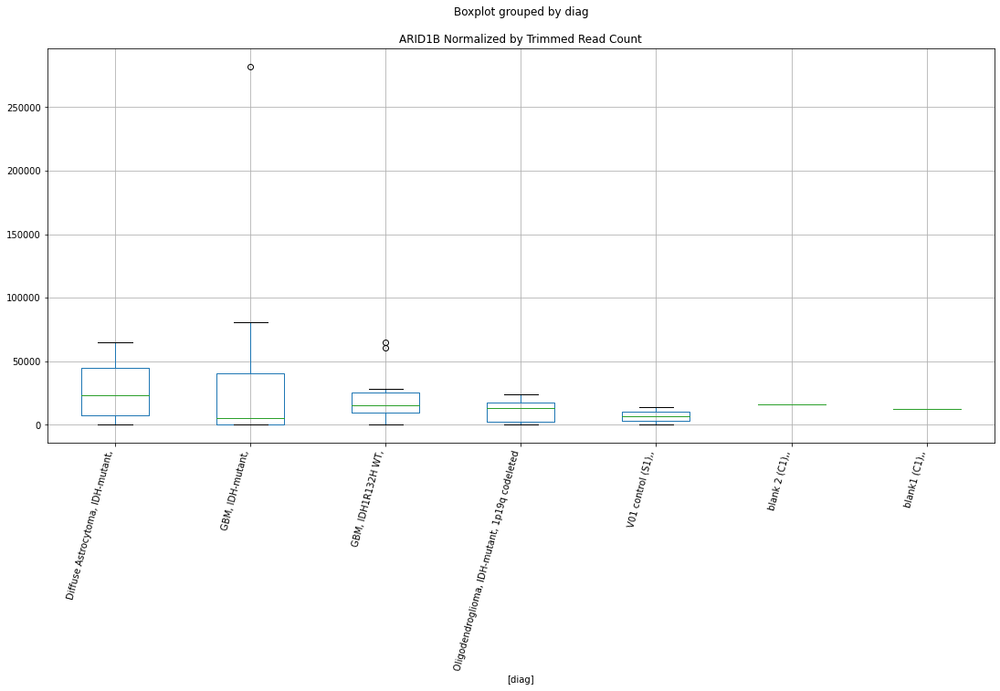

 p : 0.04961113977200254  ( t : 2.104905351597047 ) :  D-plex  :  bbduk2  :  ASB16-AS1
Control and blanks
73     0.0
337    0.0
Name: ASB16-AS1, dtype: float64
205    716.36
Name: ASB16-AS1, dtype: float64
469    0.0
Name: ASB16-AS1, dtype: float64


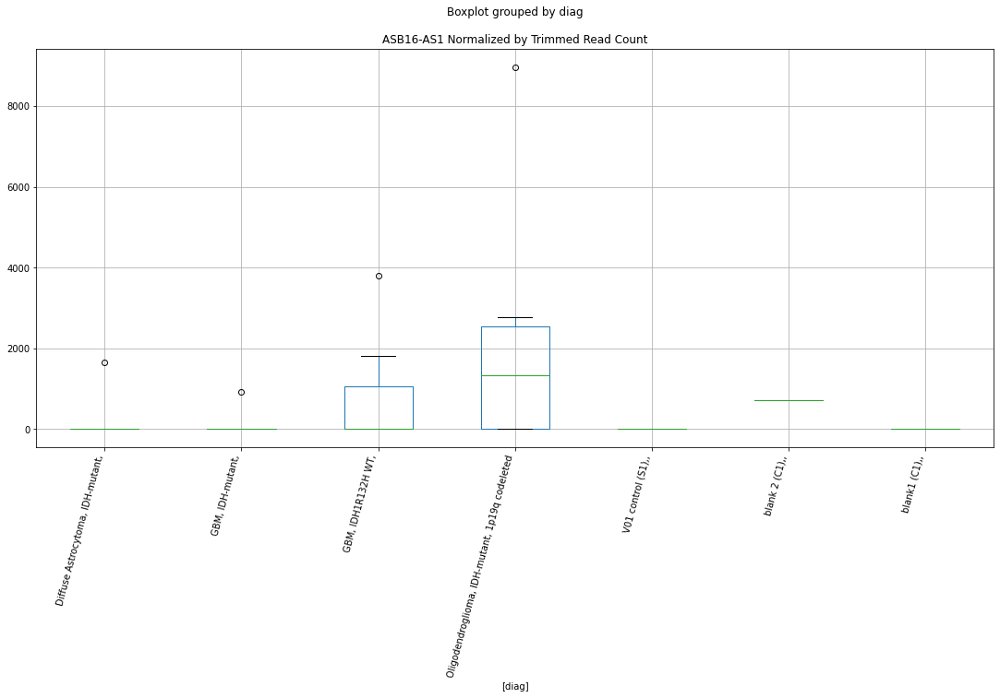

 p : 0.04961574566411062  ( t : 2.1048580050088104 ) :  D-plex  :  cutadapt2  :  BARD1
Control and blanks
76     0.0
340    0.0
Name: BARD1, dtype: float64
208    3527.2
Name: BARD1, dtype: float64
472    0.0
Name: BARD1, dtype: float64


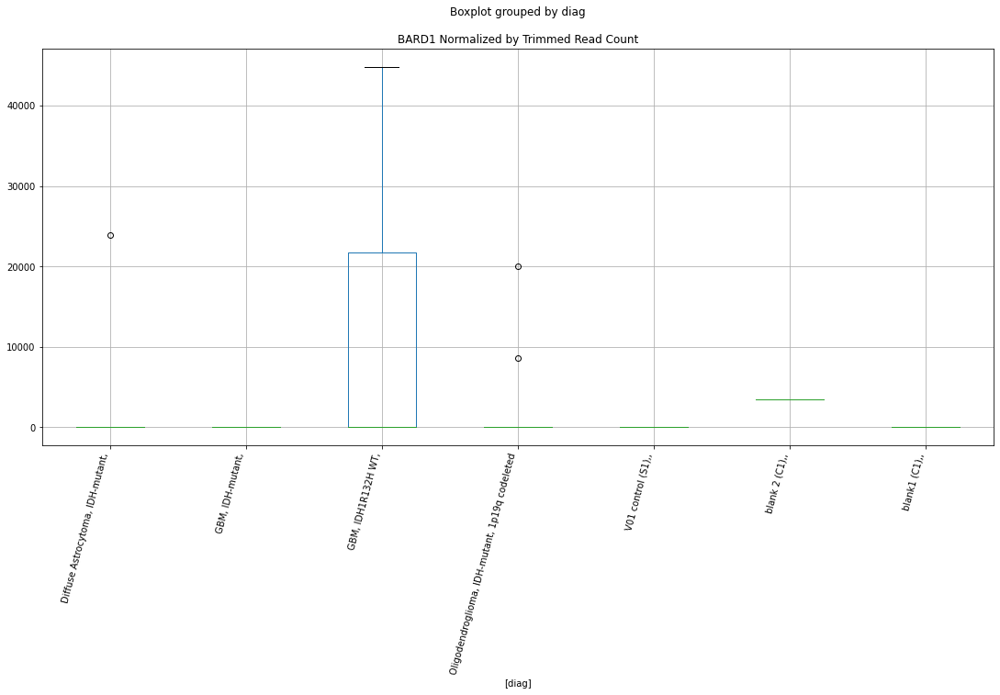

 p : 0.0496215552895143  ( t : 2.1047982902600464 ) :  Lexogen  :  bbduk2  :  CIAO3
Control and blanks
79     0.0
343    0.0
Name: CIAO3, dtype: float64
211    0.0
Name: CIAO3, dtype: float64
475    0.0
Name: CIAO3, dtype: float64


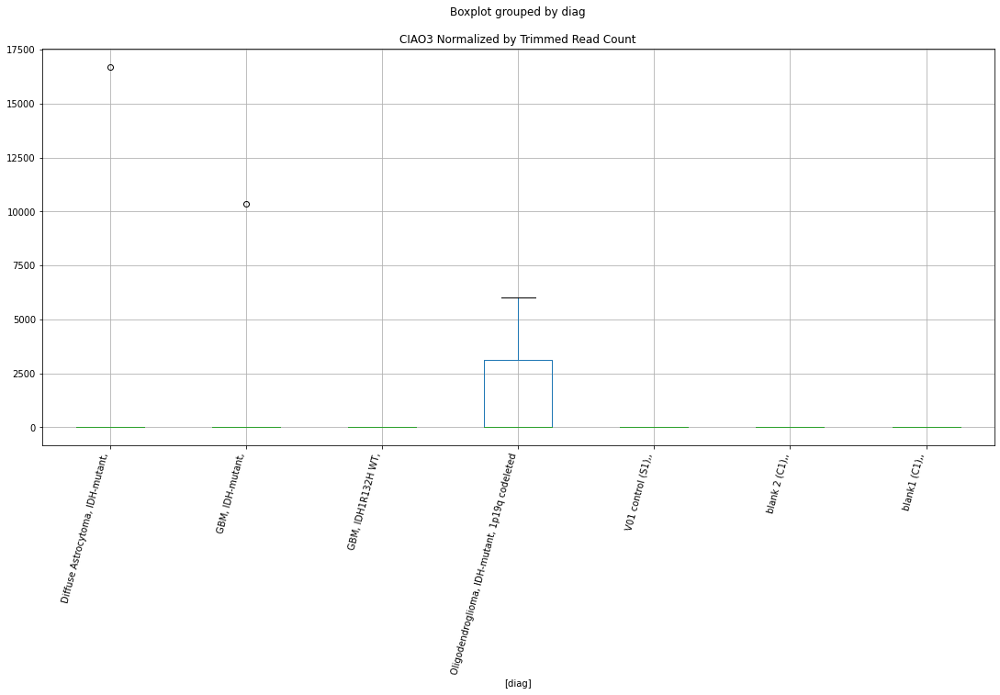

 p : 0.04966224699023602  ( t : 2.104380215125748 ) :  Lexogen  :  cutadapt2  :  ADRA1B
Control and blanks
82     0.0
346    0.0
Name: ADRA1B, dtype: float64
214    4610.85
Name: ADRA1B, dtype: float64
478    474.92
Name: ADRA1B, dtype: float64


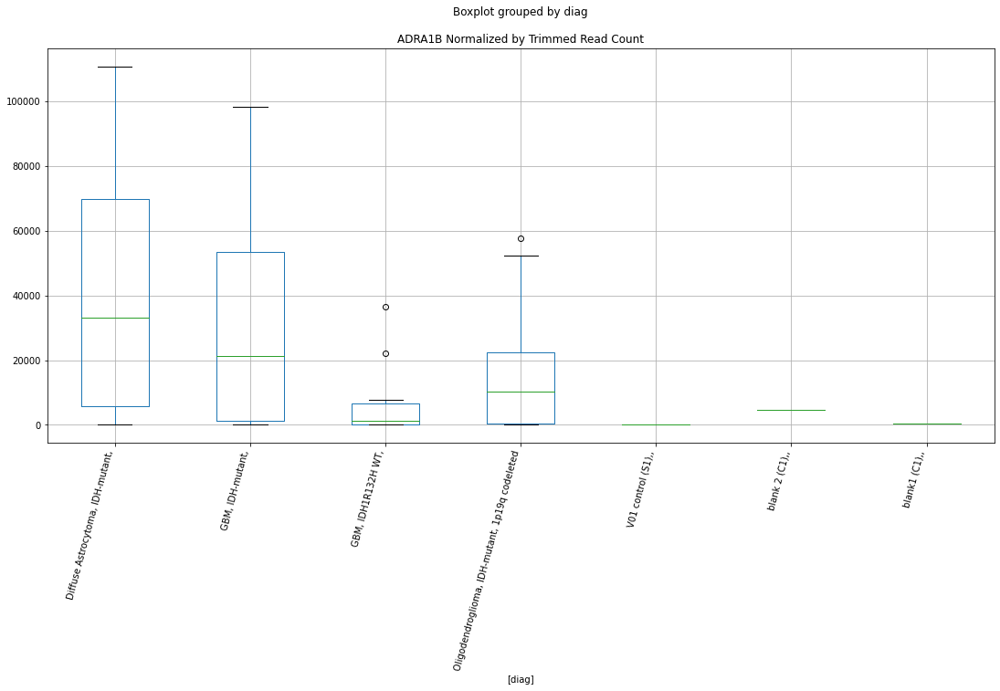

 p : 0.04968747580949269  ( t : 2.1041211653011636 ) :  Lexogen  :  cutadapt2  :  CIAO3
Control and blanks
82     0.0
346    0.0
Name: CIAO3, dtype: float64
214    0.0
Name: CIAO3, dtype: float64
478    0.0
Name: CIAO3, dtype: float64


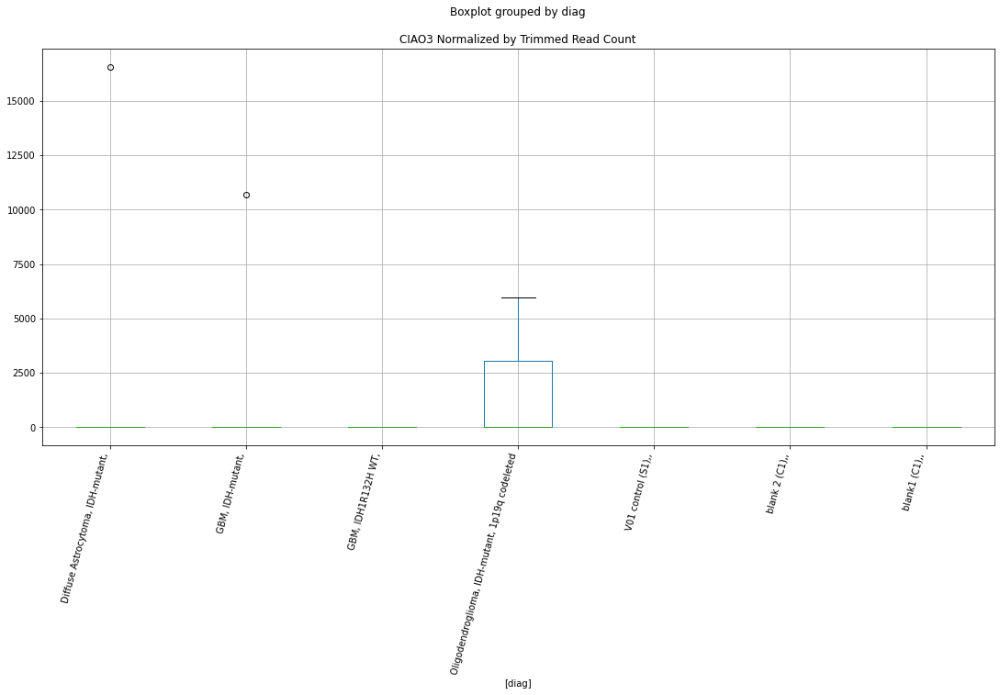

 p : 0.04975665387084908  ( t : 2.1034114571908544 ) :  Lexogen  :  bbduk2  :  CDK4
Control and blanks
79       0.00
343    212.31
Name: CDK4, dtype: float64
211    5192.82
Name: CDK4, dtype: float64
475    239.52
Name: CDK4, dtype: float64


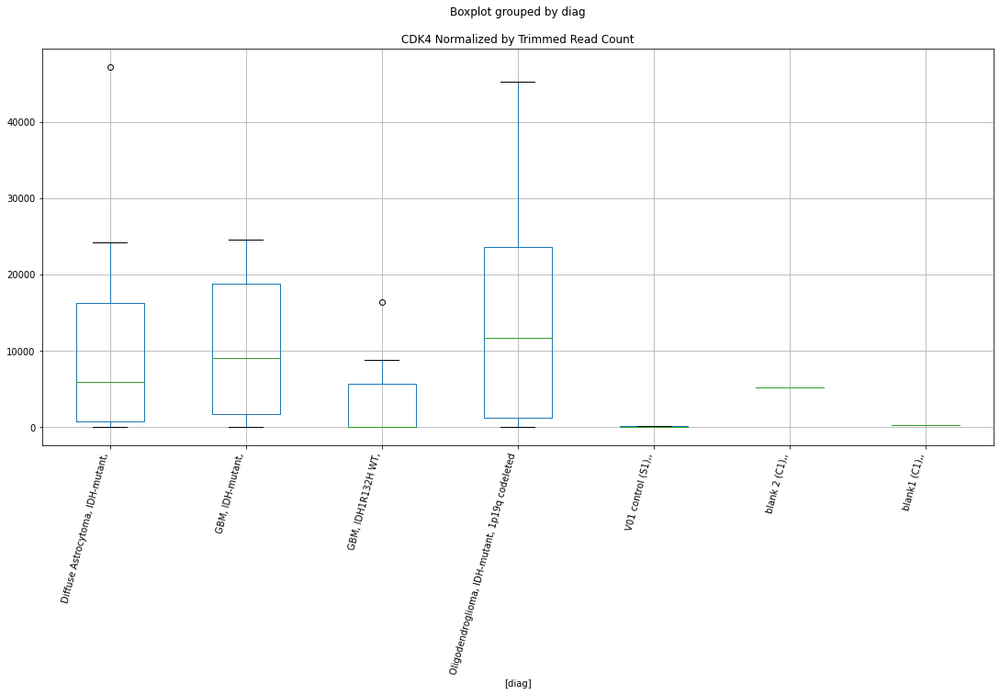

 p : 0.049758098865366404  ( t : 2.103396642342882 ) :  Lexogen  :  cutadapt2  :  DCTN1-AS1
Control and blanks
82      4260.15
346    49872.98
Name: DCTN1-AS1, dtype: float64
214    1627.36
Name: DCTN1-AS1, dtype: float64
478    17809.54
Name: DCTN1-AS1, dtype: float64


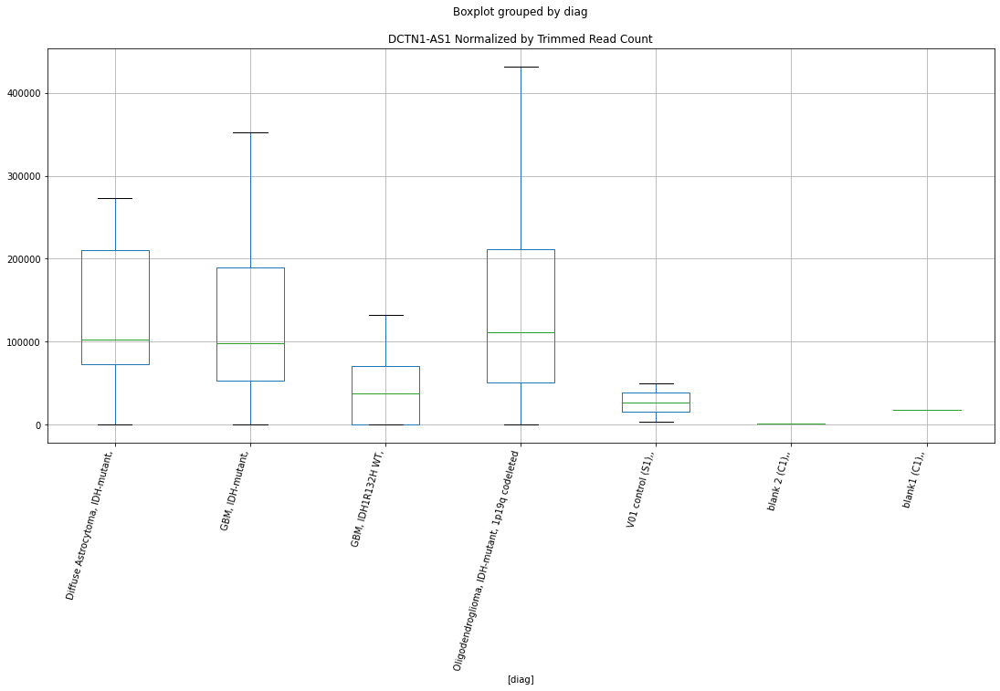

 p : 0.04975971982405662  ( t : 2.1033800238826434 ) :  Lexogen  :  bbduk2  :  APOA5
Control and blanks
79     0.0
343    0.0
Name: APOA5, dtype: float64
211    0.0
Name: APOA5, dtype: float64
475    0.0
Name: APOA5, dtype: float64


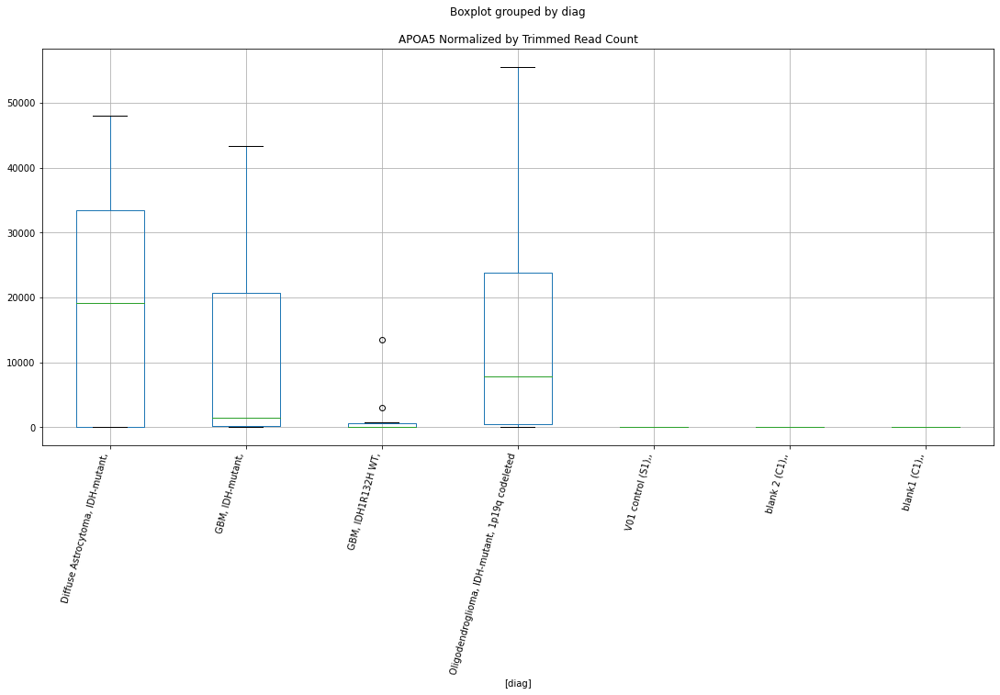

 p : 0.04979944071455533  ( t : 2.102972949437148 ) :  D-plex  :  bbduk2  :  C2orf42
Control and blanks
73     0.0
337    0.0
Name: C2orf42, dtype: float64
205    716.36
Name: C2orf42, dtype: float64
469    0.0
Name: C2orf42, dtype: float64


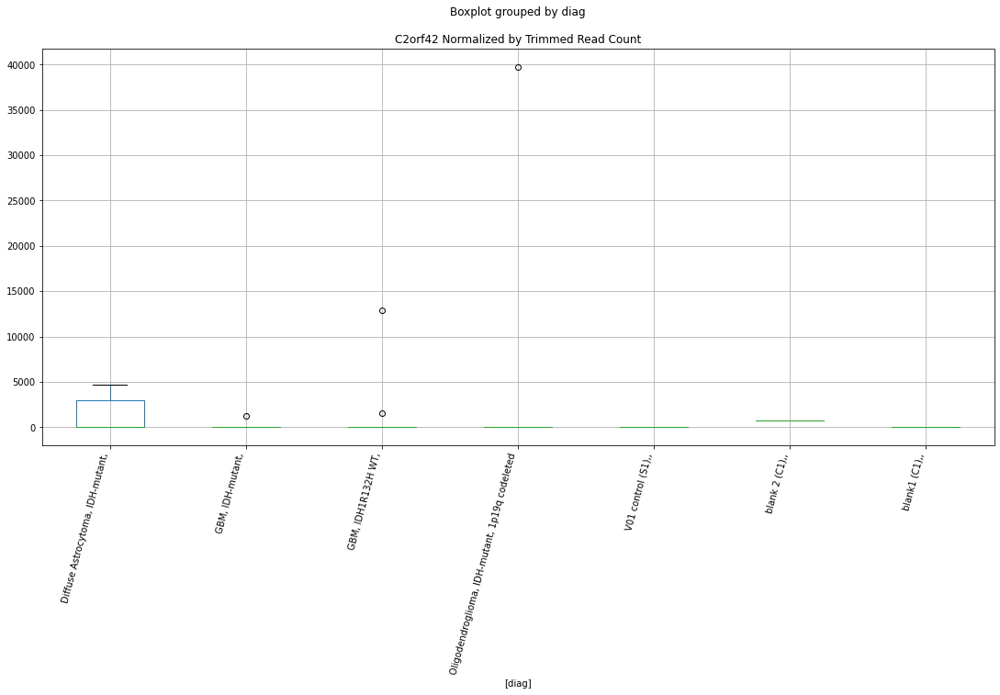

 p : 0.049829750023566204  ( t : 2.102662526886362 ) :  D-plex  :  bbduk2  :  ADGRV1
Control and blanks
73     0.0
337    0.0
Name: ADGRV1, dtype: float64
205    33669.1
Name: ADGRV1, dtype: float64
469    41998.44
Name: ADGRV1, dtype: float64


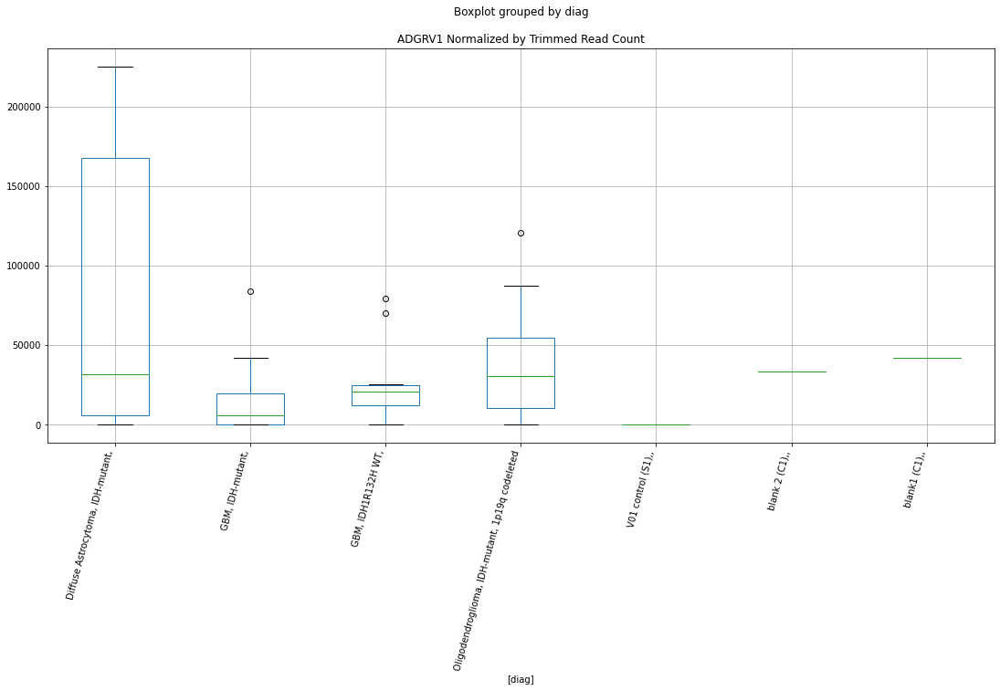

 p : 0.04983650725268201  ( t : 2.102593343948861 ) :  Lexogen  :  bbduk2  :  CPXM2
Control and blanks
79     0.0
343    0.0
Name: CPXM2, dtype: float64
211    0.0
Name: CPXM2, dtype: float64
475    0.0
Name: CPXM2, dtype: float64


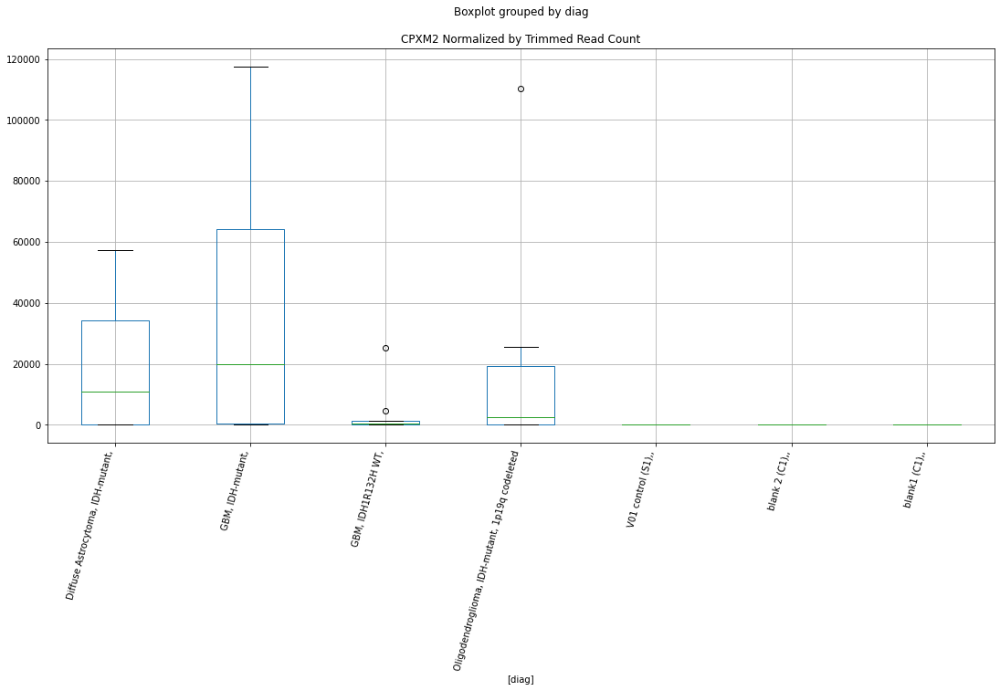

 p : 0.04983851302273381  ( t : 2.102572809796332 ) :  D-plex  :  bbduk2  :  CAV1
Control and blanks
73     0.0
337    0.0
Name: CAV1, dtype: float64
205    4298.18
Name: CAV1, dtype: float64
469    7098.33
Name: CAV1, dtype: float64


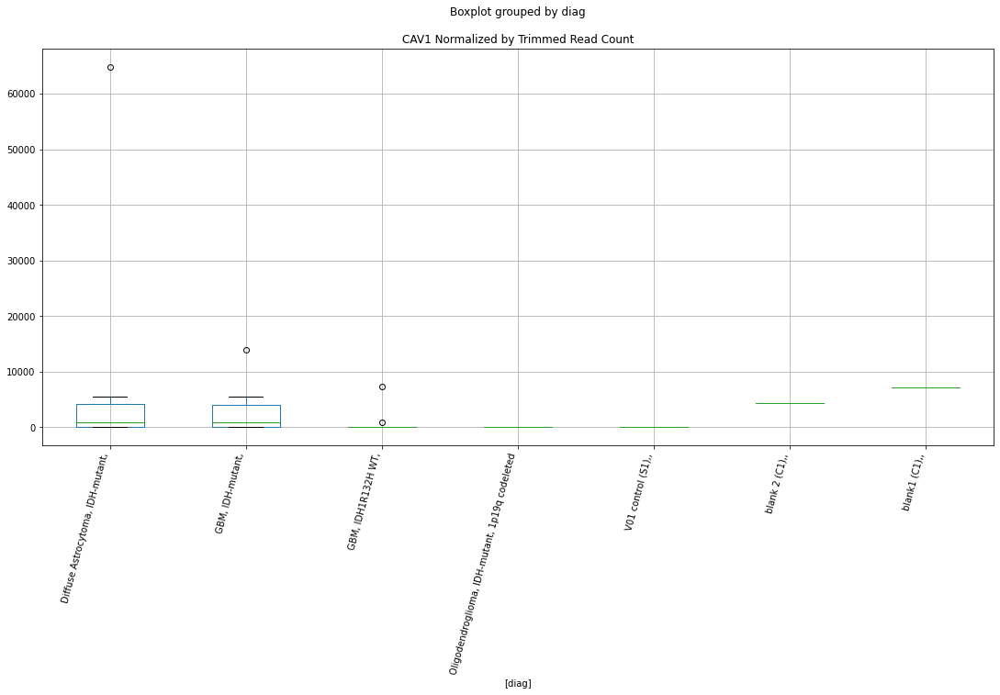

 p : 0.04988516966435601  ( t : 2.1020953723900595 ) :  Lexogen  :  bbduk2  :  CCNG2
Control and blanks
79     0.0
343    0.0
Name: CCNG2, dtype: float64
211    0.0
Name: CCNG2, dtype: float64
475    0.0
Name: CCNG2, dtype: float64


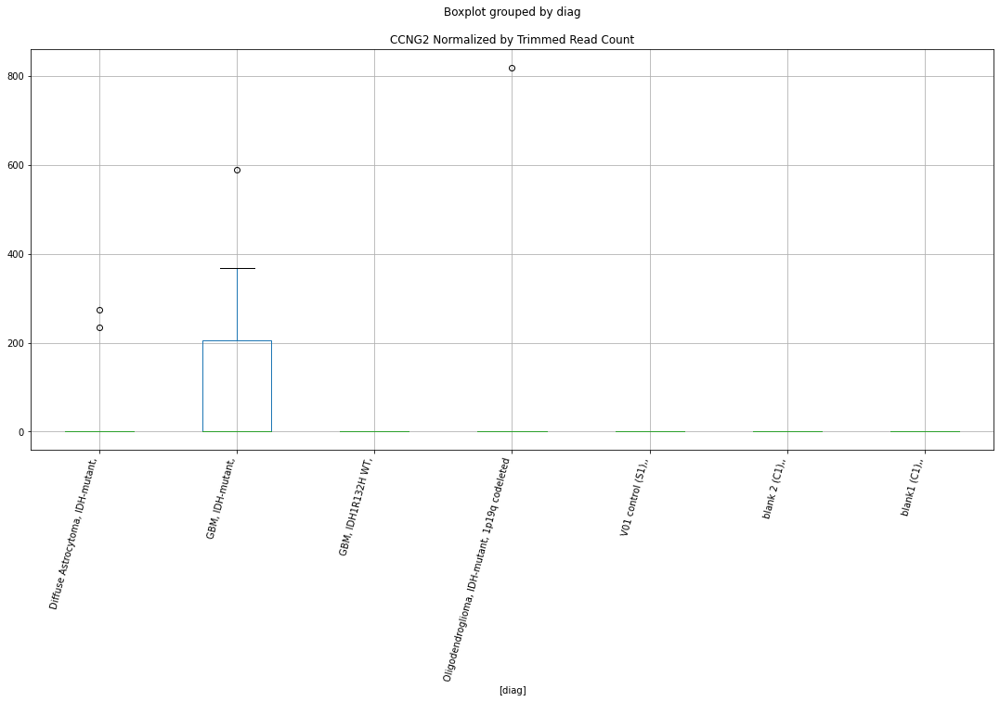

 p : 0.049951590751445736  ( t : 2.1014163852113117 ) :  D-plex  :  cutadapt2  :  ARMH4
Control and blanks
76     165917.51
340         0.00
Name: ARMH4, dtype: float64
208    25219.51
Name: ARMH4, dtype: float64
472    34099.39
Name: ARMH4, dtype: float64


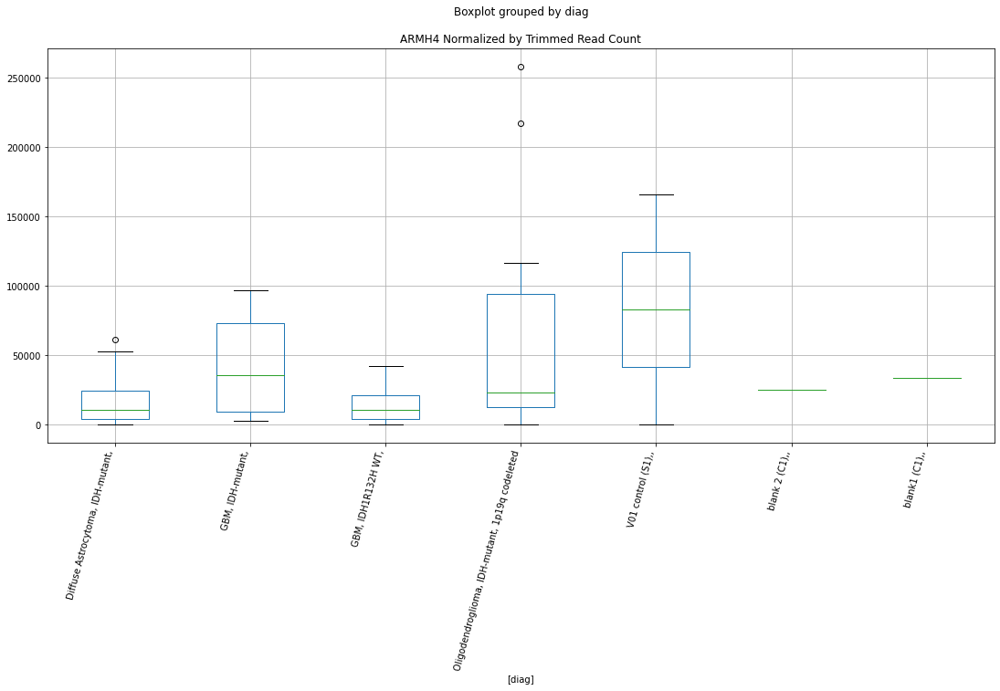

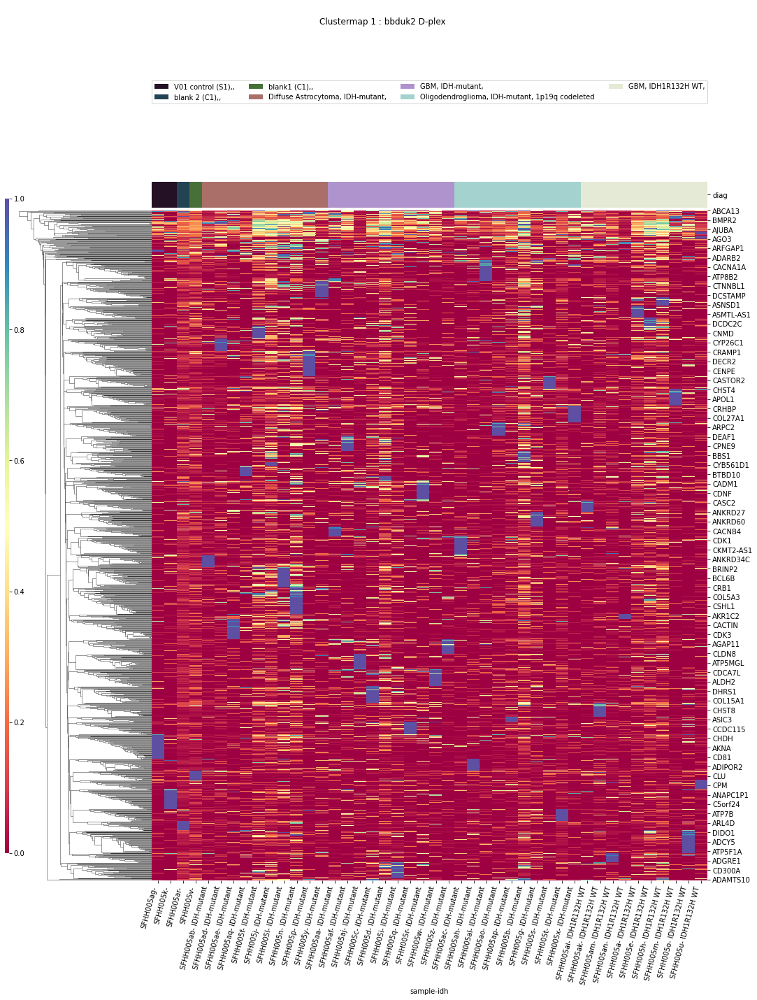

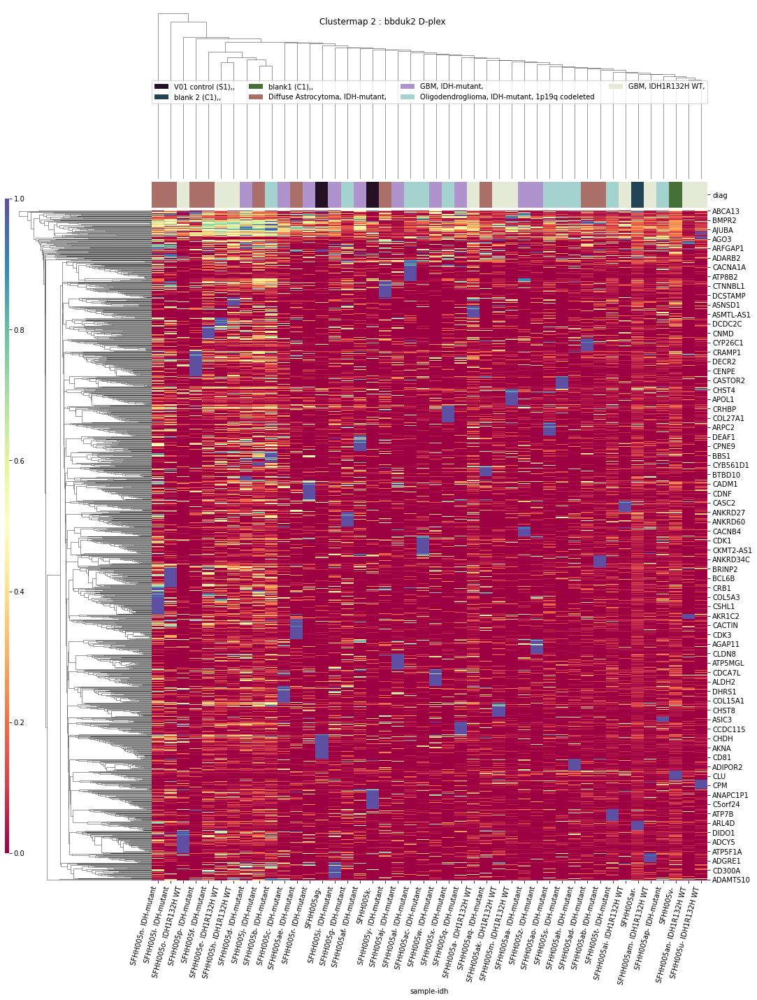

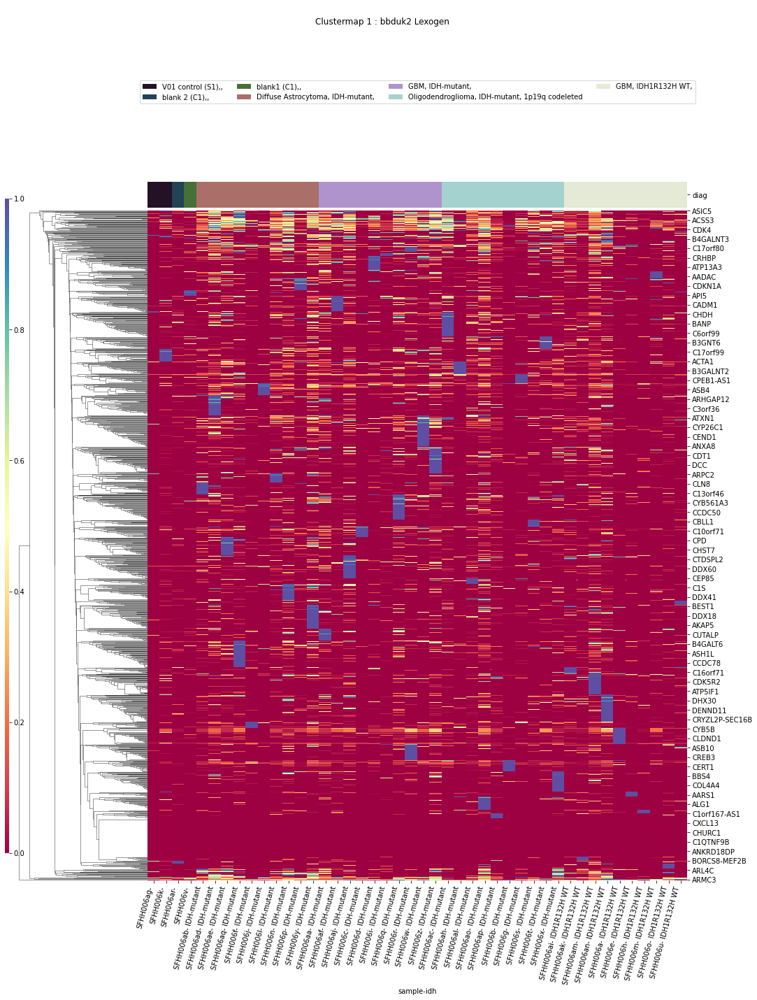

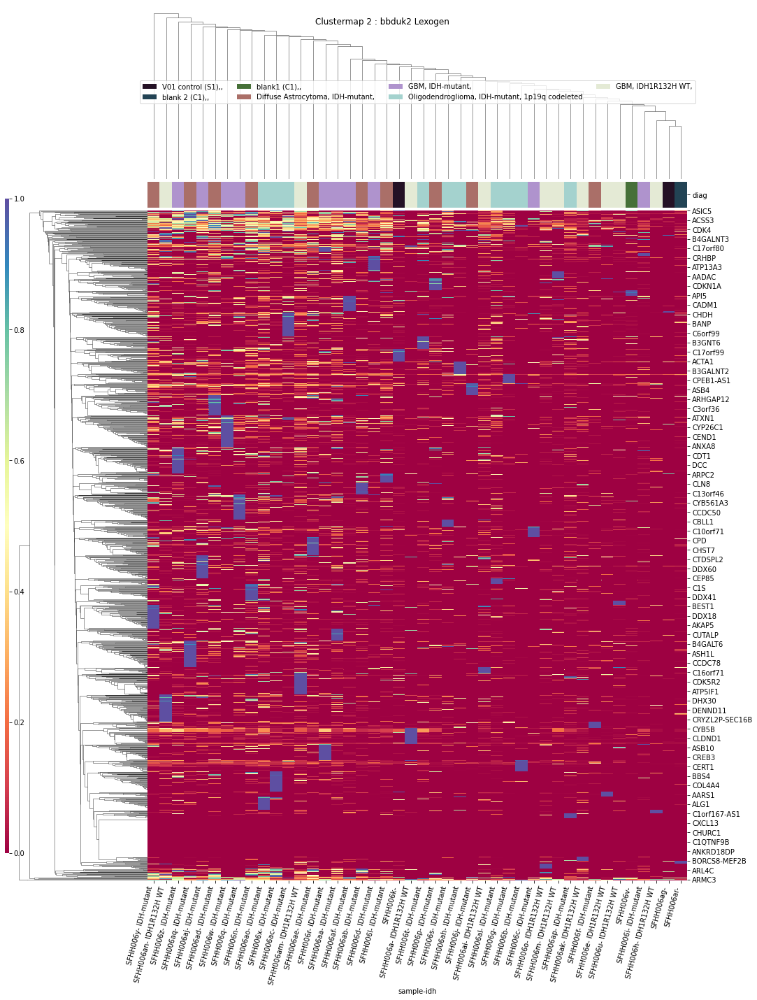

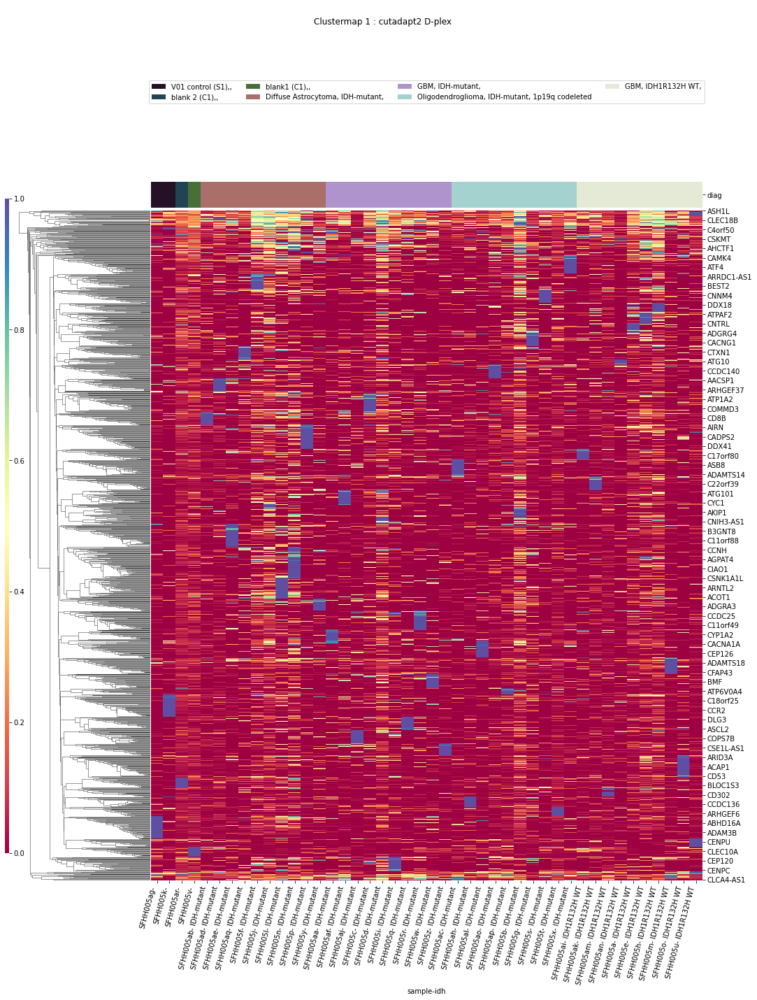

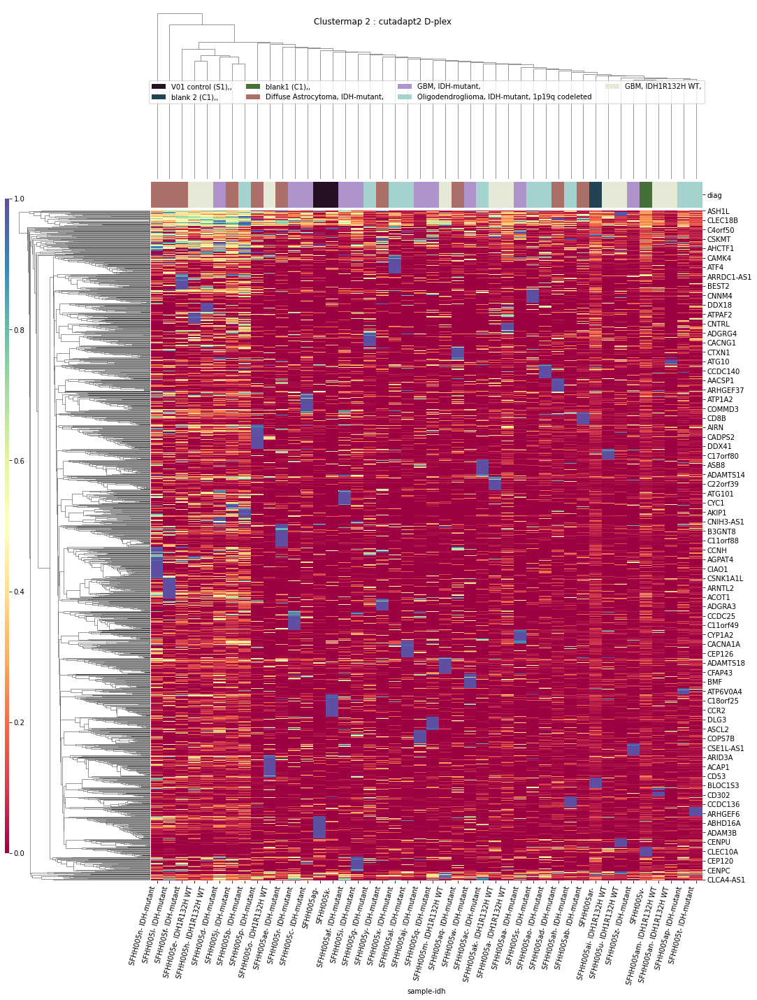

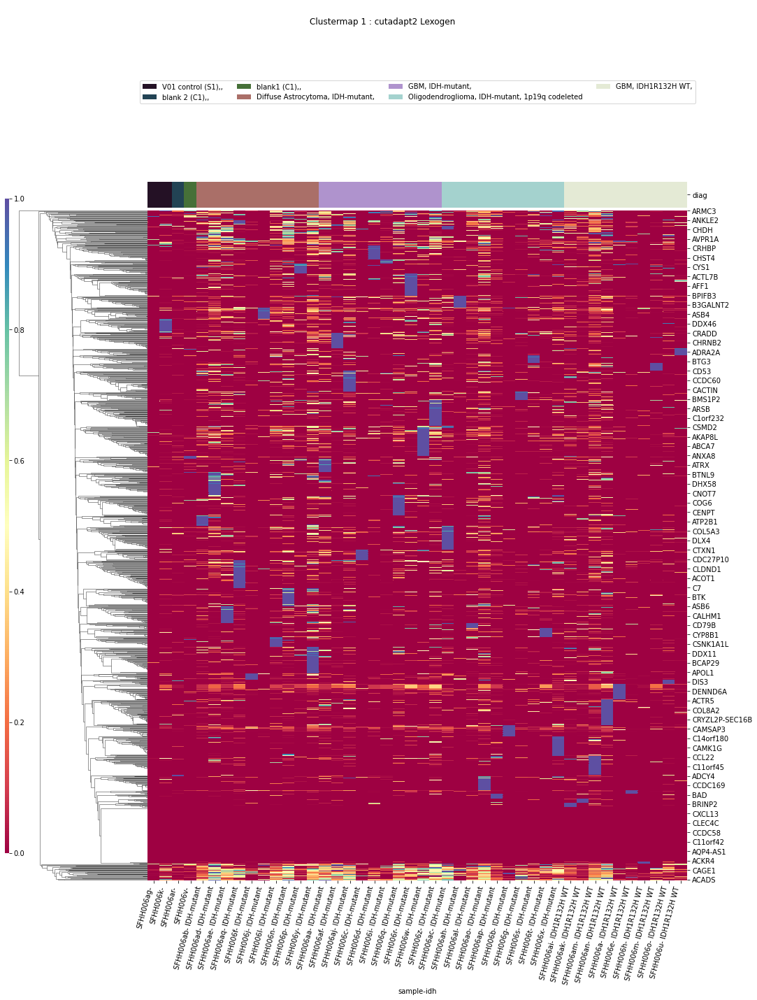

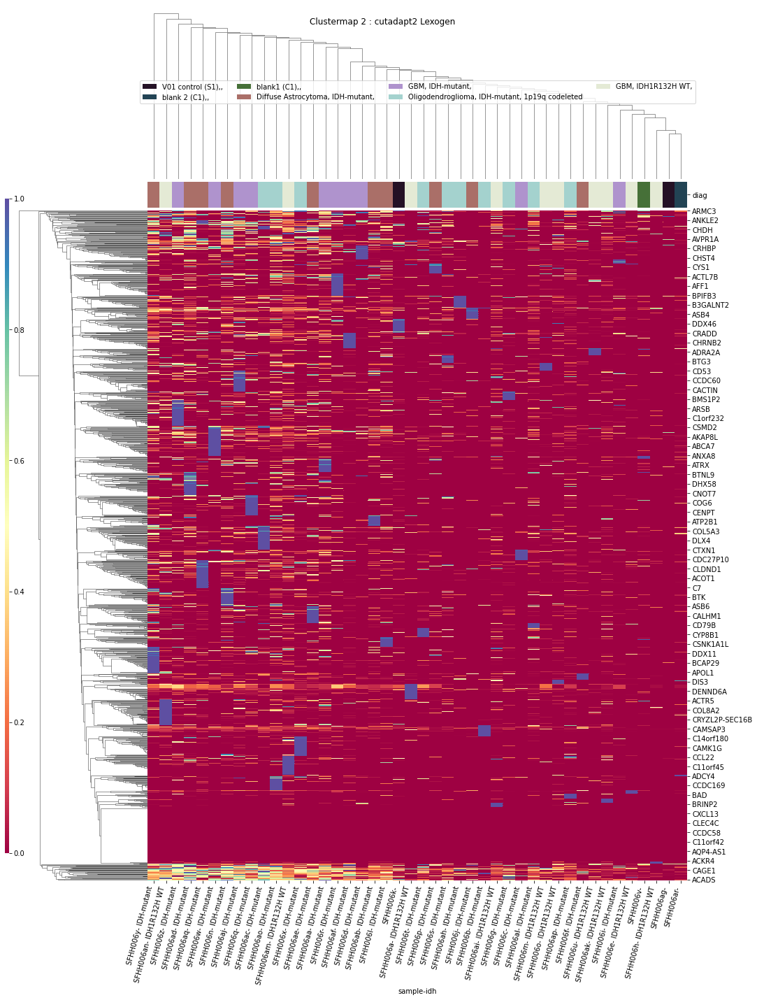

In [67]:
ttests_boxplots_and_heatmaps(dfn,elements,heat_p=0.1)

In [68]:
datetime.now().strftime("%H:%M:%S")

'11:45:52'

In [69]:
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [70]:
pd.set_option('display.max_columns', default_max_columns)

In [71]:
pd.set_option('display.max_rows',default_max_rows)

In [72]:
pd.set_option('display.precision', default_precision)